In [59]:
# Group 1 
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import yfinance as yf
import math
import datetime
import random

# Group 2
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import LSTM
from keras.layers import Dropout
from keras.callbacks import EarlyStopping
from keras import metrics

# Group 3
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error as mae
from sklearn.metrics import mean_squared_error as mse
from sklearn.metrics import r2_score as r2

# Group 4
from bs4 import BeautifulSoup
import requests


In [3]:
def modify_dataset(df, remove_last=True):
    
    df['open_next_day'] = df['Open'].shift(-1, axis=0)
    df['close_next_day'] = df['Close'].shift(-1, axis=0)
    if remove_last:
        df.drop(df.tail(1).index,inplace=True)
    op = df['Open'].to_numpy()
    close = df['Close'].to_numpy()
    high = df['High'].to_numpy()
    low = df['Low'].to_numpy()
    vol = df['Volume'].to_numpy()
    
    y1 = df['open_next_day'].to_numpy()
    y2 = df['close_next_day'].to_numpy()
    
    x = np.vstack((op,close,high,low,vol)).T
    y = np.vstack((y1,y2)).T
    
    scaler = MinMaxScaler()
    scaler.fit(x)
    x = scaler.transform(x)
    
    scaler1 = MinMaxScaler()
    scaler1.fit(y)
    y = scaler1.transform(y)
    
    x = x.reshape(x.shape[0],1,x.shape[1])
    
    data = {'x':x, 'y':y}
    scaler = {'x':scaler, 'y':scaler1}
    
    return df,data,scaler

In [4]:
def get_beta(ticker):
    
    headers = {'User-Agent': 'Mozilla/5.0 (Macintosh; Intel Mac OS X 10_11_5) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/50.0.2661.102 Safari/537.36'}
    url = 'https://finance.yahoo.com/quote/{}?p={}.tsrc=fin-srch'.format(ticker,ticker)
    
    try:
        yahoo_finance = requests.get(url, headers=headers)
    except:
        beta = 'Request error, could not fetch beta'
    else:
        soup = BeautifulSoup(yahoo_finance.content, 'html.parser')
        beta = soup.find('td',attrs={'data-test':'BETA_5Y-value'}).find("span").text
    
    return beta

In [5]:
def set_up():
    spy = yf.download('SPY', '1995-01-01','2015-01-01')
    
    df, data, scaler = modify_dataset(spy)
    
    
    return df, data, scaler

In [6]:
def calculate_risk(df):
    daily_return = df[['daily return']]
    risk = daily_return.fillna(0).std()[0]
    
    return risk

In [7]:
def calculate_annual_returns(df):
    yearly_returns = {
        'Year End 2009':1,
        'Year End 2010':1,
        'Year End 2011':1,
        'Year End 2012':1,
        'Year End 2013':1,
        'Year End 2014':1,
        'Year End 2015':1,
        'Year End 2016':1,
        'Year End 2017':1,
        'Year End 2018':1,
        'Year End 2019':1,
        'Year End 2020':1,
    }

    
    for i in range(0,len(df)):
        year = df.index[i].year
        if df['daily return'][i]!=0 and year!=2009:
            yearly_returns['Year End '+str(year)] *= (df['daily return'][i] + 1)
    
    for year in yearly_returns:
        yearly_returns[year] -= 1
        
    yearly_returns = pd.DataFrame.from_dict(yearly_returns, orient='index', columns=['return'])
        
    
    return yearly_returns

In [8]:
def annualized_return(total_return):
    return ((1+total_return)**(1/10.5))-1

In [173]:
def construct_model():
    
    model = Sequential()
    model.add(LSTM(75, input_shape = (1,5), activation='tanh', recurrent_activation='sigmoid'))
    model.add(Dense(2))

    model.compile(loss='mse', optimizer = 'adam', metrics = [metrics.mae])

    callback = EarlyStopping(monitor='loss', patience=3)

    model.summary()
    
    model = {'model':model, 'callback': callback}
    
    return model

In [109]:
def evaluate(df, num_points, test=False):
    print('\n ----------------- MODEL EVALUATION ----------------- \n')
    
    df.fillna(0)

    open_true = df['open_next_day']
    open_pred = df['pred_open_next_day']
    close_true = df['close_next_day']
    close_pred = df['pred_close_next_day']
    
    if test:
        open_true = open_true[:-1]
        open_pred = open_pred[:-1]
        close_true = close_true[:-1]
        close_pred = close_pred[:-1]


    fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(16,8))
    
    ax[0,0].plot(open_true[-num_points:], open_pred[-num_points:], 'go')
    ax[0,0].set_title('Open')
    
    ax[0,1].plot(close_true[-num_points:], close_pred[-num_points:], 'r^')
    ax[0,1].set_title('Close')
    
    ax[1,0].plot(open_true[-num_points:])
    ax[1,0].plot(open_pred[-num_points:])
    ax[1,0].set_label(['true','prediction'])
    

    ax[1,1].plot(close_true[-num_points:])
    ax[1,1].plot(close_pred[-num_points:])
    ax[1,1].set_label(['true','prediction'])

    fig.suptitle('Model Price Predictions')
    plt.show()
    plt.close()

    
    mae_open = mae(open_true,open_pred)
    mae_close = mae(close_true, close_pred)
    
    mse_open = mse(open_true, open_pred)
    mse_close = mse(close_true, close_pred)
    
    r2_open = r2(open_true, open_pred)
    r2_close = r2(close_true, close_pred)
    
    print('OPEN PRICES')
    print('\t Mean Absolute Error: {}'.format(mae_open))
    print('\t Mean Squared Error: {}'.format(mse_open))
    print('\t R2 Score: {}'.format(r2_open))
    
    print('CLOSE PRICES')
    print('\t Mean Absolute Error: {}'.format(mae_close))
    print('\t Mean Squared Error: {}'.format(mse_close))
    print('\t R2 Score: {}'.format(r2_close))
    print('')

In [110]:
def train_dataset(data, model, scaler):
    x_train, x_test, y_train, y_test = train_test_split(data['x'],data['y'],test_size = 0.25)
    
    history = model['model'].fit(x_train, y_train, epochs=100, callbacks=[model['callback']])
    
    print('\nTraining finished')

    
    predict = model['model'].predict(x_test)
    
    original_values = scaler['y'].inverse_transform(y_test)
    predicted_values = scaler['y'].inverse_transform(predict)
    
    values = np.concatenate((original_values, predicted_values),axis=1)
    
    values = pd.DataFrame(values, columns = list(('open_next_day', 'close_next_day', 'pred_open_next_day', 'pred_close_next_day')))
    
    values = values.round(2)
    
    func = lambda x: math.log(x)
    val = [func(x) for x in history.history['loss']]
    
    plt.figure()
    plt.plot(val)
    plt.xlabel('epochs')
    plt.ylabel('log(mse)')
    plt.title('Model Loss Function')
    plt.show()
    
    evaluate(values,75)

    
    return values

In [175]:
def test(ticker, model):
    
    print('Testing {}'.format(ticker))
   
    df = yf.download(ticker, '2010-01-01', '2020-05-30')

    df, data, scaler = modify_dataset(df, False)
    
    predict = model['model'].predict(data['x'])
    
    predict = scaler['y'].inverse_transform(predict)
    
    predictions = pd.DataFrame(predict, columns = list(('pred_open_next_day', 'pred_close_next_day'))).round(2)
    df['pred_open_next_day'] = predictions['pred_open_next_day'].to_numpy()
    df['pred_close_next_day'] = predictions['pred_close_next_day'].to_numpy()
    
    evaluate(df,100,True)
    
    data = {'ticker':ticker, 'data':df}

    
    
    return data
    

In [119]:
def trade(data):
    
    df = data['data']
    
    initial_capital = 100000
    total_profit = 0
    long_days = 0
    short_days = 0
    num_loss_days = 0
    df['profit/loss'] = 0
    df['total profit'] = 0
    df['initial capital'] = initial_capital
    df['daily return'] = 0.0
    

    
    for i in range(0,(len(df)-2)):
        pred_open_next_day = df['pred_open_next_day'][i]
        pred_close_next_day = df['pred_close_next_day'][i]
        tomorrow = pd.to_datetime(df.index.values[i+1]).date()
        print('Day {} \n[ {} ]'.format(i+1, tomorrow))
        df.at[df.index.values[i+1],'initial capital'] = df.at[df.index.values[i],'initial capital']
        
        
        if pred_open_next_day < pred_close_next_day:
            buy_price = df['Open'][i+1]
            sell_price = df['Close'][i+1]
            
            if math.isnan(buy_price) or math.isnan(sell_price):
                continue
            
            if initial_capital > 0:
                num_shares = initial_capital/buy_price
                long_days+=1
                
                print('\t Buying {} shares at {}'.format(num_shares, buy_price))
                print('\t Selling {} shares at {}'.format(num_shares, sell_price))

                profit = (num_shares*sell_price) - (num_shares*buy_price)
                ret = profit/initial_capital
            
                
                df.at[df.index.values[i+1],'profit/loss'] = profit
                df.at[df.index.values[i+1],'daily return'] = ret
                    
                    
                initial_capital += profit
                total_profit += profit
                
                df.at[df.index.values[i+1],'total profit'] = total_profit
                df.at[df.index.values[i+1],'initial capital'] = initial_capital
                
                
                    
                if profit < 0:
                    num_loss_days+=1

                print('\tDay profit/loss: {}\n'.format(round(profit,2)))
            else:
                print('Not enough money')



        elif pred_open_next_day > pred_close_next_day:

            sell_price = df['Open'][i+1]
            buy_back_price = df['Close'][i+1]
            
            if math.isnan(buy_back_price) or math.isnan(sell_price):
                continue
            
            if initial_capital !=0:
                num_shares = 100
                short_days+=1

                print('\t Shorting {} shares at {}'.format(num_shares, buy_back_price))
                print('\t Buying Back {} shares at {}'.format(num_shares, sell_price))

                profit = (num_shares*sell_price) - (num_shares*buy_back_price)
                ret = profit/initial_capital
                
                df.at[df.index.values[i+1],'profit/loss'] = profit
                df.at[df.index.values[i+1],'daily return'] = ret
                    
                initial_capital += profit
                total_profit += profit
                df.at[df.index.values[i+1],'total profit'] = total_profit
                df.at[df.index.values[i+1],'initial capital'] = initial_capital
                    
                if profit < 0:
                    num_loss_days+=1
                    
                print('Day profit/loss: {}\n'.format(round(profit,2)))

            else:
                print('Not enough money')
                    
                    

    total_return = (total_profit/100000)*100
    annual_return = annualized_return(total_return/100)*100
    
    beta = get_beta(data['ticker'])
    risk = calculate_risk(df)*100
    sharpe = (((annual_return/100) - 0.00942)/(risk/100))
    
    
     
    print('Beta: {}'.format(beta))
    print('\n------------------- EVALUATION METRICS -------------------\n')
    print('Total Return: {}%'.format(round(total_return,2)))
    print('Annualized Return: {}%'.format(round(annual_return,2)))
    print('Std. Deviation: {}%'.format(round(risk,2)))
    print('Sharpe Ratio: {}%'.format(round(sharpe,2)))
    print('Total Profit: {}'.format(round(total_profit,2)))
    print('Final Value of Capital: {}'.format(round(initial_capital,2)))
    
    print('\n------------------- TRADING STATISTICS -------------------\n')
    print('Total days long: {}'.format(long_days))
    print('Total days short: {}'.format(short_days))
    print('Number of days with loss: {}'.format(num_loss_days))
    print('')
    
    return df,beta,risk,sharpe,round(annual_return,2),round(total_profit,2)
    
    

In [14]:
def algo_vs_market(df, spy):
    annual_returns = calculate_annual_returns(df)
    daily_returns = spy[['Adj Close']].pct_change().fillna(0)
    daily_returns = daily_returns.rename(columns={'Adj Close':'daily return'})
    spy_returns = calculate_annual_returns(daily_returns)
    
    plt.figure(figsize=(16,8))
    plt.plot_date(annual_returns.index, annual_returns['return'], linestyle='solid')
    plt.plot_date(spy_returns.index, spy_returns['return'], linestyle='solid')
    plt.legend(['Algorithm','S&P 500'])
    plt.title('Algorithm Performance vs S&P 500')
    plt.grid(True)
    plt.tight_layout()
    plt.show()   
    

In [15]:
def visualize_dollar_profits(df):    
    fig, ax = plt.subplots(nrows=2, ncols=1, figsize=(32,16))
    ax[0].plot(df['profit/loss'])
    ax[0].set_title('Daily Profit/Loss')
    ax[0].grid(True)

    ax[1].plot(df['initial capital'][:-1])
    ax[1].set_title('Capital Gains')
    ax[1].grid(True)

    plt.tight_layout()
    plt.show()
    plt.close()

In [92]:
def testing_program(tickers, model):
    x = []
    for ticker in tickers:
        data = test(ticker, model)
        print('Trading on: {}'.format(ticker))
        data,beta, risk, sharpe, ret, profit = trade(data)
        temp = {
            'ticker':ticker,
            'beta':beta,
            'risk':risk,
            'sharpe': sharpe,
            'return':ret,
            'profit':profit
        }
        x.append(temp)
        
    df = pd.DataFrame(x, columns=['ticker','beta','risk','sharpe','return','profit'])
        
    return df

In [166]:
df,data,scalar = set_up() 

[*********************100%***********************]  1 of 1 downloaded


In [18]:
df.head()

,Open,High,Low,Close,Adj Close,Volume,open_next_day,close_next_day
Date,,,,,,,,
1995-01-03,45.70,45.84,45.69,45.78,28.84,324300,45.98,46.00
1995-01-04,45.98,46.00,45.75,46.00,28.98,351800,46.03,46.00
1995-01-05,46.03,46.11,45.95,46.00,28.98,89800,46.09,46.05
1995-01-06,46.09,46.25,45.91,46.05,29.01,448400,46.03,46.09
1995-01-09,46.03,46.09,46.00,46.09,29.04,36800,46.20,46.14


In [19]:
df.tail()

,Open,High,Low,Close,Adj Close,Volume,open_next_day,close_next_day
Date,,,,,,,,
2014-12-23,208.17,208.23,207.40,207.75,187.16,122167900,208.02,207.77
2014-12-24,208.02,208.34,207.72,207.77,187.18,42963400,208.31,208.44
2014-12-26,208.31,208.85,208.25,208.44,187.78,57326700,208.22,208.72
2014-12-29,208.22,208.97,208.14,208.72,188.04,79643900,208.21,207.60
2014-12-30,208.21,208.37,207.51,207.60,187.03,73540800,207.99,205.54


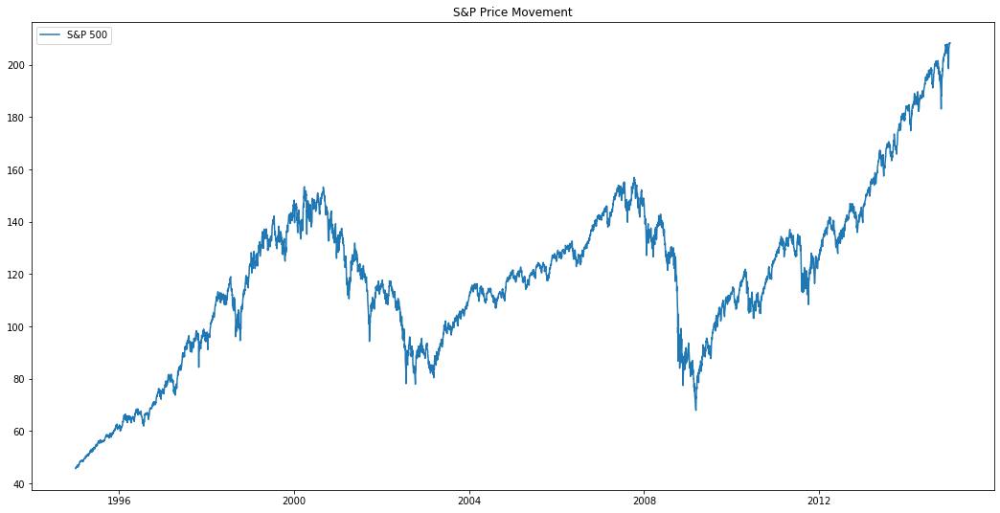

In [167]:
plt.figure(1, figsize=(18,9))
plt.plot(df['Open'])
plt.legend(['S&P 500'])
plt.title('S&P Price Movement')
plt.show()

In [21]:
len(df)

5035

In [22]:
data['x'][3]

array([[0.00239838, 0.00165705, 0.00245318, 0.00135335, 0.00050389]])

In [23]:
data['y'][3]

array([0.00030801, 0.0005531 ])

In [177]:
model = construct_model()

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_6 (LSTM)                (None, 75)                24300     
_________________________________________________________________
dense_6 (Dense)              (None, 2)                 152       
Total params: 24,452
Trainable params: 24,452
Non-trainable params: 0
_________________________________________________________________


Epoch 1/100
3776/3776 [==============================] - 1s 133us/step - loss: 0.0413 - mean_absolute_error: 0.1319
Epoch 2/100
3776/3776 [==============================] - 0s 49us/step - loss: 0.0016 - mean_absolute_error: 0.0286
Epoch 3/100
3776/3776 [==============================] - 0s 44us/step - loss: 4.7216e-04 - mean_absolute_error: 0.0147
Epoch 4/100
3776/3776 [==============================] - 0s 44us/step - loss: 2.2119e-04 - mean_absolute_error: 0.0107
Epoch 5/100
3776/3776 [==============================] - 0s 44us/step - loss: 1.7658e-04 - mean_absolute_error: 0.0099
Epoch 6/100
3776/3776 [==============================] - 0s 51us/step - loss: 1.4830e-04 - mean_absolute_error: 0.0090
Epoch 7/100
3776/3776 [==============================] - 0s 45us/step - loss: 1.2188e-04 - mean_absolute_error: 0.0081
Epoch 8/100
3776/3776 [==============================] - 0s 44us/step - loss: 9.8604e-05 - mean_absolute_error: 0.0071
Epoch 9/100
3776/3776 [==============================] 

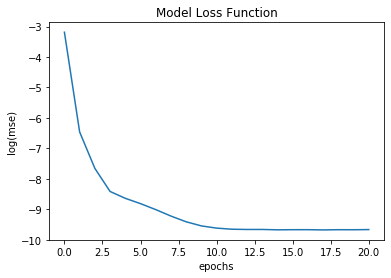


 ----------------- MODEL EVALUATION ----------------- 



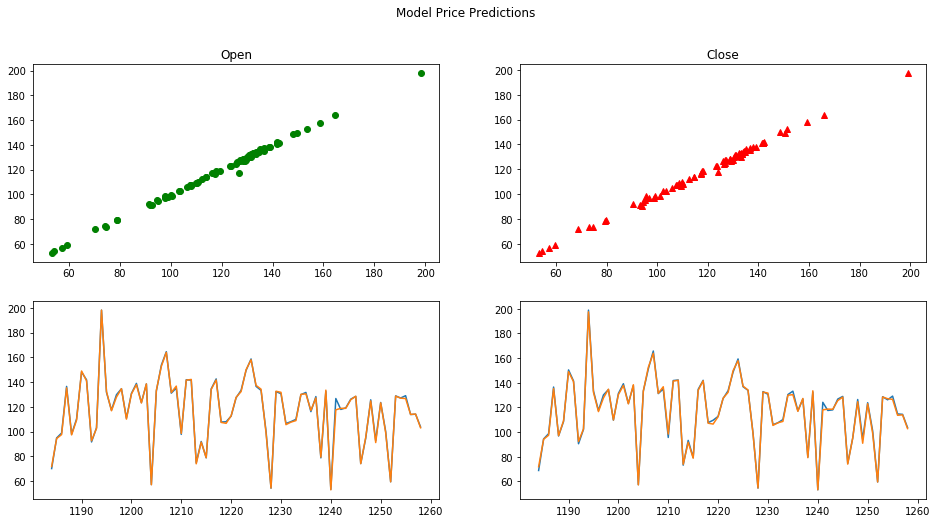

OPEN PRICES
	 Mean Absolute Error: 0.6878713264495633
	 Mean Squared Error: 1.0094069102462275
	 R2 Score: 0.9989837394704628
CLOSE PRICES
	 Mean Absolute Error: 1.0896664019062747
	 Mean Squared Error: 2.2083425734710085
	 R2 Score: 0.9977788190143528



In [178]:
values = train_dataset(data, model, scalar)

In [34]:
df, beta, risk, sharpe, ret, profit = trade(df)

Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 20.88
	 Buying Back 100 shares at 20.79
Day profit/loss: -9.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 20.87
	 Buying Back 100 shares at 20.94
Day profit/loss: 7.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 20.8
	 Buying Back 100 shares at 20.81
Day profit/loss: 1.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 20.6
	 Buying Back 100 shares at 20.73
Day profit/loss: 13.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 20.83
	 Buying Back 100 shares at 20.54
Day profit/loss: -29.0

Day 6 
[ 2010-01-11 ]
	 Shorting 100 shares at 20.95
	 Buying Back 100 shares at 21.11
Day profit/loss: 16.0

Day 7 
[ 2010-01-12 ]
	 Shorting 100 shares at 20.61
	 Buying Back 100 shares at 20.87
Day profit/loss: 26.0

Day 8 
[ 2010-01-13 ]
	 Shorting 100 shares at 20.96
	 Buying Back 100 shares at 20.72
Day profit/loss: -24.0

Day 9 
[ 2010-01-14 ]
	 Shorting 100 shares at 21.48
	 Buying Back 100 shares at 21.11
Day profit/loss: -37.0

Day 10 
[ 2

Day profit/loss: -18.0

Day 342 
[ 2011-05-11 ]
	 Shorting 100 shares at 23.41
	 Buying Back 100 shares at 23.29
Day profit/loss: -12.0

Day 343 
[ 2011-05-12 ]
	 Shorting 100 shares at 23.71
	 Buying Back 100 shares at 23.25
Day profit/loss: -46.0

Day 344 
[ 2011-05-13 ]
	 Shorting 100 shares at 23.41
	 Buying Back 100 shares at 23.66
Day profit/loss: 25.0

Day 345 
[ 2011-05-16 ]
	 Shorting 100 shares at 23.64
	 Buying Back 100 shares at 23.32
Day profit/loss: -32.0

Day 346 
[ 2011-05-17 ]
	 Shorting 100 shares at 23.55
	 Buying Back 100 shares at 23.37
Day profit/loss: -18.0

Day 347 
[ 2011-05-18 ]
	 Shorting 100 shares at 23.88
	 Buying Back 100 shares at 23.6
Day profit/loss: -28.0

Day 348 
[ 2011-05-19 ]
	 Shorting 100 shares at 23.54
	 Buying Back 100 shares at 23.32
Day profit/loss: -22.0

Day 349 
[ 2011-05-20 ]
	 Shorting 100 shares at 23.22
	 Buying Back 100 shares at 23.46
Day profit/loss: 24.0

Day 350 
[ 2011-05-23 ]
	 Shorting 100 shares at 22.86
	 Buying Back 100 sh

	 Buying Back 100 shares at 27.83
Day profit/loss: 7.0

Day 592 
[ 2012-05-08 ]
	 Shorting 100 shares at 27.37
	 Buying Back 100 shares at 27.48
Day profit/loss: 11.0

Day 593 
[ 2012-05-09 ]
	 Shorting 100 shares at 27.19
	 Buying Back 100 shares at 27.08
Day profit/loss: -11.0

Day 594 
[ 2012-05-10 ]
	 Shorting 100 shares at 27.24
	 Buying Back 100 shares at 27.34
Day profit/loss: 10.0

Day 595 
[ 2012-05-11 ]
	 Shorting 100 shares at 27.63
	 Buying Back 100 shares at 27.26
Day profit/loss: -37.0

Day 596 
[ 2012-05-14 ]
	 Shorting 100 shares at 27.02
	 Buying Back 100 shares at 27.35
Day profit/loss: 33.0

Day 597 
[ 2012-05-15 ]
	 Shorting 100 shares at 26.88
	 Buying Back 100 shares at 27.05
Day profit/loss: 17.0

Day 598 
[ 2012-05-16 ]
	 Shorting 100 shares at 26.5
	 Buying Back 100 shares at 26.91
Day profit/loss: 41.0

Day 599 
[ 2012-05-17 ]
	 Shorting 100 shares at 26.19
	 Buying Back 100 shares at 26.47
Day profit/loss: 28.0

Day 600 
[ 2012-05-18 ]
	 Shorting 100 shares a

	 Buying Back 100 shares at 23.97
Day profit/loss: -18.0

Day 842 
[ 2013-05-08 ]
	 Shorting 100 shares at 24.25
	 Buying Back 100 shares at 24.04
Day profit/loss: -21.0

Day 843 
[ 2013-05-09 ]
	 Shorting 100 shares at 24.36
	 Buying Back 100 shares at 24.2
Day profit/loss: -16.0

Day 844 
[ 2013-05-10 ]
	 Shorting 100 shares at 24.5
	 Buying Back 100 shares at 24.42
Day profit/loss: -8.0

Day 845 
[ 2013-05-13 ]
	 Shorting 100 shares at 24.08
	 Buying Back 100 shares at 24.41
Day profit/loss: 33.0

Day 846 
[ 2013-05-14 ]
	 Shorting 100 shares at 23.84
	 Buying Back 100 shares at 24.08
Day profit/loss: 24.0

Day 847 
[ 2013-05-15 ]
	 Shorting 100 shares at 24.2
	 Buying Back 100 shares at 23.89
Day profit/loss: -31.0

Day 848 
[ 2013-05-16 ]
	 Shorting 100 shares at 23.94
	 Buying Back 100 shares at 24.06
Day profit/loss: 12.0

Day 849 
[ 2013-05-17 ]
	 Shorting 100 shares at 24.04
	 Buying Back 100 shares at 24.12
Day profit/loss: 8.0

Day 850 
[ 2013-05-20 ]
	 Shorting 100 shares a

[ 2013-11-13 ]
	 Shorting 100 shares at 24.6
	 Buying Back 100 shares at 24.25
Day profit/loss: -35.0

Day 975 
[ 2013-11-14 ]
	 Shorting 100 shares at 24.39
	 Buying Back 100 shares at 24.43
Day profit/loss: 4.0

Day 976 
[ 2013-11-15 ]
	 Shorting 100 shares at 24.52
	 Buying Back 100 shares at 24.4
Day profit/loss: -12.0

Day 977 
[ 2013-11-18 ]
	 Shorting 100 shares at 24.6
	 Buying Back 100 shares at 24.61
Day profit/loss: 1.0

Day 978 
[ 2013-11-19 ]
	 Shorting 100 shares at 24.7
	 Buying Back 100 shares at 24.74
Day profit/loss: 4.0

Day 979 
[ 2013-11-20 ]
	 Shorting 100 shares at 24.56
	 Buying Back 100 shares at 24.7
Day profit/loss: 14.0

Day 980 
[ 2013-11-21 ]
	 Shorting 100 shares at 25.23
	 Buying Back 100 shares at 24.61
Day profit/loss: -62.0

Day 981 
[ 2013-11-22 ]
	 Shorting 100 shares at 23.87
	 Buying Back 100 shares at 24.5
Day profit/loss: 63.0

Day 982 
[ 2013-11-25 ]
	 Shorting 100 shares at 23.75
	 Buying Back 100 shares at 24.02
Day profit/loss: 27.0

Day 983

	 Shorting 100 shares at 26.17
	 Buying Back 100 shares at 26.16
Day profit/loss: -1.0

Day 1092 
[ 2014-05-06 ]
	 Shorting 100 shares at 26.2
	 Buying Back 100 shares at 26.16
Day profit/loss: -4.0

Day 1093 
[ 2014-05-07 ]
	 Shorting 100 shares at 26.37
	 Buying Back 100 shares at 26.26
Day profit/loss: -11.0

Day 1094 
[ 2014-05-08 ]
	 Shorting 100 shares at 26.34
	 Buying Back 100 shares at 26.32
Day profit/loss: -2.0

Day 1095 
[ 2014-05-09 ]
	 Shorting 100 shares at 26.3
	 Buying Back 100 shares at 26.37
Day profit/loss: 7.0

Day 1096 
[ 2014-05-12 ]
	 Shorting 100 shares at 26.37
	 Buying Back 100 shares at 26.41
Day profit/loss: 4.0

Day 1097 
[ 2014-05-13 ]
	 Shorting 100 shares at 26.45
	 Buying Back 100 shares at 26.49
Day profit/loss: 4.0

Day 1098 
[ 2014-05-14 ]
	 Shorting 100 shares at 26.33
	 Buying Back 100 shares at 26.49
Day profit/loss: 16.0

Day 1099 
[ 2014-05-15 ]
	 Shorting 100 shares at 26.01
	 Buying Back 100 shares at 26.33
Day profit/loss: 32.0

Day 1100 
[ 

	 Selling 3739.4582870207096 shares at 32.24
	Day profit/loss: -112.18

Day 1346 
[ 2015-05-08 ]
	 Buying 3708.401574086364 shares at 32.51
	 Selling 3708.401574086364 shares at 32.8
	Day profit/loss: 1075.44

Day 1347 
[ 2015-05-11 ]
	 Buying 3722.0187157292753 shares at 32.68
	 Selling 3722.0187157292753 shares at 32.69
	Day profit/loss: 37.22

Day 1348 
[ 2015-05-12 ]
	 Buying 3750.702583760481 shares at 32.44
	 Selling 3750.702583760481 shares at 32.25
	Day profit/loss: -712.63

Day 1349 
[ 2015-05-13 ]
	 Buying 3748.3780082514877 shares at 32.27
	 Selling 3748.3780082514877 shares at 32.64
	Day profit/loss: 1386.9

Day 1350 
[ 2015-05-14 ]
	 Buying 3723.2823551225974 shares at 32.86
	 Selling 3723.2823551225974 shares at 32.97
	Day profit/loss: 409.56

Day 1351 
[ 2015-05-15 ]
	 Buying 3709.779971241826 shares at 33.09
	 Selling 3709.779971241826 shares at 32.99
	Day profit/loss: -370.98

Day 1352 
[ 2015-05-18 ]
	 Buying 3710.904828722494 shares at 32.98
	 Selling 3710.9048287224

	 Selling 4619.8161154372265 shares at 31.39
	Day profit/loss: 877.77

Day 1611 
[ 2016-05-26 ]
	 Buying 4605.145375153209 shares at 31.49
	 Selling 4605.145375153209 shares at 31.49
	Day profit/loss: 0.0

Day 1612 
[ 2016-05-27 ]
	 Buying 4589.11480580932 shares at 31.6
	 Selling 4589.11480580932 shares at 31.57
	Day profit/loss: -137.67

Day 1613 
[ 2016-05-31 ]
	 Buying 4597.85320277373 shares at 31.51
	 Selling 4597.85320277373 shares at 31.59
	Day profit/loss: 367.83

Day 1614 
[ 2016-06-01 ]
	 Buying 4593.490913207531 shares at 31.62
	 Selling 4593.490913207531 shares at 31.66
	Day profit/loss: 183.74

Day 1615 
[ 2016-06-02 ]
	 Buying 4608.0457006384795 shares at 31.56
	 Selling 4608.0457006384795 shares at 31.76
	Day profit/loss: 921.61

Day 1616 
[ 2016-06-03 ]
	 Buying 4610.949321117773 shares at 31.74
	 Selling 4610.949321117773 shares at 31.62
	Day profit/loss: -553.31

Day 1617 
[ 2016-06-06 ]
	 Buying 4608.034688171429 shares at 31.64
	 Selling 4608.034688171429 shares at

	 Buying 4597.873509757419 shares at 35.87
	 Selling 4597.873509757419 shares at 35.86
	Day profit/loss: -45.98

Day 1861 
[ 2017-05-24 ]
	 Buying 4582.538745411369 shares at 35.98
	 Selling 4582.538745411369 shares at 36.12
	Day profit/loss: 641.56

Day 1862 
[ 2017-05-25 ]
	 Buying 4582.538745411369 shares at 36.12
	 Selling 4582.538745411369 shares at 36.26
	Day profit/loss: 641.56

Day 1863 
[ 2017-05-26 ]
	 Buying 4582.538745411369 shares at 36.26
	 Selling 4582.538745411369 shares at 36.26
	Day profit/loss: 0.0

Day 1864 
[ 2017-05-30 ]
	 Buying 4581.275293868657 shares at 36.27
	 Selling 4581.275293868657 shares at 36.18
	Day profit/loss: -412.31

Day 1865 
[ 2017-05-31 ]
	 Buying 4564.873041370642 shares at 36.31
	 Selling 4564.873041370642 shares at 36.11
	Day profit/loss: -912.97

Day 1866 
[ 2017-06-01 ]
	 Buying 4563.6092337733635 shares at 36.12
	 Selling 4563.6092337733635 shares at 36.12
	Day profit/loss: 0.0

Day 1867 
[ 2017-06-02 ]
	 Buying 4544.7357464542 shares at 3

	 Buying 3627.054237630081 shares at 54.36
	 Selling 3627.054237630081 shares at 54.32
	Day profit/loss: -145.08

Day 2111 
[ 2018-05-22 ]
	 Buying 3599.88280994091 shares at 54.73
	 Selling 3599.88280994091 shares at 54.45
	Day profit/loss: -1007.97

Day 2112 
[ 2018-05-23 ]
	 Buying 3629.881833357085 shares at 54.0
	 Selling 3629.881833357085 shares at 55.21
	Day profit/loss: 4392.16

Day 2113 
[ 2018-05-24 ]
	 Buying 3631.8553102509 shares at 55.18
	 Selling 3631.8553102509 shares at 54.75
	Day profit/loss: -1561.7

Day 2114 
[ 2018-05-25 ]
	 Buying 3628.5415736539558 shares at 54.8
	 Selling 3628.5415736539558 shares at 55.44
	Day profit/loss: 2322.27

Day 2115 
[ 2018-05-29 ]
	 Buying 3649.6071270568814 shares at 55.12
	 Selling 3649.6071270568814 shares at 55.32
	Day profit/loss: 729.92

Day 2116 
[ 2018-05-30 ]
	 Buying 3612.3862277471226 shares at 55.89
	 Selling 3612.3862277471226 shares at 55.68
	Day profit/loss: -758.6

Day 2117 
[ 2018-05-31 ]
	 Buying 3613.035120548945 sha

	Day profit/loss: -1384.14

Day 2348 
[ 2019-05-02 ]
	 Buying 4067.8028659159095 shares at 50.8
	 Selling 4067.8028659159095 shares at 50.55
	Day profit/loss: -1016.95

Day 2349 
[ 2019-05-03 ]
	 Buying 4025.5958275655685 shares at 51.08
	 Selling 4025.5958275655685 shares at 51.75
	Day profit/loss: 2697.15

Day 2350 
[ 2019-05-06 ]
	 Buying 4145.762867194391 shares at 50.25
	 Selling 4145.762867194391 shares at 51.22
	Day profit/loss: 4021.39

Day 2351 
[ 2019-05-07 ]
	 Buying 4196.560752128393 shares at 50.6
	 Selling 4196.560752128393 shares at 50.48
	Day profit/loss: -503.59

Day 2352 
[ 2019-05-08 ]
	 Buying 4219.967863893253 shares at 50.2
	 Selling 4219.967863893253 shares at 49.24
	Day profit/loss: -4051.17

Day 2353 
[ 2019-05-09 ]
	 Buying 4338.021244636822 shares at 47.9
	 Selling 4338.021244636822 shares at 46.62
	Day profit/loss: -5552.67

Day 2354 
[ 2019-05-10 ]
	 Buying 4354.835280468748 shares at 46.44
	 Selling 4354.835280468748 shares at 46.2
	Day profit/loss: -1045.

	 Buying 4481.779067071105 shares at 51.92
	 Selling 4481.779067071105 shares at 50.85
	Day profit/loss: -4795.5

Day 2563 
[ 2020-03-10 ]
	 Buying 4319.53118954825 shares at 52.76
	 Selling 4319.53118954825 shares at 53.98
	Day profit/loss: 5269.83

Day 2564 
[ 2020-03-11 ]
	 Buying 4450.625951742975 shares at 52.39
	 Selling 4450.625951742975 shares at 51.66
	Day profit/loss: -3248.96

Day 2565 
[ 2020-03-12 ]
	 Buying 4790.984302293022 shares at 47.99
	 Selling 4790.984302293022 shares at 45.54
	Day profit/loss: -11737.91

Day 2566 
[ 2020-03-13 ]
	 Buying 4520.957835193208 shares at 48.26
	 Selling 4520.957835193208 shares at 54.43
	Day profit/loss: 27894.31

Day 2567 
[ 2020-03-16 ]
	 Buying 5179.45137801655 shares at 47.51
	 Selling 5179.45137801655 shares at 44.61
	Day profit/loss: -15020.41

Day 2568 
[ 2020-03-17 ]
	 Buying 5049.285969696641 shares at 45.76
	 Selling 5049.285969696641 shares at 50.08
	Day profit/loss: 21812.92

Day 2569 
[ 2020-03-18 ]
	 Buying 5413.5782779363

[*********************100%***********************]  1 of 1 downloaded


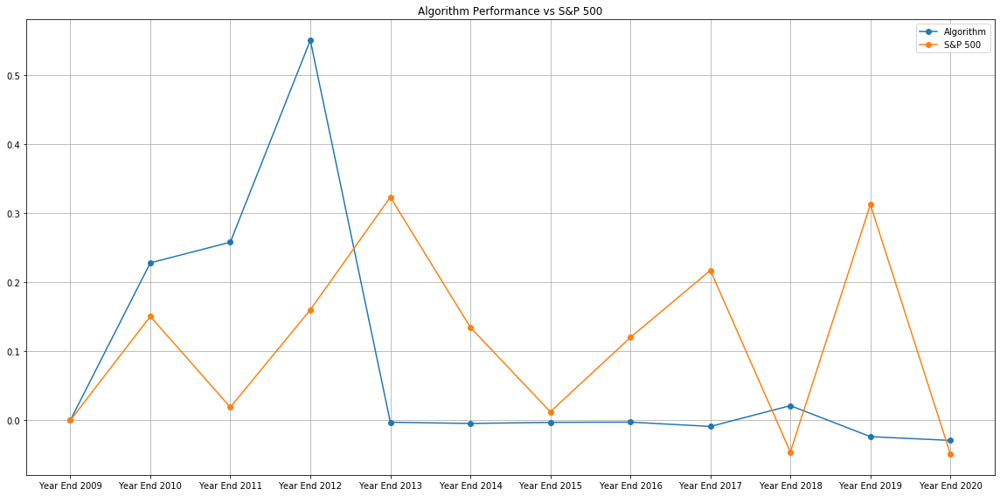

In [29]:
algo_vs_market(df,yf.download('SPY','2010-01-01','2020-05-30'))

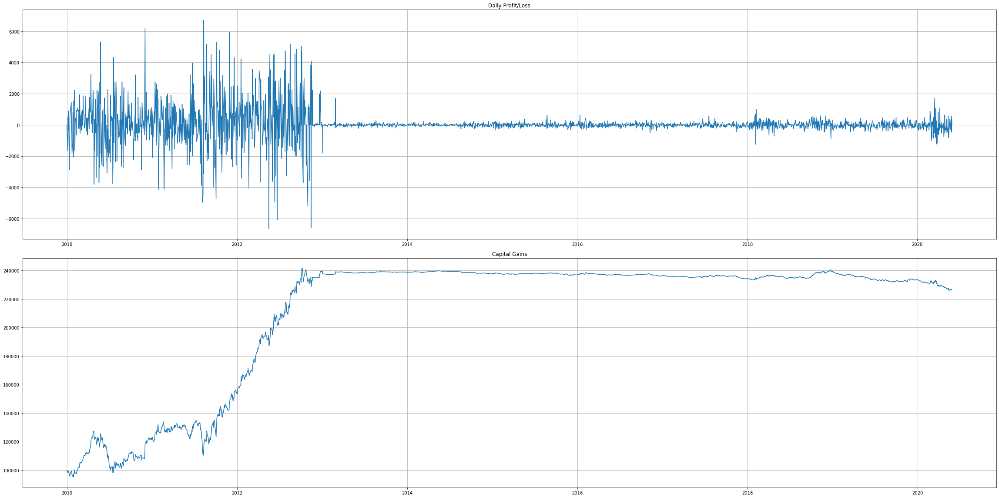

In [30]:
visualize_dollar_profits(df)

In [45]:
companies = pd.read_csv('constituents.csv')

In [51]:
tickers = companies['Symbol'].tolist()

In [68]:
for n, i in enumerate(tickers):
    if i == 'BRK.B':
        tickers[n] = 'BRK'
    if i == 'BF.B':
        tickers[n] = 'BF'

In [122]:
def select_random(tickers, num):
    test_companies = []
    already_used = []
    for i in range(0,num):
        pos = random.randint(0,len(tickers)-1)
        
        while True:
            if pos in already_used:
                pos = random.randint(0,len(tickers))
            else:
                already_used.append(pos)
                break
            
        test_companies.append(tickers[pos])
    
    return test_companies

In [123]:
companies = select_random(tickers, 100)

In [126]:
len(set(companies))

100

In [127]:
df = testing_program(companies, model)

Testing HRL
[*********************100%***********************]  1 of 1 downloaded
Trading on: HRL
Day 1 
[ 2010-01-04 ]
	 Buying 10384.215991692627 shares at 9.63
	 Selling 10384.215991692627 shares at 9.57
	Day profit/loss: -623.05

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 9.62
	 Buying Back 100 shares at 9.58
Day profit/loss: -4.0

Day 3 
[ 2010-01-06 ]
Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 9.52
	 Buying Back 100 shares at 9.59
Day profit/loss: 7.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 9.52
	 Buying Back 100 shares at 9.48
Day profit/loss: -4.0

Day 6 
[ 2010-01-11 ]
	 Buying 10438.649899212021 shares at 9.52
	 Selling 10438.649899212021 shares at 9.54
	Day profit/loss: 208.77

Day 7 
[ 2010-01-12 ]
	 Buying 10449.603361855476 shares at 9.53
	 Selling 10449.603361855476 shares at 9.64
	Day profit/loss: 1149.46

Day 8 
[ 2010-01-13 ]
	 Buying 10427.968572286416 shares at 9.66
	 Selling 10427.968572286416 shares at 9.69
	Day profit/loss: 312.84

Day 9 
[ 2010-0

	Day profit/loss: -819.97

Day 252 
[ 2010-12-31 ]
	 Buying 8206.073762064521 shares at 12.8
	 Selling 8206.073762064521 shares at 12.81
	Day profit/loss: 82.06

Day 253 
[ 2011-01-03 ]
	 Buying 8180.529563583388 shares at 12.85
	 Selling 8180.529563583388 shares at 12.8
	Day profit/loss: -409.03

Day 254 
[ 2011-01-04 ]
	 Buying 8186.925599207771 shares at 12.79
	 Selling 8186.925599207771 shares at 12.67
	Day profit/loss: -982.43

Day 255 
[ 2011-01-05 ]
Day 256 
[ 2011-01-06 ]
	 Shorting 100 shares at 12.44
	 Buying Back 100 shares at 12.47
Day profit/loss: 3.0

Day 257 
[ 2011-01-07 ]
	 Shorting 100 shares at 12.42
	 Buying Back 100 shares at 12.45
Day profit/loss: 3.0

Day 258 
[ 2011-01-10 ]
Day 259 
[ 2011-01-11 ]
	 Buying 8312.047062657248 shares at 12.48
	 Selling 8312.047062657248 shares at 12.64
	Day profit/loss: 1329.93

Day 260 
[ 2011-01-12 ]
	 Buying 8305.476274465424 shares at 12.65
	 Selling 8305.476274465424 shares at 12.61
	Day profit/loss: -332.22

Day 261 
[ 2011-0

[ 2012-01-18 ]
	 Buying 8213.88308081591 shares at 14.62
	 Selling 8213.88308081591 shares at 14.62
	Day profit/loss: 0.0

Day 516 
[ 2012-01-19 ]
	 Buying 8213.88308081591 shares at 14.62
	 Selling 8213.88308081591 shares at 14.65
	Day profit/loss: 246.42

Day 517 
[ 2012-01-20 ]
	 Buying 8247.661900887804 shares at 14.59
	 Selling 8247.661900887804 shares at 14.62
	Day profit/loss: 247.43

Day 518 
[ 2012-01-23 ]
	 Buying 8247.661900887804 shares at 14.62
	 Selling 8247.661900887804 shares at 14.72
	Day profit/loss: 824.77

Day 519 
[ 2012-01-24 ]
	 Buying 8298.399397202222 shares at 14.63
	 Selling 8298.399397202222 shares at 14.77
	Day profit/loss: 1161.78

Day 520 
[ 2012-01-25 ]
Day 521 
[ 2012-01-26 ]
	 Buying 8259.256003819191 shares at 14.84
	 Selling 8259.256003819191 shares at 14.79
	Day profit/loss: -412.96

Day 522 
[ 2012-01-27 ]
	 Buying 8270.439830500058 shares at 14.77
	 Selling 8270.439830500058 shares at 14.52
	Day profit/loss: -2067.61

Day 523 
[ 2012-01-30 ]
	 Buy

[ 2012-11-07 ]
Day 719 
[ 2012-11-08 ]
	 Buying 9045.497070848958 shares at 14.85
	 Selling 9045.497070848958 shares at 14.8
	Day profit/loss: -452.27

Day 720 
[ 2012-11-09 ]
	 Buying 9070.010613046383 shares at 14.76
	 Selling 9070.010613046383 shares at 14.81
	Day profit/loss: 453.5

Day 721 
[ 2012-11-12 ]
	 Buying 9070.010613046383 shares at 14.81
	 Selling 9070.010613046383 shares at 14.97
	Day profit/loss: 1451.2

Day 722 
[ 2012-11-13 ]
Day 723 
[ 2012-11-14 ]
	 Buying 8962.248110713157 shares at 15.15
	 Selling 8962.248110713157 shares at 15.13
	Day profit/loss: -179.24

Day 724 
[ 2012-11-15 ]
	 Buying 8974.110781938458 shares at 15.11
	 Selling 8974.110781938458 shares at 15.31
	Day profit/loss: 1794.82

Day 725 
[ 2012-11-16 ]
	 Shorting 100 shares at 15.44
	 Buying Back 100 shares at 15.3
Day profit/loss: -14.0

Day 726 
[ 2012-11-19 ]
	 Shorting 100 shares at 15.65
	 Buying Back 100 shares at 15.5
Day profit/loss: -15.0

Day 727 
[ 2012-11-20 ]
	 Shorting 100 shares at 15

[ 2013-04-25 ]
	 Buying 7282.417781861905 shares at 20.67
	 Selling 7282.417781861905 shares at 20.7
	Day profit/loss: 218.47

Day 834 
[ 2013-04-26 ]
	 Buying 7282.417781861905 shares at 20.7
	 Selling 7282.417781861905 shares at 20.6
	Day profit/loss: -728.24

Day 835 
[ 2013-04-29 ]
	 Buying 7282.4177818619055 shares at 20.6
	 Selling 7282.4177818619055 shares at 20.62
	Day profit/loss: 145.65

Day 836 
[ 2013-04-30 ]
	 Buying 7296.572141010326 shares at 20.58
	 Selling 7296.572141010326 shares at 20.64
	Day profit/loss: 437.79

Day 837 
[ 2013-05-01 ]
	 Shorting 100 shares at 20.58
	 Buying Back 100 shares at 20.61
Day profit/loss: 3.0

Day 838 
[ 2013-05-02 ]
	 Buying 7279.0840498044045 shares at 20.69
	 Selling 7279.0840498044045 shares at 21.01
	Day profit/loss: 2329.31

Day 839 
[ 2013-05-03 ]
	 Shorting 100 shares at 20.87
	 Buying Back 100 shares at 21.1
Day profit/loss: 23.0

Day 840 
[ 2013-05-06 ]
Day 841 
[ 2013-05-07 ]
	 Buying 7382.073160540085 shares at 20.72
	 Selling


Day 1044 
[ 2014-02-26 ]
	 Buying 6926.893159384641 shares at 23.47
	 Selling 6926.893159384641 shares at 23.49
	Day profit/loss: 138.54

Day 1045 
[ 2014-02-27 ]
	 Buying 6923.945545274264 shares at 23.5
	 Selling 6923.945545274264 shares at 23.58
	Day profit/loss: 553.92

Day 1046 
[ 2014-02-28 ]
	 Buying 6921.010426348756 shares at 23.59
	 Selling 6921.010426348756 shares at 23.73
	Day profit/loss: 968.94

Day 1047 
[ 2014-03-03 ]
	 Buying 6988.747975202381 shares at 23.5
	 Selling 6988.747975202381 shares at 23.52
	Day profit/loss: 139.77

Day 1048 
[ 2014-03-04 ]
	 Buying 6915.244105038283 shares at 23.77
	 Selling 6915.244105038283 shares at 23.83
	Day profit/loss: 414.91

Day 1049 
[ 2014-03-05 ]
Day 1050 
[ 2014-03-06 ]
	 Buying 6866.261125960928 shares at 24.0
	 Selling 6866.261125960928 shares at 23.66
	Day profit/loss: -2334.53

Day 1051 
[ 2014-03-07 ]
Day 1052 
[ 2014-03-10 ]
Day 1053 
[ 2014-03-11 ]
	 Buying 6854.6724995879995 shares at 23.7
	 Selling 6854.6724995879995 


Day 1289 
[ 2015-02-17 ]
	 Shorting 100 shares at 27.85
	 Buying Back 100 shares at 27.86
Day profit/loss: 1.0

Day 1290 
[ 2015-02-18 ]
	 Shorting 100 shares at 28.07
	 Buying Back 100 shares at 27.84
Day profit/loss: -23.0

Day 1291 
[ 2015-02-19 ]
	 Shorting 100 shares at 28.83
	 Buying Back 100 shares at 28.55
Day profit/loss: -28.0

Day 1292 
[ 2015-02-20 ]
	 Shorting 100 shares at 28.96
	 Buying Back 100 shares at 28.81
Day profit/loss: -15.0

Day 1293 
[ 2015-02-23 ]
	 Shorting 100 shares at 28.9
	 Buying Back 100 shares at 28.93
Day profit/loss: 3.0

Day 1294 
[ 2015-02-24 ]
	 Shorting 100 shares at 28.89
	 Buying Back 100 shares at 28.83
Day profit/loss: -6.0

Day 1295 
[ 2015-02-25 ]
	 Shorting 100 shares at 29.26
	 Buying Back 100 shares at 28.86
Day profit/loss: -40.0

Day 1296 
[ 2015-02-26 ]
	 Shorting 100 shares at 29.23
	 Buying Back 100 shares at 29.18
Day profit/loss: -5.0

Day 1297 
[ 2015-02-27 ]
	 Shorting 100 shares at 29.25
	 Buying Back 100 shares at 29.19
Day 

	 Buying Back 100 shares at 43.48
Day profit/loss: -21.0

Day 1567 
[ 2016-03-24 ]
	 Shorting 100 shares at 43.27
	 Buying Back 100 shares at 43.55
Day profit/loss: 28.0

Day 1568 
[ 2016-03-28 ]
	 Shorting 100 shares at 43.8
	 Buying Back 100 shares at 43.27
Day profit/loss: -53.0

Day 1569 
[ 2016-03-29 ]
	 Shorting 100 shares at 44.4
	 Buying Back 100 shares at 43.87
Day profit/loss: -53.0

Day 1570 
[ 2016-03-30 ]
Day 1571 
[ 2016-03-31 ]
Day 1572 
[ 2016-04-01 ]
Day 1573 
[ 2016-04-04 ]
Day 1574 
[ 2016-04-05 ]
	 Shorting 100 shares at 42.24
	 Buying Back 100 shares at 42.58
Day profit/loss: 34.0

Day 1575 
[ 2016-04-06 ]
	 Buying 4004.004947589794 shares at 42.18
	 Selling 4004.004947589794 shares at 43.0
	Day profit/loss: 3283.28

Day 1576 
[ 2016-04-07 ]
Day 1577 
[ 2016-04-08 ]
Day 1578 
[ 2016-04-11 ]
Day 1579 
[ 2016-04-12 ]
	 Buying 4178.937202581581 shares at 41.2
	 Selling 4178.937202581581 shares at 40.68
	Day profit/loss: -2173.05

Day 1580 
[ 2016-04-13 ]
	 Buying 4178


Day 1824 
[ 2017-03-31 ]
	 Shorting 100 shares at 34.63
	 Buying Back 100 shares at 34.25
Day profit/loss: -38.0

Day 1825 
[ 2017-04-03 ]
	 Shorting 100 shares at 34.51
	 Buying Back 100 shares at 34.61
Day profit/loss: 10.0

Day 1826 
[ 2017-04-04 ]
	 Shorting 100 shares at 34.39
	 Buying Back 100 shares at 34.5
Day profit/loss: 11.0

Day 1827 
[ 2017-04-05 ]
	 Shorting 100 shares at 34.46
	 Buying Back 100 shares at 34.48
Day profit/loss: 2.0

Day 1828 
[ 2017-04-06 ]
	 Shorting 100 shares at 34.38
	 Buying Back 100 shares at 34.46
Day profit/loss: 8.0

Day 1829 
[ 2017-04-07 ]
	 Shorting 100 shares at 34.25
	 Buying Back 100 shares at 34.39
Day profit/loss: 14.0

Day 1830 
[ 2017-04-10 ]
	 Shorting 100 shares at 34.4
	 Buying Back 100 shares at 34.29
Day profit/loss: -11.0

Day 1831 
[ 2017-04-11 ]
	 Shorting 100 shares at 34.3
	 Buying Back 100 shares at 34.34
Day profit/loss: 4.0

Day 1832 
[ 2017-04-12 ]
	 Shorting 100 shares at 34.25
	 Buying Back 100 shares at 34.15
Day profi

Day profit/loss: 0.0

Day 2074 
[ 2018-03-29 ]
	 Shorting 100 shares at 34.32
	 Buying Back 100 shares at 33.86
Day profit/loss: -46.0

Day 2075 
[ 2018-04-02 ]
	 Shorting 100 shares at 33.49
	 Buying Back 100 shares at 34.15
Day profit/loss: 66.0

Day 2076 
[ 2018-04-03 ]
	 Shorting 100 shares at 34.22
	 Buying Back 100 shares at 33.63
Day profit/loss: -59.0

Day 2077 
[ 2018-04-04 ]
	 Shorting 100 shares at 35.87
	 Buying Back 100 shares at 34.02
Day profit/loss: -185.0

Day 2078 
[ 2018-04-05 ]
	 Shorting 100 shares at 35.11
	 Buying Back 100 shares at 36.07
Day profit/loss: 96.0

Day 2079 
[ 2018-04-06 ]
	 Shorting 100 shares at 34.93
	 Buying Back 100 shares at 35.05
Day profit/loss: 12.0

Day 2080 
[ 2018-04-09 ]
	 Shorting 100 shares at 35.39
	 Buying Back 100 shares at 35.03
Day profit/loss: -36.0

Day 2081 
[ 2018-04-10 ]
	 Shorting 100 shares at 35.34
	 Buying Back 100 shares at 35.52
Day profit/loss: 18.0

Day 2082 
[ 2018-04-11 ]
	 Shorting 100 shares at 35.36
	 Buying Back

	 Buying Back 100 shares at 40.91
Day profit/loss: 19.0

Day 2339 
[ 2019-04-18 ]
Day 2340 
[ 2019-04-22 ]
Day 2341 
[ 2019-04-23 ]
	 Shorting 100 shares at 39.24
	 Buying Back 100 shares at 38.88
Day profit/loss: -36.0

Day 2342 
[ 2019-04-24 ]
	 Buying 4019.0594246230125 shares at 39.52
	 Selling 4019.0594246230125 shares at 39.81
	Day profit/loss: 1165.53

Day 2343 
[ 2019-04-25 ]
Day 2344 
[ 2019-04-26 ]
	 Shorting 100 shares at 39.94
	 Buying Back 100 shares at 39.75
Day profit/loss: -19.0

Day 2345 
[ 2019-04-29 ]
	 Shorting 100 shares at 39.49
	 Buying Back 100 shares at 39.86
Day profit/loss: 37.0

Day 2346 
[ 2019-04-30 ]
	 Shorting 100 shares at 39.94
	 Buying Back 100 shares at 39.6
Day profit/loss: -34.0

Day 2347 
[ 2019-05-01 ]
Day 2348 
[ 2019-05-02 ]
	 Shorting 100 shares at 39.7
	 Buying Back 100 shares at 38.87
Day profit/loss: -83.0

Day 2349 
[ 2019-05-03 ]
	 Shorting 100 shares at 39.68
	 Buying Back 100 shares at 39.89
Day profit/loss: 21.0

Day 2350 
[ 2019-05-06

Beta: -0.07

------------------- EVALUATION METRICS -------------------

Total Return: 83.91%
Annualized Return: 5.97%
Std. Deviation: 0.64%
Sharpe Ratio: 7.87%
Total Profit: 83906.67
Final Value of Capital: 183906.67

------------------- TRADING STATISTICS -------------------

Total days long: 800
Total days short: 1441
Number of days with loss: 1118

Testing LOW
[*********************100%***********************]  1 of 1 downloaded
Trading on: LOW
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 23.16
	 Buying Back 100 shares at 23.51
Day profit/loss: 35.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 22.92
	 Buying Back 100 shares at 23.12
Day profit/loss: 20.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 22.98
	 Buying Back 100 shares at 22.84
Day profit/loss: -14.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 23.64
	 Buying Back 100 shares at 23.24
Day profit/loss: -40.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 23.59
	 Buying Back 100 shares at 23.51
Day profit/loss: -

Day profit/loss: -9.0

Day 249 
[ 2010-12-28 ]
	 Shorting 100 shares at 25.15
	 Buying Back 100 shares at 25.29
Day profit/loss: 14.0

Day 250 
[ 2010-12-29 ]
	 Shorting 100 shares at 25.03
	 Buying Back 100 shares at 25.1
Day profit/loss: 7.0

Day 251 
[ 2010-12-30 ]
	 Shorting 100 shares at 24.99
	 Buying Back 100 shares at 25.01
Day profit/loss: 2.0

Day 252 
[ 2010-12-31 ]
	 Shorting 100 shares at 25.08
	 Buying Back 100 shares at 24.97
Day profit/loss: -11.0

Day 253 
[ 2011-01-03 ]
	 Shorting 100 shares at 25.16
	 Buying Back 100 shares at 25.21
Day profit/loss: 5.0

Day 254 
[ 2011-01-04 ]
	 Shorting 100 shares at 24.56
	 Buying Back 100 shares at 25.23
Day profit/loss: 67.0

Day 255 
[ 2011-01-05 ]
	 Shorting 100 shares at 24.68
	 Buying Back 100 shares at 24.52
Day profit/loss: -16.0

Day 256 
[ 2011-01-06 ]
	 Shorting 100 shares at 24.13
	 Buying Back 100 shares at 24.63
Day profit/loss: 50.0

Day 257 
[ 2011-01-07 ]
	 Shorting 100 shares at 23.99
	 Buying Back 100 shares at 

	 Buying Back 100 shares at 25.76
Day profit/loss: -20.0

Day 499 
[ 2011-12-22 ]
	 Shorting 100 shares at 25.46
	 Buying Back 100 shares at 25.93
Day profit/loss: 47.0

Day 500 
[ 2011-12-23 ]
	 Shorting 100 shares at 25.27
	 Buying Back 100 shares at 25.6
Day profit/loss: 33.0

Day 501 
[ 2011-12-27 ]
	 Shorting 100 shares at 25.54
	 Buying Back 100 shares at 25.21
Day profit/loss: -33.0

Day 502 
[ 2011-12-28 ]
	 Shorting 100 shares at 25.06
	 Buying Back 100 shares at 25.61
Day profit/loss: 55.0

Day 503 
[ 2011-12-29 ]
	 Shorting 100 shares at 25.68
	 Buying Back 100 shares at 25.07
Day profit/loss: -61.0

Day 504 
[ 2011-12-30 ]
	 Shorting 100 shares at 25.38
	 Buying Back 100 shares at 25.61
Day profit/loss: 23.0

Day 505 
[ 2012-01-03 ]
	 Shorting 100 shares at 25.52
	 Buying Back 100 shares at 25.66
Day profit/loss: 14.0

Day 506 
[ 2012-01-04 ]
	 Shorting 100 shares at 26.47
	 Buying Back 100 shares at 25.52
Day profit/loss: -95.0

Day 507 
[ 2012-01-05 ]
	 Shorting 100 share

	 Buying 2549.034199427206 shares at 35.04
	 Selling 2549.034199427206 shares at 35.04
	Day profit/loss: 0.0

Day 750 
[ 2012-12-24 ]
	 Shorting 100 shares at 35.24
	 Buying Back 100 shares at 34.97
Day profit/loss: -27.0

Day 751 
[ 2012-12-26 ]
	 Buying 2533.8013152079825 shares at 35.24
	 Selling 2533.8013152079825 shares at 35.2
	Day profit/loss: -101.35

Day 752 
[ 2012-12-27 ]
	 Buying 2539.5730721902332 shares at 35.12
	 Selling 2539.5730721902332 shares at 35.13
	Day profit/loss: 25.4

Day 753 
[ 2012-12-28 ]
	 Buying 2559.242743145235 shares at 34.86
	 Selling 2559.242743145235 shares at 34.98
	Day profit/loss: 307.11

Day 754 
[ 2012-12-31 ]
	 Buying 2569.526726613671 shares at 34.84
	 Selling 2569.526726613671 shares at 35.52
	Day profit/loss: 1747.28

Day 755 
[ 2013-01-02 ]
	 Buying 2526.1441829315695 shares at 36.13
	 Selling 2526.1441829315695 shares at 36.19
	Day profit/loss: 151.57

Day 756 
[ 2013-01-03 ]
	 Buying 2517.10236729883 shares at 36.32
	 Selling 2517.102367

	 Buying 1990.6514203700694 shares at 47.96
	 Selling 1990.6514203700694 shares at 48.4
	Day profit/loss: 875.89

Day 1002 
[ 2013-12-24 ]
	 Buying 1989.4183098474368 shares at 48.43
	 Selling 1989.4183098474368 shares at 48.7
	Day profit/loss: 537.14

Day 1003 
[ 2013-12-26 ]
	 Buying 1984.121885921978 shares at 48.83
	 Selling 1984.121885921978 shares at 49.03
	Day profit/loss: 396.82

Day 1004 
[ 2013-12-27 ]
	 Buying 1979.2776412361054 shares at 49.15
	 Selling 1979.2776412361054 shares at 48.83
	Day profit/loss: -633.37

Day 1005 
[ 2013-12-30 ]
	 Buying 1973.2161539722138 shares at 48.98
	 Selling 1973.2161539722138 shares at 49.25
	Day profit/loss: 532.77

Day 1006 
[ 2013-12-31 ]
	 Buying 1974.418845654846 shares at 49.22
	 Selling 1974.418845654846 shares at 49.55
	Day profit/loss: 651.56

Day 1007 
[ 2014-01-02 ]
	 Buying 1974.418845654846 shares at 49.55
	 Selling 1974.418845654846 shares at 49.44
	Day profit/loss: -217.19

Day 1008 
[ 2014-01-03 ]
	 Buying 1975.617642768176

	 Buying 1891.847434618624 shares at 66.88
	 Selling 1891.847434618624 shares at 66.9
	Day profit/loss: 37.84

Day 1252 
[ 2014-12-22 ]
	 Buying 1884.2428669939848 shares at 67.17
	 Selling 1884.2428669939848 shares at 67.84
	Day profit/loss: 1262.44

Day 1253 
[ 2014-12-23 ]
	 Buying 1878.1521612822794 shares at 68.06
	 Selling 1878.1521612822794 shares at 67.94
	Day profit/loss: -225.38

Day 1254 
[ 2014-12-24 ]
	 Buying 1877.875759198205 shares at 67.95
	 Selling 1877.875759198205 shares at 67.51
	Day profit/loss: -826.27

Day 1255 
[ 2014-12-26 ]
	 Buying 1873.4356805596399 shares at 67.67
	 Selling 1873.4356805596399 shares at 67.5
	Day profit/loss: -318.48

Day 1256 
[ 2014-12-29 ]
	 Buying 1880.4001254687835 shares at 67.25
	 Selling 1880.4001254687835 shares at 68.57
	Day profit/loss: 2482.13

Day 1257 
[ 2014-12-30 ]
	 Buying 1886.728659692632 shares at 68.34
	 Selling 1886.728659692632 shares at 68.55
	Day profit/loss: 396.21

Day 1258 
[ 2014-12-31 ]
	 Buying 1881.5136692163

[ 2015-12-17 ]
	 Buying 1781.700495468587 shares at 76.22
	 Selling 1781.700495468587 shares at 74.9
	Day profit/loss: -2351.84

Day 1502 
[ 2015-12-18 ]
	 Buying 1785.0370132503633 shares at 74.76
	 Selling 1785.0370132503633 shares at 73.89
	Day profit/loss: -1552.98

Day 1503 
[ 2015-12-21 ]
	 Buying 1770.4212739472396 shares at 74.5
	 Selling 1770.4212739472396 shares at 74.89
	Day profit/loss: 690.46

Day 1504 
[ 2015-12-22 ]
	 Buying 1769.9485943920542 shares at 74.91
	 Selling 1769.9485943920542 shares at 75.16
	Day profit/loss: 442.49

Day 1505 
[ 2015-12-23 ]
	 Buying 1747.856212777648 shares at 76.11
	 Selling 1747.856212777648 shares at 76.16
	Day profit/loss: 87.39

Day 1506 
[ 2015-12-24 ]
	 Buying 1755.4626027317113 shares at 75.83
	 Selling 1755.4626027317113 shares at 76.28
	Day profit/loss: 789.96

Day 1507 
[ 2015-12-28 ]
	 Buying 1762.1619599470318 shares at 75.99
	 Selling 1762.1619599470318 shares at 76.44
	Day profit/loss: 792.97

Day 1508 
[ 2015-12-29 ]
	 Buying

Day 1751 
[ 2016-12-14 ]
	 Buying 2064.026241911143 shares at 74.71
	 Selling 2064.026241911143 shares at 73.56
	Day profit/loss: -2373.63

Day 1752 
[ 2016-12-15 ]
	 Buying 2059.267195917316 shares at 73.73
	 Selling 2059.267195917316 shares at 73.67
	Day profit/loss: -123.56

Day 1753 
[ 2016-12-16 ]
	 Buying 2053.4138376181468 shares at 73.88
	 Selling 2053.4138376181468 shares at 72.96
	Day profit/loss: -1889.14

Day 1754 
[ 2016-12-19 ]
	 Buying 2063.027727797025 shares at 72.62
	 Selling 2063.027727797025 shares at 72.92
	Day profit/loss: 618.91

Day 1755 
[ 2016-12-20 ]
	 Buying 2059.3563574395494 shares at 73.05
	 Selling 2059.3563574395494 shares at 74.27
	Day profit/loss: 2512.41

Day 1756 
[ 2016-12-21 ]
	 Buying 2064.3595177086695 shares at 74.09
	 Selling 2064.3595177086695 shares at 74.19
	Day profit/loss: 206.44

Day 1757 
[ 2016-12-22 ]
	 Buying 2082.3226732672492 shares at 73.55
	 Selling 2082.3226732672492 shares at 73.01
	Day profit/loss: -1124.45

Day 1758 
[ 2016-1


Day 2001 
[ 2017-12-12 ]
	 Buying 1872.4915886867573 shares at 85.53
	 Selling 1872.4915886867573 shares at 84.99
	Day profit/loss: -1011.15

Day 2002 
[ 2017-12-13 ]
	 Buying 1864.5935573812244 shares at 85.35
	 Selling 1864.5935573812244 shares at 85.6
	Day profit/loss: 466.15

Day 2003 
[ 2017-12-14 ]
	 Buying 1855.0582114345978 shares at 86.04
	 Selling 1855.0582114345978 shares at 85.58
	Day profit/loss: -853.33

Day 2004 
[ 2017-12-15 ]
	 Buying 1846.428026687286 shares at 85.98
	 Selling 1846.428026687286 shares at 86.69
	Day profit/loss: 1310.96

Day 2005 
[ 2017-12-18 ]
	 Buying 1837.314573387521 shares at 87.12
	 Selling 1837.314573387521 shares at 87.44
	Day profit/loss: 587.94

Day 2006 
[ 2017-12-19 ]
	 Buying 1828.7397415709147 shares at 87.85
	 Selling 1828.7397415709147 shares at 88.86
	Day profit/loss: 1847.03

Day 2007 
[ 2017-12-20 ]
	 Buying 1821.156712271562 shares at 89.23
	 Selling 1821.156712271562 shares at 90.19
	Day profit/loss: 1748.31

Day 2008 
[ 2017-12-

	Day profit/loss: -462.24

Day 2251 
[ 2018-12-11 ]
	 Buying 1475.9061498819663 shares at 90.35
	 Selling 1475.9061498819663 shares at 89.48
	Day profit/loss: -1284.04

Day 2252 
[ 2018-12-12 ]
	 Buying 1467.5417523217955 shares at 89.99
	 Selling 1467.5417523217955 shares at 92.11
	Day profit/loss: 3111.19

Day 2253 
[ 2018-12-13 ]
	 Buying 1456.630073344403 shares at 92.8
	 Selling 1456.630073344403 shares at 94.29
	Day profit/loss: 2170.38

Day 2254 
[ 2018-12-14 ]
	 Buying 1466.1149617382978 shares at 93.68
	 Selling 1466.1149617382978 shares at 93.36
	Day profit/loss: -469.16

Day 2255 
[ 2018-12-17 ]
	 Buying 1475.1211642190694 shares at 92.79
	 Selling 1475.1211642190694 shares at 90.45
	Day profit/loss: -3451.78

Day 2256 
[ 2018-12-18 ]
	 Buying 1460.2682423510432 shares at 91.37
	 Selling 1460.2682423510432 shares at 91.46
	Day profit/loss: 131.42

Day 2257 
[ 2018-12-19 ]
	 Buying 1455.494043651116 shares at 91.76
	 Selling 1455.494043651116 shares at 90.33
	Day profit/loss:

	 Selling 1206.9740644373637 shares at 116.28
	Day profit/loss: 120.7

Day 2501 
[ 2019-12-09 ]
	 Buying 1206.455292811628 shares at 116.33
	 Selling 1206.455292811628 shares at 117.87
	Day profit/loss: 1857.94

Day 2502 
[ 2019-12-10 ]
	 Buying 1207.3771893675207 shares at 117.78
	 Selling 1207.3771893675207 shares at 116.48
	Day profit/loss: -1569.59

Day 2503 
[ 2019-12-11 ]
	 Buying 1215.5168108688747 shares at 115.7
	 Selling 1215.5168108688747 shares at 117.66
	Day profit/loss: 2382.41

Day 2504 
[ 2019-12-12 ]
	 Buying 1215.413512083214 shares at 117.67
	 Selling 1215.413512083214 shares at 118.2
	Day profit/loss: 644.17

Day 2505 
[ 2019-12-13 ]
	 Buying 1220.887882452927 shares at 117.67
	 Selling 1220.887882452927 shares at 118.5
	Day profit/loss: 1013.34

Day 2506 
[ 2019-12-16 ]
	 Buying 1210.9752579783365 shares at 119.47
	 Selling 1210.9752579783365 shares at 120.08
	Day profit/loss: 738.69

Day 2507 
[ 2019-12-17 ]
	 Buying 1204.8546605190045 shares at 120.69
	 Selling 1

Beta: 1.42

------------------- EVALUATION METRICS -------------------

Total Return: 64.52%
Annualized Return: 4.86%
Std. Deviation: 1.15%
Sharpe Ratio: 3.41%
Total Profit: 64521.18
Final Value of Capital: 164521.18

------------------- TRADING STATISTICS -------------------

Total days long: 1903
Total days short: 711
Number of days with loss: 1263

Testing D
[*********************100%***********************]  1 of 1 downloaded
Trading on: D
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 38.96
	 Buying Back 100 shares at 39.1
Day profit/loss: 14.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 38.48
	 Buying Back 100 shares at 38.86
Day profit/loss: 38.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 38.52
	 Buying Back 100 shares at 38.5
Day profit/loss: -2.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 38.58
	 Buying Back 100 shares at 38.53
Day profit/loss: -5.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 38.56
	 Buying Back 100 shares at 38.53
Day profit/loss: -3.0

Day 

Day profit/loss: 10.0

Day 253 
[ 2011-01-03 ]
	 Shorting 100 shares at 42.75
	 Buying Back 100 shares at 42.93
Day profit/loss: 18.0

Day 254 
[ 2011-01-04 ]
	 Shorting 100 shares at 43.14
	 Buying Back 100 shares at 42.69
Day profit/loss: -45.0

Day 255 
[ 2011-01-05 ]
	 Shorting 100 shares at 43.03
	 Buying Back 100 shares at 42.92
Day profit/loss: -11.0

Day 256 
[ 2011-01-06 ]
	 Shorting 100 shares at 43.19
	 Buying Back 100 shares at 42.95
Day profit/loss: -24.0

Day 257 
[ 2011-01-07 ]
	 Shorting 100 shares at 43.23
	 Buying Back 100 shares at 43.29
Day profit/loss: 6.0

Day 258 
[ 2011-01-10 ]
	 Shorting 100 shares at 42.44
	 Buying Back 100 shares at 42.94
Day profit/loss: 50.0

Day 259 
[ 2011-01-11 ]
	 Shorting 100 shares at 42.33
	 Buying Back 100 shares at 42.61
Day profit/loss: 28.0

Day 260 
[ 2011-01-12 ]
	 Shorting 100 shares at 42.26
	 Buying Back 100 shares at 42.56
Day profit/loss: 30.0

Day 261 
[ 2011-01-13 ]
	 Shorting 100 shares at 42.61
	 Buying Back 100 shares

	 Buying Back 100 shares at 53.38
Day profit/loss: 30.0

Day 503 
[ 2011-12-29 ]
	 Shorting 100 shares at 53.53
	 Buying Back 100 shares at 53.01
Day profit/loss: -52.0

Day 504 
[ 2011-12-30 ]
	 Shorting 100 shares at 53.08
	 Buying Back 100 shares at 53.5
Day profit/loss: 42.0

Day 505 
[ 2012-01-03 ]
	 Shorting 100 shares at 52.5
	 Buying Back 100 shares at 53.47
Day profit/loss: 97.0

Day 506 
[ 2012-01-04 ]
	 Shorting 100 shares at 52.07
	 Buying Back 100 shares at 52.5
Day profit/loss: 43.0

Day 507 
[ 2012-01-05 ]
	 Shorting 100 shares at 51.96
	 Buying Back 100 shares at 51.93
Day profit/loss: -3.0

Day 508 
[ 2012-01-06 ]
	 Shorting 100 shares at 51.43
	 Buying Back 100 shares at 51.99
Day profit/loss: 56.0

Day 509 
[ 2012-01-09 ]
	 Shorting 100 shares at 51.36
	 Buying Back 100 shares at 51.41
Day profit/loss: 5.0

Day 510 
[ 2012-01-10 ]
	 Shorting 100 shares at 51.29
	 Buying Back 100 shares at 51.54
Day profit/loss: 25.0

Day 511 
[ 2012-01-11 ]
	 Shorting 100 shares at 5

	 Buying Back 100 shares at 51.66
Day profit/loss: 4.0

Day 753 
[ 2012-12-28 ]
	 Shorting 100 shares at 51.08
	 Buying Back 100 shares at 51.39
Day profit/loss: 31.0

Day 754 
[ 2012-12-31 ]
	 Shorting 100 shares at 51.8
	 Buying Back 100 shares at 50.93
Day profit/loss: -87.0

Day 755 
[ 2013-01-02 ]
	 Shorting 100 shares at 52.92
	 Buying Back 100 shares at 52.36
Day profit/loss: -56.0

Day 756 
[ 2013-01-03 ]
	 Shorting 100 shares at 52.98
	 Buying Back 100 shares at 52.86
Day profit/loss: -12.0

Day 757 
[ 2013-01-04 ]
	 Shorting 100 shares at 53.54
	 Buying Back 100 shares at 53.0
Day profit/loss: -54.0

Day 758 
[ 2013-01-07 ]
	 Shorting 100 shares at 52.66
	 Buying Back 100 shares at 53.19
Day profit/loss: 53.0

Day 759 
[ 2013-01-08 ]
	 Shorting 100 shares at 52.37
	 Buying Back 100 shares at 52.5
Day profit/loss: 13.0

Day 760 
[ 2013-01-09 ]
	 Shorting 100 shares at 52.2
	 Buying Back 100 shares at 52.35
Day profit/loss: 15.0

Day 761 
[ 2013-01-10 ]
	 Shorting 100 shares at

	 Shorting 100 shares at 64.65
	 Buying Back 100 shares at 64.31
Day profit/loss: -34.0

Day 1003 
[ 2013-12-26 ]
	 Shorting 100 shares at 64.43
	 Buying Back 100 shares at 64.65
Day profit/loss: 22.0

Day 1004 
[ 2013-12-27 ]
	 Shorting 100 shares at 64.41
	 Buying Back 100 shares at 64.59
Day profit/loss: 18.0

Day 1005 
[ 2013-12-30 ]
	 Shorting 100 shares at 64.39
	 Buying Back 100 shares at 64.39
Day profit/loss: 0.0

Day 1006 
[ 2013-12-31 ]
	 Shorting 100 shares at 64.69
	 Buying Back 100 shares at 64.4
Day profit/loss: -29.0

Day 1007 
[ 2014-01-02 ]
	 Shorting 100 shares at 63.58
	 Buying Back 100 shares at 64.61
Day profit/loss: 103.0

Day 1008 
[ 2014-01-03 ]
	 Shorting 100 shares at 63.51
	 Buying Back 100 shares at 63.58
Day profit/loss: 7.0

Day 1009 
[ 2014-01-06 ]
	 Shorting 100 shares at 63.52
	 Buying Back 100 shares at 63.64
Day profit/loss: 12.0

Day 1010 
[ 2014-01-07 ]
	 Shorting 100 shares at 64.69
	 Buying Back 100 shares at 63.81
Day profit/loss: -88.0

Day 101

	 Shorting 100 shares at 76.51
	 Buying Back 100 shares at 76.03
Day profit/loss: -48.0

Day 1253 
[ 2014-12-23 ]
	 Shorting 100 shares at 76.9
	 Buying Back 100 shares at 76.83
Day profit/loss: -7.0

Day 1254 
[ 2014-12-24 ]
	 Shorting 100 shares at 78.38
	 Buying Back 100 shares at 76.8
Day profit/loss: -158.0

Day 1255 
[ 2014-12-26 ]
	 Shorting 100 shares at 79.28
	 Buying Back 100 shares at 78.48
Day profit/loss: -80.0

Day 1256 
[ 2014-12-29 ]
	 Shorting 100 shares at 80.23
	 Buying Back 100 shares at 79.24
Day profit/loss: -99.0

Day 1257 
[ 2014-12-30 ]
	 Shorting 100 shares at 78.3
	 Buying Back 100 shares at 79.95
Day profit/loss: 165.0

Day 1258 
[ 2014-12-31 ]
	 Shorting 100 shares at 76.9
	 Buying Back 100 shares at 78.37
Day profit/loss: 147.0

Day 1259 
[ 2015-01-02 ]
	 Shorting 100 shares at 77.49
	 Buying Back 100 shares at 77.26
Day profit/loss: -23.0

Day 1260 
[ 2015-01-05 ]
	 Shorting 100 shares at 76.55
	 Buying Back 100 shares at 77.28
Day profit/loss: 73.0

Day 

[ 2015-12-18 ]
	 Shorting 100 shares at 66.9
	 Buying Back 100 shares at 67.22
Day profit/loss: 32.0

Day 1503 
[ 2015-12-21 ]
	 Shorting 100 shares at 66.56
	 Buying Back 100 shares at 67.38
Day profit/loss: 82.0

Day 1504 
[ 2015-12-22 ]
	 Shorting 100 shares at 67.14
	 Buying Back 100 shares at 66.87
Day profit/loss: -27.0

Day 1505 
[ 2015-12-23 ]
	 Shorting 100 shares at 68.08
	 Buying Back 100 shares at 67.2
Day profit/loss: -88.0

Day 1506 
[ 2015-12-24 ]
	 Shorting 100 shares at 67.77
	 Buying Back 100 shares at 67.96
Day profit/loss: 19.0

Day 1507 
[ 2015-12-28 ]
	 Shorting 100 shares at 67.86
	 Buying Back 100 shares at 67.66
Day profit/loss: -20.0

Day 1508 
[ 2015-12-29 ]
	 Shorting 100 shares at 68.64
	 Buying Back 100 shares at 68.01
Day profit/loss: -63.0

Day 1509 
[ 2015-12-30 ]
	 Shorting 100 shares at 68.68
	 Buying Back 100 shares at 68.54
Day profit/loss: -14.0

Day 1510 
[ 2015-12-31 ]
	 Shorting 100 shares at 67.64
	 Buying Back 100 shares at 68.56
Day profit/lo

Day 1752 
[ 2016-12-15 ]
	 Shorting 100 shares at 74.57
	 Buying Back 100 shares at 74.24
Day profit/loss: -33.0

Day 1753 
[ 2016-12-16 ]
	 Shorting 100 shares at 75.87
	 Buying Back 100 shares at 74.64
Day profit/loss: -123.0

Day 1754 
[ 2016-12-19 ]
	 Shorting 100 shares at 76.51
	 Buying Back 100 shares at 76.37
Day profit/loss: -14.0

Day 1755 
[ 2016-12-20 ]
	 Shorting 100 shares at 76.51
	 Buying Back 100 shares at 76.44
Day profit/loss: -7.0

Day 1756 
[ 2016-12-21 ]
	 Shorting 100 shares at 76.24
	 Buying Back 100 shares at 76.64
Day profit/loss: 40.0

Day 1757 
[ 2016-12-22 ]
	 Shorting 100 shares at 76.63
	 Buying Back 100 shares at 76.36
Day profit/loss: -27.0

Day 1758 
[ 2016-12-23 ]
	 Shorting 100 shares at 76.75
	 Buying Back 100 shares at 76.68
Day profit/loss: -7.0

Day 1759 
[ 2016-12-27 ]
	 Shorting 100 shares at 76.67
	 Buying Back 100 shares at 76.61
Day profit/loss: -6.0

Day 1760 
[ 2016-12-28 ]
	 Shorting 100 shares at 76.33
	 Buying Back 100 shares at 76.73
D


Day 2002 
[ 2017-12-13 ]
	 Shorting 100 shares at 84.11
	 Buying Back 100 shares at 83.74
Day profit/loss: -37.0

Day 2003 
[ 2017-12-14 ]
	 Shorting 100 shares at 84.38
	 Buying Back 100 shares at 84.34
Day profit/loss: -4.0

Day 2004 
[ 2017-12-15 ]
	 Shorting 100 shares at 84.91
	 Buying Back 100 shares at 84.53
Day profit/loss: -38.0

Day 2005 
[ 2017-12-18 ]
	 Buying 1085.0714909081773 shares at 85.11
	 Selling 1085.0714909081773 shares at 82.75
	Day profit/loss: -2560.77

Day 2006 
[ 2017-12-19 ]
	 Buying 1082.3248056009122 shares at 82.96
	 Selling 1082.3248056009122 shares at 81.34
	Day profit/loss: -1753.37

Day 2007 
[ 2017-12-20 ]
	 Shorting 100 shares at 80.59
	 Buying Back 100 shares at 81.68
Day profit/loss: 109.0

Day 2008 
[ 2017-12-21 ]
	 Shorting 100 shares at 80.65
	 Buying Back 100 shares at 80.5
Day profit/loss: -15.0

Day 2009 
[ 2017-12-22 ]
	 Shorting 100 shares at 80.44
	 Buying Back 100 shares at 80.8
Day profit/loss: 36.0

Day 2010 
[ 2017-12-26 ]
	 Shorting

	 Buying Back 100 shares at 76.39
Day profit/loss: 113.0

Day 2253 
[ 2018-12-13 ]
	 Shorting 100 shares at 76.05
	 Buying Back 100 shares at 75.43
Day profit/loss: -62.0

Day 2254 
[ 2018-12-14 ]
	 Shorting 100 shares at 76.92
	 Buying Back 100 shares at 76.14
Day profit/loss: -78.0

Day 2255 
[ 2018-12-17 ]
	 Shorting 100 shares at 74.0
	 Buying Back 100 shares at 76.99
Day profit/loss: 299.0

Day 2256 
[ 2018-12-18 ]
	 Shorting 100 shares at 73.59
	 Buying Back 100 shares at 74.6
Day profit/loss: 101.0

Day 2257 
[ 2018-12-19 ]
	 Shorting 100 shares at 74.11
	 Buying Back 100 shares at 74.24
Day profit/loss: 13.0

Day 2258 
[ 2018-12-20 ]
	 Shorting 100 shares at 74.82
	 Buying Back 100 shares at 74.46
Day profit/loss: -36.0

Day 2259 
[ 2018-12-21 ]
	 Shorting 100 shares at 74.89
	 Buying Back 100 shares at 75.55
Day profit/loss: 66.0

Day 2260 
[ 2018-12-24 ]
	 Shorting 100 shares at 71.12
	 Buying Back 100 shares at 74.9
Day profit/loss: 378.0

Day 2261 
[ 2018-12-26 ]
	 Shorting

[ 2019-12-11 ]
	 Shorting 100 shares at 80.9
	 Buying Back 100 shares at 80.48
Day profit/loss: -42.0

Day 2504 
[ 2019-12-12 ]
	 Shorting 100 shares at 80.69
	 Buying Back 100 shares at 80.79
Day profit/loss: 10.0

Day 2505 
[ 2019-12-13 ]
	 Shorting 100 shares at 80.88
	 Buying Back 100 shares at 80.5
Day profit/loss: -38.0

Day 2506 
[ 2019-12-16 ]
	 Shorting 100 shares at 81.64
	 Buying Back 100 shares at 81.05
Day profit/loss: -59.0

Day 2507 
[ 2019-12-17 ]
	 Shorting 100 shares at 81.56
	 Buying Back 100 shares at 81.71
Day profit/loss: 15.0

Day 2508 
[ 2019-12-18 ]
	 Shorting 100 shares at 81.45
	 Buying Back 100 shares at 81.84
Day profit/loss: 39.0

Day 2509 
[ 2019-12-19 ]
Day 2510 
[ 2019-12-20 ]
	 Shorting 100 shares at 82.32
	 Buying Back 100 shares at 82.29
Day profit/loss: -3.0

Day 2511 
[ 2019-12-23 ]
	 Buying 1077.8522023812072 shares at 82.3
	 Selling 1077.8522023812072 shares at 81.43
	Day profit/loss: -937.73

Day 2512 
[ 2019-12-24 ]
	 Shorting 100 shares at 81.

Beta: 0.43

------------------- EVALUATION METRICS -------------------

Total Return: -13.75%
Annualized Return: -1.4%
Std. Deviation: 0.21%
Sharpe Ratio: -11.14%
Total Profit: -13754.99
Final Value of Capital: 86245.01

------------------- TRADING STATISTICS -------------------

Total days long: 30
Total days short: 2581
Number of days with loss: 1379

Testing HOLX
[*********************100%***********************]  1 of 1 downloaded
Trading on: HOLX
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 14.94
	 Buying Back 100 shares at 14.69
Day profit/loss: -25.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 14.94
	 Buying Back 100 shares at 14.95
Day profit/loss: 1.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 15.01
	 Buying Back 100 shares at 14.88
Day profit/loss: -13.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 14.99
	 Buying Back 100 shares at 14.99
Day profit/loss: 0.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 14.97
	 Buying Back 100 shares at 14.97
Day profit/loss: 

Day 259 
[ 2011-01-11 ]
	 Shorting 100 shares at 18.94
	 Buying Back 100 shares at 18.86
Day profit/loss: -8.0

Day 260 
[ 2011-01-12 ]
	 Shorting 100 shares at 19.15
	 Buying Back 100 shares at 19.04
Day profit/loss: -11.0

Day 261 
[ 2011-01-13 ]
	 Shorting 100 shares at 18.88
	 Buying Back 100 shares at 19.07
Day profit/loss: 19.0

Day 262 
[ 2011-01-14 ]
	 Shorting 100 shares at 19.17
	 Buying Back 100 shares at 18.81
Day profit/loss: -36.0

Day 263 
[ 2011-01-18 ]
	 Shorting 100 shares at 19.54
	 Buying Back 100 shares at 19.04
Day profit/loss: -50.0

Day 264 
[ 2011-01-19 ]
	 Shorting 100 shares at 19.39
	 Buying Back 100 shares at 19.52
Day profit/loss: 13.0

Day 265 
[ 2011-01-20 ]
	 Shorting 100 shares at 19.41
	 Buying Back 100 shares at 19.7
Day profit/loss: 29.0

Day 266 
[ 2011-01-21 ]
	 Shorting 100 shares at 19.22
	 Buying Back 100 shares at 19.55
Day profit/loss: 33.0

Day 267 
[ 2011-01-24 ]
	 Shorting 100 shares at 19.39
	 Buying Back 100 shares at 19.35
Day profit/lo


Day 509 
[ 2012-01-09 ]
	 Shorting 100 shares at 18.52
	 Buying Back 100 shares at 18.54
Day profit/loss: 2.0

Day 510 
[ 2012-01-10 ]
	 Shorting 100 shares at 18.75
	 Buying Back 100 shares at 18.68
Day profit/loss: -7.0

Day 511 
[ 2012-01-11 ]
	 Shorting 100 shares at 18.95
	 Buying Back 100 shares at 18.71
Day profit/loss: -24.0

Day 512 
[ 2012-01-12 ]
	 Shorting 100 shares at 19.26
	 Buying Back 100 shares at 18.95
Day profit/loss: -31.0

Day 513 
[ 2012-01-13 ]
	 Shorting 100 shares at 19.26
	 Buying Back 100 shares at 19.02
Day profit/loss: -24.0

Day 514 
[ 2012-01-17 ]
	 Shorting 100 shares at 19.09
	 Buying Back 100 shares at 19.35
Day profit/loss: 26.0

Day 515 
[ 2012-01-18 ]
	 Shorting 100 shares at 19.28
	 Buying Back 100 shares at 19.14
Day profit/loss: -14.0

Day 516 
[ 2012-01-19 ]
	 Shorting 100 shares at 19.64
	 Buying Back 100 shares at 19.33
Day profit/loss: -31.0

Day 517 
[ 2012-01-20 ]
	 Shorting 100 shares at 19.35
	 Buying Back 100 shares at 19.52
Day profit

Day profit/loss: -15.0

Day 759 
[ 2013-01-08 ]
	 Shorting 100 shares at 20.89
	 Buying Back 100 shares at 20.69
Day profit/loss: -20.0

Day 760 
[ 2013-01-09 ]
	 Shorting 100 shares at 22.36
	 Buying Back 100 shares at 22.04
Day profit/loss: -32.0

Day 761 
[ 2013-01-10 ]
	 Shorting 100 shares at 22.71
	 Buying Back 100 shares at 22.44
Day profit/loss: -27.0

Day 762 
[ 2013-01-11 ]
	 Shorting 100 shares at 22.35
	 Buying Back 100 shares at 22.66
Day profit/loss: 31.0

Day 763 
[ 2013-01-14 ]
	 Shorting 100 shares at 22.56
	 Buying Back 100 shares at 22.2
Day profit/loss: -36.0

Day 764 
[ 2013-01-15 ]
	 Shorting 100 shares at 22.73
	 Buying Back 100 shares at 22.38
Day profit/loss: -35.0

Day 765 
[ 2013-01-16 ]
	 Shorting 100 shares at 22.65
	 Buying Back 100 shares at 22.73
Day profit/loss: 8.0

Day 766 
[ 2013-01-17 ]
	 Shorting 100 shares at 22.97
	 Buying Back 100 shares at 22.75
Day profit/loss: -22.0

Day 767 
[ 2013-01-18 ]
	 Shorting 100 shares at 23.21
	 Buying Back 100 sha

	 Buying Back 100 shares at 22.13
Day profit/loss: -6.0

Day 1009 
[ 2014-01-06 ]
	 Shorting 100 shares at 21.66
	 Buying Back 100 shares at 21.89
Day profit/loss: 23.0

Day 1010 
[ 2014-01-07 ]
	 Shorting 100 shares at 21.92
	 Buying Back 100 shares at 21.71
Day profit/loss: -21.0

Day 1011 
[ 2014-01-08 ]
	 Shorting 100 shares at 22.08
	 Buying Back 100 shares at 21.9
Day profit/loss: -18.0

Day 1012 
[ 2014-01-09 ]
	 Shorting 100 shares at 22.07
	 Buying Back 100 shares at 22.16
Day profit/loss: 9.0

Day 1013 
[ 2014-01-10 ]
	 Shorting 100 shares at 22.12
	 Buying Back 100 shares at 22.04
Day profit/loss: -8.0

Day 1014 
[ 2014-01-13 ]
	 Shorting 100 shares at 21.8
	 Buying Back 100 shares at 22.0
Day profit/loss: 20.0

Day 1015 
[ 2014-01-14 ]
	 Shorting 100 shares at 22.11
	 Buying Back 100 shares at 21.89
Day profit/loss: -22.0

Day 1016 
[ 2014-01-15 ]
	 Shorting 100 shares at 22.31
	 Buying Back 100 shares at 22.15
Day profit/loss: -16.0

Day 1017 
[ 2014-01-16 ]
	 Shorting 100

	 Buying Back 100 shares at 26.95
Day profit/loss: 21.0

Day 1259 
[ 2015-01-02 ]
	 Shorting 100 shares at 26.38
	 Buying Back 100 shares at 26.83
Day profit/loss: 45.0

Day 1260 
[ 2015-01-05 ]
	 Shorting 100 shares at 26.12
	 Buying Back 100 shares at 26.3
Day profit/loss: 18.0

Day 1261 
[ 2015-01-06 ]
	 Shorting 100 shares at 25.75
	 Buying Back 100 shares at 26.2
Day profit/loss: 45.0

Day 1262 
[ 2015-01-07 ]
	 Shorting 100 shares at 26.4
	 Buying Back 100 shares at 25.74
Day profit/loss: -66.0

Day 1263 
[ 2015-01-08 ]
	 Shorting 100 shares at 27.11
	 Buying Back 100 shares at 27.09
Day profit/loss: -2.0

Day 1264 
[ 2015-01-09 ]
	 Shorting 100 shares at 26.76
	 Buying Back 100 shares at 27.2
Day profit/loss: 44.0

Day 1265 
[ 2015-01-12 ]
	 Shorting 100 shares at 28.73
	 Buying Back 100 shares at 27.14
Day profit/loss: -159.0

Day 1266 
[ 2015-01-13 ]
	 Shorting 100 shares at 28.78
	 Buying Back 100 shares at 28.91
Day profit/loss: 13.0

Day 1267 
[ 2015-01-14 ]
	 Shorting 100 

	 Shorting 100 shares at 39.55
	 Buying Back 100 shares at 39.49
Day profit/loss: -6.0

Day 1509 
[ 2015-12-30 ]
	 Shorting 100 shares at 39.34
	 Buying Back 100 shares at 39.4
Day profit/loss: 6.0

Day 1510 
[ 2015-12-31 ]
	 Shorting 100 shares at 38.69
	 Buying Back 100 shares at 39.14
Day profit/loss: 45.0

Day 1511 
[ 2016-01-04 ]
	 Shorting 100 shares at 37.83
	 Buying Back 100 shares at 38.38
Day profit/loss: 55.0

Day 1512 
[ 2016-01-05 ]
	 Shorting 100 shares at 37.92
	 Buying Back 100 shares at 37.83
Day profit/loss: -9.0

Day 1513 
[ 2016-01-06 ]
	 Shorting 100 shares at 38.42
	 Buying Back 100 shares at 37.5
Day profit/loss: -92.0

Day 1514 
[ 2016-01-07 ]
	 Shorting 100 shares at 37.37
	 Buying Back 100 shares at 37.87
Day profit/loss: 50.0

Day 1515 
[ 2016-01-08 ]
	 Shorting 100 shares at 36.55
	 Buying Back 100 shares at 37.62
Day profit/loss: 107.0

Day 1516 
[ 2016-01-11 ]
	 Shorting 100 shares at 36.08
	 Buying Back 100 shares at 36.6
Day profit/loss: 52.0

Day 1517 


	 Shorting 100 shares at 40.33
	 Buying Back 100 shares at 40.04
Day profit/loss: -29.0

Day 1759 
[ 2016-12-27 ]
	 Shorting 100 shares at 40.28
	 Buying Back 100 shares at 40.42
Day profit/loss: 14.0

Day 1760 
[ 2016-12-28 ]
	 Shorting 100 shares at 39.89
	 Buying Back 100 shares at 40.29
Day profit/loss: 40.0

Day 1761 
[ 2016-12-29 ]
	 Shorting 100 shares at 40.08
	 Buying Back 100 shares at 39.89
Day profit/loss: -19.0

Day 1762 
[ 2016-12-30 ]
	 Shorting 100 shares at 40.12
	 Buying Back 100 shares at 40.21
Day profit/loss: 9.0

Day 1763 
[ 2017-01-03 ]
	 Shorting 100 shares at 40.15
	 Buying Back 100 shares at 40.0
Day profit/loss: -15.0

Day 1764 
[ 2017-01-04 ]
	 Shorting 100 shares at 40.03
	 Buying Back 100 shares at 40.25
Day profit/loss: 22.0

Day 1765 
[ 2017-01-05 ]
	 Shorting 100 shares at 39.79
	 Buying Back 100 shares at 40.05
Day profit/loss: 26.0

Day 1766 
[ 2017-01-06 ]
	 Shorting 100 shares at 39.88
	 Buying Back 100 shares at 39.89
Day profit/loss: 1.0

Day 1767

[ 2017-12-21 ]
	 Shorting 100 shares at 43.25
	 Buying Back 100 shares at 43.6
Day profit/loss: 35.0

Day 2009 
[ 2017-12-22 ]
	 Shorting 100 shares at 43.37
	 Buying Back 100 shares at 43.24
Day profit/loss: -13.0

Day 2010 
[ 2017-12-26 ]
	 Shorting 100 shares at 43.23
	 Buying Back 100 shares at 43.34
Day profit/loss: 11.0

Day 2011 
[ 2017-12-27 ]
	 Shorting 100 shares at 43.23
	 Buying Back 100 shares at 43.39
Day profit/loss: 16.0

Day 2012 
[ 2017-12-28 ]
	 Shorting 100 shares at 43.3
	 Buying Back 100 shares at 43.34
Day profit/loss: 4.0

Day 2013 
[ 2017-12-29 ]
	 Shorting 100 shares at 42.75
	 Buying Back 100 shares at 43.5
Day profit/loss: 75.0

Day 2014 
[ 2018-01-02 ]
	 Shorting 100 shares at 42.87
	 Buying Back 100 shares at 42.75
Day profit/loss: -12.0

Day 2015 
[ 2018-01-03 ]
	 Shorting 100 shares at 43.49
	 Buying Back 100 shares at 43.0
Day profit/loss: -49.0

Day 2016 
[ 2018-01-04 ]
	 Shorting 100 shares at 43.77
	 Buying Back 100 shares at 44.35
Day profit/loss: 5

Day 2258 
[ 2018-12-20 ]
	 Shorting 100 shares at 38.59
	 Buying Back 100 shares at 39.54
Day profit/loss: 95.0

Day 2259 
[ 2018-12-21 ]
	 Shorting 100 shares at 38.41
	 Buying Back 100 shares at 38.76
Day profit/loss: 35.0

Day 2260 
[ 2018-12-24 ]
	 Shorting 100 shares at 37.76
	 Buying Back 100 shares at 38.19
Day profit/loss: 43.0

Day 2261 
[ 2018-12-26 ]
	 Shorting 100 shares at 39.97
	 Buying Back 100 shares at 37.92
Day profit/loss: -205.0

Day 2262 
[ 2018-12-27 ]
	 Shorting 100 shares at 40.71
	 Buying Back 100 shares at 39.47
Day profit/loss: -124.0

Day 2263 
[ 2018-12-28 ]
	 Shorting 100 shares at 40.45
	 Buying Back 100 shares at 40.94
Day profit/loss: 49.0

Day 2264 
[ 2018-12-31 ]
	 Shorting 100 shares at 41.1
	 Buying Back 100 shares at 40.7
Day profit/loss: -40.0

Day 2265 
[ 2019-01-02 ]
	 Shorting 100 shares at 38.42
	 Buying Back 100 shares at 38.67
Day profit/loss: 25.0

Day 2266 
[ 2019-01-03 ]
	 Shorting 100 shares at 38.28
	 Buying Back 100 shares at 38.25
Day


Day 2508 
[ 2019-12-18 ]
	 Shorting 100 shares at 52.6
	 Buying Back 100 shares at 53.05
Day profit/loss: 45.0

Day 2509 
[ 2019-12-19 ]
	 Shorting 100 shares at 52.23
	 Buying Back 100 shares at 52.56
Day profit/loss: 33.0

Day 2510 
[ 2019-12-20 ]
	 Shorting 100 shares at 52.02
	 Buying Back 100 shares at 52.5
Day profit/loss: 48.0

Day 2511 
[ 2019-12-23 ]
	 Shorting 100 shares at 52.56
	 Buying Back 100 shares at 52.2
Day profit/loss: -36.0

Day 2512 
[ 2019-12-24 ]
	 Shorting 100 shares at 52.59
	 Buying Back 100 shares at 52.62
Day profit/loss: 3.0

Day 2513 
[ 2019-12-26 ]
	 Shorting 100 shares at 52.34
	 Buying Back 100 shares at 52.66
Day profit/loss: 32.0

Day 2514 
[ 2019-12-27 ]
	 Shorting 100 shares at 52.36
	 Buying Back 100 shares at 52.59
Day profit/loss: 23.0

Day 2515 
[ 2019-12-30 ]
	 Shorting 100 shares at 51.86
	 Buying Back 100 shares at 52.42
Day profit/loss: 56.0

Day 2516 
[ 2019-12-31 ]
	 Shorting 100 shares at 52.21
	 Buying Back 100 shares at 51.85
Day prof

Beta: 1.46

------------------- EVALUATION METRICS -------------------

Total Return: -2.42%
Annualized Return: -0.23%
Std. Deviation: 0.05%
Sharpe Ratio: -24.71%
Total Profit: -2423.0
Final Value of Capital: 97577.0

------------------- TRADING STATISTICS -------------------

Total days long: 0
Total days short: 2617
Number of days with loss: 1340

Testing CFG
[*********************100%***********************]  1 of 1 downloaded
Trading on: CFG
Day 1 
[ 2014-09-25 ]
	 Buying 4432.624113475177 shares at 22.56
	 Selling 4432.624113475177 shares at 23.05
	Day profit/loss: 2171.99

Day 2 
[ 2014-09-26 ]
	 Buying 4407.764703002711 shares at 23.18
	 Selling 4407.764703002711 shares at 23.25
	Day profit/loss: 308.54

Day 3 
[ 2014-09-29 ]
	 Buying 4428.7177763532 shares at 23.14
	 Selling 4428.7177763532 shares at 23.23
	Day profit/loss: 398.58

Day 4 
[ 2014-09-30 ]
	 Buying 4451.714147325177 shares at 23.11
	 Selling 4451.714147325177 shares at 23.42
	Day profit/loss: 1380.03

Day 5 
[ 201

	Day profit/loss: -1390.91

Day 261 
[ 2015-10-07 ]
	 Buying 4604.826076410956 shares at 23.52
	 Selling 4604.826076410956 shares at 23.44
	Day profit/loss: -368.39

Day 262 
[ 2015-10-08 ]
	 Buying 4606.791431117064 shares at 23.43
	 Selling 4606.791431117064 shares at 23.52
	Day profit/loss: 414.61

Day 263 
[ 2015-10-09 ]
	 Buying 4612.674945077622 shares at 23.49
	 Selling 4612.674945077622 shares at 23.46
	Day profit/loss: -138.38

Day 264 
[ 2015-10-12 ]
	 Buying 4612.674945077622 shares at 23.46
	 Selling 4612.674945077622 shares at 23.56
	Day profit/loss: 461.27

Day 265 
[ 2015-10-13 ]
	 Buying 4624.451987490586 shares at 23.5
	 Selling 4624.451987490586 shares at 23.46
	Day profit/loss: -184.98

Day 266 
[ 2015-10-14 ]
	 Buying 4646.237414412383 shares at 23.35
	 Selling 4646.237414412383 shares at 22.91
	Day profit/loss: -2044.34

Day 267 
[ 2015-10-15 ]
	 Buying 4620.021665112314 shares at 23.04
	 Selling 4620.021665112314 shares at 23.52
	Day profit/loss: 2217.61

Day 268 

	 Selling 4428.209710855827 shares at 24.6
	Day profit/loss: 132.85

Day 511 
[ 2016-10-04 ]
	 Buying 4415.644867736252 shares at 24.67
	 Selling 4415.644867736252 shares at 24.99
	Day profit/loss: 1413.01

Day 512 
[ 2016-10-05 ]
	 Buying 4387.553290048865 shares at 25.15
	 Selling 4387.553290048865 shares at 25.57
	Day profit/loss: 1842.77

Day 513 
[ 2016-10-06 ]
	 Buying 4384.12417454277 shares at 25.59
	 Selling 4384.12417454277 shares at 25.69
	Day profit/loss: 438.41

Day 514 
[ 2016-10-07 ]
	 Buying 4382.418289649952 shares at 25.7
	 Selling 4382.418289649952 shares at 25.5
	Day profit/loss: -876.48

Day 515 
[ 2016-10-10 ]
	 Buying 4333.139448859007 shares at 25.79
	 Selling 4333.139448859007 shares at 25.54
	Day profit/loss: -1083.28

Day 516 
[ 2016-10-11 ]
	 Buying 4333.139448859008 shares at 25.54
	 Selling 4333.139448859008 shares at 24.96
	Day profit/loss: -2513.22

Day 517 
[ 2016-10-12 ]
	 Buying 4327.937600781146 shares at 24.99
	 Selling 4327.937600781146 shares at 2

	 Selling 3236.097117803703 shares at 36.57
	Day profit/loss: 1456.24

Day 764 
[ 2017-10-05 ]
	 Buying 3226.3923554547823 shares at 36.68
	 Selling 3226.3923554547823 shares at 37.13
	Day profit/loss: 1451.88

Day 765 
[ 2017-10-06 ]
	 Buying 3210.8268067015833 shares at 37.31
	 Selling 3210.8268067015833 shares at 37.49
	Day profit/loss: 577.95

Day 766 
[ 2017-10-09 ]
	 Buying 3201.4334304053814 shares at 37.6
	 Selling 3201.4334304053814 shares at 37.31
	Day profit/loss: -928.42

Day 767 
[ 2017-10-10 ]
	 Buying 3198.861309277578 shares at 37.34
	 Selling 3198.861309277578 shares at 37.81
	Day profit/loss: 1503.46

Day 768 
[ 2017-10-11 ]
	 Buying 3218.4392257526674 shares at 37.58
	 Selling 3218.4392257526674 shares at 37.45
	Day profit/loss: -418.4

Day 769 
[ 2017-10-12 ]
	 Buying 3210.723202036159 shares at 37.54
	 Selling 3210.723202036159 shares at 37.16
	Day profit/loss: -1220.07

Day 770 
[ 2017-10-13 ]
	 Buying 3224.607410477396 shares at 37.0
	 Selling 3224.607410477396 s

	 Selling 3448.2816958387284 shares at 35.89
	Day profit/loss: 758.62

Day 1025 
[ 2018-10-18 ]
	 Buying 3465.663121356818 shares at 35.71
	 Selling 3465.663121356818 shares at 34.92
	Day profit/loss: -2737.87

Day 1026 
[ 2018-10-19 ]
	 Buying 3393.745266342684 shares at 35.66
	 Selling 3393.745266342684 shares at 36.37
	Day profit/loss: 2409.56

Day 1027 
[ 2018-10-22 ]
	 Buying 3326.9680683796064 shares at 37.1
	 Selling 3326.9680683796064 shares at 35.77
	Day profit/loss: -4424.87

Day 1028 
[ 2018-10-23 ]
	 Buying 3367.449004129556 shares at 35.34
	 Selling 3367.449004129556 shares at 36.24
	Day profit/loss: 3030.7

Day 1029 
[ 2018-10-24 ]
	 Buying 3381.4450515282656 shares at 36.09
	 Selling 3381.4450515282656 shares at 35.03
	Day profit/loss: -3584.33

Day 1030 
[ 2018-10-25 ]
	 Buying 3360.3409973059615 shares at 35.25
	 Selling 3360.3409973059615 shares at 35.89
	Day profit/loss: 2150.62

Day 1031 
[ 2018-10-26 ]
	 Buying 3390.5717850242045 shares at 35.57
	 Selling 3390.5717

	Day profit/loss: 770.29

Day 1277 
[ 2019-10-21 ]
	 Buying 3306.028063398155 shares at 35.78
	 Selling 3306.028063398155 shares at 35.58
	Day profit/loss: -661.21

Day 1278 
[ 2019-10-22 ]
	 Buying 3306.9575062048452 shares at 35.57
	 Selling 3306.9575062048452 shares at 35.94
	Day profit/loss: 1223.57

Day 1279 
[ 2019-10-23 ]
	 Buying 3323.6032654642654 shares at 35.76
	 Selling 3323.6032654642654 shares at 35.98
	Day profit/loss: 731.19

Day 1280 
[ 2019-10-24 ]
	 Buying 3321.7568192056738 shares at 36.0
	 Selling 3321.7568192056738 shares at 35.58
	Day profit/loss: -1395.14

Day 1281 
[ 2019-10-25 ]
	 Buying 3336.7619318841857 shares at 35.42
	 Selling 3336.7619318841857 shares at 35.85
	Day profit/loss: 1434.81

Day 1282 
[ 2019-10-28 ]
	 Buying 3316.4101818144736 shares at 36.07
	 Selling 3316.4101818144736 shares at 36.17
	Day profit/loss: 331.64

Day 1283 
[ 2019-10-29 ]
	 Buying 3379.001585245902 shares at 35.5
	 Selling 3379.001585245902 shares at 35.73
	Day profit/loss: 777

Beta: 1.82

------------------- EVALUATION METRICS -------------------

Total Return: -7.31%
Annualized Return: -0.72%
Std. Deviation: 1.64%
Sharpe Ratio: -1.02%
Total Profit: -7310.25
Final Value of Capital: 92689.75

------------------- TRADING STATISTICS -------------------

Total days long: 1116
Total days short: 280
Number of days with loss: 660

Testing HST
[*********************100%***********************]  1 of 1 downloaded
Trading on: HST
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 11.82
	 Buying Back 100 shares at 11.8
Day profit/loss: -2.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 12.09
	 Buying Back 100 shares at 11.85
Day profit/loss: -24.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 12.16
	 Buying Back 100 shares at 12.07
Day profit/loss: -9.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 12.61
	 Buying Back 100 shares at 12.05
Day profit/loss: -56.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 12.49
	 Buying Back 100 shares at 12.4
Day profit/loss: -9.0

	 Shorting 100 shares at 15.96
	 Buying Back 100 shares at 15.8
Day profit/loss: -16.0

Day 227 
[ 2010-11-24 ]
	 Shorting 100 shares at 16.42
	 Buying Back 100 shares at 16.13
Day profit/loss: -29.0

Day 228 
[ 2010-11-26 ]
	 Shorting 100 shares at 16.36
	 Buying Back 100 shares at 16.27
Day profit/loss: -9.0

Day 229 
[ 2010-11-29 ]
	 Shorting 100 shares at 16.46
	 Buying Back 100 shares at 16.28
Day profit/loss: -18.0

Day 230 
[ 2010-11-30 ]
	 Shorting 100 shares at 16.48
	 Buying Back 100 shares at 16.2
Day profit/loss: -28.0

Day 231 
[ 2010-12-01 ]
	 Shorting 100 shares at 16.65
	 Buying Back 100 shares at 16.84
Day profit/loss: 19.0

Day 232 
[ 2010-12-02 ]
	 Shorting 100 shares at 16.89
	 Buying Back 100 shares at 16.75
Day profit/loss: -14.0

Day 233 
[ 2010-12-03 ]
	 Shorting 100 shares at 16.89
	 Buying Back 100 shares at 16.85
Day profit/loss: -4.0

Day 234 
[ 2010-12-06 ]
	 Shorting 100 shares at 17.0
	 Buying Back 100 shares at 16.85
Day profit/loss: -15.0

Day 235 
[ 20

	 Shorting 100 shares at 13.79
	 Buying Back 100 shares at 13.7
Day profit/loss: -9.0

Day 477 
[ 2011-11-21 ]
	 Shorting 100 shares at 13.41
	 Buying Back 100 shares at 13.44
Day profit/loss: 3.0

Day 478 
[ 2011-11-22 ]
	 Shorting 100 shares at 13.14
	 Buying Back 100 shares at 13.39
Day profit/loss: 25.0

Day 479 
[ 2011-11-23 ]
	 Shorting 100 shares at 12.63
	 Buying Back 100 shares at 12.91
Day profit/loss: 28.0

Day 480 
[ 2011-11-25 ]
	 Shorting 100 shares at 12.81
	 Buying Back 100 shares at 12.66
Day profit/loss: -15.0

Day 481 
[ 2011-11-28 ]
	 Shorting 100 shares at 13.2
	 Buying Back 100 shares at 13.35
Day profit/loss: 15.0

Day 482 
[ 2011-11-29 ]
	 Shorting 100 shares at 13.2
	 Buying Back 100 shares at 13.33
Day profit/loss: 13.0

Day 483 
[ 2011-11-30 ]
	 Shorting 100 shares at 14.15
	 Buying Back 100 shares at 13.88
Day profit/loss: -27.0

Day 484 
[ 2011-12-01 ]
	 Shorting 100 shares at 14.17
	 Buying Back 100 shares at 14.08
Day profit/loss: -9.0

Day 485 
[ 2011-12

[ 2012-11-19 ]
	 Shorting 100 shares at 14.17
	 Buying Back 100 shares at 14.0
Day profit/loss: -17.0

Day 727 
[ 2012-11-20 ]
	 Shorting 100 shares at 14.47
	 Buying Back 100 shares at 14.16
Day profit/loss: -31.0

Day 728 
[ 2012-11-21 ]
	 Shorting 100 shares at 14.44
	 Buying Back 100 shares at 14.47
Day profit/loss: 3.0

Day 729 
[ 2012-11-23 ]
	 Shorting 100 shares at 14.68
	 Buying Back 100 shares at 14.51
Day profit/loss: -17.0

Day 730 
[ 2012-11-26 ]
	 Shorting 100 shares at 14.56
	 Buying Back 100 shares at 14.59
Day profit/loss: 3.0

Day 731 
[ 2012-11-27 ]
	 Shorting 100 shares at 14.49
	 Buying Back 100 shares at 14.38
Day profit/loss: -11.0

Day 732 
[ 2012-11-28 ]
	 Shorting 100 shares at 14.4
	 Buying Back 100 shares at 14.45
Day profit/loss: 5.0

Day 733 
[ 2012-11-29 ]
	 Shorting 100 shares at 14.69
	 Buying Back 100 shares at 14.5
Day profit/loss: -19.0

Day 734 
[ 2012-11-30 ]
	 Shorting 100 shares at 14.69
	 Buying Back 100 shares at 14.72
Day profit/loss: 3.0

Day

Day 976 
[ 2013-11-15 ]
	 Shorting 100 shares at 19.01
	 Buying Back 100 shares at 18.83
Day profit/loss: -18.0

Day 977 
[ 2013-11-18 ]
	 Shorting 100 shares at 18.85
	 Buying Back 100 shares at 19.01
Day profit/loss: 16.0

Day 978 
[ 2013-11-19 ]
	 Shorting 100 shares at 18.57
	 Buying Back 100 shares at 18.84
Day profit/loss: 27.0

Day 979 
[ 2013-11-20 ]
	 Shorting 100 shares at 18.43
	 Buying Back 100 shares at 18.56
Day profit/loss: 13.0

Day 980 
[ 2013-11-21 ]
	 Shorting 100 shares at 18.73
	 Buying Back 100 shares at 18.54
Day profit/loss: -19.0

Day 981 
[ 2013-11-22 ]
	 Shorting 100 shares at 18.58
	 Buying Back 100 shares at 18.72
Day profit/loss: 14.0

Day 982 
[ 2013-11-25 ]
	 Shorting 100 shares at 18.48
	 Buying Back 100 shares at 18.6
Day profit/loss: 12.0

Day 983 
[ 2013-11-26 ]
	 Shorting 100 shares at 18.43
	 Buying Back 100 shares at 18.48
Day profit/loss: 5.0

Day 984 
[ 2013-11-27 ]
	 Shorting 100 shares at 18.56
	 Buying Back 100 shares at 18.45
Day profit/loss


Day 1226 
[ 2014-11-13 ]
	 Shorting 100 shares at 22.73
	 Buying Back 100 shares at 22.77
Day profit/loss: 4.0

Day 1227 
[ 2014-11-14 ]
	 Shorting 100 shares at 22.67
	 Buying Back 100 shares at 22.65
Day profit/loss: -2.0

Day 1228 
[ 2014-11-17 ]
	 Shorting 100 shares at 22.6
	 Buying Back 100 shares at 22.64
Day profit/loss: 4.0

Day 1229 
[ 2014-11-18 ]
	 Shorting 100 shares at 22.76
	 Buying Back 100 shares at 22.62
Day profit/loss: -14.0

Day 1230 
[ 2014-11-19 ]
	 Shorting 100 shares at 22.45
	 Buying Back 100 shares at 22.68
Day profit/loss: 23.0

Day 1231 
[ 2014-11-20 ]
	 Shorting 100 shares at 22.76
	 Buying Back 100 shares at 22.37
Day profit/loss: -39.0

Day 1232 
[ 2014-11-21 ]
	 Shorting 100 shares at 22.81
	 Buying Back 100 shares at 22.9
Day profit/loss: 9.0

Day 1233 
[ 2014-11-24 ]
	 Shorting 100 shares at 22.93
	 Buying Back 100 shares at 22.75
Day profit/loss: -18.0

Day 1234 
[ 2014-11-25 ]
	 Shorting 100 shares at 23.12
	 Buying Back 100 shares at 22.94
Day pro

Day profit/loss: -6.0

Day 1476 
[ 2015-11-11 ]
	 Shorting 100 shares at 17.15
	 Buying Back 100 shares at 17.23
Day profit/loss: 8.0

Day 1477 
[ 2015-11-12 ]
	 Shorting 100 shares at 17.04
	 Buying Back 100 shares at 17.09
Day profit/loss: 5.0

Day 1478 
[ 2015-11-13 ]
	 Shorting 100 shares at 16.6
	 Buying Back 100 shares at 17.04
Day profit/loss: 44.0

Day 1479 
[ 2015-11-16 ]
	 Shorting 100 shares at 16.7
	 Buying Back 100 shares at 16.55
Day profit/loss: -15.0

Day 1480 
[ 2015-11-17 ]
	 Shorting 100 shares at 16.39
	 Buying Back 100 shares at 16.76
Day profit/loss: 37.0

Day 1481 
[ 2015-11-18 ]
	 Shorting 100 shares at 16.48
	 Buying Back 100 shares at 16.47
Day profit/loss: -1.0

Day 1482 
[ 2015-11-19 ]
	 Shorting 100 shares at 16.24
	 Buying Back 100 shares at 16.55
Day profit/loss: 31.0

Day 1483 
[ 2015-11-20 ]
	 Shorting 100 shares at 16.11
	 Buying Back 100 shares at 16.28
Day profit/loss: 17.0

Day 1484 
[ 2015-11-23 ]
	 Shorting 100 shares at 16.26
	 Buying Back 100 sh

	 Buying Back 100 shares at 15.37
Day profit/loss: -34.0

Day 1726 
[ 2016-11-08 ]
	 Shorting 100 shares at 15.97
	 Buying Back 100 shares at 15.63
Day profit/loss: -34.0

Day 1727 
[ 2016-11-09 ]
	 Shorting 100 shares at 16.11
	 Buying Back 100 shares at 15.65
Day profit/loss: -46.0

Day 1728 
[ 2016-11-10 ]
	 Shorting 100 shares at 16.07
	 Buying Back 100 shares at 16.16
Day profit/loss: 9.0

Day 1729 
[ 2016-11-11 ]
	 Shorting 100 shares at 16.48
	 Buying Back 100 shares at 16.03
Day profit/loss: -45.0

Day 1730 
[ 2016-11-14 ]
	 Shorting 100 shares at 17.38
	 Buying Back 100 shares at 16.54
Day profit/loss: -84.0

Day 1731 
[ 2016-11-15 ]
	 Shorting 100 shares at 17.12
	 Buying Back 100 shares at 17.35
Day profit/loss: 23.0

Day 1732 
[ 2016-11-16 ]
	 Shorting 100 shares at 16.98
	 Buying Back 100 shares at 17.06
Day profit/loss: 8.0

Day 1733 
[ 2016-11-17 ]
	 Shorting 100 shares at 16.69
	 Buying Back 100 shares at 17.01
Day profit/loss: 32.0

Day 1734 
[ 2016-11-18 ]
	 Shorting 

[ 2017-11-07 ]
	 Shorting 100 shares at 19.79
	 Buying Back 100 shares at 19.78
Day profit/loss: -1.0

Day 1978 
[ 2017-11-08 ]
	 Shorting 100 shares at 20.19
	 Buying Back 100 shares at 19.79
Day profit/loss: -40.0

Day 1979 
[ 2017-11-09 ]
	 Shorting 100 shares at 20.0
	 Buying Back 100 shares at 20.1
Day profit/loss: 10.0

Day 1980 
[ 2017-11-10 ]
	 Shorting 100 shares at 19.99
	 Buying Back 100 shares at 19.93
Day profit/loss: -6.0

Day 1981 
[ 2017-11-13 ]
	 Shorting 100 shares at 20.03
	 Buying Back 100 shares at 19.92
Day profit/loss: -11.0

Day 1982 
[ 2017-11-14 ]
	 Shorting 100 shares at 19.97
	 Buying Back 100 shares at 19.92
Day profit/loss: -5.0

Day 1983 
[ 2017-11-15 ]
	 Shorting 100 shares at 19.76
	 Buying Back 100 shares at 19.85
Day profit/loss: 9.0

Day 1984 
[ 2017-11-16 ]
	 Shorting 100 shares at 19.97
	 Buying Back 100 shares at 19.78
Day profit/loss: -19.0

Day 1985 
[ 2017-11-17 ]
	 Shorting 100 shares at 19.89
	 Buying Back 100 shares at 19.82
Day profit/loss:

	 Shorting 100 shares at 19.33
	 Buying Back 100 shares at 19.12
Day profit/loss: -21.0

Day 2226 
[ 2018-11-02 ]
	 Shorting 100 shares at 18.68
	 Buying Back 100 shares at 19.72
Day profit/loss: 104.0

Day 2227 
[ 2018-11-05 ]
	 Shorting 100 shares at 19.25
	 Buying Back 100 shares at 18.73
Day profit/loss: -52.0

Day 2228 
[ 2018-11-06 ]
	 Shorting 100 shares at 18.5
	 Buying Back 100 shares at 19.11
Day profit/loss: 61.0

Day 2229 
[ 2018-11-07 ]
	 Shorting 100 shares at 18.99
	 Buying Back 100 shares at 18.45
Day profit/loss: -54.0

Day 2230 
[ 2018-11-08 ]
	 Shorting 100 shares at 19.02
	 Buying Back 100 shares at 18.98
Day profit/loss: -4.0

Day 2231 
[ 2018-11-09 ]
	 Shorting 100 shares at 18.9
	 Buying Back 100 shares at 18.92
Day profit/loss: 2.0

Day 2232 
[ 2018-11-12 ]
	 Shorting 100 shares at 18.8
	 Buying Back 100 shares at 18.93
Day profit/loss: 13.0

Day 2233 
[ 2018-11-13 ]
	 Shorting 100 shares at 18.84
	 Buying Back 100 shares at 18.89
Day profit/loss: 5.0

Day 2234 

	 Shorting 100 shares at 16.39
	 Buying Back 100 shares at 16.63
Day profit/loss: 24.0

Day 2476 
[ 2019-11-01 ]
	 Shorting 100 shares at 16.76
	 Buying Back 100 shares at 16.48
Day profit/loss: -28.0

Day 2477 
[ 2019-11-04 ]
	 Shorting 100 shares at 17.13
	 Buying Back 100 shares at 16.85
Day profit/loss: -28.0

Day 2478 
[ 2019-11-05 ]
	 Shorting 100 shares at 17.41
	 Buying Back 100 shares at 17.15
Day profit/loss: -26.0

Day 2479 
[ 2019-11-06 ]
	 Shorting 100 shares at 17.43
	 Buying Back 100 shares at 17.49
Day profit/loss: 6.0

Day 2480 
[ 2019-11-07 ]
	 Shorting 100 shares at 16.95
	 Buying Back 100 shares at 17.45
Day profit/loss: 50.0

Day 2481 
[ 2019-11-08 ]
	 Shorting 100 shares at 17.17
	 Buying Back 100 shares at 16.9
Day profit/loss: -27.0

Day 2482 
[ 2019-11-11 ]
	 Shorting 100 shares at 17.04
	 Buying Back 100 shares at 17.01
Day profit/loss: -3.0

Day 2483 
[ 2019-11-12 ]
	 Shorting 100 shares at 16.79
	 Buying Back 100 shares at 16.97
Day profit/loss: 18.0

Day 24

Beta: 1.30

------------------- EVALUATION METRICS -------------------

Total Return: 0.33%
Annualized Return: 0.03%
Std. Deviation: 0.03%
Sharpe Ratio: -35.21%
Total Profit: 326.0
Final Value of Capital: 100326.0

------------------- TRADING STATISTICS -------------------

Total days long: 0
Total days short: 2618
Number of days with loss: 1320

Testing HWM
[*********************100%***********************]  1 of 1 downloaded
Trading on: HWM
Day 1 
[ 2019-10-04 ]
	 Buying 4130.524576621231 shares at 24.21
	 Selling 4130.524576621231 shares at 24.49
	Day profit/loss: 1156.55

Day 2 
[ 2019-10-07 ]
	 Buying 4070.6859912053897 shares at 24.85
	 Selling 4070.6859912053897 shares at 24.75
	Day profit/loss: -407.07

Day 3 
[ 2019-10-08 ]
	 Buying 4087.199930317785 shares at 24.65
	 Selling 4087.199930317785 shares at 24.87
	Day profit/loss: 899.18

Day 4 
[ 2019-10-09 ]
	 Buying 4043.303988345398 shares at 25.14
	 Selling 4043.303988345398 shares at 25.59
	Day profit/loss: 1819.49

Day 5 
[

Beta: 1.57

------------------- EVALUATION METRICS -------------------

Total Return: -27.79%
Annualized Return: -3.05%
Std. Deviation: 3.69%
Sharpe Ratio: -1.08%
Total Profit: -27785.95
Final Value of Capital: 72214.05

------------------- TRADING STATISTICS -------------------

Total days long: 81
Total days short: 3
Number of days with loss: 48

Testing UHS
[*********************100%***********************]  1 of 1 downloaded
Trading on: UHS
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 31.15
	 Buying Back 100 shares at 30.66
Day profit/loss: -49.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 30.9
	 Buying Back 100 shares at 31.14
Day profit/loss: 24.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 30.75
	 Buying Back 100 shares at 30.93
Day profit/loss: 18.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 31.21
	 Buying Back 100 shares at 30.85
Day profit/loss: -36.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 32.62
	 Buying Back 100 shares at 31.25
Day profit/loss: -137.0

	 Buying Back 100 shares at 45.84
Day profit/loss: -13.0

Day 263 
[ 2011-01-18 ]
	 Shorting 100 shares at 46.26
	 Buying Back 100 shares at 45.94
Day profit/loss: -32.0

Day 264 
[ 2011-01-19 ]
	 Shorting 100 shares at 43.67
	 Buying Back 100 shares at 45.74
Day profit/loss: 207.0

Day 265 
[ 2011-01-20 ]
	 Shorting 100 shares at 43.48
	 Buying Back 100 shares at 43.35
Day profit/loss: -13.0

Day 266 
[ 2011-01-21 ]
	 Shorting 100 shares at 42.33
	 Buying Back 100 shares at 43.69
Day profit/loss: 136.0

Day 267 
[ 2011-01-24 ]
	 Shorting 100 shares at 42.3
	 Buying Back 100 shares at 42.48
Day profit/loss: 18.0

Day 268 
[ 2011-01-25 ]
	 Shorting 100 shares at 42.88
	 Buying Back 100 shares at 42.33
Day profit/loss: -55.0

Day 269 
[ 2011-01-26 ]
	 Shorting 100 shares at 43.5
	 Buying Back 100 shares at 43.03
Day profit/loss: -47.0

Day 270 
[ 2011-01-27 ]
	 Shorting 100 shares at 42.97
	 Buying Back 100 shares at 43.45
Day profit/loss: 48.0

Day 271 
[ 2011-01-28 ]
	 Shorting 100 sha

	 Buying Back 100 shares at 38.88
Day profit/loss: 143.0

Day 513 
[ 2012-01-13 ]
	 Shorting 100 shares at 36.93
	 Buying Back 100 shares at 37.14
Day profit/loss: 21.0

Day 514 
[ 2012-01-17 ]
	 Shorting 100 shares at 36.82
	 Buying Back 100 shares at 37.23
Day profit/loss: 41.0

Day 515 
[ 2012-01-18 ]
	 Shorting 100 shares at 36.95
	 Buying Back 100 shares at 36.72
Day profit/loss: -23.0

Day 516 
[ 2012-01-19 ]
	 Shorting 100 shares at 37.44
	 Buying Back 100 shares at 37.28
Day profit/loss: -16.0

Day 517 
[ 2012-01-20 ]
	 Shorting 100 shares at 37.26
	 Buying Back 100 shares at 37.4
Day profit/loss: 14.0

Day 518 
[ 2012-01-23 ]
	 Shorting 100 shares at 37.67
	 Buying Back 100 shares at 37.32
Day profit/loss: -35.0

Day 519 
[ 2012-01-24 ]
	 Shorting 100 shares at 40.44
	 Buying Back 100 shares at 37.52
Day profit/loss: -292.0

Day 520 
[ 2012-01-25 ]
	 Shorting 100 shares at 42.05
	 Buying Back 100 shares at 40.46
Day profit/loss: -159.0

Day 521 
[ 2012-01-26 ]
	 Shorting 100 s

	 Shorting 100 shares at 50.91
	 Buying Back 100 shares at 50.76
Day profit/loss: -15.0

Day 763 
[ 2013-01-14 ]
	 Shorting 100 shares at 51.52
	 Buying Back 100 shares at 50.57
Day profit/loss: -95.0

Day 764 
[ 2013-01-15 ]
	 Shorting 100 shares at 53.26
	 Buying Back 100 shares at 51.22
Day profit/loss: -204.0

Day 765 
[ 2013-01-16 ]
	 Shorting 100 shares at 53.38
	 Buying Back 100 shares at 53.0
Day profit/loss: -38.0

Day 766 
[ 2013-01-17 ]
	 Shorting 100 shares at 54.78
	 Buying Back 100 shares at 53.66
Day profit/loss: -112.0

Day 767 
[ 2013-01-18 ]
	 Shorting 100 shares at 55.46
	 Buying Back 100 shares at 54.78
Day profit/loss: -68.0

Day 768 
[ 2013-01-22 ]
	 Shorting 100 shares at 56.42
	 Buying Back 100 shares at 55.57
Day profit/loss: -85.0

Day 769 
[ 2013-01-23 ]
	 Shorting 100 shares at 55.18
	 Buying Back 100 shares at 56.18
Day profit/loss: 100.0

Day 770 
[ 2013-01-24 ]
	 Shorting 100 shares at 55.2
	 Buying Back 100 shares at 55.39
Day profit/loss: 19.0

Day 771 

	 Shorting 100 shares at 84.44
	 Buying Back 100 shares at 83.51
Day profit/loss: -93.0

Day 1013 
[ 2014-01-10 ]
	 Shorting 100 shares at 85.52
	 Buying Back 100 shares at 84.2
Day profit/loss: -132.0

Day 1014 
[ 2014-01-13 ]
	 Shorting 100 shares at 83.99
	 Buying Back 100 shares at 85.55
Day profit/loss: 156.0

Day 1015 
[ 2014-01-14 ]
	 Shorting 100 shares at 85.69
	 Buying Back 100 shares at 84.32
Day profit/loss: -137.0

Day 1016 
[ 2014-01-15 ]
	 Shorting 100 shares at 85.8
	 Buying Back 100 shares at 85.48
Day profit/loss: -32.0

Day 1017 
[ 2014-01-16 ]
	 Shorting 100 shares at 85.26
	 Buying Back 100 shares at 85.67
Day profit/loss: 41.0

Day 1018 
[ 2014-01-17 ]
	 Shorting 100 shares at 85.28
	 Buying Back 100 shares at 85.07
Day profit/loss: -21.0

Day 1019 
[ 2014-01-21 ]
	 Shorting 100 shares at 83.89
	 Buying Back 100 shares at 85.52
Day profit/loss: 163.0

Day 1020 
[ 2014-01-22 ]
	 Shorting 100 shares at 83.81
	 Buying Back 100 shares at 83.89
Day profit/loss: 8.0

Da

[ 2015-01-07 ]
	 Shorting 100 shares at 111.99
	 Buying Back 100 shares at 110.3
Day profit/loss: -169.0

Day 1263 
[ 2015-01-08 ]
	 Shorting 100 shares at 113.14
	 Buying Back 100 shares at 112.65
Day profit/loss: -49.0

Day 1264 
[ 2015-01-09 ]
	 Shorting 100 shares at 112.85
	 Buying Back 100 shares at 113.33
Day profit/loss: 48.0

Day 1265 
[ 2015-01-12 ]
	 Shorting 100 shares at 106.24
	 Buying Back 100 shares at 113.48
Day profit/loss: 724.0

Day 1266 
[ 2015-01-13 ]
	 Shorting 100 shares at 106.25
	 Buying Back 100 shares at 107.31
Day profit/loss: 106.0

Day 1267 
[ 2015-01-14 ]
	 Shorting 100 shares at 104.31
	 Buying Back 100 shares at 105.2
Day profit/loss: 89.0

Day 1268 
[ 2015-01-15 ]
	 Shorting 100 shares at 105.66
	 Buying Back 100 shares at 104.37
Day profit/loss: -129.0

Day 1269 
[ 2015-01-16 ]
	 Shorting 100 shares at 108.22
	 Buying Back 100 shares at 105.31
Day profit/loss: -291.0

Day 1270 
[ 2015-01-20 ]
	 Shorting 100 shares at 107.13
	 Buying Back 100 shares a

Day 1512 
[ 2016-01-05 ]
	 Shorting 100 shares at 118.43
	 Buying Back 100 shares at 118.56
Day profit/loss: 13.0

Day 1513 
[ 2016-01-06 ]
	 Shorting 100 shares at 115.7
	 Buying Back 100 shares at 116.68
Day profit/loss: 98.0

Day 1514 
[ 2016-01-07 ]
	 Shorting 100 shares at 112.9
	 Buying Back 100 shares at 113.45
Day profit/loss: 55.0

Day 1515 
[ 2016-01-08 ]
	 Shorting 100 shares at 112.38
	 Buying Back 100 shares at 113.27
Day profit/loss: 89.0

Day 1516 
[ 2016-01-11 ]
	 Shorting 100 shares at 114.46
	 Buying Back 100 shares at 114.18
Day profit/loss: -28.0

Day 1517 
[ 2016-01-12 ]
	 Shorting 100 shares at 112.3
	 Buying Back 100 shares at 115.41
Day profit/loss: 311.0

Day 1518 
[ 2016-01-13 ]
	 Shorting 100 shares at 109.1
	 Buying Back 100 shares at 112.4
Day profit/loss: 330.0

Day 1519 
[ 2016-01-14 ]
	 Shorting 100 shares at 111.18
	 Buying Back 100 shares at 109.31
Day profit/loss: -187.0

Day 1520 
[ 2016-01-15 ]
	 Shorting 100 shares at 109.17
	 Buying Back 100 share


Day 1762 
[ 2016-12-30 ]
	 Shorting 100 shares at 106.38
	 Buying Back 100 shares at 106.41
Day profit/loss: 3.0

Day 1763 
[ 2017-01-03 ]
	 Shorting 100 shares at 106.71
	 Buying Back 100 shares at 106.81
Day profit/loss: 10.0

Day 1764 
[ 2017-01-04 ]
	 Shorting 100 shares at 108.81
	 Buying Back 100 shares at 107.33
Day profit/loss: -148.0

Day 1765 
[ 2017-01-05 ]
	 Shorting 100 shares at 108.77
	 Buying Back 100 shares at 108.16
Day profit/loss: -61.0

Day 1766 
[ 2017-01-06 ]
	 Shorting 100 shares at 108.51
	 Buying Back 100 shares at 109.06
Day profit/loss: 55.0

Day 1767 
[ 2017-01-09 ]
	 Shorting 100 shares at 111.54
	 Buying Back 100 shares at 108.65
Day profit/loss: -289.0

Day 1768 
[ 2017-01-10 ]
	 Shorting 100 shares at 112.34
	 Buying Back 100 shares at 111.55
Day profit/loss: -79.0

Day 1769 
[ 2017-01-11 ]
	 Shorting 100 shares at 112.13
	 Buying Back 100 shares at 112.13
Day profit/loss: 0.0

Day 1770 
[ 2017-01-12 ]
	 Shorting 100 shares at 112.4
	 Buying Back 100 s

Day profit/loss: 4.0

Day 2012 
[ 2017-12-28 ]
	 Shorting 100 shares at 114.37
	 Buying Back 100 shares at 114.68
Day profit/loss: 31.0

Day 2013 
[ 2017-12-29 ]
	 Shorting 100 shares at 113.35
	 Buying Back 100 shares at 114.59
Day profit/loss: 124.0

Day 2014 
[ 2018-01-02 ]
	 Shorting 100 shares at 115.6
	 Buying Back 100 shares at 114.16
Day profit/loss: -144.0

Day 2015 
[ 2018-01-03 ]
	 Shorting 100 shares at 113.39
	 Buying Back 100 shares at 115.17
Day profit/loss: 178.0

Day 2016 
[ 2018-01-04 ]
	 Shorting 100 shares at 112.79
	 Buying Back 100 shares at 114.15
Day profit/loss: 136.0

Day 2017 
[ 2018-01-05 ]
	 Shorting 100 shares at 111.97
	 Buying Back 100 shares at 113.43
Day profit/loss: 146.0

Day 2018 
[ 2018-01-08 ]
	 Shorting 100 shares at 110.15
	 Buying Back 100 shares at 111.79
Day profit/loss: 164.0

Day 2019 
[ 2018-01-09 ]
	 Shorting 100 shares at 110.79
	 Buying Back 100 shares at 110.38
Day profit/loss: -41.0

Day 2020 
[ 2018-01-10 ]
	 Shorting 100 shares at 1

	 Buying Back 100 shares at 113.68
Day profit/loss: -375.0

Day 2262 
[ 2018-12-27 ]
	 Shorting 100 shares at 116.7
	 Buying Back 100 shares at 115.98
Day profit/loss: -72.0

Day 2263 
[ 2018-12-28 ]
	 Shorting 100 shares at 116.2
	 Buying Back 100 shares at 116.86
Day profit/loss: 66.0

Day 2264 
[ 2018-12-31 ]
	 Shorting 100 shares at 116.56
	 Buying Back 100 shares at 116.86
Day profit/loss: 30.0

Day 2265 
[ 2019-01-02 ]
	 Shorting 100 shares at 117.44
	 Buying Back 100 shares at 115.3
Day profit/loss: -214.0

Day 2266 
[ 2019-01-03 ]
	 Shorting 100 shares at 115.98
	 Buying Back 100 shares at 117.76
Day profit/loss: 178.0

Day 2267 
[ 2019-01-04 ]
	 Shorting 100 shares at 118.56
	 Buying Back 100 shares at 117.3
Day profit/loss: -126.0

Day 2268 
[ 2019-01-07 ]
	 Shorting 100 shares at 118.3
	 Buying Back 100 shares at 118.56
Day profit/loss: 26.0

Day 2269 
[ 2019-01-08 ]
	 Shorting 100 shares at 122.0
	 Buying Back 100 shares at 119.84
Day profit/loss: -216.0

Day 2270 
[ 2019-0

[ 2019-12-30 ]
	 Shorting 100 shares at 142.65
	 Buying Back 100 shares at 143.89
Day profit/loss: 124.0

Day 2516 
[ 2019-12-31 ]
	 Shorting 100 shares at 143.46
	 Buying Back 100 shares at 142.5
Day profit/loss: -96.0

Day 2517 
[ 2020-01-02 ]
	 Shorting 100 shares at 142.31
	 Buying Back 100 shares at 144.26
Day profit/loss: 195.0

Day 2518 
[ 2020-01-03 ]
	 Shorting 100 shares at 141.97
	 Buying Back 100 shares at 140.76
Day profit/loss: -121.0

Day 2519 
[ 2020-01-06 ]
	 Shorting 100 shares at 141.86
	 Buying Back 100 shares at 141.11
Day profit/loss: -75.0

Day 2520 
[ 2020-01-07 ]
	 Shorting 100 shares at 142.43
	 Buying Back 100 shares at 141.23
Day profit/loss: -120.0

Day 2521 
[ 2020-01-08 ]
	 Shorting 100 shares at 145.08
	 Buying Back 100 shares at 142.66
Day profit/loss: -242.0

Day 2522 
[ 2020-01-09 ]
	 Shorting 100 shares at 144.33
	 Buying Back 100 shares at 145.32
Day profit/loss: 99.0

Day 2523 
[ 2020-01-10 ]
	 Shorting 100 shares at 146.05
	 Buying Back 100 shares

Beta: 1.06

------------------- EVALUATION METRICS -------------------

Total Return: -2.26%
Annualized Return: -0.22%
Std. Deviation: 0.17%
Sharpe Ratio: -6.78%
Total Profit: -2257.93
Final Value of Capital: 97742.07

------------------- TRADING STATISTICS -------------------

Total days long: 1
Total days short: 2617
Number of days with loss: 1301

Testing HAS
[*********************100%***********************]  1 of 1 downloaded
Trading on: HAS
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 32.54
	 Buying Back 100 shares at 32.53
Day profit/loss: -1.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 32.18
	 Buying Back 100 shares at 32.63
Day profit/loss: 45.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 32.15
	 Buying Back 100 shares at 32.22
Day profit/loss: 7.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 31.69
	 Buying Back 100 shares at 32.06
Day profit/loss: 37.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 31.77
	 Buying Back 100 shares at 32.09
Day profit/loss: 32.0




Day 266 
[ 2011-01-21 ]
	 Shorting 100 shares at 44.61
	 Buying Back 100 shares at 45.0
Day profit/loss: 39.0

Day 267 
[ 2011-01-24 ]
	 Shorting 100 shares at 44.49
	 Buying Back 100 shares at 44.56
Day profit/loss: 7.0

Day 268 
[ 2011-01-25 ]
	 Shorting 100 shares at 44.43
	 Buying Back 100 shares at 44.44
Day profit/loss: 1.0

Day 269 
[ 2011-01-26 ]
	 Shorting 100 shares at 44.85
	 Buying Back 100 shares at 44.55
Day profit/loss: -30.0

Day 270 
[ 2011-01-27 ]
	 Shorting 100 shares at 44.98
	 Buying Back 100 shares at 44.77
Day profit/loss: -21.0

Day 271 
[ 2011-01-28 ]
	 Shorting 100 shares at 43.91
	 Buying Back 100 shares at 44.78
Day profit/loss: 87.0

Day 272 
[ 2011-01-31 ]
	 Shorting 100 shares at 44.09
	 Buying Back 100 shares at 44.09
Day profit/loss: 0.0

Day 273 
[ 2011-02-01 ]
	 Shorting 100 shares at 43.86
	 Buying Back 100 shares at 44.36
Day profit/loss: 50.0

Day 274 
[ 2011-02-02 ]
	 Shorting 100 shares at 43.39
	 Buying Back 100 shares at 43.79
Day profit/loss:

Day profit/loss: -99.0

Day 519 
[ 2012-01-24 ]
	 Shorting 100 shares at 34.27
	 Buying Back 100 shares at 33.86
Day profit/loss: -41.0

Day 520 
[ 2012-01-25 ]
	 Shorting 100 shares at 35.01
	 Buying Back 100 shares at 34.26
Day profit/loss: -75.0

Day 521 
[ 2012-01-26 ]
	 Shorting 100 shares at 34.9
	 Buying Back 100 shares at 35.2
Day profit/loss: 30.0

Day 522 
[ 2012-01-27 ]
	 Shorting 100 shares at 35.06
	 Buying Back 100 shares at 34.85
Day profit/loss: -21.0

Day 523 
[ 2012-01-30 ]
	 Shorting 100 shares at 34.46
	 Buying Back 100 shares at 34.6
Day profit/loss: 14.0

Day 524 
[ 2012-01-31 ]
	 Shorting 100 shares at 34.91
	 Buying Back 100 shares at 34.8
Day profit/loss: -11.0

Day 525 
[ 2012-02-01 ]
	 Shorting 100 shares at 34.9
	 Buying Back 100 shares at 35.21
Day profit/loss: 31.0

Day 526 
[ 2012-02-02 ]
	 Shorting 100 shares at 35.14
	 Buying Back 100 shares at 35.0
Day profit/loss: -14.0

Day 527 
[ 2012-02-03 ]
	 Shorting 100 shares at 35.86
	 Buying Back 100 shares a

	 Buying Back 100 shares at 39.05
Day profit/loss: 18.0

Day 769 
[ 2013-01-23 ]
	 Shorting 100 shares at 38.12
	 Buying Back 100 shares at 38.9
Day profit/loss: 78.0

Day 770 
[ 2013-01-24 ]
	 Shorting 100 shares at 38.45
	 Buying Back 100 shares at 38.2
Day profit/loss: -25.0

Day 771 
[ 2013-01-25 ]
	 Shorting 100 shares at 37.31
	 Buying Back 100 shares at 37.42
Day profit/loss: 11.0

Day 772 
[ 2013-01-28 ]
	 Shorting 100 shares at 37.02
	 Buying Back 100 shares at 37.27
Day profit/loss: 25.0

Day 773 
[ 2013-01-29 ]
	 Shorting 100 shares at 37.22
	 Buying Back 100 shares at 36.98
Day profit/loss: -24.0

Day 774 
[ 2013-01-30 ]
	 Shorting 100 shares at 37.24
	 Buying Back 100 shares at 37.35
Day profit/loss: 11.0

Day 775 
[ 2013-01-31 ]
	 Shorting 100 shares at 37.37
	 Buying Back 100 shares at 37.21
Day profit/loss: -16.0

Day 776 
[ 2013-02-01 ]
	 Shorting 100 shares at 37.65
	 Buying Back 100 shares at 37.69
Day profit/loss: 4.0

Day 777 
[ 2013-02-04 ]
	 Shorting 100 shares a

Day profit/loss: 18.0

Day 1024 
[ 2014-01-28 ]
	 Buying 1782.2381487089822 shares at 51.15
	 Selling 1782.2381487089822 shares at 51.97
	Day profit/loss: 1461.44

Day 1025 
[ 2014-01-29 ]
	 Shorting 100 shares at 50.82
	 Buying Back 100 shares at 51.41
Day profit/loss: 59.0

Day 1026 
[ 2014-01-30 ]
	 Buying 1817.292482125604 shares at 51.0
	 Selling 1817.292482125604 shares at 51.24
	Day profit/loss: 436.15

Day 1027 
[ 2014-01-31 ]
	 Buying 1910.1141904434044 shares at 48.75
	 Selling 1910.1141904434044 shares at 49.12
	Day profit/loss: 706.74

Day 1028 
[ 2014-02-03 ]
	 Shorting 100 shares at 48.08
	 Buying Back 100 shares at 47.48
Day profit/loss: -60.0

Day 1029 
[ 2014-02-04 ]
	 Shorting 100 shares at 48.68
	 Buying Back 100 shares at 48.3
Day profit/loss: -38.0

Day 1030 
[ 2014-02-05 ]
	 Shorting 100 shares at 48.76
	 Buying Back 100 shares at 48.5
Day profit/loss: -26.0

Day 1031 
[ 2014-02-06 ]
	 Shorting 100 shares at 49.66
	 Buying Back 100 shares at 49.04
Day profit/loss:

	 Selling 1742.4049066224113 shares at 56.13
	Day profit/loss: -731.81

Day 1283 
[ 2015-02-06 ]
	 Buying 1745.8262657750079 shares at 56.02
	 Selling 1745.8262657750079 shares at 55.74
	Day profit/loss: -488.83

Day 1284 
[ 2015-02-09 ]
	 Buying 1666.307466683201 shares at 58.4
	 Selling 1666.307466683201 shares at 59.66
	Day profit/loss: 2099.55

Day 1285 
[ 2015-02-10 ]
	 Shorting 100 shares at 61.61
	 Buying Back 100 shares at 60.87
Day profit/loss: -74.0

Day 1286 
[ 2015-02-11 ]
	 Buying 1601.9658678006735 shares at 62.01
	 Selling 1601.9658678006735 shares at 61.2
	Day profit/loss: -1297.59

Day 1287 
[ 2015-02-12 ]
	 Buying 1594.6699920201893 shares at 61.48
	 Selling 1594.6699920201893 shares at 62.16
	Day profit/loss: 1084.38

Day 1288 
[ 2015-02-13 ]
	 Buying 1594.6699920201893 shares at 62.16
	 Selling 1594.6699920201893 shares at 62.74
	Day profit/loss: 924.91

Day 1289 
[ 2015-02-17 ]
	 Buying 1598.7471284651115 shares at 62.58
	 Selling 1598.7471284651115 shares at 62.47

	 Selling 1493.2864822972863 shares at 75.0
	Day profit/loss: 373.32

Day 1533 
[ 2016-02-04 ]
	 Buying 1501.695979784077 shares at 74.58
	 Selling 1501.695979784077 shares at 75.9
	Day profit/loss: 1982.24

Day 1534 
[ 2016-02-05 ]
	 Buying 1501.695979784077 shares at 75.9
	 Selling 1501.695979784077 shares at 74.1
	Day profit/loss: -2703.05

Day 1535 
[ 2016-02-08 ]
	 Buying 1496.4452945400767 shares at 74.36
	 Selling 1496.4452945400767 shares at 75.11
	Day profit/loss: 1122.33

Day 1536 
[ 2016-02-09 ]
	 Buying 1518.481573532899 shares at 74.02
	 Selling 1518.481573532899 shares at 71.94
	Day profit/loss: -3158.44

Day 1537 
[ 2016-02-10 ]
	 Buying 1511.757049542717 shares at 72.26
	 Selling 1511.757049542717 shares at 72.17
	Day profit/loss: -136.06

Day 1538 
[ 2016-02-11 ]
	 Buying 1562.863576357225 shares at 69.81
	 Selling 1562.863576357225 shares at 69.56
	Day profit/loss: -390.72

Day 1539 
[ 2016-02-12 ]
	 Buying 1553.0398624486938 shares at 70.0
	 Selling 1553.039862448693

	 Buying 1628.577144330527 shares at 82.94
	 Selling 1628.577144330527 shares at 82.51
	Day profit/loss: -700.29

Day 1783 
[ 2017-02-01 ]
	 Buying 1629.1694978020344 shares at 82.48
	 Selling 1629.1694978020344 shares at 82.13
	Day profit/loss: -570.21

Day 1784 
[ 2017-02-02 ]
	 Buying 1630.3605562870853 shares at 82.07
	 Selling 1630.3605562870853 shares at 82.44
	Day profit/loss: 603.23

Day 1785 
[ 2017-02-03 ]
	 Buying 1623.4681031562664 shares at 82.79
	 Selling 1623.4681031562664 shares at 82.63
	Day profit/loss: -259.75

Day 1786 
[ 2017-02-06 ]
	 Buying 1425.4294906365133 shares at 94.11
	 Selling 1425.4294906365133 shares at 94.31
	Day profit/loss: 285.09

Day 1787 
[ 2017-02-07 ]
	 Buying 1425.883063872821 shares at 94.28
	 Selling 1425.883063872821 shares at 94.98
	Day profit/loss: 998.12

Day 1788 
[ 2017-02-08 ]
	 Buying 1423.1859332349784 shares at 95.16
	 Selling 1423.1859332349784 shares at 96.62
	Day profit/loss: 2077.85

Day 1789 
[ 2017-02-09 ]
	 Buying 1424.660431

	 Buying 1207.5391674584794 shares at 93.35
	 Selling 1207.5391674584794 shares at 94.2
	Day profit/loss: 1026.41

Day 2033 
[ 2018-01-30 ]
	 Buying 1209.8509846265558 shares at 94.02
	 Selling 1209.8509846265558 shares at 94.27
	Day profit/loss: 302.46

Day 2034 
[ 2018-01-31 ]
	 Buying 1207.9289591267254 shares at 94.42
	 Selling 1207.9289591267254 shares at 94.57
	Day profit/loss: 181.19

Day 2035 
[ 2018-02-01 ]
	 Buying 1210.8738781494003 shares at 94.34
	 Selling 1210.8738781494003 shares at 95.74
	Day profit/loss: 1695.22

Day 2036 
[ 2018-02-02 ]
	 Buying 1223.5257529712248 shares at 94.75
	 Selling 1223.5257529712248 shares at 94.12
	Day profit/loss: -770.82

Day 2037 
[ 2018-02-05 ]
	 Buying 1224.9573861254303 shares at 94.01
	 Selling 1224.9573861254303 shares at 91.33
	Day profit/loss: -3282.89

Day 2038 
[ 2018-02-06 ]
	 Buying 1234.8273518193769 shares at 90.6
	 Selling 1234.8273518193769 shares at 93.93
	Day profit/loss: 4111.98

Day 2039 
[ 2018-02-07 ]
	 Buying 1253.91

[ 2019-01-28 ]
	 Buying 1329.5078647928854 shares at 89.11
	 Selling 1329.5078647928854 shares at 90.73
	Day profit/loss: 2153.8

Day 2283 
[ 2019-01-29 ]
	 Buying 1329.9476138110088 shares at 90.7
	 Selling 1329.9476138110088 shares at 90.63
	Day profit/loss: -93.1

Day 2284 
[ 2019-01-30 ]
	 Buying 1324.831306217759 shares at 90.98
	 Selling 1324.831306217759 shares at 91.05
	Day profit/loss: 92.74

Day 2285 
[ 2019-01-31 ]
	 Buying 1332.2939080089127 shares at 90.54
	 Selling 1332.2939080089127 shares at 90.56
	Day profit/loss: 26.65

Day 2286 
[ 2019-02-01 ]
	 Buying 1332.5882075247089 shares at 90.54
	 Selling 1332.5882075247089 shares at 90.78
	Day profit/loss: 319.82

Day 2287 
[ 2019-02-04 ]
	 Buying 1335.5305528714182 shares at 90.58
	 Selling 1335.5305528714182 shares at 91.35
	Day profit/loss: 1028.36

Day 2288 
[ 2019-02-05 ]
	 Buying 1332.1764141166634 shares at 91.58
	 Selling 1332.1764141166634 shares at 91.5
	Day profit/loss: -106.57

Day 2289 
[ 2019-02-06 ]
	 Buying 1

Day 2532 
[ 2020-01-24 ]
	 Buying 1307.7692378052402 shares at 105.28
	 Selling 1307.7692378052402 shares at 104.68
	Day profit/loss: -784.66

Day 2533 
[ 2020-01-27 ]
	 Buying 1329.7453503006561 shares at 102.95
	 Selling 1329.7453503006561 shares at 103.64
	Day profit/loss: 917.52

Day 2534 
[ 2020-01-28 ]
	 Buying 1325.5247485347695 shares at 103.97
	 Selling 1325.5247485347695 shares at 104.99
	Day profit/loss: 1352.04

Day 2535 
[ 2020-01-29 ]
	 Buying 1328.0546173171624 shares at 104.79
	 Selling 1328.0546173171624 shares at 104.29
	Day profit/loss: -664.03

Day 2536 
[ 2020-01-30 ]
	 Buying 1343.7742897060918 shares at 103.07
	 Selling 1343.7742897060918 shares at 102.91
	Day profit/loss: -215.0

Day 2537 
[ 2020-01-31 ]
	 Buying 1344.6889552086145 shares at 102.84
	 Selling 1344.6889552086145 shares at 101.87
	Day profit/loss: -1304.35

Day 2538 
[ 2020-02-03 ]
	 Buying 1333.9513474252756 shares at 102.69
	 Selling 1333.9513474252756 shares at 101.77
	Day profit/loss: -1227.24


Beta: 0.95

------------------- EVALUATION METRICS -------------------

Total Return: -18.03%
Annualized Return: -1.88%
Std. Deviation: 1.08%
Sharpe Ratio: -2.62%
Total Profit: -18031.64
Final Value of Capital: 81968.36

------------------- TRADING STATISTICS -------------------

Total days long: 1599
Total days short: 993
Number of days with loss: 1309

Testing TMO
[*********************100%***********************]  1 of 1 downloaded
Trading on: TMO
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 47.5
	 Buying Back 100 shares at 48.03
Day profit/loss: 53.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 47.66
	 Buying Back 100 shares at 47.61
Day profit/loss: -5.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 48.11
	 Buying Back 100 shares at 47.78
Day profit/loss: -33.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 48.11
	 Buying Back 100 shares at 48.12
Day profit/loss: 1.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 48.92
	 Buying Back 100 shares at 48.12
Day profit/loss: -8

[ 2011-02-16 ]
	 Shorting 100 shares at 57.17
	 Buying Back 100 shares at 56.69
Day profit/loss: -48.0

Day 285 
[ 2011-02-17 ]
	 Shorting 100 shares at 57.2
	 Buying Back 100 shares at 55.22
Day profit/loss: -198.0

Day 286 
[ 2011-02-18 ]
	 Shorting 100 shares at 57.68
	 Buying Back 100 shares at 57.42
Day profit/loss: -26.0

Day 287 
[ 2011-02-22 ]
	 Shorting 100 shares at 56.15
	 Buying Back 100 shares at 57.1
Day profit/loss: 95.0

Day 288 
[ 2011-02-23 ]
	 Shorting 100 shares at 54.97
	 Buying Back 100 shares at 56.18
Day profit/loss: 121.0

Day 289 
[ 2011-02-24 ]
	 Shorting 100 shares at 55.33
	 Buying Back 100 shares at 54.43
Day profit/loss: -90.0

Day 290 
[ 2011-02-25 ]
	 Shorting 100 shares at 55.56
	 Buying Back 100 shares at 55.44
Day profit/loss: -12.0

Day 291 
[ 2011-02-28 ]
	 Shorting 100 shares at 55.82
	 Buying Back 100 shares at 55.51
Day profit/loss: -31.0

Day 292 
[ 2011-03-01 ]
	 Shorting 100 shares at 55.65
	 Buying Back 100 shares at 56.29
Day profit/loss: 6

Day 534 
[ 2012-02-14 ]
	 Shorting 100 shares at 55.85
	 Buying Back 100 shares at 55.31
Day profit/loss: -54.0

Day 535 
[ 2012-02-15 ]
	 Shorting 100 shares at 55.86
	 Buying Back 100 shares at 56.0
Day profit/loss: 14.0

Day 536 
[ 2012-02-16 ]
	 Shorting 100 shares at 56.62
	 Buying Back 100 shares at 55.77
Day profit/loss: -85.0

Day 537 
[ 2012-02-17 ]
	 Shorting 100 shares at 56.38
	 Buying Back 100 shares at 57.08
Day profit/loss: 70.0

Day 538 
[ 2012-02-21 ]
	 Shorting 100 shares at 55.92
	 Buying Back 100 shares at 56.66
Day profit/loss: 74.0

Day 539 
[ 2012-02-22 ]
	 Shorting 100 shares at 55.84
	 Buying Back 100 shares at 55.77
Day profit/loss: -7.0

Day 540 
[ 2012-02-23 ]
	 Shorting 100 shares at 56.12
	 Buying Back 100 shares at 55.82
Day profit/loss: -30.0

Day 541 
[ 2012-02-24 ]
	 Shorting 100 shares at 56.66
	 Buying Back 100 shares at 55.96
Day profit/loss: -70.0

Day 542 
[ 2012-02-27 ]
	 Shorting 100 shares at 56.43
	 Buying Back 100 shares at 56.02
Day profit/l


Day 784 
[ 2013-02-13 ]
	 Shorting 100 shares at 75.1
	 Buying Back 100 shares at 74.79
Day profit/loss: -31.0

Day 785 
[ 2013-02-14 ]
	 Shorting 100 shares at 74.88
	 Buying Back 100 shares at 74.82
Day profit/loss: -6.0

Day 786 
[ 2013-02-15 ]
	 Shorting 100 shares at 74.43
	 Buying Back 100 shares at 74.84
Day profit/loss: 41.0

Day 787 
[ 2013-02-19 ]
	 Shorting 100 shares at 75.0
	 Buying Back 100 shares at 74.34
Day profit/loss: -66.0

Day 788 
[ 2013-02-20 ]
	 Shorting 100 shares at 72.64
	 Buying Back 100 shares at 73.95
Day profit/loss: 131.0

Day 789 
[ 2013-02-21 ]
	 Shorting 100 shares at 72.09
	 Buying Back 100 shares at 72.5
Day profit/loss: 41.0

Day 790 
[ 2013-02-22 ]
	 Shorting 100 shares at 72.95
	 Buying Back 100 shares at 72.37
Day profit/loss: -58.0

Day 791 
[ 2013-02-25 ]
	 Shorting 100 shares at 71.6
	 Buying Back 100 shares at 73.3
Day profit/loss: 170.0

Day 792 
[ 2013-02-26 ]
	 Shorting 100 shares at 73.24
	 Buying Back 100 shares at 72.36
Day profit/los

	 Shorting 100 shares at 123.55
	 Buying Back 100 shares at 123.76
Day profit/loss: 21.0

Day 1039 
[ 2014-02-19 ]
	 Buying 881.1533611229843 shares at 123.55
	 Selling 881.1533611229843 shares at 121.81
	Day profit/loss: -1533.21

Day 1040 
[ 2014-02-20 ]
	 Buying 863.2935809409694 shares at 124.33
	 Selling 863.2935809409694 shares at 124.71
	Day profit/loss: 328.05

Day 1041 
[ 2014-02-21 ]
	 Shorting 100 shares at 123.18
	 Buying Back 100 shares at 124.71
Day profit/loss: 153.0

Day 1042 
[ 2014-02-24 ]
	 Buying 876.1831977175806 shares at 123.05
	 Selling 876.1831977175806 shares at 123.37
	Day profit/loss: 280.38

Day 1043 
[ 2014-02-25 ]
	 Buying 875.4026652285222 shares at 123.48
	 Selling 875.4026652285222 shares at 123.81
	Day profit/loss: 288.88

Day 1044 
[ 2014-02-26 ]
	 Buying 874.9786387498452 shares at 123.87
	 Selling 874.9786387498452 shares at 124.28
	Day profit/loss: 358.74

Day 1045 
[ 2014-02-27 ]
	 Buying 875.3307995156625 shares at 124.23
	 Selling 875.330799515

[ 2015-02-13 ]
	 Buying 857.9635770636796 shares at 126.81
	 Selling 857.9635770636796 shares at 127.61
	Day profit/loss: 686.37

Day 1289 
[ 2015-02-17 ]
	 Buying 861.9487645181558 shares at 127.02
	 Selling 861.9487645181558 shares at 128.03
	Day profit/loss: 870.57

Day 1290 
[ 2015-02-18 ]
	 Buying 862.1507837598398 shares at 128.0
	 Selling 862.1507837598398 shares at 128.0
	Day profit/loss: 0.0

Day 1291 
[ 2015-02-19 ]
	 Buying 864.108529647322 shares at 127.71
	 Selling 864.108529647322 shares at 127.79
	Day profit/loss: 69.13

Day 1292 
[ 2015-02-20 ]
	 Buying 866.6857311328098 shares at 127.41
	 Selling 866.6857311328098 shares at 131.17
	Day profit/loss: 3258.74

Day 1293 
[ 2015-02-23 ]
	 Buying 867.8104378067989 shares at 131.0
	 Selling 867.8104378067989 shares at 130.98
	Day profit/loss: -17.36

Day 1294 
[ 2015-02-24 ]
	 Buying 868.871817336298 shares at 130.82
	 Selling 868.871817336298 shares at 131.85
	Day profit/loss: 894.94

Day 1295 
[ 2015-02-25 ]
	 Buying 868.87

	Day profit/loss: 455.67

Day 1539 
[ 2016-02-12 ]
	 Buying 1025.457112549618 shares at 124.52
	 Selling 1025.457112549618 shares at 126.48
	Day profit/loss: 2009.9

Day 1540 
[ 2016-02-16 ]
	 Buying 1015.5012182530197 shares at 127.72
	 Selling 1015.5012182530197 shares at 127.42
	Day profit/loss: -304.65

Day 1541 
[ 2016-02-17 ]
	 Buying 1009.558907933212 shares at 128.17
	 Selling 1009.558907933212 shares at 130.7
	Day profit/loss: 2554.18

Day 1542 
[ 2016-02-18 ]
	 Buying 1012.9690562480486 shares at 130.26
	 Selling 1012.9690562480486 shares at 129.69
	Day profit/loss: -577.39

Day 1543 
[ 2016-02-19 ]
	 Buying 1014.2986172391091 shares at 129.52
	 Selling 1014.2986172391091 shares at 130.16
	Day profit/loss: 649.15

Day 1544 
[ 2016-02-22 ]
	 Buying 1007.794717708721 shares at 131.0
	 Selling 1007.794717708721 shares at 131.44
	Day profit/loss: 443.43

Day 1545 
[ 2016-02-23 ]
	 Buying 1010.9481622196008 shares at 131.03
	 Selling 1010.9481622196008 shares at 129.74
	Day profit

	 Selling 954.1247425428015 shares at 153.5
	Day profit/loss: 1068.62

Day 1789 
[ 2017-02-09 ]
	 Buying 954.1247425428015 shares at 153.5
	 Selling 954.1247425428015 shares at 154.74
	Day profit/loss: 1183.11

Day 1790 
[ 2017-02-10 ]
	 Buying 954.4948452357972 shares at 154.68
	 Selling 954.4948452357972 shares at 154.89
	Day profit/loss: 200.44

Day 1791 
[ 2017-02-13 ]
	 Buying 953.8174617972428 shares at 155.0
	 Selling 953.8174617972428 shares at 156.35
	Day profit/loss: 1287.65

Day 1792 
[ 2017-02-14 ]
	 Buying 956.3252542772791 shares at 155.94
	 Selling 956.3252542772791 shares at 157.28
	Day profit/loss: 1281.48

Day 1793 
[ 2017-02-15 ]
	 Buying 961.1530193158058 shares at 156.49
	 Selling 961.1530193158058 shares at 158.26
	Day profit/loss: 1701.24

Day 1794 
[ 2017-02-16 ]
	 Buying 962.6737348074136 shares at 158.01
	 Selling 962.6737348074136 shares at 157.71
	Day profit/loss: -288.8

Day 1795 
[ 2017-02-17 ]
	 Buying 963.2234152802766 shares at 157.62
	 Selling 963.2234

	 Selling 793.7599590888133 shares at 209.48
	Day profit/loss: 3556.04

Day 2039 
[ 2018-02-07 ]
	 Buying 798.1032745988509 shares at 208.34
	 Selling 798.1032745988509 shares at 207.55
	Day profit/loss: -630.5

Day 2040 
[ 2018-02-08 ]
	 Buying 798.9886872611977 shares at 207.32
	 Selling 798.9886872611977 shares at 198.73
	Day profit/loss: -6863.31

Day 2041 
[ 2018-02-09 ]
	 Buying 791.7773103591194 shares at 200.54
	 Selling 791.7773103591194 shares at 200.18
	Day profit/loss: -285.04

Day 2042 
[ 2018-02-12 ]
	 Buying 784.6434751865768 shares at 202.0
	 Selling 784.6434751865768 shares at 204.51
	Day profit/loss: 1969.46

Day 2043 
[ 2018-02-13 ]
	 Buying 788.4990276173496 shares at 203.51
	 Selling 788.4990276173496 shares at 203.5
	Day profit/loss: -7.88

Day 2044 
[ 2018-02-14 ]
	 Buying 794.9051427728656 shares at 201.86
	 Selling 794.9051427728656 shares at 208.31
	Day profit/loss: 5127.14

Day 2045 
[ 2018-02-15 ]
	 Buying 787.2334805125779 shares at 210.34
	 Selling 787.233

	 Buying 650.3168673767777 shares at 243.59
	 Selling 650.3168673767777 shares at 246.01
	Day profit/loss: 1573.77

Day 2289 
[ 2019-02-06 ]
	 Buying 652.4917514717611 shares at 245.19
	 Selling 652.4917514717611 shares at 247.25
	Day profit/loss: 1344.13

Day 2290 
[ 2019-02-07 ]
	 Buying 658.188509450422 shares at 245.11
	 Selling 658.188509450422 shares at 242.91
	Day profit/loss: -1448.01

Day 2291 
[ 2019-02-08 ]
	 Buying 662.0587636365977 shares at 241.49
	 Selling 662.0587636365977 shares at 243.51
	Day profit/loss: 1337.36

Day 2292 
[ 2019-02-11 ]
	 Buying 662.0587636365977 shares at 243.51
	 Selling 662.0587636365977 shares at 244.57
	Day profit/loss: 701.78

Day 2293 
[ 2019-02-12 ]
	 Buying 657.0883524981848 shares at 246.42
	 Selling 657.0883524981848 shares at 248.33
	Day profit/loss: 1255.04

Day 2294 
[ 2019-02-13 ]
	 Buying 654.7417967092298 shares at 249.22
	 Selling 654.7417967092298 shares at 247.39
	Day profit/loss: -1198.18

Day 2295 
[ 2019-02-14 ]
	 Buying 656.1

	 Buying 531.548721412216 shares at 316.81
	 Selling 531.548721412216 shares at 318.34
	Day profit/loss: 813.27

Day 2539 
[ 2020-02-04 ]
	 Buying 525.7681455827891 shares at 321.84
	 Selling 525.7681455827891 shares at 325.96
	Day profit/loss: 2166.16

Day 2540 
[ 2020-02-05 ]
	 Buying 518.9226207659599 shares at 330.26
	 Selling 518.9226207659599 shares at 332.49
	Day profit/loss: 1157.2

Day 2541 
[ 2020-02-06 ]
	 Buying 517.7391813307547 shares at 333.25
	 Selling 517.7391813307547 shares at 332.0
	Day profit/loss: -647.17

Day 2542 
[ 2020-02-07 ]
	 Buying 520.876994550941 shares at 330.0
	 Selling 520.876994550941 shares at 326.21
	Day profit/loss: -1974.12

Day 2543 
[ 2020-02-10 ]
	 Buying 523.5089022166635 shares at 324.57
	 Selling 523.5089022166635 shares at 333.94
	Day profit/loss: 4905.28

Day 2544 
[ 2020-02-11 ]
	 Buying 519.43357144709 shares at 336.56
	 Selling 519.43357144709 shares at 337.78
	Day profit/loss: 633.71

Day 2545 
[ 2020-02-12 ]
	 Buying 517.610029688167

Beta: 1.05

------------------- EVALUATION METRICS -------------------

Total Return: 100.05%
Annualized Return: 6.83%
Std. Deviation: 0.94%
Sharpe Ratio: 6.25%
Total Profit: 100046.09
Final Value of Capital: 200046.09

------------------- TRADING STATISTICS -------------------

Total days long: 1665
Total days short: 946
Number of days with loss: 1275

Testing WU
[*********************100%***********************]  1 of 1 downloaded
Trading on: WU
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 19.09
	 Buying Back 100 shares at 19.1
Day profit/loss: 1.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 19.01
	 Buying Back 100 shares at 19.15
Day profit/loss: 14.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 19.0
	 Buying Back 100 shares at 18.89
Day profit/loss: -11.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 19.61
	 Buying Back 100 shares at 18.92
Day profit/loss: -69.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 19.8
	 Buying Back 100 shares at 19.6
Day profit/loss: -20.0



	 Shorting 100 shares at 21.72
	 Buying Back 100 shares at 21.09
Day profit/loss: -63.0

Day 291 
[ 2011-02-28 ]
	 Shorting 100 shares at 21.99
	 Buying Back 100 shares at 21.67
Day profit/loss: -32.0

Day 292 
[ 2011-03-01 ]
	 Shorting 100 shares at 21.5
	 Buying Back 100 shares at 21.94
Day profit/loss: 44.0

Day 293 
[ 2011-03-02 ]
	 Shorting 100 shares at 21.64
	 Buying Back 100 shares at 21.48
Day profit/loss: -16.0

Day 294 
[ 2011-03-03 ]
	 Shorting 100 shares at 21.89
	 Buying Back 100 shares at 21.86
Day profit/loss: -3.0

Day 295 
[ 2011-03-04 ]
	 Shorting 100 shares at 21.72
	 Buying Back 100 shares at 21.86
Day profit/loss: 14.0

Day 296 
[ 2011-03-07 ]
	 Shorting 100 shares at 21.61
	 Buying Back 100 shares at 21.84
Day profit/loss: 23.0

Day 297 
[ 2011-03-08 ]
	 Shorting 100 shares at 21.71
	 Buying Back 100 shares at 21.61
Day profit/loss: -10.0

Day 298 
[ 2011-03-09 ]
	 Shorting 100 shares at 21.6
	 Buying Back 100 shares at 21.69
Day profit/loss: 9.0

Day 299 
[ 2011

	 Shorting 100 shares at 17.86
	 Buying Back 100 shares at 18.04
Day profit/loss: 18.0

Day 541 
[ 2012-02-24 ]
	 Shorting 100 shares at 17.88
	 Buying Back 100 shares at 17.89
Day profit/loss: 1.0

Day 542 
[ 2012-02-27 ]
	 Shorting 100 shares at 17.95
	 Buying Back 100 shares at 17.68
Day profit/loss: -27.0

Day 543 
[ 2012-02-28 ]
	 Shorting 100 shares at 17.78
	 Buying Back 100 shares at 17.99
Day profit/loss: 21.0

Day 544 
[ 2012-02-29 ]
	 Shorting 100 shares at 17.47
	 Buying Back 100 shares at 17.82
Day profit/loss: 35.0

Day 545 
[ 2012-03-01 ]
	 Shorting 100 shares at 17.44
	 Buying Back 100 shares at 17.54
Day profit/loss: 10.0

Day 546 
[ 2012-03-02 ]
	 Shorting 100 shares at 17.29
	 Buying Back 100 shares at 17.49
Day profit/loss: 20.0

Day 547 
[ 2012-03-05 ]
	 Shorting 100 shares at 17.14
	 Buying Back 100 shares at 17.29
Day profit/loss: 15.0

Day 548 
[ 2012-03-06 ]
	 Shorting 100 shares at 17.07
	 Buying Back 100 shares at 16.99
Day profit/loss: -8.0

Day 549 
[ 2012-

[ 2013-02-22 ]
	 Shorting 100 shares at 14.02
	 Buying Back 100 shares at 14.04
Day profit/loss: 2.0

Day 791 
[ 2013-02-25 ]
	 Shorting 100 shares at 13.82
	 Buying Back 100 shares at 14.09
Day profit/loss: 27.0

Day 792 
[ 2013-02-26 ]
	 Shorting 100 shares at 14.0
	 Buying Back 100 shares at 13.85
Day profit/loss: -15.0

Day 793 
[ 2013-02-27 ]
	 Shorting 100 shares at 14.18
	 Buying Back 100 shares at 13.98
Day profit/loss: -20.0

Day 794 
[ 2013-02-28 ]
	 Shorting 100 shares at 14.03
	 Buying Back 100 shares at 14.2
Day profit/loss: 17.0

Day 795 
[ 2013-03-01 ]
	 Shorting 100 shares at 14.26
	 Buying Back 100 shares at 13.96
Day profit/loss: -30.0

Day 796 
[ 2013-03-04 ]
	 Shorting 100 shares at 14.09
	 Buying Back 100 shares at 14.24
Day profit/loss: 15.0

Day 797 
[ 2013-03-05 ]
	 Shorting 100 shares at 14.27
	 Buying Back 100 shares at 14.13
Day profit/loss: -14.0

Day 798 
[ 2013-03-06 ]
	 Shorting 100 shares at 14.43
	 Buying Back 100 shares at 14.33
Day profit/loss: -10.0


Day 1040 
[ 2014-02-20 ]
	 Shorting 100 shares at 15.99
	 Buying Back 100 shares at 16.11
Day profit/loss: 12.0

Day 1041 
[ 2014-02-21 ]
	 Shorting 100 shares at 16.04
	 Buying Back 100 shares at 16.03
Day profit/loss: -1.0

Day 1042 
[ 2014-02-24 ]
	 Shorting 100 shares at 16.35
	 Buying Back 100 shares at 16.05
Day profit/loss: -30.0

Day 1043 
[ 2014-02-25 ]
	 Shorting 100 shares at 16.12
	 Buying Back 100 shares at 16.27
Day profit/loss: 15.0

Day 1044 
[ 2014-02-26 ]
	 Shorting 100 shares at 16.39
	 Buying Back 100 shares at 16.18
Day profit/loss: -21.0

Day 1045 
[ 2014-02-27 ]
	 Shorting 100 shares at 16.61
	 Buying Back 100 shares at 16.21
Day profit/loss: -40.0

Day 1046 
[ 2014-02-28 ]
	 Shorting 100 shares at 16.73
	 Buying Back 100 shares at 16.75
Day profit/loss: 2.0

Day 1047 
[ 2014-03-03 ]
	 Shorting 100 shares at 16.59
	 Buying Back 100 shares at 16.54
Day profit/loss: -5.0

Day 1048 
[ 2014-03-04 ]
	 Shorting 100 shares at 16.76
	 Buying Back 100 shares at 16.77
Day 


Day 1290 
[ 2015-02-18 ]
	 Shorting 100 shares at 19.3
	 Buying Back 100 shares at 19.26
Day profit/loss: -4.0

Day 1291 
[ 2015-02-19 ]
	 Shorting 100 shares at 19.27
	 Buying Back 100 shares at 19.26
Day profit/loss: -1.0

Day 1292 
[ 2015-02-20 ]
	 Shorting 100 shares at 19.45
	 Buying Back 100 shares at 19.19
Day profit/loss: -26.0

Day 1293 
[ 2015-02-23 ]
	 Shorting 100 shares at 19.27
	 Buying Back 100 shares at 19.43
Day profit/loss: 16.0

Day 1294 
[ 2015-02-24 ]
	 Shorting 100 shares at 19.33
	 Buying Back 100 shares at 19.24
Day profit/loss: -9.0

Day 1295 
[ 2015-02-25 ]
	 Shorting 100 shares at 19.6
	 Buying Back 100 shares at 19.35
Day profit/loss: -25.0

Day 1296 
[ 2015-02-26 ]
	 Shorting 100 shares at 19.59
	 Buying Back 100 shares at 19.61
Day profit/loss: 2.0

Day 1297 
[ 2015-02-27 ]
	 Shorting 100 shares at 19.52
	 Buying Back 100 shares at 19.49
Day profit/loss: -3.0

Day 1298 
[ 2015-03-02 ]
	 Shorting 100 shares at 20.04
	 Buying Back 100 shares at 19.51
Day pr

Day profit/loss: -47.0

Day 1540 
[ 2016-02-16 ]
	 Shorting 100 shares at 18.4
	 Buying Back 100 shares at 17.8
Day profit/loss: -60.0

Day 1541 
[ 2016-02-17 ]
	 Shorting 100 shares at 18.49
	 Buying Back 100 shares at 18.52
Day profit/loss: 3.0

Day 1542 
[ 2016-02-18 ]
	 Shorting 100 shares at 18.21
	 Buying Back 100 shares at 18.47
Day profit/loss: 26.0

Day 1543 
[ 2016-02-19 ]
	 Shorting 100 shares at 18.19
	 Buying Back 100 shares at 18.13
Day profit/loss: -6.0

Day 1544 
[ 2016-02-22 ]
	 Shorting 100 shares at 18.36
	 Buying Back 100 shares at 18.24
Day profit/loss: -12.0

Day 1545 
[ 2016-02-23 ]
	 Shorting 100 shares at 17.95
	 Buying Back 100 shares at 18.13
Day profit/loss: 18.0

Day 1546 
[ 2016-02-24 ]
	 Shorting 100 shares at 18.13
	 Buying Back 100 shares at 17.78
Day profit/loss: -35.0

Day 1547 
[ 2016-02-25 ]
	 Shorting 100 shares at 18.35
	 Buying Back 100 shares at 18.21
Day profit/loss: -14.0

Day 1548 
[ 2016-02-26 ]
	 Shorting 100 shares at 18.46
	 Buying Back 1

	 Buying Back 100 shares at 19.91
Day profit/loss: -47.0

Day 1790 
[ 2017-02-10 ]
	 Shorting 100 shares at 19.74
	 Buying Back 100 shares at 19.74
Day profit/loss: 0.0

Day 1791 
[ 2017-02-13 ]
	 Shorting 100 shares at 19.53
	 Buying Back 100 shares at 19.79
Day profit/loss: 26.0

Day 1792 
[ 2017-02-14 ]
	 Shorting 100 shares at 19.68
	 Buying Back 100 shares at 19.44
Day profit/loss: -24.0

Day 1793 
[ 2017-02-15 ]
	 Shorting 100 shares at 19.59
	 Buying Back 100 shares at 19.65
Day profit/loss: 6.0

Day 1794 
[ 2017-02-16 ]
	 Shorting 100 shares at 19.55
	 Buying Back 100 shares at 19.59
Day profit/loss: 4.0

Day 1795 
[ 2017-02-17 ]
	 Shorting 100 shares at 19.82
	 Buying Back 100 shares at 19.5
Day profit/loss: -32.0

Day 1796 
[ 2017-02-21 ]
	 Shorting 100 shares at 19.81
	 Buying Back 100 shares at 19.78
Day profit/loss: -3.0

Day 1797 
[ 2017-02-22 ]
	 Shorting 100 shares at 19.99
	 Buying Back 100 shares at 19.78
Day profit/loss: -21.0

Day 1798 
[ 2017-02-23 ]
	 Shorting 100

	 Buying Back 100 shares at 19.73
Day profit/loss: 24.0

Day 2040 
[ 2018-02-08 ]
	 Shorting 100 shares at 18.81
	 Buying Back 100 shares at 19.47
Day profit/loss: 66.0

Day 2041 
[ 2018-02-09 ]
	 Shorting 100 shares at 19.36
	 Buying Back 100 shares at 18.98
Day profit/loss: -38.0

Day 2042 
[ 2018-02-12 ]
	 Shorting 100 shares at 19.77
	 Buying Back 100 shares at 19.46
Day profit/loss: -31.0

Day 2043 
[ 2018-02-13 ]
	 Shorting 100 shares at 19.75
	 Buying Back 100 shares at 19.59
Day profit/loss: -16.0

Day 2044 
[ 2018-02-14 ]
	 Shorting 100 shares at 20.3
	 Buying Back 100 shares at 20.5
Day profit/loss: 20.0

Day 2045 
[ 2018-02-15 ]
	 Shorting 100 shares at 20.2
	 Buying Back 100 shares at 20.45
Day profit/loss: 25.0

Day 2046 
[ 2018-02-16 ]
	 Shorting 100 shares at 20.26
	 Buying Back 100 shares at 20.15
Day profit/loss: -11.0

Day 2047 
[ 2018-02-20 ]
	 Shorting 100 shares at 20.25
	 Buying Back 100 shares at 20.24
Day profit/loss: -1.0

Day 2048 
[ 2018-02-21 ]
	 Shorting 10

	 Shorting 100 shares at 18.6
	 Buying Back 100 shares at 18.49
Day profit/loss: -11.0

Day 2290 
[ 2019-02-07 ]
	 Shorting 100 shares at 18.32
	 Buying Back 100 shares at 18.55
Day profit/loss: 23.0

Day 2291 
[ 2019-02-08 ]
	 Shorting 100 shares at 18.01
	 Buying Back 100 shares at 17.65
Day profit/loss: -36.0

Day 2292 
[ 2019-02-11 ]
	 Shorting 100 shares at 17.86
	 Buying Back 100 shares at 18.05
Day profit/loss: 19.0

Day 2293 
[ 2019-02-12 ]
	 Shorting 100 shares at 17.99
	 Buying Back 100 shares at 17.94
Day profit/loss: -5.0

Day 2294 
[ 2019-02-13 ]
	 Shorting 100 shares at 17.95
	 Buying Back 100 shares at 18.04
Day profit/loss: 9.0

Day 2295 
[ 2019-02-14 ]
	 Shorting 100 shares at 17.75
	 Buying Back 100 shares at 17.93
Day profit/loss: 18.0

Day 2296 
[ 2019-02-15 ]
	 Shorting 100 shares at 17.8
	 Buying Back 100 shares at 17.84
Day profit/loss: 4.0

Day 2297 
[ 2019-02-19 ]
	 Shorting 100 shares at 17.84
	 Buying Back 100 shares at 17.76
Day profit/loss: -8.0

Day 2298 


	 Shorting 100 shares at 27.46
	 Buying Back 100 shares at 27.38
Day profit/loss: -8.0

Day 2540 
[ 2020-02-05 ]
	 Shorting 100 shares at 27.92
	 Buying Back 100 shares at 27.63
Day profit/loss: -29.0

Day 2541 
[ 2020-02-06 ]
	 Shorting 100 shares at 27.97
	 Buying Back 100 shares at 28.03
Day profit/loss: 6.0

Day 2542 
[ 2020-02-07 ]
	 Shorting 100 shares at 27.65
	 Buying Back 100 shares at 27.89
Day profit/loss: 24.0

Day 2543 
[ 2020-02-10 ]
	 Shorting 100 shares at 28.3
	 Buying Back 100 shares at 27.68
Day profit/loss: -62.0

Day 2544 
[ 2020-02-11 ]
	 Shorting 100 shares at 28.24
	 Buying Back 100 shares at 28.39
Day profit/loss: 15.0

Day 2545 
[ 2020-02-12 ]
	 Shorting 100 shares at 26.13
	 Buying Back 100 shares at 26.34
Day profit/loss: 21.0

Day 2546 
[ 2020-02-13 ]
	 Shorting 100 shares at 26.06
	 Buying Back 100 shares at 26.09
Day profit/loss: 3.0

Day 2547 
[ 2020-02-14 ]
	 Shorting 100 shares at 26.24
	 Buying Back 100 shares at 26.16
Day profit/loss: -8.0

Day 2548 

Beta: 0.90

------------------- EVALUATION METRICS -------------------

Total Return: -1.53%
Annualized Return: -0.15%
Std. Deviation: 0.02%
Sharpe Ratio: -44.64%
Total Profit: -1527.0
Final Value of Capital: 98473.0

------------------- TRADING STATISTICS -------------------

Total days long: 0
Total days short: 2618
Number of days with loss: 1326

Testing NOW
[*********************100%***********************]  1 of 1 downloaded
Trading on: NOW
Day 1 
[ 2012-07-02 ]
	 Shorting 100 shares at 24.77
	 Buying Back 100 shares at 24.75
Day profit/loss: -2.0

Day 2 
[ 2012-07-03 ]
	 Buying 4024.064386317907 shares at 24.85
	 Selling 4024.064386317907 shares at 25.31
	Day profit/loss: 1851.07

Day 3 
[ 2012-07-05 ]
	 Buying 3994.0811614786753 shares at 25.5
	 Selling 3994.0811614786753 shares at 25.96
	Day profit/loss: 1837.28

Day 4 
[ 2012-07-06 ]
	 Buying 4026.6542505625794 shares at 25.75
	 Selling 4026.6542505625794 shares at 25.84
	Day profit/loss: 362.4

Day 5 
[ 2012-07-09 ]
	 Buying 

	 Selling 4023.8020792070347 shares at 46.88
	Day profit/loss: -80.48

Day 294 
[ 2013-09-03 ]
	 Shorting 100 shares at 46.9
	 Buying Back 100 shares at 47.1
Day profit/loss: 20.0

Day 295 
[ 2013-09-04 ]
	 Shorting 100 shares at 47.2
	 Buying Back 100 shares at 47.6
Day profit/loss: 40.0

Day 296 
[ 2013-09-05 ]
	 Shorting 100 shares at 47.6
	 Buying Back 100 shares at 47.25
Day profit/loss: -35.0

Day 297 
[ 2013-09-06 ]
	 Shorting 100 shares at 46.95
	 Buying Back 100 shares at 47.81
Day profit/loss: 86.0

Day 298 
[ 2013-09-09 ]
	 Shorting 100 shares at 49.14
	 Buying Back 100 shares at 47.02
Day profit/loss: -212.0

Day 299 
[ 2013-09-10 ]
	 Shorting 100 shares at 49.88
	 Buying Back 100 shares at 49.3
Day profit/loss: -58.0

Day 300 
[ 2013-09-11 ]
	 Shorting 100 shares at 49.89
	 Buying Back 100 shares at 49.86
Day profit/loss: -3.0

Day 301 
[ 2013-09-12 ]
	 Shorting 100 shares at 49.45
	 Buying Back 100 shares at 50.0
Day profit/loss: 55.0

Day 302 
[ 2013-09-13 ]
	 Shorting 1

	 Buying Back 100 shares at 60.0
Day profit/loss: 47.0

Day 544 
[ 2014-08-29 ]
	 Shorting 100 shares at 61.13
	 Buying Back 100 shares at 59.78
Day profit/loss: -135.0

Day 545 
[ 2014-09-02 ]
	 Shorting 100 shares at 62.85
	 Buying Back 100 shares at 61.27
Day profit/loss: -158.0

Day 546 
[ 2014-09-03 ]
	 Shorting 100 shares at 62.74
	 Buying Back 100 shares at 63.32
Day profit/loss: 58.0

Day 547 
[ 2014-09-04 ]
	 Shorting 100 shares at 61.26
	 Buying Back 100 shares at 62.8
Day profit/loss: 154.0

Day 548 
[ 2014-09-05 ]
	 Shorting 100 shares at 62.47
	 Buying Back 100 shares at 61.21
Day profit/loss: -126.0

Day 549 
[ 2014-09-08 ]
	 Shorting 100 shares at 64.31
	 Buying Back 100 shares at 62.75
Day profit/loss: -156.0

Day 550 
[ 2014-09-09 ]
	 Shorting 100 shares at 62.23
	 Buying Back 100 shares at 63.84
Day profit/loss: 161.0

Day 551 
[ 2014-09-10 ]
	 Shorting 100 shares at 62.48
	 Buying Back 100 shares at 62.2
Day profit/loss: -28.0

Day 552 
[ 2014-09-11 ]
	 Shorting 100 

	 Shorting 100 shares at 71.41
	 Buying Back 100 shares at 70.34
Day profit/loss: -107.0

Day 794 
[ 2015-08-27 ]
	 Shorting 100 shares at 72.36
	 Buying Back 100 shares at 71.94
Day profit/loss: -42.0

Day 795 
[ 2015-08-28 ]
	 Shorting 100 shares at 72.54
	 Buying Back 100 shares at 72.36
Day profit/loss: -18.0

Day 796 
[ 2015-08-31 ]
	 Shorting 100 shares at 70.96
	 Buying Back 100 shares at 72.15
Day profit/loss: 119.0

Day 797 
[ 2015-09-01 ]
	 Shorting 100 shares at 68.92
	 Buying Back 100 shares at 69.59
Day profit/loss: 67.0

Day 798 
[ 2015-09-02 ]
	 Shorting 100 shares at 69.95
	 Buying Back 100 shares at 69.57
Day profit/loss: -38.0

Day 799 
[ 2015-09-03 ]
	 Shorting 100 shares at 71.22
	 Buying Back 100 shares at 70.34
Day profit/loss: -88.0

Day 800 
[ 2015-09-04 ]
	 Shorting 100 shares at 69.79
	 Buying Back 100 shares at 70.21
Day profit/loss: 42.0

Day 801 
[ 2015-09-08 ]
	 Shorting 100 shares at 73.33
	 Buying Back 100 shares at 70.98
Day profit/loss: -235.0

Day 802

	 Shorting 100 shares at 72.62
	 Buying Back 100 shares at 72.0
Day profit/loss: -62.0

Day 1044 
[ 2016-08-24 ]
	 Shorting 100 shares at 72.77
	 Buying Back 100 shares at 72.44
Day profit/loss: -33.0

Day 1045 
[ 2016-08-25 ]
	 Shorting 100 shares at 73.6
	 Buying Back 100 shares at 73.17
Day profit/loss: -43.0

Day 1046 
[ 2016-08-26 ]
	 Shorting 100 shares at 73.5
	 Buying Back 100 shares at 73.42
Day profit/loss: -8.0

Day 1047 
[ 2016-08-29 ]
	 Shorting 100 shares at 73.39
	 Buying Back 100 shares at 73.61
Day profit/loss: 22.0

Day 1048 
[ 2016-08-30 ]
	 Shorting 100 shares at 73.44
	 Buying Back 100 shares at 73.3
Day profit/loss: -14.0

Day 1049 
[ 2016-08-31 ]
	 Shorting 100 shares at 72.67
	 Buying Back 100 shares at 72.7
Day profit/loss: 3.0

Day 1050 
[ 2016-09-01 ]
	 Shorting 100 shares at 74.0
	 Buying Back 100 shares at 72.13
Day profit/loss: -187.0

Day 1051 
[ 2016-09-02 ]
	 Shorting 100 shares at 76.24
	 Buying Back 100 shares at 74.1
Day profit/loss: -214.0

Day 1052

[ 2017-08-21 ]
	 Shorting 100 shares at 108.81
	 Buying Back 100 shares at 107.02
Day profit/loss: -179.0

Day 1294 
[ 2017-08-22 ]
	 Shorting 100 shares at 110.41
	 Buying Back 100 shares at 109.0
Day profit/loss: -141.0

Day 1295 
[ 2017-08-23 ]
	 Shorting 100 shares at 109.84
	 Buying Back 100 shares at 109.3
Day profit/loss: -54.0

Day 1296 
[ 2017-08-24 ]
	 Shorting 100 shares at 110.67
	 Buying Back 100 shares at 110.07
Day profit/loss: -60.0

Day 1297 
[ 2017-08-25 ]
	 Shorting 100 shares at 110.59
	 Buying Back 100 shares at 110.95
Day profit/loss: 36.0

Day 1298 
[ 2017-08-28 ]
	 Shorting 100 shares at 111.91
	 Buying Back 100 shares at 111.0
Day profit/loss: -91.0

Day 1299 
[ 2017-08-29 ]
	 Shorting 100 shares at 111.75
	 Buying Back 100 shares at 110.62
Day profit/loss: -113.0

Day 1300 
[ 2017-08-30 ]
	 Shorting 100 shares at 114.27
	 Buying Back 100 shares at 111.61
Day profit/loss: -266.0

Day 1301 
[ 2017-08-31 ]
	 Shorting 100 shares at 116.19
	 Buying Back 100 shares 

Day 1543 
[ 2018-08-17 ]
	 Shorting 100 shares at 180.83
	 Buying Back 100 shares at 182.0
Day profit/loss: 117.0

Day 1544 
[ 2018-08-20 ]
	 Shorting 100 shares at 181.36
	 Buying Back 100 shares at 180.17
Day profit/loss: -119.0

Day 1545 
[ 2018-08-21 ]
	 Shorting 100 shares at 182.1
	 Buying Back 100 shares at 182.4
Day profit/loss: 30.0

Day 1546 
[ 2018-08-22 ]
	 Shorting 100 shares at 182.41
	 Buying Back 100 shares at 181.48
Day profit/loss: -93.0

Day 1547 
[ 2018-08-23 ]
	 Shorting 100 shares at 184.85
	 Buying Back 100 shares at 182.17
Day profit/loss: -268.0

Day 1548 
[ 2018-08-24 ]
	 Shorting 100 shares at 193.56
	 Buying Back 100 shares at 186.11
Day profit/loss: -745.0

Day 1549 
[ 2018-08-27 ]
	 Shorting 100 shares at 193.25
	 Buying Back 100 shares at 194.0
Day profit/loss: 75.0

Day 1550 
[ 2018-08-28 ]
	 Shorting 100 shares at 194.26
	 Buying Back 100 shares at 193.78
Day profit/loss: -48.0

Day 1551 
[ 2018-08-29 ]
	 Shorting 100 shares at 200.23
	 Buying Back 100 


Day 1793 
[ 2019-08-16 ]
	 Shorting 100 shares at 256.91
	 Buying Back 100 shares at 255.91
Day profit/loss: -100.0

Day 1794 
[ 2019-08-19 ]
	 Shorting 100 shares at 255.51
	 Buying Back 100 shares at 260.0
Day profit/loss: 449.0

Day 1795 
[ 2019-08-20 ]
	 Shorting 100 shares at 255.28
	 Buying Back 100 shares at 255.5
Day profit/loss: 22.0

Day 1796 
[ 2019-08-21 ]
	 Shorting 100 shares at 265.78
	 Buying Back 100 shares at 262.0
Day profit/loss: -378.0

Day 1797 
[ 2019-08-22 ]
	 Shorting 100 shares at 264.64
	 Buying Back 100 shares at 266.5
Day profit/loss: 186.0

Day 1798 
[ 2019-08-23 ]
	 Shorting 100 shares at 263.07
	 Buying Back 100 shares at 266.37
Day profit/loss: 330.0

Day 1799 
[ 2019-08-26 ]
	 Shorting 100 shares at 266.57
	 Buying Back 100 shares at 265.0
Day profit/loss: -157.0

Day 1800 
[ 2019-08-27 ]
	 Shorting 100 shares at 266.21
	 Buying Back 100 shares at 269.02
Day profit/loss: 281.0

Day 1801 
[ 2019-08-28 ]
	 Shorting 100 shares at 260.32
	 Buying Back 100

Beta: 1.35

------------------- EVALUATION METRICS -------------------

Total Return: 73.13%
Annualized Return: 5.37%
Std. Deviation: 1.1%
Sharpe Ratio: 4.01%
Total Profit: 73133.84
Final Value of Capital: 173133.84

------------------- TRADING STATISTICS -------------------

Total days long: 259
Total days short: 1727
Number of days with loss: 1039

Testing MPC
[*********************100%***********************]  1 of 1 downloaded
Trading on: MPC
Day 1 
[ 2011-06-27 ]
	 Buying 5452.562704471102 shares at 18.34
	 Selling 5452.562704471102 shares at 18.83
	Day profit/loss: 2671.76

Day 2 
[ 2011-06-28 ]
	 Buying 5355.855802044383 shares at 19.17
	 Selling 5355.855802044383 shares at 19.35
	Day profit/loss: 964.05

Day 3 
[ 2011-06-29 ]
	 Buying 5314.656911259427 shares at 19.5
	 Selling 5314.656911259427 shares at 20.03
	Day profit/loss: 2816.77

Day 4 
[ 2011-06-30 ]
	 Buying 5236.231083744532 shares at 20.33
	 Selling 5236.231083744532 shares at 20.7
	Day profit/loss: 1937.41

Day 5 
[

	Day profit/loss: -245.02

Day 187 
[ 2012-03-22 ]
	 Buying 4959.344999090315 shares at 21.58
	 Selling 4959.344999090315 shares at 21.68
	Day profit/loss: 495.93

Day 188 
[ 2012-03-23 ]
Day 189 
[ 2012-03-26 ]
	 Buying 4804.226969628151 shares at 22.38
	 Selling 4804.226969628151 shares at 22.6
	Day profit/loss: 1056.93

Day 190 
[ 2012-03-27 ]
	 Shorting 100 shares at 22.0
	 Buying Back 100 shares at 22.65
Day profit/loss: 65.0

Day 191 
[ 2012-03-28 ]
	 Buying 4965.289283071126 shares at 21.88
	 Selling 4965.289283071126 shares at 21.78
	Day profit/loss: -496.53

Day 192 
[ 2012-03-29 ]
	 Shorting 100 shares at 21.62
	 Buying Back 100 shares at 21.58
Day profit/loss: -4.0

Day 193 
[ 2012-03-30 ]
	 Buying 4969.669144544537 shares at 21.76
	 Selling 4969.669144544537 shares at 21.68
	Day profit/loss: -397.57

Day 194 
[ 2012-04-02 ]
Day 195 
[ 2012-04-03 ]
	 Shorting 100 shares at 21.2
	 Buying Back 100 shares at 21.74
Day profit/loss: 54.0

Day 196 
[ 2012-04-04 ]
	 Shorting 100 sh

[ 2013-04-19 ]
	 Shorting 100 shares at 39.38
	 Buying Back 100 shares at 38.71
Day profit/loss: -67.0

Day 457 
[ 2013-04-22 ]
	 Shorting 100 shares at 39.99
	 Buying Back 100 shares at 39.43
Day profit/loss: -56.0

Day 458 
[ 2013-04-23 ]
	 Shorting 100 shares at 40.78
	 Buying Back 100 shares at 40.06
Day profit/loss: -72.0

Day 459 
[ 2013-04-24 ]
	 Shorting 100 shares at 41.31
	 Buying Back 100 shares at 41.03
Day profit/loss: -28.0

Day 460 
[ 2013-04-25 ]
	 Shorting 100 shares at 40.81
	 Buying Back 100 shares at 41.6
Day profit/loss: 79.0

Day 461 
[ 2013-04-26 ]
	 Shorting 100 shares at 40.67
	 Buying Back 100 shares at 40.8
Day profit/loss: 13.0

Day 462 
[ 2013-04-29 ]
	 Shorting 100 shares at 41.21
	 Buying Back 100 shares at 40.85
Day profit/loss: -36.0

Day 463 
[ 2013-04-30 ]
	 Shorting 100 shares at 39.18
	 Buying Back 100 shares at 39.97
Day profit/loss: 79.0

Day 464 
[ 2013-05-01 ]
	 Shorting 100 shares at 36.74
	 Buying Back 100 shares at 38.8
Day profit/loss: 206.0

	 Shorting 100 shares at 44.56
	 Buying Back 100 shares at 44.94
Day profit/loss: 38.0

Day 632 
[ 2013-12-30 ]
	 Shorting 100 shares at 44.25
	 Buying Back 100 shares at 44.54
Day profit/loss: 29.0

Day 633 
[ 2013-12-31 ]
	 Shorting 100 shares at 45.87
	 Buying Back 100 shares at 44.59
Day profit/loss: -128.0

Day 634 
[ 2014-01-02 ]
	 Shorting 100 shares at 44.74
	 Buying Back 100 shares at 45.74
Day profit/loss: 100.0

Day 635 
[ 2014-01-03 ]
	 Shorting 100 shares at 44.13
	 Buying Back 100 shares at 44.9
Day profit/loss: 77.0

Day 636 
[ 2014-01-06 ]
	 Shorting 100 shares at 44.35
	 Buying Back 100 shares at 44.28
Day profit/loss: -7.0

Day 637 
[ 2014-01-07 ]
	 Shorting 100 shares at 44.5
	 Buying Back 100 shares at 44.37
Day profit/loss: -13.0

Day 638 
[ 2014-01-08 ]
	 Shorting 100 shares at 44.34
	 Buying Back 100 shares at 44.62
Day profit/loss: 28.0

Day 639 
[ 2014-01-09 ]
	 Shorting 100 shares at 45.52
	 Buying Back 100 shares at 44.51
Day profit/loss: -101.0

Day 640 
[ 2


Day 831 
[ 2014-10-14 ]
	 Shorting 100 shares at 39.22
	 Buying Back 100 shares at 40.08
Day profit/loss: 86.0

Day 832 
[ 2014-10-15 ]
	 Shorting 100 shares at 38.13
	 Buying Back 100 shares at 38.72
Day profit/loss: 59.0

Day 833 
[ 2014-10-16 ]
	 Shorting 100 shares at 39.22
	 Buying Back 100 shares at 37.49
Day profit/loss: -173.0

Day 834 
[ 2014-10-17 ]
	 Shorting 100 shares at 39.62
	 Buying Back 100 shares at 39.49
Day profit/loss: -13.0

Day 835 
[ 2014-10-20 ]
	 Shorting 100 shares at 40.32
	 Buying Back 100 shares at 39.6
Day profit/loss: -72.0

Day 836 
[ 2014-10-21 ]
	 Shorting 100 shares at 42.47
	 Buying Back 100 shares at 40.35
Day profit/loss: -212.0

Day 837 
[ 2014-10-22 ]
	 Shorting 100 shares at 41.78
	 Buying Back 100 shares at 42.53
Day profit/loss: 75.0

Day 838 
[ 2014-10-23 ]
	 Shorting 100 shares at 42.26
	 Buying Back 100 shares at 42.42
Day profit/loss: 16.0

Day 839 
[ 2014-10-24 ]
	 Shorting 100 shares at 42.9
	 Buying Back 100 shares at 42.4
Day profit/

	 Shorting 100 shares at 51.51
	 Buying Back 100 shares at 51.7
Day profit/loss: 19.0

Day 990 
[ 2015-06-03 ]
	 Shorting 100 shares at 51.1
	 Buying Back 100 shares at 51.35
Day profit/loss: 25.0

Day 991 
[ 2015-06-04 ]
	 Shorting 100 shares at 50.17
	 Buying Back 100 shares at 50.67
Day profit/loss: 50.0

Day 992 
[ 2015-06-05 ]
	 Shorting 100 shares at 50.46
	 Buying Back 100 shares at 50.08
Day profit/loss: -38.0

Day 993 
[ 2015-06-08 ]
	 Shorting 100 shares at 50.23
	 Buying Back 100 shares at 50.4
Day profit/loss: 17.0

Day 994 
[ 2015-06-09 ]
	 Shorting 100 shares at 49.67
	 Buying Back 100 shares at 50.4
Day profit/loss: 73.0

Day 995 
[ 2015-06-10 ]
	 Shorting 100 shares at 50.9
	 Buying Back 100 shares at 49.91
Day profit/loss: -99.0

Day 996 
[ 2015-06-11 ]
	 Shorting 100 shares at 52.03
	 Buying Back 100 shares at 51.2
Day profit/loss: -83.0

Day 997 
[ 2015-06-12 ]
	 Shorting 100 shares at 51.03
	 Buying Back 100 shares at 51.69
Day profit/loss: 66.0

Day 998 
[ 2015-06-

	 Buying Back 100 shares at 51.07
Day profit/loss: 143.0

Day 1081 
[ 2015-10-12 ]
	 Shorting 100 shares at 49.77
	 Buying Back 100 shares at 49.88
Day profit/loss: 11.0

Day 1082 
[ 2015-10-13 ]
	 Shorting 100 shares at 48.78
	 Buying Back 100 shares at 49.56
Day profit/loss: 78.0

Day 1083 
[ 2015-10-14 ]
	 Shorting 100 shares at 48.59
	 Buying Back 100 shares at 48.82
Day profit/loss: 23.0

Day 1084 
[ 2015-10-15 ]
	 Shorting 100 shares at 50.1
	 Buying Back 100 shares at 48.82
Day profit/loss: -128.0

Day 1085 
[ 2015-10-16 ]
	 Shorting 100 shares at 51.13
	 Buying Back 100 shares at 50.63
Day profit/loss: -50.0

Day 1086 
[ 2015-10-19 ]
	 Shorting 100 shares at 49.06
	 Buying Back 100 shares at 50.66
Day profit/loss: 160.0

Day 1087 
[ 2015-10-20 ]
	 Shorting 100 shares at 47.34
	 Buying Back 100 shares at 48.67
Day profit/loss: 133.0

Day 1088 
[ 2015-10-21 ]
	 Shorting 100 shares at 46.78
	 Buying Back 100 shares at 47.52
Day profit/loss: 74.0

Day 1089 
[ 2015-10-22 ]
	 Shortin

Day profit/loss: 11.0

Day 1247 
[ 2016-06-09 ]
	 Shorting 100 shares at 36.95
	 Buying Back 100 shares at 36.35
Day profit/loss: -60.0

Day 1248 
[ 2016-06-10 ]
	 Shorting 100 shares at 36.4
	 Buying Back 100 shares at 36.32
Day profit/loss: -8.0

Day 1249 
[ 2016-06-13 ]
	 Shorting 100 shares at 33.96
	 Buying Back 100 shares at 36.06
Day profit/loss: 210.0

Day 1250 
[ 2016-06-14 ]
	 Shorting 100 shares at 32.81
	 Buying Back 100 shares at 33.91
Day profit/loss: 110.0

Day 1251 
[ 2016-06-15 ]
	 Shorting 100 shares at 33.2
	 Buying Back 100 shares at 32.38
Day profit/loss: -82.0

Day 1252 
[ 2016-06-16 ]
	 Shorting 100 shares at 33.39
	 Buying Back 100 shares at 32.94
Day profit/loss: -45.0

Day 1253 
[ 2016-06-17 ]
	 Shorting 100 shares at 33.5
	 Buying Back 100 shares at 33.54
Day profit/loss: 4.0

Day 1254 
[ 2016-06-20 ]
	 Shorting 100 shares at 34.59
	 Buying Back 100 shares at 34.0
Day profit/loss: -59.0

Day 1255 
[ 2016-06-21 ]
	 Shorting 100 shares at 35.2
	 Buying Back 100

[ 2017-03-09 ]
	 Shorting 100 shares at 49.28
	 Buying Back 100 shares at 50.02
Day profit/loss: 74.0

Day 1436 
[ 2017-03-10 ]
	 Shorting 100 shares at 49.87
	 Buying Back 100 shares at 49.58
Day profit/loss: -29.0

Day 1437 
[ 2017-03-13 ]
	 Shorting 100 shares at 50.99
	 Buying Back 100 shares at 49.87
Day profit/loss: -112.0

Day 1438 
[ 2017-03-14 ]
	 Shorting 100 shares at 50.01
	 Buying Back 100 shares at 50.42
Day profit/loss: 41.0

Day 1439 
[ 2017-03-15 ]
	 Shorting 100 shares at 51.56
	 Buying Back 100 shares at 50.48
Day profit/loss: -108.0

Day 1440 
[ 2017-03-16 ]
	 Shorting 100 shares at 51.18
	 Buying Back 100 shares at 51.65
Day profit/loss: 47.0

Day 1441 
[ 2017-03-17 ]
	 Shorting 100 shares at 50.79
	 Buying Back 100 shares at 51.47
Day profit/loss: 68.0

Day 1442 
[ 2017-03-20 ]
	 Shorting 100 shares at 50.5
	 Buying Back 100 shares at 50.66
Day profit/loss: 16.0

Day 1443 
[ 2017-03-21 ]
	 Shorting 100 shares at 49.26
	 Buying Back 100 shares at 50.48
Day profit/l

[ 2018-02-08 ]
	 Shorting 100 shares at 62.79
	 Buying Back 100 shares at 64.91
Day profit/loss: 212.0

Day 1668 
[ 2018-02-09 ]
	 Shorting 100 shares at 63.84
	 Buying Back 100 shares at 63.45
Day profit/loss: -39.0

Day 1669 
[ 2018-02-12 ]
	 Shorting 100 shares at 64.77
	 Buying Back 100 shares at 64.48
Day profit/loss: -29.0

Day 1670 
[ 2018-02-13 ]
	 Shorting 100 shares at 66.08
	 Buying Back 100 shares at 64.67
Day profit/loss: -141.0

Day 1671 
[ 2018-02-14 ]
	 Shorting 100 shares at 68.16
	 Buying Back 100 shares at 65.46
Day profit/loss: -270.0

Day 1672 
[ 2018-02-15 ]
	 Shorting 100 shares at 67.8
	 Buying Back 100 shares at 68.16
Day profit/loss: 36.0

Day 1673 
[ 2018-02-16 ]
	 Shorting 100 shares at 67.93
	 Buying Back 100 shares at 67.6
Day profit/loss: -33.0

Day 1674 
[ 2018-02-20 ]
	 Shorting 100 shares at 66.25
	 Buying Back 100 shares at 67.45
Day profit/loss: 120.0

Day 1675 
[ 2018-02-21 ]
	 Shorting 100 shares at 66.27
	 Buying Back 100 shares at 66.29
Day profi

	 Shorting 100 shares at 64.08
	 Buying Back 100 shares at 63.68
Day profit/loss: -40.0

Day 1909 
[ 2019-01-28 ]
	 Shorting 100 shares at 63.72
	 Buying Back 100 shares at 63.63
Day profit/loss: -9.0

Day 1910 
[ 2019-01-29 ]
	 Shorting 100 shares at 64.14
	 Buying Back 100 shares at 63.57
Day profit/loss: -57.0

Day 1911 
[ 2019-01-30 ]
	 Shorting 100 shares at 65.33
	 Buying Back 100 shares at 64.77
Day profit/loss: -56.0

Day 1912 
[ 2019-01-31 ]
	 Shorting 100 shares at 66.26
	 Buying Back 100 shares at 66.13
Day profit/loss: -13.0

Day 1913 
[ 2019-02-01 ]
	 Shorting 100 shares at 65.47
	 Buying Back 100 shares at 66.68
Day profit/loss: 121.0

Day 1914 
[ 2019-02-04 ]
	 Shorting 100 shares at 65.91
	 Buying Back 100 shares at 65.4
Day profit/loss: -51.0

Day 1915 
[ 2019-02-05 ]
	 Shorting 100 shares at 67.18
	 Buying Back 100 shares at 66.0
Day profit/loss: -118.0

Day 1916 
[ 2019-02-06 ]
	 Shorting 100 shares at 66.87
	 Buying Back 100 shares at 66.9
Day profit/loss: 3.0

Day 

Day 2127 
[ 2019-12-06 ]
	 Shorting 100 shares at 60.2
	 Buying Back 100 shares at 60.27
Day profit/loss: 7.0

Day 2128 
[ 2019-12-09 ]
	 Shorting 100 shares at 58.43
	 Buying Back 100 shares at 59.11
Day profit/loss: 68.0

Day 2129 
[ 2019-12-10 ]
	 Shorting 100 shares at 58.67
	 Buying Back 100 shares at 58.33
Day profit/loss: -34.0

Day 2130 
[ 2019-12-11 ]
	 Shorting 100 shares at 57.11
	 Buying Back 100 shares at 58.6
Day profit/loss: 149.0

Day 2131 
[ 2019-12-12 ]
	 Shorting 100 shares at 59.0
	 Buying Back 100 shares at 56.98
Day profit/loss: -202.0

Day 2132 
[ 2019-12-13 ]
	 Shorting 100 shares at 58.61
	 Buying Back 100 shares at 59.24
Day profit/loss: 63.0

Day 2133 
[ 2019-12-16 ]
	 Shorting 100 shares at 60.75
	 Buying Back 100 shares at 59.21
Day profit/loss: -154.0

Day 2134 
[ 2019-12-17 ]
	 Shorting 100 shares at 61.21
	 Buying Back 100 shares at 60.98
Day profit/loss: -23.0

Day 2135 
[ 2019-12-18 ]
	 Shorting 100 shares at 60.91
	 Buying Back 100 shares at 61.34
Day

Beta: 2.23

------------------- EVALUATION METRICS -------------------

Total Return: 46.12%
Annualized Return: 3.68%
Std. Deviation: 0.57%
Sharpe Ratio: 4.81%
Total Profit: 46123.52
Final Value of Capital: 146123.52

------------------- TRADING STATISTICS -------------------

Total days long: 183
Total days short: 2019
Number of days with loss: 1081

Testing AMP
[*********************100%***********************]  1 of 1 downloaded
Trading on: AMP
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 39.88
	 Buying Back 100 shares at 39.1
Day profit/loss: -78.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 40.81
	 Buying Back 100 shares at 39.77
Day profit/loss: -104.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 41.38
	 Buying Back 100 shares at 41.37
Day profit/loss: -1.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 41.69
	 Buying Back 100 shares at 41.3
Day profit/loss: -39.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 41.84
	 Buying Back 100 shares at 41.38
Day profit/loss: -4

[ 2011-03-01 ]
	 Shorting 100 shares at 62.74
	 Buying Back 100 shares at 63.64
Day profit/loss: 90.0

Day 293 
[ 2011-03-02 ]
	 Shorting 100 shares at 61.8
	 Buying Back 100 shares at 62.68
Day profit/loss: 88.0

Day 294 
[ 2011-03-03 ]
	 Shorting 100 shares at 64.0
	 Buying Back 100 shares at 62.43
Day profit/loss: -157.0

Day 295 
[ 2011-03-04 ]
	 Shorting 100 shares at 63.27
	 Buying Back 100 shares at 63.66
Day profit/loss: 39.0

Day 296 
[ 2011-03-07 ]
	 Shorting 100 shares at 62.69
	 Buying Back 100 shares at 63.54
Day profit/loss: 85.0

Day 297 
[ 2011-03-08 ]
	 Shorting 100 shares at 63.49
	 Buying Back 100 shares at 62.73
Day profit/loss: -76.0

Day 298 
[ 2011-03-09 ]
	 Shorting 100 shares at 62.21
	 Buying Back 100 shares at 63.34
Day profit/loss: 113.0

Day 299 
[ 2011-03-10 ]
	 Shorting 100 shares at 61.7
	 Buying Back 100 shares at 61.39
Day profit/loss: -31.0

Day 300 
[ 2011-03-11 ]
	 Shorting 100 shares at 62.18
	 Buying Back 100 shares at 61.51
Day profit/loss: -67.0

[ 2011-12-12 ]
	 Shorting 100 shares at 45.67
	 Buying Back 100 shares at 46.34
Day profit/loss: 67.0

Day 492 
[ 2011-12-13 ]
	 Shorting 100 shares at 45.07
	 Buying Back 100 shares at 45.91
Day profit/loss: 84.0

Day 493 
[ 2011-12-14 ]
	 Shorting 100 shares at 44.95
	 Buying Back 100 shares at 44.68
Day profit/loss: -27.0

Day 494 
[ 2011-12-15 ]
	 Shorting 100 shares at 45.17
	 Buying Back 100 shares at 45.68
Day profit/loss: 51.0

Day 495 
[ 2011-12-16 ]
	 Shorting 100 shares at 46.55
	 Buying Back 100 shares at 46.15
Day profit/loss: -40.0

Day 496 
[ 2011-12-19 ]
	 Shorting 100 shares at 46.38
	 Buying Back 100 shares at 46.74
Day profit/loss: 36.0

Day 497 
[ 2011-12-20 ]
	 Shorting 100 shares at 49.0
	 Buying Back 100 shares at 47.25
Day profit/loss: -175.0

Day 498 
[ 2011-12-21 ]
	 Shorting 100 shares at 49.39
	 Buying Back 100 shares at 48.99
Day profit/loss: -40.0

Day 499 
[ 2011-12-22 ]
	 Shorting 100 shares at 50.05
	 Buying Back 100 shares at 49.47
Day profit/loss: -58

[ 2012-11-21 ]
	 Shorting 100 shares at 60.17
	 Buying Back 100 shares at 59.86
Day profit/loss: -31.0

Day 729 
[ 2012-11-23 ]
	 Shorting 100 shares at 61.0
	 Buying Back 100 shares at 60.63
Day profit/loss: -37.0

Day 730 
[ 2012-11-26 ]
	 Shorting 100 shares at 60.5
	 Buying Back 100 shares at 60.6
Day profit/loss: 10.0

Day 731 
[ 2012-11-27 ]
	 Shorting 100 shares at 60.15
	 Buying Back 100 shares at 60.38
Day profit/loss: 23.0

Day 732 
[ 2012-11-28 ]
	 Shorting 100 shares at 60.69
	 Buying Back 100 shares at 59.65
Day profit/loss: -104.0

Day 733 
[ 2012-11-29 ]
	 Shorting 100 shares at 61.46
	 Buying Back 100 shares at 60.95
Day profit/loss: -51.0

Day 734 
[ 2012-11-30 ]
	 Shorting 100 shares at 60.67
	 Buying Back 100 shares at 61.38
Day profit/loss: 71.0

Day 735 
[ 2012-12-03 ]
	 Shorting 100 shares at 61.1
	 Buying Back 100 shares at 60.92
Day profit/loss: -18.0

Day 736 
[ 2012-12-04 ]
	 Shorting 100 shares at 60.61
	 Buying Back 100 shares at 60.94
Day profit/loss: 33.0


[ 2013-08-19 ]
	 Shorting 100 shares at 87.2
	 Buying Back 100 shares at 88.23
Day profit/loss: 103.0

Day 914 
[ 2013-08-20 ]
	 Shorting 100 shares at 88.03
	 Buying Back 100 shares at 87.34
Day profit/loss: -69.0

Day 915 
[ 2013-08-21 ]
	 Shorting 100 shares at 87.45
	 Buying Back 100 shares at 87.75
Day profit/loss: 30.0

Day 916 
[ 2013-08-22 ]
	 Shorting 100 shares at 89.03
	 Buying Back 100 shares at 87.88
Day profit/loss: -115.0

Day 917 
[ 2013-08-23 ]
	 Shorting 100 shares at 89.03
	 Buying Back 100 shares at 89.05
Day profit/loss: 2.0

Day 918 
[ 2013-08-26 ]
	 Shorting 100 shares at 88.3
	 Buying Back 100 shares at 89.02
Day profit/loss: 72.0

Day 919 
[ 2013-08-27 ]
	 Shorting 100 shares at 85.43
	 Buying Back 100 shares at 86.95
Day profit/loss: 152.0

Day 920 
[ 2013-08-28 ]
	 Shorting 100 shares at 86.14
	 Buying Back 100 shares at 85.44
Day profit/loss: -70.0

Day 921 
[ 2013-08-29 ]
	 Shorting 100 shares at 87.11
	 Buying Back 100 shares at 85.65
Day profit/loss: -146

[ 2014-04-23 ]
	 Shorting 100 shares at 106.44
	 Buying Back 100 shares at 106.64
Day profit/loss: 20.0

Day 1084 
[ 2014-04-24 ]
	 Shorting 100 shares at 105.85
	 Buying Back 100 shares at 107.1
Day profit/loss: 125.0

Day 1085 
[ 2014-04-25 ]
	 Shorting 100 shares at 103.53
	 Buying Back 100 shares at 105.61
Day profit/loss: 208.0

Day 1086 
[ 2014-04-28 ]
	 Shorting 100 shares at 103.51
	 Buying Back 100 shares at 104.0
Day profit/loss: 49.0

Day 1087 
[ 2014-04-29 ]
	 Shorting 100 shares at 109.55
	 Buying Back 100 shares at 107.77
Day profit/loss: -178.0

Day 1088 
[ 2014-04-30 ]
	 Shorting 100 shares at 111.63
	 Buying Back 100 shares at 109.24
Day profit/loss: -239.0

Day 1089 
[ 2014-05-01 ]
	 Shorting 100 shares at 111.6
	 Buying Back 100 shares at 111.79
Day profit/loss: 19.0

Day 1090 
[ 2014-05-02 ]
	 Shorting 100 shares at 112.34
	 Buying Back 100 shares at 111.63
Day profit/loss: -71.0

Day 1091 
[ 2014-05-05 ]
	 Shorting 100 shares at 112.16
	 Buying Back 100 shares at 1


Day 1329 
[ 2015-04-15 ]
	 Shorting 100 shares at 128.92
	 Buying Back 100 shares at 129.95
Day profit/loss: 103.0

Day 1330 
[ 2015-04-16 ]
	 Shorting 100 shares at 130.77
	 Buying Back 100 shares at 130.0
Day profit/loss: -77.0

Day 1331 
[ 2015-04-17 ]
	 Shorting 100 shares at 129.19
	 Buying Back 100 shares at 129.93
Day profit/loss: 74.0

Day 1332 
[ 2015-04-20 ]
	 Shorting 100 shares at 130.55
	 Buying Back 100 shares at 129.97
Day profit/loss: -58.0

Day 1333 
[ 2015-04-21 ]
	 Shorting 100 shares at 130.33
	 Buying Back 100 shares at 130.79
Day profit/loss: 46.0

Day 1334 
[ 2015-04-22 ]
	 Shorting 100 shares at 131.62
	 Buying Back 100 shares at 130.47
Day profit/loss: -115.0

Day 1335 
[ 2015-04-23 ]
	 Shorting 100 shares at 127.17
	 Buying Back 100 shares at 127.26
Day profit/loss: 9.0

Day 1336 
[ 2015-04-24 ]
	 Shorting 100 shares at 127.75
	 Buying Back 100 shares at 126.68
Day profit/loss: -107.0

Day 1337 
[ 2015-04-27 ]
	 Shorting 100 shares at 126.69
	 Buying Back 100

Day profit/loss: -26.0

Day 1579 
[ 2016-04-12 ]
	 Shorting 100 shares at 94.17
	 Buying Back 100 shares at 92.63
Day profit/loss: -154.0

Day 1580 
[ 2016-04-13 ]
	 Shorting 100 shares at 97.63
	 Buying Back 100 shares at 95.43
Day profit/loss: -220.0

Day 1581 
[ 2016-04-14 ]
	 Shorting 100 shares at 97.14
	 Buying Back 100 shares at 97.29
Day profit/loss: 15.0

Day 1582 
[ 2016-04-15 ]
	 Shorting 100 shares at 96.42
	 Buying Back 100 shares at 97.05
Day profit/loss: 63.0

Day 1583 
[ 2016-04-18 ]
	 Shorting 100 shares at 96.58
	 Buying Back 100 shares at 96.0
Day profit/loss: -58.0

Day 1584 
[ 2016-04-19 ]
	 Shorting 100 shares at 96.84
	 Buying Back 100 shares at 96.96
Day profit/loss: 12.0

Day 1585 
[ 2016-04-20 ]
	 Shorting 100 shares at 98.76
	 Buying Back 100 shares at 97.21
Day profit/loss: -155.0

Day 1586 
[ 2016-04-21 ]
	 Shorting 100 shares at 98.83
	 Buying Back 100 shares at 99.1
Day profit/loss: 27.0

Day 1587 
[ 2016-04-22 ]
	 Shorting 100 shares at 99.92
	 Buying Ba

	 Buying Back 100 shares at 127.74
Day profit/loss: -197.0

Day 1829 
[ 2017-04-07 ]
	 Shorting 100 shares at 129.3
	 Buying Back 100 shares at 128.53
Day profit/loss: -77.0

Day 1830 
[ 2017-04-10 ]
	 Shorting 100 shares at 129.37
	 Buying Back 100 shares at 129.22
Day profit/loss: -15.0

Day 1831 
[ 2017-04-11 ]
	 Shorting 100 shares at 129.3
	 Buying Back 100 shares at 128.5
Day profit/loss: -80.0

Day 1832 
[ 2017-04-12 ]
	 Shorting 100 shares at 127.54
	 Buying Back 100 shares at 129.0
Day profit/loss: 146.0

Day 1833 
[ 2017-04-13 ]
	 Shorting 100 shares at 126.23
	 Buying Back 100 shares at 126.72
Day profit/loss: 49.0

Day 1834 
[ 2017-04-17 ]
	 Shorting 100 shares at 127.75
	 Buying Back 100 shares at 126.46
Day profit/loss: -129.0

Day 1835 
[ 2017-04-18 ]
	 Shorting 100 shares at 126.61
	 Buying Back 100 shares at 126.52
Day profit/loss: -9.0

Day 1836 
[ 2017-04-19 ]
	 Shorting 100 shares at 126.9
	 Buying Back 100 shares at 128.0
Day profit/loss: 110.0

Day 1837 
[ 2017-04

	 Buying Back 100 shares at 146.64
Day profit/loss: 67.0

Day 2079 
[ 2018-04-06 ]
	 Shorting 100 shares at 141.31
	 Buying Back 100 shares at 143.72
Day profit/loss: 241.0

Day 2080 
[ 2018-04-09 ]
	 Shorting 100 shares at 141.38
	 Buying Back 100 shares at 142.32
Day profit/loss: 94.0

Day 2081 
[ 2018-04-10 ]
	 Shorting 100 shares at 144.29
	 Buying Back 100 shares at 143.37
Day profit/loss: -92.0

Day 2082 
[ 2018-04-11 ]
	 Shorting 100 shares at 141.37
	 Buying Back 100 shares at 142.78
Day profit/loss: 141.0

Day 2083 
[ 2018-04-12 ]
	 Shorting 100 shares at 143.53
	 Buying Back 100 shares at 142.2
Day profit/loss: -133.0

Day 2084 
[ 2018-04-13 ]
	 Shorting 100 shares at 141.63
	 Buying Back 100 shares at 144.86
Day profit/loss: 323.0

Day 2085 
[ 2018-04-16 ]
	 Shorting 100 shares at 143.59
	 Buying Back 100 shares at 143.05
Day profit/loss: -54.0

Day 2086 
[ 2018-04-17 ]
	 Shorting 100 shares at 144.07
	 Buying Back 100 shares at 144.9
Day profit/loss: 83.0

Day 2087 
[ 2018-

[ 2019-02-27 ]
	 Shorting 100 shares at 131.87
	 Buying Back 100 shares at 130.77
Day profit/loss: -110.0

Day 2304 
[ 2019-02-28 ]
	 Shorting 100 shares at 131.63
	 Buying Back 100 shares at 131.91
Day profit/loss: 28.0

Day 2305 
[ 2019-03-01 ]
	 Shorting 100 shares at 132.18
	 Buying Back 100 shares at 133.12
Day profit/loss: 94.0

Day 2306 
[ 2019-03-04 ]
	 Shorting 100 shares at 130.59
	 Buying Back 100 shares at 132.8
Day profit/loss: 221.0

Day 2307 
[ 2019-03-05 ]
	 Shorting 100 shares at 130.13
	 Buying Back 100 shares at 130.66
Day profit/loss: 53.0

Day 2308 
[ 2019-03-06 ]
	 Shorting 100 shares at 127.86
	 Buying Back 100 shares at 130.54
Day profit/loss: 268.0

Day 2309 
[ 2019-03-07 ]
	 Shorting 100 shares at 124.91
	 Buying Back 100 shares at 127.15
Day profit/loss: 224.0

Day 2310 
[ 2019-03-08 ]
	 Shorting 100 shares at 124.35
	 Buying Back 100 shares at 123.49
Day profit/loss: -86.0

Day 2311 
[ 2019-03-11 ]
	 Shorting 100 shares at 124.36
	 Buying Back 100 shares at 

[ 2020-02-10 ]
	 Shorting 100 shares at 175.77
	 Buying Back 100 shares at 174.46
Day profit/loss: -131.0

Day 2544 
[ 2020-02-11 ]
	 Shorting 100 shares at 177.63
	 Buying Back 100 shares at 176.65
Day profit/loss: -98.0

Day 2545 
[ 2020-02-12 ]
	 Shorting 100 shares at 178.64
	 Buying Back 100 shares at 178.59
Day profit/loss: -5.0

Day 2546 
[ 2020-02-13 ]
	 Shorting 100 shares at 178.4
	 Buying Back 100 shares at 176.53
Day profit/loss: -187.0

Day 2547 
[ 2020-02-14 ]
	 Shorting 100 shares at 178.82
	 Buying Back 100 shares at 178.12
Day profit/loss: -70.0

Day 2548 
[ 2020-02-18 ]
	 Shorting 100 shares at 177.29
	 Buying Back 100 shares at 177.9
Day profit/loss: 61.0

Day 2549 
[ 2020-02-19 ]
	 Shorting 100 shares at 179.04
	 Buying Back 100 shares at 178.55
Day profit/loss: -49.0

Day 2550 
[ 2020-02-20 ]
	 Shorting 100 shares at 179.72
	 Buying Back 100 shares at 178.26
Day profit/loss: -146.0

Day 2551 
[ 2020-02-21 ]
	 Shorting 100 shares at 175.43
	 Buying Back 100 shares a

Beta: 1.84

------------------- EVALUATION METRICS -------------------

Total Return: -4.04%
Annualized Return: -0.39%
Std. Deviation: 0.17%
Sharpe Ratio: -8.04%
Total Profit: -4040.0
Final Value of Capital: 95960.0

------------------- TRADING STATISTICS -------------------

Total days long: 0
Total days short: 2618
Number of days with loss: 1398

Testing PNR
[*********************100%***********************]  1 of 1 downloaded
Trading on: PNR
Day 1 
[ 2010-01-04 ]
	 Buying 4597.701149425287 shares at 21.75
	 Selling 4597.701149425287 shares at 22.42
	Day profit/loss: 3080.46

Day 2 
[ 2010-01-05 ]
	 Buying 4622.442142157621 shares at 22.3
	 Selling 4622.442142157621 shares at 21.99
	Day profit/loss: -1432.96

Day 3 
[ 2010-01-06 ]
	 Buying 4635.089042683359 shares at 21.93
	 Selling 4635.089042683359 shares at 22.06
	Day profit/loss: 602.56

Day 4 
[ 2010-01-07 ]
	 Buying 4645.618549822576 shares at 22.01
	 Selling 4645.618549822576 shares at 22.66
	Day profit/loss: 3019.65

Day 5 
[

[ 2011-02-15 ]
	 Buying 4937.307864152348 shares at 25.58
	 Selling 4937.307864152348 shares at 25.55
	Day profit/loss: -148.12

Day 284 
[ 2011-02-16 ]
	 Buying 4929.590305943435 shares at 25.59
	 Selling 4929.590305943435 shares at 25.55
	Day profit/loss: -197.18

Day 285 
[ 2011-02-17 ]
	 Buying 4937.319965380429 shares at 25.51
	 Selling 4937.319965380429 shares at 25.88
	Day profit/loss: 1826.81

Day 286 
[ 2011-02-18 ]
	 Buying 4937.319965380429 shares at 25.88
	 Selling 4937.319965380429 shares at 25.91
	Day profit/loss: 148.12

Day 287 
[ 2011-02-22 ]
	 Buying 4989.312024298241 shares at 25.64
	 Selling 4989.312024298241 shares at 25.05
	Day profit/loss: -2943.69

Day 288 
[ 2011-02-23 ]
	 Buying 4979.373155723942 shares at 25.1
	 Selling 4979.373155723942 shares at 24.72
	Day profit/loss: -1892.16

Day 289 
[ 2011-02-24 ]
	 Buying 4985.423426873059 shares at 24.69
	 Selling 4985.423426873059 shares at 24.53
	Day profit/loss: -797.67

Day 290 
[ 2011-02-25 ]
	 Buying 4953.11610

[ 2011-11-04 ]
	 Buying 5025.245780930398 shares at 24.55
	 Selling 5025.245780930398 shares at 24.82
	Day profit/loss: 1356.82

Day 467 
[ 2011-11-07 ]
	 Buying 5033.357557816484 shares at 24.78
	 Selling 5033.357557816484 shares at 24.8
	Day profit/loss: 100.67

Day 468 
[ 2011-11-08 ]
	 Buying 5013.143270435696 shares at 24.9
	 Selling 5013.143270435696 shares at 25.13
	Day profit/loss: 1153.02

Day 469 
[ 2011-11-09 ]
	 Buying 5154.676366041286 shares at 24.44
	 Selling 5154.676366041286 shares at 24.22
	Day profit/loss: -1134.03

Day 470 
[ 2011-11-10 ]
	 Buying 5083.3168398013 shares at 24.56
	 Selling 5083.3168398013 shares at 24.49
	Day profit/loss: -355.83

Day 471 
[ 2011-11-11 ]
	 Buying 5038.0586566869215 shares at 24.71
	 Selling 5038.0586566869215 shares at 25.36
	Day profit/loss: 3274.74

Day 472 
[ 2011-11-14 ]
	 Buying 5052.003461193371 shares at 25.29
	 Selling 5052.003461193371 shares at 25.16
	Day profit/loss: -656.76

Day 473 
[ 2011-11-15 ]
	 Buying 5064.079963491

	 Selling 4161.179156314265 shares at 29.31
	Day profit/loss: -540.95

Day 706 
[ 2012-10-18 ]
	 Buying 4181.150533821429 shares at 29.17
	 Selling 4181.150533821429 shares at 28.97
	Day profit/loss: -836.23

Day 707 
[ 2012-10-19 ]
	 Buying 4220.48539947062 shares at 28.7
	 Selling 4220.48539947062 shares at 28.6
	Day profit/loss: -422.05

Day 708 
[ 2012-10-22 ]
	 Buying 4227.876792464439 shares at 28.55
	 Selling 4227.876792464439 shares at 28.31
	Day profit/loss: -1014.69

Day 709 
[ 2012-10-23 ]
	 Buying 4280.800858178407 shares at 27.96
	 Selling 4280.800858178407 shares at 27.5
	Day profit/loss: -1969.17

Day 710 
[ 2012-10-24 ]
	 Buying 4288.598309650499 shares at 27.45
	 Selling 4288.598309650499 shares at 27.45
	Day profit/loss: 0.0

Day 711 
[ 2012-10-25 ]
	 Buying 4242.235084681304 shares at 27.75
	 Selling 4242.235084681304 shares at 27.7
	Day profit/loss: -212.11

Day 712 
[ 2012-10-26 ]
	 Buying 4234.591417862059 shares at 27.75
	 Selling 4234.591417862059 shares at 27.6

Day 963 
[ 2013-10-29 ]
	 Shorting 100 shares at 45.43
	 Buying Back 100 shares at 44.69
Day profit/loss: -74.0

Day 964 
[ 2013-10-30 ]
	 Shorting 100 shares at 45.1
	 Buying Back 100 shares at 45.33
Day profit/loss: 23.0

Day 965 
[ 2013-10-31 ]
	 Shorting 100 shares at 45.06
	 Buying Back 100 shares at 45.24
Day profit/loss: 18.0

Day 966 
[ 2013-11-01 ]
	 Shorting 100 shares at 45.32
	 Buying Back 100 shares at 45.25
Day profit/loss: -7.0

Day 967 
[ 2013-11-04 ]
	 Shorting 100 shares at 45.57
	 Buying Back 100 shares at 45.45
Day profit/loss: -12.0

Day 968 
[ 2013-11-05 ]
	 Shorting 100 shares at 45.78
	 Buying Back 100 shares at 45.4
Day profit/loss: -38.0

Day 969 
[ 2013-11-06 ]
	 Shorting 100 shares at 45.68
	 Buying Back 100 shares at 45.9
Day profit/loss: 22.0

Day 970 
[ 2013-11-07 ]
	 Shorting 100 shares at 44.55
	 Buying Back 100 shares at 45.88
Day profit/loss: 133.0

Day 971 
[ 2013-11-08 ]
	 Shorting 100 shares at 45.24
	 Buying Back 100 shares at 44.55
Day profit/los


Day 1213 
[ 2014-10-27 ]
	 Shorting 100 shares at 44.36
	 Buying Back 100 shares at 44.71
Day profit/loss: 35.0

Day 1214 
[ 2014-10-28 ]
	 Shorting 100 shares at 45.22
	 Buying Back 100 shares at 44.75
Day profit/loss: -47.0

Day 1215 
[ 2014-10-29 ]
	 Shorting 100 shares at 44.9
	 Buying Back 100 shares at 45.36
Day profit/loss: 46.0

Day 1216 
[ 2014-10-30 ]
	 Shorting 100 shares at 45.12
	 Buying Back 100 shares at 44.66
Day profit/loss: -46.0

Day 1217 
[ 2014-10-31 ]
	 Shorting 100 shares at 45.03
	 Buying Back 100 shares at 45.72
Day profit/loss: 69.0

Day 1218 
[ 2014-11-03 ]
	 Shorting 100 shares at 44.82
	 Buying Back 100 shares at 45.16
Day profit/loss: 34.0

Day 1219 
[ 2014-11-04 ]
	 Shorting 100 shares at 44.44
	 Buying Back 100 shares at 44.82
Day profit/loss: 38.0

Day 1220 
[ 2014-11-05 ]
	 Shorting 100 shares at 45.1
	 Buying Back 100 shares at 44.86
Day profit/loss: -24.0

Day 1221 
[ 2014-11-06 ]
	 Shorting 100 shares at 45.59
	 Buying Back 100 shares at 45.2
Day p

Day profit/loss: 3.0

Day 1472 
[ 2015-11-05 ]
	 Shorting 100 shares at 39.89
	 Buying Back 100 shares at 39.2
Day profit/loss: -69.0

Day 1473 
[ 2015-11-06 ]
	 Shorting 100 shares at 38.46
	 Buying Back 100 shares at 39.59
Day profit/loss: 113.0

Day 1474 
[ 2015-11-09 ]
	 Shorting 100 shares at 37.82
	 Buying Back 100 shares at 38.28
Day profit/loss: 46.0

Day 1475 
[ 2015-11-10 ]
	 Shorting 100 shares at 38.27
	 Buying Back 100 shares at 37.65
Day profit/loss: -62.0

Day 1476 
[ 2015-11-11 ]
	 Shorting 100 shares at 38.11
	 Buying Back 100 shares at 38.44
Day profit/loss: 33.0

Day 1477 
[ 2015-11-12 ]
	 Shorting 100 shares at 36.57
	 Buying Back 100 shares at 37.45
Day profit/loss: 88.0

Day 1478 
[ 2015-11-13 ]
Day 1479 
[ 2015-11-16 ]
Day 1480 
[ 2015-11-17 ]
Day 1481 
[ 2015-11-18 ]
Day 1482 
[ 2015-11-19 ]
	 Shorting 100 shares at 38.13
	 Buying Back 100 shares at 37.82
Day profit/loss: -31.0

Day 1483 
[ 2015-11-20 ]
	 Shorting 100 shares at 38.07
	 Buying Back 100 shares at 


Day 1733 
[ 2016-11-17 ]
	 Shorting 100 shares at 38.92
	 Buying Back 100 shares at 39.16
Day profit/loss: 24.0

Day 1734 
[ 2016-11-18 ]
	 Shorting 100 shares at 38.82
	 Buying Back 100 shares at 38.84
Day profit/loss: 2.0

Day 1735 
[ 2016-11-21 ]
	 Shorting 100 shares at 39.1
	 Buying Back 100 shares at 39.2
Day profit/loss: 10.0

Day 1736 
[ 2016-11-22 ]
	 Shorting 100 shares at 38.95
	 Buying Back 100 shares at 39.42
Day profit/loss: 47.0

Day 1737 
[ 2016-11-23 ]
	 Shorting 100 shares at 38.84
	 Buying Back 100 shares at 38.76
Day profit/loss: -8.0

Day 1738 
[ 2016-11-25 ]
	 Shorting 100 shares at 38.99
	 Buying Back 100 shares at 38.82
Day profit/loss: -17.0

Day 1739 
[ 2016-11-28 ]
	 Shorting 100 shares at 38.32
	 Buying Back 100 shares at 38.86
Day profit/loss: 54.0

Day 1740 
[ 2016-11-29 ]
	 Shorting 100 shares at 37.75
	 Buying Back 100 shares at 38.21
Day profit/loss: 46.0

Day 1741 
[ 2016-11-30 ]
	 Shorting 100 shares at 38.59
	 Buying Back 100 shares at 38.23
Day pro

Day profit/loss: -14.0

Day 1983 
[ 2017-11-15 ]
	 Shorting 100 shares at 45.31
	 Buying Back 100 shares at 45.53
Day profit/loss: 22.0

Day 1984 
[ 2017-11-16 ]
	 Shorting 100 shares at 45.82
	 Buying Back 100 shares at 45.47
Day profit/loss: -35.0

Day 1985 
[ 2017-11-17 ]
	 Shorting 100 shares at 45.96
	 Buying Back 100 shares at 45.53
Day profit/loss: -43.0

Day 1986 
[ 2017-11-20 ]
	 Shorting 100 shares at 46.45
	 Buying Back 100 shares at 46.09
Day profit/loss: -36.0

Day 1987 
[ 2017-11-21 ]
	 Shorting 100 shares at 46.57
	 Buying Back 100 shares at 46.83
Day profit/loss: 26.0

Day 1988 
[ 2017-11-22 ]
	 Shorting 100 shares at 46.68
	 Buying Back 100 shares at 46.6
Day profit/loss: -8.0

Day 1989 
[ 2017-11-24 ]
	 Shorting 100 shares at 46.45
	 Buying Back 100 shares at 46.88
Day profit/loss: 43.0

Day 1990 
[ 2017-11-27 ]
	 Shorting 100 shares at 46.41
	 Buying Back 100 shares at 46.41
Day profit/loss: 0.0

Day 1991 
[ 2017-11-28 ]
	 Shorting 100 shares at 46.55
	 Buying Back 1

	 Buying Back 100 shares at 42.6
Day profit/loss: 76.0

Day 2233 
[ 2018-11-13 ]
	 Shorting 100 shares at 41.82
	 Buying Back 100 shares at 41.97
Day profit/loss: 15.0

Day 2234 
[ 2018-11-14 ]
	 Shorting 100 shares at 41.84
	 Buying Back 100 shares at 42.19
Day profit/loss: 35.0

Day 2235 
[ 2018-11-15 ]
	 Shorting 100 shares at 42.5
	 Buying Back 100 shares at 41.52
Day profit/loss: -98.0

Day 2236 
[ 2018-11-16 ]
	 Shorting 100 shares at 42.29
	 Buying Back 100 shares at 42.22
Day profit/loss: -7.0

Day 2237 
[ 2018-11-19 ]
	 Shorting 100 shares at 41.99
	 Buying Back 100 shares at 42.28
Day profit/loss: 29.0

Day 2238 
[ 2018-11-20 ]
	 Shorting 100 shares at 41.35
	 Buying Back 100 shares at 41.59
Day profit/loss: 24.0

Day 2239 
[ 2018-11-21 ]
	 Shorting 100 shares at 41.59
	 Buying Back 100 shares at 41.53
Day profit/loss: -6.0

Day 2240 
[ 2018-11-23 ]
	 Shorting 100 shares at 41.79
	 Buying Back 100 shares at 41.24
Day profit/loss: -55.0

Day 2241 
[ 2018-11-26 ]
	 Shorting 100

Day 2508 
[ 2019-12-18 ]
	 Shorting 100 shares at 45.51
	 Buying Back 100 shares at 45.4
Day profit/loss: -11.0

Day 2509 
[ 2019-12-19 ]
	 Shorting 100 shares at 45.45
	 Buying Back 100 shares at 45.7
Day profit/loss: 25.0

Day 2510 
[ 2019-12-20 ]
	 Shorting 100 shares at 45.51
	 Buying Back 100 shares at 45.54
Day profit/loss: 3.0

Day 2511 
[ 2019-12-23 ]
	 Shorting 100 shares at 45.92
	 Buying Back 100 shares at 45.86
Day profit/loss: -6.0

Day 2512 
[ 2019-12-24 ]
	 Shorting 100 shares at 45.91
	 Buying Back 100 shares at 45.89
Day profit/loss: -2.0

Day 2513 
[ 2019-12-26 ]
	 Shorting 100 shares at 45.88
	 Buying Back 100 shares at 45.99
Day profit/loss: 11.0

Day 2514 
[ 2019-12-27 ]
	 Shorting 100 shares at 45.78
	 Buying Back 100 shares at 46.13
Day profit/loss: 35.0

Day 2515 
[ 2019-12-30 ]
	 Shorting 100 shares at 45.82
	 Buying Back 100 shares at 45.89
Day profit/loss: 7.0

Day 2516 
[ 2019-12-31 ]
	 Shorting 100 shares at 45.87
	 Buying Back 100 shares at 45.91
Day profi

Beta: 1.32

------------------- EVALUATION METRICS -------------------

Total Return: 104.97%
Annualized Return: 7.07%
Std. Deviation: 1.03%
Sharpe Ratio: 5.95%
Total Profit: 104972.24
Final Value of Capital: 204972.24

------------------- TRADING STATISTICS -------------------

Total days long: 1022
Total days short: 1523
Number of days with loss: 1264

Testing STZ
[*********************100%***********************]  1 of 1 downloaded
Trading on: STZ
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 16.12
	 Buying Back 100 shares at 16.02
Day profit/loss: -10.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 15.92
	 Buying Back 100 shares at 16.08
Day profit/loss: 16.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 16.13
	 Buying Back 100 shares at 15.94
Day profit/loss: -19.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 15.97
	 Buying Back 100 shares at 15.6
Day profit/loss: -37.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 15.66
	 Buying Back 100 shares at 15.88
Day profit/loss:


Day 261 
[ 2011-01-13 ]
	 Shorting 100 shares at 19.35
	 Buying Back 100 shares at 19.3
Day profit/loss: -5.0

Day 262 
[ 2011-01-14 ]
	 Shorting 100 shares at 19.32
	 Buying Back 100 shares at 19.28
Day profit/loss: -4.0

Day 263 
[ 2011-01-18 ]
	 Shorting 100 shares at 19.37
	 Buying Back 100 shares at 19.4
Day profit/loss: 3.0

Day 264 
[ 2011-01-19 ]
	 Shorting 100 shares at 19.22
	 Buying Back 100 shares at 19.41
Day profit/loss: 19.0

Day 265 
[ 2011-01-20 ]
	 Shorting 100 shares at 19.14
	 Buying Back 100 shares at 19.22
Day profit/loss: 8.0

Day 266 
[ 2011-01-21 ]
	 Shorting 100 shares at 19.0
	 Buying Back 100 shares at 19.32
Day profit/loss: 32.0

Day 267 
[ 2011-01-24 ]
	 Shorting 100 shares at 19.14
	 Buying Back 100 shares at 19.02
Day profit/loss: -12.0

Day 268 
[ 2011-01-25 ]
	 Shorting 100 shares at 18.92
	 Buying Back 100 shares at 19.13
Day profit/loss: 21.0

Day 269 
[ 2011-01-26 ]
	 Shorting 100 shares at 19.25
	 Buying Back 100 shares at 19.01
Day profit/loss: -

Day profit/loss: -45.0

Day 511 
[ 2012-01-11 ]
	 Shorting 100 shares at 20.98
	 Buying Back 100 shares at 20.66
Day profit/loss: -32.0

Day 512 
[ 2012-01-12 ]
	 Shorting 100 shares at 21.0
	 Buying Back 100 shares at 20.96
Day profit/loss: -4.0

Day 513 
[ 2012-01-13 ]
	 Shorting 100 shares at 20.7
	 Buying Back 100 shares at 20.85
Day profit/loss: 15.0

Day 514 
[ 2012-01-17 ]
	 Shorting 100 shares at 20.66
	 Buying Back 100 shares at 20.93
Day profit/loss: 27.0

Day 515 
[ 2012-01-18 ]
	 Shorting 100 shares at 20.77
	 Buying Back 100 shares at 20.64
Day profit/loss: -13.0

Day 516 
[ 2012-01-19 ]
	 Shorting 100 shares at 21.02
	 Buying Back 100 shares at 20.86
Day profit/loss: -16.0

Day 517 
[ 2012-01-20 ]
	 Shorting 100 shares at 21.03
	 Buying Back 100 shares at 21.03
Day profit/loss: 0.0

Day 518 
[ 2012-01-23 ]
	 Shorting 100 shares at 21.08
	 Buying Back 100 shares at 21.03
Day profit/loss: -5.0

Day 519 
[ 2012-01-24 ]
	 Shorting 100 shares at 20.94
	 Buying Back 100 shares 

	 Buying Back 100 shares at 37.25
Day profit/loss: 143.0

Day 761 
[ 2013-01-10 ]
	 Shorting 100 shares at 35.68
	 Buying Back 100 shares at 36.33
Day profit/loss: 65.0

Day 762 
[ 2013-01-11 ]
	 Shorting 100 shares at 35.63
	 Buying Back 100 shares at 35.74
Day profit/loss: 11.0

Day 763 
[ 2013-01-14 ]
	 Shorting 100 shares at 35.33
	 Buying Back 100 shares at 35.31
Day profit/loss: -2.0

Day 764 
[ 2013-01-15 ]
	 Shorting 100 shares at 36.41
	 Buying Back 100 shares at 34.95
Day profit/loss: -146.0

Day 765 
[ 2013-01-16 ]
	 Shorting 100 shares at 38.65
	 Buying Back 100 shares at 37.2
Day profit/loss: -145.0

Day 766 
[ 2013-01-17 ]
	 Shorting 100 shares at 38.55
	 Buying Back 100 shares at 38.39
Day profit/loss: -16.0

Day 767 
[ 2013-01-18 ]
	 Shorting 100 shares at 38.74
	 Buying Back 100 shares at 38.58
Day profit/loss: -16.0

Day 768 
[ 2013-01-22 ]
	 Shorting 100 shares at 38.1
	 Buying Back 100 shares at 38.59
Day profit/loss: 49.0

Day 769 
[ 2013-01-23 ]
	 Shorting 100 sha

	 Buying Back 100 shares at 69.0
Day profit/loss: -93.0

Day 1011 
[ 2014-01-08 ]
	 Shorting 100 shares at 76.61
	 Buying Back 100 shares at 74.81
Day profit/loss: -180.0

Day 1012 
[ 2014-01-09 ]
	 Shorting 100 shares at 77.45
	 Buying Back 100 shares at 76.95
Day profit/loss: -50.0

Day 1013 
[ 2014-01-10 ]
	 Shorting 100 shares at 80.05
	 Buying Back 100 shares at 77.6
Day profit/loss: -245.0

Day 1014 
[ 2014-01-13 ]
	 Shorting 100 shares at 80.06
	 Buying Back 100 shares at 80.19
Day profit/loss: 13.0

Day 1015 
[ 2014-01-14 ]
	 Shorting 100 shares at 80.93
	 Buying Back 100 shares at 80.45
Day profit/loss: -48.0

Day 1016 
[ 2014-01-15 ]
	 Shorting 100 shares at 80.77
	 Buying Back 100 shares at 80.99
Day profit/loss: 22.0

Day 1017 
[ 2014-01-16 ]
	 Shorting 100 shares at 80.47
	 Buying Back 100 shares at 80.61
Day profit/loss: 14.0

Day 1018 
[ 2014-01-17 ]
	 Shorting 100 shares at 79.54
	 Buying Back 100 shares at 80.48
Day profit/loss: 94.0

Day 1019 
[ 2014-01-21 ]
	 Shortin

	 Shorting 100 shares at 99.82
	 Buying Back 100 shares at 97.38
Day profit/loss: -244.0

Day 1261 
[ 2015-01-06 ]
	 Shorting 100 shares at 100.46
	 Buying Back 100 shares at 102.21
Day profit/loss: 175.0

Day 1262 
[ 2015-01-07 ]
	 Shorting 100 shares at 103.05
	 Buying Back 100 shares at 101.06
Day profit/loss: -199.0

Day 1263 
[ 2015-01-08 ]
	 Shorting 100 shares at 107.64
	 Buying Back 100 shares at 108.34
Day profit/loss: 70.0

Day 1264 
[ 2015-01-09 ]
	 Shorting 100 shares at 107.34
	 Buying Back 100 shares at 106.93
Day profit/loss: -41.0

Day 1265 
[ 2015-01-12 ]
	 Shorting 100 shares at 106.97
	 Buying Back 100 shares at 107.39
Day profit/loss: 42.0

Day 1266 
[ 2015-01-13 ]
	 Shorting 100 shares at 106.3
	 Buying Back 100 shares at 107.62
Day profit/loss: 132.0

Day 1267 
[ 2015-01-14 ]
	 Shorting 100 shares at 108.43
	 Buying Back 100 shares at 105.8
Day profit/loss: -263.0

Day 1268 
[ 2015-01-15 ]
	 Shorting 100 shares at 108.18
	 Buying Back 100 shares at 109.36
Day prof

	 Shorting 100 shares at 142.44
	 Buying Back 100 shares at 143.31
Day profit/loss: 87.0

Day 1511 
[ 2016-01-04 ]
	 Shorting 100 shares at 140.69
	 Buying Back 100 shares at 141.03
Day profit/loss: 34.0

Day 1512 
[ 2016-01-05 ]
	 Shorting 100 shares at 143.62
	 Buying Back 100 shares at 141.56
Day profit/loss: -206.0

Day 1513 
[ 2016-01-06 ]
	 Shorting 100 shares at 143.12
	 Buying Back 100 shares at 142.99
Day profit/loss: -13.0

Day 1514 
[ 2016-01-07 ]
	 Shorting 100 shares at 149.61
	 Buying Back 100 shares at 149.5
Day profit/loss: -11.0

Day 1515 
[ 2016-01-08 ]
	 Shorting 100 shares at 147.0
	 Buying Back 100 shares at 149.88
Day profit/loss: 288.0

Day 1516 
[ 2016-01-11 ]
	 Shorting 100 shares at 147.05
	 Buying Back 100 shares at 147.72
Day profit/loss: 67.0

Day 1517 
[ 2016-01-12 ]
	 Shorting 100 shares at 147.04
	 Buying Back 100 shares at 148.19
Day profit/loss: 115.0

Day 1518 
[ 2016-01-13 ]
	 Shorting 100 shares at 144.13
	 Buying Back 100 shares at 147.13
Day profi

[ 2016-12-28 ]
	 Shorting 100 shares at 152.39
	 Buying Back 100 shares at 151.2
Day profit/loss: -119.0

Day 1761 
[ 2016-12-29 ]
	 Shorting 100 shares at 153.74
	 Buying Back 100 shares at 152.74
Day profit/loss: -100.0

Day 1762 
[ 2016-12-30 ]
	 Shorting 100 shares at 153.31
	 Buying Back 100 shares at 153.68
Day profit/loss: 37.0

Day 1763 
[ 2017-01-03 ]
	 Shorting 100 shares at 154.75
	 Buying Back 100 shares at 155.01
Day profit/loss: 26.0

Day 1764 
[ 2017-01-04 ]
	 Shorting 100 shares at 157.99
	 Buying Back 100 shares at 157.15
Day profit/loss: -84.0

Day 1765 
[ 2017-01-05 ]
	 Shorting 100 shares at 146.75
	 Buying Back 100 shares at 150.55
Day profit/loss: 380.0

Day 1766 
[ 2017-01-06 ]
	 Shorting 100 shares at 149.44
	 Buying Back 100 shares at 146.99
Day profit/loss: -245.0

Day 1767 
[ 2017-01-09 ]
	 Shorting 100 shares at 150.27
	 Buying Back 100 shares at 150.0
Day profit/loss: -27.0

Day 1768 
[ 2017-01-10 ]
	 Shorting 100 shares at 149.24
	 Buying Back 100 shares a

Day 2010 
[ 2017-12-26 ]
	 Shorting 100 shares at 225.51
	 Buying Back 100 shares at 224.36
Day profit/loss: -115.0

Day 2011 
[ 2017-12-27 ]
	 Shorting 100 shares at 225.98
	 Buying Back 100 shares at 225.78
Day profit/loss: -20.0

Day 2012 
[ 2017-12-28 ]
	 Shorting 100 shares at 227.98
	 Buying Back 100 shares at 228.49
Day profit/loss: 51.0

Day 2013 
[ 2017-12-29 ]
	 Shorting 100 shares at 228.57
	 Buying Back 100 shares at 228.12
Day profit/loss: -45.0

Day 2014 
[ 2018-01-02 ]
	 Shorting 100 shares at 226.56
	 Buying Back 100 shares at 229.0
Day profit/loss: 244.0

Day 2015 
[ 2018-01-03 ]
	 Shorting 100 shares at 227.5
	 Buying Back 100 shares at 226.7
Day profit/loss: -80.0

Day 2016 
[ 2018-01-04 ]
	 Shorting 100 shares at 225.79
	 Buying Back 100 shares at 228.36
Day profit/loss: 257.0

Day 2017 
[ 2018-01-05 ]
	 Shorting 100 shares at 219.88
	 Buying Back 100 shares at 220.45
Day profit/loss: 57.0

Day 2018 
[ 2018-01-08 ]
	 Shorting 100 shares at 216.84
	 Buying Back 100 s


Day 2260 
[ 2018-12-24 ]
	 Shorting 100 shares at 156.95
	 Buying Back 100 shares at 160.82
Day profit/loss: 387.0

Day 2261 
[ 2018-12-26 ]
	 Shorting 100 shares at 163.42
	 Buying Back 100 shares at 157.96
Day profit/loss: -546.0

Day 2262 
[ 2018-12-27 ]
	 Shorting 100 shares at 163.5
	 Buying Back 100 shares at 161.71
Day profit/loss: -179.0

Day 2263 
[ 2018-12-28 ]
	 Shorting 100 shares at 162.86
	 Buying Back 100 shares at 164.82
Day profit/loss: 196.0

Day 2264 
[ 2018-12-31 ]
	 Shorting 100 shares at 160.82
	 Buying Back 100 shares at 163.5
Day profit/loss: 268.0

Day 2265 
[ 2019-01-02 ]
	 Shorting 100 shares at 164.04
	 Buying Back 100 shares at 160.06
Day profit/loss: -398.0

Day 2266 
[ 2019-01-03 ]
	 Shorting 100 shares at 161.6
	 Buying Back 100 shares at 163.1
Day profit/loss: 150.0

Day 2267 
[ 2019-01-04 ]
	 Shorting 100 shares at 166.62
	 Buying Back 100 shares at 163.02
Day profit/loss: -360.0

Day 2268 
[ 2019-01-07 ]
	 Shorting 100 shares at 170.12
	 Buying Back 

Day profit/loss: -157.0

Day 2510 
[ 2019-12-20 ]
	 Shorting 100 shares at 188.9
	 Buying Back 100 shares at 186.94
Day profit/loss: -196.0

Day 2511 
[ 2019-12-23 ]
	 Shorting 100 shares at 188.04
	 Buying Back 100 shares at 189.03
Day profit/loss: 99.0

Day 2512 
[ 2019-12-24 ]
	 Shorting 100 shares at 186.83
	 Buying Back 100 shares at 188.73
Day profit/loss: 190.0

Day 2513 
[ 2019-12-26 ]
	 Shorting 100 shares at 189.66
	 Buying Back 100 shares at 187.26
Day profit/loss: -240.0

Day 2514 
[ 2019-12-27 ]
	 Shorting 100 shares at 189.23
	 Buying Back 100 shares at 189.93
Day profit/loss: 70.0

Day 2515 
[ 2019-12-30 ]
	 Shorting 100 shares at 188.37
	 Buying Back 100 shares at 189.15
Day profit/loss: 78.0

Day 2516 
[ 2019-12-31 ]
	 Shorting 100 shares at 189.75
	 Buying Back 100 shares at 188.0
Day profit/loss: -175.0

Day 2517 
[ 2020-01-02 ]
	 Shorting 100 shares at 188.3
	 Buying Back 100 shares at 189.97
Day profit/loss: 167.0

Day 2518 
[ 2020-01-03 ]
	 Shorting 100 shares at 

Beta: 0.92

------------------- EVALUATION METRICS -------------------

Total Return: -2.19%
Annualized Return: -0.21%
Std. Deviation: 0.17%
Sharpe Ratio: -6.65%
Total Profit: -2193.0
Final Value of Capital: 97807.0

------------------- TRADING STATISTICS -------------------

Total days long: 0
Total days short: 2618
Number of days with loss: 1343

Testing NEE
[*********************100%***********************]  1 of 1 downloaded
Trading on: NEE
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 53.25
	 Buying Back 100 shares at 53.04
Day profit/loss: -21.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 52.73
	 Buying Back 100 shares at 53.3
Day profit/loss: 57.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 53.25
	 Buying Back 100 shares at 52.64
Day profit/loss: -61.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 53.1
	 Buying Back 100 shares at 53.19
Day profit/loss: 9.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 52.64
	 Buying Back 100 shares at 52.98
Day profit/loss: 34.0

Da


Day 262 
[ 2011-01-14 ]
	 Shorting 100 shares at 54.15
	 Buying Back 100 shares at 53.66
Day profit/loss: -49.0

Day 263 
[ 2011-01-18 ]
	 Shorting 100 shares at 54.3
	 Buying Back 100 shares at 54.21
Day profit/loss: -9.0

Day 264 
[ 2011-01-19 ]
	 Shorting 100 shares at 54.06
	 Buying Back 100 shares at 54.25
Day profit/loss: 19.0

Day 265 
[ 2011-01-20 ]
	 Shorting 100 shares at 54.25
	 Buying Back 100 shares at 54.16
Day profit/loss: -9.0

Day 266 
[ 2011-01-21 ]
	 Shorting 100 shares at 54.42
	 Buying Back 100 shares at 54.46
Day profit/loss: 4.0

Day 267 
[ 2011-01-24 ]
	 Shorting 100 shares at 54.14
	 Buying Back 100 shares at 54.3
Day profit/loss: 16.0

Day 268 
[ 2011-01-25 ]
	 Shorting 100 shares at 54.57
	 Buying Back 100 shares at 53.92
Day profit/loss: -65.0

Day 269 
[ 2011-01-26 ]
	 Shorting 100 shares at 54.21
	 Buying Back 100 shares at 54.59
Day profit/loss: 38.0

Day 270 
[ 2011-01-27 ]
	 Shorting 100 shares at 54.41
	 Buying Back 100 shares at 54.0
Day profit/loss:

	 Buying Back 100 shares at 59.1
Day profit/loss: -40.0

Day 516 
[ 2012-01-19 ]
	 Shorting 100 shares at 58.79
	 Buying Back 100 shares at 59.68
Day profit/loss: 89.0

Day 517 
[ 2012-01-20 ]
	 Shorting 100 shares at 59.31
	 Buying Back 100 shares at 58.77
Day profit/loss: -54.0

Day 518 
[ 2012-01-23 ]
	 Shorting 100 shares at 59.36
	 Buying Back 100 shares at 59.23
Day profit/loss: -13.0

Day 519 
[ 2012-01-24 ]
	 Shorting 100 shares at 59.19
	 Buying Back 100 shares at 59.35
Day profit/loss: 16.0

Day 520 
[ 2012-01-25 ]
	 Shorting 100 shares at 60.05
	 Buying Back 100 shares at 58.99
Day profit/loss: -106.0

Day 521 
[ 2012-01-26 ]
	 Shorting 100 shares at 59.67
	 Buying Back 100 shares at 60.1
Day profit/loss: 43.0

Day 522 
[ 2012-01-27 ]
	 Shorting 100 shares at 59.92
	 Buying Back 100 shares at 59.4
Day profit/loss: -52.0

Day 523 
[ 2012-01-30 ]
	 Shorting 100 shares at 59.93
	 Buying Back 100 shares at 59.7
Day profit/loss: -23.0

Day 524 
[ 2012-01-31 ]
	 Shorting 100 share

	 Buying 1408.4154154498196 shares at 72.43
	 Selling 1408.4154154498196 shares at 72.5
	Day profit/loss: 98.59

Day 772 
[ 2013-01-28 ]
	 Buying 1401.6488348676999 shares at 72.85
	 Selling 1401.6488348676999 shares at 72.4
	Day profit/loss: -630.74

Day 773 
[ 2013-01-29 ]
	 Buying 1399.1365730652349 shares at 72.53
	 Selling 1399.1365730652349 shares at 72.61
	Day profit/loss: 111.93

Day 774 
[ 2013-01-30 ]
	 Shorting 100 shares at 72.0
	 Buying Back 100 shares at 72.54
Day profit/loss: 54.0

Day 775 
[ 2013-01-31 ]
	 Shorting 100 shares at 72.05
	 Buying Back 100 shares at 72.0
Day profit/loss: -5.0

Day 776 
[ 2013-02-01 ]
	 Shorting 100 shares at 72.28
	 Buying Back 100 shares at 72.45
Day profit/loss: 17.0

Day 777 
[ 2013-02-04 ]
	 Buying 1408.5812189312278 shares at 72.17
	 Selling 1408.5812189312278 shares at 71.99
	Day profit/loss: -253.54

Day 778 
[ 2013-02-05 ]
	 Buying 1402.5416590713567 shares at 72.3
	 Selling 1402.5416590713567 shares at 72.16
	Day profit/loss: -196.

	 Buying 1222.1685053134486 shares at 86.99
	 Selling 1222.1685053134486 shares at 88.78
	Day profit/loss: 2187.68

Day 1025 
[ 2014-01-29 ]
	 Shorting 100 shares at 88.77
	 Buying Back 100 shares at 88.46
Day profit/loss: -31.0

Day 1026 
[ 2014-01-30 ]
	 Buying 1216.6119325003135 shares at 89.16
	 Selling 1216.6119325003135 shares at 90.96
	Day profit/loss: 2189.9

Day 1027 
[ 2014-01-31 ]
	 Buying 1223.2012974491934 shares at 90.47
	 Selling 1223.2012974491934 shares at 91.93
	Day profit/loss: 1785.87

Day 1028 
[ 2014-02-03 ]
	 Shorting 100 shares at 91.22
	 Buying Back 100 shares at 92.05
Day profit/loss: 83.0

Day 1029 
[ 2014-02-04 ]
	 Shorting 100 shares at 90.14
	 Buying Back 100 shares at 91.43
Day profit/loss: 129.0

Day 1030 
[ 2014-02-05 ]
	 Buying 1253.1801476585579 shares at 89.9
	 Selling 1253.1801476585579 shares at 89.36
	Day profit/loss: -676.72

Day 1031 
[ 2014-02-06 ]
	 Buying 1253.6010074417186 shares at 89.33
	 Selling 1253.6010074417186 shares at 89.78
	Day pro

[ 2015-01-26 ]
	 Buying 1196.0507186155596 shares at 109.31
	 Selling 1196.0507186155596 shares at 109.75
	Day profit/loss: 526.26

Day 1275 
[ 2015-01-27 ]
	 Buying 1194.7443921730924 shares at 109.87
	 Selling 1194.7443921730924 shares at 111.22
	Day profit/loss: 1612.9

Day 1276 
[ 2015-01-28 ]
	 Buying 1194.100209359196 shares at 111.28
	 Selling 1194.100209359196 shares at 109.92
	Day profit/loss: -1623.98

Day 1277 
[ 2015-01-29 ]
	 Buying 1191.282401640614 shares at 110.18
	 Selling 1191.282401640614 shares at 111.66
	Day profit/loss: 1763.1

Day 1278 
[ 2015-01-30 ]
	 Buying 1193.4199979112773 shares at 111.46
	 Selling 1193.4199979112773 shares at 109.24
	Day profit/loss: -2649.39

Day 1279 
[ 2015-02-02 ]
	 Buying 1190.2602079049386 shares at 109.53
	 Selling 1190.2602079049386 shares at 110.07
	Day profit/loss: 642.74

Day 1280 
[ 2015-02-03 ]
	 Buying 1190.8011369214378 shares at 110.02
	 Selling 1190.8011369214378 shares at 110.24
	Day profit/loss: 261.98

Day 1281 
[ 2015

	 Selling 1394.8924020300242 shares at 106.42
	Day profit/loss: -418.47

Day 1526 
[ 2016-01-26 ]
	 Buying 1392.5370490059586 shares at 106.6
	 Selling 1392.5370490059586 shares at 106.56
	Day profit/loss: -55.7

Day 1527 
[ 2016-01-27 ]
	 Buying 1388.3677764041445 shares at 106.88
	 Selling 1388.3677764041445 shares at 106.73
	Day profit/loss: -208.26

Day 1528 
[ 2016-01-28 ]
	 Buying 1401.1014823715425 shares at 105.76
	 Selling 1401.1014823715425 shares at 108.3
	Day profit/loss: 3558.8

Day 1529 
[ 2016-01-29 ]
	 Buying 1387.1404199729232 shares at 109.39
	 Selling 1387.1404199729232 shares at 111.71
	Day profit/loss: 3218.17

Day 1530 
[ 2016-02-01 ]
	 Shorting 100 shares at 112.98
	 Buying Back 100 shares at 111.64
Day profit/loss: -134.0

Day 1531 
[ 2016-02-02 ]
	 Buying 1381.7354423487302 shares at 112.05
	 Selling 1381.7354423487302 shares at 113.91
	Day profit/loss: 2570.03

Day 1532 
[ 2016-02-03 ]
	 Buying 1379.0719726447373 shares at 114.13
	 Selling 1379.0719726447373 s


Day 1777 
[ 2017-01-24 ]
	 Buying 1574.3285223912796 shares at 118.74
	 Selling 1574.3285223912796 shares at 118.81
	Day profit/loss: 110.2

Day 1778 
[ 2017-01-25 ]
	 Buying 1581.917893651116 shares at 118.24
	 Selling 1581.917893651116 shares at 119.02
	Day profit/loss: 1233.9

Day 1779 
[ 2017-01-26 ]
	 Buying 1586.182541721616 shares at 118.7
	 Selling 1586.182541721616 shares at 118.75
	Day profit/loss: 79.31

Day 1780 
[ 2017-01-27 ]
	 Buying 1570.1832013124533 shares at 119.96
	 Selling 1570.1832013124533 shares at 121.37
	Day profit/loss: 2213.96

Day 1781 
[ 2017-01-30 ]
	 Buying 1566.3116227771222 shares at 121.67
	 Selling 1566.3116227771222 shares at 122.45
	Day profit/loss: 1221.72

Day 1782 
[ 2017-01-31 ]
	 Buying 1566.4395476074699 shares at 122.44
	 Selling 1566.4395476074699 shares at 123.72
	Day profit/loss: 2005.04

Day 1783 
[ 2017-02-01 ]
	 Buying 1579.2038855117028 shares at 122.72
	 Selling 1579.2038855117028 shares at 122.62
	Day profit/loss: -157.92

Day 1784

	Day profit/loss: -1411.75

Day 2027 
[ 2018-01-22 ]
	 Buying 1531.4470859010426 shares at 150.46
	 Selling 1531.4470859010426 shares at 150.02
	Day profit/loss: -673.84

Day 2028 
[ 2018-01-23 ]
	 Buying 1531.6512788458294 shares at 150.0
	 Selling 1531.6512788458294 shares at 152.72
	Day profit/loss: 4166.09

Day 2029 
[ 2018-01-24 ]
	 Buying 1539.615502569177 shares at 151.93
	 Selling 1539.615502569177 shares at 150.85
	Day profit/loss: -1662.78

Day 2030 
[ 2018-01-25 ]
	 Buying 1539.8196549927754 shares at 150.83
	 Selling 1539.8196549927754 shares at 153.09
	Day profit/loss: 3479.99

Day 2031 
[ 2018-01-26 ]
	 Buying 1522.2200115126177 shares at 154.86
	 Selling 1522.2200115126177 shares at 157.69
	Day profit/loss: 4307.88

Day 2032 
[ 2018-01-29 ]
	 Buying 1526.9648448818364 shares at 157.2
	 Selling 1526.9648448818364 shares at 155.68
	Day profit/loss: -2320.99

Day 2033 
[ 2018-01-30 ]
	 Buying 1528.7323926122463 shares at 155.5
	 Selling 1528.7323926122463 shares at 155.1
	D

	 Selling 1445.1376204889443 shares at 175.49
	Day profit/loss: 520.25

Day 2277 
[ 2019-01-18 ]
	 Buying 1437.6825454626128 shares at 176.4
	 Selling 1437.6825454626128 shares at 176.09
	Day profit/loss: -445.68

Day 2278 
[ 2019-01-22 ]
	 Buying 1443.0913722311548 shares at 175.43
	 Selling 1443.0913722311548 shares at 177.38
	Day profit/loss: 2814.03

Day 2279 
[ 2019-01-23 ]
	 Buying 1438.5497786128035 shares at 177.94
	 Selling 1438.5497786128035 shares at 179.38
	Day profit/loss: 2071.51

Day 2280 
[ 2019-01-24 ]
	 Buying 1439.5127707662873 shares at 179.26
	 Selling 1439.5127707662873 shares at 180.28
	Day profit/loss: 1468.3

Day 2281 
[ 2019-01-25 ]
	 Buying 1453.867575987374 shares at 178.5
	 Selling 1453.867575987374 shares at 174.2
	Day profit/loss: -6251.63

Day 2282 
[ 2019-01-28 ]
	 Buying 1438.0996634887317 shares at 176.11
	 Selling 1438.0996634887317 shares at 172.47
	Day profit/loss: -5234.68

Day 2283 
[ 2019-01-29 ]
	 Buying 1433.031251224298 shares at 173.08
	 Sel

	 Selling 1287.295415424336 shares at 251.58
	Day profit/loss: 3861.89

Day 2527 
[ 2020-01-16 ]
	 Buying 1290.8871995075513 shares at 250.88
	 Selling 1290.8871995075513 shares at 252.27
	Day profit/loss: 1794.33

Day 2528 
[ 2020-01-17 ]
	 Buying 1290.3756937027777 shares at 252.37
	 Selling 1290.3756937027777 shares at 253.4
	Day profit/loss: 1329.09

Day 2529 
[ 2020-01-21 ]
	 Buying 1287.1755335365267 shares at 254.03
	 Selling 1287.1755335365267 shares at 256.89
	Day profit/loss: 3681.32

Day 2530 
[ 2020-01-22 ]
	 Buying 1276.9357899602176 shares at 258.95
	 Selling 1276.9357899602176 shares at 259.9
	Day profit/loss: 1213.09

Day 2531 
[ 2020-01-23 ]
	 Buying 1279.5944317190797 shares at 259.36
	 Selling 1279.5944317190797 shares at 260.08
	Day profit/loss: 921.31

Day 2532 
[ 2020-01-24 ]
	 Buying 1294.7785075730392 shares at 257.03
	 Selling 1294.7785075730392 shares at 263.72
	Day profit/loss: 8662.07

Day 2533 
[ 2020-01-27 ]
	 Buying 1300.2017668767112 shares at 262.62
	 S

Beta: 0.23

------------------- EVALUATION METRICS -------------------

Total Return: 321.88%
Annualized Return: 14.69%
Std. Deviation: 0.9%
Sharpe Ratio: 15.26%
Total Profit: 321875.46
Final Value of Capital: 421875.46

------------------- TRADING STATISTICS -------------------

Total days long: 1854
Total days short: 743
Number of days with loss: 1217

Testing PRGO
[*********************100%***********************]  1 of 1 downloaded
Trading on: PRGO
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 40.35
	 Buying Back 100 shares at 40.26
Day profit/loss: -9.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 38.79
	 Buying Back 100 shares at 40.2
Day profit/loss: 141.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 38.3
	 Buying Back 100 shares at 38.98
Day profit/loss: 68.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 37.99
	 Buying Back 100 shares at 38.14
Day profit/loss: 15.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 37.78
	 Buying Back 100 shares at 38.02
Day profit/loss: 

	 Buying Back 100 shares at 71.46
Day profit/loss: -42.0

Day 279 
[ 2011-02-09 ]
	 Shorting 100 shares at 72.0
	 Buying Back 100 shares at 71.95
Day profit/loss: -5.0

Day 280 
[ 2011-02-10 ]
	 Shorting 100 shares at 71.94
	 Buying Back 100 shares at 71.39
Day profit/loss: -55.0

Day 281 
[ 2011-02-11 ]
	 Shorting 100 shares at 73.46
	 Buying Back 100 shares at 71.55
Day profit/loss: -191.0

Day 282 
[ 2011-02-14 ]
	 Shorting 100 shares at 74.66
	 Buying Back 100 shares at 73.46
Day profit/loss: -120.0

Day 283 
[ 2011-02-15 ]
	 Shorting 100 shares at 73.55
	 Buying Back 100 shares at 74.15
Day profit/loss: 60.0

Day 284 
[ 2011-02-16 ]
	 Shorting 100 shares at 74.31
	 Buying Back 100 shares at 74.51
Day profit/loss: 20.0

Day 285 
[ 2011-02-17 ]
	 Shorting 100 shares at 76.12
	 Buying Back 100 shares at 74.6
Day profit/loss: -152.0

Day 286 
[ 2011-02-18 ]
	 Shorting 100 shares at 75.7
	 Buying Back 100 shares at 76.05
Day profit/loss: 35.0

Day 287 
[ 2011-02-22 ]
	 Shorting 100 sha

	 Buying Back 100 shares at 92.09
Day profit/loss: -192.0

Day 529 
[ 2012-02-07 ]
	 Shorting 100 shares at 95.26
	 Buying Back 100 shares at 98.11
Day profit/loss: 285.0

Day 530 
[ 2012-02-08 ]
	 Shorting 100 shares at 93.95
	 Buying Back 100 shares at 94.6
Day profit/loss: 65.0

Day 531 
[ 2012-02-09 ]
	 Shorting 100 shares at 94.05
	 Buying Back 100 shares at 94.21
Day profit/loss: 16.0

Day 532 
[ 2012-02-10 ]
	 Shorting 100 shares at 93.31
	 Buying Back 100 shares at 93.47
Day profit/loss: 16.0

Day 533 
[ 2012-02-13 ]
	 Shorting 100 shares at 94.97
	 Buying Back 100 shares at 93.86
Day profit/loss: -111.0

Day 534 
[ 2012-02-14 ]
	 Shorting 100 shares at 94.73
	 Buying Back 100 shares at 94.49
Day profit/loss: -24.0

Day 535 
[ 2012-02-15 ]
	 Shorting 100 shares at 93.5
	 Buying Back 100 shares at 94.94
Day profit/loss: 144.0

Day 536 
[ 2012-02-16 ]
	 Shorting 100 shares at 94.52
	 Buying Back 100 shares at 93.5
Day profit/loss: -102.0

Day 537 
[ 2012-02-17 ]
	 Shorting 100 sh

	 Shorting 100 shares at 106.94
	 Buying Back 100 shares at 106.39
Day profit/loss: -55.0

Day 779 
[ 2013-02-06 ]
	 Shorting 100 shares at 106.56
	 Buying Back 100 shares at 106.6
Day profit/loss: 4.0

Day 780 
[ 2013-02-07 ]
	 Shorting 100 shares at 106.85
	 Buying Back 100 shares at 106.43
Day profit/loss: -42.0

Day 781 
[ 2013-02-08 ]
	 Shorting 100 shares at 108.3
	 Buying Back 100 shares at 106.98
Day profit/loss: -132.0

Day 782 
[ 2013-02-11 ]
	 Shorting 100 shares at 111.4
	 Buying Back 100 shares at 109.5
Day profit/loss: -190.0

Day 783 
[ 2013-02-12 ]
	 Shorting 100 shares at 111.55
	 Buying Back 100 shares at 111.6
Day profit/loss: 5.0

Day 784 
[ 2013-02-13 ]
	 Shorting 100 shares at 111.72
	 Buying Back 100 shares at 111.44
Day profit/loss: -28.0

Day 785 
[ 2013-02-14 ]
	 Shorting 100 shares at 113.16
	 Buying Back 100 shares at 111.69
Day profit/loss: -147.0

Day 786 
[ 2013-02-15 ]
	 Shorting 100 shares at 113.58
	 Buying Back 100 shares at 113.16
Day profit/loss: -4

	 Shorting 100 shares at 152.07
	 Buying Back 100 shares at 155.02
Day profit/loss: 295.0

Day 1029 
[ 2014-02-04 ]
	 Shorting 100 shares at 155.79
	 Buying Back 100 shares at 152.65
Day profit/loss: -314.0

Day 1030 
[ 2014-02-05 ]
	 Shorting 100 shares at 153.28
	 Buying Back 100 shares at 155.64
Day profit/loss: 236.0

Day 1031 
[ 2014-02-06 ]
	 Shorting 100 shares at 146.49
	 Buying Back 100 shares at 153.87
Day profit/loss: 738.0

Day 1032 
[ 2014-02-07 ]
	 Shorting 100 shares at 145.74
	 Buying Back 100 shares at 146.49
Day profit/loss: 75.0

Day 1033 
[ 2014-02-10 ]
	 Shorting 100 shares at 147.32
	 Buying Back 100 shares at 145.73
Day profit/loss: -159.0

Day 1034 
[ 2014-02-11 ]
	 Shorting 100 shares at 147.83
	 Buying Back 100 shares at 147.42
Day profit/loss: -41.0

Day 1035 
[ 2014-02-12 ]
	 Shorting 100 shares at 148.87
	 Buying Back 100 shares at 147.66
Day profit/loss: -121.0

Day 1036 
[ 2014-02-13 ]
	 Shorting 100 shares at 150.76
	 Buying Back 100 shares at 148.95
Day


Day 1286 
[ 2015-02-11 ]
	 Shorting 100 shares at 147.77
	 Buying Back 100 shares at 150.45
Day profit/loss: 268.0

Day 1287 
[ 2015-02-12 ]
	 Shorting 100 shares at 150.68
	 Buying Back 100 shares at 148.28
Day profit/loss: -240.0

Day 1288 
[ 2015-02-13 ]
	 Shorting 100 shares at 150.9
	 Buying Back 100 shares at 150.52
Day profit/loss: -38.0

Day 1289 
[ 2015-02-17 ]
	 Shorting 100 shares at 151.9
	 Buying Back 100 shares at 152.35
Day profit/loss: 45.0

Day 1290 
[ 2015-02-18 ]
	 Shorting 100 shares at 150.6
	 Buying Back 100 shares at 152.26
Day profit/loss: 166.0

Day 1291 
[ 2015-02-19 ]
	 Shorting 100 shares at 151.59
	 Buying Back 100 shares at 151.3
Day profit/loss: -29.0

Day 1292 
[ 2015-02-20 ]
	 Shorting 100 shares at 151.37
	 Buying Back 100 shares at 151.1
Day profit/loss: -27.0

Day 1293 
[ 2015-02-23 ]
	 Shorting 100 shares at 152.05
	 Buying Back 100 shares at 152.22
Day profit/loss: 17.0

Day 1294 
[ 2015-02-24 ]
	 Shorting 100 shares at 153.48
	 Buying Back 100 sh

Day 1531 
[ 2016-02-02 ]
	 Shorting 100 shares at 144.01
	 Buying Back 100 shares at 142.83
Day profit/loss: -118.0

Day 1532 
[ 2016-02-03 ]
	 Shorting 100 shares at 145.68
	 Buying Back 100 shares at 145.02
Day profit/loss: -66.0

Day 1533 
[ 2016-02-04 ]
	 Shorting 100 shares at 144.11
	 Buying Back 100 shares at 145.42
Day profit/loss: 131.0

Day 1534 
[ 2016-02-05 ]
	 Shorting 100 shares at 143.88
	 Buying Back 100 shares at 142.76
Day profit/loss: -112.0

Day 1535 
[ 2016-02-08 ]
	 Shorting 100 shares at 137.82
	 Buying Back 100 shares at 142.27
Day profit/loss: 445.0

Day 1536 
[ 2016-02-09 ]
	 Shorting 100 shares at 138.77
	 Buying Back 100 shares at 136.91
Day profit/loss: -186.0

Day 1537 
[ 2016-02-10 ]
	 Shorting 100 shares at 137.46
	 Buying Back 100 shares at 138.91
Day profit/loss: 145.0

Day 1538 
[ 2016-02-11 ]
	 Shorting 100 shares at 135.07
	 Buying Back 100 shares at 136.6
Day profit/loss: 153.0

Day 1539 
[ 2016-02-12 ]
	 Shorting 100 shares at 138.6
	 Buying Back 


Day 1781 
[ 2017-01-30 ]
	 Shorting 100 shares at 74.4
	 Buying Back 100 shares at 73.65
Day profit/loss: -75.0

Day 1782 
[ 2017-01-31 ]
	 Shorting 100 shares at 76.15
	 Buying Back 100 shares at 73.63
Day profit/loss: -252.0

Day 1783 
[ 2017-02-01 ]
	 Shorting 100 shares at 76.77
	 Buying Back 100 shares at 75.89
Day profit/loss: -88.0

Day 1784 
[ 2017-02-02 ]
	 Shorting 100 shares at 78.42
	 Buying Back 100 shares at 75.41
Day profit/loss: -301.0

Day 1785 
[ 2017-02-03 ]
	 Shorting 100 shares at 77.99
	 Buying Back 100 shares at 78.91
Day profit/loss: 92.0

Day 1786 
[ 2017-02-06 ]
	 Shorting 100 shares at 78.08
	 Buying Back 100 shares at 77.22
Day profit/loss: -86.0

Day 1787 
[ 2017-02-07 ]
	 Shorting 100 shares at 77.76
	 Buying Back 100 shares at 79.29
Day profit/loss: 153.0

Day 1788 
[ 2017-02-08 ]
	 Shorting 100 shares at 77.93
	 Buying Back 100 shares at 77.54
Day profit/loss: -39.0

Day 1789 
[ 2017-02-09 ]
	 Shorting 100 shares at 79.44
	 Buying Back 100 shares at 77.

Day profit/loss: -33.0

Day 2031 
[ 2018-01-26 ]
	 Shorting 100 shares at 95.15
	 Buying Back 100 shares at 95.06
Day profit/loss: -9.0

Day 2032 
[ 2018-01-29 ]
	 Shorting 100 shares at 92.36
	 Buying Back 100 shares at 93.66
Day profit/loss: 130.0

Day 2033 
[ 2018-01-30 ]
	 Shorting 100 shares at 90.16
	 Buying Back 100 shares at 90.71
Day profit/loss: 55.0

Day 2034 
[ 2018-01-31 ]
	 Shorting 100 shares at 90.62
	 Buying Back 100 shares at 90.27
Day profit/loss: -35.0

Day 2035 
[ 2018-02-01 ]
	 Shorting 100 shares at 90.96
	 Buying Back 100 shares at 90.63
Day profit/loss: -33.0

Day 2036 
[ 2018-02-02 ]
	 Shorting 100 shares at 90.4
	 Buying Back 100 shares at 90.72
Day profit/loss: 32.0

Day 2037 
[ 2018-02-05 ]
	 Shorting 100 shares at 86.89
	 Buying Back 100 shares at 90.22
Day profit/loss: 333.0

Day 2038 
[ 2018-02-06 ]
	 Shorting 100 shares at 88.04
	 Buying Back 100 shares at 86.34
Day profit/loss: -170.0

Day 2039 
[ 2018-02-07 ]
	 Shorting 100 shares at 87.52
	 Buying Ba

	 Buying Back 100 shares at 44.67
Day profit/loss: -20.0

Day 2281 
[ 2019-01-25 ]
	 Shorting 100 shares at 45.9
	 Buying Back 100 shares at 45.33
Day profit/loss: -57.0

Day 2282 
[ 2019-01-28 ]
	 Shorting 100 shares at 45.44
	 Buying Back 100 shares at 46.14
Day profit/loss: 70.0

Day 2283 
[ 2019-01-29 ]
	 Shorting 100 shares at 45.74
	 Buying Back 100 shares at 46.38
Day profit/loss: 64.0

Day 2284 
[ 2019-01-30 ]
	 Shorting 100 shares at 46.1
	 Buying Back 100 shares at 45.79
Day profit/loss: -31.0

Day 2285 
[ 2019-01-31 ]
	 Shorting 100 shares at 46.45
	 Buying Back 100 shares at 46.46
Day profit/loss: 1.0

Day 2286 
[ 2019-02-01 ]
	 Shorting 100 shares at 46.32
	 Buying Back 100 shares at 45.95
Day profit/loss: -37.0

Day 2287 
[ 2019-02-04 ]
	 Shorting 100 shares at 46.2
	 Buying Back 100 shares at 46.19
Day profit/loss: -1.0

Day 2288 
[ 2019-02-05 ]
	 Shorting 100 shares at 46.83
	 Buying Back 100 shares at 46.46
Day profit/loss: -37.0

Day 2289 
[ 2019-02-06 ]
	 Shorting 10

	 Buying Back 100 shares at 60.23
Day profit/loss: 75.0

Day 2531 
[ 2020-01-23 ]
	 Shorting 100 shares at 59.48
	 Buying Back 100 shares at 59.17
Day profit/loss: -31.0

Day 2532 
[ 2020-01-24 ]
	 Shorting 100 shares at 58.76
	 Buying Back 100 shares at 59.69
Day profit/loss: 93.0

Day 2533 
[ 2020-01-27 ]
	 Shorting 100 shares at 58.66
	 Buying Back 100 shares at 58.03
Day profit/loss: -63.0

Day 2534 
[ 2020-01-28 ]
	 Shorting 100 shares at 59.52
	 Buying Back 100 shares at 59.22
Day profit/loss: -30.0

Day 2535 
[ 2020-01-29 ]
	 Shorting 100 shares at 58.64
	 Buying Back 100 shares at 59.12
Day profit/loss: 48.0

Day 2536 
[ 2020-01-30 ]
	 Shorting 100 shares at 57.87
	 Buying Back 100 shares at 57.83
Day profit/loss: -4.0

Day 2537 
[ 2020-01-31 ]
	 Shorting 100 shares at 57.04
	 Buying Back 100 shares at 57.46
Day profit/loss: 42.0

Day 2538 
[ 2020-02-03 ]
	 Shorting 100 shares at 58.51
	 Buying Back 100 shares at 57.45
Day profit/loss: -106.0

Day 2539 
[ 2020-02-04 ]
	 Shortin

Beta: 1.21

------------------- EVALUATION METRICS -------------------

Total Return: -11.03%
Annualized Return: -1.11%
Std. Deviation: 0.32%
Sharpe Ratio: -6.49%
Total Profit: -11031.51
Final Value of Capital: 88968.49

------------------- TRADING STATISTICS -------------------

Total days long: 94
Total days short: 2520
Number of days with loss: 1318

Testing GLW
[*********************100%***********************]  1 of 1 downloaded
Trading on: GLW
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 19.56
	 Buying Back 100 shares at 19.47
Day profit/loss: -9.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 19.63
	 Buying Back 100 shares at 19.85
Day profit/loss: 22.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 19.38
	 Buying Back 100 shares at 19.57
Day profit/loss: 19.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 19.57
	 Buying Back 100 shares at 19.33
Day profit/loss: -24.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 19.89
	 Buying Back 100 shares at 19.45
Day profit/loss: -

	 Buying Back 100 shares at 22.44
Day profit/loss: 20.0

Day 283 
[ 2011-02-15 ]
	 Shorting 100 shares at 21.85
	 Buying Back 100 shares at 22.17
Day profit/loss: 32.0

Day 284 
[ 2011-02-16 ]
	 Shorting 100 shares at 22.28
	 Buying Back 100 shares at 22.02
Day profit/loss: -26.0

Day 285 
[ 2011-02-17 ]
	 Shorting 100 shares at 22.96
	 Buying Back 100 shares at 22.32
Day profit/loss: -64.0

Day 286 
[ 2011-02-18 ]
	 Shorting 100 shares at 23.23
	 Buying Back 100 shares at 23.04
Day profit/loss: -19.0

Day 287 
[ 2011-02-22 ]
	 Shorting 100 shares at 22.6
	 Buying Back 100 shares at 22.68
Day profit/loss: 8.0

Day 288 
[ 2011-02-23 ]
	 Shorting 100 shares at 22.38
	 Buying Back 100 shares at 22.54
Day profit/loss: 16.0

Day 289 
[ 2011-02-24 ]
	 Shorting 100 shares at 22.76
	 Buying Back 100 shares at 22.33
Day profit/loss: -43.0

Day 290 
[ 2011-02-25 ]
	 Shorting 100 shares at 22.6
	 Buying Back 100 shares at 22.92
Day profit/loss: 32.0

Day 291 
[ 2011-02-28 ]
	 Shorting 100 shares 

	 Buying Back 100 shares at 13.67
Day profit/loss: 7.0

Day 533 
[ 2012-02-13 ]
	 Shorting 100 shares at 13.67
	 Buying Back 100 shares at 13.75
Day profit/loss: 8.0

Day 534 
[ 2012-02-14 ]
	 Shorting 100 shares at 13.48
	 Buying Back 100 shares at 13.66
Day profit/loss: 18.0

Day 535 
[ 2012-02-15 ]
	 Shorting 100 shares at 13.52
	 Buying Back 100 shares at 13.48
Day profit/loss: -4.0

Day 536 
[ 2012-02-16 ]
	 Shorting 100 shares at 13.81
	 Buying Back 100 shares at 13.52
Day profit/loss: -29.0

Day 537 
[ 2012-02-17 ]
	 Shorting 100 shares at 13.84
	 Buying Back 100 shares at 13.97
Day profit/loss: 13.0

Day 538 
[ 2012-02-21 ]
	 Shorting 100 shares at 13.77
	 Buying Back 100 shares at 13.92
Day profit/loss: 15.0

Day 539 
[ 2012-02-22 ]
	 Shorting 100 shares at 13.56
	 Buying Back 100 shares at 13.65
Day profit/loss: 9.0

Day 540 
[ 2012-02-23 ]
	 Shorting 100 shares at 13.58
	 Buying Back 100 shares at 13.56
Day profit/loss: -2.0

Day 541 
[ 2012-02-24 ]
	 Shorting 100 shares at 

	 Shorting 100 shares at 12.44
	 Buying Back 100 shares at 12.32
Day profit/loss: -12.0

Day 783 
[ 2013-02-12 ]
	 Shorting 100 shares at 12.57
	 Buying Back 100 shares at 12.46
Day profit/loss: -11.0

Day 784 
[ 2013-02-13 ]
	 Shorting 100 shares at 12.78
	 Buying Back 100 shares at 12.61
Day profit/loss: -17.0

Day 785 
[ 2013-02-14 ]
	 Shorting 100 shares at 12.95
	 Buying Back 100 shares at 12.76
Day profit/loss: -19.0

Day 786 
[ 2013-02-15 ]
	 Shorting 100 shares at 12.79
	 Buying Back 100 shares at 12.97
Day profit/loss: 18.0

Day 787 
[ 2013-02-19 ]
	 Shorting 100 shares at 12.9
	 Buying Back 100 shares at 12.83
Day profit/loss: -7.0

Day 788 
[ 2013-02-20 ]
	 Shorting 100 shares at 12.63
	 Buying Back 100 shares at 12.92
Day profit/loss: 29.0

Day 789 
[ 2013-02-21 ]
	 Shorting 100 shares at 12.51
	 Buying Back 100 shares at 12.59
Day profit/loss: 8.0

Day 790 
[ 2013-02-22 ]
	 Shorting 100 shares at 12.61
	 Buying Back 100 shares at 12.58
Day profit/loss: -3.0

Day 791 
[ 201

	 Shorting 100 shares at 18.36
	 Buying Back 100 shares at 18.06
Day profit/loss: -30.0

Day 1033 
[ 2014-02-10 ]
	 Shorting 100 shares at 18.43
	 Buying Back 100 shares at 18.32
Day profit/loss: -11.0

Day 1034 
[ 2014-02-11 ]
	 Shorting 100 shares at 18.8
	 Buying Back 100 shares at 18.38
Day profit/loss: -42.0

Day 1035 
[ 2014-02-12 ]
	 Shorting 100 shares at 19.01
	 Buying Back 100 shares at 18.81
Day profit/loss: -20.0

Day 1036 
[ 2014-02-13 ]
	 Shorting 100 shares at 19.09
	 Buying Back 100 shares at 18.82
Day profit/loss: -27.0

Day 1037 
[ 2014-02-14 ]
	 Shorting 100 shares at 19.11
	 Buying Back 100 shares at 19.0
Day profit/loss: -11.0

Day 1038 
[ 2014-02-18 ]
	 Shorting 100 shares at 19.08
	 Buying Back 100 shares at 19.05
Day profit/loss: -3.0

Day 1039 
[ 2014-02-19 ]
	 Shorting 100 shares at 18.92
	 Buying Back 100 shares at 18.98
Day profit/loss: 6.0

Day 1040 
[ 2014-02-20 ]
	 Shorting 100 shares at 19.0
	 Buying Back 100 shares at 18.95
Day profit/loss: -5.0

Day 10

[ 2015-02-05 ]
	 Shorting 100 shares at 24.48
	 Buying Back 100 shares at 24.22
Day profit/loss: -26.0

Day 1283 
[ 2015-02-06 ]
	 Shorting 100 shares at 24.21
	 Buying Back 100 shares at 24.5
Day profit/loss: 29.0

Day 1284 
[ 2015-02-09 ]
	 Shorting 100 shares at 24.24
	 Buying Back 100 shares at 24.22
Day profit/loss: -2.0

Day 1285 
[ 2015-02-10 ]
	 Shorting 100 shares at 24.85
	 Buying Back 100 shares at 24.41
Day profit/loss: -44.0

Day 1286 
[ 2015-02-11 ]
	 Shorting 100 shares at 24.55
	 Buying Back 100 shares at 24.84
Day profit/loss: 29.0

Day 1287 
[ 2015-02-12 ]
	 Shorting 100 shares at 24.86
	 Buying Back 100 shares at 24.63
Day profit/loss: -23.0

Day 1288 
[ 2015-02-13 ]
	 Shorting 100 shares at 25.0
	 Buying Back 100 shares at 24.86
Day profit/loss: -14.0

Day 1289 
[ 2015-02-17 ]
	 Shorting 100 shares at 24.6
	 Buying Back 100 shares at 24.96
Day profit/loss: 36.0

Day 1290 
[ 2015-02-18 ]
	 Shorting 100 shares at 24.63
	 Buying Back 100 shares at 24.64
Day profit/loss

Day 1532 
[ 2016-02-03 ]
	 Shorting 100 shares at 18.38
	 Buying Back 100 shares at 18.27
Day profit/loss: -11.0

Day 1533 
[ 2016-02-04 ]
	 Shorting 100 shares at 18.86
	 Buying Back 100 shares at 18.36
Day profit/loss: -50.0

Day 1534 
[ 2016-02-05 ]
	 Shorting 100 shares at 18.34
	 Buying Back 100 shares at 18.75
Day profit/loss: 41.0

Day 1535 
[ 2016-02-08 ]
	 Shorting 100 shares at 17.96
	 Buying Back 100 shares at 18.07
Day profit/loss: 11.0

Day 1536 
[ 2016-02-09 ]
	 Shorting 100 shares at 18.47
	 Buying Back 100 shares at 17.84
Day profit/loss: -63.0

Day 1537 
[ 2016-02-10 ]
	 Shorting 100 shares at 18.14
	 Buying Back 100 shares at 18.51
Day profit/loss: 37.0

Day 1538 
[ 2016-02-11 ]
	 Shorting 100 shares at 17.81
	 Buying Back 100 shares at 17.81
Day profit/loss: 0.0

Day 1539 
[ 2016-02-12 ]
	 Shorting 100 shares at 18.39
	 Buying Back 100 shares at 18.0
Day profit/loss: -39.0

Day 1540 
[ 2016-02-16 ]
	 Shorting 100 shares at 18.64
	 Buying Back 100 shares at 18.59
Day 


Day 1782 
[ 2017-01-31 ]
	 Shorting 100 shares at 26.49
	 Buying Back 100 shares at 26.67
Day profit/loss: 18.0

Day 1783 
[ 2017-02-01 ]
	 Shorting 100 shares at 26.21
	 Buying Back 100 shares at 26.29
Day profit/loss: 8.0

Day 1784 
[ 2017-02-02 ]
	 Shorting 100 shares at 26.38
	 Buying Back 100 shares at 26.15
Day profit/loss: -23.0

Day 1785 
[ 2017-02-03 ]
	 Shorting 100 shares at 26.73
	 Buying Back 100 shares at 26.47
Day profit/loss: -26.0

Day 1786 
[ 2017-02-06 ]
	 Shorting 100 shares at 26.71
	 Buying Back 100 shares at 26.6
Day profit/loss: -11.0

Day 1787 
[ 2017-02-07 ]
	 Shorting 100 shares at 26.59
	 Buying Back 100 shares at 26.73
Day profit/loss: 14.0

Day 1788 
[ 2017-02-08 ]
	 Shorting 100 shares at 26.48
	 Buying Back 100 shares at 26.6
Day profit/loss: 12.0

Day 1789 
[ 2017-02-09 ]
	 Shorting 100 shares at 26.8
	 Buying Back 100 shares at 26.48
Day profit/loss: -32.0

Day 1790 
[ 2017-02-10 ]
	 Shorting 100 shares at 26.7
	 Buying Back 100 shares at 26.8
Day pro


Day 2034 
[ 2018-01-31 ]
	 Shorting 100 shares at 31.22
	 Buying Back 100 shares at 32.49
Day profit/loss: 127.0

Day 2035 
[ 2018-02-01 ]
	 Shorting 100 shares at 31.69
	 Buying Back 100 shares at 31.04
Day profit/loss: -65.0

Day 2036 
[ 2018-02-02 ]
	 Shorting 100 shares at 31.28
	 Buying Back 100 shares at 31.4
Day profit/loss: 12.0

Day 2037 
[ 2018-02-05 ]
	 Shorting 100 shares at 29.78
	 Buying Back 100 shares at 30.98
Day profit/loss: 120.0

Day 2038 
[ 2018-02-06 ]
	 Shorting 100 shares at 29.8
	 Buying Back 100 shares at 29.12
Day profit/loss: -68.0

Day 2039 
[ 2018-02-07 ]
	 Shorting 100 shares at 29.82
	 Buying Back 100 shares at 29.66
Day profit/loss: -16.0

Day 2040 
[ 2018-02-08 ]
	 Shorting 100 shares at 28.45
	 Buying Back 100 shares at 29.82
Day profit/loss: 137.0

Day 2041 
[ 2018-02-09 ]
	 Shorting 100 shares at 28.77
	 Buying Back 100 shares at 28.75
Day profit/loss: -2.0

Day 2042 
[ 2018-02-12 ]
	 Shorting 100 shares at 29.45
	 Buying Back 100 shares at 29.12
D

	 Buying Back 100 shares at 30.31
Day profit/loss: -5.0

Day 2282 
[ 2019-01-28 ]
	 Shorting 100 shares at 30.36
	 Buying Back 100 shares at 29.95
Day profit/loss: -41.0

Day 2283 
[ 2019-01-29 ]
	 Shorting 100 shares at 33.72
	 Buying Back 100 shares at 32.1
Day profit/loss: -162.0

Day 2284 
[ 2019-01-30 ]
	 Shorting 100 shares at 33.52
	 Buying Back 100 shares at 33.83
Day profit/loss: 31.0

Day 2285 
[ 2019-01-31 ]
	 Shorting 100 shares at 33.26
	 Buying Back 100 shares at 33.44
Day profit/loss: 18.0

Day 2286 
[ 2019-02-01 ]
	 Shorting 100 shares at 33.09
	 Buying Back 100 shares at 33.4
Day profit/loss: 31.0

Day 2287 
[ 2019-02-04 ]
	 Shorting 100 shares at 33.55
	 Buying Back 100 shares at 33.07
Day profit/loss: -48.0

Day 2288 
[ 2019-02-05 ]
	 Shorting 100 shares at 33.55
	 Buying Back 100 shares at 33.55
Day profit/loss: 0.0

Day 2289 
[ 2019-02-06 ]
	 Shorting 100 shares at 33.77
	 Buying Back 100 shares at 33.46
Day profit/loss: -31.0

Day 2290 
[ 2019-02-07 ]
	 Shorting 1

	 Buying Back 100 shares at 29.37
Day profit/loss: -18.0

Day 2532 
[ 2020-01-24 ]
	 Shorting 100 shares at 29.36
	 Buying Back 100 shares at 29.66
Day profit/loss: 30.0

Day 2533 
[ 2020-01-27 ]
	 Shorting 100 shares at 28.56
	 Buying Back 100 shares at 28.76
Day profit/loss: 20.0

Day 2534 
[ 2020-01-28 ]
	 Shorting 100 shares at 28.0
	 Buying Back 100 shares at 28.75
Day profit/loss: 75.0

Day 2535 
[ 2020-01-29 ]
	 Shorting 100 shares at 28.35
	 Buying Back 100 shares at 27.81
Day profit/loss: -54.0

Day 2536 
[ 2020-01-30 ]
	 Shorting 100 shares at 27.69
	 Buying Back 100 shares at 27.96
Day profit/loss: 27.0

Day 2537 
[ 2020-01-31 ]
	 Shorting 100 shares at 26.69
	 Buying Back 100 shares at 27.57
Day profit/loss: 88.0

Day 2538 
[ 2020-02-03 ]
	 Shorting 100 shares at 26.91
	 Buying Back 100 shares at 26.84
Day profit/loss: -7.0

Day 2539 
[ 2020-02-04 ]
	 Shorting 100 shares at 27.58
	 Buying Back 100 shares at 27.47
Day profit/loss: -11.0

Day 2540 
[ 2020-02-05 ]
	 Shorting 1

Beta: 1.09

------------------- EVALUATION METRICS -------------------

Total Return: -0.3%
Annualized Return: -0.03%
Std. Deviation: 0.03%
Sharpe Ratio: -30.77%
Total Profit: -299.0
Final Value of Capital: 99701.0

------------------- TRADING STATISTICS -------------------

Total days long: 0
Total days short: 2618
Number of days with loss: 1304

Testing WRK
[*********************100%***********************]  1 of 1 downloaded
Trading on: WRK
Day 1 
[ 2015-06-25 ]
	 Shorting 100 shares at 55.77
	 Buying Back 100 shares at 56.67
Day profit/loss: 90.0

Day 2 
[ 2015-06-26 ]
	 Shorting 100 shares at 55.77
	 Buying Back 100 shares at 55.77
Day profit/loss: 0.0

Day 3 
[ 2015-06-29 ]
	 Shorting 100 shares at 54.78
	 Buying Back 100 shares at 54.89
Day profit/loss: 11.0

Day 4 
[ 2015-06-30 ]
	 Shorting 100 shares at 54.87
	 Buying Back 100 shares at 55.26
Day profit/loss: 39.0

Day 5 
[ 2015-07-01 ]
	 Shorting 100 shares at 56.22
	 Buying Back 100 shares at 54.73
Day profit/loss: -149.0

D

	 Buying 2676.10343241711 shares at 44.83
	 Selling 2676.10343241711 shares at 44.35
	Day profit/loss: -1284.53

Day 294 
[ 2016-08-23 ]
	 Buying 2650.998151165933 shares at 44.77
	 Selling 2650.998151165933 shares at 44.68
	Day profit/loss: -238.59

Day 295 
[ 2016-08-24 ]
	 Buying 2651.5916139264355 shares at 44.67
	 Selling 2651.5916139264355 shares at 44.47
	Day profit/loss: -530.32

Day 296 
[ 2016-08-25 ]
	 Buying 2653.3816172661705 shares at 44.44
	 Selling 2653.3816172661705 shares at 47.07
	Day profit/loss: 6978.39

Day 297 
[ 2016-08-26 ]
	 Shorting 100 shares at 48.05
	 Buying Back 100 shares at 47.34
Day profit/loss: -71.0

Day 298 
[ 2016-08-29 ]
	 Shorting 100 shares at 48.59
	 Buying Back 100 shares at 47.97
Day profit/loss: -62.0

Day 299 
[ 2016-08-30 ]
Day 300 
[ 2016-08-31 ]
Day 301 
[ 2016-09-01 ]
	 Buying 2598.6601275717276 shares at 48.01
	 Selling 2598.6601275717276 shares at 48.51
	Day profit/loss: 1299.33

Day 302 
[ 2016-09-02 ]
Day 303 
[ 2016-09-06 ]
Day 304

Day profit/loss: -72.0

Day 554 
[ 2017-09-05 ]
	 Shorting 100 shares at 56.84
	 Buying Back 100 shares at 57.99
Day profit/loss: 115.0

Day 555 
[ 2017-09-06 ]
	 Shorting 100 shares at 56.79
	 Buying Back 100 shares at 57.11
Day profit/loss: 32.0

Day 556 
[ 2017-09-07 ]
	 Shorting 100 shares at 56.47
	 Buying Back 100 shares at 56.86
Day profit/loss: 39.0

Day 557 
[ 2017-09-08 ]
	 Shorting 100 shares at 56.47
	 Buying Back 100 shares at 56.49
Day profit/loss: 2.0

Day 558 
[ 2017-09-11 ]
	 Shorting 100 shares at 57.75
	 Buying Back 100 shares at 56.95
Day profit/loss: -80.0

Day 559 
[ 2017-09-12 ]
	 Shorting 100 shares at 57.97
	 Buying Back 100 shares at 59.02
Day profit/loss: 105.0

Day 560 
[ 2017-09-13 ]
	 Shorting 100 shares at 57.33
	 Buying Back 100 shares at 57.46
Day profit/loss: 13.0

Day 561 
[ 2017-09-14 ]
	 Shorting 100 shares at 57.42
	 Buying Back 100 shares at 57.0
Day profit/loss: -42.0

Day 562 
[ 2017-09-15 ]
	 Shorting 100 shares at 57.56
	 Buying Back 100 share

	 Buying Back 100 shares at 55.65
Day profit/loss: 12.0

Day 804 
[ 2018-08-31 ]
	 Shorting 100 shares at 55.08
	 Buying Back 100 shares at 55.49
Day profit/loss: 41.0

Day 805 
[ 2018-09-04 ]
	 Shorting 100 shares at 54.14
	 Buying Back 100 shares at 55.25
Day profit/loss: 111.0

Day 806 
[ 2018-09-05 ]
	 Shorting 100 shares at 55.18
	 Buying Back 100 shares at 54.14
Day profit/loss: -104.0

Day 807 
[ 2018-09-06 ]
	 Shorting 100 shares at 54.88
	 Buying Back 100 shares at 55.49
Day profit/loss: 61.0

Day 808 
[ 2018-09-07 ]
	 Shorting 100 shares at 54.98
	 Buying Back 100 shares at 54.65
Day profit/loss: -33.0

Day 809 
[ 2018-09-10 ]
	 Shorting 100 shares at 55.58
	 Buying Back 100 shares at 54.92
Day profit/loss: -66.0

Day 810 
[ 2018-09-11 ]
	 Shorting 100 shares at 55.28
	 Buying Back 100 shares at 55.63
Day profit/loss: 35.0

Day 811 
[ 2018-09-12 ]
	 Shorting 100 shares at 55.09
	 Buying Back 100 shares at 55.04
Day profit/loss: -5.0

Day 812 
[ 2018-09-13 ]
	 Shorting 100 sha

Day 1058 
[ 2019-09-06 ]
	 Buying 2985.707386707265 shares at 35.0
	 Selling 2985.707386707265 shares at 35.12
	Day profit/loss: 358.28

Day 1059 
[ 2019-09-09 ]
	 Buying 2933.092123668787 shares at 35.75
	 Selling 2933.092123668787 shares at 35.95
	Day profit/loss: 586.62

Day 1060 
[ 2019-09-10 ]
	 Buying 2924.144809924928 shares at 36.06
	 Selling 2924.144809924928 shares at 37.86
	Day profit/loss: 5263.46

Day 1061 
[ 2019-09-11 ]
	 Buying 2923.372656555526 shares at 37.87
	 Selling 2923.372656555526 shares at 39.08
	Day profit/loss: 3537.28

Day 1062 
[ 2019-09-12 ]
	 Buying 2933.882984545197 shares at 38.94
	 Selling 2933.882984545197 shares at 38.44
	Day profit/loss: -1466.94

Day 1063 
[ 2019-09-13 ]
	 Buying 2902.9205128936255 shares at 38.85
	 Selling 2902.9205128936255 shares at 39.09
	Day profit/loss: 696.7

Day 1064 
[ 2019-09-16 ]
	 Buying 2933.690869933088 shares at 38.68
	 Selling 2933.690869933088 shares at 37.92
	Day profit/loss: -2229.61

Day 1065 
[ 2019-09-17 ]
	 B

Beta: 1.50

------------------- EVALUATION METRICS -------------------

Total Return: 1.18%
Annualized Return: 0.11%
Std. Deviation: 1.67%
Sharpe Ratio: -0.5%
Total Profit: 1177.2
Final Value of Capital: 101177.2

------------------- TRADING STATISTICS -------------------

Total days long: 647
Total days short: 555
Number of days with loss: 591

Testing NVDA
[*********************100%***********************]  1 of 1 downloaded
Trading on: NVDA
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 18.49
	 Buying Back 100 shares at 18.51
Day profit/loss: 2.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 18.76
	 Buying Back 100 shares at 18.42
Day profit/loss: -34.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 18.88
	 Buying Back 100 shares at 18.75
Day profit/loss: -13.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 18.51
	 Buying Back 100 shares at 18.78
Day profit/loss: 27.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 18.55
	 Buying Back 100 shares at 18.36
Day profit/loss: -19.0



[ 2011-02-17 ]
	 Shorting 100 shares at 25.68
	 Buying Back 100 shares at 22.72
Day profit/loss: -296.0

Day 286 
[ 2011-02-18 ]
	 Shorting 100 shares at 25.63
	 Buying Back 100 shares at 25.54
Day profit/loss: -9.0

Day 287 
[ 2011-02-22 ]
	 Shorting 100 shares at 23.21
	 Buying Back 100 shares at 24.79
Day profit/loss: 158.0

Day 288 
[ 2011-02-23 ]
	 Shorting 100 shares at 22.11
	 Buying Back 100 shares at 23.21
Day profit/loss: 110.0

Day 289 
[ 2011-02-24 ]
	 Shorting 100 shares at 22.65
	 Buying Back 100 shares at 22.22
Day profit/loss: -43.0

Day 290 
[ 2011-02-25 ]
	 Shorting 100 shares at 23.12
	 Buying Back 100 shares at 23.26
Day profit/loss: 14.0

Day 291 
[ 2011-02-28 ]
	 Shorting 100 shares at 22.66
	 Buying Back 100 shares at 23.5
Day profit/loss: 84.0

Day 292 
[ 2011-03-01 ]
	 Shorting 100 shares at 21.65
	 Buying Back 100 shares at 22.7
Day profit/loss: 105.0

Day 293 
[ 2011-03-02 ]
	 Shorting 100 shares at 20.75
	 Buying Back 100 shares at 21.62
Day profit/loss: 87.

	 Buying Back 100 shares at 12.88
Day profit/loss: 37.0

Day 442 
[ 2011-10-03 ]
	 Shorting 100 shares at 11.81
	 Buying Back 100 shares at 12.35
Day profit/loss: 54.0

Day 443 
[ 2011-10-04 ]
	 Shorting 100 shares at 12.9
	 Buying Back 100 shares at 11.52
Day profit/loss: -138.0

Day 444 
[ 2011-10-05 ]
	 Shorting 100 shares at 13.36
	 Buying Back 100 shares at 12.87
Day profit/loss: -49.0

Day 445 
[ 2011-10-06 ]
	 Shorting 100 shares at 13.89
	 Buying Back 100 shares at 13.43
Day profit/loss: -46.0

Day 446 
[ 2011-10-07 ]
	 Shorting 100 shares at 14.15
	 Buying Back 100 shares at 13.95
Day profit/loss: -20.0

Day 447 
[ 2011-10-10 ]
	 Shorting 100 shares at 14.78
	 Buying Back 100 shares at 14.39
Day profit/loss: -39.0

Day 448 
[ 2011-10-11 ]
	 Shorting 100 shares at 14.62
	 Buying Back 100 shares at 14.66
Day profit/loss: 4.0

Day 449 
[ 2011-10-12 ]
	 Shorting 100 shares at 14.61
	 Buying Back 100 shares at 14.9
Day profit/loss: 29.0

Day 450 
[ 2011-10-13 ]
	 Shorting 100 share

	 Buying Back 100 shares at 13.21
Day profit/loss: -7.0

Day 692 
[ 2012-09-28 ]
	 Shorting 100 shares at 13.34
	 Buying Back 100 shares at 13.22
Day profit/loss: -12.0

Day 693 
[ 2012-10-01 ]
	 Shorting 100 shares at 13.12
	 Buying Back 100 shares at 13.4
Day profit/loss: 28.0

Day 694 
[ 2012-10-02 ]
	 Shorting 100 shares at 13.17
	 Buying Back 100 shares at 13.21
Day profit/loss: 4.0

Day 695 
[ 2012-10-03 ]
	 Shorting 100 shares at 13.04
	 Buying Back 100 shares at 13.2
Day profit/loss: 16.0

Day 696 
[ 2012-10-04 ]
	 Shorting 100 shares at 13.62
	 Buying Back 100 shares at 13.07
Day profit/loss: -55.0

Day 697 
[ 2012-10-05 ]
	 Shorting 100 shares at 13.3
	 Buying Back 100 shares at 13.66
Day profit/loss: 36.0

Day 698 
[ 2012-10-08 ]
	 Shorting 100 shares at 13.17
	 Buying Back 100 shares at 13.25
Day profit/loss: 8.0

Day 699 
[ 2012-10-09 ]
	 Shorting 100 shares at 12.89
	 Buying Back 100 shares at 13.15
Day profit/loss: 26.0

Day 700 
[ 2012-10-10 ]
	 Shorting 100 shares at 1

[ 2013-09-30 ]
	 Shorting 100 shares at 15.56
	 Buying Back 100 shares at 15.42
Day profit/loss: -14.0

Day 943 
[ 2013-10-01 ]
	 Shorting 100 shares at 15.55
	 Buying Back 100 shares at 15.58
Day profit/loss: 3.0

Day 944 
[ 2013-10-02 ]
	 Shorting 100 shares at 15.54
	 Buying Back 100 shares at 15.39
Day profit/loss: -15.0

Day 945 
[ 2013-10-03 ]
	 Shorting 100 shares at 15.38
	 Buying Back 100 shares at 15.55
Day profit/loss: 17.0

Day 946 
[ 2013-10-04 ]
	 Shorting 100 shares at 15.59
	 Buying Back 100 shares at 15.36
Day profit/loss: -23.0

Day 947 
[ 2013-10-07 ]
	 Shorting 100 shares at 15.59
	 Buying Back 100 shares at 15.53
Day profit/loss: -6.0

Day 948 
[ 2013-10-08 ]
	 Shorting 100 shares at 15.46
	 Buying Back 100 shares at 15.55
Day profit/loss: 9.0

Day 949 
[ 2013-10-09 ]
	 Shorting 100 shares at 15.22
	 Buying Back 100 shares at 15.56
Day profit/loss: 34.0

Day 950 
[ 2013-10-10 ]
	 Shorting 100 shares at 15.39
	 Buying Back 100 shares at 15.33
Day profit/loss: -6.0



Day 1192 
[ 2014-09-26 ]
	 Shorting 100 shares at 18.55
	 Buying Back 100 shares at 18.57
Day profit/loss: 2.0

Day 1193 
[ 2014-09-29 ]
	 Shorting 100 shares at 18.52
	 Buying Back 100 shares at 18.4
Day profit/loss: -12.0

Day 1194 
[ 2014-09-30 ]
	 Shorting 100 shares at 18.45
	 Buying Back 100 shares at 18.44
Day profit/loss: -1.0

Day 1195 
[ 2014-10-01 ]
	 Shorting 100 shares at 18.27
	 Buying Back 100 shares at 18.48
Day profit/loss: 21.0

Day 1196 
[ 2014-10-02 ]
	 Shorting 100 shares at 18.19
	 Buying Back 100 shares at 18.24
Day profit/loss: 5.0

Day 1197 
[ 2014-10-03 ]
	 Shorting 100 shares at 18.23
	 Buying Back 100 shares at 18.3
Day profit/loss: 7.0

Day 1198 
[ 2014-10-06 ]
	 Shorting 100 shares at 18.12
	 Buying Back 100 shares at 18.3
Day profit/loss: 18.0

Day 1199 
[ 2014-10-07 ]
	 Shorting 100 shares at 17.93
	 Buying Back 100 shares at 18.04
Day profit/loss: 11.0

Day 1200 
[ 2014-10-08 ]
	 Shorting 100 shares at 18.26
	 Buying Back 100 shares at 17.91
Day profit/

	 Buying Back 100 shares at 22.86
Day profit/loss: -58.0

Day 1443 
[ 2015-09-25 ]
	 Shorting 100 shares at 23.61
	 Buying Back 100 shares at 23.73
Day profit/loss: 12.0

Day 1444 
[ 2015-09-28 ]
	 Shorting 100 shares at 23.3
	 Buying Back 100 shares at 23.61
Day profit/loss: 31.0

Day 1445 
[ 2015-09-29 ]
	 Shorting 100 shares at 23.71
	 Buying Back 100 shares at 23.55
Day profit/loss: -16.0

Day 1446 
[ 2015-09-30 ]
	 Shorting 100 shares at 24.65
	 Buying Back 100 shares at 23.93
Day profit/loss: -72.0

Day 1447 
[ 2015-10-01 ]
	 Shorting 100 shares at 24.17
	 Buying Back 100 shares at 24.65
Day profit/loss: 48.0

Day 1448 
[ 2015-10-02 ]
	 Shorting 100 shares at 24.8
	 Buying Back 100 shares at 24.04
Day profit/loss: -76.0

Day 1449 
[ 2015-10-05 ]
	 Shorting 100 shares at 25.42
	 Buying Back 100 shares at 24.96
Day profit/loss: -46.0

Day 1450 
[ 2015-10-06 ]
	 Shorting 100 shares at 25.75
	 Buying Back 100 shares at 25.15
Day profit/loss: -60.0

Day 1451 
[ 2015-10-07 ]
	 Shorting


Day 1702 
[ 2016-10-05 ]
	 Shorting 100 shares at 68.23
	 Buying Back 100 shares at 68.88
Day profit/loss: 65.0

Day 1703 
[ 2016-10-06 ]
	 Shorting 100 shares at 67.34
	 Buying Back 100 shares at 67.41
Day profit/loss: 7.0

Day 1704 
[ 2016-10-07 ]
	 Shorting 100 shares at 66.85
	 Buying Back 100 shares at 67.79
Day profit/loss: 94.0

Day 1705 
[ 2016-10-10 ]
	 Shorting 100 shares at 67.1
	 Buying Back 100 shares at 67.2
Day profit/loss: 10.0

Day 1706 
[ 2016-10-11 ]
	 Shorting 100 shares at 66.13
	 Buying Back 100 shares at 66.88
Day profit/loss: 75.0

Day 1707 
[ 2016-10-12 ]
	 Shorting 100 shares at 66.43
	 Buying Back 100 shares at 65.86
Day profit/loss: -57.0

Day 1708 
[ 2016-10-13 ]
	 Shorting 100 shares at 65.35
	 Buying Back 100 shares at 65.65
Day profit/loss: 30.0

Day 1709 
[ 2016-10-14 ]
	 Shorting 100 shares at 65.99
	 Buying Back 100 shares at 66.15
Day profit/loss: 16.0

Day 1710 
[ 2016-10-17 ]
	 Shorting 100 shares at 65.61
	 Buying Back 100 shares at 65.98
Day pro

	 Shorting 100 shares at 187.35
	 Buying Back 100 shares at 185.51
Day profit/loss: -184.0

Day 1943 
[ 2017-09-20 ]
	 Shorting 100 shares at 185.84
	 Buying Back 100 shares at 187.5
Day profit/loss: 166.0

Day 1944 
[ 2017-09-21 ]
	 Shorting 100 shares at 180.76
	 Buying Back 100 shares at 181.64
Day profit/loss: 88.0

Day 1945 
[ 2017-09-22 ]
	 Shorting 100 shares at 179.0
	 Buying Back 100 shares at 180.3
Day profit/loss: 130.0

Day 1946 
[ 2017-09-25 ]
	 Shorting 100 shares at 171.0
	 Buying Back 100 shares at 177.75
Day profit/loss: 675.0

Day 1947 
[ 2017-09-26 ]
	 Shorting 100 shares at 171.96
	 Buying Back 100 shares at 176.45
Day profit/loss: 449.0

Day 1948 
[ 2017-09-27 ]
	 Shorting 100 shares at 175.73
	 Buying Back 100 shares at 175.62
Day profit/loss: -11.0

Day 1949 
[ 2017-09-28 ]
	 Shorting 100 shares at 175.68
	 Buying Back 100 shares at 176.02
Day profit/loss: 34.0

Day 1950 
[ 2017-09-29 ]
	 Shorting 100 shares at 178.77
	 Buying Back 100 shares at 179.08
Day profit

	 Shorting 100 shares at 273.93
	 Buying Back 100 shares at 275.4
Day profit/loss: 147.0

Day 2193 
[ 2018-09-18 ]
	 Shorting 100 shares at 271.02
	 Buying Back 100 shares at 274.09
Day profit/loss: 307.0

Day 2194 
[ 2018-09-19 ]
	 Shorting 100 shares at 271.98
	 Buying Back 100 shares at 270.27
Day profit/loss: -171.0

Day 2195 
[ 2018-09-20 ]
	 Shorting 100 shares at 266.28
	 Buying Back 100 shares at 267.05
Day profit/loss: 77.0

Day 2196 
[ 2018-09-21 ]
	 Shorting 100 shares at 263.45
	 Buying Back 100 shares at 266.76
Day profit/loss: 331.0

Day 2197 
[ 2018-09-24 ]
	 Shorting 100 shares at 265.7
	 Buying Back 100 shares at 262.2
Day profit/loss: -350.0

Day 2198 
[ 2018-09-25 ]
	 Shorting 100 shares at 268.41
	 Buying Back 100 shares at 268.37
Day profit/loss: -4.0

Day 2199 
[ 2018-09-26 ]
	 Shorting 100 shares at 266.92
	 Buying Back 100 shares at 268.61
Day profit/loss: 169.0

Day 2200 
[ 2018-09-27 ]
	 Shorting 100 shares at 267.4
	 Buying Back 100 shares at 268.34
Day profi

[ 2019-09-16 ]
	 Shorting 100 shares at 180.21
	 Buying Back 100 shares at 178.92
Day profit/loss: -129.0

Day 2443 
[ 2019-09-17 ]
	 Shorting 100 shares at 181.07
	 Buying Back 100 shares at 180.48
Day profit/loss: -59.0

Day 2444 
[ 2019-09-18 ]
	 Shorting 100 shares at 179.98
	 Buying Back 100 shares at 180.79
Day profit/loss: 81.0

Day 2445 
[ 2019-09-19 ]
	 Shorting 100 shares at 176.94
	 Buying Back 100 shares at 180.22
Day profit/loss: 328.0

Day 2446 
[ 2019-09-20 ]
	 Shorting 100 shares at 172.69
	 Buying Back 100 shares at 176.9
Day profit/loss: 421.0

Day 2447 
[ 2019-09-23 ]
	 Shorting 100 shares at 174.84
	 Buying Back 100 shares at 172.7
Day profit/loss: -214.0

Day 2448 
[ 2019-09-24 ]
	 Shorting 100 shares at 172.53
	 Buying Back 100 shares at 176.1
Day profit/loss: 357.0

Day 2449 
[ 2019-09-25 ]
	 Shorting 100 shares at 178.23
	 Buying Back 100 shares at 172.51
Day profit/loss: -572.0

Day 2450 
[ 2019-09-26 ]
	 Shorting 100 shares at 177.34
	 Buying Back 100 shares a

Beta: 1.34

------------------- EVALUATION METRICS -------------------

Total Return: -3.98%
Annualized Return: -0.39%
Std. Deviation: 0.29%
Sharpe Ratio: -4.64%
Total Profit: -3977.76
Final Value of Capital: 96022.24

------------------- TRADING STATISTICS -------------------

Total days long: 5
Total days short: 2611
Number of days with loss: 1315

Testing TEL
[*********************100%***********************]  1 of 1 downloaded
Trading on: TEL
Day 1 
[ 2010-01-04 ]
	 Buying 4029.0088638195 shares at 24.82
	 Selling 4029.0088638195 shares at 25.03
	Day profit/loss: 846.09

Day 2 
[ 2010-01-05 ]
	 Buying 4040.308167524122 shares at 24.96
	 Selling 4040.308167524122 shares at 24.66
	Day profit/loss: -1212.09

Day 3 
[ 2010-01-06 ]
	 Buying 4040.308167524122 shares at 24.66
	 Selling 4040.308167524122 shares at 25.16
	Day profit/loss: 2020.15

Day 4 
[ 2010-01-07 ]
	 Buying 4056.4307061016325 shares at 25.06
	 Selling 4056.4307061016325 shares at 24.69
	Day profit/loss: -1500.88

Day 5 

[ 2011-03-14 ]
	 Shorting 100 shares at 34.18
	 Buying Back 100 shares at 34.35
Day profit/loss: 17.0

Day 302 
[ 2011-03-15 ]
	 Shorting 100 shares at 33.63
	 Buying Back 100 shares at 33.0
Day profit/loss: -63.0

Day 303 
[ 2011-03-16 ]
	 Shorting 100 shares at 32.33
	 Buying Back 100 shares at 33.6
Day profit/loss: 127.0

Day 304 
[ 2011-03-17 ]
	 Shorting 100 shares at 32.96
	 Buying Back 100 shares at 33.05
Day profit/loss: 9.0

Day 305 
[ 2011-03-18 ]
	 Shorting 100 shares at 33.19
	 Buying Back 100 shares at 33.4
Day profit/loss: 21.0

Day 306 
[ 2011-03-21 ]
	 Shorting 100 shares at 33.74
	 Buying Back 100 shares at 33.56
Day profit/loss: -18.0

Day 307 
[ 2011-03-22 ]
	 Shorting 100 shares at 34.17
	 Buying Back 100 shares at 33.87
Day profit/loss: -30.0

Day 308 
[ 2011-03-23 ]
	 Shorting 100 shares at 34.14
	 Buying Back 100 shares at 34.01
Day profit/loss: -13.0

Day 309 
[ 2011-03-24 ]
	 Shorting 100 shares at 34.64
	 Buying Back 100 shares at 34.14
Day profit/loss: -50.0



Day 480 
[ 2011-11-25 ]
	 Buying 6059.130345548044 shares at 30.34
	 Selling 6059.130345548044 shares at 30.11
	Day profit/loss: -1393.6

Day 481 
[ 2011-11-28 ]
	 Buying 5883.276836647907 shares at 31.01
	 Selling 5883.276836647907 shares at 30.88
	Day profit/loss: -764.83

Day 482 
[ 2011-11-29 ]
	 Buying 5892.818317083599 shares at 30.83
	 Selling 5892.818317083599 shares at 31.08
	Day profit/loss: 1473.2

Day 483 
[ 2011-11-30 ]
	 Buying 5902.313673701522 shares at 31.03
	 Selling 5902.313673701522 shares at 31.71
	Day profit/loss: 4013.57

Day 484 
[ 2011-12-01 ]
	 Shorting 100 shares at 31.28
	 Buying Back 100 shares at 31.48
Day profit/loss: 20.0

Day 485 
[ 2011-12-02 ]
	 Shorting 100 shares at 31.42
	 Buying Back 100 shares at 31.15
Day profit/loss: -27.0

Day 486 
[ 2011-12-05 ]
Day 487 
[ 2011-12-06 ]
	 Shorting 100 shares at 32.71
	 Buying Back 100 shares at 32.23
Day profit/loss: -48.0

Day 488 
[ 2011-12-07 ]
	 Shorting 100 shares at 33.06
	 Buying Back 100 shares at 32.

Day 708 
[ 2012-10-22 ]
	 Shorting 100 shares at 33.09
	 Buying Back 100 shares at 32.88
Day profit/loss: -21.0

Day 709 
[ 2012-10-23 ]
	 Shorting 100 shares at 32.22
	 Buying Back 100 shares at 32.6
Day profit/loss: 38.0

Day 710 
[ 2012-10-24 ]
	 Shorting 100 shares at 32.03
	 Buying Back 100 shares at 32.31
Day profit/loss: 28.0

Day 711 
[ 2012-10-25 ]
	 Shorting 100 shares at 32.07
	 Buying Back 100 shares at 32.35
Day profit/loss: 28.0

Day 712 
[ 2012-10-26 ]
	 Shorting 100 shares at 32.22
	 Buying Back 100 shares at 31.94
Day profit/loss: -28.0

Day 713 
[ 2012-10-31 ]
	 Shorting 100 shares at 32.18
	 Buying Back 100 shares at 32.28
Day profit/loss: 10.0

Day 714 
[ 2012-11-01 ]
	 Shorting 100 shares at 32.6
	 Buying Back 100 shares at 32.37
Day profit/loss: -23.0

Day 715 
[ 2012-11-02 ]
	 Shorting 100 shares at 32.37
	 Buying Back 100 shares at 32.94
Day profit/loss: 57.0

Day 716 
[ 2012-11-05 ]
	 Shorting 100 shares at 33.4
	 Buying Back 100 shares at 31.99
Day profit/loss


Day 958 
[ 2013-10-22 ]
	 Shorting 100 shares at 53.88
	 Buying Back 100 shares at 53.79
Day profit/loss: -9.0

Day 959 
[ 2013-10-23 ]
	 Shorting 100 shares at 53.47
	 Buying Back 100 shares at 53.72
Day profit/loss: 25.0

Day 960 
[ 2013-10-24 ]
	 Shorting 100 shares at 53.74
	 Buying Back 100 shares at 53.67
Day profit/loss: -7.0

Day 961 
[ 2013-10-25 ]
	 Shorting 100 shares at 53.6
	 Buying Back 100 shares at 53.81
Day profit/loss: 21.0

Day 962 
[ 2013-10-28 ]
	 Shorting 100 shares at 53.18
	 Buying Back 100 shares at 55.81
Day profit/loss: 263.0

Day 963 
[ 2013-10-29 ]
	 Shorting 100 shares at 52.99
	 Buying Back 100 shares at 53.21
Day profit/loss: 22.0

Day 964 
[ 2013-10-30 ]
	 Shorting 100 shares at 51.04
	 Buying Back 100 shares at 53.15
Day profit/loss: 211.0

Day 965 
[ 2013-10-31 ]
	 Shorting 100 shares at 51.49
	 Buying Back 100 shares at 51.06
Day profit/loss: -43.0

Day 966 
[ 2013-11-01 ]
	 Shorting 100 shares at 51.21
	 Buying Back 100 shares at 51.55
Day profit/l

Day profit/loss: -46.0

Day 1208 
[ 2014-10-20 ]
	 Shorting 100 shares at 53.36
	 Buying Back 100 shares at 53.1
Day profit/loss: -26.0

Day 1209 
[ 2014-10-21 ]
	 Shorting 100 shares at 55.1
	 Buying Back 100 shares at 53.92
Day profit/loss: -118.0

Day 1210 
[ 2014-10-22 ]
	 Shorting 100 shares at 54.4
	 Buying Back 100 shares at 55.02
Day profit/loss: 62.0

Day 1211 
[ 2014-10-23 ]
	 Shorting 100 shares at 55.3
	 Buying Back 100 shares at 55.21
Day profit/loss: -9.0

Day 1212 
[ 2014-10-24 ]
	 Shorting 100 shares at 56.27
	 Buying Back 100 shares at 55.31
Day profit/loss: -96.0

Day 1213 
[ 2014-10-27 ]
	 Shorting 100 shares at 56.36
	 Buying Back 100 shares at 56.14
Day profit/loss: -22.0

Day 1214 
[ 2014-10-28 ]
	 Shorting 100 shares at 58.0
	 Buying Back 100 shares at 56.51
Day profit/loss: -149.0

Day 1215 
[ 2014-10-29 ]
	 Shorting 100 shares at 58.06
	 Buying Back 100 shares at 57.6
Day profit/loss: -46.0

Day 1216 
[ 2014-10-30 ]
	 Shorting 100 shares at 59.31
	 Buying Back 

[ 2015-10-16 ]
	 Shorting 100 shares at 63.36
	 Buying Back 100 shares at 63.22
Day profit/loss: -14.0

Day 1459 
[ 2015-10-19 ]
	 Shorting 100 shares at 63.38
	 Buying Back 100 shares at 63.01
Day profit/loss: -37.0

Day 1460 
[ 2015-10-20 ]
	 Shorting 100 shares at 63.89
	 Buying Back 100 shares at 63.21
Day profit/loss: -68.0

Day 1461 
[ 2015-10-21 ]
	 Shorting 100 shares at 61.18
	 Buying Back 100 shares at 63.39
Day profit/loss: 221.0

Day 1462 
[ 2015-10-22 ]
	 Shorting 100 shares at 63.4
	 Buying Back 100 shares at 61.72
Day profit/loss: -168.0

Day 1463 
[ 2015-10-23 ]
	 Shorting 100 shares at 63.86
	 Buying Back 100 shares at 63.89
Day profit/loss: 3.0

Day 1464 
[ 2015-10-26 ]
	 Shorting 100 shares at 63.83
	 Buying Back 100 shares at 63.88
Day profit/loss: 5.0

Day 1465 
[ 2015-10-27 ]
	 Shorting 100 shares at 62.44
	 Buying Back 100 shares at 63.09
Day profit/loss: 65.0

Day 1466 
[ 2015-10-28 ]
	 Shorting 100 shares at 63.23
	 Buying Back 100 shares at 62.8
Day profit/los

	 Buying Back 100 shares at 62.68
Day profit/loss: 49.0

Day 1708 
[ 2016-10-13 ]
	 Shorting 100 shares at 61.35
	 Buying Back 100 shares at 61.64
Day profit/loss: 29.0

Day 1709 
[ 2016-10-14 ]
	 Shorting 100 shares at 61.11
	 Buying Back 100 shares at 61.79
Day profit/loss: 68.0

Day 1710 
[ 2016-10-17 ]
	 Shorting 100 shares at 61.03
	 Buying Back 100 shares at 61.14
Day profit/loss: 11.0

Day 1711 
[ 2016-10-18 ]
	 Shorting 100 shares at 61.29
	 Buying Back 100 shares at 61.68
Day profit/loss: 39.0

Day 1712 
[ 2016-10-19 ]
	 Shorting 100 shares at 61.97
	 Buying Back 100 shares at 61.45
Day profit/loss: -52.0

Day 1713 
[ 2016-10-20 ]
	 Shorting 100 shares at 62.05
	 Buying Back 100 shares at 61.9
Day profit/loss: -15.0

Day 1714 
[ 2016-10-21 ]
	 Shorting 100 shares at 61.78
	 Buying Back 100 shares at 61.55
Day profit/loss: -23.0

Day 1715 
[ 2016-10-24 ]
	 Shorting 100 shares at 62.82
	 Buying Back 100 shares at 62.32
Day profit/loss: -50.0

Day 1716 
[ 2016-10-25 ]
	 Shorting 

	 Shorting 100 shares at 86.51
	 Buying Back 100 shares at 86.32
Day profit/loss: -19.0

Day 1958 
[ 2017-10-11 ]
	 Shorting 100 shares at 86.75
	 Buying Back 100 shares at 86.59
Day profit/loss: -16.0

Day 1959 
[ 2017-10-12 ]
	 Shorting 100 shares at 87.44
	 Buying Back 100 shares at 86.62
Day profit/loss: -82.0

Day 1960 
[ 2017-10-13 ]
	 Shorting 100 shares at 87.74
	 Buying Back 100 shares at 87.87
Day profit/loss: 13.0

Day 1961 
[ 2017-10-16 ]
	 Shorting 100 shares at 88.27
	 Buying Back 100 shares at 88.0
Day profit/loss: -27.0

Day 1962 
[ 2017-10-17 ]
	 Shorting 100 shares at 87.73
	 Buying Back 100 shares at 88.05
Day profit/loss: 32.0

Day 1963 
[ 2017-10-18 ]
	 Shorting 100 shares at 87.52
	 Buying Back 100 shares at 87.86
Day profit/loss: 34.0

Day 1964 
[ 2017-10-19 ]
	 Shorting 100 shares at 87.44
	 Buying Back 100 shares at 87.22
Day profit/loss: -22.0

Day 1965 
[ 2017-10-20 ]
	 Shorting 100 shares at 88.47
	 Buying Back 100 shares at 87.85
Day profit/loss: -62.0

Day

	 Shorting 100 shares at 83.99
	 Buying Back 100 shares at 84.08
Day profit/loss: 9.0

Day 2208 
[ 2018-10-09 ]
	 Shorting 100 shares at 82.38
	 Buying Back 100 shares at 83.97
Day profit/loss: 159.0

Day 2209 
[ 2018-10-10 ]
	 Shorting 100 shares at 80.88
	 Buying Back 100 shares at 82.37
Day profit/loss: 149.0

Day 2210 
[ 2018-10-11 ]
	 Shorting 100 shares at 78.66
	 Buying Back 100 shares at 80.99
Day profit/loss: 233.0

Day 2211 
[ 2018-10-12 ]
	 Shorting 100 shares at 78.91
	 Buying Back 100 shares at 79.58
Day profit/loss: 67.0

Day 2212 
[ 2018-10-15 ]
	 Shorting 100 shares at 78.62
	 Buying Back 100 shares at 78.71
Day profit/loss: 9.0

Day 2213 
[ 2018-10-16 ]
	 Shorting 100 shares at 80.06
	 Buying Back 100 shares at 79.08
Day profit/loss: -98.0

Day 2214 
[ 2018-10-17 ]
	 Shorting 100 shares at 79.55
	 Buying Back 100 shares at 80.22
Day profit/loss: 67.0

Day 2215 
[ 2018-10-18 ]
	 Shorting 100 shares at 78.61
	 Buying Back 100 shares at 79.13
Day profit/loss: 52.0

Day 22

[ 2019-10-07 ]
	 Shorting 100 shares at 88.5
	 Buying Back 100 shares at 89.65
Day profit/loss: 115.0

Day 2458 
[ 2019-10-08 ]
	 Shorting 100 shares at 85.53
	 Buying Back 100 shares at 87.71
Day profit/loss: 218.0

Day 2459 
[ 2019-10-09 ]
	 Shorting 100 shares at 87.12
	 Buying Back 100 shares at 85.02
Day profit/loss: -210.0

Day 2460 
[ 2019-10-10 ]
	 Shorting 100 shares at 88.07
	 Buying Back 100 shares at 87.21
Day profit/loss: -86.0

Day 2461 
[ 2019-10-11 ]
	 Shorting 100 shares at 90.15
	 Buying Back 100 shares at 89.43
Day profit/loss: -72.0

Day 2462 
[ 2019-10-14 ]
	 Shorting 100 shares at 90.42
	 Buying Back 100 shares at 89.76
Day profit/loss: -66.0

Day 2463 
[ 2019-10-15 ]
	 Shorting 100 shares at 92.02
	 Buying Back 100 shares at 90.42
Day profit/loss: -160.0

Day 2464 
[ 2019-10-16 ]
	 Shorting 100 shares at 92.64
	 Buying Back 100 shares at 91.74
Day profit/loss: -90.0

Day 2465 
[ 2019-10-17 ]
	 Shorting 100 shares at 93.0
	 Buying Back 100 shares at 93.0
Day profi

Beta: 1.32

------------------- EVALUATION METRICS -------------------

Total Return: 116.81%
Annualized Return: 7.65%
Std. Deviation: 0.6%
Sharpe Ratio: 11.12%
Total Profit: 116809.76
Final Value of Capital: 216809.76

------------------- TRADING STATISTICS -------------------

Total days long: 283
Total days short: 2316
Number of days with loss: 1344

Testing MMM
[*********************100%***********************]  1 of 1 downloaded
Trading on: MMM
Day 1 
[ 2010-01-04 ]
	 Buying 1203.5142616440005 shares at 83.09
	 Selling 1203.5142616440005 shares at 83.02
	Day profit/loss: -84.25

Day 2 
[ 2010-01-05 ]
	 Buying 1206.7120048512672 shares at 82.8
	 Selling 1206.7120048512672 shares at 82.5
	Day profit/loss: -362.01

Day 3 
[ 2010-01-06 ]
	 Buying 1186.8590891777487 shares at 83.88
	 Selling 1186.8590891777487 shares at 83.67
	Day profit/loss: -249.24

Day 4 
[ 2010-01-07 ]
	 Buying 1191.8446950492348 shares at 83.32
	 Selling 1191.8446950492348 shares at 83.73
	Day profit/loss: 488.66

[ 2011-01-05 ]
	 Buying 1133.5775745422825 shares at 86.29
	 Selling 1133.5775745422825 shares at 86.67
	Day profit/loss: 430.76

Day 256 
[ 2011-01-06 ]
	 Buying 1131.0979551643984 shares at 86.86
	 Selling 1131.0979551643984 shares at 86.14
	Day profit/loss: -814.39

Day 257 
[ 2011-01-07 ]
	 Buying 1125.7397788314418 shares at 86.55
	 Selling 1125.7397788314418 shares at 86.23
	Day profit/loss: -360.24

Day 258 
[ 2011-01-10 ]
	 Buying 1132.4374840018108 shares at 85.72
	 Selling 1132.4374840018108 shares at 87.15
	Day profit/loss: 1619.39

Day 259 
[ 2011-01-11 ]
	 Buying 1130.1033634576645 shares at 87.33
	 Selling 1130.1033634576645 shares at 87.74
	Day profit/loss: 463.34

Day 260 
[ 2011-01-12 ]
	 Buying 1126.5083970662972 shares at 88.02
	 Selling 1126.5083970662972 shares at 88.66
	Day profit/loss: 720.97

Day 261 
[ 2011-01-13 ]
	 Buying 1128.9277097761717 shares at 88.47
	 Selling 1128.9277097761717 shares at 88.04
	Day profit/loss: -485.44

Day 262 
[ 2011-01-14 ]
	 Buying

Day 459 
[ 2011-10-26 ]
	 Shorting 100 shares at 77.02
	 Buying Back 100 shares at 77.98
Day profit/loss: 96.0

Day 460 
[ 2011-10-27 ]
	 Buying 1148.2203303111173 shares at 79.51
	 Selling 1148.2203303111173 shares at 81.41
	Day profit/loss: 2181.62

Day 461 
[ 2011-10-28 ]
	 Shorting 100 shares at 81.0
	 Buying Back 100 shares at 81.53
Day profit/loss: 53.0

Day 462 
[ 2011-10-31 ]
	 Buying 1170.8765284254891 shares at 79.88
	 Selling 1170.8765284254891 shares at 79.02
	Day profit/loss: -1006.95

Day 463 
[ 2011-11-01 ]
	 Buying 1187.863182387754 shares at 77.89
	 Selling 1187.863182387754 shares at 76.53
	Day profit/loss: -1615.49

Day 464 
[ 2011-11-02 ]
	 Buying 1174.6629971331542 shares at 77.39
	 Selling 1174.6629971331542 shares at 78.06
	Day profit/loss: 787.02

Day 465 
[ 2011-11-03 ]
	 Buying 1162.74655790279 shares at 78.86
	 Selling 1162.74655790279 shares at 79.64
	Day profit/loss: 906.94

Day 466 
[ 2011-11-04 ]
	 Buying 1172.6115723867063 shares at 78.97
	 Selling 1172.


Day 709 
[ 2012-10-23 ]
	 Buying 1127.1599351543302 shares at 89.67
	 Selling 1127.1599351543302 shares at 88.73
	Day profit/loss: -1059.53

Day 710 
[ 2012-10-24 ]
	 Buying 1123.3617999128803 shares at 89.03
	 Selling 1123.3617999128803 shares at 88.39
	Day profit/loss: -718.95

Day 711 
[ 2012-10-25 ]
	 Buying 1121.0788020130913 shares at 88.57
	 Selling 1121.0788020130913 shares at 87.81
	Day profit/loss: -852.02

Day 712 
[ 2012-10-26 ]
	 Buying 1119.9309397584705 shares at 87.9
	 Selling 1119.9309397584705 shares at 88.03
	Day profit/loss: 145.59

Day 713 
[ 2012-10-31 ]
	 Buying 1119.9309397584707 shares at 88.03
	 Selling 1119.9309397584707 shares at 87.6
	Day profit/loss: -481.57

Day 714 
[ 2012-11-01 ]
	 Buying 1115.6009816106666 shares at 87.94
	 Selling 1115.6009816106666 shares at 89.25
	Day profit/loss: 1461.44

Day 715 
[ 2012-11-02 ]
	 Buying 1111.1191564418257 shares at 89.61
	 Selling 1111.1191564418257 shares at 88.97
	Day profit/loss: -711.12

Day 716 
[ 2012-11-05

	Day profit/loss: 507.56

Day 959 
[ 2013-10-23 ]
	 Buying 1156.9930617061975 shares at 123.43
	 Selling 1156.9930617061975 shares at 123.2
	Day profit/loss: -266.11

Day 960 
[ 2013-10-24 ]
	 Buying 1159.2513435442709 shares at 122.96
	 Selling 1159.2513435442709 shares at 123.49
	Day profit/loss: 614.4

Day 961 
[ 2013-10-25 ]
	 Buying 1163.3965738665745 shares at 123.05
	 Selling 1163.3965738665745 shares at 124.42
	Day profit/loss: 1593.85

Day 962 
[ 2013-10-28 ]
	 Buying 1166.1145711792412 shares at 124.13
	 Selling 1166.1145711792412 shares at 124.92
	Day profit/loss: 921.23

Day 963 
[ 2013-10-29 ]
	 Buying 1164.6228991981998 shares at 125.08
	 Selling 1164.6228991981998 shares at 125.28
	Day profit/loss: 232.92

Day 964 
[ 2013-10-30 ]
	 Buying 1161.9332389229155 shares at 125.57
	 Selling 1161.9332389229155 shares at 124.79
	Day profit/loss: -906.31

Day 965 
[ 2013-10-31 ]
	 Buying 1160.2596533983406 shares at 124.97
	 Selling 1160.2596533983406 shares at 125.85
	Day profit/

	 Selling 1105.5783041156105 shares at 137.6
	Day profit/loss: 497.51

Day 1209 
[ 2014-10-21 ]
	 Buying 1099.18767808026 shares at 138.4
	 Selling 1099.18767808026 shares at 140.93
	Day profit/loss: 2780.94

Day 1210 
[ 2014-10-22 ]
	 Buying 1099.4217137817675 shares at 140.9
	 Selling 1099.4217137817675 shares at 138.95
	Day profit/loss: -2143.87

Day 1211 
[ 2014-10-23 ]
	 Buying 1076.4138044671408 shares at 141.92
	 Selling 1076.4138044671408 shares at 145.05
	Day profit/loss: 3369.18

Day 1212 
[ 2014-10-24 ]
	 Buying 1076.7849816410949 shares at 145.0
	 Selling 1076.7849816410949 shares at 148.59
	Day profit/loss: 3865.66

Day 1213 
[ 2014-10-27 ]
	 Buying 1080.4205579178222 shares at 148.09
	 Selling 1080.4205579178222 shares at 149.56
	Day profit/loss: 1588.22

Day 1214 
[ 2014-10-28 ]
	 Buying 1078.4735943548653 shares at 149.83
	 Selling 1078.4735943548653 shares at 151.06
	Day profit/loss: 1326.52

Day 1215 
[ 2014-10-29 ]
	 Buying 1076.1227370582335 shares at 151.39
	 Selli

	 Selling 1159.1244952699117 shares at 148.7
	Day profit/loss: -1240.26

Day 1459 
[ 2015-10-19 ]
	 Buying 1164.8429576713918 shares at 147.97
	 Selling 1164.8429576713918 shares at 148.0
	Day profit/loss: 34.95

Day 1460 
[ 2015-10-20 ]
	 Buying 1169.1879127525672 shares at 147.45
	 Selling 1169.1879127525672 shares at 149.11
	Day profit/loss: 1940.85

Day 1461 
[ 2015-10-21 ]
	 Buying 1166.1378573279953 shares at 149.5
	 Selling 1166.1378573279953 shares at 149.82
	Day profit/loss: 373.16

Day 1462 
[ 2015-10-22 ]
	 Buying 1154.4256230003982 shares at 151.34
	 Selling 1154.4256230003982 shares at 156.0
	Day profit/loss: 5379.62

Day 1463 
[ 2015-10-23 ]
	 Buying 1150.4433192031565 shares at 156.54
	 Selling 1150.4433192031565 shares at 155.79
	Day profit/loss: -862.83

Day 1464 
[ 2015-10-26 ]
	 Buying 1148.4529328377532 shares at 156.06
	 Selling 1148.4529328377532 shares at 156.54
	Day profit/loss: 551.26

Day 1465 
[ 2015-10-27 ]
	 Buying 1152.4283468360377 shares at 156.0
	 Selli

	 Buying 1375.563100689674 shares at 168.87
	 Selling 1375.563100689674 shares at 170.02
	Day profit/loss: 1581.9

Day 1709 
[ 2016-10-14 ]
	 Buying 1367.7597425537072 shares at 170.99
	 Selling 1367.7597425537072 shares at 170.33
	Day profit/loss: -902.72

Day 1710 
[ 2016-10-17 ]
	 Buying 1366.0755069143484 shares at 170.54
	 Selling 1366.0755069143484 shares at 170.21
	Day profit/loss: -450.8

Day 1711 
[ 2016-10-18 ]
	 Buying 1354.378564957428 shares at 171.68
	 Selling 1354.378564957428 shares at 169.95
	Day profit/loss: -2343.07

Day 1712 
[ 2016-10-19 ]
	 Buying 1347.6383906002043 shares at 170.8
	 Selling 1347.6383906002043 shares at 169.91
	Day profit/loss: -1199.4

Day 1713 
[ 2016-10-20 ]
	 Buying 1350.340502134108 shares at 169.57
	 Selling 1350.340502134108 shares at 169.86
	Day profit/loss: 391.6

Day 1714 
[ 2016-10-21 ]
	 Buying 1364.3973451460329 shares at 168.11
	 Selling 1364.3973451460329 shares at 169.5
	Day profit/loss: 1896.51

Day 1715 
[ 2016-10-24 ]
	 Buying 1

	 Buying 1309.6814410660834 shares at 216.75
	 Selling 1309.6814410660834 shares at 216.51
	Day profit/loss: -314.32

Day 1959 
[ 2017-10-12 ]
	 Buying 1309.1372521016515 shares at 216.6
	 Selling 1309.1372521016515 shares at 217.59
	Day profit/loss: 1296.05

Day 1960 
[ 2017-10-13 ]
	 Buying 1301.719027029193 shares at 218.83
	 Selling 1301.719027029193 shares at 217.72
	Day profit/loss: -1444.91

Day 1961 
[ 2017-10-16 ]
	 Buying 1301.838615364244 shares at 217.7
	 Selling 1301.838615364244 shares at 218.72
	Day profit/loss: 1327.88

Day 1962 
[ 2017-10-17 ]
	 Buying 1303.2090345208817 shares at 218.49
	 Selling 1303.2090345208817 shares at 217.75
	Day profit/loss: -964.37

Day 1963 
[ 2017-10-18 ]
	 Buying 1304.5870139156032 shares at 217.52
	 Selling 1304.5870139156032 shares at 218.27
	Day profit/loss: 978.44

Day 1964 
[ 2017-10-19 ]
	 Buying 1303.2734108076284 shares at 218.49
	 Selling 1303.2734108076284 shares at 219.24
	Day profit/loss: 977.46

Day 1965 
[ 2017-10-20 ]
	 Buyi

[ 2018-10-09 ]
	 Buying 1212.4350000512934 shares at 212.68
	 Selling 1212.4350000512934 shares at 210.42
	Day profit/loss: -2740.1

Day 2209 
[ 2018-10-10 ]
	 Buying 1219.5639022457724 shares at 209.19
	 Selling 1219.5639022457724 shares at 202.15
	Day profit/loss: -8585.73

Day 2210 
[ 2018-10-11 ]
	 Buying 1225.6268597513442 shares at 201.15
	 Selling 1225.6268597513442 shares at 196.73
	Day profit/loss: -5417.27

Day 2211 
[ 2018-10-12 ]
	 Buying 1200.3662673315175 shares at 200.87
	 Selling 1200.3662673315175 shares at 198.23
	Day profit/loss: -3168.97

Day 2212 
[ 2018-10-15 ]
	 Buying 1202.8541359474611 shares at 197.82
	 Selling 1202.8541359474611 shares at 198.94
	Day profit/loss: 1347.2

Day 2213 
[ 2018-10-16 ]
	 Buying 1193.7334221559806 shares at 200.46
	 Selling 1193.7334221559806 shares at 202.33
	Day profit/loss: 2232.28

Day 2214 
[ 2018-10-17 ]
	 Buying 1196.9279117142553 shares at 201.79
	 Selling 1196.9279117142553 shares at 202.93
	Day profit/loss: 1364.5

Day 2215

Day 2458 
[ 2019-10-08 ]
	 Buying 1211.1640540279939 shares at 152.33
	 Selling 1211.1640540279939 shares at 150.74
	Day profit/loss: -1925.75

Day 2459 
[ 2019-10-09 ]
	 Buying 1198.443412788367 shares at 152.34
	 Selling 1198.443412788367 shares at 150.99
	Day profit/loss: -1617.9

Day 2460 
[ 2019-10-10 ]
	 Buying 1198.7609863989105 shares at 150.95
	 Selling 1198.7609863989105 shares at 152.31
	Day profit/loss: 1630.31

Day 2461 
[ 2019-10-11 ]
	 Buying 1184.6057603219235 shares at 154.13
	 Selling 1184.6057603219235 shares at 158.1
	Day profit/loss: 4702.88

Day 2462 
[ 2019-10-14 ]
	 Buying 1185.055496753329 shares at 158.04
	 Selling 1185.055496753329 shares at 160.51
	Day profit/loss: 2927.09

Day 2463 
[ 2019-10-15 ]
	 Buying 1193.6821950666886 shares at 159.35
	 Selling 1193.6821950666886 shares at 162.98
	Day profit/loss: 4333.07

Day 2464 
[ 2019-10-16 ]
	 Buying 1192.803949429607 shares at 163.1
	 Selling 1192.803949429607 shares at 162.18
	Day profit/loss: -1097.38

Day 2

Beta: 0.99

------------------- EVALUATION METRICS -------------------

Total Return: 72.82%
Annualized Return: 5.35%
Std. Deviation: 1.02%
Sharpe Ratio: 4.33%
Total Profit: 72819.01
Final Value of Capital: 172819.01

------------------- TRADING STATISTICS -------------------

Total days long: 2583
Total days short: 35
Number of days with loss: 1225

Testing ODFL
[*********************100%***********************]  1 of 1 downloaded
Trading on: ODFL
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 8.68
	 Buying Back 100 shares at 9.1
Day profit/loss: 42.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 8.87
	 Buying Back 100 shares at 8.64
Day profit/loss: -23.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 9.03
	 Buying Back 100 shares at 8.85
Day profit/loss: -18.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 8.59
	 Buying Back 100 shares at 8.78
Day profit/loss: 19.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 8.71
	 Buying Back 100 shares at 8.68
Day profit/loss: -3.0

Day 6 

[ 2010-12-16 ]
	 Buying 7084.181424244435 shares at 13.6
	 Selling 7084.181424244435 shares at 13.71
	Day profit/loss: 779.26

Day 243 
[ 2010-12-17 ]
	 Buying 7089.3523595906 shares at 13.7
	 Selling 7089.3523595906 shares at 13.61
	Day profit/loss: -638.04

Day 244 
[ 2010-12-20 ]
Day 245 
[ 2010-12-21 ]
	 Buying 7012.070175438086 shares at 13.76
	 Selling 7012.070175438086 shares at 14.07
	Day profit/loss: 2173.74

Day 246 
[ 2010-12-22 ]
	 Buying 6997.150877192473 shares at 14.1
	 Selling 6997.150877192473 shares at 14.04
	Day profit/loss: -419.83

Day 247 
[ 2010-12-23 ]
	 Buying 6997.150877192473 shares at 14.04
	 Selling 6997.150877192473 shares at 14.08
	Day profit/loss: 279.89

Day 248 
[ 2010-12-27 ]
	 Buying 7007.104150133003 shares at 14.06
	 Selling 7007.104150133003 shares at 14.15
	Day profit/loss: 630.64

Day 249 
[ 2010-12-28 ]
	 Buying 6992.279529222989 shares at 14.18
	 Selling 6992.279529222989 shares at 14.02
	Day profit/loss: -1118.76

Day 250 
[ 2010-12-29 ]
	 Bu

[ 2011-11-16 ]
	 Buying 4306.099527360511 shares at 17.14
	 Selling 4306.099527360511 shares at 17.05
	Day profit/loss: -387.55

Day 475 
[ 2011-11-17 ]
	 Buying 4301.054302372391 shares at 17.07
	 Selling 4301.054302372391 shares at 16.74
	Day profit/loss: -1419.35

Day 476 
[ 2011-11-18 ]
	 Buying 4290.801491162921 shares at 16.78
	 Selling 4290.801491162921 shares at 16.77
	Day profit/loss: -42.91

Day 477 
[ 2011-11-21 ]
	 Buying 4361.014606472859 shares at 16.5
	 Selling 4361.014606472859 shares at 16.48
	Day profit/loss: -87.22

Day 478 
[ 2011-11-22 ]
	 Buying 4350.455249072199 shares at 16.52
	 Selling 4350.455249072199 shares at 16.09
	Day profit/loss: -1870.7

Day 479 
[ 2011-11-23 ]
	 Buying 4374.92655984823 shares at 16.0
	 Selling 4374.92655984823 shares at 15.78
	Day profit/loss: -962.48

Day 480 
[ 2011-11-25 ]
	 Buying 4397.219179261469 shares at 15.7
	 Selling 4397.219179261469 shares at 15.58
	Day profit/loss: -527.67

Day 481 
[ 2011-11-28 ]
	 Buying 4231.54260734364

Day 724 
[ 2012-11-15 ]
	 Buying 3642.1266297147035 shares at 22.04
	 Selling 3642.1266297147035 shares at 21.83
	Day profit/loss: -764.85

Day 725 
[ 2012-11-16 ]
	 Buying 3645.46649824264 shares at 21.81
	 Selling 3645.46649824264 shares at 22.15
	Day profit/loss: 1239.46

Day 726 
[ 2012-11-19 ]
	 Buying 3616.0807405317723 shares at 22.33
	 Selling 3616.0807405317723 shares at 22.26
	Day profit/loss: -253.13

Day 727 
[ 2012-11-20 ]
	 Buying 3614.4569952508873 shares at 22.27
	 Selling 3614.4569952508873 shares at 22.03
	Day profit/loss: -867.47

Day 728 
[ 2012-11-21 ]
	 Buying 3629.283847100139 shares at 21.94
	 Selling 3629.283847100139 shares at 22.25
	Day profit/loss: 1125.08

Day 729 
[ 2012-11-23 ]
	 Buying 3621.1464393712154 shares at 22.3
	 Selling 3621.1464393712154 shares at 22.33
	Day profit/loss: 108.63

Day 730 
[ 2012-11-26 ]
	 Buying 3621.1464393712154 shares at 22.33
	 Selling 3621.1464393712154 shares at 22.33
	Day profit/loss: 0.0

Day 731 
[ 2012-11-27 ]
	 Buying


Day 974 
[ 2013-11-13 ]
	 Buying 2453.7213067705998 shares at 31.91
	 Selling 2453.7213067705998 shares at 32.13
	Day profit/loss: 539.82

Day 975 
[ 2013-11-14 ]
	 Buying 2453.7213067705998 shares at 32.13
	 Selling 2453.7213067705998 shares at 32.46
	Day profit/loss: 809.73

Day 976 
[ 2013-11-15 ]
	 Buying 2452.965618040458 shares at 32.47
	 Selling 2452.965618040458 shares at 33.0
	Day profit/loss: 1300.07

Day 977 
[ 2013-11-18 ]
	 Buying 2447.0334158202877 shares at 33.08
	 Selling 2447.0334158202877 shares at 33.05
	Day profit/loss: -73.41

Day 978 
[ 2013-11-19 ]
	 Buying 2451.48391612187 shares at 32.99
	 Selling 2451.48391612187 shares at 32.79
	Day profit/loss: -490.3

Day 979 
[ 2013-11-20 ]
	 Buying 2445.5174204331042 shares at 32.87
	 Selling 2445.5174204331042 shares at 32.95
	Day profit/loss: 195.64

Day 980 
[ 2013-11-21 ]
	 Buying 2449.234012257471 shares at 32.9
	 Selling 2449.234012257471 shares at 33.51
	Day profit/loss: 1494.03

Day 981 
[ 2013-11-22 ]
	 Buying 2

	Day profit/loss: 755.01

Day 1224 
[ 2014-11-11 ]
	 Buying 1745.6026192329189 shares at 51.47
	 Selling 1745.6026192329189 shares at 51.27
	Day profit/loss: -349.12

Day 1225 
[ 2014-11-12 ]
	 Buying 1755.1881994130565 shares at 50.99
	 Selling 1755.1881994130565 shares at 50.97
	Day profit/loss: -35.1

Day 1226 
[ 2014-11-13 ]
	 Buying 1750.3804054800135 shares at 51.11
	 Selling 1750.3804054800135 shares at 51.54
	Day profit/loss: 752.66

Day 1227 
[ 2014-11-14 ]
	 Buying 1754.1241706871456 shares at 51.43
	 Selling 1754.1241706871456 shares at 51.33
	Day profit/loss: -175.41

Day 1228 
[ 2014-11-17 ]
	 Buying 1754.1241706871456 shares at 51.33
	 Selling 1754.1241706871456 shares at 50.74
	Day profit/loss: -1034.93

Day 1229 
[ 2014-11-18 ]
	 Buying 1756.5474722847005 shares at 50.67
	 Selling 1756.5474722847005 shares at 51.19
	Day profit/loss: 913.4

Day 1230 
[ 2014-11-19 ]
	 Buying 1763.4372446804043 shares at 50.99
	 Selling 1763.4372446804043 shares at 51.06
	Day profit/loss: 

	 Selling 2100.534578600522 shares at 43.7
	Day profit/loss: 1113.28

Day 1474 
[ 2015-11-09 ]
	 Buying 2109.707218681747 shares at 43.51
	 Selling 2109.707218681747 shares at 42.57
	Day profit/loss: -1983.12

Day 1475 
[ 2015-11-10 ]
	 Buying 2106.737891139619 shares at 42.63
	 Selling 2106.737891139619 shares at 43.14
	Day profit/loss: 1074.44

Day 1476 
[ 2015-11-11 ]
	 Buying 2104.7863043947004 shares at 43.18
	 Selling 2104.7863043947004 shares at 43.43
	Day profit/loss: 526.2

Day 1477 
[ 2015-11-12 ]
	 Buying 2116.4822690405613 shares at 43.19
	 Selling 2116.4822690405613 shares at 42.05
	Day profit/loss: -2412.79

Day 1478 
[ 2015-11-13 ]
	 Buying 2130.159871066434 shares at 41.78
	 Selling 2130.159871066434 shares at 41.88
	Day profit/loss: 213.02

Day 1479 
[ 2015-11-16 ]
	 Buying 2132.1963527787343 shares at 41.84
	 Selling 2132.1963527787343 shares at 42.41
	Day profit/loss: 1215.35

Day 1480 
[ 2015-11-17 ]
	 Buying 2127.1806003610004 shares at 42.51
	 Selling 2127.1806003

	 Selling 2833.4600221442493 shares at 49.01
	Day profit/loss: -566.69

Day 1724 
[ 2016-11-04 ]
	 Buying 2835.774467741263 shares at 48.97
	 Selling 2835.774467741263 shares at 48.69
	Day profit/loss: -794.02

Day 1725 
[ 2016-11-07 ]
	 Buying 2785.4318909485996 shares at 49.57
	 Selling 2785.4318909485996 shares at 49.83
	Day profit/loss: 724.21

Day 1726 
[ 2016-11-08 ]
	 Buying 2780.967163413519 shares at 49.91
	 Selling 2780.967163413519 shares at 50.17
	Day profit/loss: 723.05

Day 1727 
[ 2016-11-09 ]
	 Buying 2796.5749165856137 shares at 49.89
	 Selling 2796.5749165856137 shares at 51.56
	Day profit/loss: 4670.28

Day 1728 
[ 2016-11-10 ]
	 Buying 2765.996598871173 shares at 52.13
	 Selling 2765.996598871173 shares at 53.97
	Day profit/loss: 5089.43

Day 1729 
[ 2016-11-11 ]
	 Buying 2788.7322331604187 shares at 53.53
	 Selling 2788.7322331604187 shares at 54.73
	Day profit/loss: 3346.48

Day 1730 
[ 2016-11-14 ]
	 Buying 2761.4857087184673 shares at 55.27
	 Selling 2761.485708

	 Buying 2019.5204448732366 shares at 81.32
	 Selling 2019.5204448732366 shares at 79.98
	Day profit/loss: -2706.16

Day 1974 
[ 2017-11-02 ]
	 Buying 2027.378501078969 shares at 79.67
	 Selling 2027.378501078969 shares at 80.95
	Day profit/loss: 2595.04

Day 1975 
[ 2017-11-03 ]
	 Buying 2028.3807893009832 shares at 80.91
	 Selling 2028.3807893009832 shares at 80.69
	Day profit/loss: -446.24

Day 1976 
[ 2017-11-06 ]
	 Buying 2023.3656309642272 shares at 80.89
	 Selling 2023.3656309642272 shares at 80.43
	Day profit/loss: -930.75

Day 1977 
[ 2017-11-07 ]
	 Buying 2016.3461491568928 shares at 80.71
	 Selling 2016.3461491568928 shares at 80.81
	Day profit/loss: 201.63

Day 1978 
[ 2017-11-08 ]
	 Buying 2019.8454482876969 shares at 80.67
	 Selling 2019.8454482876969 shares at 80.63
	Day profit/loss: -80.79

Day 1979 
[ 2017-11-09 ]
	 Buying 2029.9157234879344 shares at 80.23
	 Selling 2029.9157234879344 shares at 79.41
	Day profit/loss: -1664.53

Day 1980 
[ 2017-11-10 ]
	 Buying 2038.6

	 Buying 1463.619629294986 shares at 81.96
	 Selling 1463.619629294986 shares at 84.14
	Day profit/loss: 3190.69

Day 2224 
[ 2018-10-31 ]
	 Buying 1445.9194036501128 shares at 85.17
	 Selling 1445.9194036501128 shares at 86.95
	Day profit/loss: 2573.74

Day 2225 
[ 2018-11-01 ]
	 Buying 1437.323564049129 shares at 87.47
	 Selling 1437.323564049129 shares at 89.05
	Day profit/loss: 2270.97

Day 2226 
[ 2018-11-02 ]
	 Buying 1424.3674980923097 shares at 89.86
	 Selling 1424.3674980923097 shares at 89.06
	Day profit/loss: -1139.49

Day 2227 
[ 2018-11-05 ]
	 Buying 1421.1759957439065 shares at 89.26
	 Selling 1421.1759957439065 shares at 89.17
	Day profit/loss: -127.91

Day 2228 
[ 2018-11-06 ]
	 Buying 1425.9734841958382 shares at 88.87
	 Selling 1425.9734841958382 shares at 91.17
	Day profit/loss: 3279.74

Day 2229 
[ 2018-11-07 ]
	 Buying 1408.821007305316 shares at 92.28
	 Selling 1408.821007305316 shares at 93.55
	Day profit/loss: 1789.2

Day 2230 
[ 2018-11-08 ]
	 Buying 1413.80825

	 Selling 1336.4542281184179 shares at 126.11
	Day profit/loss: 1603.75

Day 2475 
[ 2019-10-30 ]
	 Buying 1340.2802601034884 shares at 125.75
	 Selling 1340.2802601034884 shares at 123.6
	Day profit/loss: -2881.6

Day 2476 
[ 2019-10-31 ]
	 Buying 1344.9593257188533 shares at 123.17
	 Selling 1344.9593257188533 shares at 121.39
	Day profit/loss: -2394.03

Day 2477 
[ 2019-11-01 ]
	 Buying 1333.5343669771428 shares at 122.43
	 Selling 1333.5343669771428 shares at 125.41
	Day profit/loss: 3973.93

Day 2478 
[ 2019-11-04 ]
	 Buying 1328.5553301763862 shares at 125.88
	 Selling 1328.5553301763862 shares at 126.89
	Day profit/loss: 1341.84

Day 2479 
[ 2019-11-05 ]
	 Buying 1322.3028146998327 shares at 127.49
	 Selling 1322.3028146998327 shares at 128.18
	Day profit/loss: 912.39

Day 2480 
[ 2019-11-06 ]
	 Buying 1323.1286088073737 shares at 128.1
	 Selling 1323.1286088073737 shares at 128.76
	Day profit/loss: 873.26

Day 2481 
[ 2019-11-07 ]
	 Buying 1316.076011356025 shares at 129.45
	 S

Beta: 1.07

------------------- EVALUATION METRICS -------------------

Total Return: 163.39%
Annualized Return: 9.66%
Std. Deviation: 1.46%
Sharpe Ratio: 5.96%
Total Profit: 163389.5
Final Value of Capital: 263389.5

------------------- TRADING STATISTICS -------------------

Total days long: 2369
Total days short: 229
Number of days with loss: 1243

Testing RJF
[*********************100%***********************]  1 of 1 downloaded
Trading on: RJF
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 24.27
	 Buying Back 100 shares at 23.94
Day profit/loss: -33.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 24.66
	 Buying Back 100 shares at 24.26
Day profit/loss: -40.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 25.01
	 Buying Back 100 shares at 24.52
Day profit/loss: -49.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 24.86
	 Buying Back 100 shares at 24.9
Day profit/loss: 4.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 24.59
	 Buying Back 100 shares at 24.77
Day profit/loss: 18.

	 Shorting 100 shares at 35.34
	 Buying Back 100 shares at 34.35
Day profit/loss: -99.0

Day 266 
[ 2011-01-21 ]
	 Shorting 100 shares at 35.86
	 Buying Back 100 shares at 35.58
Day profit/loss: -28.0

Day 267 
[ 2011-01-24 ]
	 Shorting 100 shares at 36.46
	 Buying Back 100 shares at 35.99
Day profit/loss: -47.0

Day 268 
[ 2011-01-25 ]
	 Shorting 100 shares at 35.88
	 Buying Back 100 shares at 36.42
Day profit/loss: 54.0

Day 269 
[ 2011-01-26 ]
	 Shorting 100 shares at 35.94
	 Buying Back 100 shares at 36.04
Day profit/loss: 10.0

Day 270 
[ 2011-01-27 ]
	 Shorting 100 shares at 36.43
	 Buying Back 100 shares at 35.95
Day profit/loss: -48.0

Day 271 
[ 2011-01-28 ]
	 Shorting 100 shares at 36.05
	 Buying Back 100 shares at 36.49
Day profit/loss: 44.0

Day 272 
[ 2011-01-31 ]
	 Shorting 100 shares at 36.22
	 Buying Back 100 shares at 36.2
Day profit/loss: -2.0

Day 273 
[ 2011-02-01 ]
	 Shorting 100 shares at 36.87
	 Buying Back 100 shares at 36.55
Day profit/loss: -32.0

Day 274 
[ 2

	 Buying Back 100 shares at 28.91
Day profit/loss: 53.0

Day 476 
[ 2011-11-18 ]
	 Shorting 100 shares at 28.43
	 Buying Back 100 shares at 28.6
Day profit/loss: 17.0

Day 477 
[ 2011-11-21 ]
	 Shorting 100 shares at 27.79
	 Buying Back 100 shares at 27.83
Day profit/loss: 4.0

Day 478 
[ 2011-11-22 ]
	 Shorting 100 shares at 27.1
	 Buying Back 100 shares at 27.77
Day profit/loss: 67.0

Day 479 
[ 2011-11-23 ]
	 Shorting 100 shares at 26.02
	 Buying Back 100 shares at 26.77
Day profit/loss: 75.0

Day 480 
[ 2011-11-25 ]
	 Shorting 100 shares at 26.2
	 Buying Back 100 shares at 25.87
Day profit/loss: -33.0

Day 481 
[ 2011-11-28 ]
	 Shorting 100 shares at 27.69
	 Buying Back 100 shares at 27.36
Day profit/loss: -33.0

Day 482 
[ 2011-11-29 ]
	 Shorting 100 shares at 27.94
	 Buying Back 100 shares at 27.87
Day profit/loss: -7.0

Day 483 
[ 2011-11-30 ]
	 Shorting 100 shares at 29.81
	 Buying Back 100 shares at 29.21
Day profit/loss: -60.0

Day 484 
[ 2011-12-01 ]
	 Shorting 100 shares at

	 Shorting 100 shares at 36.94
	 Buying Back 100 shares at 37.1
Day profit/loss: 16.0

Day 726 
[ 2012-11-19 ]
	 Shorting 100 shares at 37.56
	 Buying Back 100 shares at 37.5
Day profit/loss: -6.0

Day 727 
[ 2012-11-20 ]
	 Shorting 100 shares at 37.55
	 Buying Back 100 shares at 37.4
Day profit/loss: -15.0

Day 728 
[ 2012-11-21 ]
	 Shorting 100 shares at 37.52
	 Buying Back 100 shares at 37.61
Day profit/loss: 9.0

Day 729 
[ 2012-11-23 ]
	 Shorting 100 shares at 37.91
	 Buying Back 100 shares at 37.62
Day profit/loss: -29.0

Day 730 
[ 2012-11-26 ]
	 Shorting 100 shares at 37.72
	 Buying Back 100 shares at 37.58
Day profit/loss: -14.0

Day 731 
[ 2012-11-27 ]
	 Shorting 100 shares at 37.4
	 Buying Back 100 shares at 37.59
Day profit/loss: 19.0

Day 732 
[ 2012-11-28 ]
	 Shorting 100 shares at 37.44
	 Buying Back 100 shares at 37.13
Day profit/loss: -31.0

Day 733 
[ 2012-11-29 ]
	 Shorting 100 shares at 37.87
	 Buying Back 100 shares at 37.74
Day profit/loss: -13.0

Day 734 
[ 2012-

Day 1003 
[ 2013-12-26 ]
	 Buying 1690.8698539420188 shares at 52.0
	 Selling 1690.8698539420188 shares at 51.96
	Day profit/loss: -67.63

Day 1004 
[ 2013-12-27 ]
	 Buying 1687.9461596700733 shares at 52.05
	 Selling 1687.9461596700733 shares at 51.9
	Day profit/loss: -253.19

Day 1005 
[ 2013-12-30 ]
	 Buying 1689.8998010585801 shares at 51.84
	 Selling 1689.8998010585801 shares at 51.63
	Day profit/loss: -354.88

Day 1006 
[ 2013-12-31 ]
	 Buying 1688.5915759368008 shares at 51.67
	 Selling 1688.5915759368008 shares at 52.19
	Day profit/loss: 878.07

Day 1007 
[ 2014-01-02 ]
	 Buying 1684.0740368458175 shares at 52.33
	 Selling 1684.0740368458175 shares at 51.55
	Day profit/loss: -1313.58

Day 1008 
[ 2014-01-03 ]
	 Buying 1681.7903254436633 shares at 51.62
	 Selling 1681.7903254436633 shares at 52.15
	Day profit/loss: 891.35

Day 1009 
[ 2014-01-06 ]
	 Buying 1673.7665166390657 shares at 52.4
	 Selling 1673.7665166390657 shares at 52.12
	Day profit/loss: -468.65

Day 1010 
[ 2014-0


Day 1253 
[ 2014-12-23 ]
	 Buying 1488.7991200220124 shares at 57.24
	 Selling 1488.7991200220124 shares at 57.75
	Day profit/loss: 759.29

Day 1254 
[ 2014-12-24 ]
	 Buying 1485.968703444024 shares at 57.86
	 Selling 1485.968703444024 shares at 57.73
	Day profit/loss: -193.18

Day 1255 
[ 2014-12-26 ]
	 Buying 1483.6557116884035 shares at 57.82
	 Selling 1483.6557116884035 shares at 57.56
	Day profit/loss: -385.75

Day 1256 
[ 2014-12-29 ]
	 Buying 1485.2038741701654 shares at 57.5
	 Selling 1485.2038741701654 shares at 57.69
	Day profit/loss: 282.19

Day 1257 
[ 2014-12-30 ]
	 Buying 1497.6649449550225 shares at 57.21
	 Selling 1497.6649449550225 shares at 57.57
	Day profit/loss: 539.16

Day 1258 
[ 2014-12-31 ]
	 Buying 1491.705378565063 shares at 57.8
	 Selling 1491.705378565063 shares at 57.29
	Day profit/loss: -760.77

Day 1259 
[ 2015-01-02 ]
	 Buying 1481.6192985088844 shares at 57.68
	 Selling 1481.6192985088844 shares at 57.15
	Day profit/loss: -785.26

Day 1260 
[ 2015-01-0


Day 1513 
[ 2016-01-06 ]
	 Buying 1533.6072034611452 shares at 55.39
	 Selling 1533.6072034611452 shares at 54.26
	Day profit/loss: -1732.98

Day 1514 
[ 2016-01-07 ]
	 Buying 1569.178330375292 shares at 53.03
	 Selling 1569.178330375292 shares at 52.02
	Day profit/loss: -1584.87

Day 1515 
[ 2016-01-08 ]
	 Buying 1550.69636675765 shares at 52.64
	 Selling 1550.69636675765 shares at 50.83
	Day profit/loss: -2806.76

Day 1516 
[ 2016-01-11 ]
	 Buying 1540.3927364137453 shares at 51.17
	 Selling 1540.3927364137453 shares at 51.27
	Day profit/loss: 154.04

Day 1517 
[ 2016-01-12 ]
	 Buying 1540.993865286492 shares at 51.25
	 Selling 1540.993865286492 shares at 50.7
	Day profit/loss: -847.55

Day 1518 
[ 2016-01-13 ]
	 Buying 1534.6373791008675 shares at 50.91
	 Selling 1534.6373791008675 shares at 48.52
	Day profit/loss: -3667.78

Day 1519 
[ 2016-01-14 ]
	 Buying 1524.5824249380444 shares at 48.84
	 Selling 1524.5824249380444 shares at 49.39
	Day profit/loss: 838.52

Day 1520 
[ 2016-01

[ 2016-12-22 ]
	 Buying 1595.1410721866969 shares at 72.61
	 Selling 1595.1410721866969 shares at 71.44
	Day profit/loss: -1866.32

Day 1758 
[ 2016-12-23 ]
	 Buying 1594.6946291214333 shares at 71.46
	 Selling 1594.6946291214333 shares at 71.8
	Day profit/loss: 542.2

Day 1759 
[ 2016-12-27 ]
	 Buying 1589.6025874068987 shares at 72.03
	 Selling 1589.6025874068987 shares at 71.37
	Day profit/loss: -1049.14

Day 1760 
[ 2016-12-28 ]
	 Buying 1583.611622881496 shares at 71.64
	 Selling 1583.611622881496 shares at 70.12
	Day profit/loss: -2407.09

Day 1761 
[ 2016-12-29 ]
	 Buying 1588.1414044114774 shares at 69.92
	 Selling 1588.1414044114774 shares at 69.35
	Day profit/loss: -905.24

Day 1762 
[ 2016-12-30 ]
	 Buying 1583.3468429548009 shares at 69.56
	 Selling 1583.3468429548009 shares at 69.27
	Day profit/loss: -459.17

Day 1763 
[ 2017-01-03 ]
	 Buying 1558.3750470514215 shares at 70.38
	 Selling 1558.3750470514215 shares at 69.68
	Day profit/loss: -1090.86

Day 1764 
[ 2017-01-04 ]

Day 2007 
[ 2017-12-20 ]
	 Buying 1253.7115893465786 shares at 89.13
	 Selling 1253.7115893465786 shares at 88.3
	Day profit/loss: -1040.58

Day 2008 
[ 2017-12-21 ]
	 Buying 1244.1305162879623 shares at 88.98
	 Selling 1244.1305162879623 shares at 90.35
	Day profit/loss: 1704.46

Day 2009 
[ 2017-12-22 ]
	 Buying 1239.7396288366317 shares at 90.67
	 Selling 1239.7396288366317 shares at 90.64
	Day profit/loss: -37.19

Day 2010 
[ 2017-12-26 ]
	 Buying 1237.282536420968 shares at 90.82
	 Selling 1237.282536420968 shares at 89.91
	Day profit/loss: -1125.93

Day 2011 
[ 2017-12-27 ]
	 Buying 1235.221772702745 shares at 90.06
	 Selling 1235.221772702745 shares at 89.65
	Day profit/loss: -506.44

Day 2012 
[ 2017-12-28 ]
	 Buying 1230.4181324755677 shares at 90.0
	 Selling 1230.4181324755677 shares at 89.83
	Day profit/loss: -209.17

Day 2013 
[ 2017-12-29 ]
	 Buying 1226.4587310284094 shares at 90.12
	 Selling 1226.4587310284094 shares at 89.3
	Day profit/loss: -1005.7

Day 2014 
[ 2018-01


Day 2257 
[ 2018-12-19 ]
	 Buying 1058.7970957305163 shares at 73.12
	 Selling 1058.7970957305163 shares at 71.35
	Day profit/loss: -1874.07

Day 2258 
[ 2018-12-20 ]
	 Buying 1062.3705917644822 shares at 71.11
	 Selling 1062.3705917644822 shares at 71.18
	Day profit/loss: 74.37

Day 2259 
[ 2018-12-21 ]
	 Buying 1067.9217444117476 shares at 70.81
	 Selling 1067.9217444117476 shares at 70.41
	Day profit/loss: -427.17

Day 2260 
[ 2018-12-24 ]
	 Buying 1080.0397877625846 shares at 69.62
	 Selling 1080.0397877625846 shares at 69.71
	Day profit/loss: 97.2

Day 2261 
[ 2018-12-26 ]
	 Buying 1077.7207787708242 shares at 69.86
	 Selling 1077.7207787708242 shares at 73.62
	Day profit/loss: 4052.23

Day 2262 
[ 2018-12-27 ]
	 Buying 1099.9834151269665 shares at 72.13
	 Selling 1099.9834151269665 shares at 74.41
	Day profit/loss: 2507.96

Day 2263 
[ 2018-12-28 ]
	 Buying 1095.419779437869 shares at 74.72
	 Selling 1095.419779437869 shares at 73.77
	Day profit/loss: -1040.65

Day 2264 
[ 2018-

	Day profit/loss: -676.32

Day 2507 
[ 2019-12-17 ]
	 Buying 1010.5414184087183 shares at 90.95
	 Selling 1010.5414184087183 shares at 91.32
	Day profit/loss: 373.9

Day 2508 
[ 2019-12-18 ]
	 Buying 1008.3330674069509 shares at 91.52
	 Selling 1008.3330674069509 shares at 90.99
	Day profit/loss: -534.42

Day 2509 
[ 2019-12-19 ]
	 Buying 1011.7801698650029 shares at 90.68
	 Selling 1011.7801698650029 shares at 91.05
	Day profit/loss: 374.36

Day 2510 
[ 2019-12-20 ]
	 Buying 1004.2797826905975 shares at 91.73
	 Selling 1004.2797826905975 shares at 90.59
	Day profit/loss: -1144.88

Day 2511 
[ 2019-12-23 ]
	 Buying 1003.2830338987783 shares at 90.68
	 Selling 1003.2830338987783 shares at 90.44
	Day profit/loss: -240.79

Day 2512 
[ 2019-12-24 ]
	 Buying 1001.1797151694308 shares at 90.63
	 Selling 1001.1797151694308 shares at 90.21
	Day profit/loss: -420.5

Day 2513 
[ 2019-12-26 ]
	 Buying 999.9603864640651 shares at 90.32
	 Selling 999.9603864640651 shares at 90.71
	Day profit/loss: 

Beta: 1.38

------------------- EVALUATION METRICS -------------------

Total Return: 10.98%
Annualized Return: 1.0%
Std. Deviation: 1.21%
Sharpe Ratio: 0.05%
Total Profit: 10984.26
Final Value of Capital: 110984.26

------------------- TRADING STATISTICS -------------------

Total days long: 1768
Total days short: 807
Number of days with loss: 1260

Testing WDC
[*********************100%***********************]  1 of 1 downloaded
Trading on: WDC
Day 1 
[ 2010-01-04 ]
	 Buying 2252.252252252252 shares at 44.4
	 Selling 2252.252252252252 shares at 45.26
	Day profit/loss: 1936.94

Day 2 
[ 2010-01-05 ]
	 Buying 2247.782512391112 shares at 45.35
	 Selling 2247.782512391112 shares at 46.46
	Day profit/loss: 2495.04

Day 3 
[ 2010-01-06 ]
	 Buying 2243.918683405481 shares at 46.54
	 Selling 2243.918683405481 shares at 46.5
	Day profit/loss: -89.76

Day 4 
[ 2010-01-07 ]
	 Buying 2248.754715050751 shares at 46.4
	 Selling 2248.754715050751 shares at 45.59
	Day profit/loss: -1821.49

Day 5 
[


Day 259 
[ 2011-01-11 ]
	 Buying 1670.9866759051877 shares at 33.08
	 Selling 1670.9866759051877 shares at 32.56
	Day profit/loss: -868.91

Day 260 
[ 2011-01-12 ]
	 Buying 1663.832604509875 shares at 32.7
	 Selling 1663.832604509875 shares at 32.95
	Day profit/loss: 415.96

Day 261 
[ 2011-01-13 ]
	 Buying 1660.8083707543285 shares at 33.01
	 Selling 1660.8083707543285 shares at 32.75
	Day profit/loss: -431.81

Day 262 
[ 2011-01-14 ]
	 Buying 1655.752637510023 shares at 32.85
	 Selling 1655.752637510023 shares at 33.44
	Day profit/loss: 976.89

Day 263 
[ 2011-01-18 ]
	 Buying 1657.2393953407716 shares at 33.41
	 Selling 1657.2393953407716 shares at 33.94
	Day profit/loss: 878.34

Day 264 
[ 2011-01-19 ]
	 Buying 1669.0416937052162 shares at 33.7
	 Selling 1669.0416937052162 shares at 32.97
	Day profit/loss: -1218.4

Day 265 
[ 2011-01-20 ]
	 Buying 1677.6922146786885 shares at 32.8
	 Selling 1677.6922146786885 shares at 31.77
	Day profit/loss: -1728.02

Day 266 
[ 2011-01-21 ]
	 Bu

	Day profit/loss: 1002.89

Day 509 
[ 2012-01-09 ]
	 Buying 1597.6149793584987 shares at 33.37
	 Selling 1597.6149793584987 shares at 33.75
	Day profit/loss: 607.09

Day 510 
[ 2012-01-10 ]
	 Buying 1577.5162537551003 shares at 34.18
	 Selling 1577.5162537551003 shares at 33.53
	Day profit/loss: -1025.39

Day 511 
[ 2012-01-11 ]
	 Buying 1584.130577670216 shares at 33.39
	 Selling 1584.130577670216 shares at 33.36
	Day profit/loss: -47.52

Day 512 
[ 2012-01-12 ]
	 Buying 1583.655860685598 shares at 33.37
	 Selling 1583.655860685598 shares at 33.86
	Day profit/loss: 775.99

Day 513 
[ 2012-01-13 ]
	 Buying 1601.1522079072663 shares at 33.49
	 Selling 1601.1522079072663 shares at 33.35
	Day profit/loss: -224.16

Day 514 
[ 2012-01-17 ]
	 Buying 1585.4639588392913 shares at 33.68
	 Selling 1585.4639588392913 shares at 33.09
	Day profit/loss: -935.42

Day 515 
[ 2012-01-18 ]
	 Buying 1584.0278501809225 shares at 33.12
	 Selling 1584.0278501809225 shares at 33.66
	Day profit/loss: 855.38



	 Selling 1713.343399228297 shares at 42.9
	Day profit/loss: 479.74

Day 759 
[ 2013-01-08 ]
	 Buying 1725.4091978144118 shares at 42.6
	 Selling 1725.4091978144118 shares at 41.98
	Day profit/loss: -1069.75

Day 760 
[ 2013-01-09 ]
	 Buying 1700.2976085504458 shares at 42.6
	 Selling 1700.2976085504458 shares at 43.8
	Day profit/loss: 2040.36

Day 761 
[ 2013-01-10 ]
	 Buying 1701.8518111176766 shares at 43.76
	 Selling 1701.8518111176766 shares at 44.16
	Day profit/loss: 680.74

Day 762 
[ 2013-01-11 ]
	 Buying 1700.696446683788 shares at 44.19
	 Selling 1700.696446683788 shares at 43.98
	Day profit/loss: -357.15

Day 763 
[ 2013-01-14 ]
	 Buying 1700.696446683788 shares at 43.98
	 Selling 1700.696446683788 shares at 44.7
	Day profit/loss: 1224.5

Day 764 
[ 2013-01-15 ]
	 Buying 1721.4930064937803 shares at 44.16
	 Selling 1721.4930064937803 shares at 44.84
	Day profit/loss: 1170.62

Day 765 
[ 2013-01-16 ]
	 Buying 1733.0881547189294 shares at 44.54
	 Selling 1733.0881547189294 sha

	 Selling 1524.8233095075257 shares at 83.28
	Day profit/loss: 991.14

Day 1009 
[ 2014-01-06 ]
	 Buying 1521.3524046458217 shares at 83.47
	 Selling 1521.3524046458217 shares at 82.89
	Day profit/loss: -882.38

Day 1010 
[ 2014-01-07 ]
	 Buying 1511.8678913930244 shares at 83.41
	 Selling 1511.8678913930244 shares at 85.65
	Day profit/loss: 3386.58

Day 1011 
[ 2014-01-08 ]
	 Buying 1506.2403733606207 shares at 85.97
	 Selling 1506.2403733606207 shares at 86.41
	Day profit/loss: 662.75

Day 1012 
[ 2014-01-09 ]
	 Buying 1498.264425717638 shares at 86.87
	 Selling 1498.264425717638 shares at 84.92
	Day profit/loss: -2921.62

Day 1013 
[ 2014-01-10 ]
	 Buying 1491.5898596945117 shares at 85.3
	 Selling 1491.5898596945117 shares at 85.46
	Day profit/loss: 238.65

Day 1014 
[ 2014-01-13 ]
	 Buying 1493.1623451972937 shares at 85.37
	 Selling 1493.1623451972937 shares at 84.61
	Day profit/loss: -1134.8

Day 1015 
[ 2014-01-14 ]
	 Buying 1491.2236311041431 shares at 84.72
	 Selling 1491.223

	 Buying Back 100 shares at 109.24
Day profit/loss: -114.0

Day 1264 
[ 2015-01-09 ]
	 Shorting 100 shares at 112.22
	 Buying Back 100 shares at 110.94
Day profit/loss: -128.0

Day 1265 
[ 2015-01-12 ]
	 Shorting 100 shares at 110.32
	 Buying Back 100 shares at 111.45
Day profit/loss: 113.0

Day 1266 
[ 2015-01-13 ]
	 Shorting 100 shares at 109.38
	 Buying Back 100 shares at 111.0
Day profit/loss: 162.0

Day 1267 
[ 2015-01-14 ]
	 Shorting 100 shares at 108.77
	 Buying Back 100 shares at 109.31
Day profit/loss: 54.0

Day 1268 
[ 2015-01-15 ]
	 Shorting 100 shares at 104.7
	 Buying Back 100 shares at 109.28
Day profit/loss: 458.0

Day 1269 
[ 2015-01-16 ]
	 Shorting 100 shares at 106.37
	 Buying Back 100 shares at 104.6
Day profit/loss: -177.0

Day 1270 
[ 2015-01-20 ]
	 Shorting 100 shares at 106.59
	 Buying Back 100 shares at 107.14
Day profit/loss: 55.0

Day 1271 
[ 2015-01-21 ]
	 Shorting 100 shares at 106.63
	 Buying Back 100 shares at 106.05
Day profit/loss: -58.0

Day 1272 
[ 201

Day 1521 
[ 2016-01-19 ]
	 Buying 1686.5105840982965 shares at 48.13
	 Selling 1686.5105840982965 shares at 46.45
	Day profit/loss: -2833.34

Day 1522 
[ 2016-01-20 ]
	 Buying 1718.701549613117 shares at 45.58
	 Selling 1718.701549613117 shares at 45.79
	Day profit/loss: 360.93

Day 1523 
[ 2016-01-21 ]
	 Buying 1707.5145141415628 shares at 46.09
	 Selling 1707.5145141415628 shares at 43.94
	Day profit/loss: -3671.16

Day 1524 
[ 2016-01-22 ]
	 Buying 1658.8146750249894 shares at 45.23
	 Selling 1658.8146750249894 shares at 44.75
	Day profit/loss: -796.23

Day 1525 
[ 2016-01-25 ]
	 Buying 1659.1854427216867 shares at 44.74
	 Selling 1659.1854427216867 shares at 42.47
	Day profit/loss: -3766.35

Day 1526 
[ 2016-01-26 ]
	 Buying 1650.6349438367308 shares at 42.69
	 Selling 1650.6349438367308 shares at 45.34
	Day profit/loss: 4374.18

Day 1527 
[ 2016-01-27 ]
	 Buying 1640.5039095475095 shares at 45.62
	 Selling 1640.5039095475095 shares at 43.67
	Day profit/loss: -3198.98

Day 1528 
[ 


Day 1771 
[ 2017-01-13 ]
	 Buying 1250.9749857707227 shares at 70.59
	 Selling 1250.9749857707227 shares at 71.0
	Day profit/loss: 512.9

Day 1772 
[ 2017-01-17 ]
	 Buying 1255.5728582092356 shares at 70.74
	 Selling 1255.5728582092356 shares at 71.62
	Day profit/loss: 1104.9

Day 1773 
[ 2017-01-18 ]
	 Buying 1249.1197125287604 shares at 71.99
	 Selling 1249.1197125287604 shares at 73.24
	Day profit/loss: 1561.4

Day 1774 
[ 2017-01-19 ]
	 Buying 1269.5743511741105 shares at 72.06
	 Selling 1269.5743511741105 shares at 71.67
	Day profit/loss: -495.13

Day 1775 
[ 2017-01-20 ]
	 Buying 1256.9470057832366 shares at 72.39
	 Selling 1256.9470057832366 shares at 72.63
	Day profit/loss: 301.67

Day 1776 
[ 2017-01-23 ]
	 Buying 1251.4333246063943 shares at 72.95
	 Selling 1251.4333246063943 shares at 72.65
	Day profit/loss: -375.43

Day 1777 
[ 2017-01-24 ]
	 Buying 1228.437117047082 shares at 74.01
	 Selling 1228.437117047082 shares at 76.01
	Day profit/loss: 2456.87

Day 1778 
[ 2017-01-

	 Buying 1001.8909037140793 shares at 82.68
	 Selling 1001.8909037140793 shares at 83.12
	Day profit/loss: 440.83

Day 2023 
[ 2018-01-16 ]
	 Buying 994.9482905222733 shares at 83.7
	 Selling 994.9482905222733 shares at 83.88
	Day profit/loss: 179.09

Day 2024 
[ 2018-01-17 ]
	 Buying 987.180773704853 shares at 84.54
	 Selling 987.180773704853 shares at 85.16
	Day profit/loss: 612.05

Day 2025 
[ 2018-01-18 ]
	 Buying 987.0648666045 shares at 85.17
	 Selling 987.0648666045 shares at 86.4
	Day profit/loss: 1214.09

Day 2026 
[ 2018-01-19 ]
	 Buying 990.2740881865863 shares at 86.12
	 Selling 990.2740881865863 shares at 85.6
	Day profit/loss: -514.94

Day 2027 
[ 2018-01-22 ]
	 Buying 986.3563177655548 shares at 85.94
	 Selling 986.3563177655548 shares at 86.24
	Day profit/loss: 295.91

Day 2028 
[ 2018-01-23 ]
	 Buying 984.1880000474538 shares at 86.43
	 Selling 984.1880000474538 shares at 87.34
	Day profit/loss: 895.61

Day 2029 
[ 2018-01-24 ]
	 Buying 980.1480036960618 shares at 87.7

	 Buying 1336.6900410906976 shares at 38.06
	 Selling 1336.6900410906976 shares at 37.68
	Day profit/loss: -507.94

Day 2275 
[ 2019-01-16 ]
	 Buying 1331.7419552696322 shares at 37.82
	 Selling 1331.7419552696322 shares at 37.83
	Day profit/loss: 13.32

Day 2276 
[ 2019-01-17 ]
	 Buying 1352.4778031637634 shares at 37.25
	 Selling 1352.4778031637634 shares at 36.47
	Day profit/loss: -1054.93

Day 2277 
[ 2019-01-18 ]
	 Buying 1349.5175234304363 shares at 36.55
	 Selling 1349.5175234304363 shares at 39.2
	Day profit/loss: 3576.22

Day 2278 
[ 2019-01-22 ]
	 Buying 1357.48234330185 shares at 38.97
	 Selling 1357.48234330185 shares at 37.56
	Day profit/loss: -1914.05

Day 2279 
[ 2019-01-23 ]
	 Buying 1344.2403589353412 shares at 37.93
	 Selling 1344.2403589353412 shares at 37.62
	Day profit/loss: -416.71

Day 2280 
[ 2019-01-24 ]
	 Buying 1307.7404267687493 shares at 38.67
	 Selling 1307.7404267687493 shares at 40.14
	Day profit/loss: 1922.38

Day 2281 
[ 2019-01-25 ]
	 Buying 1153.6857

	 Buying 887.171186046098 shares at 67.21
	 Selling 887.171186046098 shares at 68.64
	Day profit/loss: 1268.65

Day 2522 
[ 2020-01-09 ]
	 Buying 877.5822194870178 shares at 69.39
	 Selling 877.5822194870178 shares at 68.62
	Day profit/loss: -675.74

Day 2523 
[ 2020-01-10 ]
	 Buying 874.1427188445227 shares at 68.89
	 Selling 874.1427188445227 shares at 67.94
	Day profit/loss: -830.44

Day 2524 
[ 2020-01-13 ]
	 Buying 866.2376942575389 shares at 68.56
	 Selling 866.2376942575389 shares at 69.13
	Day profit/loss: 493.76

Day 2525 
[ 2020-01-14 ]
	 Buying 865.3614422546772 shares at 69.2
	 Selling 865.3614422546772 shares at 69.21
	Day profit/loss: 8.65

Day 2526 
[ 2020-01-15 ]
	 Buying 875.7371752953093 shares at 68.39
	 Selling 875.7371752953093 shares at 66.67
	Day profit/loss: -1506.27

Day 2527 
[ 2020-01-16 ]
	 Buying 858.1040193553537 shares at 68.04
	 Selling 858.1040193553537 shares at 68.67
	Day profit/loss: 540.61

Day 2528 
[ 2020-01-17 ]
	 Buying 844.6961440529262 shares 

Beta: 1.61

------------------- EVALUATION METRICS -------------------

Total Return: -57.56%
Annualized Return: -7.84%
Std. Deviation: 2.04%
Sharpe Ratio: -4.3%
Total Profit: -57564.18
Final Value of Capital: 42435.82

------------------- TRADING STATISTICS -------------------

Total days long: 2423
Total days short: 177
Number of days with loss: 1280

Testing DRE
[*********************100%***********************]  1 of 1 downloaded
Trading on: DRE
Day 1 
[ 2010-01-04 ]
	 Buying 8149.959250203749 shares at 12.27
	 Selling 8149.959250203749 shares at 12.11
	Day profit/loss: -1303.99

Day 2 
[ 2010-01-05 ]
	 Buying 8103.12040393821 shares at 12.18
	 Selling 8103.12040393821 shares at 12.29
	Day profit/loss: 891.34

Day 3 
[ 2010-01-06 ]
	 Buying 8096.53250117078 shares at 12.3
	 Selling 8096.53250117078 shares at 12.47
	Day profit/loss: 1376.41

Day 4 
[ 2010-01-07 ]
	 Buying 8090.044894999971 shares at 12.48
	 Selling 8090.044894999971 shares at 12.83
	Day profit/loss: 2831.52

Day 5 


	 Buying 9057.508505625667 shares at 13.81
	 Selling 9057.508505625667 shares at 13.68
	Day profit/loss: -1177.48

Day 274 
[ 2011-02-02 ]
	 Buying 9097.409424152653 shares at 13.62
	 Selling 9097.409424152653 shares at 13.52
	Day profit/loss: -909.74

Day 275 
[ 2011-02-03 ]
	 Buying 9083.971596347406 shares at 13.54
	 Selling 9083.971596347406 shares at 13.39
	Day profit/loss: -1362.6

Day 276 
[ 2011-02-04 ]
	 Buying 9050.177059158614 shares at 13.44
	 Selling 9050.177059158614 shares at 13.24
	Day profit/loss: -1810.04

Day 277 
[ 2011-02-07 ]
	 Buying 8982.334652418294 shares at 13.34
	 Selling 8982.334652418294 shares at 13.52
	Day profit/loss: 1616.82

Day 278 
[ 2011-02-08 ]
	 Buying 9008.988464443273 shares at 13.48
	 Selling 9008.988464443273 shares at 13.73
	Day profit/loss: 2252.25

Day 279 
[ 2011-02-09 ]
	 Buying 9061.788396835615 shares at 13.65
	 Selling 9061.788396835615 shares at 13.72
	Day profit/loss: 634.33

Day 280 
[ 2011-02-10 ]
	 Buying 9155.208895772064 shares

	 Buying 9481.336142658289 shares at 13.29
	 Selling 9481.336142658289 shares at 13.34
	Day profit/loss: 474.07

Day 524 
[ 2012-01-31 ]
	 Buying 9375.90986975994 shares at 13.49
	 Selling 9375.90986975994 shares at 13.39
	Day profit/loss: -937.59

Day 525 
[ 2012-02-01 ]
	 Buying 9396.963559587246 shares at 13.36
	 Selling 9396.963559587246 shares at 13.57
	Day profit/loss: 1973.36

Day 526 
[ 2012-02-02 ]
	 Buying 9369.345738692058 shares at 13.61
	 Selling 9369.345738692058 shares at 13.77
	Day profit/loss: 1499.1

Day 527 
[ 2012-02-03 ]
	 Buying 9248.450954967 shares at 13.95
	 Selling 9248.450954967 shares at 14.06
	Day profit/loss: 1017.33

Day 528 
[ 2012-02-06 ]
	 Buying 9281.457560802 shares at 14.01
	 Selling 9281.457560802 shares at 14.04
	Day profit/loss: 278.44

Day 529 
[ 2012-02-07 ]
	 Buying 9307.97601097572 shares at 14.0
	 Selling 9307.97601097572 shares at 13.86
	Day profit/loss: -1303.12

Day 530 
[ 2012-02-08 ]
	 Buying 9314.696571272454 shares at 13.85
	 Selling 

[ 2013-01-29 ]
	 Buying 9803.487495988224 shares at 15.21
	 Selling 9803.487495988224 shares at 15.25
	Day profit/loss: 392.14

Day 774 
[ 2013-01-30 ]
	 Buying 9777.84070070768 shares at 15.29
	 Selling 9777.84070070768 shares at 15.13
	Day profit/loss: -1564.45

Day 775 
[ 2013-01-31 ]
	 Buying 9797.266874285246 shares at 15.1
	 Selling 9797.266874285246 shares at 15.41
	Day profit/loss: 3037.15

Day 776 
[ 2013-02-01 ]
	 Buying 9752.96398790282 shares at 15.48
	 Selling 9752.96398790282 shares at 15.55
	Day profit/loss: 682.71

Day 777 
[ 2013-02-04 ]
	 Buying 9803.399483638581 shares at 15.47
	 Selling 9803.399483638581 shares at 15.7
	Day profit/loss: 2254.78

Day 778 
[ 2013-02-05 ]
	 Buying 9797.159254813858 shares at 15.71
	 Selling 9797.159254813858 shares at 15.72
	Day profit/loss: 97.97

Day 779 
[ 2013-02-06 ]
	 Buying 9866.197532714534 shares at 15.61
	 Selling 9866.197532714534 shares at 15.79
	Day profit/loss: 1775.92

Day 780 
[ 2013-02-07 ]
	 Buying 9841.267153604704 s

Day 1023 
[ 2014-01-27 ]
	 Buying 9299.206257409585 shares at 14.84
	 Selling 9299.206257409585 shares at 14.53
	Day profit/loss: -2882.75

Day 1024 
[ 2014-01-28 ]
	 Buying 9273.676521630836 shares at 14.57
	 Selling 9273.676521630836 shares at 14.71
	Day profit/loss: 1298.31

Day 1025 
[ 2014-01-29 ]
	 Buying 9330.76481759163 shares at 14.62
	 Selling 9330.76481759163 shares at 14.63
	Day profit/loss: 93.31

Day 1026 
[ 2014-01-30 ]
	 Buying 9034.354022592028 shares at 15.11
	 Selling 9034.354022592028 shares at 15.4
	Day profit/loss: 2619.96

Day 1027 
[ 2014-01-31 ]
	 Buying 9034.354022592028 shares at 15.4
	 Selling 9034.354022592028 shares at 15.71
	Day profit/loss: 2800.65

Day 1028 
[ 2014-02-03 ]
	 Buying 9068.99052363711 shares at 15.65
	 Selling 9068.99052363711 shares at 15.24
	Day profit/loss: -3718.29

Day 1029 
[ 2014-02-04 ]
	 Buying 8552.686607687474 shares at 16.16
	 Selling 8552.686607687474 shares at 15.68
	Day profit/loss: -4105.29

Day 1030 
[ 2014-02-05 ]
	 Buyin


Day 1273 
[ 2015-01-23 ]
	 Buying 7924.1993568388125 shares at 22.27
	 Selling 7924.1993568388125 shares at 22.12
	Day profit/loss: -1188.63

Day 1274 
[ 2015-01-26 ]
	 Buying 7920.618607016473 shares at 22.13
	 Selling 7920.618607016473 shares at 22.42
	Day profit/loss: 2296.98

Day 1275 
[ 2015-01-27 ]
	 Buying 7941.872503099703 shares at 22.36
	 Selling 7941.872503099703 shares at 22.58
	Day profit/loss: 1747.21

Day 1276 
[ 2015-01-28 ]
	 Buying 7924.32528148437 shares at 22.63
	 Selling 7924.32528148437 shares at 22.3
	Day profit/loss: -2615.03

Day 1277 
[ 2015-01-29 ]
	 Buying 7850.397768862791 shares at 22.51
	 Selling 7850.397768862791 shares at 22.41
	Day profit/loss: -785.04

Day 1278 
[ 2015-01-30 ]
	 Buying 7878.522794456569 shares at 22.33
	 Selling 7878.522794456569 shares at 21.83
	Day profit/loss: -3939.26

Day 1279 
[ 2015-02-02 ]
	 Buying 7853.34030150625 shares at 21.9
	 Selling 7853.34030150625 shares at 21.77
	Day profit/loss: -1020.93

Day 1280 
[ 2015-02-03 ]
	

	Day profit/loss: -3826.2

Day 1523 
[ 2016-01-21 ]
	 Buying 9748.765452259482 shares at 18.99
	 Selling 9748.765452259482 shares at 18.95
	Day profit/loss: -389.95

Day 1524 
[ 2016-01-22 ]
	 Buying 9636.886036531932 shares at 19.17
	 Selling 9636.886036531932 shares at 19.52
	Day profit/loss: 3372.91

Day 1525 
[ 2016-01-25 ]
	 Buying 9646.770022210429 shares at 19.5
	 Selling 9646.770022210429 shares at 19.39
	Day profit/loss: -1061.14

Day 1526 
[ 2016-01-26 ]
	 Buying 9602.200756194055 shares at 19.48
	 Selling 9602.200756194055 shares at 19.94
	Day profit/loss: 4417.01

Day 1527 
[ 2016-01-27 ]
	 Buying 9636.028338123273 shares at 19.87
	 Selling 9636.028338123273 shares at 19.67
	Day profit/loss: -1927.21

Day 1528 
[ 2016-01-28 ]
	 Buying 9700.137022051422 shares at 19.54
	 Selling 9700.137022051422 shares at 19.65
	Day profit/loss: 1067.02

Day 1529 
[ 2016-01-29 ]
	 Buying 9621.791644791037 shares at 19.81
	 Selling 9621.791644791037 shares at 20.13
	Day profit/loss: 3078.97


	 Selling 10274.588488573272 shares at 26.57
	Day profit/loss: -924.71

Day 1773 
[ 2017-01-18 ]
	 Buying 10270.72295490564 shares at 26.58
	 Selling 10270.72295490564 shares at 26.8
	Day profit/loss: 2259.56

Day 1774 
[ 2017-01-19 ]
	 Buying 10328.531902118992 shares at 26.65
	 Selling 10328.531902118992 shares at 26.62
	Day profit/loss: -309.86

Day 1775 
[ 2017-01-20 ]
	 Buying 10320.777749039324 shares at 26.64
	 Selling 10320.777749039324 shares at 26.56
	Day profit/loss: -825.66

Day 1776 
[ 2017-01-23 ]
	 Buying 10320.777749039324 shares at 26.56
	 Selling 10320.777749039324 shares at 26.57
	Day profit/loss: 103.21

Day 1777 
[ 2017-01-24 ]
	 Buying 10313.01484738529 shares at 26.59
	 Selling 10313.01484738529 shares at 26.31
	Day profit/loss: -2887.64

Day 1778 
[ 2017-01-25 ]
	 Buying 10309.096528674278 shares at 26.32
	 Selling 10309.096528674278 shares at 26.1
	Day profit/loss: -2268.0

Day 1779 
[ 2017-01-26 ]
	 Buying 10388.703451675625 shares at 25.9
	 Selling 10388.7034

	 Selling 9713.830569125133 shares at 25.71
	Day profit/loss: 971.38

Day 2023 
[ 2018-01-16 ]
	 Buying 9676.194650608571 shares at 25.81
	 Selling 9676.194650608571 shares at 25.8
	Day profit/loss: -96.76

Day 2024 
[ 2018-01-17 ]
	 Buying 9650.012446296912 shares at 25.87
	 Selling 9650.012446296912 shares at 26.03
	Day profit/loss: 1544.0

Day 2025 
[ 2018-01-18 ]
	 Buying 9668.584448695483 shares at 25.98
	 Selling 9668.584448695483 shares at 25.39
	Day profit/loss: -5704.46

Day 2026 
[ 2018-01-19 ]
	 Buying 9664.777919384975 shares at 25.4
	 Selling 9664.777919384975 shares at 25.64
	Day profit/loss: 2319.55

Day 2027 
[ 2018-01-22 ]
	 Buying 9642.21423552649 shares at 25.7
	 Selling 9642.21423552649 shares at 25.98
	Day profit/loss: 2699.82

Day 2028 
[ 2018-01-23 ]
	 Buying 9594.20627495129 shares at 26.11
	 Selling 9594.20627495129 shares at 26.2
	Day profit/loss: 863.48

Day 2029 
[ 2018-01-24 ]
	 Buying 9608.876315127058 shares at 26.16
	 Selling 9608.876315127058 shares at 

	 Buying 8067.0340269039525 shares at 27.07
	 Selling 8067.0340269039525 shares at 27.54
	Day profit/loss: 3791.51

Day 2273 
[ 2019-01-14 ]
	 Buying 8108.252448939228 shares at 27.4
	 Selling 8108.252448939228 shares at 27.52
	Day profit/loss: 972.99

Day 2274 
[ 2019-01-15 ]
	 Buying 8041.048915128201 shares at 27.75
	 Selling 8041.048915128201 shares at 27.83
	Day profit/loss: 643.28

Day 2275 
[ 2019-01-16 ]
	 Buying 8041.0489151282 shares at 27.83
	 Selling 8041.0489151282 shares at 28.02
	Day profit/loss: 1527.8

Day 2276 
[ 2019-01-17 ]
	 Buying 8072.740616334366 shares at 27.91
	 Selling 8072.740616334366 shares at 28.19
	Day profit/loss: 2260.37

Day 2277 
[ 2019-01-18 ]
	 Buying 8069.877942356942 shares at 28.2
	 Selling 8069.877942356942 shares at 28.42
	Day profit/loss: 1775.37

Day 2278 
[ 2019-01-22 ]
	 Buying 8086.951026861225 shares at 28.36
	 Selling 8086.951026861225 shares at 28.16
	Day profit/loss: -1617.39

Day 2279 
[ 2019-01-23 ]
	 Buying 8086.951026861225 shares

	 Buying 7171.713601695481 shares at 34.56
	 Selling 7171.713601695481 shares at 34.43
	Day profit/loss: -932.32

Day 2523 
[ 2020-01-10 ]
	 Buying 7142.669924974701 shares at 34.57
	 Selling 7142.669924974701 shares at 34.92
	Day profit/loss: 2499.93

Day 2524 
[ 2020-01-13 ]
	 Buying 7140.6250724339125 shares at 34.93
	 Selling 7140.6250724339125 shares at 35.37
	Day profit/loss: 3141.88

Day 2525 
[ 2020-01-14 ]
	 Buying 7138.606806443964 shares at 35.38
	 Selling 7138.606806443964 shares at 34.99
	Day profit/loss: -2784.06

Day 2526 
[ 2020-01-15 ]
	 Buying 7126.386652139068 shares at 35.05
	 Selling 7126.386652139068 shares at 35.15
	Day profit/loss: 712.64

Day 2527 
[ 2020-01-16 ]
	 Buying 7116.2639438263695 shares at 35.2
	 Selling 7116.2639438263695 shares at 35.39
	Day profit/loss: 1352.09

Day 2528 
[ 2020-01-17 ]
	 Buying 7110.236616940011 shares at 35.42
	 Selling 7110.236616940011 shares at 35.67
	Day profit/loss: 1777.56

Day 2529 
[ 2020-01-21 ]
	 Buying 7112.2305139161

Beta: 0.64

------------------- EVALUATION METRICS -------------------

Total Return: 193.36%
Annualized Return: 10.79%
Std. Deviation: 1.44%
Sharpe Ratio: 6.86%
Total Profit: 193359.32
Final Value of Capital: 293359.32

------------------- TRADING STATISTICS -------------------

Total days long: 2618
Total days short: 0
Number of days with loss: 1218

Testing TPR
[*********************100%***********************]  1 of 1 downloaded
Trading on: TPR
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 36.31
	 Buying Back 100 shares at 36.89
Day profit/loss: 58.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 36.75
	 Buying Back 100 shares at 36.34
Day profit/loss: -41.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 37.47
	 Buying Back 100 shares at 36.65
Day profit/loss: -82.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 37.49
	 Buying Back 100 shares at 37.58
Day profit/loss: 9.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 37.27
	 Buying Back 100 shares at 37.22
Day profit/loss: -5

	 Shorting 100 shares at 53.86
	 Buying Back 100 shares at 53.86
Day profit/loss: 0.0

Day 275 
[ 2011-02-03 ]
	 Shorting 100 shares at 54.2
	 Buying Back 100 shares at 54.1
Day profit/loss: -10.0

Day 276 
[ 2011-02-04 ]
	 Shorting 100 shares at 54.59
	 Buying Back 100 shares at 54.2
Day profit/loss: -39.0

Day 277 
[ 2011-02-07 ]
	 Shorting 100 shares at 55.89
	 Buying Back 100 shares at 55.02
Day profit/loss: -87.0

Day 278 
[ 2011-02-08 ]
	 Shorting 100 shares at 57.21
	 Buying Back 100 shares at 56.03
Day profit/loss: -118.0

Day 279 
[ 2011-02-09 ]
	 Shorting 100 shares at 57.41
	 Buying Back 100 shares at 57.05
Day profit/loss: -36.0

Day 280 
[ 2011-02-10 ]
	 Shorting 100 shares at 57.61
	 Buying Back 100 shares at 57.12
Day profit/loss: -49.0

Day 281 
[ 2011-02-11 ]
	 Shorting 100 shares at 57.86
	 Buying Back 100 shares at 57.44
Day profit/loss: -42.0

Day 282 
[ 2011-02-14 ]
	 Shorting 100 shares at 57.97
	 Buying Back 100 shares at 57.72
Day profit/loss: -25.0

Day 283 
[ 

	 Shorting 100 shares at 70.05
	 Buying Back 100 shares at 68.69
Day profit/loss: -136.0

Day 525 
[ 2012-02-01 ]
	 Shorting 100 shares at 70.6
	 Buying Back 100 shares at 70.4
Day profit/loss: -20.0

Day 526 
[ 2012-02-02 ]
	 Shorting 100 shares at 70.76
	 Buying Back 100 shares at 70.61
Day profit/loss: -15.0

Day 527 
[ 2012-02-03 ]
	 Shorting 100 shares at 72.59
	 Buying Back 100 shares at 71.36
Day profit/loss: -123.0

Day 528 
[ 2012-02-06 ]
	 Shorting 100 shares at 72.57
	 Buying Back 100 shares at 72.14
Day profit/loss: -43.0

Day 529 
[ 2012-02-07 ]
	 Shorting 100 shares at 72.38
	 Buying Back 100 shares at 72.16
Day profit/loss: -22.0

Day 530 
[ 2012-02-08 ]
	 Shorting 100 shares at 73.21
	 Buying Back 100 shares at 72.95
Day profit/loss: -26.0

Day 531 
[ 2012-02-09 ]
	 Shorting 100 shares at 74.04
	 Buying Back 100 shares at 73.22
Day profit/loss: -82.0

Day 532 
[ 2012-02-10 ]
	 Shorting 100 shares at 74.54
	 Buying Back 100 shares at 73.42
Day profit/loss: -112.0

Day 53

[ 2013-01-30 ]
	 Shorting 100 shares at 51.55
	 Buying Back 100 shares at 52.27
Day profit/loss: 72.0

Day 775 
[ 2013-01-31 ]
	 Shorting 100 shares at 51.0
	 Buying Back 100 shares at 51.73
Day profit/loss: 73.0

Day 776 
[ 2013-02-01 ]
	 Shorting 100 shares at 49.87
	 Buying Back 100 shares at 51.38
Day profit/loss: 151.0

Day 777 
[ 2013-02-04 ]
	 Shorting 100 shares at 48.67
	 Buying Back 100 shares at 49.86
Day profit/loss: 119.0

Day 778 
[ 2013-02-05 ]
	 Shorting 100 shares at 48.81
	 Buying Back 100 shares at 48.73
Day profit/loss: -8.0

Day 779 
[ 2013-02-06 ]
	 Shorting 100 shares at 49.1
	 Buying Back 100 shares at 48.93
Day profit/loss: -17.0

Day 780 
[ 2013-02-07 ]
	 Shorting 100 shares at 48.61
	 Buying Back 100 shares at 49.28
Day profit/loss: 67.0

Day 781 
[ 2013-02-08 ]
	 Shorting 100 shares at 48.93
	 Buying Back 100 shares at 48.69
Day profit/loss: -24.0

Day 782 
[ 2013-02-11 ]
	 Shorting 100 shares at 48.93
	 Buying Back 100 shares at 48.92
Day profit/loss: -1.0


Day 1024 
[ 2014-01-28 ]
	 Shorting 100 shares at 48.8
	 Buying Back 100 shares at 48.44
Day profit/loss: -36.0

Day 1025 
[ 2014-01-29 ]
	 Shorting 100 shares at 47.93
	 Buying Back 100 shares at 48.69
Day profit/loss: 76.0

Day 1026 
[ 2014-01-30 ]
	 Shorting 100 shares at 48.29
	 Buying Back 100 shares at 48.33
Day profit/loss: 4.0

Day 1027 
[ 2014-01-31 ]
	 Shorting 100 shares at 47.89
	 Buying Back 100 shares at 47.82
Day profit/loss: -7.0

Day 1028 
[ 2014-02-03 ]
	 Shorting 100 shares at 46.5
	 Buying Back 100 shares at 47.89
Day profit/loss: 139.0

Day 1029 
[ 2014-02-04 ]
	 Shorting 100 shares at 45.63
	 Buying Back 100 shares at 46.61
Day profit/loss: 98.0

Day 1030 
[ 2014-02-05 ]
	 Shorting 100 shares at 45.41
	 Buying Back 100 shares at 45.65
Day profit/loss: 24.0

Day 1031 
[ 2014-02-06 ]
	 Shorting 100 shares at 46.42
	 Buying Back 100 shares at 45.62
Day profit/loss: -80.0

Day 1032 
[ 2014-02-07 ]
	 Shorting 100 shares at 47.56
	 Buying Back 100 shares at 46.85
Day pr


Day 1274 
[ 2015-01-26 ]
	 Shorting 100 shares at 37.09
	 Buying Back 100 shares at 37.5
Day profit/loss: 41.0

Day 1275 
[ 2015-01-27 ]
	 Shorting 100 shares at 36.77
	 Buying Back 100 shares at 36.73
Day profit/loss: -4.0

Day 1276 
[ 2015-01-28 ]
	 Shorting 100 shares at 36.46
	 Buying Back 100 shares at 37.03
Day profit/loss: 57.0

Day 1277 
[ 2015-01-29 ]
	 Shorting 100 shares at 38.94
	 Buying Back 100 shares at 38.72
Day profit/loss: -22.0

Day 1278 
[ 2015-01-30 ]
	 Shorting 100 shares at 37.19
	 Buying Back 100 shares at 38.58
Day profit/loss: 139.0

Day 1279 
[ 2015-02-02 ]
	 Shorting 100 shares at 37.54
	 Buying Back 100 shares at 37.28
Day profit/loss: -26.0

Day 1280 
[ 2015-02-03 ]
	 Shorting 100 shares at 38.69
	 Buying Back 100 shares at 37.59
Day profit/loss: -110.0

Day 1281 
[ 2015-02-04 ]
	 Shorting 100 shares at 39.11
	 Buying Back 100 shares at 38.2
Day profit/loss: -91.0

Day 1282 
[ 2015-02-05 ]
	 Shorting 100 shares at 38.96
	 Buying Back 100 shares at 39.16
D

Day profit/loss: -89.0

Day 1524 
[ 2016-01-22 ]
	 Shorting 100 shares at 32.43
	 Buying Back 100 shares at 33.16
Day profit/loss: 73.0

Day 1525 
[ 2016-01-25 ]
	 Shorting 100 shares at 30.35
	 Buying Back 100 shares at 32.06
Day profit/loss: 171.0

Day 1526 
[ 2016-01-26 ]
	 Shorting 100 shares at 33.33
	 Buying Back 100 shares at 32.77
Day profit/loss: -56.0

Day 1527 
[ 2016-01-27 ]
	 Shorting 100 shares at 34.19
	 Buying Back 100 shares at 33.35
Day profit/loss: -84.0

Day 1528 
[ 2016-01-28 ]
	 Shorting 100 shares at 35.82
	 Buying Back 100 shares at 34.76
Day profit/loss: -106.0

Day 1529 
[ 2016-01-29 ]
	 Shorting 100 shares at 37.05
	 Buying Back 100 shares at 36.2
Day profit/loss: -85.0

Day 1530 
[ 2016-02-01 ]
	 Shorting 100 shares at 37.21
	 Buying Back 100 shares at 36.8
Day profit/loss: -41.0

Day 1531 
[ 2016-02-02 ]
	 Shorting 100 shares at 37.15
	 Buying Back 100 shares at 37.32
Day profit/loss: 17.0

Day 1532 
[ 2016-02-03 ]
	 Shorting 100 shares at 36.42
	 Buying Ba

	 Buying Back 100 shares at 35.64
Day profit/loss: 29.0

Day 1774 
[ 2017-01-19 ]
	 Shorting 100 shares at 35.1
	 Buying Back 100 shares at 35.47
Day profit/loss: 37.0

Day 1775 
[ 2017-01-20 ]
	 Shorting 100 shares at 35.31
	 Buying Back 100 shares at 35.25
Day profit/loss: -6.0

Day 1776 
[ 2017-01-23 ]
	 Shorting 100 shares at 35.44
	 Buying Back 100 shares at 34.95
Day profit/loss: -49.0

Day 1777 
[ 2017-01-24 ]
	 Shorting 100 shares at 36.75
	 Buying Back 100 shares at 35.78
Day profit/loss: -97.0

Day 1778 
[ 2017-01-25 ]
	 Shorting 100 shares at 36.26
	 Buying Back 100 shares at 36.75
Day profit/loss: 49.0

Day 1779 
[ 2017-01-26 ]
	 Shorting 100 shares at 35.9
	 Buying Back 100 shares at 36.12
Day profit/loss: 22.0

Day 1780 
[ 2017-01-27 ]
	 Shorting 100 shares at 35.58
	 Buying Back 100 shares at 35.92
Day profit/loss: 34.0

Day 1781 
[ 2017-01-30 ]
	 Shorting 100 shares at 35.98
	 Buying Back 100 shares at 35.46
Day profit/loss: -52.0

Day 1782 
[ 2017-01-31 ]
	 Shorting 10

[ 2018-01-23 ]
	 Shorting 100 shares at 47.58
	 Buying Back 100 shares at 47.51
Day profit/loss: -7.0

Day 2029 
[ 2018-01-24 ]
	 Shorting 100 shares at 47.54
	 Buying Back 100 shares at 47.73
Day profit/loss: 19.0

Day 2030 
[ 2018-01-25 ]
	 Shorting 100 shares at 47.43
	 Buying Back 100 shares at 47.75
Day profit/loss: 32.0

Day 2031 
[ 2018-01-26 ]
	 Shorting 100 shares at 47.74
	 Buying Back 100 shares at 47.67
Day profit/loss: -7.0

Day 2032 
[ 2018-01-29 ]
	 Shorting 100 shares at 48.44
	 Buying Back 100 shares at 47.74
Day profit/loss: -70.0

Day 2033 
[ 2018-01-30 ]
	 Shorting 100 shares at 47.85
	 Buying Back 100 shares at 47.98
Day profit/loss: 13.0

Day 2034 
[ 2018-01-31 ]
	 Shorting 100 shares at 47.04
	 Buying Back 100 shares at 47.78
Day profit/loss: 74.0

Day 2035 
[ 2018-02-01 ]
	 Shorting 100 shares at 46.96
	 Buying Back 100 shares at 46.75
Day profit/loss: -21.0

Day 2036 
[ 2018-02-02 ]
	 Shorting 100 shares at 45.96
	 Buying Back 100 shares at 46.95
Day profit/los

	 Shorting 100 shares at 36.14
	 Buying Back 100 shares at 36.01
Day profit/loss: -13.0

Day 2274 
[ 2019-01-15 ]
	 Shorting 100 shares at 35.9
	 Buying Back 100 shares at 36.36
Day profit/loss: 46.0

Day 2275 
[ 2019-01-16 ]
	 Shorting 100 shares at 35.3
	 Buying Back 100 shares at 35.76
Day profit/loss: 46.0

Day 2276 
[ 2019-01-17 ]
	 Shorting 100 shares at 36.12
	 Buying Back 100 shares at 35.2
Day profit/loss: -92.0

Day 2277 
[ 2019-01-18 ]
	 Shorting 100 shares at 37.08
	 Buying Back 100 shares at 36.53
Day profit/loss: -55.0

Day 2278 
[ 2019-01-22 ]
	 Shorting 100 shares at 36.35
	 Buying Back 100 shares at 37.0
Day profit/loss: 65.0

Day 2279 
[ 2019-01-23 ]
	 Shorting 100 shares at 36.51
	 Buying Back 100 shares at 36.6
Day profit/loss: 9.0

Day 2280 
[ 2019-01-24 ]
	 Shorting 100 shares at 36.12
	 Buying Back 100 shares at 36.2
Day profit/loss: 8.0

Day 2281 
[ 2019-01-25 ]
	 Shorting 100 shares at 37.5
	 Buying Back 100 shares at 36.8
Day profit/loss: -70.0

Day 2282 
[ 20

	 Shorting 100 shares at 27.43
	 Buying Back 100 shares at 27.29
Day profit/loss: -14.0

Day 2524 
[ 2020-01-13 ]
	 Shorting 100 shares at 28.1
	 Buying Back 100 shares at 27.56
Day profit/loss: -54.0

Day 2525 
[ 2020-01-14 ]
	 Shorting 100 shares at 28.63
	 Buying Back 100 shares at 28.26
Day profit/loss: -37.0

Day 2526 
[ 2020-01-15 ]
	 Shorting 100 shares at 28.56
	 Buying Back 100 shares at 28.55
Day profit/loss: -1.0

Day 2527 
[ 2020-01-16 ]
	 Shorting 100 shares at 28.85
	 Buying Back 100 shares at 28.88
Day profit/loss: 3.0

Day 2528 
[ 2020-01-17 ]
	 Shorting 100 shares at 28.89
	 Buying Back 100 shares at 28.89
Day profit/loss: 0.0

Day 2529 
[ 2020-01-21 ]
	 Shorting 100 shares at 28.36
	 Buying Back 100 shares at 28.75
Day profit/loss: 39.0

Day 2530 
[ 2020-01-22 ]
	 Shorting 100 shares at 27.65
	 Buying Back 100 shares at 28.26
Day profit/loss: 61.0

Day 2531 
[ 2020-01-23 ]
	 Shorting 100 shares at 27.94
	 Buying Back 100 shares at 27.43
Day profit/loss: -51.0

Day 253

Beta: 1.36

------------------- EVALUATION METRICS -------------------

Total Return: -0.7%
Annualized Return: -0.07%
Std. Deviation: 0.07%
Sharpe Ratio: -13.81%
Total Profit: -702.0
Final Value of Capital: 99298.0

------------------- TRADING STATISTICS -------------------

Total days long: 0
Total days short: 2618
Number of days with loss: 1344

Testing CMA
[*********************100%***********************]  1 of 1 downloaded
Trading on: CMA
Day 1 
[ 2010-01-04 ]
	 Buying 3338.8981636060103 shares at 29.95
	 Selling 3338.8981636060103 shares at 30.5
	Day profit/loss: 1836.39

Day 2 
[ 2010-01-05 ]
	 Buying 3348.779808943877 shares at 30.41
	 Selling 3348.779808943877 shares at 30.61
	Day profit/loss: 669.76

Day 3 
[ 2010-01-06 ]
	 Buying 3353.1615947586547 shares at 30.57
	 Selling 3353.1615947586547 shares at 31.29
	Day profit/loss: 2414.28

Day 4 
[ 2010-01-07 ]
	 Buying 3368.2319839485813 shares at 31.15
	 Selling 3368.2319839485813 shares at 32.99
	Day profit/loss: 6197.55

Day 

	 Buying 3117.6051130291717 shares at 38.69
	 Selling 3117.6051130291717 shares at 38.42
	Day profit/loss: -841.75

Day 276 
[ 2011-02-04 ]
	 Buying 3117.6051130291717 shares at 38.42
	 Selling 3117.6051130291717 shares at 38.6
	Day profit/loss: 561.17

Day 277 
[ 2011-02-07 ]
	 Buying 3114.377778543634 shares at 38.64
	 Selling 3114.377778543634 shares at 39.15
	Day profit/loss: 1588.33

Day 278 
[ 2011-02-08 ]
	 Buying 3114.3777785436346 shares at 39.15
	 Selling 3114.3777785436346 shares at 39.38
	Day profit/loss: 716.31

Day 279 
[ 2011-02-09 ]
	 Buying 3119.9236051653097 shares at 39.31
	 Selling 3119.9236051653097 shares at 39.55
	Day profit/loss: 748.78

Day 280 
[ 2011-02-10 ]
	 Buying 3146.174874663131 shares at 39.22
	 Selling 3146.174874663131 shares at 39.36
	Day profit/loss: 440.46

Day 281 
[ 2011-02-11 ]
	 Buying 3159.0164047637963 shares at 39.2
	 Selling 3159.0164047637963 shares at 39.82
	Day profit/loss: 1958.59

Day 282 
[ 2011-02-14 ]
	 Buying 3161.3981713419043 sh

	 Buying 2986.6077815790245 shares at 28.01
	 Selling 2986.6077815790245 shares at 28.09
	Day profit/loss: 238.93

Day 526 
[ 2012-02-02 ]
	 Buying 2996.207592305528 shares at 28.0
	 Selling 2996.207592305528 shares at 28.3
	Day profit/loss: 898.86

Day 527 
[ 2012-02-03 ]
	 Buying 2968.9311926556884 shares at 28.56
	 Selling 2968.9311926556884 shares at 30.08
	Day profit/loss: 4512.78

Day 528 
[ 2012-02-06 ]
	 Buying 2966.9584808997706 shares at 30.1
	 Selling 2966.9584808997706 shares at 29.78
	Day profit/loss: -949.43

Day 529 
[ 2012-02-07 ]
	 Buying 2987.0190521026093 shares at 29.58
	 Selling 2987.0190521026093 shares at 30.09
	Day profit/loss: 1523.38

Day 530 
[ 2012-02-08 ]
	 Buying 2985.034980995268 shares at 30.11
	 Selling 2985.034980995268 shares at 30.48
	Day profit/loss: 1104.46

Day 531 
[ 2012-02-09 ]
	 Buying 2983.0775810077303 shares at 30.5
	 Selling 2983.0775810077303 shares at 30.43
	Day profit/loss: -208.82

Day 532 
[ 2012-02-10 ]
	 Buying 3020.80035907039 shar

[ 2013-01-31 ]
	 Buying 3230.69628933201 shares at 33.86
	 Selling 3230.69628933201 shares at 34.36
	Day profit/loss: 1615.35

Day 776 
[ 2013-02-01 ]
	 Buying 3212.929797436987 shares at 34.55
	 Selling 3212.929797436987 shares at 35.06
	Day profit/loss: 1638.59

Day 777 
[ 2013-02-04 ]
	 Buying 3247.1985787875687 shares at 34.69
	 Selling 3247.1985787875687 shares at 34.31
	Day profit/loss: -1233.94

Day 778 
[ 2013-02-05 ]
	 Buying 3231.1886089965633 shares at 34.48
	 Selling 3231.1886089965633 shares at 34.83
	Day profit/loss: 1130.92

Day 779 
[ 2013-02-06 ]
	 Buying 3251.727802697206 shares at 34.61
	 Selling 3251.727802697206 shares at 35.14
	Day profit/loss: 1723.42

Day 780 
[ 2013-02-07 ]
	 Buying 3247.1075585899353 shares at 35.19
	 Selling 3247.1075585899353 shares at 35.09
	Day profit/loss: -324.71

Day 781 
[ 2013-02-08 ]
	 Buying 3237.8801997988303 shares at 35.19
	 Selling 3237.8801997988303 shares at 35.37
	Day profit/loss: 582.82

Day 782 
[ 2013-02-11 ]
	 Buying 3298

Day 1025 
[ 2014-01-29 ]
	 Buying 2961.4261272532826 shares at 46.31
	 Selling 2961.4261272532826 shares at 46.44
	Day profit/loss: 384.99

Day 1026 
[ 2014-01-30 ]
	 Buying 2932.380156708794 shares at 46.9
	 Selling 2932.380156708794 shares at 46.9
	Day profit/loss: 0.0

Day 1027 
[ 2014-01-31 ]
	 Buying 2980.681173594331 shares at 46.14
	 Selling 2980.681173594331 shares at 45.8
	Day profit/loss: -1013.43

Day 1028 
[ 2014-02-03 ]
	 Buying 2983.9387486474398 shares at 45.75
	 Selling 2983.9387486474398 shares at 44.01
	Day profit/loss: -5192.05

Day 1029 
[ 2014-02-04 ]
	 Buying 2967.0841465877506 shares at 44.26
	 Selling 2967.0841465877506 shares at 44.83
	Day profit/loss: 1691.24

Day 1030 
[ 2014-02-05 ]
	 Buying 2975.713250369773 shares at 44.7
	 Selling 2975.713250369773 shares at 44.89
	Day profit/loss: 565.39

Day 1031 
[ 2014-02-06 ]
	 Buying 2977.7032503142914 shares at 44.86
	 Selling 2977.7032503142914 shares at 45.81
	Day profit/loss: 2828.82

Day 1032 
[ 2014-02-07 ]
	 


Day 1275 
[ 2015-01-27 ]
	 Buying 2747.5909740235065 shares at 41.76
	 Selling 2747.5909740235065 shares at 42.32
	Day profit/loss: 1538.65

Day 1276 
[ 2015-01-28 ]
	 Buying 2745.644628587362 shares at 42.35
	 Selling 2745.644628587362 shares at 41.14
	Day profit/loss: -3322.23

Day 1277 
[ 2015-01-29 ]
	 Buying 2734.345679498525 shares at 41.31
	 Selling 2734.345679498525 shares at 42.24
	Day profit/loss: 2542.94

Day 1278 
[ 2015-01-30 ]
	 Buying 2780.4227612426025 shares at 41.54
	 Selling 2780.4227612426025 shares at 41.5
	Day profit/loss: -111.22

Day 1279 
[ 2015-02-02 ]
	 Buying 2752.5654721270994 shares at 41.92
	 Selling 2752.5654721270994 shares at 42.95
	Day profit/loss: 2835.14

Day 1280 
[ 2015-02-03 ]
	 Buying 2742.3495019220345 shares at 43.11
	 Selling 2742.3495019220345 shares at 43.93
	Day profit/loss: 2248.73

Day 1281 
[ 2015-02-04 ]
	 Buying 2754.891690359821 shares at 43.73
	 Selling 2754.891690359821 shares at 43.53
	Day profit/loss: -550.98

Day 1282 
[ 2015-0

	Day profit/loss: -780.92

Day 1525 
[ 2016-01-25 ]
	 Buying 3422.7597399378233 shares at 33.4
	 Selling 3422.7597399378233 shares at 32.04
	Day profit/loss: -4654.95

Day 1526 
[ 2016-01-26 ]
	 Buying 3394.1572908575627 shares at 32.31
	 Selling 3394.1572908575627 shares at 32.97
	Day profit/loss: 2240.14

Day 1527 
[ 2016-01-27 ]
	 Buying 3397.248508790948 shares at 32.94
	 Selling 3397.248508790948 shares at 33.47
	Day profit/loss: 1800.54

Day 1528 
[ 2016-01-28 ]
	 Buying 3342.3253259621697 shares at 34.02
	 Selling 3342.3253259621697 shares at 34.19
	Day profit/loss: 568.2

Day 1529 
[ 2016-01-29 ]
	 Buying 3330.635467637615 shares at 34.31
	 Selling 3330.635467637615 shares at 34.3
	Day profit/loss: -33.31

Day 1530 
[ 2016-02-01 ]
	 Buying 3332.5786621928287 shares at 34.28
	 Selling 3332.5786621928287 shares at 33.61
	Day profit/loss: -2232.83

Day 1531 
[ 2016-02-02 ]
	 Buying 3345.5187824462664 shares at 33.48
	 Selling 3345.5187824462664 shares at 33.4
	Day profit/loss: -26

	 Selling 3060.255154448247 shares at 66.31
	Day profit/loss: -2172.78

Day 1775 
[ 2017-01-20 ]
	 Buying 3039.1720726593276 shares at 66.77
	 Selling 3039.1720726593276 shares at 66.96
	Day profit/loss: 577.44

Day 1776 
[ 2017-01-23 ]
	 Buying 3062.9584886404054 shares at 66.44
	 Selling 3062.9584886404054 shares at 67.04
	Day profit/loss: 1837.78

Day 1777 
[ 2017-01-24 ]
	 Buying 3064.329757923486 shares at 67.01
	 Selling 3064.329757923486 shares at 67.66
	Day profit/loss: 1991.81

Day 1778 
[ 2017-01-25 ]
	 Buying 3038.2847511884975 shares at 68.24
	 Selling 3038.2847511884975 shares at 69.39
	Day profit/loss: 3494.03

Day 1779 
[ 2017-01-26 ]
	 Buying 3040.475611262905 shares at 69.34
	 Selling 3040.475611262905 shares at 69.58
	Day profit/loss: 729.71

Day 1780 
[ 2017-01-27 ]
	 Buying 3043.975439304647 shares at 69.5
	 Selling 3043.975439304647 shares at 69.11
	Day profit/loss: -1187.15

Day 1781 
[ 2017-01-30 ]
	 Buying 3058.5801484493186 shares at 68.78
	 Selling 3058.580148

Day profit/loss: -187.0

Day 2036 
[ 2018-02-02 ]
	 Shorting 100 shares at 94.96
	 Buying Back 100 shares at 97.0
Day profit/loss: 204.0

Day 2037 
[ 2018-02-05 ]
	 Shorting 100 shares at 90.72
	 Buying Back 100 shares at 93.48
Day profit/loss: 276.0

Day 2038 
[ 2018-02-06 ]
	 Shorting 100 shares at 92.77
	 Buying Back 100 shares at 88.69
Day profit/loss: -408.0

Day 2039 
[ 2018-02-07 ]
	 Shorting 100 shares at 93.58
	 Buying Back 100 shares at 92.12
Day profit/loss: -146.0

Day 2040 
[ 2018-02-08 ]
	 Shorting 100 shares at 89.18
	 Buying Back 100 shares at 93.58
Day profit/loss: 440.0

Day 2041 
[ 2018-02-09 ]
	 Shorting 100 shares at 91.61
	 Buying Back 100 shares at 91.13
Day profit/loss: -48.0

Day 2042 
[ 2018-02-12 ]
	 Shorting 100 shares at 93.3
	 Buying Back 100 shares at 92.19
Day profit/loss: -111.0

Day 2043 
[ 2018-02-13 ]
	 Shorting 100 shares at 93.84
	 Buying Back 100 shares at 92.45
Day profit/loss: -139.0

Day 2044 
[ 2018-02-14 ]
	 Shorting 100 shares at 97.4
	 Buyi

	 Buying Back 100 shares at 79.57
Day profit/loss: -1.0

Day 2289 
[ 2019-02-06 ]
	 Shorting 100 shares at 79.6
	 Buying Back 100 shares at 79.32
Day profit/loss: -28.0

Day 2290 
[ 2019-02-07 ]
	 Shorting 100 shares at 83.45
	 Buying Back 100 shares at 83.88
Day profit/loss: 43.0

Day 2291 
[ 2019-02-08 ]
	 Buying 2505.9590556649587 shares at 82.91
	 Selling 2505.9590556649587 shares at 82.34
	Day profit/loss: -1428.4

Day 2292 
[ 2019-02-11 ]
	 Shorting 100 shares at 83.06
	 Buying Back 100 shares at 82.45
Day profit/loss: -61.0

Day 2293 
[ 2019-02-12 ]
	 Shorting 100 shares at 84.26
	 Buying Back 100 shares at 83.97
Day profit/loss: -29.0

Day 2294 
[ 2019-02-13 ]
	 Shorting 100 shares at 84.47
	 Buying Back 100 shares at 84.53
Day profit/loss: 6.0

Day 2295 
[ 2019-02-14 ]
	 Shorting 100 shares at 83.66
	 Buying Back 100 shares at 83.33
Day profit/loss: -33.0

Day 2296 
[ 2019-02-15 ]
	 Shorting 100 shares at 86.37
	 Buying Back 100 shares at 84.56
Day profit/loss: -181.0

Day 229

	Day profit/loss: -1056.58

Day 2544 
[ 2020-02-11 ]
	 Buying 3288.933220477448 shares at 61.57
	 Selling 3288.933220477448 shares at 62.23
	Day profit/loss: 2170.7

Day 2545 
[ 2020-02-12 ]
	 Buying 3260.119692741503 shares at 62.78
	 Selling 3260.119692741503 shares at 62.71
	Day profit/loss: -228.21

Day 2546 
[ 2020-02-13 ]
	 Buying 3274.216943174562 shares at 62.44
	 Selling 3274.216943174562 shares at 62.97
	Day profit/loss: 1735.33

Day 2547 
[ 2020-02-14 ]
	 Buying 3278.903322387121 shares at 62.88
	 Selling 3278.903322387121 shares at 62.76
	Day profit/loss: -393.47

Day 2548 
[ 2020-02-18 ]
	 Buying 3305.7666267151117 shares at 62.25
	 Selling 3305.7666267151117 shares at 61.96
	Day profit/loss: -958.67

Day 2549 
[ 2020-02-19 ]
	 Buying 3282.9828528813646 shares at 62.39
	 Selling 3282.9828528813646 shares at 62.97
	Day profit/loss: 1904.13

Day 2550 
[ 2020-02-20 ]
	 Buying 3291.8699083748334 shares at 62.8
	 Selling 3291.8699083748334 shares at 63.43
	Day profit/loss: 2073

Beta: 1.86

------------------- EVALUATION METRICS -------------------

Total Return: 37.08%
Annualized Return: 3.05%
Std. Deviation: 1.56%
Sharpe Ratio: 1.35%
Total Profit: 37075.66
Final Value of Capital: 137075.66

------------------- TRADING STATISTICS -------------------

Total days long: 2225
Total days short: 367
Number of days with loss: 1248

Testing CAT
[*********************100%***********************]  1 of 1 downloaded
Trading on: CAT
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 58.55
	 Buying Back 100 shares at 57.65
Day profit/loss: -90.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 59.25
	 Buying Back 100 shares at 58.55
Day profit/loss: -70.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 59.43
	 Buying Back 100 shares at 59.18
Day profit/loss: -25.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 59.67
	 Buying Back 100 shares at 59.3
Day profit/loss: -37.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 60.34
	 Buying Back 100 shares at 59.25
Day profit/loss: -


Day 296 
[ 2011-03-07 ]
	 Shorting 100 shares at 102.13
	 Buying Back 100 shares at 103.42
Day profit/loss: 129.0

Day 297 
[ 2011-03-08 ]
	 Shorting 100 shares at 104.13
	 Buying Back 100 shares at 101.89
Day profit/loss: -224.0

Day 298 
[ 2011-03-09 ]
	 Shorting 100 shares at 102.36
	 Buying Back 100 shares at 103.59
Day profit/loss: 123.0

Day 299 
[ 2011-03-10 ]
	 Shorting 100 shares at 98.39
	 Buying Back 100 shares at 100.55
Day profit/loss: 216.0

Day 300 
[ 2011-03-11 ]
	 Shorting 100 shares at 100.02
	 Buying Back 100 shares at 97.74
Day profit/loss: -228.0

Day 301 
[ 2011-03-14 ]
	 Shorting 100 shares at 102.1
	 Buying Back 100 shares at 102.59
Day profit/loss: 49.0

Day 302 
[ 2011-03-15 ]
	 Shorting 100 shares at 100.75
	 Buying Back 100 shares at 99.02
Day profit/loss: -173.0

Day 303 
[ 2011-03-16 ]
	 Shorting 100 shares at 100.4
	 Buying Back 100 shares at 101.7
Day profit/loss: 130.0

Day 304 
[ 2011-03-17 ]
	 Shorting 100 shares at 103.12
	 Buying Back 100 shares at

Day profit/loss: 128.0

Day 546 
[ 2012-03-02 ]
	 Shorting 100 shares at 112.49
	 Buying Back 100 shares at 113.16
Day profit/loss: 67.0

Day 547 
[ 2012-03-05 ]
	 Shorting 100 shares at 110.09
	 Buying Back 100 shares at 111.55
Day profit/loss: 146.0

Day 548 
[ 2012-03-06 ]
	 Shorting 100 shares at 105.93
	 Buying Back 100 shares at 106.57
Day profit/loss: 64.0

Day 549 
[ 2012-03-07 ]
	 Shorting 100 shares at 108.28
	 Buying Back 100 shares at 106.66
Day profit/loss: -162.0

Day 550 
[ 2012-03-08 ]
	 Shorting 100 shares at 110.28
	 Buying Back 100 shares at 109.59
Day profit/loss: -69.0

Day 551 
[ 2012-03-09 ]
	 Shorting 100 shares at 110.22
	 Buying Back 100 shares at 110.88
Day profit/loss: 66.0

Day 552 
[ 2012-03-12 ]
	 Shorting 100 shares at 108.94
	 Buying Back 100 shares at 110.11
Day profit/loss: 117.0

Day 553 
[ 2012-03-13 ]
	 Shorting 100 shares at 113.3
	 Buying Back 100 shares at 109.73
Day profit/loss: -357.0

Day 554 
[ 2012-03-14 ]
	 Shorting 100 shares at 112.27
	 

	 Buying Back 100 shares at 91.54
Day profit/loss: 18.0

Day 796 
[ 2013-03-04 ]
	 Shorting 100 shares at 89.75
	 Buying Back 100 shares at 90.61
Day profit/loss: 86.0

Day 797 
[ 2013-03-05 ]
	 Shorting 100 shares at 90.21
	 Buying Back 100 shares at 90.49
Day profit/loss: 28.0

Day 798 
[ 2013-03-06 ]
	 Shorting 100 shares at 89.64
	 Buying Back 100 shares at 90.97
Day profit/loss: 133.0

Day 799 
[ 2013-03-07 ]
	 Shorting 100 shares at 89.65
	 Buying Back 100 shares at 89.9
Day profit/loss: 25.0

Day 800 
[ 2013-03-08 ]
	 Shorting 100 shares at 90.51
	 Buying Back 100 shares at 90.43
Day profit/loss: -8.0

Day 801 
[ 2013-03-11 ]
	 Shorting 100 shares at 91.18
	 Buying Back 100 shares at 90.49
Day profit/loss: -69.0

Day 802 
[ 2013-03-12 ]
	 Shorting 100 shares at 89.74
	 Buying Back 100 shares at 91.16
Day profit/loss: 142.0

Day 803 
[ 2013-03-13 ]
	 Shorting 100 shares at 89.28
	 Buying Back 100 shares at 89.8
Day profit/loss: 52.0

Day 804 
[ 2013-03-14 ]
	 Shorting 100 shares 

	 Buying Back 100 shares at 97.21
Day profit/loss: 51.0

Day 1046 
[ 2014-02-28 ]
	 Shorting 100 shares at 96.97
	 Buying Back 100 shares at 96.63
Day profit/loss: -34.0

Day 1047 
[ 2014-03-03 ]
	 Shorting 100 shares at 96.31
	 Buying Back 100 shares at 96.32
Day profit/loss: 1.0

Day 1048 
[ 2014-03-04 ]
	 Shorting 100 shares at 97.02
	 Buying Back 100 shares at 97.2
Day profit/loss: 18.0

Day 1049 
[ 2014-03-05 ]
	 Shorting 100 shares at 96.37
	 Buying Back 100 shares at 96.54
Day profit/loss: 17.0

Day 1050 
[ 2014-03-06 ]
	 Shorting 100 shares at 97.6
	 Buying Back 100 shares at 96.95
Day profit/loss: -65.0

Day 1051 
[ 2014-03-07 ]
	 Shorting 100 shares at 97.05
	 Buying Back 100 shares at 97.78
Day profit/loss: 73.0

Day 1052 
[ 2014-03-10 ]
	 Shorting 100 shares at 96.75
	 Buying Back 100 shares at 96.64
Day profit/loss: -11.0

Day 1053 
[ 2014-03-11 ]
	 Shorting 100 shares at 96.84
	 Buying Back 100 shares at 97.09
Day profit/loss: 25.0

Day 1054 
[ 2014-03-12 ]
	 Shorting 100

	 Shorting 100 shares at 85.15
	 Buying Back 100 shares at 84.52
Day profit/loss: -63.0

Day 1296 
[ 2015-02-26 ]
	 Shorting 100 shares at 83.8
	 Buying Back 100 shares at 85.1
Day profit/loss: 130.0

Day 1297 
[ 2015-02-27 ]
	 Shorting 100 shares at 82.9
	 Buying Back 100 shares at 84.18
Day profit/loss: 128.0

Day 1298 
[ 2015-03-02 ]
	 Shorting 100 shares at 83.0
	 Buying Back 100 shares at 82.9
Day profit/loss: -10.0

Day 1299 
[ 2015-03-03 ]
	 Shorting 100 shares at 82.84
	 Buying Back 100 shares at 82.71
Day profit/loss: -13.0

Day 1300 
[ 2015-03-04 ]
	 Shorting 100 shares at 81.73
	 Buying Back 100 shares at 82.57
Day profit/loss: 84.0

Day 1301 
[ 2015-03-05 ]
	 Shorting 100 shares at 81.51
	 Buying Back 100 shares at 81.73
Day profit/loss: 22.0

Day 1302 
[ 2015-03-06 ]
	 Shorting 100 shares at 80.06
	 Buying Back 100 shares at 80.37
Day profit/loss: 31.0

Day 1303 
[ 2015-03-09 ]
	 Shorting 100 shares at 80.81
	 Buying Back 100 shares at 80.17
Day profit/loss: -64.0

Day 130

Day profit/loss: 133.0

Day 1547 
[ 2016-02-24 ]
	 Shorting 100 shares at 65.88
	 Buying Back 100 shares at 64.7
Day profit/loss: -118.0

Day 1548 
[ 2016-02-25 ]
	 Shorting 100 shares at 66.47
	 Buying Back 100 shares at 65.89
Day profit/loss: -58.0

Day 1549 
[ 2016-02-26 ]
	 Shorting 100 shares at 66.87
	 Buying Back 100 shares at 67.39
Day profit/loss: 52.0

Day 1550 
[ 2016-02-29 ]
	 Shorting 100 shares at 67.7
	 Buying Back 100 shares at 67.14
Day profit/loss: -56.0

Day 1551 
[ 2016-03-01 ]
	 Shorting 100 shares at 69.09
	 Buying Back 100 shares at 68.44
Day profit/loss: -65.0

Day 1552 
[ 2016-03-02 ]
	 Shorting 100 shares at 69.38
	 Buying Back 100 shares at 68.75
Day profit/loss: -63.0

Day 1553 
[ 2016-03-03 ]
	 Shorting 100 shares at 71.75
	 Buying Back 100 shares at 69.62
Day profit/loss: -213.0

Day 1554 
[ 2016-03-04 ]
	 Shorting 100 shares at 72.84
	 Buying Back 100 shares at 72.09
Day profit/loss: -75.0

Day 1555 
[ 2016-03-07 ]
	 Shorting 100 shares at 74.77
	 Buying 

	 Buying Back 100 shares at 98.07
Day profit/loss: -78.0

Day 1797 
[ 2017-02-21 ]
	 Shorting 100 shares at 98.1
	 Buying Back 100 shares at 98.87
Day profit/loss: 77.0

Day 1798 
[ 2017-02-22 ]
	 Shorting 100 shares at 98.2
	 Buying Back 100 shares at 98.04
Day profit/loss: -16.0

Day 1799 
[ 2017-02-23 ]
	 Shorting 100 shares at 95.55
	 Buying Back 100 shares at 98.44
Day profit/loss: 289.0

Day 1800 
[ 2017-02-24 ]
	 Shorting 100 shares at 95.48
	 Buying Back 100 shares at 94.86
Day profit/loss: -62.0

Day 1801 
[ 2017-02-27 ]
	 Shorting 100 shares at 97.44
	 Buying Back 100 shares at 95.48
Day profit/loss: -196.0

Day 1802 
[ 2017-02-28 ]
	 Shorting 100 shares at 96.66
	 Buying Back 100 shares at 97.24
Day profit/loss: 58.0

Day 1803 
[ 2017-03-01 ]
	 Shorting 100 shares at 98.58
	 Buying Back 100 shares at 98.2
Day profit/loss: -38.0

Day 1804 
[ 2017-03-02 ]
	 Shorting 100 shares at 94.36
	 Buying Back 100 shares at 98.49
Day profit/loss: 413.0

Day 1805 
[ 2017-03-03 ]
	 Shortin

	 Buying Back 100 shares at 159.8
Day profit/loss: -18.0

Day 2047 
[ 2018-02-16 ]
	 Shorting 100 shares at 156.29
	 Buying Back 100 shares at 160.13
Day profit/loss: 384.0

Day 2048 
[ 2018-02-20 ]
	 Shorting 100 shares at 155.56
	 Buying Back 100 shares at 155.17
Day profit/loss: -39.0

Day 2049 
[ 2018-02-21 ]
	 Shorting 100 shares at 155.23
	 Buying Back 100 shares at 155.7
Day profit/loss: 47.0

Day 2050 
[ 2018-02-22 ]
	 Shorting 100 shares at 158.86
	 Buying Back 100 shares at 156.41
Day profit/loss: -245.0

Day 2051 
[ 2018-02-23 ]
	 Shorting 100 shares at 162.41
	 Buying Back 100 shares at 159.4
Day profit/loss: -301.0

Day 2052 
[ 2018-02-26 ]
	 Shorting 100 shares at 163.69
	 Buying Back 100 shares at 163.05
Day profit/loss: -64.0

Day 2053 
[ 2018-02-27 ]
	 Shorting 100 shares at 161.26
	 Buying Back 100 shares at 163.26
Day profit/loss: 200.0

Day 2054 
[ 2018-02-28 ]
	 Shorting 100 shares at 154.63
	 Buying Back 100 shares at 161.5
Day profit/loss: 687.0

Day 2055 
[ 2018

	 Shorting 100 shares at 132.62
	 Buying Back 100 shares at 131.78
Day profit/loss: -84.0

Day 2297 
[ 2019-02-15 ]
	 Shorting 100 shares at 136.2
	 Buying Back 100 shares at 134.1
Day profit/loss: -210.0

Day 2298 
[ 2019-02-19 ]
	 Shorting 100 shares at 135.8
	 Buying Back 100 shares at 135.35
Day profit/loss: -45.0

Day 2299 
[ 2019-02-20 ]
	 Shorting 100 shares at 140.31
	 Buying Back 100 shares at 136.39
Day profit/loss: -392.0

Day 2300 
[ 2019-02-21 ]
	 Shorting 100 shares at 138.88
	 Buying Back 100 shares at 139.75
Day profit/loss: 87.0

Day 2301 
[ 2019-02-22 ]
	 Shorting 100 shares at 138.68
	 Buying Back 100 shares at 138.78
Day profit/loss: 10.0

Day 2302 
[ 2019-02-25 ]
	 Shorting 100 shares at 141.41
	 Buying Back 100 shares at 140.99
Day profit/loss: -42.0

Day 2303 
[ 2019-02-26 ]
	 Shorting 100 shares at 137.98
	 Buying Back 100 shares at 136.53
Day profit/loss: -145.0

Day 2304 
[ 2019-02-27 ]
	 Shorting 100 shares at 139.58
	 Buying Back 100 shares at 137.86
Day pro

	 Shorting 100 shares at 139.59
	 Buying Back 100 shares at 138.4
Day profit/loss: -119.0

Day 2547 
[ 2020-02-13 ]
	 Shorting 100 shares at 139.72
	 Buying Back 100 shares at 140.0
Day profit/loss: 28.0

Day 2548 
[ 2020-02-14 ]
	 Shorting 100 shares at 137.99
	 Buying Back 100 shares at 139.49
Day profit/loss: 150.0

Day 2549 
[ 2020-02-18 ]
	 Shorting 100 shares at 136.58
	 Buying Back 100 shares at 137.46
Day profit/loss: 88.0

Day 2550 
[ 2020-02-19 ]
	 Shorting 100 shares at 136.86
	 Buying Back 100 shares at 136.79
Day profit/loss: -7.0

Day 2551 
[ 2020-02-20 ]
	 Shorting 100 shares at 136.93
	 Buying Back 100 shares at 136.26
Day profit/loss: -67.0

Day 2552 
[ 2020-02-21 ]
	 Shorting 100 shares at 137.21
	 Buying Back 100 shares at 136.5
Day profit/loss: -71.0

Day 2553 
[ 2020-02-24 ]
	 Shorting 100 shares at 132.17
	 Buying Back 100 shares at 132.53
Day profit/loss: 36.0

Day 2554 
[ 2020-02-25 ]
	 Shorting 100 shares at 129.0
	 Buying Back 100 shares at 132.97
Day profit/l

Beta: 1.08

------------------- EVALUATION METRICS -------------------

Total Return: 2.06%
Annualized Return: 0.19%
Std. Deviation: 0.15%
Sharpe Ratio: -5.15%
Total Profit: 2062.0
Final Value of Capital: 102062.0

------------------- TRADING STATISTICS -------------------

Total days long: 0
Total days short: 2617
Number of days with loss: 1318

Testing HII
[*********************100%***********************]  1 of 1 downloaded
Trading on: HII
Day 1 
[ 2011-03-23 ]
	 Shorting 100 shares at 37.25
	 Buying Back 100 shares at 37.07
Day profit/loss: -18.0

Day 2 
[ 2011-03-24 ]
	 Shorting 100 shares at 37.25
	 Buying Back 100 shares at 37.5
Day profit/loss: 25.0

Day 3 
[ 2011-03-25 ]
	 Shorting 100 shares at 39.25
	 Buying Back 100 shares at 37.5
Day profit/loss: -175.0

Day 4 
[ 2011-03-28 ]
	 Shorting 100 shares at 37.75
	 Buying Back 100 shares at 39.0
Day profit/loss: 125.0

Day 5 
[ 2011-03-29 ]
	 Buying 2647.166313559322 shares at 37.76
	 Selling 2647.166313559322 shares at 37.5
	Day

	 Buying 2890.401748339511 shares at 39.33
	 Selling 2890.401748339511 shares at 40.0
	Day profit/loss: 1936.57

Day 316 
[ 2012-06-21 ]
Day 317 
[ 2012-06-22 ]
	 Buying 2935.162983843119 shares at 39.39
	 Selling 2935.162983843119 shares at 39.25
	Day profit/loss: -410.92

Day 318 
[ 2012-06-25 ]
	 Shorting 100 shares at 38.94
	 Buying Back 100 shares at 39.0
Day profit/loss: 6.0

Day 319 
[ 2012-06-26 ]
	 Buying 2961.726146936823 shares at 38.9
	 Selling 2961.726146936823 shares at 38.92
	Day profit/loss: 59.23

Day 320 
[ 2012-06-27 ]
Day 321 
[ 2012-06-28 ]
	 Buying 2947.337807179268 shares at 39.11
	 Selling 2947.337807179268 shares at 39.33
	Day profit/loss: 648.41

Day 322 
[ 2012-06-29 ]
	 Buying 2903.7774538166486 shares at 39.92
	 Selling 2903.7774538166486 shares at 40.24
	Day profit/loss: 929.21

Day 323 
[ 2012-07-02 ]
	 Buying 2897.297414866897 shares at 40.33
	 Selling 2897.297414866897 shares at 40.08
	Day profit/loss: -724.32

Day 324 
[ 2012-07-03 ]
	 Buying 2894.4087

	Day profit/loss: 1896.24

Day 576 
[ 2013-07-08 ]
	 Buying 2735.927131360742 shares at 58.31
	 Selling 2735.927131360742 shares at 57.78
	Day profit/loss: -1450.04

Day 577 
[ 2013-07-09 ]
	 Buying 2718.0514038862393 shares at 58.16
	 Selling 2718.0514038862393 shares at 58.27
	Day profit/loss: 298.99

Day 578 
[ 2013-07-10 ]
	 Buying 2718.5179420606105 shares at 58.26
	 Selling 2718.5179420606105 shares at 59.16
	Day profit/loss: 2446.67

Day 579 
[ 2013-07-11 ]
	 Buying 2687.1766324528944 shares at 59.85
	 Selling 2687.1766324528944 shares at 60.59
	Day profit/loss: 1988.51

Day 580 
[ 2013-07-12 ]
	 Buying 2684.9609525118876 shares at 60.64
	 Selling 2684.9609525118876 shares at 60.19
	Day profit/loss: -1208.23

Day 581 
[ 2013-07-15 ]
	 Buying 2676.068881134137 shares at 60.39
	 Selling 2676.068881134137 shares at 60.87
	Day profit/loss: 1284.51

Day 582 
[ 2013-07-16 ]
	 Buying 2678.2688719933394 shares at 60.82
	 Selling 2678.2688719933394 shares at 60.02
	Day profit/loss: -2142

[ 2014-07-07 ]
	 Buying 2037.290940331665 shares at 94.0
	 Selling 2037.290940331665 shares at 93.53
	Day profit/loss: -957.53

Day 828 
[ 2014-07-08 ]
	 Buying 2037.9446165692045 shares at 93.5
	 Selling 2037.9446165692045 shares at 92.21
	Day profit/loss: -2628.95

Day 829 
[ 2014-07-09 ]
	 Buying 2025.4243704876735 shares at 92.78
	 Selling 2025.4243704876735 shares at 92.04
	Day profit/loss: -1498.81

Day 830 
[ 2014-07-10 ]
	 Buying 2047.4471066412464 shares at 91.05
	 Selling 2047.4471066412464 shares at 92.42
	Day profit/loss: 2805.0

Day 831 
[ 2014-07-11 ]
	 Buying 2046.3400194201797 shares at 92.47
	 Selling 2046.3400194201797 shares at 92.11
	Day profit/loss: -736.68

Day 832 
[ 2014-07-14 ]
	 Buying 2029.8123970363208 shares at 92.86
	 Selling 2029.8123970363208 shares at 92.76
	Day profit/loss: -202.98

Day 833 
[ 2014-07-15 ]
	 Buying 2030.688071064378 shares at 92.72
	 Selling 2030.688071064378 shares at 92.87
	Day profit/loss: 304.6

Day 834 
[ 2014-07-16 ]
	 Buying 201

	Day profit/loss: -1890.32

Day 1090 
[ 2015-07-22 ]
	 Buying 2157.429995949634 shares at 114.96
	 Selling 2157.429995949634 shares at 114.7
	Day profit/loss: -560.93

Day 1091 
[ 2015-07-23 ]
	 Buying 2151.4277563504 shares at 115.02
	 Selling 2151.4277563504 shares at 114.84
	Day profit/loss: -387.26

Day 1092 
[ 2015-07-24 ]
	 Buying 2149.555973023142 shares at 114.94
	 Selling 2149.555973023142 shares at 112.04
	Day profit/loss: -6233.71

Day 1093 
[ 2015-07-27 ]
	 Buying 2156.2919797431537 shares at 111.69
	 Selling 2156.2919797431537 shares at 112.25
	Day profit/loss: 1207.52

Day 1094 
[ 2015-07-28 ]
	 Buying 2137.8181834143174 shares at 113.22
	 Selling 2137.8181834143174 shares at 114.86
	Day profit/loss: 3506.02

Day 1095 
[ 2015-07-29 ]
	 Buying 2140.0540051156404 shares at 114.74
	 Selling 2140.0540051156404 shares at 117.48
	Day profit/loss: 5863.75

Day 1096 
[ 2015-07-30 ]
	 Buying 2148.833713854576 shares at 117.0
	 Selling 2148.833713854576 shares at 116.61
	Day profit

	 Shorting 100 shares at 171.52
	 Buying Back 100 shares at 171.09
Day profit/loss: -43.0

Day 1347 
[ 2016-07-28 ]
	 Shorting 100 shares at 172.56
	 Buying Back 100 shares at 171.67
Day profit/loss: -89.0

Day 1348 
[ 2016-07-29 ]
	 Shorting 100 shares at 172.58
	 Buying Back 100 shares at 172.53
Day profit/loss: -5.0

Day 1349 
[ 2016-08-01 ]
	 Shorting 100 shares at 172.74
	 Buying Back 100 shares at 172.25
Day profit/loss: -49.0

Day 1350 
[ 2016-08-02 ]
	 Shorting 100 shares at 172.6
	 Buying Back 100 shares at 172.56
Day profit/loss: -4.0

Day 1351 
[ 2016-08-03 ]
	 Shorting 100 shares at 174.09
	 Buying Back 100 shares at 173.14
Day profit/loss: -95.0

Day 1352 
[ 2016-08-04 ]
	 Shorting 100 shares at 172.79
	 Buying Back 100 shares at 174.09
Day profit/loss: 130.0

Day 1353 
[ 2016-08-05 ]
	 Shorting 100 shares at 169.98
	 Buying Back 100 shares at 172.45
Day profit/loss: 247.0

Day 1354 
[ 2016-08-08 ]
	 Shorting 100 shares at 167.76
	 Buying Back 100 shares at 170.14
Day prof

	 Shorting 100 shares at 203.62
	 Buying Back 100 shares at 202.08
Day profit/loss: -154.0

Day 1597 
[ 2017-07-26 ]
	 Shorting 100 shares at 203.49
	 Buying Back 100 shares at 204.65
Day profit/loss: 116.0

Day 1598 
[ 2017-07-27 ]
	 Shorting 100 shares at 202.84
	 Buying Back 100 shares at 203.91
Day profit/loss: 107.0

Day 1599 
[ 2017-07-28 ]
	 Shorting 100 shares at 205.65
	 Buying Back 100 shares at 203.02
Day profit/loss: -263.0

Day 1600 
[ 2017-07-31 ]
	 Shorting 100 shares at 206.11
	 Buying Back 100 shares at 206.02
Day profit/loss: -9.0

Day 1601 
[ 2017-08-01 ]
	 Shorting 100 shares at 206.59
	 Buying Back 100 shares at 207.23
Day profit/loss: 64.0

Day 1602 
[ 2017-08-02 ]
	 Shorting 100 shares at 208.21
	 Buying Back 100 shares at 206.26
Day profit/loss: -195.0

Day 1603 
[ 2017-08-03 ]
	 Shorting 100 shares at 213.93
	 Buying Back 100 shares at 209.0
Day profit/loss: -493.0

Day 1604 
[ 2017-08-04 ]
	 Shorting 100 shares at 213.95
	 Buying Back 100 shares at 213.97
Day 

	 Shorting 100 shares at 227.99
	 Buying Back 100 shares at 231.72
Day profit/loss: 373.0

Day 1852 
[ 2018-07-31 ]
	 Shorting 100 shares at 233.05
	 Buying Back 100 shares at 229.38
Day profit/loss: -367.0

Day 1853 
[ 2018-08-01 ]
	 Shorting 100 shares at 229.49
	 Buying Back 100 shares at 233.33
Day profit/loss: 384.0

Day 1854 
[ 2018-08-02 ]
	 Shorting 100 shares at 240.76
	 Buying Back 100 shares at 230.65
Day profit/loss: -1011.0

Day 1855 
[ 2018-08-03 ]
	 Shorting 100 shares at 235.96
	 Buying Back 100 shares at 242.27
Day profit/loss: 631.0

Day 1856 
[ 2018-08-06 ]
	 Buying 994.9525231303355 shares at 236.18
	 Selling 994.9525231303355 shares at 233.56
	Day profit/loss: -2606.78

Day 1857 
[ 2018-08-07 ]
	 Shorting 100 shares at 233.7
	 Buying Back 100 shares at 233.29
Day profit/loss: -41.0

Day 1858 
[ 2018-08-08 ]
	 Shorting 100 shares at 234.82
	 Buying Back 100 shares at 234.21
Day profit/loss: -61.0

Day 1859 
[ 2018-08-09 ]
	 Shorting 100 shares at 236.65
	 Buying Bac

	 Shorting 100 shares at 212.12
	 Buying Back 100 shares at 208.3
Day profit/loss: -382.0

Day 2110 
[ 2019-08-09 ]
	 Shorting 100 shares at 209.36
	 Buying Back 100 shares at 211.84
Day profit/loss: 248.0

Day 2111 
[ 2019-08-12 ]
	 Shorting 100 shares at 203.91
	 Buying Back 100 shares at 208.0
Day profit/loss: 409.0

Day 2112 
[ 2019-08-13 ]
	 Shorting 100 shares at 203.74
	 Buying Back 100 shares at 204.49
Day profit/loss: 75.0

Day 2113 
[ 2019-08-14 ]
	 Shorting 100 shares at 200.81
	 Buying Back 100 shares at 201.3
Day profit/loss: 49.0

Day 2114 
[ 2019-08-15 ]
	 Shorting 100 shares at 203.95
	 Buying Back 100 shares at 201.3
Day profit/loss: -265.0

Day 2115 
[ 2019-08-16 ]
	 Shorting 100 shares at 206.82
	 Buying Back 100 shares at 205.3
Day profit/loss: -152.0

Day 2116 
[ 2019-08-19 ]
	 Shorting 100 shares at 208.24
	 Buying Back 100 shares at 209.37
Day profit/loss: 113.0

Day 2117 
[ 2019-08-20 ]
	 Shorting 100 shares at 207.51
	 Buying Back 100 shares at 207.68
Day profi

Beta: 1.09

------------------- EVALUATION METRICS -------------------

Total Return: 75.7%
Annualized Return: 5.51%
Std. Deviation: 0.96%
Sharpe Ratio: 4.74%
Total Profit: 75698.68
Final Value of Capital: 175698.68

------------------- TRADING STATISTICS -------------------

Total days long: 1046
Total days short: 1185
Number of days with loss: 1106

Testing TJX
[*********************100%***********************]  1 of 1 downloaded
Trading on: TJX
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 9.01
	 Buying Back 100 shares at 9.0
Day profit/loss: -1.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 9.25
	 Buying Back 100 shares at 8.98
Day profit/loss: -27.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 9.29
	 Buying Back 100 shares at 9.26
Day profit/loss: -3.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 9.77
	 Buying Back 100 shares at 9.69
Day profit/loss: -8.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 9.64
	 Buying Back 100 shares at 9.58
Day profit/loss: -6.0

Day 6 
[

[ 2011-03-01 ]
	 Shorting 100 shares at 12.4
	 Buying Back 100 shares at 12.61
Day profit/loss: 21.0

Day 293 
[ 2011-03-02 ]
	 Shorting 100 shares at 12.62
	 Buying Back 100 shares at 12.37
Day profit/loss: -25.0

Day 294 
[ 2011-03-03 ]
	 Shorting 100 shares at 12.73
	 Buying Back 100 shares at 12.62
Day profit/loss: -11.0

Day 295 
[ 2011-03-04 ]
	 Shorting 100 shares at 12.65
	 Buying Back 100 shares at 12.7
Day profit/loss: 5.0

Day 296 
[ 2011-03-07 ]
	 Shorting 100 shares at 12.33
	 Buying Back 100 shares at 12.66
Day profit/loss: 33.0

Day 297 
[ 2011-03-08 ]
	 Shorting 100 shares at 12.38
	 Buying Back 100 shares at 12.37
Day profit/loss: -1.0

Day 298 
[ 2011-03-09 ]
	 Shorting 100 shares at 12.4
	 Buying Back 100 shares at 12.38
Day profit/loss: -2.0

Day 299 
[ 2011-03-10 ]
	 Shorting 100 shares at 12.37
	 Buying Back 100 shares at 12.33
Day profit/loss: -4.0

Day 300 
[ 2011-03-11 ]
	 Shorting 100 shares at 12.44
	 Buying Back 100 shares at 12.35
Day profit/loss: -9.0

Day

Day profit/loss: -45.0

Day 543 
[ 2012-02-28 ]
	 Shorting 100 shares at 18.48
	 Buying Back 100 shares at 18.38
Day profit/loss: -10.0

Day 544 
[ 2012-02-29 ]
	 Shorting 100 shares at 18.31
	 Buying Back 100 shares at 18.47
Day profit/loss: 16.0

Day 545 
[ 2012-03-01 ]
	 Shorting 100 shares at 18.55
	 Buying Back 100 shares at 18.46
Day profit/loss: -9.0

Day 546 
[ 2012-03-02 ]
	 Shorting 100 shares at 18.54
	 Buying Back 100 shares at 18.55
Day profit/loss: 1.0

Day 547 
[ 2012-03-05 ]
	 Shorting 100 shares at 18.7
	 Buying Back 100 shares at 18.47
Day profit/loss: -23.0

Day 548 
[ 2012-03-06 ]
	 Shorting 100 shares at 18.41
	 Buying Back 100 shares at 18.56
Day profit/loss: 15.0

Day 549 
[ 2012-03-07 ]
	 Shorting 100 shares at 18.58
	 Buying Back 100 shares at 18.49
Day profit/loss: -9.0

Day 550 
[ 2012-03-08 ]
	 Shorting 100 shares at 18.87
	 Buying Back 100 shares at 18.69
Day profit/loss: -18.0

Day 551 
[ 2012-03-09 ]
	 Shorting 100 shares at 19.06
	 Buying Back 100 shares

	 Buying Back 100 shares at 21.83
Day profit/loss: 0.0

Day 793 
[ 2013-02-27 ]
	 Shorting 100 shares at 22.38
	 Buying Back 100 shares at 21.83
Day profit/loss: -55.0

Day 794 
[ 2013-02-28 ]
	 Shorting 100 shares at 22.49
	 Buying Back 100 shares at 22.42
Day profit/loss: -7.0

Day 795 
[ 2013-03-01 ]
	 Shorting 100 shares at 22.49
	 Buying Back 100 shares at 22.44
Day profit/loss: -5.0

Day 796 
[ 2013-03-04 ]
	 Shorting 100 shares at 22.6
	 Buying Back 100 shares at 22.51
Day profit/loss: -9.0

Day 797 
[ 2013-03-05 ]
	 Shorting 100 shares at 22.59
	 Buying Back 100 shares at 22.65
Day profit/loss: 6.0

Day 798 
[ 2013-03-06 ]
	 Shorting 100 shares at 22.47
	 Buying Back 100 shares at 22.59
Day profit/loss: 12.0

Day 799 
[ 2013-03-07 ]
	 Shorting 100 shares at 22.31
	 Buying Back 100 shares at 22.56
Day profit/loss: 25.0

Day 800 
[ 2013-03-08 ]
	 Shorting 100 shares at 22.45
	 Buying Back 100 shares at 22.39
Day profit/loss: -6.0

Day 801 
[ 2013-03-11 ]
	 Shorting 100 shares at 

	 Buying Back 100 shares at 30.06
Day profit/loss: -13.0

Day 1043 
[ 2014-02-25 ]
	 Shorting 100 shares at 30.5
	 Buying Back 100 shares at 30.18
Day profit/loss: -32.0

Day 1044 
[ 2014-02-26 ]
	 Shorting 100 shares at 30.15
	 Buying Back 100 shares at 30.77
Day profit/loss: 62.0

Day 1045 
[ 2014-02-27 ]
	 Shorting 100 shares at 30.36
	 Buying Back 100 shares at 30.13
Day profit/loss: -23.0

Day 1046 
[ 2014-02-28 ]
	 Shorting 100 shares at 30.73
	 Buying Back 100 shares at 30.4
Day profit/loss: -33.0

Day 1047 
[ 2014-03-03 ]
	 Shorting 100 shares at 30.44
	 Buying Back 100 shares at 30.42
Day profit/loss: -2.0

Day 1048 
[ 2014-03-04 ]
	 Shorting 100 shares at 30.77
	 Buying Back 100 shares at 30.66
Day profit/loss: -11.0

Day 1049 
[ 2014-03-05 ]
	 Shorting 100 shares at 30.86
	 Buying Back 100 shares at 30.82
Day profit/loss: -4.0

Day 1050 
[ 2014-03-06 ]
	 Shorting 100 shares at 30.57
	 Buying Back 100 shares at 30.88
Day profit/loss: 31.0

Day 1051 
[ 2014-03-07 ]
	 Shorting 

	 Shorting 100 shares at 34.37
	 Buying Back 100 shares at 33.9
Day profit/loss: -47.0

Day 1293 
[ 2015-02-23 ]
	 Shorting 100 shares at 34.2
	 Buying Back 100 shares at 34.46
Day profit/loss: 26.0

Day 1294 
[ 2015-02-24 ]
	 Shorting 100 shares at 33.58
	 Buying Back 100 shares at 34.26
Day profit/loss: 68.0

Day 1295 
[ 2015-02-25 ]
	 Shorting 100 shares at 34.69
	 Buying Back 100 shares at 33.1
Day profit/loss: -159.0

Day 1296 
[ 2015-02-26 ]
	 Shorting 100 shares at 34.03
	 Buying Back 100 shares at 34.28
Day profit/loss: 25.0

Day 1297 
[ 2015-02-27 ]
	 Shorting 100 shares at 34.32
	 Buying Back 100 shares at 34.14
Day profit/loss: -18.0

Day 1298 
[ 2015-03-02 ]
	 Shorting 100 shares at 34.74
	 Buying Back 100 shares at 34.38
Day profit/loss: -36.0

Day 1299 
[ 2015-03-03 ]
	 Shorting 100 shares at 34.31
	 Buying Back 100 shares at 34.56
Day profit/loss: 25.0

Day 1300 
[ 2015-03-04 ]
	 Shorting 100 shares at 34.15
	 Buying Back 100 shares at 34.24
Day profit/loss: 9.0

Day 130

	 Shorting 100 shares at 35.81
	 Buying Back 100 shares at 35.8
Day profit/loss: -1.0

Day 1543 
[ 2016-02-19 ]
	 Shorting 100 shares at 35.79
	 Buying Back 100 shares at 35.44
Day profit/loss: -35.0

Day 1544 
[ 2016-02-22 ]
	 Shorting 100 shares at 36.51
	 Buying Back 100 shares at 36.19
Day profit/loss: -32.0

Day 1545 
[ 2016-02-23 ]
	 Shorting 100 shares at 36.35
	 Buying Back 100 shares at 36.51
Day profit/loss: 16.0

Day 1546 
[ 2016-02-24 ]
	 Shorting 100 shares at 37.12
	 Buying Back 100 shares at 36.59
Day profit/loss: -53.0

Day 1547 
[ 2016-02-25 ]
	 Shorting 100 shares at 37.54
	 Buying Back 100 shares at 36.97
Day profit/loss: -57.0

Day 1548 
[ 2016-02-26 ]
	 Shorting 100 shares at 37.82
	 Buying Back 100 shares at 37.51
Day profit/loss: -31.0

Day 1549 
[ 2016-02-29 ]
	 Shorting 100 shares at 37.05
	 Buying Back 100 shares at 37.74
Day profit/loss: 69.0

Day 1550 
[ 2016-03-01 ]
	 Shorting 100 shares at 37.74
	 Buying Back 100 shares at 37.18
Day profit/loss: -56.0

Day

[ 2017-02-14 ]
	 Shorting 100 shares at 39.04
	 Buying Back 100 shares at 38.4
Day profit/loss: -64.0

Day 1793 
[ 2017-02-15 ]
	 Shorting 100 shares at 39.12
	 Buying Back 100 shares at 39.12
Day profit/loss: 0.0

Day 1794 
[ 2017-02-16 ]
	 Shorting 100 shares at 38.42
	 Buying Back 100 shares at 39.03
Day profit/loss: 61.0

Day 1795 
[ 2017-02-17 ]
	 Shorting 100 shares at 38.6
	 Buying Back 100 shares at 38.31
Day profit/loss: -29.0

Day 1796 
[ 2017-02-21 ]
	 Shorting 100 shares at 38.12
	 Buying Back 100 shares at 38.7
Day profit/loss: 58.0

Day 1797 
[ 2017-02-22 ]
	 Shorting 100 shares at 38.17
	 Buying Back 100 shares at 38.54
Day profit/loss: 37.0

Day 1798 
[ 2017-02-23 ]
	 Shorting 100 shares at 38.9
	 Buying Back 100 shares at 38.4
Day profit/loss: -50.0

Day 1799 
[ 2017-02-24 ]
	 Shorting 100 shares at 39.12
	 Buying Back 100 shares at 38.8
Day profit/loss: -32.0

Day 1800 
[ 2017-02-27 ]
	 Shorting 100 shares at 39.31
	 Buying Back 100 shares at 39.12
Day profit/loss: -1

Day 2042 
[ 2018-02-12 ]
	 Shorting 100 shares at 37.85
	 Buying Back 100 shares at 38.12
Day profit/loss: 27.0

Day 2043 
[ 2018-02-13 ]
	 Shorting 100 shares at 37.78
	 Buying Back 100 shares at 37.76
Day profit/loss: -2.0

Day 2044 
[ 2018-02-14 ]
	 Shorting 100 shares at 38.28
	 Buying Back 100 shares at 37.54
Day profit/loss: -74.0

Day 2045 
[ 2018-02-15 ]
	 Shorting 100 shares at 38.99
	 Buying Back 100 shares at 38.58
Day profit/loss: -41.0

Day 2046 
[ 2018-02-16 ]
	 Shorting 100 shares at 38.94
	 Buying Back 100 shares at 38.99
Day profit/loss: 5.0

Day 2047 
[ 2018-02-20 ]
	 Shorting 100 shares at 38.19
	 Buying Back 100 shares at 38.64
Day profit/loss: 45.0

Day 2048 
[ 2018-02-21 ]
	 Shorting 100 shares at 37.92
	 Buying Back 100 shares at 38.27
Day profit/loss: 35.0

Day 2049 
[ 2018-02-22 ]
	 Shorting 100 shares at 38.2
	 Buying Back 100 shares at 38.03
Day profit/loss: -17.0

Day 2050 
[ 2018-02-23 ]
	 Shorting 100 shares at 38.98
	 Buying Back 100 shares at 38.42
Day p


Day 2292 
[ 2019-02-11 ]
	 Shorting 100 shares at 49.1
	 Buying Back 100 shares at 48.96
Day profit/loss: -14.0

Day 2293 
[ 2019-02-12 ]
	 Shorting 100 shares at 49.75
	 Buying Back 100 shares at 49.27
Day profit/loss: -48.0

Day 2294 
[ 2019-02-13 ]
	 Shorting 100 shares at 49.89
	 Buying Back 100 shares at 49.6
Day profit/loss: -29.0

Day 2295 
[ 2019-02-14 ]
	 Shorting 100 shares at 49.5
	 Buying Back 100 shares at 49.55
Day profit/loss: 5.0

Day 2296 
[ 2019-02-15 ]
	 Shorting 100 shares at 50.23
	 Buying Back 100 shares at 49.98
Day profit/loss: -25.0

Day 2297 
[ 2019-02-19 ]
	 Shorting 100 shares at 50.48
	 Buying Back 100 shares at 50.24
Day profit/loss: -24.0

Day 2298 
[ 2019-02-20 ]
	 Shorting 100 shares at 50.51
	 Buying Back 100 shares at 50.4
Day profit/loss: -11.0

Day 2299 
[ 2019-02-21 ]
	 Shorting 100 shares at 50.13
	 Buying Back 100 shares at 50.66
Day profit/loss: 53.0

Day 2300 
[ 2019-02-22 ]
	 Shorting 100 shares at 50.35
	 Buying Back 100 shares at 50.32
Day 

Day profit/loss: 65.0

Day 2542 
[ 2020-02-07 ]
	 Shorting 100 shares at 61.38
	 Buying Back 100 shares at 61.6
Day profit/loss: 22.0

Day 2543 
[ 2020-02-10 ]
	 Shorting 100 shares at 61.65
	 Buying Back 100 shares at 61.45
Day profit/loss: -20.0

Day 2544 
[ 2020-02-11 ]
	 Shorting 100 shares at 62.46
	 Buying Back 100 shares at 62.26
Day profit/loss: -20.0

Day 2545 
[ 2020-02-12 ]
	 Shorting 100 shares at 63.29
	 Buying Back 100 shares at 62.79
Day profit/loss: -50.0

Day 2546 
[ 2020-02-13 ]
	 Shorting 100 shares at 63.36
	 Buying Back 100 shares at 63.05
Day profit/loss: -31.0

Day 2547 
[ 2020-02-14 ]
	 Shorting 100 shares at 63.38
	 Buying Back 100 shares at 63.63
Day profit/loss: 25.0

Day 2548 
[ 2020-02-18 ]
	 Shorting 100 shares at 63.46
	 Buying Back 100 shares at 63.36
Day profit/loss: -10.0

Day 2549 
[ 2020-02-19 ]
	 Shorting 100 shares at 63.81
	 Buying Back 100 shares at 63.58
Day profit/loss: -23.0

Day 2550 
[ 2020-02-20 ]
	 Shorting 100 shares at 63.87
	 Buying Bac

Beta: 0.73

------------------- EVALUATION METRICS -------------------

Total Return: -6.07%
Annualized Return: -0.59%
Std. Deviation: 0.08%
Sharpe Ratio: -19.73%
Total Profit: -6069.32
Final Value of Capital: 93930.68

------------------- TRADING STATISTICS -------------------

Total days long: 2
Total days short: 2613
Number of days with loss: 1354

Testing O
[*********************100%***********************]  1 of 1 downloaded
Trading on: O
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 26.1
	 Buying Back 100 shares at 26.26
Day profit/loss: 16.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 26.54
	 Buying Back 100 shares at 26.4
Day profit/loss: -14.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 26.52
	 Buying Back 100 shares at 26.61
Day profit/loss: 9.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 27.08
	 Buying Back 100 shares at 26.59
Day profit/loss: -49.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 27.45
	 Buying Back 100 shares at 26.99
Day profit/loss: -46.0

Da


Day 294 
[ 2011-03-03 ]
	 Shorting 100 shares at 35.15
	 Buying Back 100 shares at 35.23
Day profit/loss: 8.0

Day 295 
[ 2011-03-04 ]
	 Shorting 100 shares at 34.88
	 Buying Back 100 shares at 35.24
Day profit/loss: 36.0

Day 296 
[ 2011-03-07 ]
	 Shorting 100 shares at 34.93
	 Buying Back 100 shares at 35.09
Day profit/loss: 16.0

Day 297 
[ 2011-03-08 ]
	 Shorting 100 shares at 35.25
	 Buying Back 100 shares at 35.03
Day profit/loss: -22.0

Day 298 
[ 2011-03-09 ]
	 Shorting 100 shares at 34.7
	 Buying Back 100 shares at 34.51
Day profit/loss: -19.0

Day 299 
[ 2011-03-10 ]
	 Shorting 100 shares at 34.35
	 Buying Back 100 shares at 34.29
Day profit/loss: -6.0

Day 300 
[ 2011-03-11 ]
	 Shorting 100 shares at 34.54
	 Buying Back 100 shares at 34.25
Day profit/loss: -29.0

Day 301 
[ 2011-03-14 ]
	 Shorting 100 shares at 34.36
	 Buying Back 100 shares at 34.43
Day profit/loss: 7.0

Day 302 
[ 2011-03-15 ]
	 Shorting 100 shares at 34.4
	 Buying Back 100 shares at 34.03
Day profit/loss

Day profit/loss: 27.0

Day 544 
[ 2012-02-29 ]
	 Shorting 100 shares at 36.89
	 Buying Back 100 shares at 36.66
Day profit/loss: -23.0

Day 545 
[ 2012-03-01 ]
	 Shorting 100 shares at 36.93
	 Buying Back 100 shares at 36.91
Day profit/loss: -2.0

Day 546 
[ 2012-03-02 ]
	 Shorting 100 shares at 36.83
	 Buying Back 100 shares at 36.84
Day profit/loss: 1.0

Day 547 
[ 2012-03-05 ]
	 Shorting 100 shares at 37.16
	 Buying Back 100 shares at 36.84
Day profit/loss: -32.0

Day 548 
[ 2012-03-06 ]
	 Shorting 100 shares at 36.98
	 Buying Back 100 shares at 36.91
Day profit/loss: -7.0

Day 549 
[ 2012-03-07 ]
	 Shorting 100 shares at 37.26
	 Buying Back 100 shares at 37.06
Day profit/loss: -20.0

Day 550 
[ 2012-03-08 ]
	 Shorting 100 shares at 36.9
	 Buying Back 100 shares at 37.33
Day profit/loss: 43.0

Day 551 
[ 2012-03-09 ]
	 Shorting 100 shares at 36.96
	 Buying Back 100 shares at 37.0
Day profit/loss: 4.0

Day 552 
[ 2012-03-12 ]
	 Shorting 100 shares at 37.41
	 Buying Back 100 shares at

	 Buying Back 100 shares at 44.5
Day profit/loss: -88.0

Day 794 
[ 2013-02-28 ]
	 Shorting 100 shares at 45.65
	 Buying Back 100 shares at 45.42
Day profit/loss: -23.0

Day 795 
[ 2013-03-01 ]
	 Shorting 100 shares at 45.78
	 Buying Back 100 shares at 45.49
Day profit/loss: -29.0

Day 796 
[ 2013-03-04 ]
	 Shorting 100 shares at 46.1
	 Buying Back 100 shares at 45.68
Day profit/loss: -42.0

Day 797 
[ 2013-03-05 ]
	 Shorting 100 shares at 46.62
	 Buying Back 100 shares at 46.37
Day profit/loss: -25.0

Day 798 
[ 2013-03-06 ]
	 Shorting 100 shares at 46.05
	 Buying Back 100 shares at 45.36
Day profit/loss: -69.0

Day 799 
[ 2013-03-07 ]
	 Shorting 100 shares at 46.01
	 Buying Back 100 shares at 45.9
Day profit/loss: -11.0

Day 800 
[ 2013-03-08 ]
	 Shorting 100 shares at 45.9
	 Buying Back 100 shares at 46.04
Day profit/loss: 14.0

Day 801 
[ 2013-03-11 ]
	 Shorting 100 shares at 45.06
	 Buying Back 100 shares at 45.76
Day profit/loss: 70.0

Day 802 
[ 2013-03-12 ]
	 Shorting 100 share

	 Buying Back 100 shares at 44.08
Day profit/loss: -32.0

Day 1044 
[ 2014-02-26 ]
	 Shorting 100 shares at 44.5
	 Buying Back 100 shares at 44.4
Day profit/loss: -10.0

Day 1045 
[ 2014-02-27 ]
	 Shorting 100 shares at 44.42
	 Buying Back 100 shares at 43.81
Day profit/loss: -61.0

Day 1046 
[ 2014-02-28 ]
	 Shorting 100 shares at 44.42
	 Buying Back 100 shares at 44.42
Day profit/loss: 0.0

Day 1047 
[ 2014-03-03 ]
	 Shorting 100 shares at 44.05
	 Buying Back 100 shares at 44.28
Day profit/loss: 23.0

Day 1048 
[ 2014-03-04 ]
	 Shorting 100 shares at 44.33
	 Buying Back 100 shares at 44.15
Day profit/loss: -18.0

Day 1049 
[ 2014-03-05 ]
	 Shorting 100 shares at 43.65
	 Buying Back 100 shares at 44.31
Day profit/loss: 66.0

Day 1050 
[ 2014-03-06 ]
	 Shorting 100 shares at 42.75
	 Buying Back 100 shares at 43.62
Day profit/loss: 87.0

Day 1051 
[ 2014-03-07 ]
	 Shorting 100 shares at 41.59
	 Buying Back 100 shares at 42.51
Day profit/loss: 92.0

Day 1052 
[ 2014-03-10 ]
	 Shorting 10

	 Shorting 100 shares at 52.42
	 Buying Back 100 shares at 52.1
Day profit/loss: -32.0

Day 1294 
[ 2015-02-24 ]
	 Shorting 100 shares at 50.87
	 Buying Back 100 shares at 52.12
Day profit/loss: 125.0

Day 1295 
[ 2015-02-25 ]
	 Shorting 100 shares at 51.1
	 Buying Back 100 shares at 50.87
Day profit/loss: -23.0

Day 1296 
[ 2015-02-26 ]
	 Shorting 100 shares at 49.81
	 Buying Back 100 shares at 50.91
Day profit/loss: 110.0

Day 1297 
[ 2015-02-27 ]
	 Shorting 100 shares at 50.06
	 Buying Back 100 shares at 49.77
Day profit/loss: -29.0

Day 1298 
[ 2015-03-02 ]
	 Shorting 100 shares at 50.65
	 Buying Back 100 shares at 50.06
Day profit/loss: -59.0

Day 1299 
[ 2015-03-03 ]
	 Shorting 100 shares at 50.55
	 Buying Back 100 shares at 50.35
Day profit/loss: -20.0

Day 1300 
[ 2015-03-04 ]
	 Shorting 100 shares at 50.34
	 Buying Back 100 shares at 50.43
Day profit/loss: 9.0

Day 1301 
[ 2015-03-05 ]
	 Shorting 100 shares at 50.8
	 Buying Back 100 shares at 50.53
Day profit/loss: -27.0

Day 

	 Shorting 100 shares at 60.22
	 Buying Back 100 shares at 60.26
Day profit/loss: 4.0

Day 1544 
[ 2016-02-22 ]
	 Shorting 100 shares at 59.72
	 Buying Back 100 shares at 60.56
Day profit/loss: 84.0

Day 1545 
[ 2016-02-23 ]
	 Shorting 100 shares at 59.71
	 Buying Back 100 shares at 59.78
Day profit/loss: 7.0

Day 1546 
[ 2016-02-24 ]
	 Shorting 100 shares at 59.53
	 Buying Back 100 shares at 59.53
Day profit/loss: 0.0

Day 1547 
[ 2016-02-25 ]
	 Shorting 100 shares at 60.12
	 Buying Back 100 shares at 59.76
Day profit/loss: -36.0

Day 1548 
[ 2016-02-26 ]
	 Shorting 100 shares at 58.63
	 Buying Back 100 shares at 59.86
Day profit/loss: 123.0

Day 1549 
[ 2016-02-29 ]
	 Shorting 100 shares at 58.54
	 Buying Back 100 shares at 58.51
Day profit/loss: -3.0

Day 1550 
[ 2016-03-01 ]
	 Shorting 100 shares at 58.83
	 Buying Back 100 shares at 58.92
Day profit/loss: 9.0

Day 1551 
[ 2016-03-02 ]
	 Shorting 100 shares at 59.04
	 Buying Back 100 shares at 58.47
Day profit/loss: -57.0

Day 1552 

[ 2017-02-15 ]
	 Shorting 100 shares at 60.32
	 Buying Back 100 shares at 60.49
Day profit/loss: 17.0

Day 1794 
[ 2017-02-16 ]
	 Shorting 100 shares at 60.58
	 Buying Back 100 shares at 60.4
Day profit/loss: -18.0

Day 1795 
[ 2017-02-17 ]
	 Shorting 100 shares at 60.8
	 Buying Back 100 shares at 60.69
Day profit/loss: -11.0

Day 1796 
[ 2017-02-21 ]
	 Shorting 100 shares at 61.52
	 Buying Back 100 shares at 60.85
Day profit/loss: -67.0

Day 1797 
[ 2017-02-22 ]
	 Shorting 100 shares at 61.14
	 Buying Back 100 shares at 61.58
Day profit/loss: 44.0

Day 1798 
[ 2017-02-23 ]
	 Shorting 100 shares at 62.86
	 Buying Back 100 shares at 61.72
Day profit/loss: -114.0

Day 1799 
[ 2017-02-24 ]
	 Shorting 100 shares at 63.19
	 Buying Back 100 shares at 62.85
Day profit/loss: -34.0

Day 1800 
[ 2017-02-27 ]
	 Shorting 100 shares at 63.14
	 Buying Back 100 shares at 63.01
Day profit/loss: -13.0

Day 1801 
[ 2017-02-28 ]
	 Shorting 100 shares at 61.28
	 Buying Back 100 shares at 61.31
Day profit/

Day 2043 
[ 2018-02-13 ]
	 Shorting 100 shares at 48.99
	 Buying Back 100 shares at 48.65
Day profit/loss: -34.0

Day 2044 
[ 2018-02-14 ]
	 Shorting 100 shares at 48.1
	 Buying Back 100 shares at 48.55
Day profit/loss: 45.0

Day 2045 
[ 2018-02-15 ]
	 Shorting 100 shares at 49.28
	 Buying Back 100 shares at 48.27
Day profit/loss: -101.0

Day 2046 
[ 2018-02-16 ]
	 Shorting 100 shares at 49.96
	 Buying Back 100 shares at 49.33
Day profit/loss: -63.0

Day 2047 
[ 2018-02-20 ]
	 Shorting 100 shares at 49.4
	 Buying Back 100 shares at 49.9
Day profit/loss: 50.0

Day 2048 
[ 2018-02-21 ]
	 Shorting 100 shares at 48.39
	 Buying Back 100 shares at 49.28
Day profit/loss: 89.0

Day 2049 
[ 2018-02-22 ]
	 Shorting 100 shares at 49.3
	 Buying Back 100 shares at 48.56
Day profit/loss: -74.0

Day 2050 
[ 2018-02-23 ]
	 Shorting 100 shares at 50.2
	 Buying Back 100 shares at 49.46
Day profit/loss: -74.0

Day 2051 
[ 2018-02-26 ]
	 Shorting 100 shares at 50.6
	 Buying Back 100 shares at 50.38
Day pr


Day 2293 
[ 2019-02-12 ]
	 Shorting 100 shares at 69.35
	 Buying Back 100 shares at 70.39
Day profit/loss: 104.0

Day 2294 
[ 2019-02-13 ]
	 Shorting 100 shares at 69.58
	 Buying Back 100 shares at 69.16
Day profit/loss: -42.0

Day 2295 
[ 2019-02-14 ]
	 Shorting 100 shares at 69.78
	 Buying Back 100 shares at 69.64
Day profit/loss: -14.0

Day 2296 
[ 2019-02-15 ]
	 Shorting 100 shares at 70.09
	 Buying Back 100 shares at 70.06
Day profit/loss: -3.0

Day 2297 
[ 2019-02-19 ]
	 Shorting 100 shares at 69.92
	 Buying Back 100 shares at 69.93
Day profit/loss: 1.0

Day 2298 
[ 2019-02-20 ]
	 Shorting 100 shares at 68.81
	 Buying Back 100 shares at 69.79
Day profit/loss: 98.0

Day 2299 
[ 2019-02-21 ]
	 Shorting 100 shares at 69.56
	 Buying Back 100 shares at 67.98
Day profit/loss: -158.0

Day 2300 
[ 2019-02-22 ]
	 Shorting 100 shares at 69.74
	 Buying Back 100 shares at 69.73
Day profit/loss: -1.0

Day 2301 
[ 2019-02-25 ]
	 Shorting 100 shares at 69.4
	 Buying Back 100 shares at 69.85
Da

Day profit/loss: -7.0

Day 2543 
[ 2020-02-10 ]
	 Shorting 100 shares at 80.08
	 Buying Back 100 shares at 80.0
Day profit/loss: -8.0

Day 2544 
[ 2020-02-11 ]
	 Shorting 100 shares at 78.68
	 Buying Back 100 shares at 80.01
Day profit/loss: 133.0

Day 2545 
[ 2020-02-12 ]
	 Shorting 100 shares at 78.29
	 Buying Back 100 shares at 78.41
Day profit/loss: 12.0

Day 2546 
[ 2020-02-13 ]
	 Shorting 100 shares at 78.79
	 Buying Back 100 shares at 78.43
Day profit/loss: -36.0

Day 2547 
[ 2020-02-14 ]
	 Shorting 100 shares at 80.25
	 Buying Back 100 shares at 78.89
Day profit/loss: -136.0

Day 2548 
[ 2020-02-18 ]
	 Shorting 100 shares at 80.4
	 Buying Back 100 shares at 80.5
Day profit/loss: 10.0

Day 2549 
[ 2020-02-19 ]
	 Shorting 100 shares at 79.67
	 Buying Back 100 shares at 80.35
Day profit/loss: 68.0

Day 2550 
[ 2020-02-20 ]
	 Shorting 100 shares at 81.91
	 Buying Back 100 shares at 84.29
Day profit/loss: 238.0

Day 2551 
[ 2020-02-21 ]
	 Shorting 100 shares at 82.44
	 Buying Back 1

Beta: 0.65

------------------- EVALUATION METRICS -------------------

Total Return: -0.89%
Annualized Return: -0.08%
Std. Deviation: 0.07%
Sharpe Ratio: -15.0%
Total Profit: -888.0
Final Value of Capital: 99112.0

------------------- TRADING STATISTICS -------------------

Total days long: 0
Total days short: 2618
Number of days with loss: 1384

Testing MSCI
[*********************100%***********************]  1 of 1 downloaded
Trading on: MSCI
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 31.98
	 Buying Back 100 shares at 31.96
Day profit/loss: -2.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 32.1
	 Buying Back 100 shares at 31.91
Day profit/loss: -19.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 31.23
	 Buying Back 100 shares at 32.02
Day profit/loss: 79.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 33.38
	 Buying Back 100 shares at 31.55
Day profit/loss: -183.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 34.5
	 Buying Back 100 shares at 33.39
Day profit/loss: -111.


Day 295 
[ 2011-03-04 ]
	 Shorting 100 shares at 35.25
	 Buying Back 100 shares at 35.83
Day profit/loss: 58.0

Day 296 
[ 2011-03-07 ]
	 Shorting 100 shares at 34.96
	 Buying Back 100 shares at 35.38
Day profit/loss: 42.0

Day 297 
[ 2011-03-08 ]
	 Shorting 100 shares at 35.46
	 Buying Back 100 shares at 34.96
Day profit/loss: -50.0

Day 298 
[ 2011-03-09 ]
	 Shorting 100 shares at 35.5
	 Buying Back 100 shares at 35.4
Day profit/loss: -10.0

Day 299 
[ 2011-03-10 ]
	 Shorting 100 shares at 34.59
	 Buying Back 100 shares at 35.0
Day profit/loss: 41.0

Day 300 
[ 2011-03-11 ]
	 Shorting 100 shares at 35.25
	 Buying Back 100 shares at 34.47
Day profit/loss: -78.0

Day 301 
[ 2011-03-14 ]
	 Shorting 100 shares at 35.04
	 Buying Back 100 shares at 34.87
Day profit/loss: -17.0

Day 302 
[ 2011-03-15 ]
	 Shorting 100 shares at 34.24
	 Buying Back 100 shares at 34.14
Day profit/loss: -10.0

Day 303 
[ 2011-03-16 ]
	 Shorting 100 shares at 33.91
	 Buying Back 100 shares at 34.13
Day profit/l

Day profit/loss: -17.0

Day 545 
[ 2012-03-01 ]
	 Shorting 100 shares at 35.53
	 Buying Back 100 shares at 35.51
Day profit/loss: -2.0

Day 546 
[ 2012-03-02 ]
	 Shorting 100 shares at 35.08
	 Buying Back 100 shares at 35.54
Day profit/loss: 46.0

Day 547 
[ 2012-03-05 ]
	 Shorting 100 shares at 35.08
	 Buying Back 100 shares at 35.08
Day profit/loss: 0.0

Day 548 
[ 2012-03-06 ]
	 Shorting 100 shares at 34.33
	 Buying Back 100 shares at 34.69
Day profit/loss: 36.0

Day 549 
[ 2012-03-07 ]
	 Shorting 100 shares at 34.8
	 Buying Back 100 shares at 34.57
Day profit/loss: -23.0

Day 550 
[ 2012-03-08 ]
	 Shorting 100 shares at 36.25
	 Buying Back 100 shares at 35.0
Day profit/loss: -125.0

Day 551 
[ 2012-03-09 ]
	 Shorting 100 shares at 36.6
	 Buying Back 100 shares at 36.22
Day profit/loss: -38.0

Day 552 
[ 2012-03-12 ]
	 Shorting 100 shares at 36.52
	 Buying Back 100 shares at 36.62
Day profit/loss: 10.0

Day 553 
[ 2012-03-13 ]
	 Shorting 100 shares at 37.69
	 Buying Back 100 shares 

	 Buying Back 100 shares at 33.44
Day profit/loss: 31.0

Day 795 
[ 2013-03-01 ]
	 Shorting 100 shares at 33.01
	 Buying Back 100 shares at 32.93
Day profit/loss: -8.0

Day 796 
[ 2013-03-04 ]
	 Shorting 100 shares at 32.89
	 Buying Back 100 shares at 33.0
Day profit/loss: 11.0

Day 797 
[ 2013-03-05 ]
	 Shorting 100 shares at 33.23
	 Buying Back 100 shares at 33.03
Day profit/loss: -20.0

Day 798 
[ 2013-03-06 ]
	 Shorting 100 shares at 33.42
	 Buying Back 100 shares at 33.4
Day profit/loss: -2.0

Day 799 
[ 2013-03-07 ]
	 Shorting 100 shares at 33.32
	 Buying Back 100 shares at 33.47
Day profit/loss: 15.0

Day 800 
[ 2013-03-08 ]
	 Shorting 100 shares at 33.54
	 Buying Back 100 shares at 33.52
Day profit/loss: -2.0

Day 801 
[ 2013-03-11 ]
	 Shorting 100 shares at 33.74
	 Buying Back 100 shares at 33.46
Day profit/loss: -28.0

Day 802 
[ 2013-03-12 ]
	 Shorting 100 shares at 33.31
	 Buying Back 100 shares at 33.72
Day profit/loss: 41.0

Day 803 
[ 2013-03-13 ]
	 Shorting 100 shares a

	 Buying Back 100 shares at 43.99
Day profit/loss: 16.0

Day 1045 
[ 2014-02-27 ]
	 Shorting 100 shares at 43.72
	 Buying Back 100 shares at 43.75
Day profit/loss: 3.0

Day 1046 
[ 2014-02-28 ]
	 Shorting 100 shares at 43.71
	 Buying Back 100 shares at 43.76
Day profit/loss: 5.0

Day 1047 
[ 2014-03-03 ]
	 Shorting 100 shares at 44.18
	 Buying Back 100 shares at 43.37
Day profit/loss: -81.0

Day 1048 
[ 2014-03-04 ]
	 Shorting 100 shares at 45.6
	 Buying Back 100 shares at 44.79
Day profit/loss: -81.0

Day 1049 
[ 2014-03-05 ]
	 Shorting 100 shares at 45.14
	 Buying Back 100 shares at 45.52
Day profit/loss: 38.0

Day 1050 
[ 2014-03-06 ]
	 Shorting 100 shares at 45.74
	 Buying Back 100 shares at 45.36
Day profit/loss: -38.0

Day 1051 
[ 2014-03-07 ]
	 Shorting 100 shares at 45.75
	 Buying Back 100 shares at 45.93
Day profit/loss: 18.0

Day 1052 
[ 2014-03-10 ]
	 Shorting 100 shares at 45.74
	 Buying Back 100 shares at 45.66
Day profit/loss: -8.0

Day 1053 
[ 2014-03-11 ]
	 Shorting 100

	 Shorting 100 shares at 57.65
	 Buying Back 100 shares at 57.72
Day profit/loss: 7.0

Day 1295 
[ 2015-02-25 ]
	 Shorting 100 shares at 57.23
	 Buying Back 100 shares at 57.72
Day profit/loss: 49.0

Day 1296 
[ 2015-02-26 ]
	 Shorting 100 shares at 56.79
	 Buying Back 100 shares at 57.29
Day profit/loss: 50.0

Day 1297 
[ 2015-02-27 ]
	 Shorting 100 shares at 56.11
	 Buying Back 100 shares at 56.77
Day profit/loss: 66.0

Day 1298 
[ 2015-03-02 ]
	 Shorting 100 shares at 57.57
	 Buying Back 100 shares at 56.24
Day profit/loss: -133.0

Day 1299 
[ 2015-03-03 ]
	 Shorting 100 shares at 57.32
	 Buying Back 100 shares at 57.53
Day profit/loss: 21.0

Day 1300 
[ 2015-03-04 ]
	 Shorting 100 shares at 56.78
	 Buying Back 100 shares at 57.22
Day profit/loss: 44.0

Day 1301 
[ 2015-03-05 ]
	 Shorting 100 shares at 55.4
	 Buying Back 100 shares at 56.65
Day profit/loss: 125.0

Day 1302 
[ 2015-03-06 ]
	 Shorting 100 shares at 55.45
	 Buying Back 100 shares at 55.26
Day profit/loss: -19.0

Day 13

	 Shorting 100 shares at 72.83
	 Buying Back 100 shares at 72.51
Day profit/loss: -32.0

Day 1545 
[ 2016-02-23 ]
	 Shorting 100 shares at 72.75
	 Buying Back 100 shares at 72.83
Day profit/loss: 8.0

Day 1546 
[ 2016-02-24 ]
	 Shorting 100 shares at 71.45
	 Buying Back 100 shares at 72.16
Day profit/loss: 71.0

Day 1547 
[ 2016-02-25 ]
	 Shorting 100 shares at 72.56
	 Buying Back 100 shares at 71.42
Day profit/loss: -114.0

Day 1548 
[ 2016-02-26 ]
	 Shorting 100 shares at 72.46
	 Buying Back 100 shares at 73.06
Day profit/loss: 60.0

Day 1549 
[ 2016-02-29 ]
	 Shorting 100 shares at 70.52
	 Buying Back 100 shares at 72.4
Day profit/loss: 188.0

Day 1550 
[ 2016-03-01 ]
	 Shorting 100 shares at 71.51
	 Buying Back 100 shares at 71.05
Day profit/loss: -46.0

Day 1551 
[ 2016-03-02 ]
	 Shorting 100 shares at 70.85
	 Buying Back 100 shares at 71.6
Day profit/loss: 75.0

Day 1552 
[ 2016-03-03 ]
	 Shorting 100 shares at 70.09
	 Buying Back 100 shares at 70.77
Day profit/loss: 68.0

Day 15

[ 2017-02-16 ]
	 Shorting 100 shares at 94.2
	 Buying Back 100 shares at 94.68
Day profit/loss: 48.0

Day 1795 
[ 2017-02-17 ]
	 Shorting 100 shares at 94.27
	 Buying Back 100 shares at 93.69
Day profit/loss: -58.0

Day 1796 
[ 2017-02-21 ]
	 Shorting 100 shares at 94.52
	 Buying Back 100 shares at 94.05
Day profit/loss: -47.0

Day 1797 
[ 2017-02-22 ]
	 Shorting 100 shares at 94.95
	 Buying Back 100 shares at 94.14
Day profit/loss: -81.0

Day 1798 
[ 2017-02-23 ]
	 Shorting 100 shares at 94.99
	 Buying Back 100 shares at 94.87
Day profit/loss: -12.0

Day 1799 
[ 2017-02-24 ]
	 Shorting 100 shares at 95.54
	 Buying Back 100 shares at 94.34
Day profit/loss: -120.0

Day 1800 
[ 2017-02-27 ]
	 Shorting 100 shares at 95.53
	 Buying Back 100 shares at 95.43
Day profit/loss: -10.0

Day 1801 
[ 2017-02-28 ]
	 Shorting 100 shares at 94.59
	 Buying Back 100 shares at 95.46
Day profit/loss: 87.0

Day 1802 
[ 2017-03-01 ]
	 Shorting 100 shares at 95.88
	 Buying Back 100 shares at 95.07
Day profit

Day 2044 
[ 2018-02-14 ]
	 Shorting 100 shares at 145.65
	 Buying Back 100 shares at 140.06
Day profit/loss: -559.0

Day 2045 
[ 2018-02-15 ]
	 Shorting 100 shares at 148.23
	 Buying Back 100 shares at 146.41
Day profit/loss: -182.0

Day 2046 
[ 2018-02-16 ]
	 Shorting 100 shares at 145.0
	 Buying Back 100 shares at 147.89
Day profit/loss: 289.0

Day 2047 
[ 2018-02-20 ]
	 Shorting 100 shares at 144.38
	 Buying Back 100 shares at 143.76
Day profit/loss: -62.0

Day 2048 
[ 2018-02-21 ]
	 Shorting 100 shares at 142.79
	 Buying Back 100 shares at 144.39
Day profit/loss: 160.0

Day 2049 
[ 2018-02-22 ]
	 Shorting 100 shares at 142.87
	 Buying Back 100 shares at 143.78
Day profit/loss: 91.0

Day 2050 
[ 2018-02-23 ]
	 Shorting 100 shares at 144.99
	 Buying Back 100 shares at 144.06
Day profit/loss: -93.0

Day 2051 
[ 2018-02-26 ]
	 Shorting 100 shares at 144.42
	 Buying Back 100 shares at 145.71
Day profit/loss: 129.0

Day 2052 
[ 2018-02-27 ]
	 Shorting 100 shares at 142.84
	 Buying Back 1


Day 2294 
[ 2019-02-13 ]
	 Shorting 100 shares at 174.87
	 Buying Back 100 shares at 175.57
Day profit/loss: 70.0

Day 2295 
[ 2019-02-14 ]
	 Shorting 100 shares at 174.13
	 Buying Back 100 shares at 174.0
Day profit/loss: -13.0

Day 2296 
[ 2019-02-15 ]
	 Shorting 100 shares at 175.17
	 Buying Back 100 shares at 175.53
Day profit/loss: 36.0

Day 2297 
[ 2019-02-19 ]
	 Shorting 100 shares at 174.8
	 Buying Back 100 shares at 174.29
Day profit/loss: -51.0

Day 2298 
[ 2019-02-20 ]
	 Shorting 100 shares at 176.11
	 Buying Back 100 shares at 174.78
Day profit/loss: -133.0

Day 2299 
[ 2019-02-21 ]
	 Shorting 100 shares at 174.22
	 Buying Back 100 shares at 175.37
Day profit/loss: 115.0

Day 2300 
[ 2019-02-22 ]
	 Shorting 100 shares at 177.16
	 Buying Back 100 shares at 174.85
Day profit/loss: -231.0

Day 2301 
[ 2019-02-25 ]
	 Shorting 100 shares at 178.16
	 Buying Back 100 shares at 178.15
Day profit/loss: -1.0

Day 2302 
[ 2019-02-26 ]
	 Shorting 100 shares at 178.33
	 Buying Back 100

Day profit/loss: -467.0

Day 2544 
[ 2020-02-11 ]
	 Shorting 100 shares at 303.57
	 Buying Back 100 shares at 303.22
Day profit/loss: -35.0

Day 2545 
[ 2020-02-12 ]
	 Shorting 100 shares at 308.18
	 Buying Back 100 shares at 307.88
Day profit/loss: -30.0

Day 2546 
[ 2020-02-13 ]
	 Shorting 100 shares at 313.4
	 Buying Back 100 shares at 307.17
Day profit/loss: -623.0

Day 2547 
[ 2020-02-14 ]
	 Shorting 100 shares at 322.56
	 Buying Back 100 shares at 313.59
Day profit/loss: -897.0

Day 2548 
[ 2020-02-18 ]
	 Shorting 100 shares at 327.09
	 Buying Back 100 shares at 321.21
Day profit/loss: -588.0

Day 2549 
[ 2020-02-19 ]
	 Shorting 100 shares at 332.11
	 Buying Back 100 shares at 328.56
Day profit/loss: -355.0

Day 2550 
[ 2020-02-20 ]
	 Shorting 100 shares at 321.71
	 Buying Back 100 shares at 330.32
Day profit/loss: 861.0

Day 2551 
[ 2020-02-21 ]
	 Shorting 100 shares at 309.08
	 Buying Back 100 shares at 317.38
Day profit/loss: 830.0

Day 2552 
[ 2020-02-24 ]
	 Shorting 100 shar

Beta: 0.94

------------------- EVALUATION METRICS -------------------

Total Return: -21.69%
Annualized Return: -2.3%
Std. Deviation: 0.28%
Sharpe Ratio: -11.74%
Total Profit: -21689.0
Final Value of Capital: 78311.0

------------------- TRADING STATISTICS -------------------

Total days long: 0
Total days short: 2618
Number of days with loss: 1421

Testing ATO
[*********************100%***********************]  1 of 1 downloaded
Trading on: ATO
Day 1 
[ 2010-01-04 ]
	 Buying 3389.830508474576 shares at 29.5
	 Selling 3389.830508474576 shares at 29.52
	Day profit/loss: 67.8

Day 2 
[ 2010-01-05 ]
	 Buying 3382.954584522295 shares at 29.58
	 Selling 3382.954584522295 shares at 29.21
	Day profit/loss: -1251.69

Day 3 
[ 2010-01-06 ]
	 Buying 3380.639870471989 shares at 29.23
	 Selling 3380.639870471989 shares at 29.22
	Day profit/loss: -33.81

Day 4 
[ 2010-01-07 ]
	 Buying 3392.249210686522 shares at 29.12
	 Selling 3392.249210686522 shares at 28.94
	Day profit/loss: -610.6

Day 5 
[ 2


Day 296 
[ 2011-03-07 ]
	 Buying 3098.4504460934186 shares at 34.96
	 Selling 3098.4504460934186 shares at 34.83
	Day profit/loss: -402.8

Day 297 
[ 2011-03-08 ]
	 Buying 3103.7972113153223 shares at 34.77
	 Selling 3103.7972113153223 shares at 34.98
	Day profit/loss: 651.8

Day 298 
[ 2011-03-09 ]
	 Buying 3102.9101586684756 shares at 34.99
	 Selling 3102.9101586684756 shares at 34.79
	Day profit/loss: -620.58

Day 299 
[ 2011-03-10 ]
	 Buying 3125.368975682579 shares at 34.54
	 Selling 3125.368975682579 shares at 33.92
	Day profit/loss: -1937.73

Day 300 
[ 2011-03-11 ]
	 Buying 3131.8320725303715 shares at 33.85
	 Selling 3131.8320725303715 shares at 34.01
	Day profit/loss: 501.09

Day 301 
[ 2011-03-14 ]
	 Buying 3157.8300855842854 shares at 33.73
	 Selling 3157.8300855842854 shares at 33.74
	Day profit/loss: 31.58

Day 302 
[ 2011-03-15 ]
	 Buying 3256.2709990102016 shares at 32.72
	 Selling 3256.2709990102016 shares at 33.07
	Day profit/loss: 1139.69

Day 303 
[ 2011-03-16 ]
	 

	 Selling 3045.751826386696 shares at 30.95
	Day profit/loss: 30.46

Day 547 
[ 2012-03-05 ]
	 Buying 3051.667822164721 shares at 30.89
	 Selling 3051.667822164721 shares at 31.23
	Day profit/loss: 1037.57

Day 548 
[ 2012-03-06 ]
	 Buying 3074.309228587234 shares at 31.0
	 Selling 3074.309228587234 shares at 30.75
	Day profit/loss: -768.58

Day 549 
[ 2012-03-07 ]
	 Buying 3067.3266962705206 shares at 30.82
	 Selling 3067.3266962705206 shares at 30.74
	Day profit/loss: -245.39

Day 550 
[ 2012-03-08 ]
	 Buying 3060.35776187458 shares at 30.81
	 Selling 3060.35776187458 shares at 30.92
	Day profit/loss: 336.64

Day 551 
[ 2012-03-09 ]
	 Buying 3053.4450466977096 shares at 30.99
	 Selling 3053.4450466977096 shares at 31.09
	Day profit/loss: 305.34

Day 552 
[ 2012-03-12 ]
	 Buying 3045.608164960917 shares at 31.17
	 Selling 3045.608164960917 shares at 31.2
	Day profit/loss: 91.37

Day 553 
[ 2012-03-13 ]
	 Buying 3030.069347792749 shares at 31.36
	 Selling 3030.069347792749 shares at 31

	 Buying 3051.745140911161 shares at 38.77
	 Selling 3051.745140911161 shares at 39.48
	Day profit/loss: 2166.74

Day 797 
[ 2013-03-05 ]
	 Buying 3043.2659298603844 shares at 39.59
	 Selling 3043.2659298603844 shares at 40.11
	Day profit/loss: 1582.5

Day 798 
[ 2013-03-06 ]
	 Buying 3044.0248490448876 shares at 40.1
	 Selling 3044.0248490448876 shares at 40.32
	Day profit/loss: 669.69

Day 799 
[ 2013-03-07 ]
	 Buying 3047.804368350878 shares at 40.27
	 Selling 3047.804368350878 shares at 40.48
	Day profit/loss: 640.04

Day 800 
[ 2013-03-08 ]
	 Buying 3039.544735916322 shares at 40.59
	 Selling 3039.544735916322 shares at 40.85
	Day profit/loss: 790.28

Day 801 
[ 2013-03-11 ]
	 Buying 3043.2696681907296 shares at 40.8
	 Selling 3043.2696681907296 shares at 41.43
	Day profit/loss: 1917.26

Day 802 
[ 2013-03-12 ]
	 Buying 3043.26966819073 shares at 41.43
	 Selling 3043.26966819073 shares at 41.02
	Day profit/loss: -1247.74

Day 803 
[ 2013-03-13 ]
	 Buying 3040.30496320467 shares at

	 Buying 3313.2149401548636 shares at 45.77
	 Selling 3313.2149401548636 shares at 46.1
	Day profit/loss: 1093.36

Day 1047 
[ 2014-03-03 ]
	 Buying 3329.827964707635 shares at 45.87
	 Selling 3329.827964707635 shares at 45.91
	Day profit/loss: 133.19

Day 1048 
[ 2014-03-04 ]
	 Buying 3297.5065112106886 shares at 46.36
	 Selling 3297.5065112106886 shares at 46.47
	Day profit/loss: 362.73

Day 1049 
[ 2014-03-05 ]
	 Buying 3288.307458711603 shares at 46.6
	 Selling 3288.307458711603 shares at 45.99
	Day profit/loss: -2005.87

Day 1050 
[ 2014-03-06 ]
	 Buying 3280.4611719337663 shares at 46.1
	 Selling 3280.4611719337663 shares at 45.78
	Day profit/loss: -1049.75

Day 1051 
[ 2014-03-07 ]
	 Buying 3278.312867302506 shares at 45.81
	 Selling 3278.312867302506 shares at 45.47
	Day profit/loss: -1114.63

Day 1052 
[ 2014-03-10 ]
	 Buying 3270.401186402917 shares at 45.58
	 Selling 3270.401186402917 shares at 45.49
	Day profit/loss: -294.34

Day 1053 
[ 2014-03-11 ]
	 Buying 3276.162738812

[ 2015-03-05 ]
	 Buying 2906.2598114580983 shares at 53.18
	 Selling 2906.2598114580983 shares at 53.43
	Day profit/loss: 726.56

Day 1302 
[ 2015-03-06 ]
	 Buying 2942.051188446498 shares at 52.78
	 Selling 2942.051188446498 shares at 52.21
	Day profit/loss: -1676.97

Day 1303 
[ 2015-03-09 ]
	 Buying 2939.798900455343 shares at 52.25
	 Selling 2939.798900455343 shares at 52.18
	Day profit/loss: -205.79

Day 1304 
[ 2015-03-10 ]
	 Buying 2949.9751274184573 shares at 52.0
	 Selling 2949.9751274184573 shares at 52.02
	Day profit/loss: 59.0

Day 1305 
[ 2015-03-11 ]
	 Buying 2940.9295923401337 shares at 52.18
	 Selling 2940.9295923401337 shares at 52.05
	Day profit/loss: -382.32

Day 1306 
[ 2015-03-12 ]
	 Buying 2924.0761276275825 shares at 52.35
	 Selling 2924.0761276275825 shares at 53.4
	Day profit/loss: 3070.28

Day 1307 
[ 2015-03-13 ]
	 Buying 2928.4633386217724 shares at 53.32
	 Selling 2928.4633386217724 shares at 53.09
	Day profit/loss: -673.55

Day 1308 
[ 2015-03-16 ]
	 Buyin

Day profit/loss: -61.0

Day 1547 
[ 2016-02-25 ]
	 Shorting 100 shares at 71.62
	 Buying Back 100 shares at 71.42
Day profit/loss: -20.0

Day 1548 
[ 2016-02-26 ]
	 Shorting 100 shares at 70.15
	 Buying Back 100 shares at 71.32
Day profit/loss: 117.0

Day 1549 
[ 2016-02-29 ]
	 Shorting 100 shares at 69.41
	 Buying Back 100 shares at 70.05
Day profit/loss: 64.0

Day 1550 
[ 2016-03-01 ]
	 Shorting 100 shares at 69.27
	 Buying Back 100 shares at 69.74
Day profit/loss: 47.0

Day 1551 
[ 2016-03-02 ]
	 Shorting 100 shares at 70.33
	 Buying Back 100 shares at 69.3
Day profit/loss: -103.0

Day 1552 
[ 2016-03-03 ]
	 Shorting 100 shares at 69.62
	 Buying Back 100 shares at 70.29
Day profit/loss: 67.0

Day 1553 
[ 2016-03-04 ]
	 Shorting 100 shares at 70.7
	 Buying Back 100 shares at 69.15
Day profit/loss: -155.0

Day 1554 
[ 2016-03-07 ]
	 Shorting 100 shares at 70.68
	 Buying Back 100 shares at 70.31
Day profit/loss: -37.0

Day 1555 
[ 2016-03-08 ]
	 Shorting 100 shares at 70.78
	 Buying Ba

	 Buying Back 100 shares at 75.66
Day profit/loss: -138.0

Day 1797 
[ 2017-02-22 ]
	 Shorting 100 shares at 77.25
	 Buying Back 100 shares at 76.95
Day profit/loss: -30.0

Day 1798 
[ 2017-02-23 ]
	 Shorting 100 shares at 77.78
	 Buying Back 100 shares at 77.07
Day profit/loss: -71.0

Day 1799 
[ 2017-02-24 ]
	 Shorting 100 shares at 78.18
	 Buying Back 100 shares at 77.75
Day profit/loss: -43.0

Day 1800 
[ 2017-02-27 ]
	 Shorting 100 shares at 78.27
	 Buying Back 100 shares at 78.05
Day profit/loss: -22.0

Day 1801 
[ 2017-02-28 ]
	 Shorting 100 shares at 78.29
	 Buying Back 100 shares at 78.24
Day profit/loss: -5.0

Day 1802 
[ 2017-03-01 ]
	 Shorting 100 shares at 78.62
	 Buying Back 100 shares at 77.39
Day profit/loss: -123.0

Day 1803 
[ 2017-03-02 ]
	 Shorting 100 shares at 78.84
	 Buying Back 100 shares at 78.45
Day profit/loss: -39.0

Day 1804 
[ 2017-03-03 ]
	 Shorting 100 shares at 78.4
	 Buying Back 100 shares at 78.84
Day profit/loss: 44.0

Day 1805 
[ 2017-03-06 ]
	 Shor

	 Buying Back 100 shares at 82.01
Day profit/loss: -95.0

Day 2047 
[ 2018-02-20 ]
	 Shorting 100 shares at 82.07
	 Buying Back 100 shares at 82.53
Day profit/loss: 46.0

Day 2048 
[ 2018-02-21 ]
	 Shorting 100 shares at 81.04
	 Buying Back 100 shares at 82.06
Day profit/loss: 102.0

Day 2049 
[ 2018-02-22 ]
	 Shorting 100 shares at 80.86
	 Buying Back 100 shares at 81.09
Day profit/loss: 23.0

Day 2050 
[ 2018-02-23 ]
	 Shorting 100 shares at 82.59
	 Buying Back 100 shares at 80.81
Day profit/loss: -178.0

Day 2051 
[ 2018-02-26 ]
	 Shorting 100 shares at 82.19
	 Buying Back 100 shares at 82.71
Day profit/loss: 52.0

Day 2052 
[ 2018-02-27 ]
	 Shorting 100 shares at 81.05
	 Buying Back 100 shares at 82.45
Day profit/loss: 140.0

Day 2053 
[ 2018-02-28 ]
	 Shorting 100 shares at 80.49
	 Buying Back 100 shares at 81.24
Day profit/loss: 75.0

Day 2054 
[ 2018-03-01 ]
	 Shorting 100 shares at 80.15
	 Buying Back 100 shares at 80.54
Day profit/loss: 39.0

Day 2055 
[ 2018-03-02 ]
	 Shortin

	 Shorting 100 shares at 97.05
	 Buying Back 100 shares at 96.24
Day profit/loss: -81.0

Day 2297 
[ 2019-02-19 ]
	 Shorting 100 shares at 97.3
	 Buying Back 100 shares at 97.17
Day profit/loss: -13.0

Day 2298 
[ 2019-02-20 ]
	 Shorting 100 shares at 98.0
	 Buying Back 100 shares at 97.38
Day profit/loss: -62.0

Day 2299 
[ 2019-02-21 ]
	 Shorting 100 shares at 99.13
	 Buying Back 100 shares at 97.56
Day profit/loss: -157.0

Day 2300 
[ 2019-02-22 ]
	 Shorting 100 shares at 99.48
	 Buying Back 100 shares at 98.79
Day profit/loss: -69.0

Day 2301 
[ 2019-02-25 ]
	 Shorting 100 shares at 98.3
	 Buying Back 100 shares at 99.56
Day profit/loss: 126.0

Day 2302 
[ 2019-02-26 ]
	 Shorting 100 shares at 98.28
	 Buying Back 100 shares at 98.67
Day profit/loss: 39.0

Day 2303 
[ 2019-02-27 ]
	 Shorting 100 shares at 98.86
	 Buying Back 100 shares at 97.88
Day profit/loss: -98.0

Day 2304 
[ 2019-02-28 ]
	 Shorting 100 shares at 98.85
	 Buying Back 100 shares at 98.58
Day profit/loss: -27.0

Da

	 Shorting 100 shares at 119.5
	 Buying Back 100 shares at 117.93
Day profit/loss: -157.0

Day 2547 
[ 2020-02-14 ]
	 Shorting 100 shares at 120.45
	 Buying Back 100 shares at 118.83
Day profit/loss: -162.0

Day 2548 
[ 2020-02-18 ]
	 Shorting 100 shares at 120.57
	 Buying Back 100 shares at 120.66
Day profit/loss: 9.0

Day 2549 
[ 2020-02-19 ]
	 Shorting 100 shares at 119.6
	 Buying Back 100 shares at 120.47
Day profit/loss: 87.0

Day 2550 
[ 2020-02-20 ]
	 Shorting 100 shares at 119.23
	 Buying Back 100 shares at 119.74
Day profit/loss: 51.0

Day 2551 
[ 2020-02-21 ]
	 Shorting 100 shares at 118.7
	 Buying Back 100 shares at 118.82
Day profit/loss: 12.0

Day 2552 
[ 2020-02-24 ]
	 Shorting 100 shares at 116.22
	 Buying Back 100 shares at 117.93
Day profit/loss: 171.0

Day 2553 
[ 2020-02-25 ]
	 Shorting 100 shares at 113.74
	 Buying Back 100 shares at 116.62
Day profit/loss: 288.0

Day 2554 
[ 2020-02-26 ]
	 Shorting 100 shares at 112.09
	 Buying Back 100 shares at 113.98
Day profit/

Beta: 0.32

------------------- EVALUATION METRICS -------------------

Total Return: 107.22%
Annualized Return: 7.19%
Std. Deviation: 0.77%
Sharpe Ratio: 8.08%
Total Profit: 107222.75
Final Value of Capital: 207222.75

------------------- TRADING STATISTICS -------------------

Total days long: 1526
Total days short: 1090
Number of days with loss: 1291

Testing MCHP
[*********************100%***********************]  1 of 1 downloaded
Trading on: MCHP
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 29.18
	 Buying Back 100 shares at 29.46
Day profit/loss: 28.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 28.72
	 Buying Back 100 shares at 29.22
Day profit/loss: 50.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 28.48
	 Buying Back 100 shares at 28.7
Day profit/loss: 22.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 28.33
	 Buying Back 100 shares at 28.69
Day profit/loss: 36.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 28.5
	 Buying Back 100 shares at 28.3
Day profit/loss: -2

	 Shorting 100 shares at 35.92
	 Buying Back 100 shares at 36.63
Day profit/loss: 71.0

Day 299 
[ 2011-03-10 ]
	 Shorting 100 shares at 35.32
	 Buying Back 100 shares at 35.33
Day profit/loss: 1.0

Day 300 
[ 2011-03-11 ]
	 Shorting 100 shares at 35.61
	 Buying Back 100 shares at 35.16
Day profit/loss: -45.0

Day 301 
[ 2011-03-14 ]
	 Shorting 100 shares at 35.46
	 Buying Back 100 shares at 35.3
Day profit/loss: -16.0

Day 302 
[ 2011-03-15 ]
	 Shorting 100 shares at 35.13
	 Buying Back 100 shares at 34.57
Day profit/loss: -56.0

Day 303 
[ 2011-03-16 ]
	 Shorting 100 shares at 35.27
	 Buying Back 100 shares at 35.26
Day profit/loss: -1.0

Day 304 
[ 2011-03-17 ]
	 Shorting 100 shares at 35.44
	 Buying Back 100 shares at 35.92
Day profit/loss: 48.0

Day 305 
[ 2011-03-18 ]
	 Shorting 100 shares at 35.7
	 Buying Back 100 shares at 35.8
Day profit/loss: 10.0

Day 306 
[ 2011-03-21 ]
	 Shorting 100 shares at 36.26
	 Buying Back 100 shares at 36.12
Day profit/loss: -14.0

Day 307 
[ 2011-

	 Shorting 100 shares at 35.33
	 Buying Back 100 shares at 35.0
Day profit/loss: -33.0

Day 549 
[ 2012-03-07 ]
	 Shorting 100 shares at 35.67
	 Buying Back 100 shares at 35.43
Day profit/loss: -24.0

Day 550 
[ 2012-03-08 ]
	 Shorting 100 shares at 35.85
	 Buying Back 100 shares at 35.76
Day profit/loss: -9.0

Day 551 
[ 2012-03-09 ]
	 Shorting 100 shares at 36.13
	 Buying Back 100 shares at 35.72
Day profit/loss: -41.0

Day 552 
[ 2012-03-12 ]
	 Shorting 100 shares at 35.86
	 Buying Back 100 shares at 36.13
Day profit/loss: 27.0

Day 553 
[ 2012-03-13 ]
	 Shorting 100 shares at 36.59
	 Buying Back 100 shares at 36.03
Day profit/loss: -56.0

Day 554 
[ 2012-03-14 ]
	 Shorting 100 shares at 36.54
	 Buying Back 100 shares at 36.6
Day profit/loss: 6.0

Day 555 
[ 2012-03-15 ]
	 Shorting 100 shares at 36.89
	 Buying Back 100 shares at 36.48
Day profit/loss: -41.0

Day 556 
[ 2012-03-16 ]
	 Shorting 100 shares at 36.48
	 Buying Back 100 shares at 36.82
Day profit/loss: 34.0

Day 557 
[ 201

[ 2013-03-06 ]
	 Shorting 100 shares at 36.78
	 Buying Back 100 shares at 36.95
Day profit/loss: 17.0

Day 799 
[ 2013-03-07 ]
	 Shorting 100 shares at 36.76
	 Buying Back 100 shares at 36.9
Day profit/loss: 14.0

Day 800 
[ 2013-03-08 ]
	 Shorting 100 shares at 36.85
	 Buying Back 100 shares at 36.97
Day profit/loss: 12.0

Day 801 
[ 2013-03-11 ]
	 Shorting 100 shares at 36.95
	 Buying Back 100 shares at 36.63
Day profit/loss: -32.0

Day 802 
[ 2013-03-12 ]
	 Shorting 100 shares at 36.83
	 Buying Back 100 shares at 36.8
Day profit/loss: -3.0

Day 803 
[ 2013-03-13 ]
	 Shorting 100 shares at 36.63
	 Buying Back 100 shares at 36.8
Day profit/loss: 17.0

Day 804 
[ 2013-03-14 ]
	 Shorting 100 shares at 36.74
	 Buying Back 100 shares at 36.82
Day profit/loss: 8.0

Day 805 
[ 2013-03-15 ]
	 Shorting 100 shares at 36.28
	 Buying Back 100 shares at 36.54
Day profit/loss: 26.0

Day 806 
[ 2013-03-18 ]
	 Shorting 100 shares at 36.02
	 Buying Back 100 shares at 35.8
Day profit/loss: -22.0

Day 

Day 1048 
[ 2014-03-04 ]
	 Shorting 100 shares at 46.31
	 Buying Back 100 shares at 44.95
Day profit/loss: -136.0

Day 1049 
[ 2014-03-05 ]
	 Shorting 100 shares at 46.55
	 Buying Back 100 shares at 46.15
Day profit/loss: -40.0

Day 1050 
[ 2014-03-06 ]
	 Shorting 100 shares at 46.65
	 Buying Back 100 shares at 46.53
Day profit/loss: -12.0

Day 1051 
[ 2014-03-07 ]
	 Shorting 100 shares at 46.58
	 Buying Back 100 shares at 46.84
Day profit/loss: 26.0

Day 1052 
[ 2014-03-10 ]
	 Shorting 100 shares at 46.51
	 Buying Back 100 shares at 46.56
Day profit/loss: 5.0

Day 1053 
[ 2014-03-11 ]
	 Shorting 100 shares at 46.2
	 Buying Back 100 shares at 46.6
Day profit/loss: 40.0

Day 1054 
[ 2014-03-12 ]
	 Shorting 100 shares at 46.42
	 Buying Back 100 shares at 46.05
Day profit/loss: -37.0

Day 1055 
[ 2014-03-13 ]
	 Shorting 100 shares at 46.16
	 Buying Back 100 shares at 46.66
Day profit/loss: 50.0

Day 1056 
[ 2014-03-14 ]
	 Shorting 100 shares at 46.07
	 Buying Back 100 shares at 46.17
Day 


Day 1298 
[ 2015-03-02 ]
	 Shorting 100 shares at 52.41
	 Buying Back 100 shares at 51.61
Day profit/loss: -80.0

Day 1299 
[ 2015-03-03 ]
	 Shorting 100 shares at 51.43
	 Buying Back 100 shares at 52.0
Day profit/loss: 57.0

Day 1300 
[ 2015-03-04 ]
	 Shorting 100 shares at 51.48
	 Buying Back 100 shares at 51.28
Day profit/loss: -20.0

Day 1301 
[ 2015-03-05 ]
	 Shorting 100 shares at 50.88
	 Buying Back 100 shares at 51.67
Day profit/loss: 79.0

Day 1302 
[ 2015-03-06 ]
	 Shorting 100 shares at 50.75
	 Buying Back 100 shares at 50.53
Day profit/loss: -22.0

Day 1303 
[ 2015-03-09 ]
	 Shorting 100 shares at 51.33
	 Buying Back 100 shares at 50.98
Day profit/loss: -35.0

Day 1304 
[ 2015-03-10 ]
	 Shorting 100 shares at 49.53
	 Buying Back 100 shares at 50.7
Day profit/loss: 117.0

Day 1305 
[ 2015-03-11 ]
	 Shorting 100 shares at 49.02
	 Buying Back 100 shares at 49.31
Day profit/loss: 29.0

Day 1306 
[ 2015-03-12 ]
	 Shorting 100 shares at 49.69
	 Buying Back 100 shares at 48.59
Da

Day profit/loss: 6.0

Day 1548 
[ 2016-02-26 ]
	 Shorting 100 shares at 44.88
	 Buying Back 100 shares at 44.04
Day profit/loss: -84.0

Day 1549 
[ 2016-02-29 ]
	 Shorting 100 shares at 44.49
	 Buying Back 100 shares at 44.68
Day profit/loss: 19.0

Day 1550 
[ 2016-03-01 ]
	 Shorting 100 shares at 45.22
	 Buying Back 100 shares at 44.6
Day profit/loss: -62.0

Day 1551 
[ 2016-03-02 ]
	 Shorting 100 shares at 45.74
	 Buying Back 100 shares at 44.9
Day profit/loss: -84.0

Day 1552 
[ 2016-03-03 ]
	 Shorting 100 shares at 46.12
	 Buying Back 100 shares at 45.79
Day profit/loss: -33.0

Day 1553 
[ 2016-03-04 ]
	 Shorting 100 shares at 46.83
	 Buying Back 100 shares at 46.19
Day profit/loss: -64.0

Day 1554 
[ 2016-03-07 ]
	 Shorting 100 shares at 47.72
	 Buying Back 100 shares at 46.86
Day profit/loss: -86.0

Day 1555 
[ 2016-03-08 ]
	 Shorting 100 shares at 46.67
	 Buying Back 100 shares at 47.28
Day profit/loss: 61.0

Day 1556 
[ 2016-03-09 ]
	 Shorting 100 shares at 47.51
	 Buying Back 

	 Buying Back 100 shares at 72.51
Day profit/loss: -53.0

Day 1798 
[ 2017-02-23 ]
	 Shorting 100 shares at 72.71
	 Buying Back 100 shares at 73.04
Day profit/loss: 33.0

Day 1799 
[ 2017-02-24 ]
	 Shorting 100 shares at 72.83
	 Buying Back 100 shares at 72.24
Day profit/loss: -59.0

Day 1800 
[ 2017-02-27 ]
	 Shorting 100 shares at 73.13
	 Buying Back 100 shares at 72.71
Day profit/loss: -42.0

Day 1801 
[ 2017-02-28 ]
	 Shorting 100 shares at 72.52
	 Buying Back 100 shares at 72.94
Day profit/loss: 42.0

Day 1802 
[ 2017-03-01 ]
	 Shorting 100 shares at 73.64
	 Buying Back 100 shares at 73.24
Day profit/loss: -40.0

Day 1803 
[ 2017-03-02 ]
	 Shorting 100 shares at 73.01
	 Buying Back 100 shares at 73.31
Day profit/loss: 30.0

Day 1804 
[ 2017-03-03 ]
	 Shorting 100 shares at 73.3
	 Buying Back 100 shares at 73.12
Day profit/loss: -18.0

Day 1805 
[ 2017-03-06 ]
	 Shorting 100 shares at 73.92
	 Buying Back 100 shares at 72.87
Day profit/loss: -105.0

Day 1806 
[ 2017-03-07 ]
	 Shorti

	 Buying Back 100 shares at 82.64
Day profit/loss: -222.0

Day 2048 
[ 2018-02-21 ]
	 Shorting 100 shares at 84.15
	 Buying Back 100 shares at 85.23
Day profit/loss: 108.0

Day 2049 
[ 2018-02-22 ]
	 Shorting 100 shares at 83.92
	 Buying Back 100 shares at 84.18
Day profit/loss: 26.0

Day 2050 
[ 2018-02-23 ]
	 Shorting 100 shares at 85.16
	 Buying Back 100 shares at 84.81
Day profit/loss: -35.0

Day 2051 
[ 2018-02-26 ]
	 Shorting 100 shares at 86.38
	 Buying Back 100 shares at 85.45
Day profit/loss: -93.0

Day 2052 
[ 2018-02-27 ]
	 Shorting 100 shares at 88.55
	 Buying Back 100 shares at 87.76
Day profit/loss: -79.0

Day 2053 
[ 2018-02-28 ]
	 Shorting 100 shares at 88.93
	 Buying Back 100 shares at 89.42
Day profit/loss: 49.0

Day 2054 
[ 2018-03-01 ]
	 Shorting 100 shares at 89.02
	 Buying Back 100 shares at 89.02
Day profit/loss: 0.0

Day 2055 
[ 2018-03-02 ]
	 Shorting 100 shares at 91.29
	 Buying Back 100 shares at 92.39
Day profit/loss: 110.0

Day 2056 
[ 2018-03-05 ]
	 Shorti

	 Shorting 100 shares at 90.69
	 Buying Back 100 shares at 90.62
Day profit/loss: -7.0

Day 2298 
[ 2019-02-20 ]
	 Shorting 100 shares at 89.65
	 Buying Back 100 shares at 90.27
Day profit/loss: 62.0

Day 2299 
[ 2019-02-21 ]
	 Shorting 100 shares at 89.0
	 Buying Back 100 shares at 89.66
Day profit/loss: 66.0

Day 2300 
[ 2019-02-22 ]
	 Shorting 100 shares at 89.04
	 Buying Back 100 shares at 89.71
Day profit/loss: 67.0

Day 2301 
[ 2019-02-25 ]
	 Shorting 100 shares at 89.81
	 Buying Back 100 shares at 90.26
Day profit/loss: 45.0

Day 2302 
[ 2019-02-26 ]
	 Shorting 100 shares at 89.06
	 Buying Back 100 shares at 89.26
Day profit/loss: 20.0

Day 2303 
[ 2019-02-27 ]
	 Shorting 100 shares at 87.07
	 Buying Back 100 shares at 88.44
Day profit/loss: 137.0

Day 2304 
[ 2019-02-28 ]
	 Shorting 100 shares at 86.87
	 Buying Back 100 shares at 86.34
Day profit/loss: -53.0

Day 2305 
[ 2019-03-01 ]
	 Shorting 100 shares at 88.64
	 Buying Back 100 shares at 87.89
Day profit/loss: -75.0

Day 23

Day 2548 
[ 2020-02-18 ]
	 Shorting 100 shares at 106.96
	 Buying Back 100 shares at 108.22
Day profit/loss: 126.0

Day 2549 
[ 2020-02-19 ]
	 Shorting 100 shares at 109.82
	 Buying Back 100 shares at 108.04
Day profit/loss: -178.0

Day 2550 
[ 2020-02-20 ]
	 Shorting 100 shares at 108.13
	 Buying Back 100 shares at 108.77
Day profit/loss: 64.0

Day 2551 
[ 2020-02-21 ]
	 Shorting 100 shares at 105.08
	 Buying Back 100 shares at 107.17
Day profit/loss: 209.0

Day 2552 
[ 2020-02-24 ]
	 Shorting 100 shares at 100.13
	 Buying Back 100 shares at 101.0
Day profit/loss: 87.0

Day 2553 
[ 2020-02-25 ]
	 Shorting 100 shares at 97.18
	 Buying Back 100 shares at 100.92
Day profit/loss: 374.0

Day 2554 
[ 2020-02-26 ]
	 Shorting 100 shares at 94.77
	 Buying Back 100 shares at 98.4
Day profit/loss: 363.0

Day 2555 
[ 2020-02-27 ]
	 Shorting 100 shares at 89.88
	 Buying Back 100 shares at 92.12
Day profit/loss: 224.0

Day 2556 
[ 2020-02-28 ]
	 Shorting 100 shares at 90.71
	 Buying Back 100 shares

[*********************100%***********************]  1 of 1 downloaded
Trading on: GILD
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 21.65
	 Buying Back 100 shares at 21.69
Day profit/loss: 4.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 21.63
	 Buying Back 100 shares at 21.68
Day profit/loss: 5.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 22.38
	 Buying Back 100 shares at 22.0
Day profit/loss: -38.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 22.43
	 Buying Back 100 shares at 22.38
Day profit/loss: -5.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 22.27
	 Buying Back 100 shares at 22.48
Day profit/loss: 21.0

Day 6 
[ 2010-01-11 ]
	 Shorting 100 shares at 22.44
	 Buying Back 100 shares at 22.19
Day profit/loss: -25.0

Day 7 
[ 2010-01-12 ]
	 Shorting 100 shares at 22.48
	 Buying Back 100 shares at 22.5
Day profit/loss: 2.0

Day 8 
[ 2010-01-13 ]
	 Shorting 100 shares at 22.75
	 Buying Back 100 shares at 22.58
Day profit/loss: -17.0

Day 9 
[ 2010-01-14 ]
	 Shorting 10

[ 2011-03-11 ]
	 Shorting 100 shares at 20.42
	 Buying Back 100 shares at 20.47
Day profit/loss: 5.0

Day 301 
[ 2011-03-14 ]
	 Shorting 100 shares at 20.38
	 Buying Back 100 shares at 20.25
Day profit/loss: -13.0

Day 302 
[ 2011-03-15 ]
	 Shorting 100 shares at 19.9
	 Buying Back 100 shares at 19.95
Day profit/loss: 5.0

Day 303 
[ 2011-03-16 ]
	 Shorting 100 shares at 19.92
	 Buying Back 100 shares at 19.75
Day profit/loss: -17.0

Day 304 
[ 2011-03-17 ]
	 Shorting 100 shares at 20.16
	 Buying Back 100 shares at 20.1
Day profit/loss: -6.0

Day 305 
[ 2011-03-18 ]
	 Shorting 100 shares at 20.08
	 Buying Back 100 shares at 20.25
Day profit/loss: 17.0

Day 306 
[ 2011-03-21 ]
	 Shorting 100 shares at 20.13
	 Buying Back 100 shares at 20.28
Day profit/loss: 15.0

Day 307 
[ 2011-03-22 ]
	 Shorting 100 shares at 20.22
	 Buying Back 100 shares at 20.16
Day profit/loss: -6.0

Day 308 
[ 2011-03-23 ]
	 Shorting 100 shares at 20.66
	 Buying Back 100 shares at 20.16
Day profit/loss: -50.0

Da

Day 550 
[ 2012-03-08 ]
	 Shorting 100 shares at 23.26
	 Buying Back 100 shares at 22.89
Day profit/loss: -37.0

Day 551 
[ 2012-03-09 ]
	 Shorting 100 shares at 23.05
	 Buying Back 100 shares at 23.3
Day profit/loss: 25.0

Day 552 
[ 2012-03-12 ]
	 Shorting 100 shares at 23.08
	 Buying Back 100 shares at 23.16
Day profit/loss: 8.0

Day 553 
[ 2012-03-13 ]
	 Shorting 100 shares at 23.41
	 Buying Back 100 shares at 23.17
Day profit/loss: -24.0

Day 554 
[ 2012-03-14 ]
	 Shorting 100 shares at 23.33
	 Buying Back 100 shares at 23.41
Day profit/loss: 8.0

Day 555 
[ 2012-03-15 ]
	 Shorting 100 shares at 23.58
	 Buying Back 100 shares at 23.47
Day profit/loss: -11.0

Day 556 
[ 2012-03-16 ]
	 Shorting 100 shares at 23.36
	 Buying Back 100 shares at 23.49
Day profit/loss: 13.0

Day 557 
[ 2012-03-19 ]
	 Shorting 100 shares at 23.53
	 Buying Back 100 shares at 23.27
Day profit/loss: -26.0

Day 558 
[ 2012-03-20 ]
	 Shorting 100 shares at 23.46
	 Buying Back 100 shares at 23.51
Day profit/los


Day 800 
[ 2013-03-08 ]
	 Shorting 100 shares at 45.43
	 Buying Back 100 shares at 45.24
Day profit/loss: -19.0

Day 801 
[ 2013-03-11 ]
	 Shorting 100 shares at 45.94
	 Buying Back 100 shares at 45.49
Day profit/loss: -45.0

Day 802 
[ 2013-03-12 ]
	 Shorting 100 shares at 46.18
	 Buying Back 100 shares at 45.97
Day profit/loss: -21.0

Day 803 
[ 2013-03-13 ]
	 Shorting 100 shares at 45.87
	 Buying Back 100 shares at 46.15
Day profit/loss: 28.0

Day 804 
[ 2013-03-14 ]
	 Shorting 100 shares at 45.88
	 Buying Back 100 shares at 45.9
Day profit/loss: 2.0

Day 805 
[ 2013-03-15 ]
	 Shorting 100 shares at 45.17
	 Buying Back 100 shares at 45.81
Day profit/loss: 64.0

Day 806 
[ 2013-03-18 ]
	 Shorting 100 shares at 44.8
	 Buying Back 100 shares at 44.74
Day profit/loss: -6.0

Day 807 
[ 2013-03-19 ]
	 Shorting 100 shares at 44.38
	 Buying Back 100 shares at 44.81
Day profit/loss: 43.0

Day 808 
[ 2013-03-20 ]
	 Shorting 100 shares at 44.52
	 Buying Back 100 shares at 44.81
Day profit/los

Day profit/loss: 15.0

Day 1050 
[ 2014-03-06 ]
	 Shorting 100 shares at 79.92
	 Buying Back 100 shares at 83.22
Day profit/loss: 330.0

Day 1051 
[ 2014-03-07 ]
	 Shorting 100 shares at 79.58
	 Buying Back 100 shares at 81.21
Day profit/loss: 163.0

Day 1052 
[ 2014-03-10 ]
	 Shorting 100 shares at 80.23
	 Buying Back 100 shares at 79.4
Day profit/loss: -83.0

Day 1053 
[ 2014-03-11 ]
	 Shorting 100 shares at 79.84
	 Buying Back 100 shares at 80.35
Day profit/loss: 51.0

Day 1054 
[ 2014-03-12 ]
	 Shorting 100 shares at 79.72
	 Buying Back 100 shares at 79.36
Day profit/loss: -36.0

Day 1055 
[ 2014-03-13 ]
	 Shorting 100 shares at 78.01
	 Buying Back 100 shares at 80.26
Day profit/loss: 225.0

Day 1056 
[ 2014-03-14 ]
	 Shorting 100 shares at 75.05
	 Buying Back 100 shares at 76.99
Day profit/loss: 194.0

Day 1057 
[ 2014-03-17 ]
	 Shorting 100 shares at 75.45
	 Buying Back 100 shares at 75.96
Day profit/loss: 51.0

Day 1058 
[ 2014-03-18 ]
	 Shorting 100 shares at 77.77
	 Buying Bac

	 Buying Back 100 shares at 103.84
Day profit/loss: 105.0

Day 1300 
[ 2015-03-04 ]
	 Shorting 100 shares at 103.06
	 Buying Back 100 shares at 102.09
Day profit/loss: -97.0

Day 1301 
[ 2015-03-05 ]
	 Shorting 100 shares at 103.42
	 Buying Back 100 shares at 103.43
Day profit/loss: 1.0

Day 1302 
[ 2015-03-06 ]
	 Shorting 100 shares at 101.81
	 Buying Back 100 shares at 103.0
Day profit/loss: 119.0

Day 1303 
[ 2015-03-09 ]
	 Shorting 100 shares at 101.37
	 Buying Back 100 shares at 101.54
Day profit/loss: 17.0

Day 1304 
[ 2015-03-10 ]
	 Shorting 100 shares at 98.83
	 Buying Back 100 shares at 99.87
Day profit/loss: 104.0

Day 1305 
[ 2015-03-11 ]
	 Shorting 100 shares at 98.97
	 Buying Back 100 shares at 99.13
Day profit/loss: 16.0

Day 1306 
[ 2015-03-12 ]
	 Shorting 100 shares at 99.93
	 Buying Back 100 shares at 99.63
Day profit/loss: -30.0

Day 1307 
[ 2015-03-13 ]
	 Shorting 100 shares at 99.61
	 Buying Back 100 shares at 99.59
Day profit/loss: -2.0

Day 1308 
[ 2015-03-16 ]
	 

	 Buying Back 100 shares at 87.87
Day profit/loss: 62.0

Day 1550 
[ 2016-03-01 ]
	 Shorting 100 shares at 89.69
	 Buying Back 100 shares at 87.9
Day profit/loss: -179.0

Day 1551 
[ 2016-03-02 ]
	 Shorting 100 shares at 88.8
	 Buying Back 100 shares at 89.6
Day profit/loss: 80.0

Day 1552 
[ 2016-03-03 ]
	 Shorting 100 shares at 87.83
	 Buying Back 100 shares at 89.13
Day profit/loss: 130.0

Day 1553 
[ 2016-03-04 ]
	 Shorting 100 shares at 87.21
	 Buying Back 100 shares at 88.3
Day profit/loss: 109.0

Day 1554 
[ 2016-03-07 ]
	 Shorting 100 shares at 89.65
	 Buying Back 100 shares at 87.11
Day profit/loss: -254.0

Day 1555 
[ 2016-03-08 ]
	 Shorting 100 shares at 88.66
	 Buying Back 100 shares at 89.65
Day profit/loss: 99.0

Day 1556 
[ 2016-03-09 ]
	 Shorting 100 shares at 87.83
	 Buying Back 100 shares at 88.94
Day profit/loss: 111.0

Day 1557 
[ 2016-03-10 ]
	 Shorting 100 shares at 88.64
	 Buying Back 100 shares at 88.3
Day profit/loss: -34.0

Day 1558 
[ 2016-03-11 ]
	 Shorting 

	 Shorting 100 shares at 69.94
	 Buying Back 100 shares at 69.32
Day profit/loss: -62.0

Day 1800 
[ 2017-02-27 ]
	 Shorting 100 shares at 70.5
	 Buying Back 100 shares at 69.82
Day profit/loss: -68.0

Day 1801 
[ 2017-02-28 ]
	 Shorting 100 shares at 70.48
	 Buying Back 100 shares at 70.37
Day profit/loss: -11.0

Day 1802 
[ 2017-03-01 ]
	 Shorting 100 shares at 70.19
	 Buying Back 100 shares at 70.82
Day profit/loss: 63.0

Day 1803 
[ 2017-03-02 ]
	 Shorting 100 shares at 70.53
	 Buying Back 100 shares at 70.0
Day profit/loss: -53.0

Day 1804 
[ 2017-03-03 ]
	 Shorting 100 shares at 70.74
	 Buying Back 100 shares at 70.67
Day profit/loss: -7.0

Day 1805 
[ 2017-03-06 ]
	 Shorting 100 shares at 70.12
	 Buying Back 100 shares at 70.56
Day profit/loss: 44.0

Day 1806 
[ 2017-03-07 ]
	 Shorting 100 shares at 69.02
	 Buying Back 100 shares at 69.59
Day profit/loss: 57.0

Day 1807 
[ 2017-03-08 ]
	 Shorting 100 shares at 69.7
	 Buying Back 100 shares at 69.02
Day profit/loss: -68.0

Day 18

	 Shorting 100 shares at 79.4
	 Buying Back 100 shares at 80.73
Day profit/loss: 133.0

Day 2050 
[ 2018-02-23 ]
	 Shorting 100 shares at 80.91
	 Buying Back 100 shares at 79.82
Day profit/loss: -109.0

Day 2051 
[ 2018-02-26 ]
	 Shorting 100 shares at 81.79
	 Buying Back 100 shares at 81.26
Day profit/loss: -53.0

Day 2052 
[ 2018-02-27 ]
	 Shorting 100 shares at 80.36
	 Buying Back 100 shares at 81.78
Day profit/loss: 142.0

Day 2053 
[ 2018-02-28 ]
	 Shorting 100 shares at 78.73
	 Buying Back 100 shares at 80.49
Day profit/loss: 176.0

Day 2054 
[ 2018-03-01 ]
	 Shorting 100 shares at 77.53
	 Buying Back 100 shares at 78.94
Day profit/loss: 141.0

Day 2055 
[ 2018-03-02 ]
	 Shorting 100 shares at 78.69
	 Buying Back 100 shares at 76.84
Day profit/loss: -185.0

Day 2056 
[ 2018-03-05 ]
	 Shorting 100 shares at 77.92
	 Buying Back 100 shares at 78.22
Day profit/loss: 30.0

Day 2057 
[ 2018-03-06 ]
	 Shorting 100 shares at 79.32
	 Buying Back 100 shares at 78.6
Day profit/loss: -72.0



[ 2019-02-21 ]
	 Shorting 100 shares at 65.55
	 Buying Back 100 shares at 66.93
Day profit/loss: 138.0

Day 2300 
[ 2019-02-22 ]
	 Shorting 100 shares at 65.74
	 Buying Back 100 shares at 65.61
Day profit/loss: -13.0

Day 2301 
[ 2019-02-25 ]
	 Shorting 100 shares at 65.35
	 Buying Back 100 shares at 66.06
Day profit/loss: 71.0

Day 2302 
[ 2019-02-26 ]
	 Shorting 100 shares at 65.28
	 Buying Back 100 shares at 65.25
Day profit/loss: -3.0

Day 2303 
[ 2019-02-27 ]
	 Shorting 100 shares at 65.57
	 Buying Back 100 shares at 65.11
Day profit/loss: -46.0

Day 2304 
[ 2019-02-28 ]
	 Shorting 100 shares at 65.02
	 Buying Back 100 shares at 65.2
Day profit/loss: 18.0

Day 2305 
[ 2019-03-01 ]
	 Shorting 100 shares at 66.01
	 Buying Back 100 shares at 65.62
Day profit/loss: -39.0

Day 2306 
[ 2019-03-04 ]
	 Shorting 100 shares at 65.45
	 Buying Back 100 shares at 66.2
Day profit/loss: 75.0

Day 2307 
[ 2019-03-05 ]
	 Shorting 100 shares at 64.39
	 Buying Back 100 shares at 65.23
Day profit/los

Day 2549 
[ 2020-02-19 ]
	 Shorting 100 shares at 67.35
	 Buying Back 100 shares at 67.2
Day profit/loss: -15.0

Day 2550 
[ 2020-02-20 ]
	 Shorting 100 shares at 67.0
	 Buying Back 100 shares at 67.26
Day profit/loss: 26.0

Day 2551 
[ 2020-02-21 ]
	 Shorting 100 shares at 69.7
	 Buying Back 100 shares at 67.18
Day profit/loss: -252.0

Day 2552 
[ 2020-02-24 ]
	 Shorting 100 shares at 72.9
	 Buying Back 100 shares at 73.89
Day profit/loss: 99.0

Day 2553 
[ 2020-02-25 ]
	 Shorting 100 shares at 70.1
	 Buying Back 100 shares at 73.73
Day profit/loss: 363.0

Day 2554 
[ 2020-02-26 ]
	 Shorting 100 shares at 74.7
	 Buying Back 100 shares at 71.32
Day profit/loss: -338.0

Day 2555 
[ 2020-02-27 ]
	 Shorting 100 shares at 72.66
	 Buying Back 100 shares at 78.31
Day profit/loss: 565.0

Day 2556 
[ 2020-02-28 ]
	 Shorting 100 shares at 69.36
	 Buying Back 100 shares at 70.17
Day profit/loss: 81.0

Day 2557 
[ 2020-03-02 ]
	 Shorting 100 shares at 75.4
	 Buying Back 100 shares at 70.32
Day pr

[*********************100%***********************]  1 of 1 downloaded
Trading on: CDW
Day 1 
[ 2013-06-28 ]
	 Shorting 100 shares at 18.62
	 Buying Back 100 shares at 18.4
Day profit/loss: -22.0

Day 2 
[ 2013-07-01 ]
	 Shorting 100 shares at 18.34
	 Buying Back 100 shares at 18.65
Day profit/loss: 31.0

Day 3 
[ 2013-07-02 ]
	 Shorting 100 shares at 19.22
	 Buying Back 100 shares at 18.34
Day profit/loss: -88.0

Day 4 
[ 2013-07-03 ]
	 Shorting 100 shares at 19.08
	 Buying Back 100 shares at 18.99
Day profit/loss: -9.0

Day 5 
[ 2013-07-05 ]
	 Shorting 100 shares at 19.22
	 Buying Back 100 shares at 18.8
Day profit/loss: -42.0

Day 6 
[ 2013-07-08 ]
	 Shorting 100 shares at 19.23
	 Buying Back 100 shares at 19.05
Day profit/loss: -18.0

Day 7 
[ 2013-07-09 ]
	 Shorting 100 shares at 19.5
	 Buying Back 100 shares at 19.13
Day profit/loss: -37.0

Day 8 
[ 2013-07-10 ]
	 Shorting 100 shares at 19.1
	 Buying Back 100 shares at 19.47
Day profit/loss: 37.0

Day 9 
[ 2013-07-11 ]
	 Shorting 

[ 2014-09-08 ]
	 Shorting 100 shares at 31.64
	 Buying Back 100 shares at 31.58
Day profit/loss: -6.0

Day 302 
[ 2014-09-09 ]
	 Shorting 100 shares at 31.42
	 Buying Back 100 shares at 31.55
Day profit/loss: 13.0

Day 303 
[ 2014-09-10 ]
	 Shorting 100 shares at 31.36
	 Buying Back 100 shares at 31.44
Day profit/loss: 8.0

Day 304 
[ 2014-09-11 ]
	 Shorting 100 shares at 31.23
	 Buying Back 100 shares at 31.13
Day profit/loss: -10.0

Day 305 
[ 2014-09-12 ]
	 Shorting 100 shares at 31.38
	 Buying Back 100 shares at 31.31
Day profit/loss: -7.0

Day 306 
[ 2014-09-15 ]
	 Shorting 100 shares at 30.82
	 Buying Back 100 shares at 31.36
Day profit/loss: 54.0

Day 307 
[ 2014-09-16 ]
	 Shorting 100 shares at 31.0
	 Buying Back 100 shares at 30.7
Day profit/loss: -30.0

Day 308 
[ 2014-09-17 ]
	 Shorting 100 shares at 31.33
	 Buying Back 100 shares at 31.02
Day profit/loss: -31.0

Day 309 
[ 2014-09-18 ]
	 Shorting 100 shares at 31.78
	 Buying Back 100 shares at 31.37
Day profit/loss: -41.0



Day 551 
[ 2015-09-03 ]
	 Shorting 100 shares at 39.25
	 Buying Back 100 shares at 38.8
Day profit/loss: -45.0

Day 552 
[ 2015-09-04 ]
	 Shorting 100 shares at 38.7
	 Buying Back 100 shares at 38.57
Day profit/loss: -13.0

Day 553 
[ 2015-09-08 ]
	 Shorting 100 shares at 40.3
	 Buying Back 100 shares at 38.7
Day profit/loss: -160.0

Day 554 
[ 2015-09-09 ]
	 Shorting 100 shares at 40.4
	 Buying Back 100 shares at 40.88
Day profit/loss: 48.0

Day 555 
[ 2015-09-10 ]
	 Shorting 100 shares at 40.75
	 Buying Back 100 shares at 40.48
Day profit/loss: -27.0

Day 556 
[ 2015-09-11 ]
	 Shorting 100 shares at 41.1
	 Buying Back 100 shares at 40.7
Day profit/loss: -40.0

Day 557 
[ 2015-09-14 ]
	 Shorting 100 shares at 41.06
	 Buying Back 100 shares at 41.1
Day profit/loss: 4.0

Day 558 
[ 2015-09-15 ]
	 Shorting 100 shares at 41.56
	 Buying Back 100 shares at 41.3
Day profit/loss: -26.0

Day 559 
[ 2015-09-16 ]
	 Shorting 100 shares at 41.82
	 Buying Back 100 shares at 41.72
Day profit/loss: -


Day 801 
[ 2016-08-31 ]
	 Shorting 100 shares at 44.65
	 Buying Back 100 shares at 44.68
Day profit/loss: 3.0

Day 802 
[ 2016-09-01 ]
	 Shorting 100 shares at 44.36
	 Buying Back 100 shares at 44.76
Day profit/loss: 40.0

Day 803 
[ 2016-09-02 ]
	 Shorting 100 shares at 44.77
	 Buying Back 100 shares at 44.66
Day profit/loss: -11.0

Day 804 
[ 2016-09-06 ]
	 Shorting 100 shares at 45.01
	 Buying Back 100 shares at 44.99
Day profit/loss: -2.0

Day 805 
[ 2016-09-07 ]
	 Shorting 100 shares at 45.05
	 Buying Back 100 shares at 44.86
Day profit/loss: -19.0

Day 806 
[ 2016-09-08 ]
	 Shorting 100 shares at 44.74
	 Buying Back 100 shares at 45.12
Day profit/loss: 38.0

Day 807 
[ 2016-09-09 ]
	 Shorting 100 shares at 43.69
	 Buying Back 100 shares at 44.52
Day profit/loss: 83.0

Day 808 
[ 2016-09-12 ]
	 Shorting 100 shares at 44.28
	 Buying Back 100 shares at 43.52
Day profit/loss: -76.0

Day 809 
[ 2016-09-13 ]
	 Shorting 100 shares at 43.88
	 Buying Back 100 shares at 44.13
Day profit/l

Day profit/loss: 78.0

Day 1051 
[ 2017-08-29 ]
	 Shorting 100 shares at 61.58
	 Buying Back 100 shares at 61.11
Day profit/loss: -47.0

Day 1052 
[ 2017-08-30 ]
	 Shorting 100 shares at 62.41
	 Buying Back 100 shares at 61.41
Day profit/loss: -100.0

Day 1053 
[ 2017-08-31 ]
	 Shorting 100 shares at 63.42
	 Buying Back 100 shares at 62.59
Day profit/loss: -83.0

Day 1054 
[ 2017-09-01 ]
	 Shorting 100 shares at 62.07
	 Buying Back 100 shares at 63.53
Day profit/loss: 146.0

Day 1055 
[ 2017-09-05 ]
	 Shorting 100 shares at 60.37
	 Buying Back 100 shares at 61.78
Day profit/loss: 141.0

Day 1056 
[ 2017-09-06 ]
	 Shorting 100 shares at 59.86
	 Buying Back 100 shares at 60.79
Day profit/loss: 93.0

Day 1057 
[ 2017-09-07 ]
	 Shorting 100 shares at 59.31
	 Buying Back 100 shares at 59.78
Day profit/loss: 47.0

Day 1058 
[ 2017-09-08 ]
	 Shorting 100 shares at 58.96
	 Buying Back 100 shares at 58.73
Day profit/loss: -23.0

Day 1059 
[ 2017-09-11 ]
	 Shorting 100 shares at 59.94
	 Buying B

	 Buying Back 100 shares at 86.77
Day profit/loss: -2.0

Day 1301 
[ 2018-08-27 ]
	 Shorting 100 shares at 87.64
	 Buying Back 100 shares at 86.78
Day profit/loss: -86.0

Day 1302 
[ 2018-08-28 ]
	 Shorting 100 shares at 88.12
	 Buying Back 100 shares at 87.57
Day profit/loss: -55.0

Day 1303 
[ 2018-08-29 ]
	 Shorting 100 shares at 88.35
	 Buying Back 100 shares at 88.35
Day profit/loss: 0.0

Day 1304 
[ 2018-08-30 ]
	 Shorting 100 shares at 87.63
	 Buying Back 100 shares at 88.17
Day profit/loss: 54.0

Day 1305 
[ 2018-08-31 ]
	 Shorting 100 shares at 87.56
	 Buying Back 100 shares at 87.49
Day profit/loss: -7.0

Day 1306 
[ 2018-09-04 ]
	 Shorting 100 shares at 87.71
	 Buying Back 100 shares at 87.94
Day profit/loss: 23.0

Day 1307 
[ 2018-09-05 ]
	 Shorting 100 shares at 87.14
	 Buying Back 100 shares at 87.86
Day profit/loss: 72.0

Day 1308 
[ 2018-09-06 ]
	 Shorting 100 shares at 87.47
	 Buying Back 100 shares at 86.82
Day profit/loss: -65.0

Day 1309 
[ 2018-09-07 ]
	 Shorting 1

	 Buying Back 100 shares at 115.22
Day profit/loss: 299.0

Day 1551 
[ 2019-08-26 ]
	 Shorting 100 shares at 112.77
	 Buying Back 100 shares at 114.15
Day profit/loss: 138.0

Day 1552 
[ 2019-08-27 ]
	 Shorting 100 shares at 112.58
	 Buying Back 100 shares at 113.72
Day profit/loss: 114.0

Day 1553 
[ 2019-08-28 ]
	 Shorting 100 shares at 111.73
	 Buying Back 100 shares at 112.14
Day profit/loss: 41.0

Day 1554 
[ 2019-08-29 ]
	 Shorting 100 shares at 114.7
	 Buying Back 100 shares at 113.63
Day profit/loss: -107.0

Day 1555 
[ 2019-08-30 ]
	 Shorting 100 shares at 115.5
	 Buying Back 100 shares at 115.53
Day profit/loss: 3.0

Day 1556 
[ 2019-09-03 ]
	 Shorting 100 shares at 116.02
	 Buying Back 100 shares at 115.52
Day profit/loss: -50.0

Day 1557 
[ 2019-09-04 ]
	 Shorting 100 shares at 118.06
	 Buying Back 100 shares at 117.02
Day profit/loss: -104.0

Day 1558 
[ 2019-09-05 ]
	 Shorting 100 shares at 118.47
	 Buying Back 100 shares at 119.27
Day profit/loss: 80.0

Day 1559 
[ 2019-

Beta: 1.19

------------------- EVALUATION METRICS -------------------

Total Return: -6.67%
Annualized Return: -0.66%
Std. Deviation: 0.11%
Sharpe Ratio: -14.1%
Total Profit: -6672.0
Final Value of Capital: 93328.0

------------------- TRADING STATISTICS -------------------

Total days long: 0
Total days short: 1741
Number of days with loss: 935

Testing MS
[*********************100%***********************]  1 of 1 downloaded
Trading on: MS
Day 1 
[ 2010-01-04 ]
	 Buying 3257.328990228013 shares at 30.7
	 Selling 3257.328990228013 shares at 30.91
	Day profit/loss: 684.04

Day 2 
[ 2010-01-05 ]
	 Buying 3246.8248657835497 shares at 31.01
	 Selling 3246.8248657835497 shares at 32.04
	Day profit/loss: 3344.23

Day 3 
[ 2010-01-06 ]
	 Buying 3253.9339599532354 shares at 31.97
	 Selling 3253.9339599532354 shares at 32.45
	Day profit/loss: 1561.89

Day 4 
[ 2010-01-07 ]
	 Buying 3252.9315157265096 shares at 32.46
	 Selling 3252.9315157265096 shares at 32.92
	Day profit/loss: 1496.35

Day 5 

	 Selling 3570.6422881948483 shares at 27.45
	Day profit/loss: -107.12

Day 305 
[ 2011-03-18 ]
	 Buying 3568.042621439701 shares at 27.47
	 Selling 3568.042621439701 shares at 27.43
	Day profit/loss: -142.72

Day 306 
[ 2011-03-21 ]
	 Buying 3518.023332354098 shares at 27.82
	 Selling 3518.023332354098 shares at 27.79
	Day profit/loss: -105.54

Day 307 
[ 2011-03-22 ]
	 Buying 3514.229633577296 shares at 27.82
	 Selling 3514.229633577296 shares at 27.76
	Day profit/loss: -210.85

Day 308 
[ 2011-03-23 ]
	 Buying 3546.165562635614 shares at 27.51
	 Selling 3546.165562635614 shares at 27.57
	Day profit/loss: 212.77

Day 309 
[ 2011-03-24 ]
	 Buying 3535.9054091090015 shares at 27.65
	 Selling 3535.9054091090015 shares at 27.61
	Day profit/loss: -141.44

Day 310 
[ 2011-03-25 ]
	 Buying 3528.238104282599 shares at 27.67
	 Selling 3528.238104282599 shares at 27.13
	Day profit/loss: -1905.25

Day 311 
[ 2011-03-28 ]
	 Buying 3525.6390338558717 shares at 27.15
	 Selling 3525.6390338558717 s

	 Buying 1583.1873837880448 shares at 18.76
	 Selling 1583.1873837880448 shares at 19.51
	Day profit/loss: 1187.39

Day 556 
[ 2012-03-16 ]
	 Buying 1570.3093979514365 shares at 19.67
	 Selling 1570.3093979514365 shares at 19.53
	Day profit/loss: -219.84

Day 557 
[ 2012-03-19 ]
	 Buying 1576.7682540869696 shares at 19.45
	 Selling 1576.7682540869696 shares at 20.06
	Day profit/loss: 961.83

Day 558 
[ 2012-03-20 ]
	 Buying 1593.4494295710128 shares at 19.85
	 Selling 1593.4494295710128 shares at 20.41
	Day profit/loss: 892.33

Day 559 
[ 2012-03-21 ]
	 Buying 1597.3626157929457 shares at 20.36
	 Selling 1597.3626157929457 shares at 20.06
	Day profit/loss: -479.21

Day 560 
[ 2012-03-22 ]
	 Buying 1617.521154609111 shares at 19.81
	 Selling 1617.521154609111 shares at 19.59
	Day profit/loss: -355.85

Day 561 
[ 2012-03-23 ]
	 Buying 1610.9425225618954 shares at 19.67
	 Selling 1610.9425225618954 shares at 20.33
	Day profit/loss: 1063.22

Day 562 
[ 2012-03-26 ]
	 Buying 1589.0568405474

	 Selling 1250.5237959652845 shares at 23.59
	Day profit/loss: 950.4

Day 807 
[ 2013-03-18 ]
	 Buying 1280.931669423407 shares at 23.03
	 Selling 1280.931669423407 shares at 22.99
	Day profit/loss: -51.24

Day 808 
[ 2013-03-19 ]
	 Buying 1276.489773734032 shares at 23.07
	 Selling 1276.489773734032 shares at 22.39
	Day profit/loss: -868.01

Day 809 
[ 2013-03-20 ]
	 Buying 1265.188403448649 shares at 22.59
	 Selling 1265.188403448649 shares at 22.74
	Day profit/loss: 189.78

Day 810 
[ 2013-03-21 ]
	 Buying 1274.7179572185323 shares at 22.57
	 Selling 1274.7179572185323 shares at 22.06
	Day profit/loss: -650.11

Day 811 
[ 2013-03-22 ]
	 Buying 1266.6791953261632 shares at 22.2
	 Selling 1266.6791953261632 shares at 22.18
	Day profit/loss: -25.33

Day 812 
[ 2013-03-25 ]
	 Buying 1255.9206326479346 shares at 22.37
	 Selling 1255.9206326479346 shares at 21.97
	Day profit/loss: -502.37

Day 813 
[ 2013-03-26 ]
	 Buying 1245.1523600755922 shares at 22.16
	 Selling 1245.1523600755922 sha

	 Selling 929.6259929043622 shares at 31.44
	Day profit/loss: -92.96

Day 1057 
[ 2014-03-14 ]
	 Buying 933.4858261550032 shares at 31.31
	 Selling 933.4858261550032 shares at 31.1
	Day profit/loss: -196.03

Day 1058 
[ 2014-03-17 ]
	 Buying 925.4513609633599 shares at 31.37
	 Selling 925.4513609633599 shares at 31.37
	Day profit/loss: 0.0

Day 1059 
[ 2014-03-18 ]
	 Buying 924.5671717649873 shares at 31.4
	 Selling 924.5671717649873 shares at 31.65
	Day profit/loss: 231.14

Day 1060 
[ 2014-03-19 ]
	 Buying 924.5671717649873 shares at 31.65
	 Selling 924.5671717649873 shares at 31.81
	Day profit/loss: 147.93

Day 1061 
[ 2014-03-20 ]
	 Buying 920.8040617985048 shares at 31.94
	 Selling 920.8040617985048 shares at 32.79
	Day profit/loss: 782.68

Day 1062 
[ 2014-03-21 ]
	 Buying 908.6116517114948 shares at 33.23
	 Selling 908.6116517114948 shares at 32.6
	Day profit/loss: -572.43

Day 1063 
[ 2014-03-24 ]
	 Buying 905.0027450594176 shares at 32.73
	 Selling 905.0027450594176 shares at 


Day 1311 
[ 2015-03-18 ]
	 Buying 908.2538906372408 shares at 36.45
	 Selling 908.2538906372408 shares at 36.73
	Day profit/loss: 254.31

Day 1312 
[ 2015-03-19 ]
	 Buying 911.7290353404167 shares at 36.59
	 Selling 911.7290353404167 shares at 36.11
	Day profit/loss: -437.63

Day 1313 
[ 2015-03-20 ]
	 Buying 910.7202065322945 shares at 36.15
	 Selling 910.7202065322945 shares at 36.5
	Day profit/loss: 318.75

Day 1314 
[ 2015-03-23 ]
	 Buying 912.2197458405255 shares at 36.44
	 Selling 912.2197458405255 shares at 36.31
	Day profit/loss: -118.59

Day 1315 
[ 2015-03-24 ]
	 Buying 913.9817596983853 shares at 36.24
	 Selling 913.9817596983853 shares at 36.24
	Day profit/loss: 0.0

Day 1316 
[ 2015-03-25 ]
	 Buying 914.2340317822105 shares at 36.23
	 Selling 914.2340317822105 shares at 35.45
	Day profit/loss: -713.1

Day 1317 
[ 2015-03-26 ]
	 Buying 918.3790429775961 shares at 35.29
	 Selling 918.3790429775961 shares at 35.62
	Day profit/loss: 303.07

Day 1318 
[ 2015-03-27 ]
	 Buying 9

	Day profit/loss: 250.18

Day 1567 
[ 2016-03-23 ]
	 Buying 1088.158580808272 shares at 25.83
	 Selling 1088.158580808272 shares at 25.27
	Day profit/loss: -609.37

Day 1568 
[ 2016-03-24 ]
	 Buying 1102.5568298726957 shares at 24.94
	 Selling 1102.5568298726957 shares at 24.93
	Day profit/loss: -11.03

Day 1569 
[ 2016-03-28 ]
	 Buying 1100.3499507096199 shares at 24.98
	 Selling 1100.3499507096199 shares at 24.72
	Day profit/loss: -286.09

Day 1570 
[ 2016-03-29 ]
	 Buying 1107.5183542973045 shares at 24.56
	 Selling 1107.5183542973045 shares at 24.78
	Day profit/loss: 243.65

Day 1571 
[ 2016-03-30 ]
	 Buying 1099.5314430884298 shares at 24.96
	 Selling 1099.5314430884298 shares at 25.07
	Day profit/loss: 120.95

Day 1572 
[ 2016-03-31 ]
	 Buying 1106.593869057685 shares at 24.91
	 Selling 1106.593869057685 shares at 25.01
	Day profit/loss: 110.66

Day 1573 
[ 2016-04-01 ]
	 Buying 1111.9289941796987 shares at 24.89
	 Selling 1111.9289941796987 shares at 25.53
	Day profit/loss: 711.

	 Shorting 100 shares at 42.66
	 Buying Back 100 shares at 44.77
Day profit/loss: 211.0

Day 1818 
[ 2017-03-22 ]
	 Shorting 100 shares at 42.21
	 Buying Back 100 shares at 42.16
Day profit/loss: -5.0

Day 1819 
[ 2017-03-23 ]
	 Shorting 100 shares at 42.59
	 Buying Back 100 shares at 41.98
Day profit/loss: -61.0

Day 1820 
[ 2017-03-24 ]
	 Shorting 100 shares at 42.46
	 Buying Back 100 shares at 42.78
Day profit/loss: 32.0

Day 1821 
[ 2017-03-27 ]
	 Shorting 100 shares at 41.58
	 Buying Back 100 shares at 40.66
Day profit/loss: -92.0

Day 1822 
[ 2017-03-28 ]
	 Shorting 100 shares at 42.49
	 Buying Back 100 shares at 41.58
Day profit/loss: -91.0

Day 1823 
[ 2017-03-29 ]
	 Shorting 100 shares at 42.8
	 Buying Back 100 shares at 43.09
Day profit/loss: 29.0

Day 1824 
[ 2017-03-30 ]
	 Shorting 100 shares at 43.43
	 Buying Back 100 shares at 42.85
Day profit/loss: -58.0

Day 1825 
[ 2017-03-31 ]
	 Shorting 100 shares at 42.84
	 Buying Back 100 shares at 43.25
Day profit/loss: 41.0

Day 

	 Shorting 100 shares at 56.95
	 Buying Back 100 shares at 57.4
Day profit/loss: 45.0

Day 2068 
[ 2018-03-20 ]
	 Shorting 100 shares at 57.47
	 Buying Back 100 shares at 57.19
Day profit/loss: -28.0

Day 2069 
[ 2018-03-21 ]
	 Shorting 100 shares at 57.11
	 Buying Back 100 shares at 57.33
Day profit/loss: 22.0

Day 2070 
[ 2018-03-22 ]
	 Shorting 100 shares at 54.64
	 Buying Back 100 shares at 56.31
Day profit/loss: 167.0

Day 2071 
[ 2018-03-23 ]
	 Shorting 100 shares at 52.07
	 Buying Back 100 shares at 54.91
Day profit/loss: 284.0

Day 2072 
[ 2018-03-26 ]
	 Shorting 100 shares at 54.3
	 Buying Back 100 shares at 53.33
Day profit/loss: -97.0

Day 2073 
[ 2018-03-27 ]
	 Shorting 100 shares at 53.15
	 Buying Back 100 shares at 54.53
Day profit/loss: 138.0

Day 2074 
[ 2018-03-28 ]
	 Shorting 100 shares at 52.91
	 Buying Back 100 shares at 53.28
Day profit/loss: 37.0

Day 2075 
[ 2018-03-29 ]
	 Shorting 100 shares at 53.96
	 Buying Back 100 shares at 53.24
Day profit/loss: -72.0

Day 

[ 2019-03-18 ]
	 Shorting 100 shares at 44.03
	 Buying Back 100 shares at 43.47
Day profit/loss: -56.0

Day 2318 
[ 2019-03-19 ]
	 Shorting 100 shares at 43.95
	 Buying Back 100 shares at 44.62
Day profit/loss: 67.0

Day 2319 
[ 2019-03-20 ]
	 Shorting 100 shares at 43.03
	 Buying Back 100 shares at 43.74
Day profit/loss: 71.0

Day 2320 
[ 2019-03-21 ]
	 Shorting 100 shares at 43.13
	 Buying Back 100 shares at 42.59
Day profit/loss: -54.0

Day 2321 
[ 2019-03-22 ]
	 Shorting 100 shares at 41.72
	 Buying Back 100 shares at 42.56
Day profit/loss: 84.0

Day 2322 
[ 2019-03-25 ]
	 Shorting 100 shares at 41.25
	 Buying Back 100 shares at 41.71
Day profit/loss: 46.0

Day 2323 
[ 2019-03-26 ]
	 Shorting 100 shares at 41.88
	 Buying Back 100 shares at 41.71
Day profit/loss: -17.0

Day 2324 
[ 2019-03-27 ]
	 Shorting 100 shares at 41.37
	 Buying Back 100 shares at 41.82
Day profit/loss: 45.0

Day 2325 
[ 2019-03-28 ]
	 Shorting 100 shares at 41.93
	 Buying Back 100 shares at 41.49
Day profit/lo

Day 2567 
[ 2020-03-13 ]
	 Buying 1262.4265979379295 shares at 34.27
	 Selling 1262.4265979379295 shares at 37.5
	Day profit/loss: 4077.64

Day 2568 
[ 2020-03-16 ]
	 Shorting 100 shares at 31.65
	 Buying Back 100 shares at 31.07
Day profit/loss: -58.0

Day 2569 
[ 2020-03-17 ]
	 Buying 1460.7042762642063 shares at 32.37
	 Selling 1460.7042762642063 shares at 33.79
	Day profit/loss: 2074.2

Day 2570 
[ 2020-03-18 ]
	 Buying 1574.8946233237884 shares at 31.34
	 Selling 1574.8946233237884 shares at 30.75
	Day profit/loss: -929.19

Day 2571 
[ 2020-03-19 ]
	 Buying 1595.651059875008 shares at 30.35
	 Selling 1595.651059875008 shares at 30.92
	Day profit/loss: 909.52

Day 2572 
[ 2020-03-20 ]
	 Buying 1578.800984682728 shares at 31.25
	 Selling 1578.800984682728 shares at 29.67
	Day profit/loss: -2494.51

Day 2573 
[ 2020-03-23 ]
	 Buying 1606.9648444437923 shares at 29.15
	 Selling 1606.9648444437923 shares at 27.81
	Day profit/loss: -2153.33

Day 2574 
[ 2020-03-24 ]
	 Buying 1485.200808


Day 285 
[ 2011-02-17 ]
	 Shorting 100 shares at 84.13
	 Buying Back 100 shares at 83.69
Day profit/loss: -44.0

Day 286 
[ 2011-02-18 ]
	 Shorting 100 shares at 85.0
	 Buying Back 100 shares at 83.92
Day profit/loss: -108.0

Day 287 
[ 2011-02-22 ]
	 Shorting 100 shares at 80.76
	 Buying Back 100 shares at 84.35
Day profit/loss: 359.0

Day 288 
[ 2011-02-23 ]
	 Shorting 100 shares at 84.95
	 Buying Back 100 shares at 81.1
Day profit/loss: -385.0

Day 289 
[ 2011-02-24 ]
	 Shorting 100 shares at 83.73
	 Buying Back 100 shares at 84.69
Day profit/loss: 96.0

Day 290 
[ 2011-02-25 ]
	 Shorting 100 shares at 84.8
	 Buying Back 100 shares at 84.04
Day profit/loss: -76.0

Day 291 
[ 2011-02-28 ]
	 Shorting 100 shares at 87.03
	 Buying Back 100 shares at 85.5
Day profit/loss: -153.0

Day 292 
[ 2011-03-01 ]
	 Shorting 100 shares at 84.66
	 Buying Back 100 shares at 87.17
Day profit/loss: 251.0

Day 293 
[ 2011-03-02 ]
	 Shorting 100 shares at 84.51
	 Buying Back 100 shares at 84.65
Day prof


Day 446 
[ 2011-10-07 ]
	 Shorting 100 shares at 53.2
	 Buying Back 100 shares at 55.09
Day profit/loss: 189.0

Day 447 
[ 2011-10-10 ]
	 Shorting 100 shares at 56.09
	 Buying Back 100 shares at 54.71
Day profit/loss: -138.0

Day 448 
[ 2011-10-11 ]
	 Shorting 100 shares at 55.61
	 Buying Back 100 shares at 55.36
Day profit/loss: -25.0

Day 449 
[ 2011-10-12 ]
	 Shorting 100 shares at 56.1
	 Buying Back 100 shares at 56.35
Day profit/loss: 25.0

Day 450 
[ 2011-10-13 ]
	 Shorting 100 shares at 55.09
	 Buying Back 100 shares at 55.52
Day profit/loss: 43.0

Day 451 
[ 2011-10-14 ]
	 Shorting 100 shares at 57.47
	 Buying Back 100 shares at 56.49
Day profit/loss: -98.0

Day 452 
[ 2011-10-17 ]
	 Shorting 100 shares at 56.82
	 Buying Back 100 shares at 57.05
Day profit/loss: 23.0

Day 453 
[ 2011-10-18 ]
	 Shorting 100 shares at 58.21
	 Buying Back 100 shares at 56.66
Day profit/loss: -155.0

Day 454 
[ 2011-10-19 ]
	 Shorting 100 shares at 58.92
	 Buying Back 100 shares at 58.18
Day profi

Day profit/loss: 91.0

Day 696 
[ 2012-10-04 ]
	 Shorting 100 shares at 53.98
	 Buying Back 100 shares at 52.84
Day profit/loss: -114.0

Day 697 
[ 2012-10-05 ]
	 Shorting 100 shares at 53.56
	 Buying Back 100 shares at 54.37
Day profit/loss: 81.0

Day 698 
[ 2012-10-08 ]
	 Shorting 100 shares at 53.63
	 Buying Back 100 shares at 53.21
Day profit/loss: -42.0

Day 699 
[ 2012-10-09 ]
	 Shorting 100 shares at 53.73
	 Buying Back 100 shares at 53.74
Day profit/loss: 1.0

Day 700 
[ 2012-10-10 ]
	 Shorting 100 shares at 52.61
	 Buying Back 100 shares at 53.55
Day profit/loss: 94.0

Day 701 
[ 2012-10-11 ]
	 Shorting 100 shares at 53.33
	 Buying Back 100 shares at 53.21
Day profit/loss: -12.0

Day 702 
[ 2012-10-12 ]
	 Shorting 100 shares at 53.28
	 Buying Back 100 shares at 53.07
Day profit/loss: -21.0

Day 703 
[ 2012-10-15 ]
	 Shorting 100 shares at 52.94
	 Buying Back 100 shares at 53.1
Day profit/loss: 16.0

Day 704 
[ 2012-10-16 ]
	 Shorting 100 shares at 54.99
	 Buying Back 100 share

	 Buying Back 100 shares at 79.94
Day profit/loss: 5.0

Day 946 
[ 2013-10-04 ]
	 Shorting 100 shares at 80.14
	 Buying Back 100 shares at 79.77
Day profit/loss: -37.0

Day 947 
[ 2013-10-07 ]
	 Shorting 100 shares at 79.54
	 Buying Back 100 shares at 79.54
Day profit/loss: 0.0

Day 948 
[ 2013-10-08 ]
	 Shorting 100 shares at 78.77
	 Buying Back 100 shares at 79.36
Day profit/loss: 59.0

Day 949 
[ 2013-10-09 ]
	 Shorting 100 shares at 78.53
	 Buying Back 100 shares at 78.13
Day profit/loss: -40.0

Day 950 
[ 2013-10-10 ]
	 Shorting 100 shares at 80.79
	 Buying Back 100 shares at 81.04
Day profit/loss: 25.0

Day 951 
[ 2013-10-11 ]
	 Shorting 100 shares at 81.1
	 Buying Back 100 shares at 80.25
Day profit/loss: -85.0

Day 952 
[ 2013-10-14 ]
	 Shorting 100 shares at 81.31
	 Buying Back 100 shares at 80.53
Day profit/loss: -78.0

Day 953 
[ 2013-10-15 ]
	 Shorting 100 shares at 80.81
	 Buying Back 100 shares at 80.28
Day profit/loss: -53.0

Day 954 
[ 2013-10-16 ]
	 Shorting 100 shares

	 Buying Back 100 shares at 93.94
Day profit/loss: 235.0

Day 1196 
[ 2014-10-02 ]
	 Shorting 100 shares at 91.32
	 Buying Back 100 shares at 91.03
Day profit/loss: -29.0

Day 1197 
[ 2014-10-03 ]
	 Shorting 100 shares at 90.72
	 Buying Back 100 shares at 91.88
Day profit/loss: 116.0

Day 1198 
[ 2014-10-06 ]
	 Shorting 100 shares at 89.88
	 Buying Back 100 shares at 90.81
Day profit/loss: 93.0

Day 1199 
[ 2014-10-07 ]
	 Shorting 100 shares at 88.46
	 Buying Back 100 shares at 89.68
Day profit/loss: 122.0

Day 1200 
[ 2014-10-08 ]
	 Shorting 100 shares at 88.41
	 Buying Back 100 shares at 87.97
Day profit/loss: -44.0

Day 1201 
[ 2014-10-09 ]
	 Shorting 100 shares at 84.6
	 Buying Back 100 shares at 87.25
Day profit/loss: 265.0

Day 1202 
[ 2014-10-10 ]
	 Shorting 100 shares at 82.54
	 Buying Back 100 shares at 84.31
Day profit/loss: 177.0

Day 1203 
[ 2014-10-13 ]
	 Shorting 100 shares at 77.78
	 Buying Back 100 shares at 82.33
Day profit/loss: 455.0

Day 1204 
[ 2014-10-14 ]
	 Short

	 Shorting 100 shares at 48.28
	 Buying Back 100 shares at 48.47
Day profit/loss: 19.0

Day 1446 
[ 2015-09-30 ]
	 Shorting 100 shares at 50.06
	 Buying Back 100 shares at 48.64
Day profit/loss: -142.0

Day 1447 
[ 2015-10-01 ]
	 Shorting 100 shares at 50.75
	 Buying Back 100 shares at 50.81
Day profit/loss: 6.0

Day 1448 
[ 2015-10-02 ]
	 Shorting 100 shares at 53.69
	 Buying Back 100 shares at 49.64
Day profit/loss: -405.0

Day 1449 
[ 2015-10-05 ]
	 Shorting 100 shares at 55.88
	 Buying Back 100 shares at 53.95
Day profit/loss: -193.0

Day 1450 
[ 2015-10-06 ]
	 Shorting 100 shares at 58.78
	 Buying Back 100 shares at 55.91
Day profit/loss: -287.0

Day 1451 
[ 2015-10-07 ]
	 Shorting 100 shares at 59.98
	 Buying Back 100 shares at 60.23
Day profit/loss: 25.0

Day 1452 
[ 2015-10-08 ]
	 Shorting 100 shares at 62.57
	 Buying Back 100 shares at 59.95
Day profit/loss: -262.0

Day 1453 
[ 2015-10-09 ]
	 Shorting 100 shares at 61.91
	 Buying Back 100 shares at 62.51
Day profit/loss: 60.0


Day 1696 
[ 2016-09-27 ]
	 Shorting 100 shares at 46.81
	 Buying Back 100 shares at 47.09
Day profit/loss: 28.0

Day 1697 
[ 2016-09-28 ]
	 Shorting 100 shares at 49.84
	 Buying Back 100 shares at 47.19
Day profit/loss: -265.0

Day 1698 
[ 2016-09-29 ]
	 Shorting 100 shares at 52.15
	 Buying Back 100 shares at 49.52
Day profit/loss: -263.0

Day 1699 
[ 2016-09-30 ]
	 Shorting 100 shares at 53.62
	 Buying Back 100 shares at 52.67
Day profit/loss: -95.0

Day 1700 
[ 2016-10-03 ]
	 Shorting 100 shares at 53.9
	 Buying Back 100 shares at 53.57
Day profit/loss: -33.0

Day 1701 
[ 2016-10-04 ]
	 Shorting 100 shares at 52.25
	 Buying Back 100 shares at 54.07
Day profit/loss: 182.0

Day 1702 
[ 2016-10-05 ]
	 Shorting 100 shares at 53.48
	 Buying Back 100 shares at 53.04
Day profit/loss: -44.0

Day 1703 
[ 2016-10-06 ]
	 Shorting 100 shares at 53.66
	 Buying Back 100 shares at 53.73
Day profit/loss: 7.0

Day 1704 
[ 2016-10-07 ]
	 Shorting 100 shares at 53.07
	 Buying Back 100 shares at 53.55


[ 2017-09-27 ]
	 Shorting 100 shares at 46.94
	 Buying Back 100 shares at 46.29
Day profit/loss: -65.0

Day 1949 
[ 2017-09-28 ]
	 Shorting 100 shares at 46.54
	 Buying Back 100 shares at 47.14
Day profit/loss: 60.0

Day 1950 
[ 2017-09-29 ]
	 Shorting 100 shares at 46.89
	 Buying Back 100 shares at 46.36
Day profit/loss: -53.0

Day 1951 
[ 2017-10-02 ]
	 Shorting 100 shares at 46.29
	 Buying Back 100 shares at 46.07
Day profit/loss: -22.0

Day 1952 
[ 2017-10-03 ]
	 Shorting 100 shares at 45.69
	 Buying Back 100 shares at 46.24
Day profit/loss: 55.0

Day 1953 
[ 2017-10-04 ]
	 Shorting 100 shares at 45.26
	 Buying Back 100 shares at 46.0
Day profit/loss: 74.0

Day 1954 
[ 2017-10-05 ]
	 Shorting 100 shares at 45.51
	 Buying Back 100 shares at 45.57
Day profit/loss: 6.0

Day 1955 
[ 2017-10-06 ]
	 Shorting 100 shares at 44.59
	 Buying Back 100 shares at 44.82
Day profit/loss: 23.0

Day 1956 
[ 2017-10-09 ]
	 Shorting 100 shares at 44.33
	 Buying Back 100 shares at 44.65
Day profit/loss

Day 2198 
[ 2018-09-25 ]
	 Shorting 100 shares at 71.64
	 Buying Back 100 shares at 72.87
Day profit/loss: 123.0

Day 2199 
[ 2018-09-26 ]
	 Shorting 100 shares at 70.44
	 Buying Back 100 shares at 71.03
Day profit/loss: 59.0

Day 2200 
[ 2018-09-27 ]
	 Shorting 100 shares at 71.58
	 Buying Back 100 shares at 71.39
Day profit/loss: -19.0

Day 2201 
[ 2018-09-28 ]
	 Shorting 100 shares at 71.58
	 Buying Back 100 shares at 71.09
Day profit/loss: -49.0

Day 2202 
[ 2018-10-01 ]
	 Shorting 100 shares at 74.59
	 Buying Back 100 shares at 71.89
Day profit/loss: -270.0

Day 2203 
[ 2018-10-02 ]
	 Shorting 100 shares at 73.36
	 Buying Back 100 shares at 74.61
Day profit/loss: 125.0

Day 2204 
[ 2018-10-03 ]
	 Shorting 100 shares at 73.98
	 Buying Back 100 shares at 73.97
Day profit/loss: -1.0

Day 2205 
[ 2018-10-04 ]
	 Shorting 100 shares at 72.58
	 Buying Back 100 shares at 73.34
Day profit/loss: 76.0

Day 2206 
[ 2018-10-05 ]
	 Shorting 100 shares at 72.44
	 Buying Back 100 shares at 72.74



Day 2448 
[ 2019-09-24 ]
	 Shorting 100 shares at 64.32
	 Buying Back 100 shares at 65.13
Day profit/loss: 81.0

Day 2449 
[ 2019-09-25 ]
	 Shorting 100 shares at 63.52
	 Buying Back 100 shares at 63.38
Day profit/loss: -14.0

Day 2450 
[ 2019-09-26 ]
	 Shorting 100 shares at 61.68
	 Buying Back 100 shares at 62.77
Day profit/loss: 109.0

Day 2451 
[ 2019-09-27 ]
	 Shorting 100 shares at 60.13
	 Buying Back 100 shares at 60.53
Day profit/loss: 40.0

Day 2452 
[ 2019-09-30 ]
	 Shorting 100 shares at 60.48
	 Buying Back 100 shares at 59.71
Day profit/loss: -77.0

Day 2453 
[ 2019-10-01 ]
	 Shorting 100 shares at 60.62
	 Buying Back 100 shares at 61.17
Day profit/loss: 55.0

Day 2454 
[ 2019-10-02 ]
	 Shorting 100 shares at 59.32
	 Buying Back 100 shares at 60.21
Day profit/loss: 89.0

Day 2455 
[ 2019-10-03 ]
	 Shorting 100 shares at 61.79
	 Buying Back 100 shares at 58.78
Day profit/loss: -301.0

Day 2456 
[ 2019-10-04 ]
	 Shorting 100 shares at 62.39
	 Buying Back 100 shares at 61.94


Beta: 2.26

------------------- EVALUATION METRICS -------------------

Total Return: 55.35%
Annualized Return: 4.28%
Std. Deviation: 0.62%
Sharpe Ratio: 5.4%
Total Profit: 55352.41
Final Value of Capital: 155352.41

------------------- TRADING STATISTICS -------------------

Total days long: 40
Total days short: 2573
Number of days with loss: 1279

Testing TSCO
[*********************100%***********************]  1 of 1 downloaded
Trading on: TSCO
Day 1 
[ 2010-01-04 ]
	 Buying 7518.796992481202 shares at 13.3
	 Selling 7518.796992481202 shares at 13.34
	Day profit/loss: 300.75

Day 2 
[ 2010-01-05 ]
	 Buying 7507.541308360722 shares at 13.36
	 Selling 7507.541308360722 shares at 13.19
	Day profit/loss: -1276.28

Day 3 
[ 2010-01-06 ]
	 Buying 7536.108817144438 shares at 13.14
	 Selling 7536.108817144438 shares at 13.17
	Day profit/loss: 226.08

Day 4 
[ 2010-01-07 ]
	 Buying 7593.768410236592 shares at 13.07
	 Selling 7593.768410236592 shares at 13.35
	Day profit/loss: 2126.26

Day 5 

	 Selling 5768.183045758024 shares at 24.2
	Day profit/loss: 576.82

Day 248 
[ 2010-12-27 ]
	 Buying 5782.519871886668 shares at 24.14
	 Selling 5782.519871886668 shares at 24.22
	Day profit/loss: 462.6

Day 249 
[ 2010-12-28 ]
	 Buying 5770.606975570461 shares at 24.27
	 Selling 5770.606975570461 shares at 24.14
	Day profit/loss: -750.18

Day 250 
[ 2010-12-29 ]
	 Buying 5749.172612062359 shares at 24.23
	 Selling 5749.172612062359 shares at 24.19
	Day profit/loss: -229.97

Day 251 
[ 2010-12-30 ]
	 Buying 5669.485751560883 shares at 24.53
	 Selling 5669.485751560883 shares at 24.47
	Day profit/loss: -340.17

Day 252 
[ 2010-12-31 ]
	 Buying 5681.094035245486 shares at 24.42
	 Selling 5681.094035245486 shares at 24.25
	Day profit/loss: -965.79

Day 253 
[ 2011-01-03 ]
	 Buying 5616.246651231269 shares at 24.53
	 Selling 5616.246651231269 shares at 24.6
	Day profit/loss: 393.14

Day 254 
[ 2011-01-04 ]
	 Buying 5586.723316631186 shares at 24.73
	 Selling 5586.723316631186 shares at 23

	 Buying 6062.407168386229 shares at 33.6
	 Selling 6062.407168386229 shares at 33.71
	Day profit/loss: 666.86

Day 452 
[ 2011-10-17 ]
	 Buying 6080.444678556971 shares at 33.61
	 Selling 6080.444678556971 shares at 34.03
	Day profit/loss: 2553.79

Day 453 
[ 2011-10-18 ]
	 Buying 6051.989833614908 shares at 34.19
	 Selling 6051.989833614908 shares at 33.97
	Day profit/loss: -1331.44

Day 454 
[ 2011-10-19 ]
	 Buying 6073.444450454903 shares at 33.85
	 Selling 6073.444450454903 shares at 33.14
	Day profit/loss: -4312.15

Day 455 
[ 2011-10-20 ]
	 Buying 5835.719022559451 shares at 34.49
	 Selling 5835.719022559451 shares at 35.82
	Day profit/loss: 7761.51

Day 456 
[ 2011-10-21 ]
	 Buying 5726.998777755604 shares at 36.5
	 Selling 5726.998777755604 shares at 36.73
	Day profit/loss: 1317.21

Day 457 
[ 2011-10-24 ]
	 Buying 5700.614230541011 shares at 36.9
	 Selling 5700.614230541011 shares at 36.88
	Day profit/loss: -114.01

Day 458 
[ 2011-10-25 ]
	 Buying 5720.779668635442 shares at

[ 2012-10-11 ]
	 Buying 3954.622792918734 shares at 49.53
	 Selling 3954.622792918734 shares at 48.72
	Day profit/loss: -3203.24

Day 702 
[ 2012-10-12 ]
	 Buying 3937.6501629062072 shares at 48.93
	 Selling 3937.6501629062072 shares at 48.59
	Day profit/loss: -1338.8

Day 703 
[ 2012-10-15 ]
	 Buying 3971.1586014033337 shares at 48.18
	 Selling 3971.1586014033337 shares at 48.45
	Day profit/loss: 1072.21

Day 704 
[ 2012-10-16 ]
	 Buying 3947.5304521541143 shares at 48.74
	 Selling 3947.5304521541143 shares at 47.9
	Day profit/loss: -3315.93

Day 705 
[ 2012-10-17 ]
	 Buying 3931.116604120209 shares at 48.1
	 Selling 3931.116604120209 shares at 48.11
	Day profit/loss: 39.31

Day 706 
[ 2012-10-18 ]
	 Buying 3931.9338840794853 shares at 48.1
	 Selling 3931.9338840794853 shares at 48.0
	Day profit/loss: -393.19

Day 707 
[ 2012-10-19 ]
	 Buying 3964.9753452902373 shares at 47.6
	 Selling 3964.9753452902373 shares at 46.99
	Day profit/loss: -2418.63

Day 708 
[ 2012-10-22 ]
	 Buying 3964

Day 951 
[ 2013-10-11 ]
	 Buying 3305.9670725670485 shares at 66.03
	 Selling 3305.9670725670485 shares at 65.85
	Day profit/loss: -595.07

Day 952 
[ 2013-10-14 ]
	 Buying 3318.5660324472583 shares at 65.6
	 Selling 3318.5660324472583 shares at 65.71
	Day profit/loss: 365.04

Day 953 
[ 2013-10-15 ]
	 Buying 3321.0931159322167 shares at 65.66
	 Selling 3321.0931159322167 shares at 64.98
	Day profit/loss: -2258.34

Day 954 
[ 2013-10-16 ]
	 Buying 3307.3506616593936 shares at 65.25
	 Selling 3307.3506616593936 shares at 66.69
	Day profit/loss: 4762.58

Day 955 
[ 2013-10-17 ]
	 Buying 3313.8103309204466 shares at 66.56
	 Selling 3313.8103309204466 shares at 66.44
	Day profit/loss: -397.66

Day 956 
[ 2013-10-18 ]
	 Buying 3297.4323556440695 shares at 66.77
	 Selling 3297.4323556440695 shares at 67.19
	Day profit/loss: 1384.92

Day 957 
[ 2013-10-21 ]
	 Buying 3284.234805451009 shares at 67.46
	 Selling 3284.234805451009 shares at 68.85
	Day profit/loss: 4565.09

Day 958 
[ 2013-10-22 ]


Day 1201 
[ 2014-10-09 ]
	 Buying 3456.4716479861104 shares at 59.2
	 Selling 3456.4716479861104 shares at 58.31
	Day profit/loss: -3076.26

Day 1202 
[ 2014-10-10 ]
	 Buying 3464.1949431775543 shares at 58.18
	 Selling 3464.1949431775543 shares at 57.15
	Day profit/loss: -3568.12

Day 1203 
[ 2014-10-13 ]
	 Buying 3458.748095782621 shares at 57.24
	 Selling 3458.748095782621 shares at 57.17
	Day profit/loss: -242.11

Day 1204 
[ 2014-10-14 ]
	 Buying 3428.7606838198794 shares at 57.67
	 Selling 3428.7606838198794 shares at 57.7
	Day profit/loss: 102.86

Day 1205 
[ 2014-10-15 ]
	 Buying 3469.650849814224 shares at 57.02
	 Selling 3469.650849814224 shares at 57.57
	Day profit/loss: 1908.31

Day 1206 
[ 2014-10-16 ]
	 Buying 3528.489655958397 shares at 56.61
	 Selling 3528.489655958397 shares at 58.53
	Day profit/loss: 6774.7

Day 1207 
[ 2014-10-17 ]
	 Buying 3503.350289452841 shares at 58.95
	 Selling 3503.350289452841 shares at 58.83
	Day profit/loss: -420.4

Day 1208 
[ 2014-10-20 

	Day profit/loss: -5677.29

Day 1451 
[ 2015-10-07 ]
	 Buying 2871.9206192952115 shares at 86.87
	 Selling 2871.9206192952115 shares at 88.61
	Day profit/loss: 4997.14

Day 1452 
[ 2015-10-08 ]
	 Buying 2895.777037730413 shares at 87.88
	 Selling 2895.777037730413 shares at 89.2
	Day profit/loss: 3822.43

Day 1453 
[ 2015-10-09 ]
	 Buying 2900.0035002307495 shares at 89.07
	 Selling 2900.0035002307495 shares at 89.64
	Day profit/loss: 1653.0

Day 1454 
[ 2015-10-12 ]
	 Buying 2922.170793173161 shares at 88.96
	 Selling 2922.170793173161 shares at 85.74
	Day profit/loss: -9409.39

Day 1455 
[ 2015-10-13 ]
	 Buying 2921.4893167754994 shares at 85.76
	 Selling 2921.4893167754994 shares at 84.46
	Day profit/loss: -3797.94

Day 1456 
[ 2015-10-14 ]
	 Buying 2916.9994998801117 shares at 84.59
	 Selling 2916.9994998801117 shares at 84.15
	Day profit/loss: -1283.48

Day 1457 
[ 2015-10-15 ]
	 Buying 2896.6899683138 shares at 84.74
	 Selling 2896.6899683138 shares at 84.69
	Day profit/loss: -14

	 Selling 3552.4811454616474 shares at 67.03
	Day profit/loss: 35.52

Day 1701 
[ 2016-10-04 ]
	 Buying 3534.0280673834113 shares at 67.38
	 Selling 3534.0280673834113 shares at 66.95
	Day profit/loss: -1519.63

Day 1702 
[ 2016-10-05 ]
	 Buying 3515.6490209705707 shares at 67.3
	 Selling 3515.6490209705707 shares at 67.24
	Day profit/loss: -210.94

Day 1703 
[ 2016-10-06 ]
	 Buying 3515.6490209705707 shares at 67.24
	 Selling 3515.6490209705707 shares at 68.16
	Day profit/loss: 3234.4

Day 1704 
[ 2016-10-07 ]
	 Buying 3517.197083066991 shares at 68.13
	 Selling 3517.197083066991 shares at 67.88
	Day profit/loss: -879.3

Day 1705 
[ 2016-10-10 ]
	 Buying 3495.5686383394927 shares at 68.3
	 Selling 3495.5686383394927 shares at 68.51
	Day profit/loss: 734.07

Day 1706 
[ 2016-10-11 ]
	 Buying 3511.9725386807254 shares at 68.19
	 Selling 3511.9725386807254 shares at 68.26
	Day profit/loss: 245.84

Day 1707 
[ 2016-10-12 ]
	 Buying 3504.2719703310386 shares at 68.41
	 Selling 3504.2719703

	 Selling 3030.6894912647635 shares at 63.29
	Day profit/loss: 666.75

Day 1951 
[ 2017-10-02 ]
	 Buying 3094.246457527777 shares at 61.99
	 Selling 3094.246457527777 shares at 62.99
	Day profit/loss: 3094.25

Day 1952 
[ 2017-10-03 ]
	 Buying 3084.941189611818 shares at 63.18
	 Selling 3084.941189611818 shares at 63.19
	Day profit/loss: 30.85

Day 1953 
[ 2017-10-04 ]
	 Buying 3087.3841268858214 shares at 63.14
	 Selling 3087.3841268858214 shares at 62.19
	Day profit/loss: -2933.01

Day 1954 
[ 2017-10-05 ]
	 Buying 3091.858596634931 shares at 62.1
	 Selling 3091.858596634931 shares at 62.45
	Day profit/loss: 1082.15

Day 1955 
[ 2017-10-06 ]
	 Buying 3099.3028789703285 shares at 62.3
	 Selling 3099.3028789703285 shares at 61.05
	Day profit/loss: -3874.13

Day 1956 
[ 2017-10-09 ]
	 Buying 3096.7666245685523 shares at 61.1
	 Selling 3096.7666245685523 shares at 60.22
	Day profit/loss: -2725.15

Day 1957 
[ 2017-10-10 ]
	 Buying 3091.6327276445327 shares at 60.32
	 Selling 3091.6327276

	 Buying 2748.656779755602 shares at 91.06
	 Selling 2748.656779755602 shares at 91.11
	Day profit/loss: 137.43

Day 2201 
[ 2018-09-28 ]
	 Buying 2751.9793319069554 shares at 91.0
	 Selling 2751.9793319069554 shares at 90.88
	Day profit/loss: -330.24

Day 2202 
[ 2018-10-01 ]
	 Buying 2738.1200096748858 shares at 91.34
	 Selling 2738.1200096748858 shares at 90.3
	Day profit/loss: -2847.64

Day 2203 
[ 2018-10-02 ]
	 Buying 2729.3546403978603 shares at 90.59
	 Selling 2729.3546403978603 shares at 88.82
	Day profit/loss: -4830.96

Day 2204 
[ 2018-10-03 ]
	 Buying 2713.4685377226097 shares at 89.34
	 Selling 2713.4685377226097 shares at 88.85
	Day profit/loss: -1329.6

Day 2205 
[ 2018-10-04 ]
	 Buying 2712.2474921437038 shares at 88.89
	 Selling 2712.2474921437038 shares at 87.55
	Day profit/loss: -3634.41

Day 2206 
[ 2018-10-05 ]
	 Buying 2710.390000424395 shares at 87.61
	 Selling 2710.390000424395 shares at 87.65
	Day profit/loss: 108.42

Day 2207 
[ 2018-10-08 ]
	 Buying 2719.0761

	 Buying 2772.6517251719283 shares at 89.85
	 Selling 2772.6517251719283 shares at 88.96
	Day profit/loss: -2467.66

Day 2451 
[ 2019-09-27 ]
	 Buying 2751.925666309213 shares at 89.63
	 Selling 2751.925666309213 shares at 89.01
	Day profit/loss: -1706.19

Day 2452 
[ 2019-09-30 ]
	 Buying 2742.06765429512 shares at 89.33
	 Selling 2742.06765429512 shares at 90.44
	Day profit/loss: 3043.7

Day 2453 
[ 2019-10-01 ]
	 Buying 2701.1501868473 shares at 91.81
	 Selling 2701.1501868473 shares at 89.8
	Day profit/loss: -5429.31

Day 2454 
[ 2019-10-02 ]
	 Buying 2690.6631922228235 shares at 90.15
	 Selling 2690.6631922228235 shares at 90.57
	Day profit/loss: 1130.08

Day 2455 
[ 2019-10-03 ]
	 Buying 2686.510476459278 shares at 90.71
	 Selling 2686.510476459278 shares at 93.16
	Day profit/loss: 6581.95

Day 2456 
[ 2019-10-04 ]
	 Buying 2690.843092000283 shares at 93.01
	 Selling 2690.843092000283 shares at 93.11
	Day profit/loss: 269.08

Day 2457 
[ 2019-10-07 ]
	 Buying 2691.9995733979404 s

Beta: 1.02

------------------- EVALUATION METRICS -------------------

Total Return: 251.98%
Annualized Return: 12.73%
Std. Deviation: 1.55%
Sharpe Ratio: 7.61%
Total Profit: 251981.69
Final Value of Capital: 351981.69

------------------- TRADING STATISTICS -------------------

Total days long: 2613
Total days short: 4
Number of days with loss: 1233

Testing MRO
[*********************100%***********************]  1 of 1 downloaded
Trading on: MRO
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 19.15
	 Buying Back 100 shares at 18.94
Day profit/loss: -21.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 19.17
	 Buying Back 100 shares at 19.23
Day profit/loss: 6.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 19.6
	 Buying Back 100 shares at 19.15
Day profit/loss: -45.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 19.48
	 Buying Back 100 shares at 19.54
Day profit/loss: 6.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 19.51
	 Buying Back 100 shares at 19.37
Day profit/loss: -14.

[ 2011-04-01 ]
	 Shorting 100 shares at 31.94
	 Buying Back 100 shares at 32.1
Day profit/loss: 16.0

Day 316 
[ 2011-04-04 ]
	 Shorting 100 shares at 31.67
	 Buying Back 100 shares at 32.1
Day profit/loss: 43.0

Day 317 
[ 2011-04-05 ]
	 Shorting 100 shares at 31.87
	 Buying Back 100 shares at 31.86
Day profit/loss: -1.0

Day 318 
[ 2011-04-06 ]
	 Shorting 100 shares at 31.55
	 Buying Back 100 shares at 32.1
Day profit/loss: 55.0

Day 319 
[ 2011-04-07 ]
	 Shorting 100 shares at 31.61
	 Buying Back 100 shares at 31.63
Day profit/loss: 2.0

Day 320 
[ 2011-04-08 ]
	 Shorting 100 shares at 31.47
	 Buying Back 100 shares at 31.74
Day profit/loss: 27.0

Day 321 
[ 2011-04-11 ]
	 Shorting 100 shares at 30.88
	 Buying Back 100 shares at 31.42
Day profit/loss: 54.0

Day 322 
[ 2011-04-12 ]
	 Shorting 100 shares at 29.93
	 Buying Back 100 shares at 30.56
Day profit/loss: 63.0

Day 323 
[ 2011-04-13 ]
	 Shorting 100 shares at 30.02
	 Buying Back 100 shares at 30.24
Day profit/loss: 22.0

Day 3

	 Shorting 100 shares at 32.3
	 Buying Back 100 shares at 31.34
Day profit/loss: -96.0

Day 528 
[ 2012-02-06 ]
	 Shorting 100 shares at 32.9
	 Buying Back 100 shares at 32.31
Day profit/loss: -59.0

Day 529 
[ 2012-02-07 ]
	 Shorting 100 shares at 33.16
	 Buying Back 100 shares at 33.05
Day profit/loss: -11.0

Day 530 
[ 2012-02-08 ]
	 Shorting 100 shares at 32.69
	 Buying Back 100 shares at 33.24
Day profit/loss: 55.0

Day 531 
[ 2012-02-09 ]
	 Shorting 100 shares at 32.6
	 Buying Back 100 shares at 32.79
Day profit/loss: 19.0

Day 532 
[ 2012-02-10 ]
	 Shorting 100 shares at 33.15
	 Buying Back 100 shares at 32.27
Day profit/loss: -88.0

Day 533 
[ 2012-02-13 ]
	 Shorting 100 shares at 33.24
	 Buying Back 100 shares at 33.54
Day profit/loss: 30.0

Day 534 
[ 2012-02-14 ]
	 Shorting 100 shares at 32.97
	 Buying Back 100 shares at 33.15
Day profit/loss: 18.0

Day 535 
[ 2012-02-15 ]
	 Shorting 100 shares at 32.65
	 Buying Back 100 shares at 33.19
Day profit/loss: 54.0

Day 536 
[ 2012

	 Shorting 100 shares at 32.01
	 Buying Back 100 shares at 31.52
Day profit/loss: -49.0

Day 758 
[ 2013-01-07 ]
	 Shorting 100 shares at 31.85
	 Buying Back 100 shares at 31.81
Day profit/loss: -4.0

Day 759 
[ 2013-01-08 ]
	 Shorting 100 shares at 31.94
	 Buying Back 100 shares at 31.77
Day profit/loss: -17.0

Day 760 
[ 2013-01-09 ]
	 Shorting 100 shares at 31.65
	 Buying Back 100 shares at 32.0
Day profit/loss: 35.0

Day 761 
[ 2013-01-10 ]
	 Shorting 100 shares at 32.28
	 Buying Back 100 shares at 31.87
Day profit/loss: -41.0

Day 762 
[ 2013-01-11 ]
	 Shorting 100 shares at 32.15
	 Buying Back 100 shares at 32.29
Day profit/loss: 14.0

Day 763 
[ 2013-01-14 ]
	 Shorting 100 shares at 32.06
	 Buying Back 100 shares at 32.1
Day profit/loss: 4.0

Day 764 
[ 2013-01-15 ]
	 Shorting 100 shares at 31.93
	 Buying Back 100 shares at 31.82
Day profit/loss: -11.0

Day 765 
[ 2013-01-16 ]
	 Shorting 100 shares at 32.32
	 Buying Back 100 shares at 31.85
Day profit/loss: -47.0

Day 766 
[ 201

[ 2013-11-29 ]
	 Shorting 100 shares at 36.04
	 Buying Back 100 shares at 36.25
Day profit/loss: 21.0

Day 986 
[ 2013-12-02 ]
	 Shorting 100 shares at 36.46
	 Buying Back 100 shares at 36.02
Day profit/loss: -44.0

Day 987 
[ 2013-12-03 ]
	 Shorting 100 shares at 36.22
	 Buying Back 100 shares at 36.41
Day profit/loss: 19.0

Day 988 
[ 2013-12-04 ]
	 Shorting 100 shares at 36.74
	 Buying Back 100 shares at 36.24
Day profit/loss: -50.0

Day 989 
[ 2013-12-05 ]
	 Shorting 100 shares at 36.31
	 Buying Back 100 shares at 36.68
Day profit/loss: 37.0

Day 990 
[ 2013-12-06 ]
	 Shorting 100 shares at 36.56
	 Buying Back 100 shares at 36.65
Day profit/loss: 9.0

Day 991 
[ 2013-12-09 ]
	 Shorting 100 shares at 36.41
	 Buying Back 100 shares at 36.55
Day profit/loss: 14.0

Day 992 
[ 2013-12-10 ]
	 Shorting 100 shares at 36.1
	 Buying Back 100 shares at 36.4
Day profit/loss: 30.0

Day 993 
[ 2013-12-11 ]
	 Shorting 100 shares at 35.69
	 Buying Back 100 shares at 36.47
Day profit/loss: 78.0

Da

	 Buying Back 100 shares at 35.26
Day profit/loss: 19.0

Day 1077 
[ 2014-04-14 ]
	 Shorting 100 shares at 35.54
	 Buying Back 100 shares at 35.41
Day profit/loss: -13.0

Day 1078 
[ 2014-04-15 ]
	 Shorting 100 shares at 35.9
	 Buying Back 100 shares at 35.54
Day profit/loss: -36.0

Day 1079 
[ 2014-04-16 ]
	 Shorting 100 shares at 36.47
	 Buying Back 100 shares at 36.1
Day profit/loss: -37.0

Day 1080 
[ 2014-04-17 ]
	 Shorting 100 shares at 36.73
	 Buying Back 100 shares at 36.5
Day profit/loss: -23.0

Day 1081 
[ 2014-04-21 ]
	 Shorting 100 shares at 36.57
	 Buying Back 100 shares at 36.81
Day profit/loss: 24.0

Day 1082 
[ 2014-04-22 ]
	 Shorting 100 shares at 36.37
	 Buying Back 100 shares at 36.46
Day profit/loss: 9.0

Day 1083 
[ 2014-04-23 ]
	 Shorting 100 shares at 36.47
	 Buying Back 100 shares at 36.39
Day profit/loss: -8.0

Day 1084 
[ 2014-04-24 ]
	 Shorting 100 shares at 36.38
	 Buying Back 100 shares at 36.59
Day profit/loss: 21.0

Day 1085 
[ 2014-04-25 ]
	 Shorting 100

[ 2014-10-17 ]
	 Shorting 100 shares at 33.93
	 Buying Back 100 shares at 33.95
Day profit/loss: 2.0

Day 1208 
[ 2014-10-20 ]
	 Shorting 100 shares at 34.26
	 Buying Back 100 shares at 33.8
Day profit/loss: -46.0

Day 1209 
[ 2014-10-21 ]
	 Shorting 100 shares at 34.88
	 Buying Back 100 shares at 34.55
Day profit/loss: -33.0

Day 1210 
[ 2014-10-22 ]
	 Shorting 100 shares at 34.03
	 Buying Back 100 shares at 34.97
Day profit/loss: 94.0

Day 1211 
[ 2014-10-23 ]
	 Shorting 100 shares at 34.73
	 Buying Back 100 shares at 34.45
Day profit/loss: -28.0

Day 1212 
[ 2014-10-24 ]
	 Shorting 100 shares at 34.5
	 Buying Back 100 shares at 34.63
Day profit/loss: 13.0

Day 1213 
[ 2014-10-27 ]
	 Shorting 100 shares at 33.0
	 Buying Back 100 shares at 33.9
Day profit/loss: 90.0

Day 1214 
[ 2014-10-28 ]
	 Shorting 100 shares at 34.27
	 Buying Back 100 shares at 33.35
Day profit/loss: -92.0

Day 1215 
[ 2014-10-29 ]
	 Shorting 100 shares at 34.38
	 Buying Back 100 shares at 34.56
Day profit/loss: 

	 Shorting 100 shares at 29.18
	 Buying Back 100 shares at 28.86
Day profit/loss: -32.0

Day 1327 
[ 2015-04-13 ]
	 Shorting 100 shares at 28.9
	 Buying Back 100 shares at 29.77
Day profit/loss: 87.0

Day 1328 
[ 2015-04-14 ]
	 Shorting 100 shares at 29.4
	 Buying Back 100 shares at 29.15
Day profit/loss: -25.0

Day 1329 
[ 2015-04-15 ]
	 Shorting 100 shares at 30.7
	 Buying Back 100 shares at 30.12
Day profit/loss: -58.0

Day 1330 
[ 2015-04-16 ]
	 Shorting 100 shares at 30.7
	 Buying Back 100 shares at 30.59
Day profit/loss: -11.0

Day 1331 
[ 2015-04-17 ]
	 Shorting 100 shares at 30.52
	 Buying Back 100 shares at 30.47
Day profit/loss: -5.0

Day 1332 
[ 2015-04-20 ]
	 Shorting 100 shares at 30.97
	 Buying Back 100 shares at 30.91
Day profit/loss: -6.0

Day 1333 
[ 2015-04-21 ]
	 Shorting 100 shares at 30.13
	 Buying Back 100 shares at 31.07
Day profit/loss: 94.0

Day 1334 
[ 2015-04-22 ]
	 Shorting 100 shares at 30.35
	 Buying Back 100 shares at 30.29
Day profit/loss: -6.0

Day 1335

[ 2015-10-07 ]
	 Shorting 100 shares at 19.17
	 Buying Back 100 shares at 19.59
Day profit/loss: 42.0

Day 1452 
[ 2015-10-08 ]
	 Shorting 100 shares at 20.18
	 Buying Back 100 shares at 19.1
Day profit/loss: -108.0

Day 1453 
[ 2015-10-09 ]
	 Shorting 100 shares at 19.59
	 Buying Back 100 shares at 20.43
Day profit/loss: 84.0

Day 1454 
[ 2015-10-12 ]
	 Shorting 100 shares at 18.96
	 Buying Back 100 shares at 19.56
Day profit/loss: 60.0

Day 1455 
[ 2015-10-13 ]
	 Shorting 100 shares at 18.59
	 Buying Back 100 shares at 18.8
Day profit/loss: 21.0

Day 1456 
[ 2015-10-14 ]
	 Shorting 100 shares at 18.91
	 Buying Back 100 shares at 18.46
Day profit/loss: -45.0

Day 1457 
[ 2015-10-15 ]
	 Shorting 100 shares at 19.43
	 Buying Back 100 shares at 18.76
Day profit/loss: -67.0

Day 1458 
[ 2015-10-16 ]
	 Shorting 100 shares at 19.28
	 Buying Back 100 shares at 19.52
Day profit/loss: 24.0

Day 1459 
[ 2015-10-19 ]
	 Shorting 100 shares at 18.28
	 Buying Back 100 shares at 18.93
Day profit/los

Day 1576 
[ 2016-04-07 ]
	 Shorting 100 shares at 11.22
	 Buying Back 100 shares at 10.88
Day profit/loss: -34.0

Day 1577 
[ 2016-04-08 ]
	 Shorting 100 shares at 11.78
	 Buying Back 100 shares at 11.66
Day profit/loss: -12.0

Day 1578 
[ 2016-04-11 ]
	 Shorting 100 shares at 11.67
	 Buying Back 100 shares at 11.92
Day profit/loss: 25.0

Day 1579 
[ 2016-04-12 ]
	 Shorting 100 shares at 13.12
	 Buying Back 100 shares at 12.03
Day profit/loss: -109.0

Day 1580 
[ 2016-04-13 ]
	 Shorting 100 shares at 12.92
	 Buying Back 100 shares at 12.97
Day profit/loss: 5.0

Day 1581 
[ 2016-04-14 ]
	 Shorting 100 shares at 13.11
	 Buying Back 100 shares at 13.02
Day profit/loss: -9.0

Day 1582 
[ 2016-04-15 ]
	 Shorting 100 shares at 13.01
	 Buying Back 100 shares at 12.92
Day profit/loss: -9.0

Day 1583 
[ 2016-04-18 ]
	 Shorting 100 shares at 13.36
	 Buying Back 100 shares at 12.29
Day profit/loss: -107.0

Day 1584 
[ 2016-04-19 ]
	 Shorting 100 shares at 13.95
	 Buying Back 100 shares at 13.54
D


Day 1701 
[ 2016-10-04 ]
	 Shorting 100 shares at 15.63
	 Buying Back 100 shares at 16.02
Day profit/loss: 39.0

Day 1702 
[ 2016-10-05 ]
	 Shorting 100 shares at 16.12
	 Buying Back 100 shares at 15.93
Day profit/loss: -19.0

Day 1703 
[ 2016-10-06 ]
	 Shorting 100 shares at 16.08
	 Buying Back 100 shares at 16.27
Day profit/loss: 19.0

Day 1704 
[ 2016-10-07 ]
	 Shorting 100 shares at 15.56
	 Buying Back 100 shares at 16.11
Day profit/loss: 55.0

Day 1705 
[ 2016-10-10 ]
	 Shorting 100 shares at 15.72
	 Buying Back 100 shares at 15.84
Day profit/loss: 12.0

Day 1706 
[ 2016-10-11 ]
	 Shorting 100 shares at 15.08
	 Buying Back 100 shares at 15.6
Day profit/loss: 52.0

Day 1707 
[ 2016-10-12 ]
	 Shorting 100 shares at 14.94
	 Buying Back 100 shares at 15.0
Day profit/loss: 6.0

Day 1708 
[ 2016-10-13 ]
	 Shorting 100 shares at 14.78
	 Buying Back 100 shares at 14.77
Day profit/loss: -1.0

Day 1709 
[ 2016-10-14 ]
	 Shorting 100 shares at 14.58
	 Buying Back 100 shares at 14.87
Day pro

Day profit/loss: -1.0

Day 1826 
[ 2017-04-04 ]
	 Shorting 100 shares at 16.14
	 Buying Back 100 shares at 15.81
Day profit/loss: -33.0

Day 1827 
[ 2017-04-05 ]
	 Shorting 100 shares at 15.98
	 Buying Back 100 shares at 16.31
Day profit/loss: 33.0

Day 1828 
[ 2017-04-06 ]
	 Shorting 100 shares at 16.31
	 Buying Back 100 shares at 16.14
Day profit/loss: -17.0

Day 1829 
[ 2017-04-07 ]
	 Shorting 100 shares at 16.26
	 Buying Back 100 shares at 16.31
Day profit/loss: 5.0

Day 1830 
[ 2017-04-10 ]
	 Shorting 100 shares at 16.56
	 Buying Back 100 shares at 16.38
Day profit/loss: -18.0

Day 1831 
[ 2017-04-11 ]
	 Shorting 100 shares at 16.6
	 Buying Back 100 shares at 16.56
Day profit/loss: -4.0

Day 1832 
[ 2017-04-12 ]
	 Shorting 100 shares at 16.41
	 Buying Back 100 shares at 16.64
Day profit/loss: 23.0

Day 1833 
[ 2017-04-13 ]
	 Shorting 100 shares at 15.91
	 Buying Back 100 shares at 16.35
Day profit/loss: 44.0

Day 1834 
[ 2017-04-17 ]
	 Shorting 100 shares at 16.02
	 Buying Back 10

	 Buying Back 100 shares at 13.45
Day profit/loss: -11.0

Day 1951 
[ 2017-10-02 ]
	 Shorting 100 shares at 13.59
	 Buying Back 100 shares at 13.2
Day profit/loss: -39.0

Day 1952 
[ 2017-10-03 ]
	 Shorting 100 shares at 13.76
	 Buying Back 100 shares at 13.56
Day profit/loss: -20.0

Day 1953 
[ 2017-10-04 ]
	 Shorting 100 shares at 13.9
	 Buying Back 100 shares at 13.79
Day profit/loss: -11.0

Day 1954 
[ 2017-10-05 ]
	 Shorting 100 shares at 13.88
	 Buying Back 100 shares at 13.91
Day profit/loss: 3.0

Day 1955 
[ 2017-10-06 ]
	 Shorting 100 shares at 13.55
	 Buying Back 100 shares at 13.63
Day profit/loss: 8.0

Day 1956 
[ 2017-10-09 ]
	 Shorting 100 shares at 13.58
	 Buying Back 100 shares at 13.6
Day profit/loss: 2.0

Day 1957 
[ 2017-10-10 ]
	 Shorting 100 shares at 13.62
	 Buying Back 100 shares at 13.74
Day profit/loss: 12.0

Day 1958 
[ 2017-10-11 ]
	 Shorting 100 shares at 13.68
	 Buying Back 100 shares at 13.66
Day profit/loss: -2.0

Day 1959 
[ 2017-10-12 ]
	 Shorting 100 s

[ 2018-04-04 ]
	 Shorting 100 shares at 15.89
	 Buying Back 100 shares at 15.65
Day profit/loss: -24.0

Day 2078 
[ 2018-04-05 ]
	 Shorting 100 shares at 16.8
	 Buying Back 100 shares at 15.99
Day profit/loss: -81.0

Day 2079 
[ 2018-04-06 ]
	 Shorting 100 shares at 16.24
	 Buying Back 100 shares at 16.62
Day profit/loss: 38.0

Day 2080 
[ 2018-04-09 ]
	 Shorting 100 shares at 16.35
	 Buying Back 100 shares at 16.41
Day profit/loss: 6.0

Day 2081 
[ 2018-04-10 ]
	 Shorting 100 shares at 17.06
	 Buying Back 100 shares at 16.75
Day profit/loss: -31.0

Day 2082 
[ 2018-04-11 ]
	 Shorting 100 shares at 17.52
	 Buying Back 100 shares at 16.96
Day profit/loss: -56.0

Day 2083 
[ 2018-04-12 ]
	 Shorting 100 shares at 17.63
	 Buying Back 100 shares at 17.6
Day profit/loss: -3.0

Day 2084 
[ 2018-04-13 ]
	 Shorting 100 shares at 18.16
	 Buying Back 100 shares at 17.84
Day profit/loss: -32.0

Day 2085 
[ 2018-04-16 ]
	 Shorting 100 shares at 18.19
	 Buying Back 100 shares at 18.2
Day profit/loss


Day 2192 
[ 2018-09-17 ]
	 Shorting 100 shares at 20.87
	 Buying Back 100 shares at 21.0
Day profit/loss: 13.0

Day 2193 
[ 2018-09-18 ]
	 Shorting 100 shares at 21.5
	 Buying Back 100 shares at 21.08
Day profit/loss: -42.0

Day 2194 
[ 2018-09-19 ]
	 Shorting 100 shares at 21.76
	 Buying Back 100 shares at 21.45
Day profit/loss: -31.0

Day 2195 
[ 2018-09-20 ]
	 Shorting 100 shares at 21.55
	 Buying Back 100 shares at 21.95
Day profit/loss: 40.0

Day 2196 
[ 2018-09-21 ]
	 Shorting 100 shares at 21.86
	 Buying Back 100 shares at 21.57
Day profit/loss: -29.0

Day 2197 
[ 2018-09-24 ]
	 Shorting 100 shares at 22.34
	 Buying Back 100 shares at 22.21
Day profit/loss: -13.0

Day 2198 
[ 2018-09-25 ]
	 Shorting 100 shares at 22.49
	 Buying Back 100 shares at 22.55
Day profit/loss: 6.0

Day 2199 
[ 2018-09-26 ]
	 Shorting 100 shares at 22.44
	 Buying Back 100 shares at 22.39
Day profit/loss: -5.0

Day 2200 
[ 2018-09-27 ]
	 Shorting 100 shares at 22.73
	 Buying Back 100 shares at 22.73
Day 


Day 2308 
[ 2019-03-06 ]
	 Shorting 100 shares at 16.86
	 Buying Back 100 shares at 17.16
Day profit/loss: 30.0

Day 2309 
[ 2019-03-07 ]
	 Shorting 100 shares at 16.86
	 Buying Back 100 shares at 16.92
Day profit/loss: 6.0

Day 2310 
[ 2019-03-08 ]
	 Shorting 100 shares at 16.27
	 Buying Back 100 shares at 16.44
Day profit/loss: 17.0

Day 2311 
[ 2019-03-11 ]
	 Shorting 100 shares at 16.57
	 Buying Back 100 shares at 16.44
Day profit/loss: -13.0

Day 2312 
[ 2019-03-12 ]
	 Shorting 100 shares at 16.9
	 Buying Back 100 shares at 16.65
Day profit/loss: -25.0

Day 2313 
[ 2019-03-13 ]
	 Shorting 100 shares at 17.32
	 Buying Back 100 shares at 17.17
Day profit/loss: -15.0

Day 2314 
[ 2019-03-14 ]
	 Shorting 100 shares at 17.26
	 Buying Back 100 shares at 17.32
Day profit/loss: 6.0

Day 2315 
[ 2019-03-15 ]
	 Shorting 100 shares at 17.27
	 Buying Back 100 shares at 17.13
Day profit/loss: -14.0

Day 2316 
[ 2019-03-18 ]
	 Shorting 100 shares at 17.39
	 Buying Back 100 shares at 17.38
Day 

[ 2019-08-16 ]
	 Shorting 100 shares at 12.45
	 Buying Back 100 shares at 12.1
Day profit/loss: -35.0

Day 2423 
[ 2019-08-19 ]
	 Shorting 100 shares at 12.88
	 Buying Back 100 shares at 12.68
Day profit/loss: -20.0

Day 2424 
[ 2019-08-20 ]
	 Shorting 100 shares at 12.62
	 Buying Back 100 shares at 12.72
Day profit/loss: 10.0

Day 2425 
[ 2019-08-21 ]
	 Shorting 100 shares at 12.42
	 Buying Back 100 shares at 12.81
Day profit/loss: 39.0

Day 2426 
[ 2019-08-22 ]
	 Shorting 100 shares at 12.26
	 Buying Back 100 shares at 12.44
Day profit/loss: 18.0

Day 2427 
[ 2019-08-23 ]
	 Shorting 100 shares at 11.75
	 Buying Back 100 shares at 12.04
Day profit/loss: 29.0

Day 2428 
[ 2019-08-26 ]
	 Shorting 100 shares at 11.63
	 Buying Back 100 shares at 11.91
Day profit/loss: 28.0

Day 2429 
[ 2019-08-27 ]
	 Shorting 100 shares at 11.53
	 Buying Back 100 shares at 11.73
Day profit/loss: 20.0

Day 2430 
[ 2019-08-28 ]
	 Shorting 100 shares at 11.94
	 Buying Back 100 shares at 11.66
Day profit/loss

	 Shorting 100 shares at 12.85
	 Buying Back 100 shares at 13.14
Day profit/loss: 29.0

Day 2530 
[ 2020-01-22 ]
	 Shorting 100 shares at 12.45
	 Buying Back 100 shares at 12.83
Day profit/loss: 38.0

Day 2531 
[ 2020-01-23 ]
	 Shorting 100 shares at 12.22
	 Buying Back 100 shares at 12.25
Day profit/loss: 3.0

Day 2532 
[ 2020-01-24 ]
	 Shorting 100 shares at 11.93
	 Buying Back 100 shares at 12.12
Day profit/loss: 19.0

Day 2533 
[ 2020-01-27 ]
	 Shorting 100 shares at 11.69
	 Buying Back 100 shares at 11.63
Day profit/loss: -6.0

Day 2534 
[ 2020-01-28 ]
	 Shorting 100 shares at 11.77
	 Buying Back 100 shares at 11.79
Day profit/loss: 2.0

Day 2535 
[ 2020-01-29 ]
	 Shorting 100 shares at 11.75
	 Buying Back 100 shares at 11.87
Day profit/loss: 12.0

Day 2536 
[ 2020-01-30 ]
	 Shorting 100 shares at 11.86
	 Buying Back 100 shares at 11.55
Day profit/loss: -31.0

Day 2537 
[ 2020-01-31 ]
	 Shorting 100 shares at 11.37
	 Buying Back 100 shares at 11.65
Day profit/loss: 28.0

Day 2538 

Beta: 3.39

------------------- EVALUATION METRICS -------------------

Total Return: 4.33%
Annualized Return: 0.4%
Std. Deviation: 0.04%
Sharpe Ratio: -13.15%
Total Profit: 4328.0
Final Value of Capital: 104328.0

------------------- TRADING STATISTICS -------------------

Total days long: 0
Total days short: 2618
Number of days with loss: 1262

Testing AKAM
[*********************100%***********************]  1 of 1 downloaded
Trading on: AKAM
Day 1 
[ 2010-01-04 ]
	 Buying 3901.6777214202107 shares at 25.63
	 Selling 3901.6777214202107 shares at 25.92
	Day profit/loss: 1131.49

Day 2 
[ 2010-01-05 ]
	 Buying 3897.167111337644 shares at 25.95
	 Selling 3897.167111337644 shares at 26.69
	Day profit/loss: 2883.9

Day 3 
[ 2010-01-06 ]
	 Buying 3895.7074981873307 shares at 26.7
	 Selling 3895.7074981873307 shares at 26.47
	Day profit/loss: -896.01

Day 4 
[ 2010-01-07 ]
	 Buying 3869.3950272802495 shares at 26.65
	 Selling 3869.3950272802495 shares at 26.48
	Day profit/loss: -657.8

Day 

[ 2011-04-08 ]
	 Buying 4089.060956472814 shares at 37.75
	 Selling 4089.060956472814 shares at 37.35
	Day profit/loss: -1635.62

Day 321 
[ 2011-04-11 ]
	 Buying 4101.139278309871 shares at 37.24
	 Selling 4101.139278309871 shares at 36.46
	Day profit/loss: -3198.89

Day 322 
[ 2011-04-12 ]
	 Buying 4076.541387327642 shares at 36.68
	 Selling 4076.541387327642 shares at 36.98
	Day profit/loss: 1222.96

Day 323 
[ 2011-04-13 ]
	 Buying 4042.6521990714987 shares at 37.29
	 Selling 4042.6521990714987 shares at 37.54
	Day profit/loss: 1010.66

Day 324 
[ 2011-04-14 ]
	 Buying 4053.4498812271386 shares at 37.44
	 Selling 4053.4498812271386 shares at 37.38
	Day profit/loss: -243.21

Day 325 
[ 2011-04-15 ]
	 Buying 4046.953967955942 shares at 37.44
	 Selling 4046.953967955942 shares at 38.09
	Day profit/loss: 2630.52

Day 326 
[ 2011-04-18 ]
	 Buying 4094.249047528336 shares at 37.65
	 Selling 4094.249047528336 shares at 39.73
	Day profit/loss: 8516.04

Day 327 
[ 2011-04-19 ]
	 Shorting 10

	 Buying 4856.807018338402 shares at 26.96
	 Selling 4856.807018338402 shares at 27.67
	Day profit/loss: 3448.33

Day 498 
[ 2011-12-21 ]
	 Buying 4885.054532803474 shares at 27.51
	 Selling 4885.054532803474 shares at 26.67
	Day profit/loss: -4103.45

Day 499 
[ 2011-12-22 ]
	 Buying 4737.614705086134 shares at 27.5
	 Selling 4737.614705086134 shares at 31.63
	Day profit/loss: 19566.35

Day 500 
[ 2011-12-23 ]
	 Shorting 100 shares at 31.93
	 Buying Back 100 shares at 31.34
Day profit/loss: -59.0

Day 501 
[ 2011-12-27 ]
	 Buying 4703.03777462714 shares at 31.85
	 Selling 4703.03777462714 shares at 32.21
	Day profit/loss: 1693.09

Day 502 
[ 2011-12-28 ]
	 Buying 4701.578110513351 shares at 32.22
	 Selling 4701.578110513351 shares at 31.81
	Day profit/loss: -1927.65

Day 503 
[ 2011-12-29 ]
	 Buying 4666.3712853488205 shares at 32.05
	 Selling 4666.3712853488205 shares at 32.3
	Day profit/loss: 1166.59

Day 504 
[ 2011-12-30 ]
	 Buying 4692.521560297849 shares at 32.12
	 Selling 4692.

	 Selling 3985.097825676477 shares at 38.75
	Day profit/loss: 2869.27

Day 584 
[ 2012-04-26 ]
	 Buying 4242.3774929935025 shares at 36.4
	 Selling 4242.3774929935025 shares at 33.15
	Day profit/loss: -13787.73

Day 585 
[ 2012-04-27 ]
	 Shorting 100 shares at 33.18
	 Buying Back 100 shares at 33.17
Day profit/loss: -1.0

Day 586 
[ 2012-04-30 ]
	 Buying 4279.787397831242 shares at 32.86
	 Selling 4279.787397831242 shares at 32.59
	Day profit/loss: -1155.54

Day 587 
[ 2012-05-01 ]
	 Buying 4169.753999860095 shares at 33.45
	 Selling 4169.753999860095 shares at 33.61
	Day profit/loss: 667.16

Day 588 
[ 2012-05-02 ]
	 Buying 4194.715113298348 shares at 33.41
	 Selling 4194.715113298348 shares at 34.09
	Day profit/loss: 2852.41

Day 589 
[ 2012-05-03 ]
	 Buying 4197.177523109501 shares at 34.07
	 Selling 4197.177523109501 shares at 33.28
	Day profit/loss: -3315.77

Day 590 
[ 2012-05-04 ]
	 Buying 4236.641430666794 shares at 32.97
	 Selling 4236.641430666794 shares at 32.56
	Day profit/

[ 2012-11-23 ]
	 Buying 2972.5319619221864 shares at 36.07
	 Selling 2972.5319619221864 shares at 35.97
	Day profit/loss: -297.25

Day 730 
[ 2012-11-26 ]
	 Buying 2975.0132072994165 shares at 35.94
	 Selling 2975.0132072994165 shares at 35.73
	Day profit/loss: -624.75

Day 731 
[ 2012-11-27 ]
	 Buying 2970.8558383680306 shares at 35.78
	 Selling 2970.8558383680306 shares at 34.57
	Day profit/loss: -3594.74

Day 732 
[ 2012-11-28 ]
	 Buying 2951.2208716201962 shares at 34.8
	 Selling 2951.2208716201962 shares at 35.88
	Day profit/loss: 3187.32

Day 733 
[ 2012-11-29 ]
	 Buying 2937.303879992584 shares at 36.05
	 Selling 2937.303879992584 shares at 36.24
	Day profit/loss: 558.09

Day 734 
[ 2012-11-30 ]
	 Buying 2935.683745475214 shares at 36.26
	 Selling 2935.683745475214 shares at 36.62
	Day profit/loss: 1056.85

Day 735 
[ 2012-12-03 ]
	 Buying 2926.891880187921 shares at 36.73
	 Selling 2926.891880187921 shares at 36.1
	Day profit/loss: -1843.94

Day 736 
[ 2012-12-04 ]
	 Buying 292

Day profit/loss: -33.0

Day 835 
[ 2013-04-29 ]
Day 836 
[ 2013-04-30 ]
	 Buying 2848.953377074361 shares at 43.09
	 Selling 2848.953377074361 shares at 43.91
	Day profit/loss: 2336.14

Day 837 
[ 2013-05-01 ]
	 Buying 2851.551009512997 shares at 43.87
	 Selling 2851.551009512997 shares at 43.64
	Day profit/loss: -655.86

Day 838 
[ 2013-05-02 ]
	 Buying 2859.413742075992 shares at 43.52
	 Selling 2859.413742075992 shares at 44.32
	Day profit/loss: 2287.53

Day 839 
[ 2013-05-03 ]
	 Buying 2829.4087307168556 shares at 44.79
	 Selling 2829.4087307168556 shares at 45.27
	Day profit/loss: 1358.12

Day 840 
[ 2013-05-06 ]
	 Buying 2828.159267819653 shares at 45.29
	 Selling 2828.159267819653 shares at 45.06
	Day profit/loss: -650.48

Day 841 
[ 2013-05-07 ]
	 Buying 2812.5547695421224 shares at 45.31
	 Selling 2812.5547695421224 shares at 45.15
	Day profit/loss: -450.01

Day 842 
[ 2013-05-08 ]
	 Buying 2832.6310025613834 shares at 44.83
	 Selling 2832.6310025613834 shares at 45.29
	Day pr

[ 2013-11-20 ]
	 Buying 2749.495972750779 shares at 45.46
	 Selling 2749.495972750779 shares at 45.22
	Day profit/loss: -659.88

Day 980 
[ 2013-11-21 ]
	 Buying 2762.9379530620045 shares at 45.0
	 Selling 2762.9379530620045 shares at 44.45
	Day profit/loss: -1519.62

Day 981 
[ 2013-11-22 ]
	 Buying 2754.263108625389 shares at 44.59
	 Selling 2754.263108625389 shares at 44.2
	Day profit/loss: -1074.16

Day 982 
[ 2013-11-25 ]
	 Buying 2738.772314988576 shares at 44.45
	 Selling 2738.772314988576 shares at 44.63
	Day profit/loss: 492.98

Day 983 
[ 2013-11-26 ]
	 Buying 2732.0386324975448 shares at 44.74
	 Selling 2732.0386324975448 shares at 44.27
	Day profit/loss: -1284.06

Day 984 
[ 2013-11-27 ]
	 Buying 2733.8912807564716 shares at 44.24
	 Selling 2733.8912807564716 shares at 44.4
	Day profit/loss: 437.42

Day 985 
[ 2013-11-29 ]
	 Buying 2733.8912807564716 shares at 44.4
	 Selling 2733.8912807564716 shares at 44.72
	Day profit/loss: 874.85

Day 986 
[ 2013-12-02 ]
	 Buying 2734.5

Day profit/loss: 20.0

Day 1111 
[ 2014-06-03 ]
	 Shorting 100 shares at 55.09
	 Buying Back 100 shares at 54.05
Day profit/loss: -104.0

Day 1112 
[ 2014-06-04 ]
	 Shorting 100 shares at 55.19
	 Buying Back 100 shares at 54.78
Day profit/loss: -41.0

Day 1113 
[ 2014-06-05 ]
	 Shorting 100 shares at 55.9
	 Buying Back 100 shares at 55.16
Day profit/loss: -74.0

Day 1114 
[ 2014-06-06 ]
	 Shorting 100 shares at 57.47
	 Buying Back 100 shares at 56.31
Day profit/loss: -116.0

Day 1115 
[ 2014-06-09 ]
	 Shorting 100 shares at 58.13
	 Buying Back 100 shares at 57.45
Day profit/loss: -68.0

Day 1116 
[ 2014-06-10 ]
	 Shorting 100 shares at 58.11
	 Buying Back 100 shares at 57.97
Day profit/loss: -14.0

Day 1117 
[ 2014-06-11 ]
	 Shorting 100 shares at 58.3
	 Buying Back 100 shares at 57.78
Day profit/loss: -52.0

Day 1118 
[ 2014-06-12 ]
	 Shorting 100 shares at 58.51
	 Buying Back 100 shares at 58.01
Day profit/loss: -50.0

Day 1119 
[ 2014-06-13 ]
	 Shorting 100 shares at 58.84
	 Buying 

	 Buying Back 100 shares at 64.23
Day profit/loss: 2.0

Day 1236 
[ 2014-11-28 ]
	 Shorting 100 shares at 64.61
	 Buying Back 100 shares at 64.28
Day profit/loss: -33.0

Day 1237 
[ 2014-12-01 ]
	 Shorting 100 shares at 63.06
	 Buying Back 100 shares at 64.16
Day profit/loss: 110.0

Day 1238 
[ 2014-12-02 ]
	 Shorting 100 shares at 63.23
	 Buying Back 100 shares at 63.22
Day profit/loss: -1.0

Day 1239 
[ 2014-12-03 ]
	 Shorting 100 shares at 63.24
	 Buying Back 100 shares at 63.45
Day profit/loss: 21.0

Day 1240 
[ 2014-12-04 ]
	 Shorting 100 shares at 64.23
	 Buying Back 100 shares at 63.33
Day profit/loss: -90.0

Day 1241 
[ 2014-12-05 ]
	 Shorting 100 shares at 64.01
	 Buying Back 100 shares at 64.22
Day profit/loss: 21.0

Day 1242 
[ 2014-12-08 ]
	 Shorting 100 shares at 62.59
	 Buying Back 100 shares at 63.58
Day profit/loss: 99.0

Day 1243 
[ 2014-12-09 ]
	 Shorting 100 shares at 62.4
	 Buying Back 100 shares at 62.02
Day profit/loss: -38.0

Day 1244 
[ 2014-12-10 ]
	 Shorting 1

	 Buying Back 100 shares at 76.76
Day profit/loss: 49.0

Day 1361 
[ 2015-06-01 ]
	 Shorting 100 shares at 75.23
	 Buying Back 100 shares at 76.38
Day profit/loss: 115.0

Day 1362 
[ 2015-06-02 ]
	 Shorting 100 shares at 75.46
	 Buying Back 100 shares at 75.02
Day profit/loss: -44.0

Day 1363 
[ 2015-06-03 ]
	 Shorting 100 shares at 76.02
	 Buying Back 100 shares at 75.58
Day profit/loss: -44.0

Day 1364 
[ 2015-06-04 ]
	 Shorting 100 shares at 75.14
	 Buying Back 100 shares at 75.56
Day profit/loss: 42.0

Day 1365 
[ 2015-06-05 ]
	 Shorting 100 shares at 75.24
	 Buying Back 100 shares at 74.87
Day profit/loss: -37.0

Day 1366 
[ 2015-06-08 ]
	 Shorting 100 shares at 74.89
	 Buying Back 100 shares at 75.21
Day profit/loss: 32.0

Day 1367 
[ 2015-06-09 ]
	 Shorting 100 shares at 72.9
	 Buying Back 100 shares at 73.22
Day profit/loss: 32.0

Day 1368 
[ 2015-06-10 ]
	 Shorting 100 shares at 74.61
	 Buying Back 100 shares at 73.25
Day profit/loss: -136.0

Day 1369 
[ 2015-06-11 ]
	 Shortin

	 Shorting 100 shares at 56.62
	 Buying Back 100 shares at 56.55
Day profit/loss: -7.0

Day 1486 
[ 2015-11-25 ]
	 Shorting 100 shares at 57.68
	 Buying Back 100 shares at 56.97
Day profit/loss: -71.0

Day 1487 
[ 2015-11-27 ]
	 Shorting 100 shares at 57.9
	 Buying Back 100 shares at 57.67
Day profit/loss: -23.0

Day 1488 
[ 2015-11-30 ]
	 Shorting 100 shares at 57.61
	 Buying Back 100 shares at 58.01
Day profit/loss: 40.0

Day 1489 
[ 2015-12-01 ]
	 Shorting 100 shares at 57.66
	 Buying Back 100 shares at 57.62
Day profit/loss: -4.0

Day 1490 
[ 2015-12-02 ]
	 Shorting 100 shares at 56.07
	 Buying Back 100 shares at 57.57
Day profit/loss: 150.0

Day 1491 
[ 2015-12-03 ]
	 Shorting 100 shares at 54.81
	 Buying Back 100 shares at 56.31
Day profit/loss: 150.0

Day 1492 
[ 2015-12-04 ]
	 Shorting 100 shares at 56.62
	 Buying Back 100 shares at 54.98
Day profit/loss: -164.0

Day 1493 
[ 2015-12-07 ]
	 Shorting 100 shares at 55.71
	 Buying Back 100 shares at 56.34
Day profit/loss: 63.0

Day

	 Shorting 100 shares at 54.42
	 Buying Back 100 shares at 54.01
Day profit/loss: -41.0

Day 1615 
[ 2016-06-02 ]
	 Shorting 100 shares at 54.9
	 Buying Back 100 shares at 54.1
Day profit/loss: -80.0

Day 1616 
[ 2016-06-03 ]
	 Shorting 100 shares at 53.55
	 Buying Back 100 shares at 54.46
Day profit/loss: 91.0

Day 1617 
[ 2016-06-06 ]
	 Shorting 100 shares at 54.53
	 Buying Back 100 shares at 53.77
Day profit/loss: -76.0

Day 1618 
[ 2016-06-07 ]
	 Shorting 100 shares at 54.85
	 Buying Back 100 shares at 54.5
Day profit/loss: -35.0

Day 1619 
[ 2016-06-08 ]
	 Shorting 100 shares at 54.92
	 Buying Back 100 shares at 54.99
Day profit/loss: 7.0

Day 1620 
[ 2016-06-09 ]
	 Shorting 100 shares at 55.44
	 Buying Back 100 shares at 54.63
Day profit/loss: -81.0

Day 1621 
[ 2016-06-10 ]
	 Shorting 100 shares at 52.73
	 Buying Back 100 shares at 54.65
Day profit/loss: 192.0

Day 1622 
[ 2016-06-13 ]
	 Shorting 100 shares at 52.21
	 Buying Back 100 shares at 52.47
Day profit/loss: 26.0

Day 16

	 Buying Back 100 shares at 66.26
Day profit/loss: -56.0

Day 1737 
[ 2016-11-23 ]
	 Shorting 100 shares at 66.48
	 Buying Back 100 shares at 66.8
Day profit/loss: 32.0

Day 1738 
[ 2016-11-25 ]
	 Shorting 100 shares at 66.95
	 Buying Back 100 shares at 66.7
Day profit/loss: -25.0

Day 1739 
[ 2016-11-28 ]
	 Shorting 100 shares at 66.17
	 Buying Back 100 shares at 66.52
Day profit/loss: 35.0

Day 1740 
[ 2016-11-29 ]
	 Shorting 100 shares at 67.28
	 Buying Back 100 shares at 66.34
Day profit/loss: -94.0

Day 1741 
[ 2016-11-30 ]
	 Shorting 100 shares at 66.7
	 Buying Back 100 shares at 67.3
Day profit/loss: 60.0

Day 1742 
[ 2016-12-01 ]
	 Shorting 100 shares at 63.51
	 Buying Back 100 shares at 66.48
Day profit/loss: 297.0

Day 1743 
[ 2016-12-02 ]
	 Shorting 100 shares at 63.87
	 Buying Back 100 shares at 63.34
Day profit/loss: -53.0

Day 1744 
[ 2016-12-05 ]
	 Shorting 100 shares at 64.31
	 Buying Back 100 shares at 64.0
Day profit/loss: -31.0

Day 1745 
[ 2016-12-06 ]
	 Shorting 10

	 Shorting 100 shares at 48.06
	 Buying Back 100 shares at 47.68
Day profit/loss: -38.0

Day 1863 
[ 2017-05-26 ]
	 Shorting 100 shares at 47.39
	 Buying Back 100 shares at 48.0
Day profit/loss: 61.0

Day 1864 
[ 2017-05-30 ]
	 Shorting 100 shares at 47.43
	 Buying Back 100 shares at 47.29
Day profit/loss: -14.0

Day 1865 
[ 2017-05-31 ]
	 Shorting 100 shares at 47.15
	 Buying Back 100 shares at 47.52
Day profit/loss: 37.0

Day 1866 
[ 2017-06-01 ]
	 Shorting 100 shares at 48.3
	 Buying Back 100 shares at 47.23
Day profit/loss: -107.0

Day 1867 
[ 2017-06-02 ]
	 Shorting 100 shares at 48.53
	 Buying Back 100 shares at 48.69
Day profit/loss: 16.0

Day 1868 
[ 2017-06-05 ]
	 Shorting 100 shares at 48.91
	 Buying Back 100 shares at 48.45
Day profit/loss: -46.0

Day 1869 
[ 2017-06-06 ]
	 Shorting 100 shares at 48.45
	 Buying Back 100 shares at 48.89
Day profit/loss: 44.0

Day 1870 
[ 2017-06-07 ]
	 Shorting 100 shares at 48.54
	 Buying Back 100 shares at 48.49
Day profit/loss: -5.0

Day 1

Day 1984 
[ 2017-11-16 ]
	 Shorting 100 shares at 55.26
	 Buying Back 100 shares at 54.21
Day profit/loss: -105.0

Day 1985 
[ 2017-11-17 ]
	 Shorting 100 shares at 55.44
	 Buying Back 100 shares at 55.37
Day profit/loss: -7.0

Day 1986 
[ 2017-11-20 ]
	 Shorting 100 shares at 55.38
	 Buying Back 100 shares at 55.6
Day profit/loss: 22.0

Day 1987 
[ 2017-11-21 ]
	 Shorting 100 shares at 55.68
	 Buying Back 100 shares at 55.61
Day profit/loss: -7.0

Day 1988 
[ 2017-11-22 ]
	 Shorting 100 shares at 55.69
	 Buying Back 100 shares at 55.73
Day profit/loss: 4.0

Day 1989 
[ 2017-11-24 ]
	 Shorting 100 shares at 55.79
	 Buying Back 100 shares at 56.0
Day profit/loss: 21.0

Day 1990 
[ 2017-11-27 ]
	 Shorting 100 shares at 55.35
	 Buying Back 100 shares at 55.25
Day profit/loss: -10.0

Day 1991 
[ 2017-11-28 ]
	 Shorting 100 shares at 55.36
	 Buying Back 100 shares at 56.16
Day profit/loss: 80.0

Day 1992 
[ 2017-11-29 ]
	 Shorting 100 shares at 55.34
	 Buying Back 100 shares at 55.7
Day pro

	 Buying Back 100 shares at 76.11
Day profit/loss: 3.0

Day 2117 
[ 2018-05-31 ]
	 Shorting 100 shares at 75.38
	 Buying Back 100 shares at 76.02
Day profit/loss: 64.0

Day 2118 
[ 2018-06-01 ]
	 Shorting 100 shares at 76.0
	 Buying Back 100 shares at 75.7
Day profit/loss: -30.0

Day 2119 
[ 2018-06-04 ]
	 Shorting 100 shares at 77.07
	 Buying Back 100 shares at 76.0
Day profit/loss: -107.0

Day 2120 
[ 2018-06-05 ]
	 Shorting 100 shares at 78.99
	 Buying Back 100 shares at 77.35
Day profit/loss: -164.0

Day 2121 
[ 2018-06-06 ]
	 Shorting 100 shares at 78.01
	 Buying Back 100 shares at 79.1
Day profit/loss: 109.0

Day 2122 
[ 2018-06-07 ]
	 Shorting 100 shares at 78.28
	 Buying Back 100 shares at 78.26
Day profit/loss: -2.0

Day 2123 
[ 2018-06-08 ]
	 Shorting 100 shares at 78.48
	 Buying Back 100 shares at 78.0
Day profit/loss: -48.0

Day 2124 
[ 2018-06-11 ]
	 Shorting 100 shares at 79.26
	 Buying Back 100 shares at 78.54
Day profit/loss: -72.0

Day 2125 
[ 2018-06-12 ]
	 Shorting 1

	 Shorting 100 shares at 71.55
	 Buying Back 100 shares at 70.29
Day profit/loss: -126.0

Day 2230 
[ 2018-11-08 ]
	 Shorting 100 shares at 72.18
	 Buying Back 100 shares at 71.46
Day profit/loss: -72.0

Day 2231 
[ 2018-11-09 ]
	 Shorting 100 shares at 70.94
	 Buying Back 100 shares at 71.95
Day profit/loss: 101.0

Day 2232 
[ 2018-11-12 ]
	 Shorting 100 shares at 69.08
	 Buying Back 100 shares at 70.71
Day profit/loss: 163.0

Day 2233 
[ 2018-11-13 ]
	 Shorting 100 shares at 69.19
	 Buying Back 100 shares at 69.18
Day profit/loss: -1.0

Day 2234 
[ 2018-11-14 ]
	 Shorting 100 shares at 68.41
	 Buying Back 100 shares at 69.54
Day profit/loss: 113.0

Day 2235 
[ 2018-11-15 ]
	 Shorting 100 shares at 69.46
	 Buying Back 100 shares at 68.25
Day profit/loss: -121.0

Day 2236 
[ 2018-11-16 ]
	 Shorting 100 shares at 69.87
	 Buying Back 100 shares at 69.12
Day profit/loss: -75.0

Day 2237 
[ 2018-11-19 ]
	 Shorting 100 shares at 68.27
	 Buying Back 100 shares at 69.84
Day profit/loss: 157.0


Day 2358 
[ 2019-05-16 ]
	 Shorting 100 shares at 77.92
	 Buying Back 100 shares at 76.88
Day profit/loss: -104.0

Day 2359 
[ 2019-05-17 ]
	 Shorting 100 shares at 77.55
	 Buying Back 100 shares at 77.04
Day profit/loss: -51.0

Day 2360 
[ 2019-05-20 ]
	 Shorting 100 shares at 76.9
	 Buying Back 100 shares at 76.83
Day profit/loss: -7.0

Day 2361 
[ 2019-05-21 ]
	 Shorting 100 shares at 77.9
	 Buying Back 100 shares at 77.5
Day profit/loss: -40.0

Day 2362 
[ 2019-05-22 ]
	 Shorting 100 shares at 79.14
	 Buying Back 100 shares at 77.73
Day profit/loss: -141.0

Day 2363 
[ 2019-05-23 ]
	 Shorting 100 shares at 77.76
	 Buying Back 100 shares at 78.5
Day profit/loss: 74.0

Day 2364 
[ 2019-05-24 ]
	 Shorting 100 shares at 77.89
	 Buying Back 100 shares at 78.17
Day profit/loss: 28.0

Day 2365 
[ 2019-05-28 ]
	 Shorting 100 shares at 77.83
	 Buying Back 100 shares at 78.23
Day profit/loss: 40.0

Day 2366 
[ 2019-05-29 ]
	 Shorting 100 shares at 77.4
	 Buying Back 100 shares at 77.44
Day 

[ 2019-10-18 ]
	 Shorting 100 shares at 91.51
	 Buying Back 100 shares at 91.43
Day profit/loss: -8.0

Day 2467 
[ 2019-10-21 ]
	 Shorting 100 shares at 91.89
	 Buying Back 100 shares at 91.75
Day profit/loss: -14.0

Day 2468 
[ 2019-10-22 ]
	 Shorting 100 shares at 89.09
	 Buying Back 100 shares at 91.9
Day profit/loss: 281.0

Day 2469 
[ 2019-10-23 ]
	 Shorting 100 shares at 90.22
	 Buying Back 100 shares at 88.91
Day profit/loss: -131.0

Day 2470 
[ 2019-10-24 ]
	 Shorting 100 shares at 89.58
	 Buying Back 100 shares at 90.55
Day profit/loss: 97.0

Day 2471 
[ 2019-10-25 ]
	 Shorting 100 shares at 89.15
	 Buying Back 100 shares at 89.61
Day profit/loss: 46.0

Day 2472 
[ 2019-10-28 ]
	 Shorting 100 shares at 89.48
	 Buying Back 100 shares at 89.8
Day profit/loss: 32.0

Day 2473 
[ 2019-10-29 ]
	 Shorting 100 shares at 87.89
	 Buying Back 100 shares at 91.0
Day profit/loss: 311.0

Day 2474 
[ 2019-10-30 ]
	 Shorting 100 shares at 87.39
	 Buying Back 100 shares at 87.66
Day profit/los

[ 2020-04-01 ]
	 Shorting 100 shares at 91.6
	 Buying Back 100 shares at 89.24
Day profit/loss: -236.0

Day 2580 
[ 2020-04-02 ]
	 Shorting 100 shares at 93.12
	 Buying Back 100 shares at 91.44
Day profit/loss: -168.0

Day 2581 
[ 2020-04-03 ]
	 Shorting 100 shares at 95.36
	 Buying Back 100 shares at 94.21
Day profit/loss: -115.0

Day 2582 
[ 2020-04-06 ]
	 Shorting 100 shares at 97.79
	 Buying Back 100 shares at 98.13
Day profit/loss: 34.0

Day 2583 
[ 2020-04-07 ]
	 Shorting 100 shares at 95.23
	 Buying Back 100 shares at 98.26
Day profit/loss: 303.0

Day 2584 
[ 2020-04-08 ]
	 Shorting 100 shares at 97.37
	 Buying Back 100 shares at 96.27
Day profit/loss: -110.0

Day 2585 
[ 2020-04-09 ]
	 Shorting 100 shares at 95.39
	 Buying Back 100 shares at 97.04
Day profit/loss: 165.0

Day 2586 
[ 2020-04-13 ]
	 Shorting 100 shares at 95.19
	 Buying Back 100 shares at 95.0
Day profit/loss: -19.0

Day 2587 
[ 2020-04-14 ]
	 Shorting 100 shares at 100.5
	 Buying Back 100 shares at 98.13
Day pro

[ 2012-09-04 ]
	 Buying 12573.824777031208 shares at 25.46
	 Selling 12573.824777031208 shares at 25.57
	Day profit/loss: 1383.12

Day 244 
[ 2012-09-05 ]
	 Buying 12559.089826120626 shares at 25.6
	 Selling 12559.089826120626 shares at 25.3
	Day profit/loss: -3767.73

Day 245 
[ 2012-09-06 ]
	 Buying 12509.64459058472 shares at 25.4
	 Selling 12509.64459058472 shares at 26.9
	Day profit/loss: 18764.47

Day 246 
[ 2012-09-07 ]
	 Buying 12421.906219517494 shares at 27.09
	 Selling 12421.906219517494 shares at 26.64
	Day profit/loss: -5589.86

Day 247 
[ 2012-09-10 ]
	 Buying 12587.279638187374 shares at 26.29
	 Selling 12587.279638187374 shares at 26.0
	Day profit/loss: -3650.31

Day 248 
[ 2012-09-11 ]
	 Buying 12524.656356405347 shares at 26.13
	 Selling 12524.656356405347 shares at 26.0
	Day profit/loss: -1628.21

Day 249 
[ 2012-09-12 ]
	 Buying 12452.813203309332 shares at 26.15
	 Selling 12452.813203309332 shares at 26.52
	Day profit/loss: 4607.54

Day 250 
[ 2012-09-13 ]
	 Buying


Day 493 
[ 2013-09-04 ]
	 Buying 9477.60608681619 shares at 36.79
	 Selling 9477.60608681619 shares at 36.72
	Day profit/loss: -663.43

Day 494 
[ 2013-09-05 ]
	 Buying 9485.355560313179 shares at 36.69
	 Selling 9485.355560313179 shares at 37.09
	Day profit/loss: 3794.14

Day 495 
[ 2013-09-06 ]
	 Buying 9391.666784090115 shares at 37.46
	 Selling 9391.666784090115 shares at 37.84
	Day profit/loss: 3568.83

Day 496 
[ 2013-09-09 ]
	 Buying 9325.129129099187 shares at 38.11
	 Selling 9325.129129099187 shares at 39.81
	Day profit/loss: 15852.72

Day 497 
[ 2013-09-10 ]
	 Buying 9280.834765735966 shares at 40.0
	 Selling 9280.834765735966 shares at 40.89
	Day profit/loss: 8259.94

Day 498 
[ 2013-09-11 ]
	 Buying 9303.587486416858 shares at 40.79
	 Selling 9303.587486416858 shares at 40.74
	Day profit/loss: -465.18

Day 499 
[ 2013-09-12 ]
	 Buying 9321.89262657705 shares at 40.66
	 Selling 9321.89262657705 shares at 40.89
	Day profit/loss: 2144.04

Day 500 
[ 2013-09-13 ]
	 Buying 9328

	Day profit/loss: 1527.97

Day 743 
[ 2014-09-02 ]
	 Buying 8967.325758621793 shares at 43.31
	 Selling 8967.325758621793 shares at 43.63
	Day profit/loss: 2869.54

Day 744 
[ 2014-09-03 ]
	 Buying 8950.913357324842 shares at 43.71
	 Selling 8950.913357324842 shares at 43.45
	Day profit/loss: -2327.24

Day 745 
[ 2014-09-04 ]
	 Buying 8963.290743852604 shares at 43.39
	 Selling 8963.290743852604 shares at 43.83
	Day profit/loss: 3943.85

Day 746 
[ 2014-09-05 ]
	 Buying 8981.733728922256 shares at 43.74
	 Selling 8981.733728922256 shares at 43.96
	Day profit/loss: 1975.98

Day 747 
[ 2014-09-08 ]
	 Buying 9033.104889577267 shares at 43.71
	 Selling 9033.104889577267 shares at 44.02
	Day profit/loss: 2800.26

Day 748 
[ 2014-09-09 ]
	 Buying 9053.672068287598 shares at 43.92
	 Selling 9053.672068287598 shares at 43.6
	Day profit/loss: -2897.18

Day 749 
[ 2014-09-10 ]
	 Buying 9053.672068287598 shares at 43.6
	 Selling 9053.672068287598 shares at 43.63
	Day profit/loss: 271.61

Day 750 

	 Selling 10760.995134608225 shares at 48.42
	Day profit/loss: 5703.33

Day 993 
[ 2015-08-28 ]
	 Buying 10810.111709911416 shares at 48.2
	 Selling 10810.111709911416 shares at 48.34
	Day profit/loss: 1513.42

Day 994 
[ 2015-08-31 ]
	 Buying 10852.768433169636 shares at 48.15
	 Selling 10852.768433169636 shares at 47.85
	Day profit/loss: -3255.83

Day 995 
[ 2015-09-01 ]
	 Buying 11046.691544930165 shares at 47.01
	 Selling 11046.691544930165 shares at 46.41
	Day profit/loss: -6628.01

Day 996 
[ 2015-09-02 ]
	 Buying 10921.963242441605 shares at 46.94
	 Selling 10921.963242441605 shares at 48.38
	Day profit/loss: 15727.63

Day 997 
[ 2015-09-03 ]
	 Buying 10924.221246006304 shares at 48.37
	 Selling 10924.221246006304 shares at 48.94
	Day profit/loss: 6226.81

Day 998 
[ 2015-09-04 ]
	 Buying 11103.45561328242 shares at 48.15
	 Selling 11103.45561328242 shares at 48.79
	Day profit/loss: 7106.21

Day 999 
[ 2015-09-08 ]
	 Buying 10924.331505788448 shares at 49.59
	 Selling 10924.3315


Day 1254 
[ 2016-09-12 ]
	 Shorting 100 shares at 59.0
	 Buying Back 100 shares at 58.37
Day profit/loss: -63.0

Day 1255 
[ 2016-09-13 ]
	 Shorting 100 shares at 58.2
	 Buying Back 100 shares at 58.66
Day profit/loss: 46.0

Day 1256 
[ 2016-09-14 ]
	 Shorting 100 shares at 57.5
	 Buying Back 100 shares at 58.2
Day profit/loss: 70.0

Day 1257 
[ 2016-09-15 ]
	 Shorting 100 shares at 57.83
	 Buying Back 100 shares at 57.4
Day profit/loss: -43.0

Day 1258 
[ 2016-09-16 ]
	 Shorting 100 shares at 56.1
	 Buying Back 100 shares at 57.49
Day profit/loss: 139.0

Day 1259 
[ 2016-09-19 ]
	 Shorting 100 shares at 56.45
	 Buying Back 100 shares at 56.41
Day profit/loss: -4.0

Day 1260 
[ 2016-09-20 ]
	 Shorting 100 shares at 56.42
	 Buying Back 100 shares at 56.86
Day profit/loss: 44.0

Day 1261 
[ 2016-09-21 ]
	 Shorting 100 shares at 57.03
	 Buying Back 100 shares at 56.59
Day profit/loss: -44.0

Day 1262 
[ 2016-09-22 ]
	 Shorting 100 shares at 58.2
	 Buying Back 100 shares at 57.49
Day prof

	 Shorting 100 shares at 64.43
	 Buying Back 100 shares at 64.52
Day profit/loss: 9.0

Day 1509 
[ 2017-09-15 ]
	 Shorting 100 shares at 64.74
	 Buying Back 100 shares at 64.41
Day profit/loss: -33.0

Day 1510 
[ 2017-09-18 ]
	 Shorting 100 shares at 64.25
	 Buying Back 100 shares at 64.88
Day profit/loss: 63.0

Day 1511 
[ 2017-09-19 ]
	 Shorting 100 shares at 64.31
	 Buying Back 100 shares at 64.32
Day profit/loss: 1.0

Day 1512 
[ 2017-09-20 ]
	 Shorting 100 shares at 64.51
	 Buying Back 100 shares at 64.18
Day profit/loss: -33.0

Day 1513 
[ 2017-09-21 ]
	 Shorting 100 shares at 64.89
	 Buying Back 100 shares at 64.45
Day profit/loss: -44.0

Day 1514 
[ 2017-09-22 ]
	 Shorting 100 shares at 64.91
	 Buying Back 100 shares at 64.79
Day profit/loss: -12.0

Day 1515 
[ 2017-09-25 ]
	 Shorting 100 shares at 65.3
	 Buying Back 100 shares at 64.77
Day profit/loss: -53.0

Day 1516 
[ 2017-09-26 ]
	 Shorting 100 shares at 65.43
	 Buying Back 100 shares at 65.4
Day profit/loss: -3.0

Day 151

Day 1752 
[ 2018-09-04 ]
	 Shorting 100 shares at 52.92
	 Buying Back 100 shares at 53.05
Day profit/loss: 13.0

Day 1753 
[ 2018-09-05 ]
	 Shorting 100 shares at 53.87
	 Buying Back 100 shares at 52.88
Day profit/loss: -99.0

Day 1754 
[ 2018-09-06 ]
	 Shorting 100 shares at 53.9
	 Buying Back 100 shares at 53.74
Day profit/loss: -16.0

Day 1755 
[ 2018-09-07 ]
	 Shorting 100 shares at 54.12
	 Buying Back 100 shares at 53.69
Day profit/loss: -43.0

Day 1756 
[ 2018-09-10 ]
	 Shorting 100 shares at 54.95
	 Buying Back 100 shares at 54.43
Day profit/loss: -52.0

Day 1757 
[ 2018-09-11 ]
	 Shorting 100 shares at 55.43
	 Buying Back 100 shares at 54.9
Day profit/loss: -53.0

Day 1758 
[ 2018-09-12 ]
	 Shorting 100 shares at 55.46
	 Buying Back 100 shares at 55.45
Day profit/loss: -1.0

Day 1759 
[ 2018-09-13 ]
	 Shorting 100 shares at 55.08
	 Buying Back 100 shares at 55.74
Day profit/loss: 66.0

Day 1760 
[ 2018-09-14 ]
	 Shorting 100 shares at 55.26
	 Buying Back 100 shares at 55.12
Day

Day profit/loss: -4.0

Day 2015 
[ 2019-09-20 ]
	 Shorting 100 shares at 52.75
	 Buying Back 100 shares at 53.33
Day profit/loss: 58.0

Day 2016 
[ 2019-09-23 ]
Day 2017 
[ 2019-09-24 ]
	 Shorting 100 shares at 53.34
	 Buying Back 100 shares at 53.49
Day profit/loss: 15.0

Day 2018 
[ 2019-09-25 ]
	 Shorting 100 shares at 53.93
	 Buying Back 100 shares at 53.24
Day profit/loss: -69.0

Day 2019 
[ 2019-09-26 ]
	 Shorting 100 shares at 54.3
	 Buying Back 100 shares at 54.09
Day profit/loss: -21.0

Day 2020 
[ 2019-09-27 ]
	 Shorting 100 shares at 54.48
	 Buying Back 100 shares at 54.64
Day profit/loss: 16.0

Day 2021 
[ 2019-09-30 ]
	 Shorting 100 shares at 54.7
	 Buying Back 100 shares at 54.85
Day profit/loss: 15.0

Day 2022 
[ 2019-10-01 ]
	 Shorting 100 shares at 54.4
	 Buying Back 100 shares at 55.09
Day profit/loss: 69.0

Day 2023 
[ 2019-10-02 ]
	 Shorting 100 shares at 54.44
	 Buying Back 100 shares at 53.85
Day profit/loss: -59.0

Day 2024 
[ 2019-10-03 ]
	 Shorting 100 shares a

Beta: 1.67

------------------- EVALUATION METRICS -------------------

Total Return: 803.82%
Annualized Return: 23.33%
Std. Deviation: 1.51%
Sharpe Ratio: 14.81%
Total Profit: 803824.65
Final Value of Capital: 903824.65

------------------- TRADING STATISTICS -------------------

Total days long: 1291
Total days short: 862
Number of days with loss: 990

Testing ISRG
[*********************100%***********************]  1 of 1 downloaded
Trading on: ISRG
Day 1 
[ 2010-01-04 ]
	 Buying 976.5625 shares at 102.4
	 Selling 976.5625 shares at 102.92
	Day profit/loss: 507.81

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 102.46
	 Buying Back 100 shares at 102.67
Day profit/loss: 21.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 103.95
	 Buying Back 100 shares at 101.82
Day profit/loss: -213.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 103.56
	 Buying Back 100 shares at 103.57
Day profit/loss: 1.0

Day 5 
[ 2010-01-08 ]
	 Buying 968.6830098493626 shares at 103.56
	 Selling 968.68300984

[ 2011-03-24 ]
	 Buying 819.1866599608201 shares at 107.73
	 Selling 819.1866599608201 shares at 110.17
	Day profit/loss: 1998.82

Day 310 
[ 2011-03-25 ]
	 Buying 815.6330260088887 shares at 110.65
	 Selling 815.6330260088887 shares at 109.94
	Day profit/loss: -579.1

Day 311 
[ 2011-03-28 ]
	 Buying 811.7198776085563 shares at 110.47
	 Selling 811.7198776085563 shares at 110.13
	Day profit/loss: -275.98

Day 312 
[ 2011-03-29 ]
	 Buying 812.0885730471504 shares at 110.08
	 Selling 812.0885730471504 shares at 111.76
	Day profit/loss: 1364.31

Day 313 
[ 2011-03-30 ]
	 Buying 806.5317597418424 shares at 112.53
	 Selling 806.5317597418424 shares at 112.74
	Day profit/loss: 169.37

Day 314 
[ 2011-03-31 ]
	 Buying 806.6748633188015 shares at 112.72
	 Selling 806.6748633188015 shares at 111.15
	Day profit/loss: -1266.48

Day 315 
[ 2011-04-01 ]
	 Buying 800.4813057573858 shares at 112.01
	 Selling 800.4813057573858 shares at 114.95
	Day profit/loss: 2353.42

Day 316 
[ 2011-04-04 ]
	 Shor

[ 2011-10-28 ]
	 Buying 779.032633420753 shares at 144.67
	 Selling 779.032633420753 shares at 145.51
	Day profit/loss: 654.39

Day 462 
[ 2011-10-31 ]
	 Buying 783.5559444878259 shares at 144.67
	 Selling 783.5559444878259 shares at 144.62
	Day profit/loss: -39.18

Day 463 
[ 2011-11-01 ]
	 Buying 799.0259532634986 shares at 141.82
	 Selling 799.0259532634986 shares at 142.06
	Day profit/loss: 191.77

Day 464 
[ 2011-11-02 ]
	 Buying 793.8291273558474 shares at 142.99
	 Selling 793.8291273558474 shares at 142.37
	Day profit/loss: -492.17

Day 465 
[ 2011-11-03 ]
	 Buying 785.8803481096725 shares at 143.81
	 Selling 785.8803481096725 shares at 145.78
	Day profit/loss: 1548.18

Day 466 
[ 2011-11-04 ]
	 Buying 787.4468152273562 shares at 145.49
	 Selling 787.4468152273562 shares at 144.08
	Day profit/loss: -1110.3

Day 467 
[ 2011-11-07 ]
	 Buying 794.2826738865688 shares at 142.84
	 Selling 794.2826738865688 shares at 144.12
	Day profit/loss: 1016.68

Day 468 
[ 2011-11-08 ]
	 Buying 7

	 Buying 799.9735846500358 shares at 169.03
	 Selling 799.9735846500358 shares at 170.84
	Day profit/loss: 1447.95

Day 704 
[ 2012-10-16 ]
	 Buying 795.7813392431124 shares at 171.74
	 Selling 795.7813392431124 shares at 177.71
	Day profit/loss: 4750.81

Day 705 
[ 2012-10-17 ]
	 Buying 831.7745076867045 shares at 170.02
	 Selling 831.7745076867045 shares at 177.47
	Day profit/loss: 6196.72

Day 706 
[ 2012-10-18 ]
	 Shorting 100 shares at 178.61
	 Buying Back 100 shares at 177.21
Day profit/loss: -140.0

Day 707 
[ 2012-10-19 ]
	 Buying 822.0000104741065 shares at 179.41
	 Selling 822.0000104741065 shares at 179.45
	Day profit/loss: 32.88

Day 708 
[ 2012-10-22 ]
	 Buying 819.4883437754355 shares at 180.0
	 Selling 819.4883437754355 shares at 183.73
	Day profit/loss: 3056.69

Day 709 
[ 2012-10-23 ]
	 Buying 828.5070896487139 shares at 181.73
	 Selling 828.5070896487139 shares at 182.2
	Day profit/loss: 389.4

Day 710 
[ 2012-10-24 ]
	 Buying 824.4797189032478 shares at 183.09
	 Sell

[ 2013-10-15 ]
	 Buying 953.8627083246383 shares at 133.72
	 Selling 953.8627083246383 shares at 130.07
	Day profit/loss: -3481.6

Day 954 
[ 2013-10-16 ]
	 Buying 946.9464392595457 shares at 131.02
	 Selling 946.9464392595457 shares at 133.78
	Day profit/loss: 2613.57

Day 955 
[ 2013-10-17 ]
	 Buying 947.7257024324234 shares at 133.67
	 Selling 947.7257024324234 shares at 133.04
	Day profit/loss: -597.07

Day 956 
[ 2013-10-18 ]
	 Shorting 100 shares at 125.51
	 Buying Back 100 shares at 123.41
Day profit/loss: -210.0

Day 957 
[ 2013-10-21 ]
	 Shorting 100 shares at 124.01
	 Buying Back 100 shares at 125.52
Day profit/loss: 151.0

Day 958 
[ 2013-10-22 ]
	 Shorting 100 shares at 122.77
	 Buying Back 100 shares at 123.8
Day profit/loss: 103.0

Day 959 
[ 2013-10-23 ]
	 Buying 1031.649169406262 shares at 122.26
	 Selling 1031.649169406262 shares at 124.99
	Day profit/loss: 2816.4

Day 960 
[ 2013-10-24 ]
	 Buying 1025.4141525573652 shares at 125.75
	 Selling 1025.4141525573652 shares 

Day 1203 
[ 2014-10-13 ]
	 Buying 918.6727694569496 shares at 156.27
	 Selling 918.6727694569496 shares at 155.02
	Day profit/loss: -1148.34

Day 1204 
[ 2014-10-14 ]
	 Buying 904.7817834893033 shares at 157.4
	 Selling 904.7817834893033 shares at 153.77
	Day profit/loss: -3284.36

Day 1205 
[ 2014-10-15 ]
	 Buying 914.8963953912685 shares at 152.07
	 Selling 914.8963953912685 shares at 153.38
	Day profit/loss: 1198.51

Day 1206 
[ 2014-10-16 ]
	 Buying 929.0089978491409 shares at 151.05
	 Selling 929.0089978491409 shares at 152.17
	Day profit/loss: 1040.49

Day 1207 
[ 2014-10-17 ]
	 Buying 911.7529777665511 shares at 155.05
	 Selling 911.7529777665511 shares at 156.75
	Day profit/loss: 1549.98

Day 1208 
[ 2014-10-20 ]
	 Buying 893.4005080009182 shares at 159.97
	 Selling 893.4005080009182 shares at 161.75
	Day profit/loss: 1590.25

Day 1209 
[ 2014-10-21 ]
	 Buying 895.4488298992969 shares at 161.38
	 Selling 895.4488298992969 shares at 165.26
	Day profit/loss: 3474.34

Day 1210 
[ 


Day 1453 
[ 2015-10-09 ]
	 Buying 1041.6186769848441 shares at 155.98
	 Selling 1041.6186769848441 shares at 156.55
	Day profit/loss: 593.72

Day 1454 
[ 2015-10-12 ]
	 Buying 1044.2869284788815 shares at 156.15
	 Selling 1044.2869284788815 shares at 153.61
	Day profit/loss: -2652.49

Day 1455 
[ 2015-10-13 ]
	 Buying 1061.1425222176424 shares at 151.17
	 Selling 1061.1425222176424 shares at 152.14
	Day profit/loss: 1029.31

Day 1456 
[ 2015-10-14 ]
	 Buying 1059.5407450954392 shares at 152.37
	 Selling 1059.5407450954392 shares at 151.62
	Day profit/loss: -794.66

Day 1457 
[ 2015-10-15 ]
	 Buying 1054.394642762999 shares at 152.36
	 Selling 1054.394642762999 shares at 154.1
	Day profit/loss: 1834.65

Day 1458 
[ 2015-10-16 ]
	 Buying 1046.516903579661 shares at 155.26
	 Selling 1046.516903579661 shares at 155.78
	Day profit/loss: 544.19

Day 1459 
[ 2015-10-19 ]
	 Buying 1046.046860697078 shares at 155.85
	 Selling 1046.046860697078 shares at 159.48
	Day profit/loss: 3797.15

Day 14


Day 1703 
[ 2016-10-06 ]
	 Buying 938.5811940121386 shares at 238.88
	 Selling 938.5811940121386 shares at 238.73
	Day profit/loss: -140.79

Day 1704 
[ 2016-10-07 ]
	 Buying 933.6145351938243 shares at 240.0
	 Selling 933.6145351938243 shares at 239.35
	Day profit/loss: -606.85

Day 1705 
[ 2016-10-10 ]
	 Buying 932.6793230044736 shares at 239.59
	 Selling 932.6793230044736 shares at 241.54
	Day profit/loss: 1818.72

Day 1706 
[ 2016-10-11 ]
	 Buying 933.2975543893469 shares at 241.38
	 Selling 933.2975543893469 shares at 236.77
	Day profit/loss: -4302.5

Day 1707 
[ 2016-10-12 ]
	 Buying 931.0953606908764 shares at 237.33
	 Selling 931.0953606908764 shares at 236.98
	Day profit/loss: -325.88

Day 1708 
[ 2016-10-13 ]
	 Buying 933.6957454998472 shares at 236.32
	 Selling 933.6957454998472 shares at 237.81
	Day profit/loss: 1391.21

Day 1709 
[ 2016-10-14 ]
	 Buying 926.9911294506687 shares at 239.53
	 Selling 926.9911294506687 shares at 238.3
	Day profit/loss: -1140.2

Day 1710 
[ 20

	 Selling 805.7490913943354 shares at 357.96
	Day profit/loss: 2481.71

Day 1953 
[ 2017-10-04 ]
	 Buying 802.967552214689 shares at 359.2
	 Selling 802.967552214689 shares at 361.63
	Day profit/loss: 1951.21

Day 1954 
[ 2017-10-05 ]
	 Buying 797.4327344081892 shares at 364.14
	 Selling 797.4327344081892 shares at 363.23
	Day profit/loss: -725.66

Day 1955 
[ 2017-10-06 ]
	 Buying 799.9433624764191 shares at 362.09
	 Selling 799.9433624764191 shares at 361.47
	Day profit/loss: -495.96

Day 1956 
[ 2017-10-09 ]
	 Buying 795.3884778410938 shares at 363.54
	 Selling 795.3884778410938 shares at 354.61
	Day profit/loss: -7102.82

Day 1957 
[ 2017-10-10 ]
	 Buying 790.2628341240936 shares at 356.91
	 Selling 790.2628341240936 shares at 354.99
	Day profit/loss: -1517.3

Day 1958 
[ 2017-10-11 ]
	 Buying 785.1756373973859 shares at 357.29
	 Selling 785.1756373973859 shares at 360.29
	Day profit/loss: 2355.53

Day 1959 
[ 2017-10-12 ]
	 Buying 777.4078166421286 shares at 363.89
	 Selling 777.4

	 Selling 531.4060210866037 shares at 574.74
	Day profit/loss: -217.88

Day 2203 
[ 2018-10-02 ]
	 Buying 531.7205720043778 shares at 574.4
	 Selling 531.7205720043778 shares at 571.48
	Day profit/loss: -1552.62

Day 2204 
[ 2018-10-03 ]
	 Buying 530.4304161311674 shares at 572.87
	 Selling 530.4304161311674 shares at 561.47
	Day profit/loss: -6046.91

Day 2205 
[ 2018-10-04 ]
	 Buying 530.4304161311674 shares at 561.47
	 Selling 530.4304161311674 shares at 554.44
	Day profit/loss: -3728.93

Day 2206 
[ 2018-10-05 ]
	 Buying 530.8229516808918 shares at 554.03
	 Selling 530.8229516808918 shares at 548.71
	Day profit/loss: -2823.98

Day 2207 
[ 2018-10-08 ]
	 Buying 533.0378306769801 shares at 546.43
	 Selling 533.0378306769801 shares at 526.47
	Day profit/loss: -10639.44

Day 2208 
[ 2018-10-09 ]
	 Buying 531.8155448690679 shares at 527.68
	 Selling 531.8155448690679 shares at 531.21
	Day profit/loss: 1877.31

Day 2209 
[ 2018-10-10 ]
	 Buying 528.0579741488581 shares at 534.99
	 Sellin

	 Selling 530.161335145894 shares at 539.93
	Day profit/loss: 2120.65

Day 2453 
[ 2019-10-01 ]
	 Buying 530.151516252403 shares at 539.94
	 Selling 530.151516252403 shares at 528.6
	Day profit/loss: -6011.92

Day 2454 
[ 2019-10-02 ]
	 Buying 530.7539611572354 shares at 528.0
	 Selling 530.7539611572354 shares at 511.89
	Day profit/loss: -8550.45

Day 2455 
[ 2019-10-03 ]
	 Buying 530.3498968860334 shares at 512.28
	 Selling 530.3498968860334 shares at 519.07
	Day profit/loss: 3601.08

Day 2456 
[ 2019-10-04 ]
	 Buying 527.0297526067952 shares at 522.34
	 Selling 527.0297526067952 shares at 529.18
	Day profit/loss: 3604.88

Day 2457 
[ 2019-10-07 ]
	 Buying 527.767777769404 shares at 528.44
	 Selling 527.767777769404 shares at 526.6
	Day profit/loss: -971.09

Day 2458 
[ 2019-10-08 ]
	 Buying 532.1637372395752 shares at 522.25
	 Selling 532.1637372395752 shares at 509.0
	Day profit/loss: -7051.17

Day 2459 
[ 2019-10-09 ]
	 Buying 526.2089949781331 shares at 514.76
	 Selling 526.20899

Beta: 0.93

------------------- EVALUATION METRICS -------------------

Total Return: 257.62%
Annualized Return: 12.9%
Std. Deviation: 1.4%
Sharpe Ratio: 8.57%
Total Profit: 257618.38
Final Value of Capital: 357618.38

------------------- TRADING STATISTICS -------------------

Total days long: 2348
Total days short: 266
Number of days with loss: 1240

Testing SPGI
[*********************100%***********************]  1 of 1 downloaded
Trading on: SPGI
Day 1 
[ 2010-01-04 ]
	 Buying 2948.1132075471696 shares at 33.92
	 Selling 2948.1132075471696 shares at 33.61
	Day profit/loss: -913.92

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 33.64
	 Buying Back 100 shares at 33.49
Day profit/loss: -15.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 33.34
	 Buying Back 100 shares at 33.4
Day profit/loss: 6.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 34.08
	 Buying Back 100 shares at 33.36
Day profit/loss: -72.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 33.95
	 Buying Back 100 shares

	 Shorting 100 shares at 36.75
	 Buying Back 100 shares at 36.43
Day profit/loss: -32.0

Day 275 
[ 2011-02-03 ]
	 Shorting 100 shares at 36.96
	 Buying Back 100 shares at 36.72
Day profit/loss: -24.0

Day 276 
[ 2011-02-04 ]
	 Shorting 100 shares at 36.58
	 Buying Back 100 shares at 37.05
Day profit/loss: 47.0

Day 277 
[ 2011-02-07 ]
	 Shorting 100 shares at 36.82
	 Buying Back 100 shares at 36.71
Day profit/loss: -11.0

Day 278 
[ 2011-02-08 ]
	 Buying 2559.859012120511 shares at 36.8
	 Selling 2559.859012120511 shares at 37.13
	Day profit/loss: 844.75

Day 279 
[ 2011-02-09 ]
	 Buying 2577.211635575775 shares at 36.88
	 Selling 2577.211635575775 shares at 37.2
	Day profit/loss: 824.71

Day 280 
[ 2011-02-10 ]
	 Buying 2588.3442992283703 shares at 37.04
	 Selling 2588.3442992283703 shares at 37.24
	Day profit/loss: 517.67

Day 281 
[ 2011-02-11 ]
	 Buying 2601.617859737234 shares at 37.05
	 Selling 2601.617859737234 shares at 37.45
	Day profit/loss: 1040.65

Day 282 
[ 2011-02-14 ]


	 Selling 2445.0076486153034 shares at 42.5
	Day profit/loss: -953.55

Day 463 
[ 2011-11-01 ]
	 Buying 2524.6070229871334 shares at 41.16
	 Selling 2524.6070229871334 shares at 41.68
	Day profit/loss: 1312.8

Day 464 
[ 2011-11-02 ]
	 Buying 2488.1915516222207 shares at 42.29
	 Selling 2488.1915516222207 shares at 41.99
	Day profit/loss: -746.46

Day 465 
[ 2011-11-03 ]
	 Buying 2462.9694307547634 shares at 42.42
	 Selling 2462.9694307547634 shares at 42.05
	Day profit/loss: -911.3

Day 466 
[ 2011-11-04 ]
	 Buying 2481.8563278992997 shares at 41.73
	 Selling 2481.8563278992997 shares at 42.49
	Day profit/loss: 1886.21

Day 467 
[ 2011-11-07 ]
	 Buying 2473.7057324053776 shares at 42.63
	 Selling 2473.7057324053776 shares at 42.56
	Day profit/loss: -173.16

Day 468 
[ 2011-11-08 ]
	 Buying 2465.595221807327 shares at 42.7
	 Selling 2465.595221807327 shares at 43.24
	Day profit/loss: 1331.42

Day 469 
[ 2011-11-09 ]
	 Buying 2532.961211474194 shares at 42.09
	 Selling 2532.961211474194

[ 2012-10-31 ]
	 Buying 2323.700639219059 shares at 56.01
	 Selling 2323.700639219059 shares at 55.28
	Day profit/loss: -1696.3

Day 714 
[ 2012-11-01 ]
	 Buying 2309.0809156215996 shares at 55.63
	 Selling 2309.0809156215996 shares at 56.5
	Day profit/loss: 2008.9

Day 715 
[ 2012-11-02 ]
	 Buying 2298.908752997716 shares at 56.75
	 Selling 2298.908752997716 shares at 54.43
	Day profit/loss: -5333.47

Day 716 
[ 2012-11-05 ]
	 Buying 2301.4457131812705 shares at 54.37
	 Selling 2301.4457131812705 shares at 52.24
	Day profit/loss: -4902.08

Day 717 
[ 2012-11-06 ]
Day 718 
[ 2012-11-07 ]
	 Buying 2288.7402257108242 shares at 52.53
	 Selling 2288.7402257108242 shares at 51.9
	Day profit/loss: -1441.91

Day 719 
[ 2012-11-08 ]
	 Buying 2291.389230601693 shares at 51.84
	 Selling 2291.389230601693 shares at 51.11
	Day profit/loss: -1672.71

Day 720 
[ 2012-11-09 ]
	 Buying 2301.7473187117243 shares at 50.88
	 Selling 2301.7473187117243 shares at 50.77
	Day profit/loss: -253.19

Day 721 
[

	Day profit/loss: 778.69

Day 964 
[ 2013-10-30 ]
	 Buying 2517.5098276969907 shares at 71.54
	 Selling 2517.5098276969907 shares at 70.61
	Day profit/loss: -2341.28

Day 965 
[ 2013-10-31 ]
	 Buying 2514.660757302087 shares at 70.69
	 Selling 2514.660757302087 shares at 69.68
	Day profit/loss: -2539.81

Day 966 
[ 2013-11-01 ]
	 Buying 2499.237791596198 shares at 70.11
	 Selling 2499.237791596198 shares at 71.08
	Day profit/loss: 2424.26

Day 967 
[ 2013-11-04 ]
	 Buying 2489.082558871483 shares at 71.37
	 Selling 2489.082558871483 shares at 71.32
	Day profit/loss: -124.45

Day 968 
[ 2013-11-05 ]
	 Buying 2491.17833425083 shares at 71.26
	 Selling 2491.17833425083 shares at 71.03
	Day profit/loss: -572.97

Day 969 
[ 2013-11-06 ]
	 Buying 2478.616011792078 shares at 71.39
	 Selling 2478.616011792078 shares at 70.87
	Day profit/loss: -1288.88

Day 970 
[ 2013-11-07 ]
	 Buying 2478.616011792078 shares at 70.87
	 Selling 2478.616011792078 shares at 69.87
	Day profit/loss: -2478.62

Day 

	 Selling 2305.486215083906 shares at 84.62
	Day profit/loss: 876.08

Day 1214 
[ 2014-10-28 ]
	 Buying 2306.8492789452544 shares at 84.57
	 Selling 2306.8492789452544 shares at 85.7
	Day profit/loss: 2606.74

Day 1215 
[ 2014-10-29 ]
	 Buying 2320.1148128812147 shares at 85.21
	 Selling 2320.1148128812147 shares at 87.52
	Day profit/loss: 5359.47

Day 1216 
[ 2014-10-30 ]
	 Buying 2335.5929195233944 shares at 86.94
	 Selling 2335.5929195233944 shares at 89.36
	Day profit/loss: 5652.13

Day 1217 
[ 2014-10-31 ]
	 Buying 2316.410469351948 shares at 90.1
	 Selling 2316.410469351948 shares at 90.48
	Day profit/loss: 880.24

Day 1218 
[ 2014-11-03 ]
	 Buying 2307.484523472028 shares at 90.83
	 Selling 2307.484523472028 shares at 90.24
	Day profit/loss: -1361.42

Day 1219 
[ 2014-11-04 ]
	 Buying 2313.380773226483 shares at 90.01
	 Selling 2313.380773226483 shares at 89.62
	Day profit/loss: -902.22

Day 1220 
[ 2014-11-05 ]
	 Buying 2295.705734653498 shares at 90.31
	 Selling 2295.705734653

	 Selling 2083.732456384924 shares at 95.39
	Day profit/loss: 3459.0

Day 1464 
[ 2015-10-26 ]
	 Buying 2084.169434985403 shares at 95.37
	 Selling 2084.169434985403 shares at 94.87
	Day profit/loss: -1042.08

Day 1465 
[ 2015-10-27 ]
	 Buying 2097.8796211890203 shares at 94.25
	 Selling 2097.8796211890203 shares at 93.95
	Day profit/loss: -629.36

Day 1466 
[ 2015-10-28 ]
	 Buying 2095.2034698703997 shares at 94.07
	 Selling 2095.2034698703997 shares at 93.98
	Day profit/loss: -188.57

Day 1467 
[ 2015-10-29 ]
	 Buying 2095.203469870399 shares at 93.98
	 Selling 2095.203469870399 shares at 94.26
	Day profit/loss: 586.66

Day 1468 
[ 2015-10-30 ]
	 Buying 2096.983213739476 shares at 94.18
	 Selling 2096.983213739476 shares at 92.64
	Day profit/loss: -3229.35

Day 1469 
[ 2015-11-02 ]
	 Buying 2085.726056697714 shares at 93.14
	 Selling 2085.726056697714 shares at 92.25
	Day profit/loss: -1856.3

Day 1470 
[ 2015-11-03 ]
	 Buying 1983.58998691097 shares at 97.0
	 Selling 1983.5899869109

	 Buying 2248.4798858317185 shares at 122.52
	 Selling 2248.4798858317185 shares at 122.12
	Day profit/loss: -899.39

Day 1714 
[ 2016-10-21 ]
	 Buying 2266.4825724950015 shares at 121.15
	 Selling 2266.4825724950015 shares at 123.99
	Day profit/loss: 6436.81

Day 1715 
[ 2016-10-24 ]
	 Buying 2247.0907897301713 shares at 125.06
	 Selling 2247.0907897301713 shares at 124.64
	Day profit/loss: -943.78

Day 1716 
[ 2016-10-25 ]
	 Buying 2251.245044867523 shares at 124.41
	 Selling 2251.245044867523 shares at 124.25
	Day profit/loss: -360.2

Day 1717 
[ 2016-10-26 ]
	 Buying 2266.935706498012 shares at 123.39
	 Selling 2266.935706498012 shares at 123.32
	Day profit/loss: -158.69

Day 1718 
[ 2016-10-27 ]
	 Buying 2252.6874401719165 shares at 124.1
	 Selling 2252.6874401719165 shares at 122.86
	Day profit/loss: -2793.33

Day 1719 
[ 2016-10-28 ]
	 Buying 2244.466619897183 shares at 123.31
	 Selling 2244.466619897183 shares at 122.28
	Day profit/loss: -2311.8

Day 1720 
[ 2016-10-31 ]
	 Buyi

	 Buying 1865.355137029894 shares at 161.97
	 Selling 1865.355137029894 shares at 161.15
	Day profit/loss: -1529.59

Day 1964 
[ 2017-10-19 ]
	 Buying 1873.1429482325987 shares at 160.48
	 Selling 1873.1429482325987 shares at 159.44
	Day profit/loss: -1948.07

Day 1965 
[ 2017-10-20 ]
	 Buying 1863.442388882545 shares at 160.27
	 Selling 1863.442388882545 shares at 161.55
	Day profit/loss: 2385.21

Day 1966 
[ 2017-10-23 ]
	 Buying 1854.3742634222938 shares at 162.34
	 Selling 1854.3742634222938 shares at 162.1
	Day profit/loss: -445.05

Day 1967 
[ 2017-10-24 ]
	 Buying 1854.9464245649726 shares at 162.05
	 Selling 1854.9464245649726 shares at 161.9
	Day profit/loss: -278.24

Day 1968 
[ 2017-10-25 ]
	 Buying 1854.9464245649726 shares at 161.9
	 Selling 1854.9464245649726 shares at 160.92
	Day profit/loss: -1817.85

Day 1969 
[ 2017-10-26 ]
	 Buying 1830.3775977495425 shares at 163.08
	 Selling 1830.3775977495425 shares at 165.0
	Day profit/loss: 3514.32

Day 1970 
[ 2017-10-27 ]
	 Bu

[ 2018-10-16 ]
	 Buying 1483.8317357676206 shares at 186.1
	 Selling 1483.8317357676206 shares at 189.89
	Day profit/loss: 5623.72

Day 2214 
[ 2018-10-17 ]
	 Buying 1490.9768668902184 shares at 188.98
	 Selling 1490.9768668902184 shares at 190.63
	Day profit/loss: 2460.11

Day 2215 
[ 2018-10-18 ]
	 Buying 1498.2863475766069 shares at 189.7
	 Selling 1498.2863475766069 shares at 186.92
	Day profit/loss: -4165.24

Day 2216 
[ 2018-10-19 ]
	 Buying 1494.6879654641582 shares at 187.37
	 Selling 1494.6879654641582 shares at 188.34
	Day profit/loss: 1449.85

Day 2217 
[ 2018-10-22 ]
	 Buying 1489.5472322108023 shares at 188.99
	 Selling 1489.5472322108023 shares at 188.93
	Day profit/loss: -89.37

Day 2218 
[ 2018-10-23 ]
	 Buying 1543.296729265626 shares at 182.35
	 Selling 1543.296729265626 shares at 183.85
	Day profit/loss: 2314.95

Day 2219 
[ 2018-10-24 ]
	 Buying 1539.6120444705919 shares at 184.29
	 Selling 1539.6120444705919 shares at 177.81
	Day profit/loss: -9976.69

Day 2220 
[ 

Day 2463 
[ 2019-10-15 ]
	 Buying 1261.1941717253826 shares at 253.75
	 Selling 1261.1941717253826 shares at 253.45
	Day profit/loss: -378.36

Day 2464 
[ 2019-10-16 ]
	 Buying 1263.9369823005068 shares at 252.9
	 Selling 1263.9369823005068 shares at 252.3
	Day profit/loss: -758.36

Day 2465 
[ 2019-10-17 ]
	 Buying 1259.8423697630287 shares at 253.12
	 Selling 1259.8423697630287 shares at 253.0
	Day profit/loss: -151.18

Day 2466 
[ 2019-10-18 ]
	 Buying 1265.2936348300832 shares at 251.91
	 Selling 1265.2936348300832 shares at 250.48
	Day profit/loss: -1809.37

Day 2467 
[ 2019-10-21 ]
	 Buying 1257.3124515104503 shares at 252.07
	 Selling 1257.3124515104503 shares at 251.42
	Day profit/loss: -817.25

Day 2468 
[ 2019-10-22 ]
	 Buying 1257.86278524037 shares at 251.31
	 Selling 1257.86278524037 shares at 246.18
	Day profit/loss: -6452.84

Day 2469 
[ 2019-10-23 ]
	 Buying 1260.6279940989834 shares at 245.64
	 Selling 1260.6279940989834 shares at 243.91
	Day profit/loss: -2180.89

Day

Beta: 1.05

------------------- EVALUATION METRICS -------------------

Total Return: 296.24%
Annualized Return: 14.01%
Std. Deviation: 1.24%
Sharpe Ratio: 10.55%
Total Profit: 296242.64
Final Value of Capital: 396242.64

------------------- TRADING STATISTICS -------------------

Total days long: 2357
Total days short: 248
Number of days with loss: 1227

Testing CCI
[*********************100%***********************]  1 of 1 downloaded
Trading on: CCI
Day 1 
[ 2010-01-04 ]
	 Buying 2537.427048972342 shares at 39.41
	 Selling 2537.427048972342 shares at 39.61
	Day profit/loss: 507.49

Day 2 
[ 2010-01-05 ]
	 Buying 2527.8542608097205 shares at 39.76
	 Selling 2527.8542608097205 shares at 39.99
	Day profit/loss: 581.41

Day 3 
[ 2010-01-06 ]
	 Buying 2557.2702223572155 shares at 39.53
	 Selling 2557.2702223572155 shares at 39.42
	Day profit/loss: -281.3

Day 4 
[ 2010-01-07 ]
	 Buying 2555.3255301729137 shares at 39.45
	 Selling 2555.3255301729137 shares at 38.77
	Day profit/loss: -1737.

	 Buying 2814.8921840909175 shares at 42.48
	 Selling 2814.8921840909175 shares at 42.99
	Day profit/loss: 1435.6

Day 249 
[ 2010-12-28 ]
	 Buying 2811.6220955870945 shares at 43.04
	 Selling 2811.6220955870945 shares at 42.85
	Day profit/loss: -534.21

Day 250 
[ 2010-12-29 ]
	 Buying 2803.770230298045 shares at 42.97
	 Selling 2803.770230298045 shares at 42.98
	Day profit/loss: 28.04

Day 251 
[ 2010-12-30 ]
	 Buying 2801.163284477219 shares at 43.02
	 Selling 2801.163284477219 shares at 43.45
	Day profit/loss: 1204.5

Day 252 
[ 2010-12-31 ]
	 Buying 2798.586909876642 shares at 43.49
	 Selling 2798.586909876642 shares at 43.83
	Day profit/loss: 951.52

Day 253 
[ 2011-01-03 ]
	 Buying 2794.1244706126017 shares at 43.9
	 Selling 2794.1244706126017 shares at 43.42
	Day profit/loss: -1341.18

Day 254 
[ 2011-01-04 ]
	 Buying 2787.0637379737923 shares at 43.53
	 Selling 2787.0637379737923 shares at 43.35
	Day profit/loss: -501.67

Day 255 
[ 2011-01-05 ]
	 Buying 2813.6751989092663 sha


Day 465 
[ 2011-11-03 ]
	 Buying 2980.687322693998 shares at 41.04
	 Selling 2980.687322693998 shares at 41.75
	Day profit/loss: 2116.29

Day 466 
[ 2011-11-04 ]
	 Buying 2985.6932754912286 shares at 41.68
	 Selling 2985.6932754912286 shares at 41.84
	Day profit/loss: 477.71

Day 467 
[ 2011-11-07 ]
	 Buying 2992.8463499413756 shares at 41.74
	 Selling 2992.8463499413756 shares at 41.8
	Day profit/loss: 179.57

Day 468 
[ 2011-11-08 ]
	 Buying 2987.8427854681036 shares at 41.87
	 Selling 2987.8427854681036 shares at 41.94
	Day profit/loss: 209.15

Day 469 
[ 2011-11-09 ]
	 Buying 3024.62289216829 shares at 41.43
	 Selling 3024.62289216829 shares at 41.48
	Day profit/loss: 151.23

Day 470 
[ 2011-11-10 ]
	 Buying 3010.8317150741696 shares at 41.67
	 Selling 3010.8317150741696 shares at 40.81
	Day profit/loss: -2589.32

Day 471 
[ 2011-11-11 ]
	 Buying 2991.042899030596 shares at 41.08
	 Selling 2991.042899030596 shares at 42.02
	Day profit/loss: 2811.58

Day 472 
[ 2011-11-14 ]
	 Buyin

	Day profit/loss: 895.23

Day 715 
[ 2012-11-02 ]
	 Buying 2542.3282816482783 shares at 67.73
	 Selling 2542.3282816482783 shares at 67.7
	Day profit/loss: -76.27

Day 716 
[ 2012-11-05 ]
	 Buying 2548.7283380362574 shares at 67.53
	 Selling 2548.7283380362574 shares at 66.84
	Day profit/loss: -1758.62

Day 717 
[ 2012-11-06 ]
	 Buying 2536.5843078371568 shares at 67.16
	 Selling 2536.5843078371568 shares at 67.23
	Day profit/loss: 177.56

Day 718 
[ 2012-11-07 ]
	 Buying 2531.6888808772574 shares at 67.36
	 Selling 2531.6888808772574 shares at 67.29
	Day profit/loss: -177.22

Day 719 
[ 2012-11-08 ]
	 Buying 2539.2360231663533 shares at 67.09
	 Selling 2539.2360231663533 shares at 66.8
	Day profit/loss: -736.38

Day 720 
[ 2012-11-09 ]
	 Buying 2545.714638263731 shares at 66.63
	 Selling 2545.714638263731 shares at 66.83
	Day profit/loss: 509.14

Day 721 
[ 2012-11-12 ]
	 Buying 2547.6206839647375 shares at 66.78
	 Selling 2547.6206839647375 shares at 66.5
	Day profit/loss: -713.33

D

	 Selling 2363.916375609943 shares at 76.47
	Day profit/loss: -189.11

Day 965 
[ 2013-10-31 ]
	 Buying 2359.2885048667754 shares at 76.62
	 Selling 2359.2885048667754 shares at 76.02
	Day profit/loss: -1415.57

Day 966 
[ 2013-11-01 ]
	 Buying 2361.7739286274987 shares at 75.94
	 Selling 2361.7739286274987 shares at 75.18
	Day profit/loss: -1794.95

Day 967 
[ 2013-11-04 ]
	 Buying 2353.9462276841487 shares at 75.43
	 Selling 2353.9462276841487 shares at 75.23
	Day profit/loss: -470.79

Day 968 
[ 2013-11-05 ]
	 Buying 2360.8502160869016 shares at 75.01
	 Selling 2360.8502160869016 shares at 76.14
	Day profit/loss: 2667.76

Day 969 
[ 2013-11-06 ]
	 Buying 2358.0629076853825 shares at 76.23
	 Selling 2358.0629076853825 shares at 76.3
	Day profit/loss: 165.06

Day 970 
[ 2013-11-07 ]
	 Buying 2351.8980373384925 shares at 76.5
	 Selling 2351.8980373384925 shares at 75.38
	Day profit/loss: -2634.13

Day 971 
[ 2013-11-08 ]
	 Buying 2344.4336690634163 shares at 75.62
	 Selling 2344.433669

	 Selling 2178.316798130458 shares at 83.54
	Day profit/loss: -2984.29

Day 1215 
[ 2014-10-29 ]
	 Buying 2178.316798130458 shares at 83.54
	 Selling 2178.316798130458 shares at 82.5
	Day profit/loss: -2265.45

Day 1216 
[ 2014-10-30 ]
	 Buying 2189.196441049614 shares at 82.09
	 Selling 2189.196441049614 shares at 83.24
	Day profit/loss: 2517.58

Day 1217 
[ 2014-10-31 ]
	 Buying 2236.209495066509 shares at 81.49
	 Selling 2236.209495066509 shares at 78.12
	Day profit/loss: -7536.03

Day 1218 
[ 2014-11-03 ]
	 Buying 2219.4471573446285 shares at 78.71
	 Selling 2219.4471573446285 shares at 78.99
	Day profit/loss: 621.45

Day 1219 
[ 2014-11-04 ]
	 Buying 2220.571639754936 shares at 78.95
	 Selling 2220.571639754936 shares at 78.16
	Day profit/loss: -1754.25

Day 1220 
[ 2014-11-05 ]
	 Buying 2192.796959737786 shares at 79.15
	 Selling 2192.796959737786 shares at 79.34
	Day profit/loss: 416.63

Day 1221 
[ 2014-11-06 ]
	 Buying 2190.3123603877116 shares at 79.43
	 Selling 2190.31236038

	 Buying 2021.1134556566815 shares at 85.42
	 Selling 2021.1134556566815 shares at 86.37
	Day profit/loss: 1920.06

Day 1465 
[ 2015-10-27 ]
	 Buying 2025.334367850883 shares at 86.19
	 Selling 2025.334367850883 shares at 85.78
	Day profit/loss: -830.39

Day 1466 
[ 2015-10-28 ]
	 Buying 2017.1041689800156 shares at 86.13
	 Selling 2017.1041689800156 shares at 85.99
	Day profit/loss: -282.39

Day 1467 
[ 2015-10-29 ]
	 Buying 2026.2942463854151 shares at 85.6
	 Selling 2026.2942463854151 shares at 85.67
	Day profit/loss: 141.84

Day 1468 
[ 2015-10-30 ]
	 Buying 2021.5748001378656 shares at 85.87
	 Selling 2021.5748001378656 shares at 85.46
	Day profit/loss: -828.85

Day 1469 
[ 2015-11-02 ]
	 Buying 2018.9760712841182 shares at 85.57
	 Selling 2018.9760712841182 shares at 87.75
	Day profit/loss: 4401.37

Day 1470 
[ 2015-11-03 ]
	 Buying 2024.9760001735212 shares at 87.49
	 Selling 2024.9760001735212 shares at 87.64
	Day profit/loss: 303.75

Day 1471 
[ 2015-11-04 ]
	 Buying 2021.2858

	 Buying 2163.992474212403 shares at 90.59
	 Selling 2163.992474212403 shares at 94.92
	Day profit/loss: 9370.09

Day 1715 
[ 2016-10-24 ]
	 Buying 2149.949399751322 shares at 95.54
	 Selling 2149.949399751322 shares at 95.14
	Day profit/loss: -859.98

Day 1716 
[ 2016-10-25 ]
	 Buying 2154.705423915946 shares at 94.93
	 Selling 2154.705423915946 shares at 93.94
	Day profit/loss: -2133.16

Day 1717 
[ 2016-10-26 ]
	 Buying 2166.6990743166766 shares at 93.42
	 Selling 2166.6990743166766 shares at 92.53
	Day profit/loss: -1928.36

Day 1718 
[ 2016-10-27 ]
	 Buying 2162.725624018577 shares at 92.7
	 Selling 2162.725624018577 shares at 90.78
	Day profit/loss: -4152.43

Day 1719 
[ 2016-10-28 ]
	 Buying 2158.2085539013565 shares at 90.97
	 Selling 2158.2085539013565 shares at 91.22
	Day profit/loss: 539.55

Day 1720 
[ 2016-10-31 ]
	 Buying 2146.9114971306626 shares at 91.7
	 Selling 2146.9114971306626 shares at 90.99
	Day profit/loss: -1524.31

Day 1721 
[ 2016-11-01 ]
	 Buying 2138.919053

[ 2017-10-19 ]
	 Buying 1935.365689509077 shares at 102.18
	 Selling 1935.365689509077 shares at 103.22
	Day profit/loss: 2012.78

Day 1965 
[ 2017-10-20 ]
	 Buying 1929.7570176886295 shares at 103.52
	 Selling 1929.7570176886295 shares at 104.99
	Day profit/loss: 2836.74

Day 1966 
[ 2017-10-23 ]
	 Buying 1929.7570176886295 shares at 104.99
	 Selling 1929.7570176886295 shares at 103.95
	Day profit/loss: -2006.95

Day 1967 
[ 2017-10-24 ]
	 Buying 1927.7171054077746 shares at 104.06
	 Selling 1927.7171054077746 shares at 104.06
	Day profit/loss: 0.0

Day 1968 
[ 2017-10-25 ]
	 Buying 1937.585646563634 shares at 103.53
	 Selling 1937.585646563634 shares at 104.12
	Day profit/loss: 1143.18

Day 1969 
[ 2017-10-26 ]
	 Buying 1921.3468335257674 shares at 105.0
	 Selling 1921.3468335257674 shares at 103.18
	Day profit/loss: -3496.85

Day 1970 
[ 2017-10-27 ]
	 Buying 1920.0442255030382 shares at 103.25
	 Selling 1920.0442255030382 shares at 103.19
	Day profit/loss: -115.2

Day 1971 
[ 2017-

Day 2214 
[ 2018-10-17 ]
	 Buying 1885.9397853212229 shares at 107.13
	 Selling 1885.9397853212229 shares at 106.79
	Day profit/loss: -641.22

Day 2215 
[ 2018-10-18 ]
	 Buying 1899.9953742872963 shares at 106.0
	 Selling 1899.9953742872963 shares at 106.62
	Day profit/loss: 1178.0

Day 2216 
[ 2018-10-19 ]
	 Buying 1899.104779286693 shares at 106.67
	 Selling 1899.104779286693 shares at 106.93
	Day profit/loss: 493.77

Day 2217 
[ 2018-10-22 ]
	 Buying 1893.2619247541124 shares at 107.26
	 Selling 1893.2619247541124 shares at 105.78
	Day profit/loss: -2802.03

Day 2218 
[ 2018-10-23 ]
	 Buying 1897.567238966174 shares at 105.54
	 Selling 1897.567238966174 shares at 106.16
	Day profit/loss: 1176.49

Day 2219 
[ 2018-10-24 ]
	 Buying 1892.931197976405 shares at 106.42
	 Selling 1892.931197976405 shares at 106.78
	Day profit/loss: 681.46

Day 2220 
[ 2018-10-25 ]
	 Buying 1887.2753811383805 shares at 107.1
	 Selling 1887.2753811383805 shares at 107.35
	Day profit/loss: 471.82

Day 2221 



Day 2464 
[ 2019-10-16 ]
	 Buying 1661.5805503240554 shares at 134.15
	 Selling 1661.5805503240554 shares at 134.69
	Day profit/loss: 897.25

Day 2465 
[ 2019-10-17 ]
	 Buying 1651.404105099963 shares at 135.52
	 Selling 1651.404105099963 shares at 139.58
	Day profit/loss: 6704.7

Day 2466 
[ 2019-10-18 ]
	 Buying 1641.174688428999 shares at 140.45
	 Selling 1641.174688428999 shares at 144.06
	Day profit/loss: 5924.64

Day 2467 
[ 2019-10-21 ]
	 Buying 1641.288619334131 shares at 144.05
	 Selling 1641.288619334131 shares at 143.35
	Day profit/loss: -1148.9

Day 2468 
[ 2019-10-22 ]
	 Buying 1644.3858231866625 shares at 143.08
	 Selling 1644.3858231866625 shares at 141.3
	Day profit/loss: -2927.01

Day 2469 
[ 2019-10-23 ]
	 Buying 1647.8845164274853 shares at 141.0
	 Selling 1647.8845164274853 shares at 140.9
	Day profit/loss: -164.79

Day 2470 
[ 2019-10-24 ]
	 Buying 1643.6848956862007 shares at 141.26
	 Selling 1643.6848956862007 shares at 141.71
	Day profit/loss: 739.66

Day 2471 

Beta: 0.37

------------------- EVALUATION METRICS -------------------

Total Return: 234.1%
Annualized Return: 12.17%
Std. Deviation: 1.22%
Sharpe Ratio: 9.22%
Total Profit: 234104.59
Final Value of Capital: 334104.59

------------------- TRADING STATISTICS -------------------

Total days long: 2617
Total days short: 1
Number of days with loss: 1262

Testing AOS
[*********************100%***********************]  1 of 1 downloaded
Trading on: AOS
Day 1 
[ 2010-01-04 ]
Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 7.34
	 Buying Back 100 shares at 7.43
Day profit/loss: 9.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 7.34
	 Buying Back 100 shares at 7.34
Day profit/loss: 0.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 7.36
	 Buying Back 100 shares at 7.36
Day profit/loss: 0.0

Day 5 
[ 2010-01-08 ]
Day 6 
[ 2010-01-11 ]
Day 7 
[ 2010-01-12 ]
Day 8 
[ 2010-01-13 ]
	 Shorting 100 shares at 7.34
	 Buying Back 100 shares at 7.41
Day profit/loss: 7.0

Day 9 
[ 2010-01-14 ]
Day 10 
[ 

[ 2011-04-01 ]
Day 316 
[ 2011-04-04 ]
Day 317 
[ 2011-04-05 ]
	 Shorting 100 shares at 10.94
	 Buying Back 100 shares at 11.08
Day profit/loss: 14.0

Day 318 
[ 2011-04-06 ]
Day 319 
[ 2011-04-07 ]
Day 320 
[ 2011-04-08 ]
Day 321 
[ 2011-04-11 ]
Day 322 
[ 2011-04-12 ]
Day 323 
[ 2011-04-13 ]
	 Shorting 100 shares at 10.52
	 Buying Back 100 shares at 10.57
Day profit/loss: 5.0

Day 324 
[ 2011-04-14 ]
	 Shorting 100 shares at 10.56
	 Buying Back 100 shares at 10.5
Day profit/loss: -6.0

Day 325 
[ 2011-04-15 ]
	 Shorting 100 shares at 10.65
	 Buying Back 100 shares at 10.53
Day profit/loss: -12.0

Day 326 
[ 2011-04-18 ]
	 Shorting 100 shares at 10.5
	 Buying Back 100 shares at 10.5
Day profit/loss: 0.0

Day 327 
[ 2011-04-19 ]
	 Shorting 100 shares at 10.38
	 Buying Back 100 shares at 11.0
Day profit/loss: 62.0

Day 328 
[ 2011-04-20 ]
	 Shorting 100 shares at 10.61
	 Buying Back 100 shares at 10.56
Day profit/loss: -5.0

Day 329 
[ 2011-04-21 ]
	 Shorting 100 shares at 10.73
	 Buyin

	 Shorting 100 shares at 10.49
	 Buying Back 100 shares at 10.47
Day profit/loss: -2.0

Day 510 
[ 2012-01-10 ]
	 Shorting 100 shares at 10.6
	 Buying Back 100 shares at 10.63
Day profit/loss: 3.0

Day 511 
[ 2012-01-11 ]
	 Shorting 100 shares at 10.65
	 Buying Back 100 shares at 10.57
Day profit/loss: -8.0

Day 512 
[ 2012-01-12 ]
	 Shorting 100 shares at 10.75
	 Buying Back 100 shares at 10.69
Day profit/loss: -6.0

Day 513 
[ 2012-01-13 ]
	 Shorting 100 shares at 10.56
	 Buying Back 100 shares at 10.67
Day profit/loss: 11.0

Day 514 
[ 2012-01-17 ]
	 Shorting 100 shares at 10.6
	 Buying Back 100 shares at 10.67
Day profit/loss: 7.0

Day 515 
[ 2012-01-18 ]
	 Shorting 100 shares at 10.73
	 Buying Back 100 shares at 10.62
Day profit/loss: -11.0

Day 516 
[ 2012-01-19 ]
	 Shorting 100 shares at 10.58
	 Buying Back 100 shares at 10.73
Day profit/loss: 15.0

Day 517 
[ 2012-01-20 ]
	 Shorting 100 shares at 10.34
	 Buying Back 100 shares at 10.55
Day profit/loss: 21.0

Day 518 
[ 2012-01-

	 Buying Back 100 shares at 18.39
Day profit/loss: 7.0

Day 800 
[ 2013-03-07 ]
Day 801 
[ 2013-03-08 ]
Day 802 
[ 2013-03-11 ]
	 Shorting 100 shares at 18.24
	 Buying Back 100 shares at 18.27
Day profit/loss: 3.0

Day 803 
[ 2013-03-12 ]
Day 804 
[ 2013-03-13 ]
Day 805 
[ 2013-03-14 ]
Day 806 
[ 2013-03-15 ]
Day 807 
[ 2013-03-18 ]
	 Shorting 100 shares at 18.28
	 Buying Back 100 shares at 18.22
Day profit/loss: -6.0

Day 808 
[ 2013-03-19 ]
Day 809 
[ 2013-03-20 ]
	 Buying 5461.422793035043 shares at 18.5
	 Selling 5461.422793035043 shares at 18.67
	Day profit/loss: 928.44

Day 810 
[ 2013-03-21 ]
Day 811 
[ 2013-03-22 ]
Day 812 
[ 2013-03-25 ]
Day 813 
[ 2013-03-26 ]
	 Buying 5556.662863540286 shares at 18.35
	 Selling 5556.662863540286 shares at 18.32
	Day profit/loss: -166.7

Day 814 
[ 2013-03-27 ]
Day 815 
[ 2013-03-28 ]
	 Buying 5520.502367682106 shares at 18.44
	 Selling 5520.502367682106 shares at 18.39
	Day profit/loss: -276.03

Day 816 
[ 2013-04-01 ]
Day 817 
[ 2013-04-02 

Day 1180 
[ 2014-09-09 ]
Day 1181 
[ 2014-09-10 ]
Day 1182 
[ 2014-09-11 ]
Day 1183 
[ 2014-09-12 ]
	 Shorting 100 shares at 24.53
	 Buying Back 100 shares at 24.57
Day profit/loss: 4.0

Day 1184 
[ 2014-09-15 ]
Day 1185 
[ 2014-09-16 ]
Day 1186 
[ 2014-09-17 ]
	 Shorting 100 shares at 24.95
	 Buying Back 100 shares at 25.0
Day profit/loss: 5.0

Day 1187 
[ 2014-09-18 ]
	 Shorting 100 shares at 24.95
	 Buying Back 100 shares at 25.0
Day profit/loss: 5.0

Day 1188 
[ 2014-09-19 ]
Day 1189 
[ 2014-09-22 ]
	 Shorting 100 shares at 24.27
	 Buying Back 100 shares at 24.56
Day profit/loss: 29.0

Day 1190 
[ 2014-09-23 ]
Day 1191 
[ 2014-09-24 ]
Day 1192 
[ 2014-09-25 ]
Day 1193 
[ 2014-09-26 ]
Day 1194 
[ 2014-09-29 ]
Day 1195 
[ 2014-09-30 ]
Day 1196 
[ 2014-10-01 ]
	 Shorting 100 shares at 23.37
	 Buying Back 100 shares at 23.58
Day profit/loss: 21.0

Day 1197 
[ 2014-10-02 ]
	 Shorting 100 shares at 23.41
	 Buying Back 100 shares at 23.29
Day profit/loss: -12.0

Day 1198 
[ 2014-10-03 ]
D

	 Shorting 100 shares at 35.22
	 Buying Back 100 shares at 35.46
Day profit/loss: 24.0

Day 1456 
[ 2015-10-13 ]
	 Shorting 100 shares at 34.41
	 Buying Back 100 shares at 34.86
Day profit/loss: 45.0

Day 1457 
[ 2015-10-14 ]
	 Shorting 100 shares at 34.22
	 Buying Back 100 shares at 34.35
Day profit/loss: 13.0

Day 1458 
[ 2015-10-15 ]
	 Shorting 100 shares at 34.72
	 Buying Back 100 shares at 34.31
Day profit/loss: -41.0

Day 1459 
[ 2015-10-16 ]
	 Shorting 100 shares at 34.91
	 Buying Back 100 shares at 34.67
Day profit/loss: -24.0

Day 1460 
[ 2015-10-19 ]
	 Shorting 100 shares at 35.44
	 Buying Back 100 shares at 34.78
Day profit/loss: -66.0

Day 1461 
[ 2015-10-20 ]
	 Shorting 100 shares at 35.4
	 Buying Back 100 shares at 35.49
Day profit/loss: 9.0

Day 1462 
[ 2015-10-21 ]
	 Shorting 100 shares at 34.33
	 Buying Back 100 shares at 35.99
Day profit/loss: 166.0

Day 1463 
[ 2015-10-22 ]
	 Shorting 100 shares at 36.38
	 Buying Back 100 shares at 34.81
Day profit/loss: -157.0

Day 

	 Shorting 100 shares at 49.97
	 Buying Back 100 shares at 51.09
Day profit/loss: 112.0

Day 1706 
[ 2016-10-10 ]
	 Shorting 100 shares at 50.09
	 Buying Back 100 shares at 49.21
Day profit/loss: -88.0

Day 1707 
[ 2016-10-11 ]
	 Shorting 100 shares at 49.54
	 Buying Back 100 shares at 49.12
Day profit/loss: -42.0

Day 1708 
[ 2016-10-12 ]
	 Shorting 100 shares at 49.86
	 Buying Back 100 shares at 49.22
Day profit/loss: -64.0

Day 1709 
[ 2016-10-13 ]
	 Shorting 100 shares at 49.29
	 Buying Back 100 shares at 49.3
Day profit/loss: 1.0

Day 1710 
[ 2016-10-14 ]
	 Shorting 100 shares at 48.93
	 Buying Back 100 shares at 49.28
Day profit/loss: 35.0

Day 1711 
[ 2016-10-17 ]
	 Shorting 100 shares at 49.36
	 Buying Back 100 shares at 49.07
Day profit/loss: -29.0

Day 1712 
[ 2016-10-18 ]
	 Shorting 100 shares at 49.2
	 Buying Back 100 shares at 49.77
Day profit/loss: 57.0

Day 1713 
[ 2016-10-19 ]
	 Shorting 100 shares at 48.8
	 Buying Back 100 shares at 49.11
Day profit/loss: 31.0

Day 171

[ 2017-10-05 ]
	 Shorting 100 shares at 60.8
	 Buying Back 100 shares at 60.93
Day profit/loss: 13.0

Day 1956 
[ 2017-10-06 ]
	 Shorting 100 shares at 61.0
	 Buying Back 100 shares at 60.78
Day profit/loss: -22.0

Day 1957 
[ 2017-10-09 ]
	 Shorting 100 shares at 60.76
	 Buying Back 100 shares at 61.1
Day profit/loss: 34.0

Day 1958 
[ 2017-10-10 ]
	 Shorting 100 shares at 60.73
	 Buying Back 100 shares at 60.92
Day profit/loss: 19.0

Day 1959 
[ 2017-10-11 ]
	 Shorting 100 shares at 60.65
	 Buying Back 100 shares at 60.73
Day profit/loss: 8.0

Day 1960 
[ 2017-10-12 ]
	 Shorting 100 shares at 61.45
	 Buying Back 100 shares at 60.66
Day profit/loss: -79.0

Day 1961 
[ 2017-10-13 ]
	 Shorting 100 shares at 61.16
	 Buying Back 100 shares at 61.69
Day profit/loss: 53.0

Day 1962 
[ 2017-10-16 ]
	 Shorting 100 shares at 61.21
	 Buying Back 100 shares at 61.34
Day profit/loss: 13.0

Day 1963 
[ 2017-10-17 ]
	 Shorting 100 shares at 60.72
	 Buying Back 100 shares at 61.15
Day profit/loss: 4

	 Buying Back 100 shares at 53.0
Day profit/loss: 69.0

Day 2207 
[ 2018-10-05 ]
	 Shorting 100 shares at 51.53
	 Buying Back 100 shares at 52.42
Day profit/loss: 89.0

Day 2208 
[ 2018-10-08 ]
	 Shorting 100 shares at 51.77
	 Buying Back 100 shares at 51.53
Day profit/loss: -24.0

Day 2209 
[ 2018-10-09 ]
	 Shorting 100 shares at 49.86
	 Buying Back 100 shares at 51.86
Day profit/loss: 200.0

Day 2210 
[ 2018-10-10 ]
	 Shorting 100 shares at 48.49
	 Buying Back 100 shares at 49.49
Day profit/loss: 100.0

Day 2211 
[ 2018-10-11 ]
	 Shorting 100 shares at 47.87
	 Buying Back 100 shares at 48.54
Day profit/loss: 67.0

Day 2212 
[ 2018-10-12 ]
	 Shorting 100 shares at 47.76
	 Buying Back 100 shares at 48.68
Day profit/loss: 92.0

Day 2213 
[ 2018-10-15 ]
	 Shorting 100 shares at 47.56
	 Buying Back 100 shares at 47.77
Day profit/loss: 21.0

Day 2214 
[ 2018-10-16 ]
	 Shorting 100 shares at 48.64
	 Buying Back 100 shares at 47.88
Day profit/loss: -76.0

Day 2215 
[ 2018-10-17 ]
	 Shorting 

	 Shorting 100 shares at 45.0
	 Buying Back 100 shares at 45.0
Day profit/loss: 0.0

Day 2457 
[ 2019-10-04 ]
	 Shorting 100 shares at 45.51
	 Buying Back 100 shares at 45.04
Day profit/loss: -47.0

Day 2458 
[ 2019-10-07 ]
	 Shorting 100 shares at 45.13
	 Buying Back 100 shares at 45.26
Day profit/loss: 13.0

Day 2459 
[ 2019-10-08 ]
	 Shorting 100 shares at 45.24
	 Buying Back 100 shares at 44.82
Day profit/loss: -42.0

Day 2460 
[ 2019-10-09 ]
	 Shorting 100 shares at 45.46
	 Buying Back 100 shares at 45.59
Day profit/loss: 13.0

Day 2461 
[ 2019-10-10 ]
	 Shorting 100 shares at 46.34
	 Buying Back 100 shares at 45.46
Day profit/loss: -88.0

Day 2462 
[ 2019-10-11 ]
	 Shorting 100 shares at 47.99
	 Buying Back 100 shares at 47.08
Day profit/loss: -91.0

Day 2463 
[ 2019-10-14 ]
	 Shorting 100 shares at 47.73
	 Buying Back 100 shares at 47.63
Day profit/loss: -10.0

Day 2464 
[ 2019-10-15 ]
	 Shorting 100 shares at 48.45
	 Buying Back 100 shares at 47.73
Day profit/loss: -72.0

Day 2

Beta: 1.27

------------------- EVALUATION METRICS -------------------

Total Return: 0.57%
Annualized Return: 0.05%
Std. Deviation: 0.11%
Sharpe Ratio: -8.11%
Total Profit: 571.94
Final Value of Capital: 100571.94

------------------- TRADING STATISTICS -------------------

Total days long: 24
Total days short: 2273
Number of days with loss: 1205

Testing AMAT
[*********************100%***********************]  1 of 1 downloaded
Trading on: AMAT
Day 1 
[ 2010-01-04 ]
	 Buying 7117.437722419929 shares at 14.05
	 Selling 7117.437722419929 shares at 14.3
	Day profit/loss: 1779.36

Day 2 
[ 2010-01-05 ]
	 Buying 7147.426926306531 shares at 14.24
	 Selling 7147.426926306531 shares at 14.19
	Day profit/loss: -357.37

Day 3 
[ 2010-01-06 ]
	 Buying 7127.335775424432 shares at 14.23
	 Selling 7127.335775424432 shares at 14.16
	Day profit/loss: -498.91

Day 4 
[ 2010-01-07 ]
	 Buying 7137.41687270226 shares at 14.14
	 Selling 7137.41687270226 shares at 14.01
	Day profit/loss: -927.86

Day 5 
[

[ 2011-03-08 ]
	 Buying 6138.6719593355365 shares at 15.98
	 Selling 6138.6719593355365 shares at 15.79
	Day profit/loss: -1166.35

Day 298 
[ 2011-03-09 ]
	 Buying 6162.087109847941 shares at 15.73
	 Selling 6162.087109847941 shares at 15.3
	Day profit/loss: -2649.7

Day 299 
[ 2011-03-10 ]
	 Buying 6251.984932405405 shares at 15.08
	 Selling 6251.984932405405 shares at 14.96
	Day profit/loss: -750.24

Day 300 
[ 2011-03-11 ]
	 Buying 6285.597754622638 shares at 14.88
	 Selling 6285.597754622638 shares at 15.0
	Day profit/loss: 754.27

Day 301 
[ 2011-03-14 ]
	 Buying 6315.06807229334 shares at 14.93
	 Selling 6315.06807229334 shares at 14.96
	Day profit/loss: 189.45

Day 302 
[ 2011-03-15 ]
	 Buying 6524.407345408037 shares at 14.48
	 Selling 6524.407345408037 shares at 14.88
	Day profit/loss: 2609.76

Day 303 
[ 2011-03-16 ]
	 Buying 6568.550832183465 shares at 14.78
	 Selling 6568.550832183465 shares at 14.46
	Day profit/loss: -2101.94

Day 304 
[ 2011-03-17 ]
	 Buying 6470.1120594


Day 459 
[ 2011-10-26 ]
	 Buying 7152.91654792166 shares at 11.89
	 Selling 7152.91654792166 shares at 11.84
	Day profit/loss: -357.65

Day 460 
[ 2011-10-27 ]
	 Buying 7034.0973361621645 shares at 12.04
	 Selling 7034.0973361621645 shares at 12.54
	Day profit/loss: 3517.05

Day 461 
[ 2011-10-28 ]
	 Buying 7073.5830469505645 shares at 12.47
	 Selling 7073.5830469505645 shares at 12.62
	Day profit/loss: 1061.04

Day 462 
[ 2011-10-31 ]
	 Buying 7141.489444201289 shares at 12.5
	 Selling 7141.489444201289 shares at 12.32
	Day profit/loss: -1285.47

Day 463 
[ 2011-11-01 ]
	 Buying 7325.824309122389 shares at 12.01
	 Selling 7325.824309122389 shares at 11.92
	Day profit/loss: -659.32

Day 464 
[ 2011-11-02 ]
	 Buying 7276.9854803949065 shares at 12.0
	 Selling 7276.9854803949065 shares at 12.04
	Day profit/loss: 291.08

Day 465 
[ 2011-11-03 ]
	 Buying 7228.952572933555 shares at 12.12
	 Selling 7228.952572933555 shares at 12.36
	Day profit/loss: 1734.95

Day 466 
[ 2011-11-04 ]
	 Buyin

Day 707 
[ 2012-10-19 ]
	 Buying 7032.494875113801 shares at 11.21
	 Selling 7032.494875113801 shares at 10.84
	Day profit/loss: -2602.02

Day 708 
[ 2012-10-22 ]
	 Buying 7052.011512140018 shares at 10.81
	 Selling 7052.011512140018 shares at 10.86
	Day profit/loss: 352.6

Day 709 
[ 2012-10-23 ]
	 Buying 7124.17162993866 shares at 10.75
	 Selling 7124.17162993866 shares at 10.8
	Day profit/loss: 356.21

Day 710 
[ 2012-10-24 ]
	 Buying 7058.812257186929 shares at 10.9
	 Selling 7058.812257186929 shares at 10.69
	Day profit/loss: -1482.35

Day 711 
[ 2012-10-25 ]
	 Buying 7019.414235286351 shares at 10.75
	 Selling 7019.414235286351 shares at 10.68
	Day profit/loss: -491.36

Day 712 
[ 2012-10-26 ]
	 Buying 6999.752010537649 shares at 10.71
	 Selling 6999.752010537649 shares at 10.65
	Day profit/loss: -419.99

Day 713 
[ 2012-10-31 ]
	 Buying 6999.752010537649 shares at 10.65
	 Selling 6999.752010537649 shares at 10.6
	Day profit/loss: -349.99

Day 714 
[ 2012-11-01 ]
	 Buying 6979.99


Day 957 
[ 2013-10-21 ]
	 Buying 6807.017989448278 shares at 18.1
	 Selling 6807.017989448278 shares at 17.87
	Day profit/loss: -1565.61

Day 958 
[ 2013-10-22 ]
	 Buying 6780.457718586439 shares at 17.94
	 Selling 6780.457718586439 shares at 18.07
	Day profit/loss: 881.46

Day 959 
[ 2013-10-23 ]
	 Buying 6837.21378207907 shares at 17.92
	 Selling 6837.21378207907 shares at 17.4
	Day profit/loss: -3555.35

Day 960 
[ 2013-10-24 ]
	 Buying 6732.740226835076 shares at 17.67
	 Selling 6732.740226835076 shares at 17.82
	Day profit/loss: 1009.91

Day 961 
[ 2013-10-25 ]
	 Buying 6763.102076786983 shares at 17.74
	 Selling 6763.102076786983 shares at 17.7
	Day profit/loss: -270.52

Day 962 
[ 2013-10-28 ]
	 Buying 6774.584423267096 shares at 17.67
	 Selling 6774.584423267096 shares at 17.73
	Day profit/loss: 406.48

Day 963 
[ 2013-10-29 ]
	 Buying 6729.040998572863 shares at 17.85
	 Selling 6729.040998572863 shares at 18.01
	Day profit/loss: 1076.65

Day 964 
[ 2013-10-30 ]
	 Buying 6725.

	Day profit/loss: 4800.62

Day 1207 
[ 2014-10-17 ]
	 Buying 6114.635432104972 shares at 20.0
	 Selling 6114.635432104972 shares at 19.88
	Day profit/loss: -733.76

Day 1208 
[ 2014-10-20 ]
	 Buying 6161.122777001867 shares at 19.73
	 Selling 6161.122777001867 shares at 20.07
	Day profit/loss: 2094.78

Day 1209 
[ 2014-10-21 ]
	 Buying 6136.661743644043 shares at 20.15
	 Selling 6136.661743644043 shares at 20.78
	Day profit/loss: 3866.1

Day 1210 
[ 2014-10-22 ]
	 Buying 6110.197941203795 shares at 20.87
	 Selling 6110.197941203795 shares at 20.49
	Day profit/loss: -2321.88

Day 1211 
[ 2014-10-23 ]
	 Buying 6077.570670643969 shares at 20.6
	 Selling 6077.570670643969 shares at 20.9
	Day profit/loss: 1823.27

Day 1212 
[ 2014-10-24 ]
	 Buying 6051.511530083799 shares at 20.99
	 Selling 6051.511530083799 shares at 20.99
	Day profit/loss: 0.0

Day 1213 
[ 2014-10-27 ]
	 Buying 6083.392098489413 shares at 20.88
	 Selling 6083.392098489413 shares at 21.04
	Day profit/loss: 973.34

Day 1214

	 Selling 7153.399324086968 shares at 15.44
	Day profit/loss: 1645.28

Day 1457 
[ 2015-10-15 ]
	 Buying 7080.031125891204 shares at 15.6
	 Selling 7080.031125891204 shares at 15.72
	Day profit/loss: 849.6

Day 1458 
[ 2015-10-16 ]
	 Buying 7066.545352318079 shares at 15.75
	 Selling 7066.545352318079 shares at 15.83
	Day profit/loss: 565.32

Day 1459 
[ 2015-10-19 ]
	 Buying 6991.463307949699 shares at 16.0
	 Selling 6991.463307949699 shares at 15.81
	Day profit/loss: -1328.38

Day 1460 
[ 2015-10-20 ]
	 Buying 7000.318866287824 shares at 15.79
	 Selling 7000.318866287824 shares at 16.19
	Day profit/loss: 2800.13

Day 1461 
[ 2015-10-21 ]
	 Buying 6856.331666376278 shares at 16.53
	 Selling 6856.331666376278 shares at 16.07
	Day profit/loss: -3153.91

Day 1462 
[ 2015-10-22 ]
	 Buying 6801.311720905357 shares at 16.2
	 Selling 6801.311720905357 shares at 16.21
	Day profit/loss: 68.01

Day 1463 
[ 2015-10-23 ]
	 Buying 6805.5100614738185 shares at 16.2
	 Selling 6805.5100614738185 shar

	 Buying 5601.150217009857 shares at 28.66
	 Selling 5601.150217009857 shares at 28.64
	Day profit/loss: -112.02

Day 1708 
[ 2016-10-13 ]
	 Buying 5678.475830625215 shares at 28.25
	 Selling 5678.475830625215 shares at 27.86
	Day profit/loss: -2214.61

Day 1709 
[ 2016-10-14 ]
	 Buying 5660.190935285098 shares at 27.95
	 Selling 5660.190935285098 shares at 28.07
	Day profit/loss: 679.22

Day 1710 
[ 2016-10-17 ]
	 Buying 5545.604172895382 shares at 28.65
	 Selling 5545.604172895382 shares at 27.8
	Day profit/loss: -4713.76

Day 1711 
[ 2016-10-18 ]
	 Buying 5459.199575300696 shares at 28.24
	 Selling 5459.199575300696 shares at 28.02
	Day profit/loss: -1201.02

Day 1712 
[ 2016-10-19 ]
	 Buying 5467.004006430504 shares at 27.98
	 Selling 5467.004006430504 shares at 28.32
	Day profit/loss: 1858.78

Day 1713 
[ 2016-10-20 ]
	 Buying 5486.376805886318 shares at 28.22
	 Selling 5486.376805886318 shares at 28.38
	Day profit/loss: 877.82

Day 1714 
[ 2016-10-21 ]
	 Buying 5509.6735226841365

	 Buying Back 100 shares at 56.29
Day profit/loss: -26.0

Day 1977 
[ 2017-11-06 ]
	 Shorting 100 shares at 56.33
	 Buying Back 100 shares at 56.69
Day profit/loss: 36.0

Day 1978 
[ 2017-11-07 ]
	 Shorting 100 shares at 56.47
	 Buying Back 100 shares at 56.38
Day profit/loss: -9.0

Day 1979 
[ 2017-11-08 ]
	 Shorting 100 shares at 56.92
	 Buying Back 100 shares at 56.49
Day profit/loss: -43.0

Day 1980 
[ 2017-11-09 ]
	 Shorting 100 shares at 55.48
	 Buying Back 100 shares at 56.48
Day profit/loss: 100.0

Day 1981 
[ 2017-11-10 ]
	 Shorting 100 shares at 56.36
	 Buying Back 100 shares at 55.65
Day profit/loss: -71.0

Day 1982 
[ 2017-11-13 ]
	 Shorting 100 shares at 57.03
	 Buying Back 100 shares at 56.4
Day profit/loss: -63.0

Day 1983 
[ 2017-11-14 ]
	 Shorting 100 shares at 56.42
	 Buying Back 100 shares at 56.83
Day profit/loss: 41.0

Day 1984 
[ 2017-11-15 ]
	 Shorting 100 shares at 55.77
	 Buying Back 100 shares at 56.23
Day profit/loss: 46.0

Day 1985 
[ 2017-11-16 ]
	 Shorting

	 Buying 4484.428726005825 shares at 33.32
	 Selling 4484.428726005825 shares at 35.02
	Day profit/loss: 7623.53

Day 2237 
[ 2018-11-16 ]
	 Buying 4884.749424097171 shares at 32.15
	 Selling 4884.749424097171 shares at 35.4
	Day profit/loss: 15875.44

Day 2238 
[ 2018-11-19 ]
	 Buying 4906.92762806583 shares at 35.24
	 Selling 4906.92762806583 shares at 34.42
	Day profit/loss: -4023.68

Day 2239 
[ 2018-11-20 ]
	 Buying 5065.880292682239 shares at 33.34
	 Selling 5065.880292682239 shares at 35.77
	Day profit/loss: 12310.09

Day 2240 
[ 2018-11-21 ]
	 Buying 5009.857286957249 shares at 36.17
	 Selling 5009.857286957249 shares at 35.19
	Day profit/loss: -4909.66

Day 2241 
[ 2018-11-23 ]
	 Buying 5057.282786231371 shares at 34.86
	 Selling 5057.282786231371 shares at 35.05
	Day profit/loss: 960.88

Day 2242 
[ 2018-11-26 ]
	 Buying 4983.350060652502 shares at 35.57
	 Selling 4983.350060652502 shares at 36.01
	Day profit/loss: 2192.67

Day 2243 
[ 2018-11-27 ]
	 Buying 5033.672810213088 


Day 2514 
[ 2019-12-26 ]
	 Shorting 100 shares at 61.31
	 Buying Back 100 shares at 61.61
Day profit/loss: 30.0

Day 2515 
[ 2019-12-27 ]
	 Shorting 100 shares at 61.17
	 Buying Back 100 shares at 61.59
Day profit/loss: 42.0

Day 2516 
[ 2019-12-30 ]
	 Shorting 100 shares at 60.93
	 Buying Back 100 shares at 61.35
Day profit/loss: 42.0

Day 2517 
[ 2019-12-31 ]
	 Shorting 100 shares at 61.04
	 Buying Back 100 shares at 60.68
Day profit/loss: -36.0

Day 2518 
[ 2020-01-02 ]
	 Shorting 100 shares at 62.2
	 Buying Back 100 shares at 62.0
Day profit/loss: -20.0

Day 2519 
[ 2020-01-03 ]
	 Shorting 100 shares at 61.21
	 Buying Back 100 shares at 60.69
Day profit/loss: -52.0

Day 2520 
[ 2020-01-06 ]
	 Shorting 100 shares at 59.89
	 Buying Back 100 shares at 59.85
Day profit/loss: -4.0

Day 2521 
[ 2020-01-07 ]
	 Shorting 100 shares at 61.62
	 Buying Back 100 shares at 60.27
Day profit/loss: -135.0

Day 2522 
[ 2020-01-08 ]
	 Shorting 100 shares at 61.58
	 Buying Back 100 shares at 61.7
Day

Beta: 1.39

------------------- EVALUATION METRICS -------------------

Total Return: 122.39%
Annualized Return: 7.91%
Std. Deviation: 1.34%
Sharpe Ratio: 5.2%
Total Profit: 122394.26
Final Value of Capital: 222394.26

------------------- TRADING STATISTICS -------------------

Total days long: 1898
Total days short: 641
Number of days with loss: 1227

Testing FFIV
[*********************100%***********************]  1 of 1 downloaded
Trading on: FFIV
Day 1 
[ 2010-01-04 ]
	 Buying 1874.414245548266 shares at 53.35
	 Selling 1874.414245548266 shares at 53.98
	Day profit/loss: 1180.88

Day 2 
[ 2010-01-05 ]
	 Buying 1899.0405588343729 shares at 53.28
	 Selling 1899.0405588343729 shares at 52.52
	Day profit/loss: -1443.27

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 52.76
	 Buying Back 100 shares at 52.2
Day profit/loss: -56.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 52.23
	 Buying Back 100 shares at 52.75
Day profit/loss: 52.0

Day 5 
[ 2010-01-08 ]
Day 6 
[ 2010-01-11 ]
	 Buyi

	 Buying 1698.3897303084646 shares at 109.59
	 Selling 1698.3897303084646 shares at 110.94
	Day profit/loss: 2292.83

Day 271 
[ 2011-01-28 ]
	 Buying 1670.0882527957901 shares at 112.82
	 Selling 1670.0882527957901 shares at 109.58
	Day profit/loss: -5411.09

Day 272 
[ 2011-01-31 ]
	 Buying 1660.0895386553218 shares at 110.24
	 Selling 1660.0895386553218 shares at 108.38
	Day profit/loss: -3087.77

Day 273 
[ 2011-02-01 ]
	 Buying 1642.2097864135064 shares at 109.56
	 Selling 1642.2097864135064 shares at 109.96
	Day profit/loss: 656.88

Day 274 
[ 2011-02-02 ]
	 Buying 1674.9595409890471 shares at 107.81
	 Selling 1674.9595409890471 shares at 113.51
	Day profit/loss: 9547.27

Day 275 
[ 2011-02-03 ]
	 Buying 1669.9574659434936 shares at 113.85
	 Selling 1669.9574659434936 shares at 118.21
	Day profit/loss: 7281.01

Day 276 
[ 2011-02-04 ]
	 Buying 1642.9935251700404 shares at 120.15
	 Selling 1642.9935251700404 shares at 123.64
	Day profit/loss: 5734.05

Day 277 
[ 2011-02-07 ]
	 Buy

[ 2012-01-25 ]
	 Buying 1178.5294968143728 shares at 123.4
	 Selling 1178.5294968143728 shares at 122.48
	Day profit/loss: -1084.25

Day 521 
[ 2012-01-26 ]
	 Buying 1169.2692812460461 shares at 123.45
	 Selling 1169.2692812460461 shares at 120.82
	Day profit/loss: -3075.18

Day 522 
[ 2012-01-27 ]
	 Buying 1207.4454235910025 shares at 117.0
	 Selling 1207.4454235910025 shares at 120.16
	Day profit/loss: 3815.53

Day 523 
[ 2012-01-30 ]
	 Buying 1219.2154798209654 shares at 119.0
	 Selling 1219.2154798209654 shares at 120.1
	Day profit/loss: 1341.14

Day 524 
[ 2012-01-31 ]
	 Buying 1208.3493903820593 shares at 121.18
	 Selling 1208.3493903820593 shares at 119.74
	Day profit/loss: -1740.02

Day 525 
[ 2012-02-01 ]
	 Buying 1194.0889329400657 shares at 121.17
	 Selling 1194.0889329400657 shares at 122.42
	Day profit/loss: 1492.61

Day 526 
[ 2012-02-02 ]
	 Buying 1200.6600999632265 shares at 121.75
	 Selling 1200.6600999632265 shares at 120.52
	Day profit/loss: -1476.81

Day 527 
[ 2012

Day 770 
[ 2013-01-24 ]
	 Buying 1242.4441570085703 shares at 103.0
	 Selling 1242.4441570085703 shares at 103.22
	Day profit/loss: 273.34

Day 771 
[ 2013-01-25 ]
	 Buying 1238.6042677846688 shares at 103.54
	 Selling 1238.6042677846688 shares at 105.43
	Day profit/loss: 2340.96

Day 772 
[ 2013-01-28 ]
	 Buying 1235.5572708159489 shares at 105.69
	 Selling 1235.5572708159489 shares at 105.66
	Day profit/loss: -37.07

Day 773 
[ 2013-01-29 ]
	 Buying 1260.490308336518 shares at 103.57
	 Selling 1260.490308336518 shares at 104.81
	Day profit/loss: 1563.01

Day 774 
[ 2013-01-30 ]
	 Buying 1260.0094345898951 shares at 104.85
	 Selling 1260.0094345898951 shares at 104.95
	Day profit/loss: 126.0

Day 775 
[ 2013-01-31 ]
	 Buying 1250.0046333321627 shares at 105.79
	 Selling 1250.0046333321627 shares at 104.88
	Day profit/loss: -1137.5

Day 776 
[ 2013-02-01 ]
	 Buying 1232.7267131535236 shares at 106.35
	 Selling 1232.7267131535236 shares at 105.96
	Day profit/loss: -480.76

Day 777 
[ 20


Day 1020 
[ 2014-01-22 ]
	 Buying 994.1852703382062 shares at 98.0
	 Selling 994.1852703382062 shares at 97.48
	Day profit/loss: -516.98

Day 1021 
[ 2014-01-23 ]
	 Buying 897.427355797466 shares at 107.99
	 Selling 897.427355797466 shares at 102.49
	Day profit/loss: -4935.85

Day 1022 
[ 2014-01-24 ]
	 Buying 900.2381295456815 shares at 102.17
	 Selling 900.2381295456815 shares at 104.91
	Day profit/loss: 2466.65

Day 1023 
[ 2014-01-27 ]
	 Buying 897.5005432921928 shares at 105.23
	 Selling 897.5005432921928 shares at 106.5
	Day profit/loss: 1139.83

Day 1024 
[ 2014-01-28 ]
	 Buying 899.7816799455759 shares at 106.23
	 Selling 899.7816799455759 shares at 109.74
	Day profit/loss: 3158.23

Day 1025 
[ 2014-01-29 ]
	 Buying 921.2730132228726 shares at 107.18
	 Selling 921.2730132228726 shares at 107.48
	Day profit/loss: 276.38

Day 1026 
[ 2014-01-30 ]
	 Buying 914.719847216576 shares at 108.25
	 Selling 914.719847216576 shares at 109.95
	Day profit/loss: 1555.02

Day 1027 
[ 2014-01-

	Day profit/loss: 1370.77

Day 1270 
[ 2015-01-20 ]
	 Buying 743.3448271307378 shares at 127.26
	 Selling 743.3448271307378 shares at 126.25
	Day profit/loss: -750.78

Day 1271 
[ 2015-01-21 ]
	 Buying 740.4125003964944 shares at 126.75
	 Selling 740.4125003964944 shares at 125.95
	Day profit/loss: -592.33

Day 1272 
[ 2015-01-22 ]
	 Buying 858.3060692585224 shares at 108.65
	 Selling 858.3060692585224 shares at 113.4
	Day profit/loss: 4076.95

Day 1273 
[ 2015-01-23 ]
	 Buying 860.202459159668 shares at 113.15
	 Selling 860.202459159668 shares at 114.85
	Day profit/loss: 1462.34

Day 1274 
[ 2015-01-26 ]
	 Buying 862.4552809645384 shares at 114.55
	 Selling 862.4552809645384 shares at 114.3
	Day profit/loss: -215.61

Day 1275 
[ 2015-01-27 ]
	 Buying 874.6995440483295 shares at 112.7
	 Selling 874.6995440483295 shares at 113.19
	Day profit/loss: 428.6

Day 1276 
[ 2015-01-28 ]
	 Buying 863.4101455553363 shares at 114.67
	 Selling 863.4101455553363 shares at 112.84
	Day profit/loss: -1

	 Selling 1194.8673060861465 shares at 94.16
	Day profit/loss: 1290.46

Day 1520 
[ 2016-01-15 ]
	 Buying 1231.89210052635 shares at 91.33
	 Selling 1231.89210052635 shares at 93.52
	Day profit/loss: 2697.84

Day 1521 
[ 2016-01-19 ]
	 Buying 1218.987929755838 shares at 94.51
	 Selling 1218.987929755838 shares at 93.5
	Day profit/loss: -1231.18

Day 1522 
[ 2016-01-20 ]
	 Buying 1238.728088600922 shares at 92.01
	 Selling 1238.728088600922 shares at 90.02
	Day profit/loss: -2465.07

Day 1523 
[ 2016-01-21 ]
	 Buying 1180.003201437619 shares at 94.5
	 Selling 1180.003201437619 shares at 89.51
	Day profit/loss: -5888.22

Day 1524 
[ 2016-01-22 ]
	 Buying 1168.7737806869677 shares at 90.37
	 Selling 1168.7737806869677 shares at 93.77
	Day profit/loss: 3973.83

Day 1525 
[ 2016-01-25 ]
	 Buying 1170.771471157109 shares at 93.61
	 Selling 1170.771471157109 shares at 93.92
	Day profit/loss: 362.94

Day 1526 
[ 2016-01-26 ]
	 Buying 1166.3009818739463 shares at 94.28
	 Selling 1166.3009818739

	 Selling 1260.1674043058936 shares at 141.95
	Day profit/loss: 655.29

Day 1731 
[ 2016-11-15 ]
	 Buying 1249.4290915779955 shares at 143.17
	 Selling 1249.4290915779955 shares at 143.44
	Day profit/loss: 337.35

Day 1732 
[ 2016-11-16 ]
	 Buying 1254.062759050785 shares at 142.91
	 Selling 1254.062759050785 shares at 142.7
	Day profit/loss: -263.35

Day 1733 
[ 2016-11-17 ]
	 Buying 1265.2344154167633 shares at 141.44
	 Selling 1265.2344154167633 shares at 143.91
	Day profit/loss: 3125.13

Day 1734 
[ 2016-11-18 ]
	 Buying 1269.4686238766396 shares at 143.43
	 Selling 1269.4686238766396 shares at 142.01
	Day profit/loss: -1802.65

Day 1735 
[ 2016-11-21 ]
	 Buying 1264.1276157122331 shares at 142.61
	 Selling 1264.1276157122331 shares at 143.77
	Day profit/loss: 1466.39

Day 1736 
[ 2016-11-22 ]
	 Buying 1262.1961755048806 shares at 143.99
	 Selling 1262.1961755048806 shares at 143.75
	Day profit/loss: -302.93

Day 1737 
[ 2016-11-23 ]
	 Buying 1260.0048627001845 shares at 144.0
	 Se

[ 2017-09-14 ]
	 Buying 1595.5963710232668 shares at 116.21
	 Selling 1595.5963710232668 shares at 116.91
	Day profit/loss: 1116.92

Day 1940 
[ 2017-09-15 ]
	 Buying 1597.9199223602031 shares at 116.74
	 Selling 1597.9199223602031 shares at 116.62
	Day profit/loss: -191.75

Day 1941 
[ 2017-09-18 ]
	 Buying 1595.5939836085872 shares at 116.79
	 Selling 1595.5939836085872 shares at 116.9
	Day profit/loss: 175.52

Day 1942 
[ 2017-09-19 ]
	 Buying 1587.4462696497349 shares at 117.5
	 Selling 1587.4462696497349 shares at 116.76
	Day profit/loss: -1174.71

Day 1943 
[ 2017-09-20 ]
	 Buying 1592.0823436205383 shares at 116.42
	 Selling 1592.0823436205383 shares at 116.83
	Day profit/loss: 652.75

Day 1944 
[ 2017-09-21 ]
	 Buying 1591.9460818656923 shares at 116.84
	 Selling 1591.9460818656923 shares at 117.71
	Day profit/loss: 1384.99

Day 1945 
[ 2017-09-22 ]
	 Buying 1593.0287621900081 shares at 117.63
	 Selling 1593.0287621900081 shares at 119.73
	Day profit/loss: 3345.36

Day 1946 
[ 


Day 2172 
[ 2018-08-17 ]
	 Buying 1457.7149923417546 shares at 177.97
	 Selling 1457.7149923417546 shares at 180.68
	Day profit/loss: 3950.41

Day 2173 
[ 2018-08-20 ]
	 Buying 1449.4521205013934 shares at 181.71
	 Selling 1449.4521205013934 shares at 183.22
	Day profit/loss: 2188.67

Day 2174 
[ 2018-08-21 ]
	 Buying 1451.273935834009 shares at 182.99
	 Selling 1451.273935834009 shares at 183.67
	Day profit/loss: 986.87

Day 2175 
[ 2018-08-22 ]
	 Buying 1449.853053003168 shares at 183.85
	 Selling 1449.853053003168 shares at 184.82
	Day profit/loss: 1406.36

Day 2176 
[ 2018-08-23 ]
	 Buying 1450.8735787321755 shares at 184.69
	 Selling 1450.8735787321755 shares at 185.63
	Day profit/loss: 1363.82

Day 2177 
[ 2018-08-24 ]
	 Buying 1445.112745721166 shares at 186.37
	 Selling 1445.112745721166 shares at 187.64
	Day profit/loss: 1835.29

Day 2178 
[ 2018-08-27 ]
	 Buying 1438.519658393207 shares at 188.5
	 Selling 1438.519658393207 shares at 188.4
	Day profit/loss: -143.85

Day 2179 

	 Buying 1668.1633323468384 shares at 146.5
	 Selling 1668.1633323468384 shares at 146.08
	Day profit/loss: -700.63

Day 2399 
[ 2019-07-16 ]
	 Buying 1669.4204260411466 shares at 145.97
	 Selling 1669.4204260411466 shares at 146.52
	Day profit/loss: 918.18

Day 2400 
[ 2019-07-17 ]
	 Buying 1663.6297410293737 shares at 147.03
	 Selling 1663.6297410293737 shares at 144.97
	Day profit/loss: -3427.08

Day 2401 
[ 2019-07-18 ]
	 Buying 1663.8592863541105 shares at 144.95
	 Selling 1663.8592863541105 shares at 145.59
	Day profit/loss: 1064.87

Day 2402 
[ 2019-07-19 ]
	 Buying 1649.5830677582223 shares at 146.85
	 Selling 1649.5830677582223 shares at 147.97
	Day profit/loss: 1847.53

Day 2403 
[ 2019-07-22 ]
	 Buying 1649.2486928120552 shares at 148.0
	 Selling 1649.2486928120552 shares at 145.62
	Day profit/loss: -3925.21

Day 2404 
[ 2019-07-23 ]
	 Buying 1633.0993788065516 shares at 147.06
	 Selling 1633.0993788065516 shares at 147.64
	Day profit/loss: 947.2

Day 2405 
[ 2019-07-24 ]
	 

Beta: 1.10

------------------- EVALUATION METRICS -------------------

Total Return: 168.81%
Annualized Return: 9.88%
Std. Deviation: 1.76%
Sharpe Ratio: 5.08%
Total Profit: 168813.66
Final Value of Capital: 268813.66

------------------- TRADING STATISTICS -------------------

Total days long: 2592
Total days short: 22
Number of days with loss: 1253

Testing ARE
[*********************100%***********************]  1 of 1 downloaded
Trading on: ARE
Day 1 
[ 2010-01-04 ]
	 Buying 1545.833977430824 shares at 64.69
	 Selling 1545.833977430824 shares at 63.55
	Day profit/loss: -1762.25

Day 2 
[ 2010-01-05 ]
	 Buying 1547.0511695390373 shares at 63.5
	 Selling 1547.0511695390373 shares at 62.88
	Day profit/loss: -959.17

Day 3 
[ 2010-01-06 ]
	 Buying 1544.3495402542414 shares at 62.99
	 Selling 1544.3495402542414 shares at 62.55
	Day profit/loss: -679.51

Day 4 
[ 2010-01-07 ]
	 Buying 1544.3495402542414 shares at 62.55
	 Selling 1544.3495402542414 shares at 63.13
	Day profit/loss: 895.72


Day 216 
[ 2010-11-09 ]
	 Buying 1463.68385544428 shares at 75.07
	 Selling 1463.68385544428 shares at 71.56
	Day profit/loss: -5137.53

Day 217 
[ 2010-11-10 ]
	 Buying 1461.029665163798 shares at 71.69
	 Selling 1461.029665163798 shares at 72.42
	Day profit/loss: 1066.55

Day 218 
[ 2010-11-11 ]
	 Buying 1472.005681012274 shares at 71.88
	 Selling 1472.005681012274 shares at 72.06
	Day profit/loss: 264.96

Day 219 
[ 2010-11-12 ]
	 Buying 1480.428881699155 shares at 71.65
	 Selling 1480.428881699155 shares at 71.1
	Day profit/loss: -814.24

Day 220 
[ 2010-11-15 ]
	 Buying 1475.4484649398642 shares at 71.34
	 Selling 1475.4484649398642 shares at 69.76
	Day profit/loss: -2331.21

Day 221 
[ 2010-11-16 ]
	 Buying 1482.8884154185987 shares at 69.41
	 Selling 1482.8884154185987 shares at 67.83
	Day profit/loss: -2342.96

Day 222 
[ 2010-11-17 ]
	 Buying 1478.5289022173092 shares at 68.03
	 Selling 1478.5289022173092 shares at 68.42
	Day profit/loss: 576.63

Day 223 
[ 2010-11-18 ]
	 Buy

Day 396 
[ 2011-07-28 ]
	 Buying 1511.158534227495 shares at 81.93
	 Selling 1511.158534227495 shares at 82.05
	Day profit/loss: 181.34

Day 397 
[ 2011-07-29 ]
	 Buying 1534.3467112160122 shares at 80.81
	 Selling 1534.3467112160122 shares at 82.0
	Day profit/loss: 1825.87

Day 398 
[ 2011-08-01 ]
	 Buying 1523.7547574144726 shares at 82.57
	 Selling 1523.7547574144726 shares at 81.4
	Day profit/loss: -1782.79

Day 399 
[ 2011-08-02 ]
	 Buying 1534.12043603634 shares at 80.85
	 Selling 1534.12043603634 shares at 77.62
	Day profit/loss: -4955.21

Day 400 
[ 2011-08-03 ]
	 Buying 1530.3743509207134 shares at 77.81
	 Selling 1530.3743509207134 shares at 76.57
	Day profit/loss: -1897.66

Day 401 
[ 2011-08-04 ]
	 Buying 1559.4991223050174 shares at 75.14
	 Selling 1559.4991223050174 shares at 72.6
	Day profit/loss: -3961.13

Day 402 
[ 2011-08-05 ]
	 Buying 1541.6617140433586 shares at 73.44
	 Selling 1541.6617140433586 shares at 70.43
	Day profit/loss: -4640.4

Day 403 
[ 2011-08-08 ]
	 

[ 2012-02-29 ]
	 Buying 1571.0113587941994 shares at 71.65
	 Selling 1571.0113587941994 shares at 71.69
	Day profit/loss: 62.84

Day 545 
[ 2012-03-01 ]
	 Buying 1569.6976210725595 shares at 71.75
	 Selling 1569.6976210725595 shares at 72.18
	Day profit/loss: 674.97

Day 546 
[ 2012-03-02 ]
	 Buying 1571.4393105272866 shares at 72.1
	 Selling 1571.4393105272866 shares at 71.57
	Day profit/loss: -832.86

Day 547 
[ 2012-03-05 ]
	 Buying 1577.8326522788705 shares at 71.28
	 Selling 1577.8326522788705 shares at 72.17
	Day profit/loss: 1404.27

Day 548 
[ 2012-03-06 ]
	 Buying 1594.4018834355375 shares at 71.42
	 Selling 1594.4018834355375 shares at 70.66
	Day profit/loss: -1211.75

Day 549 
[ 2012-03-07 ]
	 Buying 1588.7806668108176 shares at 70.91
	 Selling 1588.7806668108176 shares at 70.92
	Day profit/loss: 15.89

Day 550 
[ 2012-03-08 ]
	 Buying 1580.7565220289448 shares at 71.28
	 Selling 1580.7565220289448 shares at 70.61
	Day profit/loss: -1059.11

Day 551 
[ 2012-03-09 ]
	 Buying 

	Day profit/loss: 83.48

Day 771 
[ 2013-01-25 ]
	 Buying 1672.9624594419756 shares at 72.83
	 Selling 1672.9624594419756 shares at 73.34
	Day profit/loss: 853.21

Day 772 
[ 2013-01-28 ]
	 Buying 1670.911981144961 shares at 73.43
	 Selling 1670.911981144961 shares at 73.19
	Day profit/loss: -401.02

Day 773 
[ 2013-01-29 ]
	 Buying 1672.9691915184637 shares at 73.1
	 Selling 1672.9691915184637 shares at 73.47
	Day profit/loss: 619.0

Day 774 
[ 2013-01-30 ]
	 Buying 1676.3917962474295 shares at 73.32
	 Selling 1676.3917962474295 shares at 73.21
	Day profit/loss: -184.4

Day 775 
[ 2013-01-31 ]
	 Buying 1677.9962182564166 shares at 73.14
	 Selling 1677.9962182564166 shares at 72.5
	Day profit/loss: -1073.92

Day 776 
[ 2013-02-01 ]
	 Buying 1663.0857938973368 shares at 73.15
	 Selling 1663.0857938973368 shares at 72.9
	Day profit/loss: -415.77

Day 777 
[ 2013-02-04 ]
	 Buying 1667.4316376717902 shares at 72.71
	 Selling 1667.4316376717902 shares at 72.11
	Day profit/loss: -1000.46

Da

	 Selling 1543.6644582842277 shares at 68.34
	Day profit/loss: 895.33

Day 1021 
[ 2014-01-23 ]
	 Buying 1550.2428960932277 shares at 68.05
	 Selling 1550.2428960932277 shares at 68.7
	Day profit/loss: 1007.66

Day 1022 
[ 2014-01-24 ]
	 Buying 1551.1460378911265 shares at 68.66
	 Selling 1551.1460378911265 shares at 68.06
	Day profit/loss: -930.69

Day 1023 
[ 2014-01-27 ]
	 Buying 1560.3162775475919 shares at 67.66
	 Selling 1560.3162775475919 shares at 67.76
	Day profit/loss: 156.03

Day 1024 
[ 2014-01-28 ]
	 Buying 1558.706044031031 shares at 67.83
	 Selling 1558.706044031031 shares at 68.5
	Day profit/loss: 1044.33

Day 1025 
[ 2014-01-29 ]
	 Buying 1568.0917023957354 shares at 68.09
	 Selling 1568.0917023957354 shares at 68.5
	Day profit/loss: 642.92

Day 1026 
[ 2014-01-30 ]
	 Buying 1559.214423197966 shares at 68.89
	 Selling 1559.214423197966 shares at 69.25
	Day profit/loss: 561.32

Day 1027 
[ 2014-01-31 ]
	 Buying 1572.6128576530607 shares at 68.66
	 Selling 1572.612857653

	 Selling 1569.7350665449078 shares at 95.53
	Day profit/loss: -1805.2

Day 1271 
[ 2015-01-21 ]
	 Buying 1569.735066544908 shares at 95.53
	 Selling 1569.735066544908 shares at 95.96
	Day profit/loss: 674.99

Day 1272 
[ 2015-01-22 ]
	 Buying 1558.3672355229605 shares at 96.66
	 Selling 1558.3672355229605 shares at 98.16
	Day profit/loss: 2337.55

Day 1273 
[ 2015-01-23 ]
	 Buying 1555.5148244756333 shares at 98.34
	 Selling 1555.5148244756333 shares at 98.4
	Day profit/loss: 93.33

Day 1274 
[ 2015-01-26 ]
	 Buying 1556.3056301820266 shares at 98.35
	 Selling 1556.3056301820266 shares at 100.09
	Day profit/loss: 2707.97

Day 1275 
[ 2015-01-27 ]
	 Buying 1558.485548023202 shares at 99.95
	 Selling 1558.485548023202 shares at 99.29
	Day profit/loss: -1028.6

Day 1276 
[ 2015-01-28 ]
	 Buying 1551.4540812434705 shares at 99.74
	 Selling 1551.4540812434705 shares at 98.95
	Day profit/loss: -1225.65

Day 1277 
[ 2015-01-29 ]
	 Buying 1547.2322247434126 shares at 99.22
	 Selling 1547.2322

	 Buying 1610.1804156739533 shares at 79.92
	 Selling 1610.1804156739533 shares at 80.16
	Day profit/loss: 386.44

Day 1521 
[ 2016-01-19 ]
	 Buying 1451.5526554253722 shares at 88.92
	 Selling 1451.5526554253722 shares at 80.37
	Day profit/loss: -12410.78

Day 1522 
[ 2016-01-20 ]
	 Buying 1469.1007041498196 shares at 79.41
	 Selling 1469.1007041498196 shares at 76.45
	Day profit/loss: -4348.54

Day 1523 
[ 2016-01-21 ]
	 Buying 1459.7445910092763 shares at 76.94
	 Selling 1459.7445910092763 shares at 76.42
	Day profit/loss: -759.07

Day 1524 
[ 2016-01-22 ]
	 Buying 1442.9398738187674 shares at 77.31
	 Selling 1442.9398738187674 shares at 78.3
	Day profit/loss: 1428.51

Day 1525 
[ 2016-01-25 ]
	 Buying 1443.6773846155054 shares at 78.26
	 Selling 1443.6773846155054 shares at 77.47
	Day profit/loss: -1140.51

Day 1526 
[ 2016-01-26 ]
	 Buying 1439.0335433114153 shares at 77.72
	 Selling 1439.0335433114153 shares at 78.67
	Day profit/loss: 1367.08

Day 1527 
[ 2016-01-27 ]
	 Buying 14

[ 2016-10-07 ]
	 Buying 1585.4181265627826 shares at 104.62
	 Selling 1585.4181265627826 shares at 103.88
	Day profit/loss: -1173.21

Day 1705 
[ 2016-10-10 ]
	 Buying 1582.5236378143736 shares at 104.07
	 Selling 1582.5236378143736 shares at 104.2
	Day profit/loss: 205.73

Day 1706 
[ 2016-10-11 ]
	 Buying 1585.1097093170981 shares at 104.03
	 Selling 1585.1097093170981 shares at 101.92
	Day profit/loss: -3344.58

Day 1707 
[ 2016-10-12 ]
	 Buying 1583.8664860156732 shares at 102.0
	 Selling 1583.8664860156732 shares at 103.25
	Day profit/loss: 1979.83

Day 1708 
[ 2016-10-13 ]
	 Buying 1585.7094412985384 shares at 103.13
	 Selling 1585.7094412985384 shares at 103.9
	Day profit/loss: 1221.0

Day 1709 
[ 2016-10-14 ]
	 Buying 1588.1551084530379 shares at 103.74
	 Selling 1588.1551084530379 shares at 103.87
	Day profit/loss: 206.46

Day 1710 
[ 2016-10-17 ]
	 Buying 1588.3080215195173 shares at 103.86
	 Selling 1588.3080215195173 shares at 104.16
	Day profit/loss: 476.49

Day 1711 
[ 20

[ 2017-07-31 ]
	 Buying 1554.384299057151 shares at 120.77
	 Selling 1554.384299057151 shares at 121.25
	Day profit/loss: 746.1

Day 1908 
[ 2017-08-01 ]
	 Buying 1548.7640419153552 shares at 121.69
	 Selling 1548.7640419153552 shares at 121.01
	Day profit/loss: -1053.16

Day 1909 
[ 2017-08-02 ]
	 Buying 1554.802859732679 shares at 120.54
	 Selling 1554.802859732679 shares at 120.52
	Day profit/loss: -31.1

Day 1910 
[ 2017-08-03 ]
	 Buying 1557.128474779645 shares at 120.34
	 Selling 1557.128474779645 shares at 120.78
	Day profit/loss: 685.14

Day 1911 
[ 2017-08-04 ]
	 Buying 1555.325646575302 shares at 120.92
	 Selling 1555.325646575302 shares at 120.61
	Day profit/loss: -482.15

Day 1912 
[ 2017-08-07 ]
	 Buying 1554.6811390141488 shares at 120.66
	 Selling 1554.6811390141488 shares at 120.58
	Day profit/loss: -124.37

Day 1913 
[ 2017-08-08 ]
	 Buying 1562.3256249881329 shares at 119.99
	 Selling 1562.3256249881329 shares at 120.62
	Day profit/loss: 984.27

Day 1914 
[ 2017-08-09

	 Buying 1433.846463619397 shares at 125.9
	 Selling 1433.846463619397 shares at 124.82
	Day profit/loss: -1548.55

Day 2137 
[ 2018-06-28 ]
	 Buying 1441.4683923080952 shares at 124.16
	 Selling 1441.4683923080952 shares at 126.34
	Day profit/loss: 3142.4

Day 2138 
[ 2018-06-29 ]
	 Buying 1444.8993707093364 shares at 126.04
	 Selling 1444.8993707093364 shares at 126.17
	Day profit/loss: 187.84

Day 2139 
[ 2018-07-02 ]
	 Buying 1447.998042910222 shares at 125.9
	 Selling 1447.998042910222 shares at 125.68
	Day profit/loss: -318.56

Day 2140 
[ 2018-07-03 ]
	 Buying 1447.1920002620811 shares at 125.75
	 Selling 1447.1920002620811 shares at 126.65
	Day profit/loss: 1302.47

Day 2141 
[ 2018-07-05 ]
	 Buying 1445.5940281819746 shares at 126.79
	 Selling 1445.5940281819746 shares at 127.65
	Day profit/loss: 1243.21

Day 2142 
[ 2018-07-06 ]
	 Buying 1442.7683948196175 shares at 127.9
	 Selling 1442.7683948196175 shares at 127.67
	Day profit/loss: -331.84

Day 2143 
[ 2018-07-09 ]
	 Buyin


Day 2368 
[ 2019-05-31 ]
	 Shorting 100 shares at 146.41
	 Buying Back 100 shares at 144.95
Day profit/loss: -146.0

Day 2369 
[ 2019-06-03 ]
	 Shorting 100 shares at 147.27
	 Buying Back 100 shares at 146.76
Day profit/loss: -51.0

Day 2370 
[ 2019-06-04 ]
	 Shorting 100 shares at 147.13
	 Buying Back 100 shares at 147.8
Day profit/loss: 67.0

Day 2371 
[ 2019-06-05 ]
	 Shorting 100 shares at 150.64
	 Buying Back 100 shares at 147.76
Day profit/loss: -288.0

Day 2372 
[ 2019-06-06 ]
	 Shorting 100 shares at 150.66
	 Buying Back 100 shares at 150.96
Day profit/loss: 30.0

Day 2373 
[ 2019-06-07 ]
	 Shorting 100 shares at 150.7
	 Buying Back 100 shares at 151.29
Day profit/loss: 59.0

Day 2374 
[ 2019-06-10 ]
	 Shorting 100 shares at 150.32
	 Buying Back 100 shares at 150.88
Day profit/loss: 56.0

Day 2375 
[ 2019-06-11 ]
	 Shorting 100 shares at 151.03
	 Buying Back 100 shares at 150.96
Day profit/loss: -7.0

Day 2376 
[ 2019-06-12 ]
	 Shorting 100 shares at 152.0
	 Buying Back 100 sh

	 Buying Back 100 shares at 149.25
Day profit/loss: -855.0

Day 2586 
[ 2020-04-13 ]
	 Shorting 100 shares at 147.35
	 Buying Back 100 shares at 158.1
Day profit/loss: 1075.0

Day 2587 
[ 2020-04-14 ]
	 Shorting 100 shares at 155.36
	 Buying Back 100 shares at 150.93
Day profit/loss: -443.0

Day 2588 
[ 2020-04-15 ]
	 Shorting 100 shares at 152.01
	 Buying Back 100 shares at 152.05
Day profit/loss: 4.0

Day 2589 
[ 2020-04-16 ]
	 Shorting 100 shares at 152.07
	 Buying Back 100 shares at 152.29
Day profit/loss: 22.0

Day 2590 
[ 2020-04-17 ]
	 Shorting 100 shares at 155.31
	 Buying Back 100 shares at 154.82
Day profit/loss: -49.0

Day 2591 
[ 2020-04-20 ]
	 Shorting 100 shares at 150.99
	 Buying Back 100 shares at 153.5
Day profit/loss: 251.0

Day 2592 
[ 2020-04-21 ]
	 Shorting 100 shares at 147.4
	 Buying Back 100 shares at 147.48
Day profit/loss: 8.0

Day 2593 
[ 2020-04-22 ]
	 Shorting 100 shares at 150.94
	 Buying Back 100 shares at 150.44
Day profit/loss: -50.0

Day 2594 
[ 2020-0

	 Buying Back 100 shares at 12.55
Day profit/loss: 4.0

Day 279 
[ 2011-02-09 ]
	 Shorting 100 shares at 12.35
	 Buying Back 100 shares at 12.34
Day profit/loss: -1.0

Day 280 
[ 2011-02-10 ]
	 Shorting 100 shares at 12.49
	 Buying Back 100 shares at 12.28
Day profit/loss: -21.0

Day 281 
[ 2011-02-11 ]
	 Shorting 100 shares at 12.45
	 Buying Back 100 shares at 12.38
Day profit/loss: -7.0

Day 282 
[ 2011-02-14 ]
	 Shorting 100 shares at 12.54
	 Buying Back 100 shares at 12.47
Day profit/loss: -7.0

Day 283 
[ 2011-02-15 ]
	 Shorting 100 shares at 12.53
	 Buying Back 100 shares at 12.51
Day profit/loss: -2.0

Day 284 
[ 2011-02-16 ]
	 Shorting 100 shares at 12.53
	 Buying Back 100 shares at 12.57
Day profit/loss: 4.0

Day 285 
[ 2011-02-17 ]
	 Shorting 100 shares at 12.84
	 Buying Back 100 shares at 12.47
Day profit/loss: -37.0

Day 286 
[ 2011-02-18 ]
	 Shorting 100 shares at 12.88
	 Buying Back 100 shares at 12.86
Day profit/loss: -2.0

Day 287 
[ 2011-02-22 ]
	 Shorting 100 shares a

	 Buying Back 100 shares at 12.87
Day profit/loss: 9.0

Day 529 
[ 2012-02-07 ]
	 Shorting 100 shares at 12.88
	 Buying Back 100 shares at 12.71
Day profit/loss: -17.0

Day 530 
[ 2012-02-08 ]
	 Shorting 100 shares at 12.94
	 Buying Back 100 shares at 12.88
Day profit/loss: -6.0

Day 531 
[ 2012-02-09 ]
	 Shorting 100 shares at 12.98
	 Buying Back 100 shares at 13.0
Day profit/loss: 2.0

Day 532 
[ 2012-02-10 ]
	 Shorting 100 shares at 12.88
	 Buying Back 100 shares at 12.88
Day profit/loss: 0.0

Day 533 
[ 2012-02-13 ]
	 Shorting 100 shares at 13.12
	 Buying Back 100 shares at 13.06
Day profit/loss: -6.0

Day 534 
[ 2012-02-14 ]
	 Shorting 100 shares at 13.48
	 Buying Back 100 shares at 13.17
Day profit/loss: -31.0

Day 535 
[ 2012-02-15 ]
	 Shorting 100 shares at 13.43
	 Buying Back 100 shares at 13.5
Day profit/loss: 7.0

Day 536 
[ 2012-02-16 ]
	 Shorting 100 shares at 13.78
	 Buying Back 100 shares at 13.47
Day profit/loss: -31.0

Day 537 
[ 2012-02-17 ]
	 Shorting 100 shares at 1

	 Shorting 100 shares at 10.99
	 Buying Back 100 shares at 10.96
Day profit/loss: -3.0

Day 779 
[ 2013-02-06 ]
	 Shorting 100 shares at 11.06
	 Buying Back 100 shares at 10.95
Day profit/loss: -11.0

Day 780 
[ 2013-02-07 ]
	 Shorting 100 shares at 11.11
	 Buying Back 100 shares at 11.06
Day profit/loss: -5.0

Day 781 
[ 2013-02-08 ]
	 Shorting 100 shares at 11.07
	 Buying Back 100 shares at 11.12
Day profit/loss: 5.0

Day 782 
[ 2013-02-11 ]
	 Shorting 100 shares at 11.2
	 Buying Back 100 shares at 11.06
Day profit/loss: -14.0

Day 783 
[ 2013-02-12 ]
	 Shorting 100 shares at 11.31
	 Buying Back 100 shares at 11.23
Day profit/loss: -8.0

Day 784 
[ 2013-02-13 ]
	 Shorting 100 shares at 11.34
	 Buying Back 100 shares at 11.31
Day profit/loss: -3.0

Day 785 
[ 2013-02-14 ]
	 Shorting 100 shares at 11.21
	 Buying Back 100 shares at 11.31
Day profit/loss: 10.0

Day 786 
[ 2013-02-15 ]
	 Shorting 100 shares at 11.17
	 Buying Back 100 shares at 11.22
Day profit/loss: 5.0

Day 787 
[ 2013-0

	 Shorting 100 shares at 13.71
	 Buying Back 100 shares at 14.06
Day profit/loss: 35.0

Day 1029 
[ 2014-02-04 ]
	 Shorting 100 shares at 13.83
	 Buying Back 100 shares at 13.76
Day profit/loss: -7.0

Day 1030 
[ 2014-02-05 ]
	 Shorting 100 shares at 13.84
	 Buying Back 100 shares at 13.74
Day profit/loss: -10.0

Day 1031 
[ 2014-02-06 ]
	 Shorting 100 shares at 13.96
	 Buying Back 100 shares at 13.85
Day profit/loss: -11.0

Day 1032 
[ 2014-02-07 ]
	 Shorting 100 shares at 14.06
	 Buying Back 100 shares at 14.0
Day profit/loss: -6.0

Day 1033 
[ 2014-02-10 ]
	 Shorting 100 shares at 14.05
	 Buying Back 100 shares at 14.02
Day profit/loss: -3.0

Day 1034 
[ 2014-02-11 ]
	 Shorting 100 shares at 14.33
	 Buying Back 100 shares at 14.05
Day profit/loss: -28.0

Day 1035 
[ 2014-02-12 ]
	 Shorting 100 shares at 14.31
	 Buying Back 100 shares at 14.33
Day profit/loss: 2.0

Day 1036 
[ 2014-02-13 ]
	 Shorting 100 shares at 14.49
	 Buying Back 100 shares at 14.21
Day profit/loss: -28.0

Day 10

[ 2015-01-30 ]
	 Shorting 100 shares at 12.22
	 Buying Back 100 shares at 12.22
Day profit/loss: 0.0

Day 1279 
[ 2015-02-02 ]
	 Shorting 100 shares at 12.36
	 Buying Back 100 shares at 12.24
Day profit/loss: -12.0

Day 1280 
[ 2015-02-03 ]
	 Shorting 100 shares at 12.48
	 Buying Back 100 shares at 12.35
Day profit/loss: -13.0

Day 1281 
[ 2015-02-04 ]
	 Shorting 100 shares at 12.52
	 Buying Back 100 shares at 12.41
Day profit/loss: -11.0

Day 1282 
[ 2015-02-05 ]
	 Shorting 100 shares at 12.67
	 Buying Back 100 shares at 12.58
Day profit/loss: -9.0

Day 1283 
[ 2015-02-06 ]
	 Shorting 100 shares at 12.07
	 Buying Back 100 shares at 12.6
Day profit/loss: 53.0

Day 1284 
[ 2015-02-09 ]
	 Shorting 100 shares at 11.85
	 Buying Back 100 shares at 12.05
Day profit/loss: 20.0

Day 1285 
[ 2015-02-10 ]
	 Shorting 100 shares at 12.16
	 Buying Back 100 shares at 11.74
Day profit/loss: -42.0

Day 1286 
[ 2015-02-11 ]
	 Shorting 100 shares at 11.93
	 Buying Back 100 shares at 12.05
Day profit/los

Day 1528 
[ 2016-01-28 ]
	 Shorting 100 shares at 9.16
	 Buying Back 100 shares at 9.22
Day profit/loss: 6.0

Day 1529 
[ 2016-01-29 ]
	 Shorting 100 shares at 9.5
	 Buying Back 100 shares at 9.12
Day profit/loss: -38.0

Day 1530 
[ 2016-02-01 ]
	 Shorting 100 shares at 9.46
	 Buying Back 100 shares at 9.47
Day profit/loss: 1.0

Day 1531 
[ 2016-02-02 ]
	 Shorting 100 shares at 9.29
	 Buying Back 100 shares at 9.36
Day profit/loss: 7.0

Day 1532 
[ 2016-02-03 ]
	 Shorting 100 shares at 9.75
	 Buying Back 100 shares at 9.41
Day profit/loss: -34.0

Day 1533 
[ 2016-02-04 ]
	 Shorting 100 shares at 9.8
	 Buying Back 100 shares at 9.7
Day profit/loss: -10.0

Day 1534 
[ 2016-02-05 ]
	 Shorting 100 shares at 9.75
	 Buying Back 100 shares at 9.54
Day profit/loss: -21.0

Day 1535 
[ 2016-02-08 ]
	 Shorting 100 shares at 9.44
	 Buying Back 100 shares at 9.68
Day profit/loss: 24.0

Day 1536 
[ 2016-02-09 ]
	 Shorting 100 shares at 9.51
	 Buying Back 100 shares at 9.33
Day profit/loss: -18.0

Da


Day 1778 
[ 2017-01-25 ]
	 Shorting 100 shares at 11.37
	 Buying Back 100 shares at 11.37
Day profit/loss: 0.0

Day 1779 
[ 2017-01-26 ]
	 Shorting 100 shares at 11.22
	 Buying Back 100 shares at 11.41
Day profit/loss: 19.0

Day 1780 
[ 2017-01-27 ]
	 Shorting 100 shares at 11.4
	 Buying Back 100 shares at 11.3
Day profit/loss: -10.0

Day 1781 
[ 2017-01-30 ]
	 Shorting 100 shares at 11.21
	 Buying Back 100 shares at 11.29
Day profit/loss: 8.0

Day 1782 
[ 2017-01-31 ]
	 Shorting 100 shares at 11.44
	 Buying Back 100 shares at 11.26
Day profit/loss: -18.0

Day 1783 
[ 2017-02-01 ]
	 Shorting 100 shares at 11.24
	 Buying Back 100 shares at 11.4
Day profit/loss: 16.0

Day 1784 
[ 2017-02-02 ]
	 Shorting 100 shares at 11.32
	 Buying Back 100 shares at 11.27
Day profit/loss: -5.0

Day 1785 
[ 2017-02-03 ]
	 Shorting 100 shares at 11.37
	 Buying Back 100 shares at 11.38
Day profit/loss: 1.0

Day 1786 
[ 2017-02-06 ]
	 Shorting 100 shares at 11.29
	 Buying Back 100 shares at 11.39
Day profi

Day profit/loss: 42.0

Day 2028 
[ 2018-01-23 ]
	 Shorting 100 shares at 11.42
	 Buying Back 100 shares at 11.3
Day profit/loss: -12.0

Day 2029 
[ 2018-01-24 ]
	 Shorting 100 shares at 11.16
	 Buying Back 100 shares at 11.39
Day profit/loss: 23.0

Day 2030 
[ 2018-01-25 ]
	 Shorting 100 shares at 11.49
	 Buying Back 100 shares at 11.15
Day profit/loss: -34.0

Day 2031 
[ 2018-01-26 ]
	 Shorting 100 shares at 11.72
	 Buying Back 100 shares at 11.55
Day profit/loss: -17.0

Day 2032 
[ 2018-01-29 ]
	 Shorting 100 shares at 11.81
	 Buying Back 100 shares at 11.68
Day profit/loss: -13.0

Day 2033 
[ 2018-01-30 ]
	 Shorting 100 shares at 11.61
	 Buying Back 100 shares at 11.78
Day profit/loss: 17.0

Day 2034 
[ 2018-01-31 ]
	 Shorting 100 shares at 11.56
	 Buying Back 100 shares at 11.55
Day profit/loss: -1.0

Day 2035 
[ 2018-02-01 ]
	 Shorting 100 shares at 11.51
	 Buying Back 100 shares at 11.59
Day profit/loss: 8.0

Day 2036 
[ 2018-02-02 ]
	 Shorting 100 shares at 11.12
	 Buying Back 1

	 Buying Back 100 shares at 15.46
Day profit/loss: -9.0

Day 2278 
[ 2019-01-22 ]
	 Shorting 100 shares at 15.61
	 Buying Back 100 shares at 15.57
Day profit/loss: -4.0

Day 2279 
[ 2019-01-23 ]
	 Shorting 100 shares at 15.87
	 Buying Back 100 shares at 15.65
Day profit/loss: -22.0

Day 2280 
[ 2019-01-24 ]
	 Shorting 100 shares at 15.9
	 Buying Back 100 shares at 15.9
Day profit/loss: 0.0

Day 2281 
[ 2019-01-25 ]
	 Shorting 100 shares at 15.88
	 Buying Back 100 shares at 15.9
Day profit/loss: 2.0

Day 2282 
[ 2019-01-28 ]
	 Shorting 100 shares at 15.87
	 Buying Back 100 shares at 15.83
Day profit/loss: -4.0

Day 2283 
[ 2019-01-29 ]
	 Shorting 100 shares at 16.03
	 Buying Back 100 shares at 15.95
Day profit/loss: -8.0

Day 2284 
[ 2019-01-30 ]
	 Shorting 100 shares at 16.29
	 Buying Back 100 shares at 16.1
Day profit/loss: -19.0

Day 2285 
[ 2019-01-31 ]
	 Shorting 100 shares at 16.39
	 Buying Back 100 shares at 16.16
Day profit/loss: -23.0

Day 2286 
[ 2019-02-01 ]
	 Shorting 100 sh

	 Buying Back 100 shares at 20.45
Day profit/loss: -12.0

Day 2528 
[ 2020-01-17 ]
	 Shorting 100 shares at 20.5
	 Buying Back 100 shares at 20.51
Day profit/loss: 1.0

Day 2529 
[ 2020-01-21 ]
	 Shorting 100 shares at 20.47
	 Buying Back 100 shares at 20.37
Day profit/loss: -10.0

Day 2530 
[ 2020-01-22 ]
	 Shorting 100 shares at 20.4
	 Buying Back 100 shares at 20.45
Day profit/loss: 5.0

Day 2531 
[ 2020-01-23 ]
	 Shorting 100 shares at 20.56
	 Buying Back 100 shares at 20.38
Day profit/loss: -18.0

Day 2532 
[ 2020-01-24 ]
	 Shorting 100 shares at 20.38
	 Buying Back 100 shares at 20.55
Day profit/loss: 17.0

Day 2533 
[ 2020-01-27 ]
	 Shorting 100 shares at 20.08
	 Buying Back 100 shares at 20.31
Day profit/loss: 23.0

Day 2534 
[ 2020-01-28 ]
	 Shorting 100 shares at 20.18
	 Buying Back 100 shares at 20.16
Day profit/loss: -2.0

Day 2535 
[ 2020-01-29 ]
	 Shorting 100 shares at 20.32
	 Buying Back 100 shares at 20.16
Day profit/loss: -16.0

Day 2536 
[ 2020-01-30 ]
	 Shorting 100

Beta: 0.96

------------------- EVALUATION METRICS -------------------

Total Return: -0.27%
Annualized Return: -0.03%
Std. Deviation: 0.02%
Sharpe Ratio: -47.73%
Total Profit: -266.0
Final Value of Capital: 99734.0

------------------- TRADING STATISTICS -------------------

Total days long: 0
Total days short: 2618
Number of days with loss: 1316

Testing BKNG
[*********************100%***********************]  1 of 1 downloaded
Trading on: BKNG
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 223.96
	 Buying Back 100 shares at 222.32
Day profit/loss: -164.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 226.56
	 Buying Back 100 shares at 224.1
Day profit/loss: -246.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 219.08
	 Buying Back 100 shares at 225.12
Day profit/loss: 604.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 216.13
	 Buying Back 100 shares at 219.66
Day profit/loss: 353.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 216.21
	 Buying Back 100 shares at 213.1
Day prof

	 Buying Back 100 shares at 441.96
Day profit/loss: -915.0

Day 280 
[ 2011-02-10 ]
	 Shorting 100 shares at 455.43
	 Buying Back 100 shares at 449.69
Day profit/loss: -574.0

Day 281 
[ 2011-02-11 ]
	 Shorting 100 shares at 455.39
	 Buying Back 100 shares at 450.73
Day profit/loss: -466.0

Day 282 
[ 2011-02-14 ]
	 Shorting 100 shares at 457.01
	 Buying Back 100 shares at 458.0
Day profit/loss: 99.0

Day 283 
[ 2011-02-15 ]
	 Shorting 100 shares at 457.2
	 Buying Back 100 shares at 454.0
Day profit/loss: -320.0

Day 284 
[ 2011-02-16 ]
	 Shorting 100 shares at 458.04
	 Buying Back 100 shares at 457.85
Day profit/loss: -19.0

Day 285 
[ 2011-02-17 ]
	 Shorting 100 shares at 455.27
	 Buying Back 100 shares at 457.79
Day profit/loss: 252.0

Day 286 
[ 2011-02-18 ]
	 Shorting 100 shares at 448.93
	 Buying Back 100 shares at 455.5
Day profit/loss: 657.0

Day 287 
[ 2011-02-22 ]
	 Shorting 100 shares at 433.78
	 Buying Back 100 shares at 443.58
Day profit/loss: 980.0

Day 288 
[ 2011-02-23 

	 Buying Back 100 shares at 535.8
Day profit/loss: 661.0

Day 530 
[ 2012-02-08 ]
	 Shorting 100 shares at 538.37
	 Buying Back 100 shares at 527.54
Day profit/loss: -1083.0

Day 531 
[ 2012-02-09 ]
	 Shorting 100 shares at 540.13
	 Buying Back 100 shares at 537.46
Day profit/loss: -267.0

Day 532 
[ 2012-02-10 ]
	 Shorting 100 shares at 545.04
	 Buying Back 100 shares at 533.65
Day profit/loss: -1139.0

Day 533 
[ 2012-02-13 ]
	 Shorting 100 shares at 571.15
	 Buying Back 100 shares at 549.43
Day profit/loss: -2172.0

Day 534 
[ 2012-02-14 ]
	 Shorting 100 shares at 576.94
	 Buying Back 100 shares at 569.42
Day profit/loss: -752.0

Day 535 
[ 2012-02-15 ]
	 Shorting 100 shares at 570.3
	 Buying Back 100 shares at 581.02
Day profit/loss: 1072.0

Day 536 
[ 2012-02-16 ]
	 Shorting 100 shares at 571.32
	 Buying Back 100 shares at 570.39
Day profit/loss: -93.0

Day 537 
[ 2012-02-17 ]
	 Shorting 100 shares at 582.52
	 Buying Back 100 shares at 571.58
Day profit/loss: -1094.0

Day 538 
[ 2

	 Shorting 100 shares at 694.1
	 Buying Back 100 shares at 693.77
Day profit/loss: -33.0

Day 780 
[ 2013-02-07 ]
	 Shorting 100 shares at 690.69
	 Buying Back 100 shares at 694.1
Day profit/loss: 341.0

Day 781 
[ 2013-02-08 ]
	 Shorting 100 shares at 700.83
	 Buying Back 100 shares at 693.55
Day profit/loss: -728.0

Day 782 
[ 2013-02-11 ]
	 Shorting 100 shares at 696.11
	 Buying Back 100 shares at 699.68
Day profit/loss: 357.0

Day 783 
[ 2013-02-12 ]
	 Shorting 100 shares at 703.38
	 Buying Back 100 shares at 696.8
Day profit/loss: -658.0

Day 784 
[ 2013-02-13 ]
	 Shorting 100 shares at 704.17
	 Buying Back 100 shares at 703.0
Day profit/loss: -117.0

Day 785 
[ 2013-02-14 ]
	 Shorting 100 shares at 705.62
	 Buying Back 100 shares at 699.95
Day profit/loss: -567.0

Day 786 
[ 2013-02-15 ]
	 Shorting 100 shares at 702.26
	 Buying Back 100 shares at 704.2
Day profit/loss: 194.0

Day 787 
[ 2013-02-19 ]
	 Shorting 100 shares at 703.47
	 Buying Back 100 shares at 703.16
Day profit/los

	 Shorting 100 shares at 1126.12
	 Buying Back 100 shares at 1117.94
Day profit/loss: -818.0

Day 1030 
[ 2014-02-05 ]
	 Shorting 100 shares at 1124.01
	 Buying Back 100 shares at 1123.24
Day profit/loss: -77.0

Day 1031 
[ 2014-02-06 ]
	 Shorting 100 shares at 1138.34
	 Buying Back 100 shares at 1128.42
Day profit/loss: -992.0

Day 1032 
[ 2014-02-07 ]
	 Shorting 100 shares at 1195.39
	 Buying Back 100 shares at 1159.37
Day profit/loss: -3602.0

Day 1033 
[ 2014-02-10 ]
	 Shorting 100 shares at 1207.82
	 Buying Back 100 shares at 1190.99
Day profit/loss: -1683.0

Day 1034 
[ 2014-02-11 ]
	 Shorting 100 shares at 1213.93
	 Buying Back 100 shares at 1207.0
Day profit/loss: -693.0

Day 1035 
[ 2014-02-12 ]
	 Shorting 100 shares at 1246.64
	 Buying Back 100 shares at 1222.94
Day profit/loss: -2370.0

Day 1036 
[ 2014-02-13 ]
	 Shorting 100 shares at 1276.07
	 Buying Back 100 shares at 1241.48
Day profit/loss: -3459.0

Day 1037 
[ 2014-02-14 ]
	 Shorting 100 shares at 1279.98
	 Buying Back

[ 2015-02-02 ]
	 Shorting 100 shares at 1013.03
	 Buying Back 100 shares at 1012.0
Day profit/loss: -103.0

Day 1280 
[ 2015-02-03 ]
	 Shorting 100 shares at 1037.55
	 Buying Back 100 shares at 1019.69
Day profit/loss: -1786.0

Day 1281 
[ 2015-02-04 ]
	 Shorting 100 shares at 1028.28
	 Buying Back 100 shares at 1036.0
Day profit/loss: 772.0

Day 1282 
[ 2015-02-05 ]
	 Shorting 100 shares at 1044.6
	 Buying Back 100 shares at 1033.52
Day profit/loss: -1108.0

Day 1283 
[ 2015-02-06 ]
	 Shorting 100 shares at 1022.42
	 Buying Back 100 shares at 1027.56
Day profit/loss: 514.0

Day 1284 
[ 2015-02-09 ]
	 Shorting 100 shares at 1033.15
	 Buying Back 100 shares at 1020.65
Day profit/loss: -1250.0

Day 1285 
[ 2015-02-10 ]
	 Shorting 100 shares at 1057.62
	 Buying Back 100 shares at 1040.8
Day profit/loss: -1682.0

Day 1286 
[ 2015-02-11 ]
	 Shorting 100 shares at 1060.06
	 Buying Back 100 shares at 1064.24
Day profit/loss: 418.0

Day 1287 
[ 2015-02-12 ]
	 Shorting 100 shares at 1091.95
	 B

Day 1529 
[ 2016-01-29 ]
	 Shorting 100 shares at 1064.97
	 Buying Back 100 shares at 1045.4
Day profit/loss: -1957.0

Day 1530 
[ 2016-02-01 ]
	 Shorting 100 shares at 1084.87
	 Buying Back 100 shares at 1063.0
Day profit/loss: -2187.0

Day 1531 
[ 2016-02-02 ]
	 Shorting 100 shares at 1066.79
	 Buying Back 100 shares at 1070.0
Day profit/loss: 321.0

Day 1532 
[ 2016-02-03 ]
	 Shorting 100 shares at 1049.16
	 Buying Back 100 shares at 1070.25
Day profit/loss: 2109.0

Day 1533 
[ 2016-02-04 ]
	 Shorting 100 shares at 1069.1
	 Buying Back 100 shares at 1044.79
Day profit/loss: -2431.0

Day 1534 
[ 2016-02-05 ]
	 Shorting 100 shares at 1015.55
	 Buying Back 100 shares at 1063.1
Day profit/loss: 4755.0

Day 1535 
[ 2016-02-08 ]
	 Shorting 100 shares at 973.8
	 Buying Back 100 shares at 996.49
Day profit/loss: 2269.0

Day 1536 
[ 2016-02-09 ]
	 Shorting 100 shares at 991.29
	 Buying Back 100 shares at 958.43
Day profit/loss: -3286.0

Day 1537 
[ 2016-02-10 ]
	 Shorting 100 shares at 1032.


Day 1779 
[ 2017-01-26 ]
	 Shorting 100 shares at 1581.44
	 Buying Back 100 shares at 1576.56
Day profit/loss: -488.0

Day 1780 
[ 2017-01-27 ]
	 Shorting 100 shares at 1602.92
	 Buying Back 100 shares at 1581.0
Day profit/loss: -2192.0

Day 1781 
[ 2017-01-30 ]
	 Shorting 100 shares at 1602.31
	 Buying Back 100 shares at 1598.65
Day profit/loss: -366.0

Day 1782 
[ 2017-01-31 ]
	 Shorting 100 shares at 1575.13
	 Buying Back 100 shares at 1599.0
Day profit/loss: 2387.0

Day 1783 
[ 2017-02-01 ]
	 Shorting 100 shares at 1575.31
	 Buying Back 100 shares at 1584.09
Day profit/loss: 878.0

Day 1784 
[ 2017-02-02 ]
	 Shorting 100 shares at 1574.09
	 Buying Back 100 shares at 1570.03
Day profit/loss: -406.0

Day 1785 
[ 2017-02-03 ]
	 Shorting 100 shares at 1583.38
	 Buying Back 100 shares at 1576.49
Day profit/loss: -689.0

Day 1786 
[ 2017-02-06 ]
	 Shorting 100 shares at 1587.18
	 Buying Back 100 shares at 1581.34
Day profit/loss: -584.0

Day 1787 
[ 2017-02-07 ]
	 Shorting 100 shares at


Day 2029 
[ 2018-01-24 ]
	 Shorting 100 shares at 1955.24
	 Buying Back 100 shares at 1977.91
Day profit/loss: 2267.0

Day 2030 
[ 2018-01-25 ]
	 Shorting 100 shares at 1949.67
	 Buying Back 100 shares at 1966.88
Day profit/loss: 1721.0

Day 2031 
[ 2018-01-26 ]
	 Shorting 100 shares at 1950.48
	 Buying Back 100 shares at 1960.99
Day profit/loss: 1051.0

Day 2032 
[ 2018-01-29 ]
	 Shorting 100 shares at 1929.23
	 Buying Back 100 shares at 1942.67
Day profit/loss: 1344.0

Day 2033 
[ 2018-01-30 ]
	 Shorting 100 shares at 1921.53
	 Buying Back 100 shares at 1907.12
Day profit/loss: -1441.0

Day 2034 
[ 2018-01-31 ]
	 Shorting 100 shares at 1912.05
	 Buying Back 100 shares at 1928.01
Day profit/loss: 1596.0

Day 2035 
[ 2018-02-01 ]
	 Shorting 100 shares at 1903.69
	 Buying Back 100 shares at 1903.99
Day profit/loss: 30.0

Day 2036 
[ 2018-02-02 ]
	 Shorting 100 shares at 1859.1
	 Buying Back 100 shares at 1890.13
Day profit/loss: 3103.0

Day 2037 
[ 2018-02-05 ]
	 Shorting 100 shares at

	 Buying Back 100 shares at 1743.18
Day profit/loss: 3420.0

Day 2279 
[ 2019-01-23 ]
	 Shorting 100 shares at 1744.31
	 Buying Back 100 shares at 1717.25
Day profit/loss: -2706.0

Day 2280 
[ 2019-01-24 ]
	 Shorting 100 shares at 1795.67
	 Buying Back 100 shares at 1748.98
Day profit/loss: -4669.0

Day 2281 
[ 2019-01-25 ]
	 Shorting 100 shares at 1802.2
	 Buying Back 100 shares at 1811.99
Day profit/loss: 979.0

Day 2282 
[ 2019-01-28 ]
	 Shorting 100 shares at 1813.6
	 Buying Back 100 shares at 1787.62
Day profit/loss: -2598.0

Day 2283 
[ 2019-01-29 ]
	 Shorting 100 shares at 1808.8
	 Buying Back 100 shares at 1816.62
Day profit/loss: 782.0

Day 2284 
[ 2019-01-30 ]
	 Shorting 100 shares at 1818.7
	 Buying Back 100 shares at 1825.33
Day profit/loss: 663.0

Day 2285 
[ 2019-01-31 ]
	 Shorting 100 shares at 1832.81
	 Buying Back 100 shares at 1820.37
Day profit/loss: -1244.0

Day 2286 
[ 2019-02-01 ]
	 Shorting 100 shares at 1836.96
	 Buying Back 100 shares at 1824.05
Day profit/loss

[ 2020-01-27 ]
	 Shorting 100 shares at 1908.89
	 Buying Back 100 shares at 1906.41
Day profit/loss: -248.0

Day 2534 
[ 2020-01-28 ]
	 Shorting 100 shares at 1917.45
	 Buying Back 100 shares at 1914.67
Day profit/loss: -278.0

Day 2535 
[ 2020-01-29 ]
	 Shorting 100 shares at 1893.95
	 Buying Back 100 shares at 1924.04
Day profit/loss: 3009.0

Day 2536 
[ 2020-01-30 ]
	 Shorting 100 shares at 1872.09
	 Buying Back 100 shares at 1871.42
Day profit/loss: -67.0

Day 2537 
[ 2020-01-31 ]
	 Shorting 100 shares at 1830.55
	 Buying Back 100 shares at 1865.93
Day profit/loss: 3538.0

Day 2538 
[ 2020-02-03 ]
	 Shorting 100 shares at 1839.03
	 Buying Back 100 shares at 1838.87
Day profit/loss: -16.0

Day 2539 
[ 2020-02-04 ]
	 Shorting 100 shares at 1864.51
	 Buying Back 100 shares at 1857.06
Day profit/loss: -745.0

Day 2540 
[ 2020-02-05 ]
	 Shorting 100 shares at 1939.29
	 Buying Back 100 shares at 1898.7
Day profit/loss: -4059.0

Day 2541 
[ 2020-02-06 ]
	 Shorting 100 shares at 1960.9
	 B

Beta: 1.05

------------------- EVALUATION METRICS -------------------

Total Return: 6.46%
Annualized Return: 0.6%
Std. Deviation: 1.86%
Sharpe Ratio: -0.19%
Total Profit: 6460.0
Final Value of Capital: 106460.0

------------------- TRADING STATISTICS -------------------

Total days long: 0
Total days short: 2618
Number of days with loss: 1317

Testing A
[*********************100%***********************]  1 of 1 downloaded
Trading on: A
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 22.39
	 Buying Back 100 shares at 22.45
Day profit/loss: 6.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 22.15
	 Buying Back 100 shares at 22.32
Day profit/loss: 17.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 22.07
	 Buying Back 100 shares at 22.07
Day profit/loss: 0.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 22.04
	 Buying Back 100 shares at 22.02
Day profit/loss: -2.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 22.03
	 Buying Back 100 shares at 21.92
Day profit/loss: -11.0

Day 6 
[ 

	 Buying Back 100 shares at 30.92
Day profit/loss: -55.0

Day 281 
[ 2011-02-11 ]
	 Shorting 100 shares at 32.2
	 Buying Back 100 shares at 31.31
Day profit/loss: -89.0

Day 282 
[ 2011-02-14 ]
	 Shorting 100 shares at 32.04
	 Buying Back 100 shares at 32.19
Day profit/loss: 15.0

Day 283 
[ 2011-02-15 ]
	 Shorting 100 shares at 30.51
	 Buying Back 100 shares at 32.04
Day profit/loss: 153.0

Day 284 
[ 2011-02-16 ]
	 Shorting 100 shares at 31.17
	 Buying Back 100 shares at 30.69
Day profit/loss: -48.0

Day 285 
[ 2011-02-17 ]
	 Shorting 100 shares at 31.42
	 Buying Back 100 shares at 31.03
Day profit/loss: -39.0

Day 286 
[ 2011-02-18 ]
	 Shorting 100 shares at 31.42
	 Buying Back 100 shares at 31.37
Day profit/loss: -5.0

Day 287 
[ 2011-02-22 ]
	 Shorting 100 shares at 30.39
	 Buying Back 100 shares at 30.95
Day profit/loss: 56.0

Day 288 
[ 2011-02-23 ]
	 Shorting 100 shares at 28.93
	 Buying Back 100 shares at 30.44
Day profit/loss: 151.0

Day 289 
[ 2011-02-24 ]
	 Shorting 100 sha

	 Buying Back 100 shares at 31.97
Day profit/loss: -20.0

Day 531 
[ 2012-02-09 ]
	 Shorting 100 shares at 32.25
	 Buying Back 100 shares at 32.19
Day profit/loss: -6.0

Day 532 
[ 2012-02-10 ]
	 Shorting 100 shares at 31.57
	 Buying Back 100 shares at 31.65
Day profit/loss: 8.0

Day 533 
[ 2012-02-13 ]
	 Shorting 100 shares at 31.36
	 Buying Back 100 shares at 31.97
Day profit/loss: 61.0

Day 534 
[ 2012-02-14 ]
	 Shorting 100 shares at 31.32
	 Buying Back 100 shares at 31.29
Day profit/loss: -3.0

Day 535 
[ 2012-02-15 ]
	 Shorting 100 shares at 31.22
	 Buying Back 100 shares at 31.83
Day profit/loss: 61.0

Day 536 
[ 2012-02-16 ]
	 Shorting 100 shares at 31.35
	 Buying Back 100 shares at 30.76
Day profit/loss: -59.0

Day 537 
[ 2012-02-17 ]
	 Shorting 100 shares at 30.86
	 Buying Back 100 shares at 31.5
Day profit/loss: 64.0

Day 538 
[ 2012-02-21 ]
	 Shorting 100 shares at 30.48
	 Buying Back 100 shares at 30.95
Day profit/loss: 47.0

Day 539 
[ 2012-02-22 ]
	 Shorting 100 shares a

	 Shorting 100 shares at 32.2
	 Buying Back 100 shares at 32.12
Day profit/loss: -8.0

Day 781 
[ 2013-02-08 ]
	 Shorting 100 shares at 32.25
	 Buying Back 100 shares at 32.24
Day profit/loss: -1.0

Day 782 
[ 2013-02-11 ]
	 Shorting 100 shares at 31.9
	 Buying Back 100 shares at 32.31
Day profit/loss: 41.0

Day 783 
[ 2013-02-12 ]
	 Shorting 100 shares at 31.92
	 Buying Back 100 shares at 32.05
Day profit/loss: 13.0

Day 784 
[ 2013-02-13 ]
	 Shorting 100 shares at 32.01
	 Buying Back 100 shares at 32.05
Day profit/loss: 4.0

Day 785 
[ 2013-02-14 ]
	 Shorting 100 shares at 31.89
	 Buying Back 100 shares at 31.99
Day profit/loss: 10.0

Day 786 
[ 2013-02-15 ]
	 Shorting 100 shares at 30.22
	 Buying Back 100 shares at 31.1
Day profit/loss: 88.0

Day 787 
[ 2013-02-19 ]
	 Shorting 100 shares at 30.77
	 Buying Back 100 shares at 30.19
Day profit/loss: -58.0

Day 788 
[ 2013-02-20 ]
	 Shorting 100 shares at 30.21
	 Buying Back 100 shares at 30.64
Day profit/loss: 43.0

Day 789 
[ 2013-02-

Day 1034 
[ 2014-02-11 ]
	 Shorting 100 shares at 42.73
	 Buying Back 100 shares at 42.2
Day profit/loss: -53.0

Day 1035 
[ 2014-02-12 ]
	 Shorting 100 shares at 42.84
	 Buying Back 100 shares at 42.92
Day profit/loss: 8.0

Day 1036 
[ 2014-02-13 ]
	 Shorting 100 shares at 42.98
	 Buying Back 100 shares at 42.53
Day profit/loss: -45.0

Day 1037 
[ 2014-02-14 ]
	 Shorting 100 shares at 39.52
	 Buying Back 100 shares at 40.88
Day profit/loss: 136.0

Day 1038 
[ 2014-02-18 ]
	 Shorting 100 shares at 39.45
	 Buying Back 100 shares at 39.61
Day profit/loss: 16.0

Day 1039 
[ 2014-02-19 ]
	 Shorting 100 shares at 40.01
	 Buying Back 100 shares at 39.35
Day profit/loss: -66.0

Day 1040 
[ 2014-02-20 ]
	 Shorting 100 shares at 40.98
	 Buying Back 100 shares at 40.16
Day profit/loss: -82.0

Day 1041 
[ 2014-02-21 ]
	 Shorting 100 shares at 40.3
	 Buying Back 100 shares at 40.95
Day profit/loss: 65.0

Day 1042 
[ 2014-02-24 ]
	 Shorting 100 shares at 40.59
	 Buying Back 100 shares at 40.38
Day 

[ 2015-05-13 ]
	 Shorting 100 shares at 41.81
	 Buying Back 100 shares at 42.05
Day profit/loss: 24.0

Day 1350 
[ 2015-05-14 ]
Day 1351 
[ 2015-05-15 ]
	 Shorting 100 shares at 42.04
	 Buying Back 100 shares at 42.14
Day profit/loss: 10.0

Day 1352 
[ 2015-05-18 ]
Day 1353 
[ 2015-05-19 ]
Day 1354 
[ 2015-05-20 ]
	 Shorting 100 shares at 42.61
	 Buying Back 100 shares at 42.5
Day profit/loss: -11.0

Day 1355 
[ 2015-05-21 ]
	 Shorting 100 shares at 42.32
	 Buying Back 100 shares at 42.57
Day profit/loss: 25.0

Day 1356 
[ 2015-05-22 ]
	 Shorting 100 shares at 42.5
	 Buying Back 100 shares at 42.27
Day profit/loss: -23.0

Day 1357 
[ 2015-05-26 ]
	 Buying 2230.390980519963 shares at 42.48
	 Selling 2230.390980519963 shares at 42.06
	Day profit/loss: -936.76

Day 1358 
[ 2015-05-27 ]
	 Buying 2219.310258828238 shares at 42.27
	 Selling 2219.310258828238 shares at 42.61
	Day profit/loss: 754.57

Day 1359 
[ 2015-05-28 ]
	 Shorting 100 shares at 41.75
	 Buying Back 100 shares at 42.45
Day

Day 1665 
[ 2016-08-12 ]
	 Buying 2205.1248753861137 shares at 47.97
	 Selling 2205.1248753861137 shares at 48.14
	Day profit/loss: 374.87

Day 1666 
[ 2016-08-15 ]
Day 1667 
[ 2016-08-16 ]
Day 1668 
[ 2016-08-17 ]
Day 1669 
[ 2016-08-18 ]
	 Shorting 100 shares at 46.72
	 Buying Back 100 shares at 46.88
Day profit/loss: 16.0

Day 1670 
[ 2016-08-19 ]
	 Shorting 100 shares at 47.62
	 Buying Back 100 shares at 46.58
Day profit/loss: -104.0

Day 1671 
[ 2016-08-22 ]
	 Shorting 100 shares at 47.58
	 Buying Back 100 shares at 47.63
Day profit/loss: 5.0

Day 1672 
[ 2016-08-23 ]
	 Buying 2222.327917475121 shares at 47.73
	 Selling 2222.327917475121 shares at 47.82
	Day profit/loss: 200.01

Day 1673 
[ 2016-08-24 ]
	 Buying 2226.051969284882 shares at 47.74
	 Selling 2226.051969284882 shares at 46.7
	Day profit/loss: -2315.09

Day 1674 
[ 2016-08-25 ]
Day 1675 
[ 2016-08-26 ]
	 Buying 2192.715185943978 shares at 47.41
	 Selling 2192.715185943978 shares at 47.32
	Day profit/loss: -197.34

Day 

	 Selling 1606.2332742085284 shares at 68.74
	Day profit/loss: 1991.73

Day 1985 
[ 2017-11-17 ]
	 Buying 1611.1553373572776 shares at 68.53
	 Selling 1611.1553373572776 shares at 68.79
	Day profit/loss: 418.9

Day 1986 
[ 2017-11-20 ]
	 Buying 1599.760041235669 shares at 69.28
	 Selling 1599.760041235669 shares at 69.96
	Day profit/loss: 1087.84

Day 1987 
[ 2017-11-21 ]
	 Buying 1597.7046750156658 shares at 70.05
	 Selling 1597.7046750156658 shares at 69.91
	Day profit/loss: -223.68

Day 1988 
[ 2017-11-22 ]
	 Buying 1615.4980305227828 shares at 69.14
	 Selling 1615.4980305227828 shares at 68.69
	Day profit/loss: -726.97

Day 1989 
[ 2017-11-24 ]
	 Buying 1611.9779156974134 shares at 68.84
	 Selling 1611.9779156974134 shares at 69.36
	Day profit/loss: 838.23

Day 1990 
[ 2017-11-27 ]
Day 1991 
[ 2017-11-28 ]
	 Buying 1607.3431315809746 shares at 69.56
	 Selling 1607.3431315809746 shares at 70.59
	Day profit/loss: 1655.56

Day 1992 
[ 2017-11-29 ]
	 Buying 1609.395058982993 shares at 

	 Selling 1282.8603530080843 shares at 71.48
	Day profit/loss: 2129.55

Day 2244 
[ 2018-11-29 ]
	 Buying 1287.3628812721868 shares at 71.23
	 Selling 1287.3628812721868 shares at 71.57
	Day profit/loss: 437.7

Day 2245 
[ 2018-11-30 ]
	 Buying 1286.2845373816892 shares at 71.63
	 Selling 1286.2845373816892 shares at 72.35
	Day profit/loss: 926.12

Day 2246 
[ 2018-12-03 ]
	 Buying 1269.094317190307 shares at 73.33
	 Selling 1269.094317190307 shares at 74.67
	Day profit/loss: 1700.59

Day 2247 
[ 2018-12-04 ]
	 Buying 1268.5846407577005 shares at 74.7
	 Selling 1268.5846407577005 shares at 72.91
	Day profit/loss: -2270.77

Day 2248 
[ 2018-12-06 ]
	 Buying 1299.0520527758981 shares at 71.2
	 Selling 1299.0520527758981 shares at 71.91
	Day profit/loss: 922.33

Day 2249 
[ 2018-12-07 ]
	 Buying 1302.675123624527 shares at 71.71
	 Selling 1302.675123624527 shares at 70.25
	Day profit/loss: -1901.91

Day 2250 
[ 2018-12-10 ]
	 Buying 1299.345838912722 shares at 70.43
	 Selling 1299.3458389

	 Buying 1176.4129284977935 shares at 80.78
	 Selling 1176.4129284977935 shares at 80.35
	Day profit/loss: -505.86

Day 2497 
[ 2019-12-03 ]
	 Buying 1188.691886378241 shares at 79.52
	 Selling 1188.691886378241 shares at 80.1
	Day profit/loss: 689.44

Day 2498 
[ 2019-12-04 ]
	 Buying 1185.7312590149074 shares at 80.3
	 Selling 1185.7312590149074 shares at 80.93
	Day profit/loss: 747.01

Day 2499 
[ 2019-12-05 ]
	 Buying 1186.3176015833415 shares at 80.89
	 Selling 1186.3176015833415 shares at 81.53
	Day profit/loss: 759.24

Day 2500 
[ 2019-12-06 ]
	 Buying 1176.0758032233687 shares at 82.24
	 Selling 1176.0758032233687 shares at 82.21
	Day profit/loss: -35.28

Day 2501 
[ 2019-12-09 ]
	 Buying 1174.2189917779103 shares at 82.34
	 Selling 1174.2189917779103 shares at 81.62
	Day profit/loss: -845.44

Day 2502 
[ 2019-12-10 ]
	 Buying 1156.0887106020875 shares at 82.9
	 Selling 1156.0887106020875 shares at 82.93
	Day profit/loss: 34.68

Day 2503 
[ 2019-12-11 ]
	 Buying 1156.0887106020

Beta: 1.12

------------------- EVALUATION METRICS -------------------

Total Return: 7.03%
Annualized Return: 0.65%
Std. Deviation: 0.76%
Sharpe Ratio: -0.38%
Total Profit: 7034.59
Final Value of Capital: 107034.59

------------------- TRADING STATISTICS -------------------

Total days long: 924
Total days short: 1404
Number of days with loss: 1170

Testing GWW
[*********************100%***********************]  1 of 1 downloaded
Trading on: GWW
Day 1 
[ 2010-01-04 ]
	 Buying 1028.3833813245578 shares at 97.24
	 Selling 1028.3833813245578 shares at 97.24
	Day profit/loss: 0.0

Day 2 
[ 2010-01-05 ]
	 Buying 1031.3531353135313 shares at 96.96
	 Selling 1031.3531353135313 shares at 97.28
	Day profit/loss: 330.03

Day 3 
[ 2010-01-06 ]
	 Buying 1031.4591652441693 shares at 97.27
	 Selling 1031.4591652441693 shares at 97.65
	Day profit/loss: 391.95

Day 4 
[ 2010-01-07 ]
	 Buying 1035.4887168304015 shares at 97.27
	 Selling 1035.4887168304015 shares at 98.57
	Day profit/loss: 1346.14

Day

	 Selling 1175.2885917839396 shares at 139.23
	Day profit/loss: -904.97

Day 255 
[ 2011-01-05 ]
	 Buying 1180.1199382235534 shares at 138.66
	 Selling 1180.1199382235534 shares at 138.68
	Day profit/loss: 23.6

Day 256 
[ 2011-01-06 ]
	 Buying 1190.2475129661264 shares at 137.5
	 Selling 1190.2475129661264 shares at 133.66
	Day profit/loss: -4570.55

Day 257 
[ 2011-01-07 ]
	 Shorting 100 shares at 132.6
	 Buying Back 100 shares at 134.11
Day profit/loss: 151.0

Day 258 
[ 2011-01-10 ]
	 Buying 1204.2613823115216 shares at 132.23
	 Selling 1204.2613823115216 shares at 132.66
	Day profit/loss: 517.83

Day 259 
[ 2011-01-11 ]
	 Buying 1199.2892048453302 shares at 133.21
	 Selling 1199.2892048453302 shares at 133.54
	Day profit/loss: 395.77

Day 260 
[ 2011-01-12 ]
	 Buying 1192.147390315955 shares at 134.34
	 Selling 1192.147390315955 shares at 134.46
	Day profit/loss: 143.06

Day 261 
[ 2011-01-13 ]
	 Buying 1189.4934557872018 shares at 134.76
	 Selling 1189.4934557872018 shares at 134

	 Buying 1139.346179609628 shares at 189.7
	 Selling 1139.346179609628 shares at 187.19
	Day profit/loss: -2859.76

Day 505 
[ 2012-01-03 ]
	 Buying 1114.9260879352098 shares at 191.29
	 Selling 1114.9260879352098 shares at 185.59
	Day profit/loss: -6355.08

Day 506 
[ 2012-01-04 ]
	 Buying 1120.9661014133787 shares at 184.59
	 Selling 1120.9661014133787 shares at 187.87
	Day profit/loss: 3676.77

Day 507 
[ 2012-01-05 ]
	 Buying 1127.68889677393 shares at 186.75
	 Selling 1127.68889677393 shares at 190.2
	Day profit/loss: 3890.53

Day 508 
[ 2012-01-06 ]
	 Buying 1129.8868891450325 shares at 189.83
	 Selling 1129.8868891450325 shares at 190.34
	Day profit/loss: 576.24

Day 509 
[ 2012-01-09 ]
	 Buying 1129.7681786082446 shares at 190.36
	 Selling 1129.7681786082446 shares at 191.13
	Day profit/loss: 869.92

Day 510 
[ 2012-01-10 ]
	 Buying 1118.8217200901233 shares at 193.0
	 Selling 1118.8217200901233 shares at 191.26
	Day profit/loss: -1946.75

Day 511 
[ 2012-01-11 ]
	 Buying 1119.

	 Buying 1420.344331639572 shares at 197.79
	 Selling 1420.344331639572 shares at 202.37
	Day profit/loss: 6505.18

Day 755 
[ 2013-01-02 ]
	 Buying 1399.459965888798 shares at 205.39
	 Selling 1399.459965888798 shares at 207.73
	Day profit/loss: 3274.74

Day 756 
[ 2013-01-03 ]
	 Buying 1400.0665513103447 shares at 207.64
	 Selling 1400.0665513103447 shares at 207.07
	Day profit/loss: -798.04

Day 757 
[ 2013-01-04 ]
	 Buying 1398.310812616761 shares at 207.33
	 Selling 1398.310812616761 shares at 208.42
	Day profit/loss: 1524.16

Day 758 
[ 2013-01-07 ]
	 Buying 1406.8156959141984 shares at 207.16
	 Selling 1406.8156959141984 shares at 207.12
	Day profit/loss: -56.27

Day 759 
[ 2013-01-08 ]
	 Buying 1401.8073075038428 shares at 207.86
	 Selling 1401.8073075038428 shares at 203.66
	Day profit/loss: -5887.59

Day 760 
[ 2013-01-09 ]
	 Buying 1400.5694478327737 shares at 203.84
	 Selling 1400.5694478327737 shares at 205.06
	Day profit/loss: 1708.69

Day 761 
[ 2013-01-10 ]
	 Buying 140


Day 1007 
[ 2014-01-02 ]
	 Buying 1344.4677616635906 shares at 254.7
	 Selling 1344.4677616635906 shares at 253.06
	Day profit/loss: -2204.93

Day 1008 
[ 2014-01-03 ]
	 Buying 1344.4146353443248 shares at 253.07
	 Selling 1344.4146353443248 shares at 252.84
	Day profit/loss: -309.22

Day 1009 
[ 2014-01-06 ]
	 Buying 1339.9101123436442 shares at 253.69
	 Selling 1339.9101123436442 shares at 250.97
	Day profit/loss: -3644.56

Day 1010 
[ 2014-01-07 ]
	 Buying 1332.9524373508973 shares at 252.28
	 Selling 1332.9524373508973 shares at 252.92
	Day profit/loss: 853.09

Day 1011 
[ 2014-01-08 ]
	 Buying 1332.9524373508973 shares at 252.92
	 Selling 1332.9524373508973 shares at 253.44
	Day profit/loss: 693.14

Day 1012 
[ 2014-01-09 ]
	 Buying 1327.7136681426325 shares at 254.44
	 Selling 1327.7136681426325 shares at 254.5
	Day profit/loss: 79.66

Day 1013 
[ 2014-01-10 ]
	 Buying 1322.5689011010213 shares at 255.49
	 Selling 1322.5689011010213 shares at 263.71
	Day profit/loss: 10871.52

D

Day 1254 
[ 2014-12-24 ]
	 Buying 1405.804332608491 shares at 257.85
	 Selling 1405.804332608491 shares at 256.98
	Day profit/loss: -1223.05

Day 1255 
[ 2014-12-26 ]
	 Buying 1400.2465015260852 shares at 258.0
	 Selling 1400.2465015260852 shares at 257.09
	Day profit/loss: -1274.22

Day 1256 
[ 2014-12-29 ]
	 Buying 1401.8823672157841 shares at 256.79
	 Selling 1401.8823672157841 shares at 258.86
	Day profit/loss: 2901.9

Day 1257 
[ 2014-12-30 ]
	 Buying 1404.5410441517122 shares at 258.37
	 Selling 1404.5410441517122 shares at 257.49
	Day profit/loss: -1236.0

Day 1258 
[ 2014-12-31 ]
	 Buying 1400.461870580175 shares at 258.24
	 Selling 1400.461870580175 shares at 254.89
	Day profit/loss: -4691.55

Day 1259 
[ 2015-01-02 ]
	 Buying 1394.2806272642013 shares at 256.02
	 Selling 1394.2806272642013 shares at 255.22
	Day profit/loss: -1115.42

Day 1260 
[ 2015-01-05 ]
	 Buying 1402.6342203010227 shares at 253.7
	 Selling 1402.6342203010227 shares at 248.98
	Day profit/loss: -6620.43

D

	 Selling 1835.4980144024953 shares at 201.95
	Day profit/loss: 11196.54

Day 1505 
[ 2015-12-23 ]
	 Buying 1817.587643466627 shares at 203.94
	 Selling 1817.587643466627 shares at 205.6
	Day profit/loss: 3017.2

Day 1506 
[ 2015-12-24 ]
	 Buying 1817.2340959771373 shares at 205.64
	 Selling 1817.2340959771373 shares at 205.45
	Day profit/loss: -345.27

Day 1507 
[ 2015-12-28 ]
	 Buying 1828.8060005804693 shares at 204.15
	 Selling 1828.8060005804693 shares at 204.37
	Day profit/loss: 402.34

Day 1508 
[ 2015-12-29 ]
	 Buying 1819.9010680168988 shares at 205.37
	 Selling 1819.9010680168988 shares at 205.54
	Day profit/loss: 309.38

Day 1509 
[ 2015-12-30 ]
	 Buying 1819.9010680168988 shares at 205.54
	 Selling 1819.9010680168988 shares at 204.7
	Day profit/loss: -1528.72

Day 1510 
[ 2015-12-31 ]
	 Buying 1827.3999245710738 shares at 203.86
	 Selling 1827.3999245710738 shares at 202.59
	Day profit/loss: -2320.8

Day 1511 
[ 2016-01-04 ]
	 Buying 1855.2390414375036 shares at 199.55
	 Se

	 Selling 1860.991317024035 shares at 236.93
	Day profit/loss: 5210.78

Day 1755 
[ 2016-12-20 ]
	 Buying 1852.3133622185542 shares at 238.04
	 Selling 1852.3133622185542 shares at 238.91
	Day profit/loss: 1611.51

Day 1756 
[ 2016-12-21 ]
	 Buying 1851.6158383583045 shares at 239.0
	 Selling 1851.6158383583045 shares at 238.29
	Day profit/loss: -1314.65

Day 1757 
[ 2016-12-22 ]
	 Buying 1850.683856056375 shares at 238.41
	 Selling 1850.683856056375 shares at 238.19
	Day profit/loss: -407.15

Day 1758 
[ 2016-12-23 ]
	 Buying 1848.510872118371 shares at 238.47
	 Selling 1848.510872118371 shares at 237.06
	Day profit/loss: -2606.4

Day 1759 
[ 2016-12-27 ]
	 Buying 1846.8748149550345 shares at 237.27
	 Selling 1846.8748149550345 shares at 238.03
	Day profit/loss: 1403.62

Day 1760 
[ 2016-12-28 ]
	 Buying 1843.1579900370923 shares at 238.51
	 Selling 1843.1579900370923 shares at 233.92
	Day profit/loss: -8460.1

Day 1761 
[ 2016-12-29 ]
	 Buying 1837.1890106931846 shares at 234.68
	 Se

	 Buying 1737.689225412722 shares at 224.75
	 Selling 1737.689225412722 shares at 229.97
	Day profit/loss: 9070.74

Day 2005 
[ 2017-12-18 ]
	 Buying 1735.2746153465791 shares at 230.29
	 Selling 1735.2746153465791 shares at 229.92
	Day profit/loss: -642.05

Day 2006 
[ 2017-12-19 ]
	 Buying 1733.7664677580628 shares at 230.12
	 Selling 1733.7664677580628 shares at 228.59
	Day profit/loss: -2652.66

Day 2007 
[ 2017-12-20 ]
	 Buying 1719.6983288415151 shares at 230.46
	 Selling 1719.6983288415151 shares at 230.94
	Day profit/loss: 825.46

Day 2008 
[ 2017-12-21 ]
	 Buying 1716.576469842062 shares at 231.36
	 Selling 1716.576469842062 shares at 235.02
	Day profit/loss: 6282.67

Day 2009 
[ 2017-12-22 ]
	 Buying 1717.3071766655944 shares at 234.92
	 Selling 1717.3071766655944 shares at 234.84
	Day profit/loss: -137.38

Day 2010 
[ 2017-12-26 ]
	 Buying 1723.4718690946506 shares at 234.0
	 Selling 1723.4718690946506 shares at 236.01
	Day profit/loss: 3464.18

Day 2011 
[ 2017-12-27 ]
	 Bu

	 Buying 1282.2927419404023 shares at 305.15
	 Selling 1282.2927419404023 shares at 311.71
	Day profit/loss: 8411.84

Day 2244 
[ 2018-11-29 ]
	 Buying 1289.906962888446 shares at 309.87
	 Selling 1289.906962888446 shares at 311.19
	Day profit/loss: 1702.68

Day 2245 
[ 2018-11-30 ]
	 Buying 1289.8240666471372 shares at 311.21
	 Selling 1289.8240666471372 shares at 314.04
	Day profit/loss: 3650.2

Day 2246 
[ 2018-12-03 ]
	 Buying 1274.1627866935107 shares at 317.9
	 Selling 1274.1627866935107 shares at 317.19
	Day profit/loss: -904.66

Day 2247 
[ 2018-12-04 ]
	 Buying 1278.2733792305237 shares at 316.17
	 Selling 1278.2733792305237 shares at 300.6
	Day profit/loss: -19902.72

Day 2248 
[ 2018-12-06 ]
	 Buying 1304.3517356213567 shares at 294.59
	 Selling 1304.3517356213567 shares at 299.57
	Day profit/loss: 6495.67

Day 2249 
[ 2018-12-07 ]
	 Buying 1300.9643730317623 shares at 300.35
	 Selling 1300.9643730317623 shares at 289.43
	Day profit/loss: -14206.53

Day 2250 
[ 2018-12-10 ]



Day 2498 
[ 2019-12-04 ]
	 Buying 1272.798652419948 shares at 313.66
	 Selling 1272.798652419948 shares at 316.87
	Day profit/loss: 4085.68

Day 2499 
[ 2019-12-05 ]
	 Buying 1268.3954743916372 shares at 317.97
	 Selling 1268.3954743916372 shares at 318.29
	Day profit/loss: 405.89

Day 2500 
[ 2019-12-06 ]
	 Buying 1255.8093677495153 shares at 321.48
	 Selling 1255.8093677495153 shares at 321.49
	Day profit/loss: 12.56

Day 2501 
[ 2019-12-09 ]
	 Buying 1258.549685581819 shares at 320.79
	 Selling 1258.549685581819 shares at 324.31
	Day profit/loss: 4430.09

Day 2502 
[ 2019-12-10 ]
	 Buying 1257.6190064120772 shares at 324.55
	 Selling 1257.6190064120772 shares at 323.57
	Day profit/loss: -1232.47

Day 2503 
[ 2019-12-11 ]
	 Buying 1241.9587422699706 shares at 327.65
	 Selling 1241.9587422699706 shares at 329.52
	Day profit/loss: 2322.46

Day 2504 
[ 2019-12-12 ]
	 Buying 1246.1185212618009 shares at 328.42
	 Selling 1246.1185212618009 shares at 338.8
	Day profit/loss: 12934.71

Day 

Beta: 0.99

------------------- EVALUATION METRICS -------------------

Total Return: 388.8%
Annualized Return: 16.31%
Std. Deviation: 1.31%
Sharpe Ratio: 11.77%
Total Profit: 388799.17
Final Value of Capital: 488799.17

------------------- TRADING STATISTICS -------------------

Total days long: 2517
Total days short: 92
Number of days with loss: 1236

Testing NLOK
[*********************100%***********************]  1 of 1 downloaded
Trading on: NLOK
Day 1 
[ 2013-11-21 ]
Day 2 
[ 2014-02-20 ]
Day 3 
[ 2014-06-06 ]
Day 4 
[ 2014-08-25 ]
Day 5 
[ 2014-11-20 ]
Day 6 
[ 2015-02-24 ]
Day 7 
[ 2015-06-08 ]
Day 8 
[ 2015-08-24 ]
Day 9 
[ 2015-11-19 ]
Day 10 
[ 2016-02-18 ]
Day 11 
[ 2016-03-04 ]
Day 12 
[ 2016-06-06 ]
Day 13 
[ 2016-08-18 ]
Day 14 
[ 2016-11-17 ]
Day 15 
[ 2017-02-15 ]
Day 16 
[ 2017-06-05 ]
Day 17 
[ 2017-08-17 ]
Day 18 
[ 2017-11-17 ]
Day 19 
[ 2018-02-21 ]
Day 20 
[ 2018-06-07 ]
Day 21 
[ 2018-08-17 ]
Day 22 
[ 2018-11-16 ]
Day 23 
[ 2019-02-15 ]
Day 24 
[ 2019-03-08 ]
D

Day 275 
[ 2020-03-06 ]
	 Buying 7493.42121139906 shares at 18.92
	 Selling 7493.42121139906 shares at 18.68
	Day profit/loss: -1798.42

Day 276 
[ 2020-03-09 ]
	 Buying 8067.844854693627 shares at 17.35
	 Selling 8067.844854693627 shares at 17.19
	Day profit/loss: -1290.86

Day 277 
[ 2020-03-10 ]
	 Buying 7817.714377236948 shares at 17.74
	 Selling 7817.714377236948 shares at 17.94
	Day profit/loss: 1563.54

Day 278 
[ 2020-03-11 ]
	 Buying 8005.125338335095 shares at 17.52
	 Selling 8005.125338335095 shares at 17.85
	Day profit/loss: 2641.69

Day 279 
[ 2020-03-12 ]
	 Buying 8670.599956873873 shares at 16.48
	 Selling 8670.599956873873 shares at 17.26
	Day profit/loss: 6763.07

Day 280 
[ 2020-03-13 ]
	 Buying 8259.081415874341 shares at 18.12
	 Selling 8259.081415874341 shares at 17.45
	Day profit/loss: -5533.58

Day 281 
[ 2020-03-16 ]
	 Buying 9001.934460150358 shares at 16.01
	 Selling 9001.934460150358 shares at 16.84
	Day profit/loss: 7471.61

Day 282 
[ 2020-03-17 ]
	 Buying 

[*********************100%***********************]  1 of 1 downloaded
Trading on: HBAN
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 3.68
	 Buying Back 100 shares at 3.71
Day profit/loss: 3.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 3.76
	 Buying Back 100 shares at 3.68
Day profit/loss: -8.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 3.86
	 Buying Back 100 shares at 3.75
Day profit/loss: -11.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 4.29
	 Buying Back 100 shares at 3.85
Day profit/loss: -44.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 4.22
	 Buying Back 100 shares at 4.23
Day profit/loss: 1.0

Day 6 
[ 2010-01-11 ]
	 Shorting 100 shares at 4.33
	 Buying Back 100 shares at 4.31
Day profit/loss: -2.0

Day 7 
[ 2010-01-12 ]
	 Shorting 100 shares at 4.21
	 Buying Back 100 shares at 4.26
Day profit/loss: 5.0

Day 8 
[ 2010-01-13 ]
	 Shorting 100 shares at 4.31
	 Buying Back 100 shares at 4.21
Day profit/loss: -10.0

Day 9 
[ 2010-01-14 ]
	 Shorting 100 shares at 4.

[ 2011-03-23 ]
	 Shorting 100 shares at 6.46
	 Buying Back 100 shares at 6.55
Day profit/loss: 9.0

Day 309 
[ 2011-03-24 ]
	 Shorting 100 shares at 6.5
	 Buying Back 100 shares at 6.49
Day profit/loss: -1.0

Day 310 
[ 2011-03-25 ]
	 Shorting 100 shares at 6.59
	 Buying Back 100 shares at 6.53
Day profit/loss: -6.0

Day 311 
[ 2011-03-28 ]
	 Shorting 100 shares at 6.57
	 Buying Back 100 shares at 6.64
Day profit/loss: 7.0

Day 312 
[ 2011-03-29 ]
	 Shorting 100 shares at 6.64
	 Buying Back 100 shares at 6.58
Day profit/loss: -6.0

Day 313 
[ 2011-03-30 ]
	 Shorting 100 shares at 6.75
	 Buying Back 100 shares at 6.7
Day profit/loss: -5.0

Day 314 
[ 2011-03-31 ]
	 Shorting 100 shares at 6.64
	 Buying Back 100 shares at 6.74
Day profit/loss: 10.0

Day 315 
[ 2011-04-01 ]
	 Shorting 100 shares at 6.81
	 Buying Back 100 shares at 6.81
Day profit/loss: 0.0

Day 316 
[ 2011-04-04 ]
	 Shorting 100 shares at 6.74
	 Buying Back 100 shares at 6.86
Day profit/loss: 12.0

Day 317 
[ 2011-04-05 ]



Day 456 
[ 2011-10-21 ]
	 Shorting 100 shares at 4.9
	 Buying Back 100 shares at 4.95
Day profit/loss: 5.0

Day 457 
[ 2011-10-24 ]
	 Shorting 100 shares at 5.17
	 Buying Back 100 shares at 4.91
Day profit/loss: -26.0

Day 458 
[ 2011-10-25 ]
	 Shorting 100 shares at 5.01
	 Buying Back 100 shares at 5.18
Day profit/loss: 17.0

Day 459 
[ 2011-10-26 ]
	 Shorting 100 shares at 5.18
	 Buying Back 100 shares at 5.13
Day profit/loss: -5.0

Day 460 
[ 2011-10-27 ]
	 Shorting 100 shares at 5.4
	 Buying Back 100 shares at 5.47
Day profit/loss: 7.0

Day 461 
[ 2011-10-28 ]
	 Shorting 100 shares at 5.47
	 Buying Back 100 shares at 5.38
Day profit/loss: -9.0

Day 462 
[ 2011-10-31 ]
	 Shorting 100 shares at 5.18
	 Buying Back 100 shares at 5.36
Day profit/loss: 18.0

Day 463 
[ 2011-11-01 ]
	 Shorting 100 shares at 4.97
	 Buying Back 100 shares at 4.99
Day profit/loss: 2.0

Day 464 
[ 2011-11-02 ]
	 Shorting 100 shares at 5.27
	 Buying Back 100 shares at 5.07
Day profit/loss: -20.0

Day 465 
[ 2

Day profit/loss: -17.0

Day 718 
[ 2012-11-07 ]
	 Shorting 100 shares at 6.21
	 Buying Back 100 shares at 6.45
Day profit/loss: 24.0

Day 719 
[ 2012-11-08 ]
	 Shorting 100 shares at 6.15
	 Buying Back 100 shares at 6.23
Day profit/loss: 8.0

Day 720 
[ 2012-11-09 ]
Day 721 
[ 2012-11-12 ]
	 Shorting 100 shares at 6.17
	 Buying Back 100 shares at 6.18
Day profit/loss: 1.0

Day 722 
[ 2012-11-13 ]
Day 723 
[ 2012-11-14 ]
	 Shorting 100 shares at 5.93
	 Buying Back 100 shares at 6.1
Day profit/loss: 17.0

Day 724 
[ 2012-11-15 ]
Day 725 
[ 2012-11-16 ]
	 Shorting 100 shares at 6.01
	 Buying Back 100 shares at 5.93
Day profit/loss: -8.0

Day 726 
[ 2012-11-19 ]
	 Shorting 100 shares at 6.11
	 Buying Back 100 shares at 6.1
Day profit/loss: -1.0

Day 727 
[ 2012-11-20 ]
	 Shorting 100 shares at 6.14
	 Buying Back 100 shares at 6.1
Day profit/loss: -4.0

Day 728 
[ 2012-11-21 ]
	 Shorting 100 shares at 6.11
	 Buying Back 100 shares at 6.14
Day profit/loss: 3.0

Day 729 
[ 2012-11-23 ]
	 Shor

[ 2013-11-11 ]
	 Shorting 100 shares at 8.9
	 Buying Back 100 shares at 9.02
Day profit/loss: 12.0

Day 973 
[ 2013-11-12 ]
	 Shorting 100 shares at 8.81
	 Buying Back 100 shares at 8.91
Day profit/loss: 10.0

Day 974 
[ 2013-11-13 ]
	 Shorting 100 shares at 8.93
	 Buying Back 100 shares at 8.78
Day profit/loss: -15.0

Day 975 
[ 2013-11-14 ]
	 Shorting 100 shares at 9.0
	 Buying Back 100 shares at 8.97
Day profit/loss: -3.0

Day 976 
[ 2013-11-15 ]
	 Shorting 100 shares at 8.96
	 Buying Back 100 shares at 9.04
Day profit/loss: 8.0

Day 977 
[ 2013-11-18 ]
	 Shorting 100 shares at 8.9
	 Buying Back 100 shares at 9.0
Day profit/loss: 10.0

Day 978 
[ 2013-11-19 ]
	 Shorting 100 shares at 8.87
	 Buying Back 100 shares at 8.87
Day profit/loss: 0.0

Day 979 
[ 2013-11-20 ]
	 Shorting 100 shares at 8.82
	 Buying Back 100 shares at 8.91
Day profit/loss: 9.0

Day 980 
[ 2013-11-21 ]
	 Shorting 100 shares at 8.98
	 Buying Back 100 shares at 8.86
Day profit/loss: -12.0

Day 981 
[ 2013-11-22 ]


Day 1222 
[ 2014-11-07 ]
	 Shorting 100 shares at 10.09
	 Buying Back 100 shares at 10.1
Day profit/loss: 1.0

Day 1223 
[ 2014-11-10 ]
	 Shorting 100 shares at 10.13
	 Buying Back 100 shares at 10.11
Day profit/loss: -2.0

Day 1224 
[ 2014-11-11 ]
	 Shorting 100 shares at 10.12
	 Buying Back 100 shares at 10.12
Day profit/loss: 0.0

Day 1225 
[ 2014-11-12 ]
	 Shorting 100 shares at 10.17
	 Buying Back 100 shares at 10.08
Day profit/loss: -9.0

Day 1226 
[ 2014-11-13 ]
	 Shorting 100 shares at 10.1
	 Buying Back 100 shares at 10.17
Day profit/loss: 7.0

Day 1227 
[ 2014-11-14 ]
	 Shorting 100 shares at 10.1
	 Buying Back 100 shares at 10.1
Day profit/loss: 0.0

Day 1228 
[ 2014-11-17 ]
	 Shorting 100 shares at 10.09
	 Buying Back 100 shares at 10.06
Day profit/loss: -3.0

Day 1229 
[ 2014-11-18 ]
	 Shorting 100 shares at 10.14
	 Buying Back 100 shares at 10.11
Day profit/loss: -3.0

Day 1230 
[ 2014-11-19 ]
	 Shorting 100 shares at 10.12
	 Buying Back 100 shares at 10.15
Day profit/los

Day 1472 
[ 2015-11-05 ]
	 Shorting 100 shares at 11.33
	 Buying Back 100 shares at 11.21
Day profit/loss: -12.0

Day 1473 
[ 2015-11-06 ]
	 Shorting 100 shares at 11.65
	 Buying Back 100 shares at 11.52
Day profit/loss: -13.0

Day 1474 
[ 2015-11-09 ]
	 Shorting 100 shares at 11.57
	 Buying Back 100 shares at 11.69
Day profit/loss: 12.0

Day 1475 
[ 2015-11-10 ]
	 Shorting 100 shares at 11.61
	 Buying Back 100 shares at 11.54
Day profit/loss: -7.0

Day 1476 
[ 2015-11-11 ]
	 Shorting 100 shares at 11.55
	 Buying Back 100 shares at 11.68
Day profit/loss: 13.0

Day 1477 
[ 2015-11-12 ]
	 Shorting 100 shares at 11.32
	 Buying Back 100 shares at 11.49
Day profit/loss: 17.0

Day 1478 
[ 2015-11-13 ]
	 Shorting 100 shares at 11.22
	 Buying Back 100 shares at 11.38
Day profit/loss: 16.0

Day 1479 
[ 2015-11-16 ]
	 Shorting 100 shares at 11.42
	 Buying Back 100 shares at 11.19
Day profit/loss: -23.0

Day 1480 
[ 2015-11-17 ]
	 Shorting 100 shares at 11.47
	 Buying Back 100 shares at 11.47
Day

Day profit/loss: 9.0

Day 1722 
[ 2016-11-02 ]
	 Shorting 100 shares at 10.33
	 Buying Back 100 shares at 10.53
Day profit/loss: 20.0

Day 1723 
[ 2016-11-03 ]
	 Shorting 100 shares at 10.25
	 Buying Back 100 shares at 10.33
Day profit/loss: 8.0

Day 1724 
[ 2016-11-04 ]
	 Shorting 100 shares at 10.16
	 Buying Back 100 shares at 10.26
Day profit/loss: 10.0

Day 1725 
[ 2016-11-07 ]
	 Shorting 100 shares at 10.45
	 Buying Back 100 shares at 10.39
Day profit/loss: -6.0

Day 1726 
[ 2016-11-08 ]
	 Shorting 100 shares at 10.25
	 Buying Back 100 shares at 10.54
Day profit/loss: 29.0

Day 1727 
[ 2016-11-09 ]
	 Shorting 100 shares at 10.91
	 Buying Back 100 shares at 10.45
Day profit/loss: -46.0

Day 1728 
[ 2016-11-10 ]
	 Shorting 100 shares at 11.6
	 Buying Back 100 shares at 11.03
Day profit/loss: -57.0

Day 1729 
[ 2016-11-11 ]
	 Shorting 100 shares at 11.7
	 Buying Back 100 shares at 11.58
Day profit/loss: -12.0

Day 1730 
[ 2016-11-14 ]
	 Shorting 100 shares at 11.96
	 Buying Back 100 

	 Buying Back 100 shares at 13.87
Day profit/loss: 10.0

Day 1972 
[ 2017-10-31 ]
	 Shorting 100 shares at 13.8
	 Buying Back 100 shares at 13.78
Day profit/loss: -2.0

Day 1973 
[ 2017-11-01 ]
	 Shorting 100 shares at 13.81
	 Buying Back 100 shares at 13.94
Day profit/loss: 13.0

Day 1974 
[ 2017-11-02 ]
	 Shorting 100 shares at 13.87
	 Buying Back 100 shares at 13.8
Day profit/loss: -7.0

Day 1975 
[ 2017-11-03 ]
	 Shorting 100 shares at 13.78
	 Buying Back 100 shares at 13.78
Day profit/loss: 0.0

Day 1976 
[ 2017-11-06 ]
	 Shorting 100 shares at 13.78
	 Buying Back 100 shares at 13.78
Day profit/loss: 0.0

Day 1977 
[ 2017-11-07 ]
	 Shorting 100 shares at 13.4
	 Buying Back 100 shares at 13.76
Day profit/loss: 36.0

Day 1978 
[ 2017-11-08 ]
	 Shorting 100 shares at 13.29
	 Buying Back 100 shares at 13.41
Day profit/loss: 12.0

Day 1979 
[ 2017-11-09 ]
	 Shorting 100 shares at 13.21
	 Buying Back 100 shares at 13.2
Day profit/loss: -1.0

Day 1980 
[ 2017-11-10 ]
	 Shorting 100 share

	 Buying Back 100 shares at 13.41
Day profit/loss: -20.0

Day 2222 
[ 2018-10-29 ]
	 Shorting 100 shares at 13.88
	 Buying Back 100 shares at 13.82
Day profit/loss: -6.0

Day 2223 
[ 2018-10-30 ]
	 Shorting 100 shares at 14.08
	 Buying Back 100 shares at 13.95
Day profit/loss: -13.0

Day 2224 
[ 2018-10-31 ]
	 Shorting 100 shares at 14.33
	 Buying Back 100 shares at 14.23
Day profit/loss: -10.0

Day 2225 
[ 2018-11-01 ]
	 Shorting 100 shares at 14.38
	 Buying Back 100 shares at 14.41
Day profit/loss: 3.0

Day 2226 
[ 2018-11-02 ]
	 Shorting 100 shares at 14.29
	 Buying Back 100 shares at 14.33
Day profit/loss: 4.0

Day 2227 
[ 2018-11-05 ]
	 Shorting 100 shares at 14.37
	 Buying Back 100 shares at 14.3
Day profit/loss: -7.0

Day 2228 
[ 2018-11-06 ]
	 Shorting 100 shares at 14.59
	 Buying Back 100 shares at 14.37
Day profit/loss: -22.0

Day 2229 
[ 2018-11-07 ]
	 Shorting 100 shares at 14.66
	 Buying Back 100 shares at 14.64
Day profit/loss: -2.0

Day 2230 
[ 2018-11-08 ]
	 Shorting 10

	 Shorting 100 shares at 14.48
	 Buying Back 100 shares at 14.24
Day profit/loss: -24.0

Day 2472 
[ 2019-10-28 ]
	 Shorting 100 shares at 14.58
	 Buying Back 100 shares at 14.57
Day profit/loss: -1.0

Day 2473 
[ 2019-10-29 ]
	 Shorting 100 shares at 14.46
	 Buying Back 100 shares at 14.5
Day profit/loss: 4.0

Day 2474 
[ 2019-10-30 ]
	 Shorting 100 shares at 14.21
	 Buying Back 100 shares at 14.4
Day profit/loss: 19.0

Day 2475 
[ 2019-10-31 ]
	 Shorting 100 shares at 14.13
	 Buying Back 100 shares at 14.12
Day profit/loss: -1.0

Day 2476 
[ 2019-11-01 ]
	 Shorting 100 shares at 14.34
	 Buying Back 100 shares at 14.29
Day profit/loss: -5.0

Day 2477 
[ 2019-11-04 ]
	 Shorting 100 shares at 14.7
	 Buying Back 100 shares at 14.47
Day profit/loss: -23.0

Day 2478 
[ 2019-11-05 ]
	 Shorting 100 shares at 14.87
	 Buying Back 100 shares at 14.75
Day profit/loss: -12.0

Day 2479 
[ 2019-11-06 ]
	 Shorting 100 shares at 14.91
	 Buying Back 100 shares at 14.83
Day profit/loss: -8.0

Day 2480 

Beta: 1.54

------------------- EVALUATION METRICS -------------------

Total Return: 0.98%
Annualized Return: 0.09%
Std. Deviation: 0.02%
Sharpe Ratio: -56.42%
Total Profit: 985.0
Final Value of Capital: 100985.0

------------------- TRADING STATISTICS -------------------

Total days long: 0
Total days short: 2572
Number of days with loss: 1267

Testing IR
[*********************100%***********************]  1 of 1 downloaded
Trading on: IR
Day 1 
[ 2017-05-15 ]
Day 2 
[ 2017-05-16 ]
	 Buying 4506.534474988734 shares at 22.19
	 Selling 4506.534474988734 shares at 22.1
	Day profit/loss: -405.59

Day 3 
[ 2017-05-17 ]
	 Buying 4496.361710936841 shares at 22.15
	 Selling 4496.361710936841 shares at 22.1
	Day profit/loss: -224.82

Day 4 
[ 2017-05-18 ]
	 Buying 4478.12500278072 shares at 22.19
	 Selling 4478.12500278072 shares at 22.5
	Day profit/loss: 1388.22

Day 5 
[ 2017-05-19 ]
	 Buying 4466.215095858432 shares at 22.56
	 Selling 4466.215095858432 shares at 22.72
	Day profit/loss: 714


Day 261 
[ 2018-05-25 ]
	 Buying 3245.1214438482916 shares at 33.65
	 Selling 3245.1214438482916 shares at 32.88
	Day profit/loss: -2498.74

Day 262 
[ 2018-05-29 ]
	 Buying 3291.165733304498 shares at 32.42
	 Selling 3291.165733304498 shares at 32.61
	Day profit/loss: 625.32

Day 263 
[ 2018-05-30 ]
	 Buying 3267.120686851132 shares at 32.85
	 Selling 3267.120686851132 shares at 33.39
	Day profit/loss: 1764.25

Day 264 
[ 2018-05-31 ]
	 Buying 3276.934807268228 shares at 33.29
	 Selling 3276.934807268228 shares at 32.87
	Day profit/loss: -1376.31

Day 265 
[ 2018-06-01 ]
	 Buying 3264.0256701486865 shares at 33.0
	 Selling 3264.0256701486865 shares at 32.34
	Day profit/loss: -2154.26

Day 266 
[ 2018-06-04 ]
	 Buying 3248.956299557049 shares at 32.49
	 Selling 3248.956299557049 shares at 32.5
	Day profit/loss: 32.49

Day 267 
[ 2018-06-05 ]
	 Buying 3249.95628610662 shares at 32.49
	 Selling 3249.95628610662 shares at 32.38
	Day profit/loss: -357.5

Day 268 
[ 2018-06-06 ]
	 Buying 3

Day 474 
[ 2019-04-02 ]
	 Buying 3250.012959440915 shares at 28.0
	 Selling 3250.012959440915 shares at 27.83
	Day profit/loss: -552.5

Day 475 
[ 2019-04-03 ]
	 Buying 3241.8588050623894 shares at 27.9
	 Selling 3241.8588050623894 shares at 27.99
	Day profit/loss: 291.77

Day 476 
[ 2019-04-04 ]
	 Buying 3245.3371943382067 shares at 27.96
	 Selling 3245.3371943382067 shares at 28.04
	Day profit/loss: 259.63

Day 477 
[ 2019-04-05 ]
	 Buying 3226.9239336611104 shares at 28.2
	 Selling 3226.9239336611104 shares at 28.26
	Day profit/loss: 193.62

Day 478 
[ 2019-04-08 ]
	 Buying 3241.836841992996 shares at 28.13
	 Selling 3241.836841992996 shares at 28.33
	Day profit/loss: 648.37

Day 479 
[ 2019-04-09 ]
	 Buying 3262.566171710891 shares at 28.15
	 Selling 3262.566171710891 shares at 27.84
	Day profit/loss: -1011.4

Day 480 
[ 2019-04-10 ]
	 Buying 3248.563741789385 shares at 27.96
	 Selling 3248.563741789385 shares at 28.01
	Day profit/loss: 162.43

Day 481 
[ 2019-04-11 ]
	 Buying 3249

	 Buying 5179.9787870808495 shares at 23.53
	 Selling 5179.9787870808495 shares at 24.8
	Day profit/loss: 6578.57

Day 726 
[ 2020-04-01 ]
	 Buying 5366.059896391189 shares at 23.94
	 Selling 5366.059896391189 shares at 23.79
	Day profit/loss: -804.91

Day 727 
[ 2020-04-02 ]
	 Buying 5425.353375909323 shares at 23.53
	 Selling 5425.353375909323 shares at 23.04
	Day profit/loss: -2658.42

Day 728 
[ 2020-04-03 ]
	 Buying 5422.999643425198 shares at 23.05
	 Selling 5422.999643425198 shares at 23.49
	Day profit/loss: 2386.12

Day 729 
[ 2020-04-06 ]
	 Buying 5167.799660205189 shares at 24.65
	 Selling 5167.799660205189 shares at 25.43
	Day profit/loss: 4030.88

Day 730 
[ 2020-04-07 ]
	 Buying 4966.634367309824 shares at 26.46
	 Selling 4966.634367309824 shares at 24.82
	Day profit/loss: -8145.28

Day 731 
[ 2020-04-08 ]
	 Buying 4950.677309101599 shares at 24.9
	 Selling 4950.677309101599 shares at 25.7
	Day profit/loss: 3960.54

Day 732 
[ 2020-04-09 ]
	 Buying 4865.484009327385 shares

[ 2011-02-16 ]
	 Shorting 100 shares at 58.54
	 Buying Back 100 shares at 59.04
Day profit/loss: 50.0

Day 285 
[ 2011-02-17 ]
	 Shorting 100 shares at 54.77
	 Buying Back 100 shares at 54.27
Day profit/loss: -50.0

Day 286 
[ 2011-02-18 ]
	 Shorting 100 shares at 53.05
	 Buying Back 100 shares at 54.9
Day profit/loss: 185.0

Day 287 
[ 2011-02-22 ]
	 Shorting 100 shares at 51.84
	 Buying Back 100 shares at 52.22
Day profit/loss: 38.0

Day 288 
[ 2011-02-23 ]
	 Shorting 100 shares at 50.64
	 Buying Back 100 shares at 51.48
Day profit/loss: 84.0

Day 289 
[ 2011-02-24 ]
	 Shorting 100 shares at 50.84
	 Buying Back 100 shares at 50.45
Day profit/loss: -39.0

Day 290 
[ 2011-02-25 ]
	 Shorting 100 shares at 52.47
	 Buying Back 100 shares at 51.26
Day profit/loss: -121.0

Day 291 
[ 2011-02-28 ]
	 Shorting 100 shares at 51.66
	 Buying Back 100 shares at 52.41
Day profit/loss: 75.0

Day 292 
[ 2011-03-01 ]
	 Shorting 100 shares at 50.63
	 Buying Back 100 shares at 51.93
Day profit/loss: 130

	 Shorting 100 shares at 44.06
	 Buying Back 100 shares at 43.13
Day profit/loss: -93.0

Day 558 
[ 2012-03-20 ]
	 Buying 2320.7676222246937 shares at 43.7
	 Selling 2320.7676222246937 shares at 45.31
	Day profit/loss: 3736.44

Day 559 
[ 2012-03-21 ]
	 Shorting 100 shares at 46.02
	 Buying Back 100 shares at 45.38
Day profit/loss: -64.0

Day 560 
[ 2012-03-22 ]
	 Shorting 100 shares at 45.19
	 Buying Back 100 shares at 45.57
Day profit/loss: 38.0

Day 561 
[ 2012-03-23 ]
Day 562 
[ 2012-03-26 ]
	 Buying 2286.8823355014333 shares at 45.97
	 Selling 2286.8823355014333 shares at 46.33
	Day profit/loss: 823.28

Day 563 
[ 2012-03-27 ]
	 Buying 2283.9245226079197 shares at 46.39
	 Selling 2283.9245226079197 shares at 46.06
	Day profit/loss: -753.7

Day 564 
[ 2012-03-28 ]
	 Buying 2288.8938971131593 shares at 45.96
	 Selling 2288.8938971131593 shares at 45.29
	Day profit/loss: -1533.56

Day 565 
[ 2012-03-29 ]
	 Buying 2296.499880377824 shares at 45.14
	 Selling 2296.499880377824 shares at

Day 810 
[ 2013-03-22 ]
	 Buying 2263.8640755411097 shares at 33.78
	 Selling 2263.8640755411097 shares at 33.54
	Day profit/loss: -543.33

Day 811 
[ 2013-03-25 ]
Day 812 
[ 2013-03-26 ]
	 Buying 2269.276781041507 shares at 33.46
	 Selling 2269.276781041507 shares at 33.31
	Day profit/loss: -340.39

Day 813 
[ 2013-03-27 ]
	 Buying 2289.206831510981 shares at 33.02
	 Selling 2289.206831510981 shares at 33.7
	Day profit/loss: 1556.66

Day 814 
[ 2013-03-28 ]
	 Buying 2296.7034897862472 shares at 33.59
	 Selling 2296.7034897862472 shares at 34.16
	Day profit/loss: 1309.12

Day 815 
[ 2013-04-01 ]
Day 816 
[ 2013-04-02 ]
	 Buying 2284.6648576324455 shares at 34.34
	 Selling 2284.6648576324455 shares at 34.7
	Day profit/loss: 822.48

Day 817 
[ 2013-04-03 ]
	 Shorting 100 shares at 34.44
	 Buying Back 100 shares at 34.61
Day profit/loss: 17.0

Day 818 
[ 2013-04-04 ]
	 Buying 2310.4566013941103 shares at 34.32
	 Selling 2310.4566013941103 shares at 34.57
	Day profit/loss: 577.61

Day 819 


Day 1084 
[ 2014-04-24 ]
	 Buying 2608.9445862759208 shares at 36.28
	 Selling 2608.9445862759208 shares at 35.62
	Day profit/loss: -1721.9

Day 1085 
[ 2014-04-25 ]
	 Buying 2611.143752827993 shares at 35.59
	 Selling 2611.143752827993 shares at 35.0
	Day profit/loss: -1540.57

Day 1086 
[ 2014-04-28 ]
	 Buying 2598.5223585152053 shares at 35.17
	 Selling 2598.5223585152053 shares at 35.16
	Day profit/loss: -25.99

Day 1087 
[ 2014-04-29 ]
	 Buying 2582.364220616015 shares at 35.38
	 Selling 2582.364220616015 shares at 35.42
	Day profit/loss: 103.29

Day 1088 
[ 2014-04-30 ]
	 Buying 2592.6116976819517 shares at 35.28
	 Selling 2592.6116976819517 shares at 35.61
	Day profit/loss: 855.56

Day 1089 
[ 2014-05-01 ]
	 Buying 2586.800295725814 shares at 35.69
	 Selling 2586.800295725814 shares at 35.54
	Day profit/loss: -388.02

Day 1090 
[ 2014-05-02 ]
	 Buying 2576.6502945654547 shares at 35.68
	 Selling 2576.6502945654547 shares at 35.54
	Day profit/loss: -360.73

Day 1091 
[ 2014-05-0

	 Buying 3269.514695166023 shares at 36.01
	 Selling 3269.514695166023 shares at 36.29
	Day profit/loss: 915.46

Day 1336 
[ 2015-04-24 ]
	 Buying 3263.2202499333052 shares at 36.36
	 Selling 3263.2202499333052 shares at 36.12
	Day profit/loss: -783.17

Day 1337 
[ 2015-04-27 ]
	 Buying 3263.2202499333052 shares at 36.12
	 Selling 3263.2202499333052 shares at 36.37
	Day profit/loss: 815.81

Day 1338 
[ 2015-04-28 ]
	 Buying 3257.845744992432 shares at 36.43
	 Selling 3257.845744992432 shares at 36.6
	Day profit/loss: 553.83

Day 1339 
[ 2015-04-29 ]
	 Buying 3278.448013932445 shares at 36.37
	 Selling 3278.448013932445 shares at 36.8
	Day profit/loss: 1409.73

Day 1340 
[ 2015-04-30 ]
	 Buying 3301.775777578379 shares at 36.54
	 Selling 3301.775777578379 shares at 36.25
	Day profit/loss: -957.51

Day 1341 
[ 2015-05-01 ]
	 Buying 3283.6590380580583 shares at 36.45
	 Selling 3283.6590380580583 shares at 36.69
	Day profit/loss: 788.08

Day 1342 
[ 2015-05-04 ]
	 Buying 3282.764308074936 


Day 1595 
[ 2016-05-04 ]
	 Buying 5178.4941810176815 shares at 22.87
	 Selling 5178.4941810176815 shares at 22.9
	Day profit/loss: 155.35

Day 1596 
[ 2016-05-05 ]
	 Buying 5160.4663509706215 shares at 22.98
	 Selling 5160.4663509706215 shares at 22.82
	Day profit/loss: -825.67

Day 1597 
[ 2016-05-06 ]
	 Buying 5187.746349301745 shares at 22.7
	 Selling 5187.746349301745 shares at 23.15
	Day profit/loss: 2334.49

Day 1598 
[ 2016-05-09 ]
	 Buying 5178.798102041198 shares at 23.19
	 Selling 5178.798102041198 shares at 23.01
	Day profit/loss: -932.18

Day 1599 
[ 2016-05-10 ]
	 Buying 5145.256663556476 shares at 23.16
	 Selling 5145.256663556476 shares at 23.47
	Day profit/loss: 1595.03

Day 1600 
[ 2016-05-11 ]
	 Buying 5147.449867590387 shares at 23.46
	 Selling 5147.449867590387 shares at 23.33
	Day profit/loss: -669.17

Day 1601 
[ 2016-05-12 ]
	 Buying 5116.745011115625 shares at 23.47
	 Selling 5116.745011115625 shares at 22.99
	Day profit/loss: -2456.04

Day 1602 
[ 2016-05-13 ]

	 Selling 4384.13340743692 shares at 40.13
	Day profit/loss: -219.21

Day 1846 
[ 2017-05-03 ]
	 Buying 4411.616691084343 shares at 39.88
	 Selling 4411.616691084343 shares at 40.04
	Day profit/loss: 705.86

Day 1847 
[ 2017-05-04 ]
	 Buying 4403.9175345554 shares at 40.11
	 Selling 4403.9175345554 shares at 39.77
	Day profit/loss: -1497.33

Day 1848 
[ 2017-05-05 ]
	 Buying 4397.283463451376 shares at 39.83
	 Selling 4397.283463451376 shares at 40.16
	Day profit/loss: 1451.1

Day 1849 
[ 2017-05-08 ]
	 Buying 4404.961434078504 shares at 40.09
	 Selling 4404.961434078504 shares at 40.13
	Day profit/loss: 176.2

Day 1850 
[ 2017-05-09 ]
	 Buying 4395.104484076836 shares at 40.22
	 Selling 4395.104484076836 shares at 40.13
	Day profit/loss: -395.56

Day 1851 
[ 2017-05-10 ]
	 Buying 4385.269590900137 shares at 40.22
	 Selling 4385.269590900137 shares at 40.43
	Day profit/loss: 920.91

Day 1852 
[ 2017-05-11 ]
	 Buying 4395.053286070712 shares at 40.34
	 Selling 4395.053286070712 shares a

	 Shorting 100 shares at 72.27
	 Buying Back 100 shares at 72.25
Day profit/loss: -2.0

Day 2105 
[ 2018-05-14 ]
	 Shorting 100 shares at 70.74
	 Buying Back 100 shares at 72.43
Day profit/loss: 169.0

Day 2106 
[ 2018-05-15 ]
	 Shorting 100 shares at 70.54
	 Buying Back 100 shares at 70.29
Day profit/loss: -25.0

Day 2107 
[ 2018-05-16 ]
	 Shorting 100 shares at 70.68
	 Buying Back 100 shares at 70.45
Day profit/loss: -23.0

Day 2108 
[ 2018-05-17 ]
	 Shorting 100 shares at 69.89
	 Buying Back 100 shares at 70.5
Day profit/loss: 61.0

Day 2109 
[ 2018-05-18 ]
	 Shorting 100 shares at 69.1
	 Buying Back 100 shares at 69.81
Day profit/loss: 71.0

Day 2110 
[ 2018-05-21 ]
	 Shorting 100 shares at 68.45
	 Buying Back 100 shares at 69.61
Day profit/loss: 116.0

Day 2111 
[ 2018-05-22 ]
	 Shorting 100 shares at 67.02
	 Buying Back 100 shares at 68.4
Day profit/loss: 138.0

Day 2112 
[ 2018-05-23 ]
	 Shorting 100 shares at 66.79
	 Buying Back 100 shares at 66.95
Day profit/loss: 16.0

Day 21

Day 2370 
[ 2019-06-04 ]
	 Shorting 100 shares at 61.15
	 Buying Back 100 shares at 59.61
Day profit/loss: -154.0

Day 2371 
[ 2019-06-05 ]
	 Shorting 100 shares at 61.13
	 Buying Back 100 shares at 61.93
Day profit/loss: 80.0

Day 2372 
[ 2019-06-06 ]
	 Shorting 100 shares at 61.09
	 Buying Back 100 shares at 61.13
Day profit/loss: 4.0

Day 2373 
[ 2019-06-07 ]
	 Shorting 100 shares at 61.3
	 Buying Back 100 shares at 61.63
Day profit/loss: 33.0

Day 2374 
[ 2019-06-10 ]
	 Shorting 100 shares at 62.32
	 Buying Back 100 shares at 61.58
Day profit/loss: -74.0

Day 2375 
[ 2019-06-11 ]
	 Shorting 100 shares at 62.12
	 Buying Back 100 shares at 63.13
Day profit/loss: 101.0

Day 2376 
[ 2019-06-12 ]
	 Shorting 100 shares at 61.52
	 Buying Back 100 shares at 62.01
Day profit/loss: 49.0

Day 2377 
[ 2019-06-13 ]
	 Shorting 100 shares at 62.16
	 Buying Back 100 shares at 61.95
Day profit/loss: -21.0

Day 2378 
[ 2019-06-14 ]
	 Shorting 100 shares at 60.98
	 Buying Back 100 shares at 61.84
Day

Beta: 1.27

------------------- EVALUATION METRICS -------------------

Total Return: 136.02%
Annualized Return: 8.52%
Std. Deviation: 1.26%
Sharpe Ratio: 6.0%
Total Profit: 136022.91
Final Value of Capital: 236022.91

------------------- TRADING STATISTICS -------------------

Total days long: 1621
Total days short: 751
Number of days with loss: 1166

Testing IPGP
[*********************100%***********************]  1 of 1 downloaded
Trading on: IPGP
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 17.37
	 Buying Back 100 shares at 16.89
Day profit/loss: -48.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 17.07
	 Buying Back 100 shares at 17.4
Day profit/loss: 33.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 16.92
	 Buying Back 100 shares at 17.02
Day profit/loss: 10.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 17.2
	 Buying Back 100 shares at 16.96
Day profit/loss: -24.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 17.34
	 Buying Back 100 shares at 17.09
Day profit/loss: -


Day 266 
[ 2011-01-21 ]
	 Shorting 100 shares at 32.5
	 Buying Back 100 shares at 33.15
Day profit/loss: 65.0

Day 267 
[ 2011-01-24 ]
	 Shorting 100 shares at 32.91
	 Buying Back 100 shares at 32.41
Day profit/loss: -50.0

Day 268 
[ 2011-01-25 ]
	 Shorting 100 shares at 31.99
	 Buying Back 100 shares at 32.95
Day profit/loss: 96.0

Day 269 
[ 2011-01-26 ]
	 Shorting 100 shares at 33.5
	 Buying Back 100 shares at 32.4
Day profit/loss: -110.0

Day 270 
[ 2011-01-27 ]
	 Shorting 100 shares at 33.82
	 Buying Back 100 shares at 33.55
Day profit/loss: -27.0

Day 271 
[ 2011-01-28 ]
	 Shorting 100 shares at 33.54
	 Buying Back 100 shares at 34.08
Day profit/loss: 54.0

Day 272 
[ 2011-01-31 ]
	 Shorting 100 shares at 34.65
	 Buying Back 100 shares at 33.61
Day profit/loss: -104.0

Day 273 
[ 2011-02-01 ]
	 Shorting 100 shares at 36.13
	 Buying Back 100 shares at 35.16
Day profit/loss: -97.0

Day 274 
[ 2011-02-02 ]
	 Shorting 100 shares at 36.1
	 Buying Back 100 shares at 35.5
Day profit/l

Day profit/loss: -116.0

Day 516 
[ 2012-01-19 ]
	 Shorting 100 shares at 53.59
	 Buying Back 100 shares at 52.07
Day profit/loss: -152.0

Day 517 
[ 2012-01-20 ]
	 Shorting 100 shares at 53.13
	 Buying Back 100 shares at 53.41
Day profit/loss: 28.0

Day 518 
[ 2012-01-23 ]
	 Shorting 100 shares at 51.99
	 Buying Back 100 shares at 53.74
Day profit/loss: 175.0

Day 519 
[ 2012-01-24 ]
	 Shorting 100 shares at 53.59
	 Buying Back 100 shares at 51.68
Day profit/loss: -191.0

Day 520 
[ 2012-01-25 ]
	 Shorting 100 shares at 52.21
	 Buying Back 100 shares at 53.3
Day profit/loss: 109.0

Day 521 
[ 2012-01-26 ]
	 Shorting 100 shares at 53.25
	 Buying Back 100 shares at 52.79
Day profit/loss: -46.0

Day 522 
[ 2012-01-27 ]
	 Shorting 100 shares at 52.96
	 Buying Back 100 shares at 53.25
Day profit/loss: 29.0

Day 523 
[ 2012-01-30 ]
	 Shorting 100 shares at 51.55
	 Buying Back 100 shares at 52.41
Day profit/loss: 86.0

Day 524 
[ 2012-01-31 ]
	 Shorting 100 shares at 52.79
	 Buying Back 100 

	 Buying Back 100 shares at 68.73
Day profit/loss: 13.0

Day 766 
[ 2013-01-17 ]
	 Shorting 100 shares at 68.12
	 Buying Back 100 shares at 68.76
Day profit/loss: 64.0

Day 767 
[ 2013-01-18 ]
	 Shorting 100 shares at 66.65
	 Buying Back 100 shares at 67.5
Day profit/loss: 85.0

Day 768 
[ 2013-01-22 ]
	 Shorting 100 shares at 67.37
	 Buying Back 100 shares at 66.79
Day profit/loss: -58.0

Day 769 
[ 2013-01-23 ]
	 Shorting 100 shares at 66.86
	 Buying Back 100 shares at 67.72
Day profit/loss: 86.0

Day 770 
[ 2013-01-24 ]
	 Shorting 100 shares at 67.5
	 Buying Back 100 shares at 66.52
Day profit/loss: -98.0

Day 771 
[ 2013-01-25 ]
	 Shorting 100 shares at 68.99
	 Buying Back 100 shares at 68.02
Day profit/loss: -97.0

Day 772 
[ 2013-01-28 ]
	 Shorting 100 shares at 68.05
	 Buying Back 100 shares at 68.99
Day profit/loss: 94.0

Day 773 
[ 2013-01-29 ]
	 Shorting 100 shares at 65.72
	 Buying Back 100 shares at 68.07
Day profit/loss: 235.0

Day 774 
[ 2013-01-30 ]
	 Shorting 100 shares

	 Buying Back 100 shares at 71.4
Day profit/loss: -114.0

Day 1016 
[ 2014-01-15 ]
	 Shorting 100 shares at 74.28
	 Buying Back 100 shares at 73.16
Day profit/loss: -112.0

Day 1017 
[ 2014-01-16 ]
	 Shorting 100 shares at 74.1
	 Buying Back 100 shares at 74.39
Day profit/loss: 29.0

Day 1018 
[ 2014-01-17 ]
	 Shorting 100 shares at 74.3
	 Buying Back 100 shares at 73.86
Day profit/loss: -44.0

Day 1019 
[ 2014-01-21 ]
	 Shorting 100 shares at 72.9
	 Buying Back 100 shares at 74.83
Day profit/loss: 193.0

Day 1020 
[ 2014-01-22 ]
	 Shorting 100 shares at 73.83
	 Buying Back 100 shares at 72.77
Day profit/loss: -106.0

Day 1021 
[ 2014-01-23 ]
	 Shorting 100 shares at 73.35
	 Buying Back 100 shares at 73.31
Day profit/loss: -4.0

Day 1022 
[ 2014-01-24 ]
	 Shorting 100 shares at 68.78
	 Buying Back 100 shares at 72.39
Day profit/loss: 361.0

Day 1023 
[ 2014-01-27 ]
	 Shorting 100 shares at 70.46
	 Buying Back 100 shares at 68.68
Day profit/loss: -178.0

Day 1024 
[ 2014-01-28 ]
	 Short

	 Shorting 100 shares at 71.06
	 Buying Back 100 shares at 71.99
Day profit/loss: 93.0

Day 1266 
[ 2015-01-13 ]
	 Shorting 100 shares at 71.18
	 Buying Back 100 shares at 72.09
Day profit/loss: 91.0

Day 1267 
[ 2015-01-14 ]
	 Shorting 100 shares at 71.02
	 Buying Back 100 shares at 70.26
Day profit/loss: -76.0

Day 1268 
[ 2015-01-15 ]
	 Shorting 100 shares at 71.49
	 Buying Back 100 shares at 71.45
Day profit/loss: -4.0

Day 1269 
[ 2015-01-16 ]
	 Shorting 100 shares at 72.97
	 Buying Back 100 shares at 71.32
Day profit/loss: -165.0

Day 1270 
[ 2015-01-20 ]
	 Shorting 100 shares at 73.62
	 Buying Back 100 shares at 73.27
Day profit/loss: -35.0

Day 1271 
[ 2015-01-21 ]
	 Shorting 100 shares at 74.04
	 Buying Back 100 shares at 73.59
Day profit/loss: -45.0

Day 1272 
[ 2015-01-22 ]
	 Shorting 100 shares at 74.27
	 Buying Back 100 shares at 74.22
Day profit/loss: -5.0

Day 1273 
[ 2015-01-23 ]
	 Shorting 100 shares at 75.0
	 Buying Back 100 shares at 74.3
Day profit/loss: -70.0

Day 

	 Shorting 100 shares at 79.8
	 Buying Back 100 shares at 79.02
Day profit/loss: -78.0

Day 1516 
[ 2016-01-11 ]
	 Shorting 100 shares at 79.47
	 Buying Back 100 shares at 79.84
Day profit/loss: 37.0

Day 1517 
[ 2016-01-12 ]
	 Shorting 100 shares at 83.02
	 Buying Back 100 shares at 80.47
Day profit/loss: -255.0

Day 1518 
[ 2016-01-13 ]
	 Shorting 100 shares at 81.35
	 Buying Back 100 shares at 83.51
Day profit/loss: 216.0

Day 1519 
[ 2016-01-14 ]
	 Shorting 100 shares at 82.95
	 Buying Back 100 shares at 81.73
Day profit/loss: -122.0

Day 1520 
[ 2016-01-15 ]
	 Shorting 100 shares at 81.04
	 Buying Back 100 shares at 80.54
Day profit/loss: -50.0

Day 1521 
[ 2016-01-19 ]
	 Shorting 100 shares at 81.02
	 Buying Back 100 shares at 82.12
Day profit/loss: 110.0

Day 1522 
[ 2016-01-20 ]
	 Shorting 100 shares at 79.84
	 Buying Back 100 shares at 80.37
Day profit/loss: 53.0

Day 1523 
[ 2016-01-21 ]
	 Shorting 100 shares at 79.76
	 Buying Back 100 shares at 80.31
Day profit/loss: 55.0

D

[ 2017-01-05 ]
	 Shorting 100 shares at 95.91
	 Buying Back 100 shares at 99.9
Day profit/loss: 399.0

Day 1766 
[ 2017-01-06 ]
	 Shorting 100 shares at 95.15
	 Buying Back 100 shares at 96.58
Day profit/loss: 143.0

Day 1767 
[ 2017-01-09 ]
	 Shorting 100 shares at 97.82
	 Buying Back 100 shares at 95.19
Day profit/loss: -263.0

Day 1768 
[ 2017-01-10 ]
	 Shorting 100 shares at 97.57
	 Buying Back 100 shares at 98.53
Day profit/loss: 96.0

Day 1769 
[ 2017-01-11 ]
	 Shorting 100 shares at 98.75
	 Buying Back 100 shares at 97.61
Day profit/loss: -114.0

Day 1770 
[ 2017-01-12 ]
	 Shorting 100 shares at 99.22
	 Buying Back 100 shares at 98.25
Day profit/loss: -97.0

Day 1771 
[ 2017-01-13 ]
	 Shorting 100 shares at 100.15
	 Buying Back 100 shares at 99.35
Day profit/loss: -80.0

Day 1772 
[ 2017-01-17 ]
	 Shorting 100 shares at 99.75
	 Buying Back 100 shares at 99.8
Day profit/loss: 5.0

Day 1773 
[ 2017-01-18 ]
	 Shorting 100 shares at 100.83
	 Buying Back 100 shares at 99.8
Day profit

Day 2015 
[ 2018-01-03 ]
	 Shorting 100 shares at 233.24
	 Buying Back 100 shares at 224.18
Day profit/loss: -906.0

Day 2016 
[ 2018-01-04 ]
	 Shorting 100 shares at 236.81
	 Buying Back 100 shares at 235.95
Day profit/loss: -86.0

Day 2017 
[ 2018-01-05 ]
	 Shorting 100 shares at 242.34
	 Buying Back 100 shares at 238.72
Day profit/loss: -362.0

Day 2018 
[ 2018-01-08 ]
	 Shorting 100 shares at 258.84
	 Buying Back 100 shares at 241.26
Day profit/loss: -1758.0

Day 2019 
[ 2018-01-09 ]
	 Shorting 100 shares at 256.2
	 Buying Back 100 shares at 259.85
Day profit/loss: 365.0

Day 2020 
[ 2018-01-10 ]
	 Shorting 100 shares at 254.53
	 Buying Back 100 shares at 254.41
Day profit/loss: -12.0

Day 2021 
[ 2018-01-11 ]
	 Shorting 100 shares at 258.33
	 Buying Back 100 shares at 255.09
Day profit/loss: -324.0

Day 2022 
[ 2018-01-12 ]
	 Shorting 100 shares at 258.27
	 Buying Back 100 shares at 258.5
Day profit/loss: 23.0

Day 2023 
[ 2018-01-16 ]
	 Shorting 100 shares at 260.29
	 Buying Back


Day 2265 
[ 2019-01-02 ]
	 Shorting 100 shares at 114.76
	 Buying Back 100 shares at 110.61
Day profit/loss: -415.0

Day 2266 
[ 2019-01-03 ]
	 Shorting 100 shares at 108.6
	 Buying Back 100 shares at 112.27
Day profit/loss: 367.0

Day 2267 
[ 2019-01-04 ]
	 Shorting 100 shares at 114.72
	 Buying Back 100 shares at 111.05
Day profit/loss: -367.0

Day 2268 
[ 2019-01-07 ]
	 Shorting 100 shares at 116.81
	 Buying Back 100 shares at 115.05
Day profit/loss: -176.0

Day 2269 
[ 2019-01-08 ]
	 Shorting 100 shares at 120.8
	 Buying Back 100 shares at 118.67
Day profit/loss: -213.0

Day 2270 
[ 2019-01-09 ]
	 Shorting 100 shares at 126.27
	 Buying Back 100 shares at 121.5
Day profit/loss: -477.0

Day 2271 
[ 2019-01-10 ]
	 Shorting 100 shares at 128.52
	 Buying Back 100 shares at 125.6
Day profit/loss: -292.0

Day 2272 
[ 2019-01-11 ]
	 Shorting 100 shares at 127.88
	 Buying Back 100 shares at 127.98
Day profit/loss: 10.0

Day 2273 
[ 2019-01-14 ]
	 Shorting 100 shares at 127.11
	 Buying Back

Day profit/loss: 264.0

Day 2515 
[ 2019-12-30 ]
	 Shorting 100 shares at 143.42
	 Buying Back 100 shares at 143.85
Day profit/loss: 43.0

Day 2516 
[ 2019-12-31 ]
	 Shorting 100 shares at 144.92
	 Buying Back 100 shares at 142.63
Day profit/loss: -229.0

Day 2517 
[ 2020-01-02 ]
	 Shorting 100 shares at 146.48
	 Buying Back 100 shares at 146.99
Day profit/loss: 51.0

Day 2518 
[ 2020-01-03 ]
	 Shorting 100 shares at 141.82
	 Buying Back 100 shares at 143.48
Day profit/loss: 166.0

Day 2519 
[ 2020-01-06 ]
	 Shorting 100 shares at 143.27
	 Buying Back 100 shares at 140.4
Day profit/loss: -287.0

Day 2520 
[ 2020-01-07 ]
	 Shorting 100 shares at 144.1
	 Buying Back 100 shares at 144.22
Day profit/loss: 12.0

Day 2521 
[ 2020-01-08 ]
	 Shorting 100 shares at 144.05
	 Buying Back 100 shares at 143.23
Day profit/loss: -82.0

Day 2522 
[ 2020-01-09 ]
	 Shorting 100 shares at 139.64
	 Buying Back 100 shares at 145.46
Day profit/loss: 582.0

Day 2523 
[ 2020-01-10 ]
	 Shorting 100 shares at 1

Beta: 1.71

------------------- EVALUATION METRICS -------------------

Total Return: -7.98%
Annualized Return: -0.79%
Std. Deviation: 0.25%
Sharpe Ratio: -6.89%
Total Profit: -7977.97
Final Value of Capital: 92022.03

------------------- TRADING STATISTICS -------------------

Total days long: 1
Total days short: 2617
Number of days with loss: 1349

Testing BIIB
[*********************100%***********************]  1 of 1 downloaded
Trading on: BIIB
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 53.64
	 Buying Back 100 shares at 53.97
Day profit/loss: 33.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 53.38
	 Buying Back 100 shares at 54.72
Day profit/loss: 134.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 53.43
	 Buying Back 100 shares at 53.1
Day profit/loss: -33.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 52.99
	 Buying Back 100 shares at 53.23
Day profit/loss: 24.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 54.08
	 Buying Back 100 shares at 53.0
Day profit/loss: -10


Day 267 
[ 2011-01-24 ]
	 Shorting 100 shares at 67.14
	 Buying Back 100 shares at 66.66
Day profit/loss: -48.0

Day 268 
[ 2011-01-25 ]
	 Shorting 100 shares at 66.84
	 Buying Back 100 shares at 67.07
Day profit/loss: 23.0

Day 269 
[ 2011-01-26 ]
	 Shorting 100 shares at 67.5
	 Buying Back 100 shares at 67.02
Day profit/loss: -48.0

Day 270 
[ 2011-01-27 ]
	 Shorting 100 shares at 67.09
	 Buying Back 100 shares at 67.34
Day profit/loss: 25.0

Day 271 
[ 2011-01-28 ]
	 Shorting 100 shares at 65.08
	 Buying Back 100 shares at 67.3
Day profit/loss: 222.0

Day 272 
[ 2011-01-31 ]
	 Shorting 100 shares at 65.47
	 Buying Back 100 shares at 65.57
Day profit/loss: 10.0

Day 273 
[ 2011-02-01 ]
	 Shorting 100 shares at 65.49
	 Buying Back 100 shares at 67.75
Day profit/loss: 226.0

Day 274 
[ 2011-02-02 ]
	 Shorting 100 shares at 66.15
	 Buying Back 100 shares at 65.28
Day profit/loss: -87.0

Day 275 
[ 2011-02-03 ]
	 Shorting 100 shares at 65.58
	 Buying Back 100 shares at 66.17
Day profit/

Day profit/loss: 5.0

Day 517 
[ 2012-01-20 ]
	 Shorting 100 shares at 118.14
	 Buying Back 100 shares at 117.0
Day profit/loss: -114.0

Day 518 
[ 2012-01-23 ]
	 Shorting 100 shares at 116.31
	 Buying Back 100 shares at 118.11
Day profit/loss: 180.0

Day 519 
[ 2012-01-24 ]
	 Shorting 100 shares at 117.03
	 Buying Back 100 shares at 115.97
Day profit/loss: -106.0

Day 520 
[ 2012-01-25 ]
	 Shorting 100 shares at 118.35
	 Buying Back 100 shares at 116.59
Day profit/loss: -176.0

Day 521 
[ 2012-01-26 ]
	 Shorting 100 shares at 117.85
	 Buying Back 100 shares at 118.91
Day profit/loss: 106.0

Day 522 
[ 2012-01-27 ]
	 Shorting 100 shares at 118.56
	 Buying Back 100 shares at 118.35
Day profit/loss: -21.0

Day 523 
[ 2012-01-30 ]
	 Shorting 100 shares at 116.58
	 Buying Back 100 shares at 116.94
Day profit/loss: 36.0

Day 524 
[ 2012-01-31 ]
	 Shorting 100 shares at 117.95
	 Buying Back 100 shares at 116.0
Day profit/loss: -195.0

Day 525 
[ 2012-02-01 ]
	 Shorting 100 shares at 121.26
	

	 Buying Back 100 shares at 143.0
Day profit/loss: -72.0

Day 767 
[ 2013-01-18 ]
	 Shorting 100 shares at 144.28
	 Buying Back 100 shares at 143.57
Day profit/loss: -71.0

Day 768 
[ 2013-01-22 ]
	 Shorting 100 shares at 144.86
	 Buying Back 100 shares at 144.0
Day profit/loss: -86.0

Day 769 
[ 2013-01-23 ]
	 Shorting 100 shares at 143.55
	 Buying Back 100 shares at 144.66
Day profit/loss: 111.0

Day 770 
[ 2013-01-24 ]
	 Shorting 100 shares at 146.41
	 Buying Back 100 shares at 144.98
Day profit/loss: -143.0

Day 771 
[ 2013-01-25 ]
	 Shorting 100 shares at 146.2
	 Buying Back 100 shares at 146.94
Day profit/loss: 74.0

Day 772 
[ 2013-01-28 ]
	 Shorting 100 shares at 149.99
	 Buying Back 100 shares at 149.64
Day profit/loss: -35.0

Day 773 
[ 2013-01-29 ]
	 Shorting 100 shares at 153.92
	 Buying Back 100 shares at 149.66
Day profit/loss: -426.0

Day 774 
[ 2013-01-30 ]
	 Shorting 100 shares at 155.08
	 Buying Back 100 shares at 153.54
Day profit/loss: -154.0

Day 775 
[ 2013-01-31 

	 Buying Back 100 shares at 297.48
Day profit/loss: 76.0

Day 1017 
[ 2014-01-16 ]
	 Shorting 100 shares at 294.0
	 Buying Back 100 shares at 297.27
Day profit/loss: 327.0

Day 1018 
[ 2014-01-17 ]
	 Shorting 100 shares at 297.48
	 Buying Back 100 shares at 293.6
Day profit/loss: -388.0

Day 1019 
[ 2014-01-21 ]
	 Shorting 100 shares at 310.5
	 Buying Back 100 shares at 300.45
Day profit/loss: -1005.0

Day 1020 
[ 2014-01-22 ]
	 Shorting 100 shares at 310.54
	 Buying Back 100 shares at 309.8
Day profit/loss: -74.0

Day 1021 
[ 2014-01-23 ]
	 Shorting 100 shares at 314.96
	 Buying Back 100 shares at 307.23
Day profit/loss: -773.0

Day 1022 
[ 2014-01-24 ]
	 Shorting 100 shares at 303.6
	 Buying Back 100 shares at 314.78
Day profit/loss: 1118.0

Day 1023 
[ 2014-01-27 ]
	 Shorting 100 shares at 297.88
	 Buying Back 100 shares at 303.61
Day profit/loss: 573.0

Day 1024 
[ 2014-01-28 ]
	 Shorting 100 shares at 305.65
	 Buying Back 100 shares at 302.38
Day profit/loss: -327.0

Day 1025 
[ 2

	 Shorting 100 shares at 352.74
	 Buying Back 100 shares at 352.81
Day profit/loss: 7.0

Day 1267 
[ 2015-01-14 ]
	 Shorting 100 shares at 348.75
	 Buying Back 100 shares at 348.0
Day profit/loss: -75.0

Day 1268 
[ 2015-01-15 ]
	 Shorting 100 shares at 339.88
	 Buying Back 100 shares at 350.04
Day profit/loss: 1016.0

Day 1269 
[ 2015-01-16 ]
	 Shorting 100 shares at 352.75
	 Buying Back 100 shares at 339.37
Day profit/loss: -1338.0

Day 1270 
[ 2015-01-20 ]
	 Shorting 100 shares at 363.28
	 Buying Back 100 shares at 354.5
Day profit/loss: -878.0

Day 1271 
[ 2015-01-21 ]
	 Shorting 100 shares at 361.83
	 Buying Back 100 shares at 361.41
Day profit/loss: -42.0

Day 1272 
[ 2015-01-22 ]
	 Shorting 100 shares at 353.65
	 Buying Back 100 shares at 364.0
Day profit/loss: 1035.0

Day 1273 
[ 2015-01-23 ]
	 Shorting 100 shares at 357.53
	 Buying Back 100 shares at 352.98
Day profit/loss: -455.0

Day 1274 
[ 2015-01-26 ]
	 Shorting 100 shares at 362.44
	 Buying Back 100 shares at 357.63
Day 


Day 1521 
[ 2016-01-19 ]
	 Shorting 100 shares at 269.85
	 Buying Back 100 shares at 276.98
Day profit/loss: 713.0

Day 1522 
[ 2016-01-20 ]
	 Shorting 100 shares at 269.35
	 Buying Back 100 shares at 263.25
Day profit/loss: -610.0

Day 1523 
[ 2016-01-21 ]
	 Shorting 100 shares at 262.08
	 Buying Back 100 shares at 269.67
Day profit/loss: 759.0

Day 1524 
[ 2016-01-22 ]
	 Shorting 100 shares at 268.92
	 Buying Back 100 shares at 266.36
Day profit/loss: -256.0

Day 1525 
[ 2016-01-25 ]
	 Shorting 100 shares at 262.1
	 Buying Back 100 shares at 269.46
Day profit/loss: 736.0

Day 1526 
[ 2016-01-26 ]
	 Shorting 100 shares at 259.87
	 Buying Back 100 shares at 262.76
Day profit/loss: 289.0

Day 1527 
[ 2016-01-27 ]
	 Shorting 100 shares at 273.26
	 Buying Back 100 shares at 275.05
Day profit/loss: 179.0

Day 1528 
[ 2016-01-28 ]
	 Shorting 100 shares at 265.96
	 Buying Back 100 shares at 275.77
Day profit/loss: 981.0

Day 1529 
[ 2016-01-29 ]
	 Shorting 100 shares at 273.06
	 Buying Back


Day 1767 
[ 2017-01-09 ]
	 Shorting 100 shares at 299.02
	 Buying Back 100 shares at 295.39
Day profit/loss: -363.0

Day 1768 
[ 2017-01-10 ]
	 Shorting 100 shares at 297.79
	 Buying Back 100 shares at 300.42
Day profit/loss: 263.0

Day 1769 
[ 2017-01-11 ]
	 Shorting 100 shares at 287.11
	 Buying Back 100 shares at 296.95
Day profit/loss: 984.0

Day 1770 
[ 2017-01-12 ]
	 Shorting 100 shares at 287.77
	 Buying Back 100 shares at 286.61
Day profit/loss: -116.0

Day 1771 
[ 2017-01-13 ]
	 Shorting 100 shares at 284.75
	 Buying Back 100 shares at 288.07
Day profit/loss: 332.0

Day 1772 
[ 2017-01-17 ]
	 Shorting 100 shares at 283.01
	 Buying Back 100 shares at 284.28
Day profit/loss: 127.0

Day 1773 
[ 2017-01-18 ]
	 Shorting 100 shares at 283.61
	 Buying Back 100 shares at 284.79
Day profit/loss: 118.0

Day 1774 
[ 2017-01-19 ]
	 Shorting 100 shares at 280.35
	 Buying Back 100 shares at 282.74
Day profit/loss: 239.0

Day 1775 
[ 2017-01-20 ]
	 Shorting 100 shares at 280.66
	 Buying Bac

Day profit/loss: -26.0

Day 2017 
[ 2018-01-05 ]
	 Shorting 100 shares at 342.49
	 Buying Back 100 shares at 342.0
Day profit/loss: -49.0

Day 2018 
[ 2018-01-08 ]
	 Shorting 100 shares at 329.65
	 Buying Back 100 shares at 341.45
Day profit/loss: 1180.0

Day 2019 
[ 2018-01-09 ]
	 Shorting 100 shares at 336.36
	 Buying Back 100 shares at 329.65
Day profit/loss: -671.0

Day 2020 
[ 2018-01-10 ]
	 Shorting 100 shares at 336.72
	 Buying Back 100 shares at 334.59
Day profit/loss: -213.0

Day 2021 
[ 2018-01-11 ]
	 Shorting 100 shares at 333.07
	 Buying Back 100 shares at 338.01
Day profit/loss: 494.0

Day 2022 
[ 2018-01-12 ]
	 Shorting 100 shares at 335.95
	 Buying Back 100 shares at 333.31
Day profit/loss: -264.0

Day 2023 
[ 2018-01-16 ]
	 Shorting 100 shares at 338.85
	 Buying Back 100 shares at 337.63
Day profit/loss: -122.0

Day 2024 
[ 2018-01-17 ]
	 Shorting 100 shares at 344.87
	 Buying Back 100 shares at 339.72
Day profit/loss: -515.0

Day 2025 
[ 2018-01-18 ]
	 Shorting 100 sha

	 Buying Back 100 shares at 306.76
Day profit/loss: -24.0

Day 2267 
[ 2019-01-04 ]
	 Shorting 100 shares at 318.33
	 Buying Back 100 shares at 311.8
Day profit/loss: -653.0

Day 2268 
[ 2019-01-07 ]
	 Shorting 100 shares at 322.4
	 Buying Back 100 shares at 319.28
Day profit/loss: -312.0

Day 2269 
[ 2019-01-08 ]
	 Shorting 100 shares at 324.44
	 Buying Back 100 shares at 324.53
Day profit/loss: 9.0

Day 2270 
[ 2019-01-09 ]
	 Shorting 100 shares at 326.63
	 Buying Back 100 shares at 325.76
Day profit/loss: -87.0

Day 2271 
[ 2019-01-10 ]
	 Shorting 100 shares at 331.19
	 Buying Back 100 shares at 325.62
Day profit/loss: -557.0

Day 2272 
[ 2019-01-11 ]
	 Shorting 100 shares at 333.21
	 Buying Back 100 shares at 329.4
Day profit/loss: -381.0

Day 2273 
[ 2019-01-14 ]
	 Shorting 100 shares at 330.42
	 Buying Back 100 shares at 331.28
Day profit/loss: 86.0

Day 2274 
[ 2019-01-15 ]
	 Shorting 100 shares at 337.54
	 Buying Back 100 shares at 330.67
Day profit/loss: -687.0

Day 2275 
[ 20

	 Buying Back 100 shares at 295.28
Day profit/loss: -145.0

Day 2517 
[ 2020-01-02 ]
	 Shorting 100 shares at 294.24
	 Buying Back 100 shares at 299.06
Day profit/loss: 482.0

Day 2518 
[ 2020-01-03 ]
	 Shorting 100 shares at 290.85
	 Buying Back 100 shares at 290.77
Day profit/loss: -8.0

Day 2519 
[ 2020-01-06 ]
	 Shorting 100 shares at 290.82
	 Buying Back 100 shares at 290.24
Day profit/loss: -58.0

Day 2520 
[ 2020-01-07 ]
	 Shorting 100 shares at 290.09
	 Buying Back 100 shares at 290.57
Day profit/loss: 48.0

Day 2521 
[ 2020-01-08 ]
	 Shorting 100 shares at 292.66
	 Buying Back 100 shares at 288.88
Day profit/loss: -378.0

Day 2522 
[ 2020-01-09 ]
	 Shorting 100 shares at 294.3
	 Buying Back 100 shares at 293.99
Day profit/loss: -31.0

Day 2523 
[ 2020-01-10 ]
	 Shorting 100 shares at 296.51
	 Buying Back 100 shares at 294.64
Day profit/loss: -187.0

Day 2524 
[ 2020-01-13 ]
	 Shorting 100 shares at 293.9
	 Buying Back 100 shares at 294.81
Day profit/loss: 91.0

Day 2525 
[ 202

Beta: 0.53

------------------- EVALUATION METRICS -------------------

Total Return: -4.52%
Annualized Return: -0.44%
Std. Deviation: 0.49%
Sharpe Ratio: -2.83%
Total Profit: -4516.2
Final Value of Capital: 95483.8

------------------- TRADING STATISTICS -------------------

Total days long: 13
Total days short: 2604
Number of days with loss: 1318

Testing KIM
[*********************100%***********************]  1 of 1 downloaded
Trading on: KIM
Day 1 
[ 2010-01-04 ]
	 Buying 7342.1439060205585 shares at 13.62
	 Selling 7342.1439060205585 shares at 13.66
	Day profit/loss: 293.69

Day 2 
[ 2010-01-05 ]
	 Buying 7385.396594715819 shares at 13.58
	 Selling 7385.396594715819 shares at 13.59
	Day profit/loss: 73.85

Day 3 
[ 2010-01-06 ]
	 Buying 7385.396594715819 shares at 13.59
	 Selling 7385.396594715819 shares at 13.65
	Day profit/loss: 443.12

Day 4 
[ 2010-01-07 ]
	 Buying 7423.465649327757 shares at 13.58
	 Selling 7423.465649327757 shares at 14.11
	Day profit/loss: 3934.44

Day 5 
[

	 Selling 6477.811092013524 shares at 17.87
	Day profit/loss: 583.0

Day 269 
[ 2011-01-26 ]
	 Buying 6445.349900572476 shares at 17.96
	 Selling 6445.349900572476 shares at 17.98
	Day profit/loss: 128.91

Day 270 
[ 2011-01-27 ]
	 Buying 6416.799070448124 shares at 18.06
	 Selling 6416.799070448124 shares at 18.05
	Day profit/loss: -64.17

Day 271 
[ 2011-01-28 ]
	 Buying 6399.073106165118 shares at 18.1
	 Selling 6399.073106165118 shares at 17.83
	Day profit/loss: -1727.75

Day 272 
[ 2011-01-31 ]
	 Buying 6366.934904181029 shares at 17.92
	 Selling 6366.934904181029 shares at 18.09
	Day profit/loss: 1082.38

Day 273 
[ 2011-02-01 ]
	 Buying 6324.978166756442 shares at 18.21
	 Selling 6324.978166756442 shares at 18.28
	Day profit/loss: 442.75

Day 274 
[ 2011-02-02 ]
	 Buying 6349.29164680438 shares at 18.21
	 Selling 6349.29164680438 shares at 18.43
	Day profit/loss: 1396.84

Day 275 
[ 2011-02-03 ]
	 Buying 6349.29164680438 shares at 18.43
	 Selling 6349.29164680438 shares at 18.51

	 Selling 5484.967424495161 shares at 18.27
	Day profit/loss: 932.44

Day 519 
[ 2012-01-24 ]
	 Buying 5521.23167192984 shares at 18.15
	 Selling 5521.23167192984 shares at 18.5
	Day profit/loss: 1932.43

Day 520 
[ 2012-01-25 ]
	 Buying 5548.223027197286 shares at 18.41
	 Selling 5548.223027197286 shares at 18.8
	Day profit/loss: 2163.81

Day 521 
[ 2012-01-26 ]
	 Buying 5510.121125795509 shares at 18.93
	 Selling 5510.121125795509 shares at 18.71
	Day profit/loss: -1212.23

Day 522 
[ 2012-01-27 ]
	 Buying 5554.653354721659 shares at 18.56
	 Selling 5554.653354721659 shares at 18.36
	Day profit/loss: -1110.93

Day 523 
[ 2012-01-30 ]
	 Buying 5615.827951139298 shares at 18.16
	 Selling 5615.827951139298 shares at 18.29
	Day profit/loss: 730.06

Day 524 
[ 2012-01-31 ]
	 Buying 5597.4655709175895 shares at 18.35
	 Selling 5597.4655709175895 shares at 18.25
	Day profit/loss: -559.75

Day 525 
[ 2012-02-01 ]
	 Buying 5557.875226836019 shares at 18.38
	 Selling 5557.875226836019 shares a

	 Buying 5509.603146571168 shares at 19.84
	 Selling 5509.603146571168 shares at 20.11
	Day profit/loss: 1487.59

Day 769 
[ 2013-01-23 ]
	 Buying 5520.5839201567605 shares at 20.07
	 Selling 5520.5839201567605 shares at 20.14
	Day profit/loss: 386.44

Day 770 
[ 2013-01-24 ]
	 Buying 5517.84417627579 shares at 20.15
	 Selling 5517.84417627579 shares at 20.36
	Day profit/loss: 1158.75

Day 771 
[ 2013-01-25 ]
	 Buying 5509.725719910499 shares at 20.39
	 Selling 5509.725719910499 shares at 20.7
	Day profit/loss: 1708.01

Day 772 
[ 2013-01-28 ]
	 Buying 5504.407451841087 shares at 20.72
	 Selling 5504.407451841087 shares at 20.78
	Day profit/loss: 330.26

Day 773 
[ 2013-01-29 ]
	 Buying 5515.02347392757 shares at 20.74
	 Selling 5515.02347392757 shares at 20.82
	Day profit/loss: 441.2

Day 774 
[ 2013-01-30 ]
	 Buying 5525.639496014052 shares at 20.78
	 Selling 5525.639496014052 shares at 20.78
	Day profit/loss: 0.0

Day 775 
[ 2013-01-31 ]
	 Buying 5538.967135898312 shares at 20.73
	 

	 Buying 4711.92563246924 shares at 20.79
	 Selling 4711.92563246924 shares at 20.76
	Day profit/loss: -141.36

Day 1019 
[ 2014-01-21 ]
	 Buying 4687.090375182626 shares at 20.87
	 Selling 4687.090375182626 shares at 20.96
	Day profit/loss: 421.84

Day 1020 
[ 2014-01-22 ]
	 Buying 4687.090375182627 shares at 20.96
	 Selling 4687.090375182627 shares at 21.08
	Day profit/loss: 562.45

Day 1021 
[ 2014-01-23 ]
	 Buying 4718.427178073055 shares at 20.94
	 Selling 4718.427178073055 shares at 20.88
	Day profit/loss: -283.11

Day 1022 
[ 2014-01-24 ]
	 Buying 4743.416440932372 shares at 20.77
	 Selling 4743.416440932372 shares at 20.69
	Day profit/loss: -379.47

Day 1023 
[ 2014-01-27 ]
	 Buying 4745.710162615609 shares at 20.68
	 Selling 4745.710162615609 shares at 20.46
	Day profit/loss: -1044.06

Day 1024 
[ 2014-01-28 ]
	 Buying 4750.353714633824 shares at 20.44
	 Selling 4750.353714633824 shares at 20.7
	Day profit/loss: 1235.09

Day 1025 
[ 2014-01-29 ]
	 Buying 4732.065538639083 shar

[ 2015-01-15 ]
	 Buying 4376.451826202911 shares at 27.39
	 Selling 4376.451826202911 shares at 27.28
	Day profit/loss: -481.41

Day 1269 
[ 2015-01-16 ]
	 Buying 4392.55356213449 shares at 27.18
	 Selling 4392.55356213449 shares at 27.71
	Day profit/loss: 2328.05

Day 1270 
[ 2015-01-20 ]
	 Buying 4381.485212625871 shares at 27.78
	 Selling 4381.485212625871 shares at 27.3
	Day profit/loss: -2103.11

Day 1271 
[ 2015-01-21 ]
	 Buying 4404.070187948686 shares at 27.16
	 Selling 4404.070187948686 shares at 27.3
	Day profit/loss: 616.57

Day 1272 
[ 2015-01-22 ]
	 Buying 4372.040586581786 shares at 27.5
	 Selling 4372.040586581786 shares at 28.02
	Day profit/loss: 2273.46

Day 1273 
[ 2015-01-23 ]
	 Buying 4370.480814699309 shares at 28.03
	 Selling 4370.480814699309 shares at 27.98
	Day profit/loss: -218.52

Day 1274 
[ 2015-01-26 ]
	 Buying 4381.4422499206985 shares at 27.91
	 Selling 4381.4422499206985 shares at 28.3
	Day profit/loss: 1708.76

Day 1275 
[ 2015-01-27 ]
	 Buying 4400.09

Day 1518 
[ 2016-01-13 ]
	 Buying 4545.701912060962 shares at 25.56
	 Selling 4545.701912060962 shares at 25.21
	Day profit/loss: -1591.0

Day 1519 
[ 2016-01-14 ]
	 Buying 4513.475588934891 shares at 25.39
	 Selling 4513.475588934891 shares at 25.28
	Day profit/loss: -496.48

Day 1520 
[ 2016-01-15 ]
	 Buying 4593.4244318950905 shares at 24.84
	 Selling 4593.4244318950905 shares at 25.4
	Day profit/loss: 2572.32

Day 1521 
[ 2016-01-19 ]
	 Buying 4532.7498278995845 shares at 25.74
	 Selling 4532.7498278995845 shares at 25.71
	Day profit/loss: -135.98

Day 1522 
[ 2016-01-20 ]
	 Buying 4602.5670645852415 shares at 25.32
	 Selling 4602.5670645852415 shares at 25.35
	Day profit/loss: 138.08

Day 1523 
[ 2016-01-21 ]
	 Buying 4562.967347956037 shares at 25.57
	 Selling 4562.967347956037 shares at 26.0
	Day profit/loss: 1962.08

Day 1524 
[ 2016-01-22 ]
	 Buying 4497.2384778945025 shares at 26.38
	 Selling 4497.2384778945025 shares at 26.58
	Day profit/loss: 899.45

Day 1525 
[ 2016-01-25 

	Day profit/loss: -466.29

Day 1770 
[ 2017-01-12 ]
	 Buying 4662.898330224484 shares at 24.95
	 Selling 4662.898330224484 shares at 25.35
	Day profit/loss: 1865.16

Day 1771 
[ 2017-01-13 ]
	 Buying 4672.113544315837 shares at 25.3
	 Selling 4672.113544315837 shares at 25.33
	Day profit/loss: 140.16

Day 1772 
[ 2017-01-17 ]
	 Buying 4673.958770834129 shares at 25.32
	 Selling 4673.958770834129 shares at 25.54
	Day profit/loss: 1028.27

Day 1773 
[ 2017-01-18 ]
	 Buying 4679.455390321585 shares at 25.51
	 Selling 4679.455390321585 shares at 25.5
	Day profit/loss: -46.79

Day 1774 
[ 2017-01-19 ]
	 Buying 4699.728729940938 shares at 25.39
	 Selling 4699.728729940938 shares at 24.98
	Day profit/loss: -1926.89

Day 1775 
[ 2017-01-20 ]
	 Buying 4695.968946956986 shares at 25.0
	 Selling 4695.968946956986 shares at 25.15
	Day profit/loss: 704.4

Day 1776 
[ 2017-01-23 ]
	 Buying 4692.23754533048 shares at 25.17
	 Selling 4692.23754533048 shares at 25.35
	Day profit/loss: 844.6

Day 1777 


	Day profit/loss: -186.67

Day 2018 
[ 2018-01-08 ]
	 Buying 4658.735973720241 shares at 17.73
	 Selling 4658.735973720241 shares at 17.8
	Day profit/loss: 326.11

Day 2019 
[ 2018-01-09 ]
	 Buying 4674.4926906550345 shares at 17.74
	 Selling 4674.4926906550345 shares at 17.22
	Day profit/loss: -2430.74

Day 2020 
[ 2018-01-10 ]
	 Buying 4704.544952254804 shares at 17.11
	 Selling 4704.544952254804 shares at 17.13
	Day profit/loss: 94.09

Day 2021 
[ 2018-01-11 ]
	 Buying 4685.3985483793485 shares at 17.2
	 Selling 4685.3985483793485 shares at 17.01
	Day profit/loss: -890.23

Day 2022 
[ 2018-01-12 ]
	 Buying 4693.67663768744 shares at 16.98
	 Selling 4693.67663768744 shares at 16.76
	Day profit/loss: -1032.61

Day 2023 
[ 2018-01-16 ]
	 Buying 4668.606554756171 shares at 16.85
	 Selling 4668.606554756171 shares at 16.55
	Day profit/loss: -1400.58

Day 2024 
[ 2018-01-17 ]
	 Buying 4651.7422324632535 shares at 16.61
	 Selling 4651.7422324632535 shares at 16.6
	Day profit/loss: -46.52



	 Buying 4598.161612984132 shares at 14.86
	 Selling 4598.161612984132 shares at 15.34
	Day profit/loss: 2207.12

Day 2269 
[ 2019-01-08 ]
	 Buying 4568.3807735218 shares at 15.44
	 Selling 4568.3807735218 shares at 15.66
	Day profit/loss: 1005.04

Day 2270 
[ 2019-01-09 ]
	 Buying 4556.741586837668 shares at 15.7
	 Selling 4556.741586837668 shares at 15.74
	Day profit/loss: 182.27

Day 2271 
[ 2019-01-10 ]
	 Buying 4580.019960205933 shares at 15.66
	 Selling 4580.019960205933 shares at 15.8
	Day profit/loss: 641.2

Day 2272 
[ 2019-01-11 ]
	 Buying 4580.019960205933 shares at 15.8
	 Selling 4580.019960205933 shares at 15.87
	Day profit/loss: 320.6

Day 2273 
[ 2019-01-14 ]
	 Buying 4582.9077407609175 shares at 15.86
	 Selling 4582.9077407609175 shares at 15.88
	Day profit/loss: 91.66

Day 2274 
[ 2019-01-15 ]
	 Buying 4568.5232218005885 shares at 15.93
	 Selling 4568.5232218005885 shares at 16.16
	Day profit/loss: 1050.76

Day 2275 
[ 2019-01-16 ]
	 Buying 4574.184341034542 shares at 

	 Buying 4397.313460127751 shares at 19.5
	 Selling 4397.313460127751 shares at 19.81
	Day profit/loss: 1363.17

Day 2519 
[ 2020-01-06 ]
	 Buying 4401.757435327476 shares at 19.79
	 Selling 4401.757435327476 shares at 20.07
	Day profit/loss: 1232.49

Day 2520 
[ 2020-01-07 ]
	 Buying 4423.79928527904 shares at 19.97
	 Selling 4423.79928527904 shares at 19.83
	Day profit/loss: -619.33

Day 2521 
[ 2020-01-08 ]
	 Buying 4426.031272809454 shares at 19.82
	 Selling 4426.031272809454 shares at 19.75
	Day profit/loss: -309.82

Day 2522 
[ 2020-01-09 ]
	 Buying 4430.517873187366 shares at 19.73
	 Selling 4430.517873187366 shares at 19.33
	Day profit/loss: -1772.21

Day 2523 
[ 2020-01-10 ]
	 Buying 4412.257109155681 shares at 19.41
	 Selling 4412.257109155681 shares at 19.4
	Day profit/loss: -44.12

Day 2524 
[ 2020-01-13 ]
	 Buying 4412.257109155681 shares at 19.4
	 Selling 4412.257109155681 shares at 19.75
	Day profit/loss: 1544.29

Day 2525 
[ 2020-01-14 ]
	 Buying 4414.492295127898 share

Beta: 1.20

------------------- EVALUATION METRICS -------------------

Total Return: -53.33%
Annualized Return: -7.0%
Std. Deviation: 1.52%
Sharpe Ratio: -5.23%
Total Profit: -53334.16
Final Value of Capital: 46665.84

------------------- TRADING STATISTICS -------------------

Total days long: 2611
Total days short: 1
Number of days with loss: 1233

Testing DVA
[*********************100%***********************]  1 of 1 downloaded
Trading on: DVA
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 29.96
	 Buying Back 100 shares at 29.56
Day profit/loss: -40.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 29.7
	 Buying Back 100 shares at 30.05
Day profit/loss: 35.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 29.53
	 Buying Back 100 shares at 29.75
Day profit/loss: 22.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 29.78
	 Buying Back 100 shares at 29.41
Day profit/loss: -37.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 30.5
	 Buying Back 100 shares at 29.9
Day profit/loss: -60.0

[ 2011-02-02 ]
	 Shorting 100 shares at 37.31
	 Buying Back 100 shares at 37.35
Day profit/loss: 4.0

Day 275 
[ 2011-02-03 ]
	 Shorting 100 shares at 37.43
	 Buying Back 100 shares at 37.21
Day profit/loss: -22.0

Day 276 
[ 2011-02-04 ]
	 Shorting 100 shares at 38.28
	 Buying Back 100 shares at 38.11
Day profit/loss: -17.0

Day 277 
[ 2011-02-07 ]
	 Shorting 100 shares at 37.98
	 Buying Back 100 shares at 38.32
Day profit/loss: 34.0

Day 278 
[ 2011-02-08 ]
	 Shorting 100 shares at 38.38
	 Buying Back 100 shares at 38.04
Day profit/loss: -34.0

Day 279 
[ 2011-02-09 ]
	 Shorting 100 shares at 37.99
	 Buying Back 100 shares at 38.25
Day profit/loss: 26.0

Day 280 
[ 2011-02-10 ]
	 Shorting 100 shares at 38.08
	 Buying Back 100 shares at 37.89
Day profit/loss: -19.0

Day 281 
[ 2011-02-11 ]
	 Shorting 100 shares at 39.26
	 Buying Back 100 shares at 38.51
Day profit/loss: -75.0

Day 282 
[ 2011-02-14 ]
	 Shorting 100 shares at 39.28
	 Buying Back 100 shares at 39.24
Day profit/loss: -4.

Day 524 
[ 2012-01-31 ]
	 Shorting 100 shares at 40.9
	 Buying Back 100 shares at 40.97
Day profit/loss: 7.0

Day 525 
[ 2012-02-01 ]
	 Shorting 100 shares at 41.94
	 Buying Back 100 shares at 41.36
Day profit/loss: -58.0

Day 526 
[ 2012-02-02 ]
	 Shorting 100 shares at 41.44
	 Buying Back 100 shares at 41.94
Day profit/loss: 50.0

Day 527 
[ 2012-02-03 ]
	 Shorting 100 shares at 41.96
	 Buying Back 100 shares at 41.79
Day profit/loss: -17.0

Day 528 
[ 2012-02-06 ]
	 Shorting 100 shares at 42.12
	 Buying Back 100 shares at 41.76
Day profit/loss: -36.0

Day 529 
[ 2012-02-07 ]
	 Shorting 100 shares at 41.9
	 Buying Back 100 shares at 42.03
Day profit/loss: 13.0

Day 530 
[ 2012-02-08 ]
	 Shorting 100 shares at 41.85
	 Buying Back 100 shares at 41.98
Day profit/loss: 13.0

Day 531 
[ 2012-02-09 ]
	 Shorting 100 shares at 42.01
	 Buying Back 100 shares at 41.91
Day profit/loss: -10.0

Day 532 
[ 2012-02-10 ]
	 Shorting 100 shares at 41.99
	 Buying Back 100 shares at 41.77
Day profit/los


Day 774 
[ 2013-01-30 ]
	 Shorting 100 shares at 57.44
	 Buying Back 100 shares at 57.39
Day profit/loss: -5.0

Day 775 
[ 2013-01-31 ]
	 Shorting 100 shares at 57.71
	 Buying Back 100 shares at 57.38
Day profit/loss: -33.0

Day 776 
[ 2013-02-01 ]
	 Shorting 100 shares at 58.36
	 Buying Back 100 shares at 57.81
Day profit/loss: -55.0

Day 777 
[ 2013-02-04 ]
	 Shorting 100 shares at 57.44
	 Buying Back 100 shares at 58.15
Day profit/loss: 71.0

Day 778 
[ 2013-02-05 ]
	 Shorting 100 shares at 58.29
	 Buying Back 100 shares at 57.7
Day profit/loss: -59.0

Day 779 
[ 2013-02-06 ]
	 Shorting 100 shares at 59.1
	 Buying Back 100 shares at 58.19
Day profit/loss: -91.0

Day 780 
[ 2013-02-07 ]
	 Shorting 100 shares at 59.47
	 Buying Back 100 shares at 59.22
Day profit/loss: -25.0

Day 781 
[ 2013-02-08 ]
	 Shorting 100 shares at 59.46
	 Buying Back 100 shares at 59.65
Day profit/loss: 19.0

Day 782 
[ 2013-02-11 ]
	 Shorting 100 shares at 59.4
	 Buying Back 100 shares at 59.47
Day profit/l

Day profit/loss: 14.0

Day 1024 
[ 2014-01-28 ]
	 Shorting 100 shares at 64.32
	 Buying Back 100 shares at 64.0
Day profit/loss: -32.0

Day 1025 
[ 2014-01-29 ]
	 Shorting 100 shares at 63.9
	 Buying Back 100 shares at 64.0
Day profit/loss: 10.0

Day 1026 
[ 2014-01-30 ]
	 Shorting 100 shares at 64.91
	 Buying Back 100 shares at 64.46
Day profit/loss: -45.0

Day 1027 
[ 2014-01-31 ]
	 Shorting 100 shares at 64.93
	 Buying Back 100 shares at 64.15
Day profit/loss: -78.0

Day 1028 
[ 2014-02-03 ]
	 Shorting 100 shares at 63.05
	 Buying Back 100 shares at 64.94
Day profit/loss: 189.0

Day 1029 
[ 2014-02-04 ]
	 Shorting 100 shares at 62.74
	 Buying Back 100 shares at 63.4
Day profit/loss: 66.0

Day 1030 
[ 2014-02-05 ]
	 Shorting 100 shares at 63.2
	 Buying Back 100 shares at 62.73
Day profit/loss: -47.0

Day 1031 
[ 2014-02-06 ]
	 Shorting 100 shares at 63.74
	 Buying Back 100 shares at 63.37
Day profit/loss: -37.0

Day 1032 
[ 2014-02-07 ]
	 Shorting 100 shares at 63.62
	 Buying Back 10

	 Buying Back 100 shares at 76.12
Day profit/loss: 27.0

Day 1274 
[ 2015-01-26 ]
	 Shorting 100 shares at 76.19
	 Buying Back 100 shares at 75.77
Day profit/loss: -42.0

Day 1275 
[ 2015-01-27 ]
	 Shorting 100 shares at 76.04
	 Buying Back 100 shares at 75.71
Day profit/loss: -33.0

Day 1276 
[ 2015-01-28 ]
	 Shorting 100 shares at 75.52
	 Buying Back 100 shares at 76.24
Day profit/loss: 72.0

Day 1277 
[ 2015-01-29 ]
	 Shorting 100 shares at 76.14
	 Buying Back 100 shares at 75.73
Day profit/loss: -41.0

Day 1278 
[ 2015-01-30 ]
	 Shorting 100 shares at 75.06
	 Buying Back 100 shares at 75.69
Day profit/loss: 63.0

Day 1279 
[ 2015-02-02 ]
	 Shorting 100 shares at 75.57
	 Buying Back 100 shares at 75.07
Day profit/loss: -50.0

Day 1280 
[ 2015-02-03 ]
	 Shorting 100 shares at 75.6
	 Buying Back 100 shares at 75.56
Day profit/loss: -4.0

Day 1281 
[ 2015-02-04 ]
	 Shorting 100 shares at 75.96
	 Buying Back 100 shares at 75.22
Day profit/loss: -74.0

Day 1282 
[ 2015-02-05 ]
	 Shorting

	 Buying Back 100 shares at 65.48
Day profit/loss: 28.0

Day 1524 
[ 2016-01-22 ]
	 Shorting 100 shares at 66.89
	 Buying Back 100 shares at 65.79
Day profit/loss: -110.0

Day 1525 
[ 2016-01-25 ]
	 Shorting 100 shares at 65.95
	 Buying Back 100 shares at 66.72
Day profit/loss: 77.0

Day 1526 
[ 2016-01-26 ]
	 Shorting 100 shares at 66.52
	 Buying Back 100 shares at 66.24
Day profit/loss: -28.0

Day 1527 
[ 2016-01-27 ]
	 Shorting 100 shares at 65.72
	 Buying Back 100 shares at 66.68
Day profit/loss: 96.0

Day 1528 
[ 2016-01-28 ]
	 Shorting 100 shares at 64.45
	 Buying Back 100 shares at 66.11
Day profit/loss: 166.0

Day 1529 
[ 2016-01-29 ]
	 Shorting 100 shares at 67.12
	 Buying Back 100 shares at 64.82
Day profit/loss: -230.0

Day 1530 
[ 2016-02-01 ]
	 Shorting 100 shares at 67.41
	 Buying Back 100 shares at 66.73
Day profit/loss: -68.0

Day 1531 
[ 2016-02-02 ]
	 Shorting 100 shares at 66.26
	 Buying Back 100 shares at 66.95
Day profit/loss: 69.0

Day 1532 
[ 2016-02-03 ]
	 Short

	 Shorting 100 shares at 63.89
	 Buying Back 100 shares at 64.0
Day profit/loss: 11.0

Day 1774 
[ 2017-01-19 ]
	 Shorting 100 shares at 62.9
	 Buying Back 100 shares at 63.68
Day profit/loss: 78.0

Day 1775 
[ 2017-01-20 ]
	 Shorting 100 shares at 63.02
	 Buying Back 100 shares at 62.98
Day profit/loss: -4.0

Day 1776 
[ 2017-01-23 ]
	 Shorting 100 shares at 63.12
	 Buying Back 100 shares at 62.83
Day profit/loss: -29.0

Day 1777 
[ 2017-01-24 ]
	 Shorting 100 shares at 63.56
	 Buying Back 100 shares at 63.17
Day profit/loss: -39.0

Day 1778 
[ 2017-01-25 ]
	 Shorting 100 shares at 64.08
	 Buying Back 100 shares at 63.61
Day profit/loss: -47.0

Day 1779 
[ 2017-01-26 ]
	 Shorting 100 shares at 65.21
	 Buying Back 100 shares at 66.16
Day profit/loss: 95.0

Day 1780 
[ 2017-01-27 ]
	 Shorting 100 shares at 64.55
	 Buying Back 100 shares at 65.21
Day profit/loss: 66.0

Day 1781 
[ 2017-01-30 ]
	 Shorting 100 shares at 63.35
	 Buying Back 100 shares at 64.67
Day profit/loss: 132.0

Day 17

	 Shorting 100 shares at 79.15
	 Buying Back 100 shares at 79.5
Day profit/loss: 35.0

Day 2024 
[ 2018-01-17 ]
	 Shorting 100 shares at 79.06
	 Buying Back 100 shares at 79.13
Day profit/loss: 7.0

Day 2025 
[ 2018-01-18 ]
	 Shorting 100 shares at 78.19
	 Buying Back 100 shares at 79.0
Day profit/loss: 81.0

Day 2026 
[ 2018-01-19 ]
	 Shorting 100 shares at 78.61
	 Buying Back 100 shares at 78.18
Day profit/loss: -43.0

Day 2027 
[ 2018-01-22 ]
	 Shorting 100 shares at 78.95
	 Buying Back 100 shares at 78.76
Day profit/loss: -19.0

Day 2028 
[ 2018-01-23 ]
	 Shorting 100 shares at 79.04
	 Buying Back 100 shares at 78.63
Day profit/loss: -41.0

Day 2029 
[ 2018-01-24 ]
	 Shorting 100 shares at 78.64
	 Buying Back 100 shares at 79.18
Day profit/loss: 54.0

Day 2030 
[ 2018-01-25 ]
	 Shorting 100 shares at 78.96
	 Buying Back 100 shares at 78.77
Day profit/loss: -19.0

Day 2031 
[ 2018-01-26 ]
	 Shorting 100 shares at 79.1
	 Buying Back 100 shares at 79.01
Day profit/loss: -9.0

Day 2032

[ 2019-01-14 ]
	 Shorting 100 shares at 55.96
	 Buying Back 100 shares at 55.6
Day profit/loss: -36.0

Day 2274 
[ 2019-01-15 ]
	 Shorting 100 shares at 56.77
	 Buying Back 100 shares at 56.04
Day profit/loss: -73.0

Day 2275 
[ 2019-01-16 ]
	 Shorting 100 shares at 57.27
	 Buying Back 100 shares at 56.63
Day profit/loss: -64.0

Day 2276 
[ 2019-01-17 ]
	 Shorting 100 shares at 56.72
	 Buying Back 100 shares at 56.83
Day profit/loss: 11.0

Day 2277 
[ 2019-01-18 ]
	 Shorting 100 shares at 57.37
	 Buying Back 100 shares at 57.29
Day profit/loss: -8.0

Day 2278 
[ 2019-01-22 ]
	 Shorting 100 shares at 56.85
	 Buying Back 100 shares at 57.1
Day profit/loss: 25.0

Day 2279 
[ 2019-01-23 ]
	 Shorting 100 shares at 56.96
	 Buying Back 100 shares at 56.99
Day profit/loss: 3.0

Day 2280 
[ 2019-01-24 ]
	 Shorting 100 shares at 56.39
	 Buying Back 100 shares at 56.82
Day profit/loss: 43.0

Day 2281 
[ 2019-01-25 ]
	 Shorting 100 shares at 57.09
	 Buying Back 100 shares at 57.11
Day profit/loss:

Day 2523 
[ 2020-01-10 ]
	 Shorting 100 shares at 75.95
	 Buying Back 100 shares at 75.86
Day profit/loss: -9.0

Day 2524 
[ 2020-01-13 ]
	 Shorting 100 shares at 76.92
	 Buying Back 100 shares at 76.1
Day profit/loss: -82.0

Day 2525 
[ 2020-01-14 ]
	 Shorting 100 shares at 77.75
	 Buying Back 100 shares at 77.11
Day profit/loss: -64.0

Day 2526 
[ 2020-01-15 ]
	 Shorting 100 shares at 78.05
	 Buying Back 100 shares at 77.59
Day profit/loss: -46.0

Day 2527 
[ 2020-01-16 ]
	 Shorting 100 shares at 78.99
	 Buying Back 100 shares at 78.39
Day profit/loss: -60.0

Day 2528 
[ 2020-01-17 ]
	 Shorting 100 shares at 79.47
	 Buying Back 100 shares at 79.13
Day profit/loss: -34.0

Day 2529 
[ 2020-01-21 ]
	 Shorting 100 shares at 79.9
	 Buying Back 100 shares at 79.47
Day profit/loss: -43.0

Day 2530 
[ 2020-01-22 ]
	 Shorting 100 shares at 80.55
	 Buying Back 100 shares at 79.95
Day profit/loss: -60.0

Day 2531 
[ 2020-01-23 ]
	 Shorting 100 shares at 80.5
	 Buying Back 100 shares at 80.24
Da

Beta: 1.21

------------------- EVALUATION METRICS -------------------

Total Return: -4.28%
Annualized Return: -0.42%
Std. Deviation: 0.08%
Sharpe Ratio: -16.45%
Total Profit: -4284.0
Final Value of Capital: 95716.0

------------------- TRADING STATISTICS -------------------

Total days long: 0
Total days short: 2618
Number of days with loss: 1365

Testing KMX
[*********************100%***********************]  1 of 1 downloaded
Trading on: KMX
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 23.98
	 Buying Back 100 shares at 24.48
Day profit/loss: 50.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 24.12
	 Buying Back 100 shares at 24.03
Day profit/loss: -9.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 24.43
	 Buying Back 100 shares at 24.18
Day profit/loss: -25.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 24.2
	 Buying Back 100 shares at 24.36
Day profit/loss: 16.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 24.31
	 Buying Back 100 shares at 24.1
Day profit/loss: -21.0



	 Selling 3290.715734511839 shares at 36.42
	Day profit/loss: -32.91

Day 286 
[ 2011-02-18 ]
	 Buying 3283.5032068745527 shares at 36.5
	 Selling 3283.5032068745527 shares at 36.83
	Day profit/loss: 1083.56

Day 287 
[ 2011-02-22 ]
	 Buying 3317.7345160271543 shares at 36.45
	 Selling 3317.7345160271543 shares at 35.69
	Day profit/loss: -2521.48

Day 288 
[ 2011-02-23 ]
	 Buying 3316.8051786277065 shares at 35.7
	 Selling 3316.8051786277065 shares at 34.59
	Day profit/loss: -3681.65

Day 289 
[ 2011-02-24 ]
	 Buying 3321.6065758173822 shares at 34.54
	 Selling 3321.6065758173822 shares at 34.01
	Day profit/loss: -1760.45

Day 290 
[ 2011-02-25 ]
	 Buying 3237.8285939681614 shares at 34.89
	 Selling 3237.8285939681614 shares at 35.25
	Day profit/loss: 1165.62

Day 291 
[ 2011-02-28 ]
	 Buying 3214.121597785911 shares at 35.51
	 Selling 3214.121597785911 shares at 35.37
	Day profit/loss: -449.98

Day 292 
[ 2011-03-01 ]
	 Buying 3194.253467650679 shares at 35.59
	 Selling 3194.253467650

Day profit/loss: -28.0

Day 574 
[ 2012-04-12 ]
	 Shorting 100 shares at 31.81
	 Buying Back 100 shares at 31.73
Day profit/loss: -8.0

Day 575 
[ 2012-04-13 ]
Day 576 
[ 2012-04-16 ]
Day 577 
[ 2012-04-17 ]
	 Buying 3577.3443854342527 shares at 31.83
	 Selling 3577.3443854342527 shares at 32.24
	Day profit/loss: 1466.71

Day 578 
[ 2012-04-18 ]
	 Buying 3587.358724304831 shares at 32.15
	 Selling 3587.358724304831 shares at 31.74
	Day profit/loss: -1470.82

Day 579 
[ 2012-04-19 ]
	 Buying 3587.358724304831 shares at 31.74
	 Selling 3587.358724304831 shares at 31.26
	Day profit/loss: -1721.93

Day 580 
[ 2012-04-20 ]
	 Buying 3577.0600868187885 shares at 31.35
	 Selling 3577.0600868187885 shares at 31.49
	Day profit/loss: 500.79

Day 581 
[ 2012-04-23 ]
	 Buying 3609.1516223621798 shares at 31.21
	 Selling 3609.1516223621798 shares at 31.17
	Day profit/loss: -144.37

Day 582 
[ 2012-04-24 ]
	 Buying 3599.9121942089328 shares at 31.25
	 Selling 3599.9121942089328 shares at 30.93
	Day p

	 Buying 2814.895666861101 shares at 46.88
	 Selling 2814.895666861101 shares at 47.07
	Day profit/loss: 534.83

Day 846 
[ 2013-05-14 ]
	 Buying 2797.6591857929056 shares at 47.36
	 Selling 2797.6591857929056 shares at 48.07
	Day profit/loss: 1986.34

Day 847 
[ 2013-05-15 ]
	 Buying 2801.155531369818 shares at 48.01
	 Selling 2801.155531369818 shares at 48.42
	Day profit/loss: 1148.47

Day 848 
[ 2013-05-16 ]
	 Buying 2808.1149239943397 shares at 48.3
	 Selling 2808.1149239943397 shares at 47.72
	Day profit/loss: -1628.71

Day 849 
[ 2013-05-17 ]
	 Buying 2799.3157337165217 shares at 47.87
	 Selling 2799.3157337165217 shares at 48.67
	Day profit/loss: 2239.45

Day 850 
[ 2013-05-20 ]
	 Buying 2847.882457357506 shares at 47.84
	 Selling 2847.882457357506 shares at 47.84
	Day profit/loss: 0.0

Day 851 
[ 2013-05-21 ]
	 Buying 2843.7214936335445 shares at 47.91
	 Selling 2843.7214936335445 shares at 48.28
	Day profit/loss: 1052.18

Day 852 
[ 2013-05-22 ]
	 Buying 2844.310621765642 shar

	 Buying 2574.344837504716 shares at 44.64
	 Selling 2574.344837504716 shares at 44.98
	Day profit/loss: 875.28

Day 1096 
[ 2014-05-12 ]
	 Buying 2566.3570654025293 shares at 45.12
	 Selling 2566.3570654025293 shares at 45.61
	Day profit/loss: 1257.51

Day 1097 
[ 2014-05-13 ]
	 Buying 2565.7945145333047 shares at 45.62
	 Selling 2565.7945145333047 shares at 45.49
	Day profit/loss: -333.55

Day 1098 
[ 2014-05-14 ]
	 Buying 2566.923080407302 shares at 45.47
	 Selling 2566.923080407302 shares at 44.8
	Day profit/loss: -1719.84

Day 1099 
[ 2014-05-15 ]
	 Buying 2578.4339462387247 shares at 44.6
	 Selling 2578.4339462387247 shares at 44.19
	Day profit/loss: -1057.16

Day 1100 
[ 2014-05-16 ]
	 Buying 2578.4339462387247 shares at 44.19
	 Selling 2578.4339462387247 shares at 44.52
	Day profit/loss: 850.88

Day 1101 
[ 2014-05-19 ]
	 Buying 2591.823871902191 shares at 44.29
	 Selling 2591.823871902191 shares at 44.56
	Day profit/loss: 699.79

Day 1102 
[ 2014-05-20 ]
	 Buying 2602.92250917

[ 2015-05-07 ]
	 Buying 2324.975114444292 shares at 69.93
	 Selling 2324.975114444292 shares at 70.84
	Day profit/loss: 2115.73

Day 1346 
[ 2015-05-08 ]
	 Buying 2301.582407870789 shares at 71.56
	 Selling 2301.582407870789 shares at 71.53
	Day profit/loss: -69.05

Day 1347 
[ 2015-05-11 ]
	 Buying 2307.388782550772 shares at 71.35
	 Selling 2307.388782550772 shares at 71.35
	Day profit/loss: 0.0

Day 1348 
[ 2015-05-12 ]
	 Buying 2320.0703161640017 shares at 70.96
	 Selling 2320.0703161640017 shares at 71.27
	Day profit/loss: 719.22

Day 1349 
[ 2015-05-13 ]
	 Buying 2302.3031388611585 shares at 71.82
	 Selling 2302.3031388611585 shares at 71.11
	Day profit/loss: -1634.64

Day 1350 
[ 2015-05-14 ]
	 Buying 2276.6899764207615 shares at 71.91
	 Selling 2276.6899764207615 shares at 71.72
	Day profit/loss: -432.57

Day 1351 
[ 2015-05-15 ]
	 Buying 2270.674525224545 shares at 71.91
	 Selling 2270.674525224545 shares at 72.26
	Day profit/loss: 794.74

Day 1352 
[ 2015-05-18 ]
	 Buying 226

Day 1595 
[ 2016-05-04 ]
	 Buying 3111.3769878199428 shares at 51.55
	 Selling 3111.3769878199428 shares at 51.29
	Day profit/loss: -808.96

Day 1596 
[ 2016-05-05 ]
	 Buying 3092.085365341695 shares at 51.61
	 Selling 3092.085365341695 shares at 50.6
	Day profit/loss: -3123.01

Day 1597 
[ 2016-05-06 ]
	 Buying 3103.739723989085 shares at 50.41
	 Selling 3103.739723989085 shares at 50.41
	Day profit/loss: 0.0

Day 1598 
[ 2016-05-09 ]
	 Buying 3103.739723989085 shares at 50.41
	 Selling 3103.739723989085 shares at 51.23
	Day profit/loss: 2545.07

Day 1599 
[ 2016-05-10 ]
	 Buying 3091.068935846828 shares at 51.44
	 Selling 3091.068935846828 shares at 52.5
	Day profit/loss: 3276.53

Day 1600 
[ 2016-05-11 ]
	 Buying 3107.643032017588 shares at 52.22
	 Selling 3107.643032017588 shares at 50.97
	Day profit/loss: -3884.55

Day 1601 
[ 2016-05-12 ]
	 Buying 3096.7070448081417 shares at 51.15
	 Selling 3096.7070448081417 shares at 51.0
	Day profit/loss: -464.51

Day 1602 
[ 2016-05-13 ]
	 B


Day 1845 
[ 2017-05-02 ]
	 Buying 3241.557661806625 shares at 58.18
	 Selling 3241.557661806625 shares at 57.88
	Day profit/loss: -972.47

Day 1846 
[ 2017-05-03 ]
	 Buying 3246.044246805666 shares at 57.8
	 Selling 3246.044246805666 shares at 58.52
	Day profit/loss: 2337.15

Day 1847 
[ 2017-05-04 ]
	 Buying 3241.6127870830646 shares at 58.6
	 Selling 3241.6127870830646 shares at 58.71
	Day profit/loss: 356.58

Day 1848 
[ 2017-05-05 ]
	 Buying 3218.5876328369136 shares at 59.13
	 Selling 3218.5876328369136 shares at 59.71
	Day profit/loss: 1866.78

Day 1849 
[ 2017-05-08 ]
	 Buying 3213.206279162215 shares at 59.81
	 Selling 3213.206279162215 shares at 60.28
	Day profit/loss: 1510.21

Day 1850 
[ 2017-05-09 ]
	 Buying 3218.5456049833556 shares at 60.18
	 Selling 3218.5456049833556 shares at 60.28
	Day profit/loss: 321.85

Day 1851 
[ 2017-05-10 ]
	 Buying 3223.3581835586756 shares at 60.19
	 Selling 3223.3581835586756 shares at 59.93
	Day profit/loss: -838.07

Day 1852 
[ 2017-05-11

	Day profit/loss: 1382.18

Day 2095 
[ 2018-04-30 ]
	 Buying 2601.263215159761 shares at 63.02
	 Selling 2601.263215159761 shares at 62.5
	Day profit/loss: -1352.66

Day 2096 
[ 2018-05-01 ]
	 Buying 2612.129674606122 shares at 62.24
	 Selling 2612.129674606122 shares at 63.54
	Day profit/loss: 3395.77

Day 2097 
[ 2018-05-02 ]
	 Buying 2626.597871885947 shares at 63.19
	 Selling 2626.597871885947 shares at 63.52
	Day profit/loss: 866.78

Day 2098 
[ 2018-05-03 ]
	 Buying 2632.815162098712 shares at 63.37
	 Selling 2632.815162098712 shares at 63.32
	Day profit/loss: -131.64

Day 2099 
[ 2018-05-04 ]
	 Buying 2643.670410150499 shares at 63.06
	 Selling 2643.670410150499 shares at 64.96
	Day profit/loss: 5022.97

Day 2100 
[ 2018-05-07 ]
	 Buying 2638.3903801409797 shares at 65.09
	 Selling 2638.3903801409797 shares at 64.17
	Day profit/loss: -2427.32

Day 2101 
[ 2018-05-08 ]
	 Buying 2651.6133233147484 shares at 63.85
	 Selling 2651.6133233147484 shares at 63.15
	Day profit/loss: -1856

	 Selling 1999.3087035336453 shares at 77.97
	Day profit/loss: 3378.83

Day 2345 
[ 2019-04-29 ]
	 Buying 2006.256108294959 shares at 77.7
	 Selling 2006.256108294959 shares at 77.32
	Day profit/loss: -762.38

Day 2346 
[ 2019-04-30 ]
	 Buying 2008.334053513286 shares at 77.24
	 Selling 2008.334053513286 shares at 77.86
	Day profit/loss: 1245.17

Day 2347 
[ 2019-05-01 ]
	 Buying 2006.272638010578 shares at 77.94
	 Selling 2006.272638010578 shares at 78.35
	Day profit/loss: 822.57

Day 2348 
[ 2019-05-02 ]
	 Buying 2008.3232552463112 shares at 78.27
	 Selling 2008.3232552463112 shares at 78.24
	Day profit/loss: -60.25

Day 2349 
[ 2019-05-03 ]
	 Buying 2011.923322541247 shares at 78.1
	 Selling 2011.923322541247 shares at 78.62
	Day profit/loss: 1046.2

Day 2350 
[ 2019-05-06 ]
	 Buying 2037.0561702278537 shares at 77.65
	 Selling 2037.0561702278537 shares at 78.31
	Day profit/loss: 1344.46

Day 2351 
[ 2019-05-07 ]
	 Buying 2051.728214669366 shares at 77.75
	 Selling 2051.728214669366

	 Selling 2660.4875822332665 shares at 65.99
	Day profit/loss: 2554.07

Day 2595 
[ 2020-04-24 ]
	 Buying 2624.690918695967 shares at 66.89
	 Selling 2624.690918695967 shares at 70.96
	Day profit/loss: 10682.49

Day 2596 
[ 2020-04-27 ]
	 Buying 2591.818363354659 shares at 71.86
	 Selling 2591.818363354659 shares at 74.97
	Day profit/loss: 8060.56

Day 2597 
[ 2020-04-28 ]
	 Buying 2533.689173304196 shares at 76.69
	 Selling 2533.689173304196 shares at 74.1
	Day profit/loss: -6562.25

Day 2598 
[ 2020-04-29 ]
	 Buying 2464.1864777771484 shares at 76.19
	 Selling 2464.1864777771484 shares at 78.99
	Day profit/loss: 6899.72

Day 2599 
[ 2020-04-30 ]
	 Buying 2505.742660654183 shares at 77.68
	 Selling 2505.742660654183 shares at 73.65
	Day profit/loss: -10098.14

Day 2600 
[ 2020-05-01 ]
	 Buying 2599.9992527075315 shares at 70.98
	 Selling 2599.9992527075315 shares at 71.07
	Day profit/loss: 234.0

Day 2601 
[ 2020-05-04 ]
	 Buying 2640.119258321535 shares at 69.99
	 Selling 2640.119258

[ 2010-12-01 ]
	 Shorting 100 shares at 15.67
	 Buying Back 100 shares at 15.41
Day profit/loss: -26.0

Day 232 
[ 2010-12-02 ]
	 Shorting 100 shares at 16.04
	 Buying Back 100 shares at 15.66
Day profit/loss: -38.0

Day 233 
[ 2010-12-03 ]
	 Shorting 100 shares at 16.13
	 Buying Back 100 shares at 15.86
Day profit/loss: -27.0

Day 234 
[ 2010-12-06 ]
	 Shorting 100 shares at 16.06
	 Buying Back 100 shares at 16.06
Day profit/loss: 0.0

Day 235 
[ 2010-12-07 ]
	 Shorting 100 shares at 16.38
	 Buying Back 100 shares at 16.27
Day profit/loss: -11.0

Day 236 
[ 2010-12-08 ]
	 Shorting 100 shares at 16.38
	 Buying Back 100 shares at 16.36
Day profit/loss: -2.0

Day 237 
[ 2010-12-09 ]
	 Shorting 100 shares at 16.47
	 Buying Back 100 shares at 16.55
Day profit/loss: 8.0

Day 238 
[ 2010-12-10 ]
	 Shorting 100 shares at 17.04
	 Buying Back 100 shares at 16.56
Day profit/loss: -48.0

Day 239 
[ 2010-12-13 ]
	 Shorting 100 shares at 16.94
	 Buying Back 100 shares at 17.2
Day profit/loss: 26.0


	 Shorting 100 shares at 15.67
	 Buying Back 100 shares at 15.62
Day profit/loss: -5.0

Day 472 
[ 2011-11-14 ]
	 Shorting 100 shares at 15.48
	 Buying Back 100 shares at 15.6
Day profit/loss: 12.0

Day 473 
[ 2011-11-15 ]
	 Shorting 100 shares at 15.58
	 Buying Back 100 shares at 15.41
Day profit/loss: -17.0

Day 474 
[ 2011-11-16 ]
	 Shorting 100 shares at 15.34
	 Buying Back 100 shares at 15.45
Day profit/loss: 11.0

Day 475 
[ 2011-11-17 ]
	 Shorting 100 shares at 15.04
	 Buying Back 100 shares at 15.37
Day profit/loss: 33.0

Day 476 
[ 2011-11-18 ]
	 Shorting 100 shares at 15.05
	 Buying Back 100 shares at 15.16
Day profit/loss: 11.0

Day 477 
[ 2011-11-21 ]
	 Shorting 100 shares at 14.65
	 Buying Back 100 shares at 14.88
Day profit/loss: 23.0

Day 478 
[ 2011-11-22 ]
	 Shorting 100 shares at 14.41
	 Buying Back 100 shares at 14.7
Day profit/loss: 29.0

Day 479 
[ 2011-11-23 ]
	 Shorting 100 shares at 14.16
	 Buying Back 100 shares at 14.34
Day profit/loss: 18.0

Day 480 
[ 2011-1

	 Shorting 100 shares at 20.09
	 Buying Back 100 shares at 20.23
Day profit/loss: 14.0

Day 722 
[ 2012-11-13 ]
	 Shorting 100 shares at 19.88
	 Buying Back 100 shares at 19.81
Day profit/loss: -7.0

Day 723 
[ 2012-11-14 ]
	 Shorting 100 shares at 19.24
	 Buying Back 100 shares at 19.93
Day profit/loss: 69.0

Day 724 
[ 2012-11-15 ]
	 Shorting 100 shares at 19.29
	 Buying Back 100 shares at 19.13
Day profit/loss: -16.0

Day 725 
[ 2012-11-16 ]
	 Shorting 100 shares at 19.38
	 Buying Back 100 shares at 19.33
Day profit/loss: -5.0

Day 726 
[ 2012-11-19 ]
	 Shorting 100 shares at 19.87
	 Buying Back 100 shares at 19.62
Day profit/loss: -25.0

Day 727 
[ 2012-11-20 ]
	 Shorting 100 shares at 19.83
	 Buying Back 100 shares at 19.88
Day profit/loss: 5.0

Day 728 
[ 2012-11-21 ]
	 Shorting 100 shares at 19.88
	 Buying Back 100 shares at 19.9
Day profit/loss: 2.0

Day 729 
[ 2012-11-23 ]
	 Shorting 100 shares at 20.23
	 Buying Back 100 shares at 20.01
Day profit/loss: -22.0

Day 730 
[ 2012-

[ 2013-11-08 ]
	 Shorting 100 shares at 26.01
	 Buying Back 100 shares at 25.4
Day profit/loss: -61.0

Day 972 
[ 2013-11-11 ]
	 Shorting 100 shares at 25.97
	 Buying Back 100 shares at 25.98
Day profit/loss: 1.0

Day 973 
[ 2013-11-12 ]
	 Shorting 100 shares at 26.01
	 Buying Back 100 shares at 25.88
Day profit/loss: -13.0

Day 974 
[ 2013-11-13 ]
	 Shorting 100 shares at 26.11
	 Buying Back 100 shares at 25.93
Day profit/loss: -18.0

Day 975 
[ 2013-11-14 ]
	 Shorting 100 shares at 25.95
	 Buying Back 100 shares at 26.11
Day profit/loss: 16.0

Day 976 
[ 2013-11-15 ]
	 Shorting 100 shares at 26.15
	 Buying Back 100 shares at 25.97
Day profit/loss: -18.0

Day 977 
[ 2013-11-18 ]
	 Shorting 100 shares at 26.17
	 Buying Back 100 shares at 26.23
Day profit/loss: 6.0

Day 978 
[ 2013-11-19 ]
	 Shorting 100 shares at 25.99
	 Buying Back 100 shares at 26.09
Day profit/loss: 10.0

Day 979 
[ 2013-11-20 ]
	 Shorting 100 shares at 25.92
	 Buying Back 100 shares at 25.95
Day profit/loss: 3.0

D

Day 1221 
[ 2014-11-06 ]
	 Shorting 100 shares at 25.35
	 Buying Back 100 shares at 24.89
Day profit/loss: -46.0

Day 1222 
[ 2014-11-07 ]
	 Shorting 100 shares at 25.39
	 Buying Back 100 shares at 25.28
Day profit/loss: -11.0

Day 1223 
[ 2014-11-10 ]
	 Shorting 100 shares at 25.45
	 Buying Back 100 shares at 25.39
Day profit/loss: -6.0

Day 1224 
[ 2014-11-11 ]
	 Shorting 100 shares at 25.37
	 Buying Back 100 shares at 25.45
Day profit/loss: 8.0

Day 1225 
[ 2014-11-12 ]
	 Shorting 100 shares at 25.5
	 Buying Back 100 shares at 25.26
Day profit/loss: -24.0

Day 1226 
[ 2014-11-13 ]
	 Shorting 100 shares at 25.4
	 Buying Back 100 shares at 25.45
Day profit/loss: 5.0

Day 1227 
[ 2014-11-14 ]
	 Shorting 100 shares at 25.44
	 Buying Back 100 shares at 25.41
Day profit/loss: -3.0

Day 1228 
[ 2014-11-17 ]
	 Shorting 100 shares at 25.59
	 Buying Back 100 shares at 25.45
Day profit/loss: -14.0

Day 1229 
[ 2014-11-18 ]
	 Shorting 100 shares at 25.97
	 Buying Back 100 shares at 25.67
Day pr

	 Buying Back 100 shares at 28.41
Day profit/loss: 1.0

Day 1472 
[ 2015-11-05 ]
	 Shorting 100 shares at 28.5
	 Buying Back 100 shares at 28.34
Day profit/loss: -16.0

Day 1473 
[ 2015-11-06 ]
	 Shorting 100 shares at 28.77
	 Buying Back 100 shares at 28.31
Day profit/loss: -46.0

Day 1474 
[ 2015-11-09 ]
	 Shorting 100 shares at 28.61
	 Buying Back 100 shares at 28.62
Day profit/loss: 1.0

Day 1475 
[ 2015-11-10 ]
	 Shorting 100 shares at 28.96
	 Buying Back 100 shares at 28.49
Day profit/loss: -47.0

Day 1476 
[ 2015-11-11 ]
	 Buying 3445.4201101928375 shares at 29.04
	 Selling 3445.4201101928375 shares at 29.49
	Day profit/loss: 1550.44

Day 1477 
[ 2015-11-12 ]
	 Buying 3474.878216470136 shares at 29.24
	 Selling 3474.878216470136 shares at 29.0
	Day profit/loss: -833.97

Day 1478 
[ 2015-11-13 ]
	 Buying 3509.9779964344807 shares at 28.71
	 Selling 3509.9779964344807 shares at 29.12
	Day profit/loss: 1439.09

Day 1479 
[ 2015-11-16 ]
	 Buying 3557.6247565670756 shares at 28.73
	 

	 Buying Back 100 shares at 27.88
Day profit/loss: 11.0

Day 1722 
[ 2016-11-02 ]
	 Shorting 100 shares at 27.39
	 Buying Back 100 shares at 27.75
Day profit/loss: 36.0

Day 1723 
[ 2016-11-03 ]
	 Shorting 100 shares at 27.19
	 Buying Back 100 shares at 27.5
Day profit/loss: 31.0

Day 1724 
[ 2016-11-04 ]
	 Shorting 100 shares at 27.35
	 Buying Back 100 shares at 27.13
Day profit/loss: -22.0

Day 1725 
[ 2016-11-07 ]
	 Shorting 100 shares at 28.18
	 Buying Back 100 shares at 27.74
Day profit/loss: -44.0

Day 1726 
[ 2016-11-08 ]
	 Shorting 100 shares at 28.29
	 Buying Back 100 shares at 28.24
Day profit/loss: -5.0

Day 1727 
[ 2016-11-09 ]
	 Shorting 100 shares at 28.49
	 Buying Back 100 shares at 28.19
Day profit/loss: -30.0

Day 1728 
[ 2016-11-10 ]
	 Shorting 100 shares at 29.24
	 Buying Back 100 shares at 28.7
Day profit/loss: -54.0

Day 1729 
[ 2016-11-11 ]
	 Shorting 100 shares at 29.53
	 Buying Back 100 shares at 29.32
Day profit/loss: -21.0

Day 1730 
[ 2016-11-14 ]
	 Shorting 

	 Shorting 100 shares at 19.62
	 Buying Back 100 shares at 19.83
Day profit/loss: 21.0

Day 1972 
[ 2017-10-31 ]
	 Shorting 100 shares at 19.38
	 Buying Back 100 shares at 19.48
Day profit/loss: 10.0

Day 1973 
[ 2017-11-01 ]
	 Shorting 100 shares at 19.25
	 Buying Back 100 shares at 19.3
Day profit/loss: 5.0

Day 1974 
[ 2017-11-02 ]
	 Shorting 100 shares at 19.17
	 Buying Back 100 shares at 19.28
Day profit/loss: 11.0

Day 1975 
[ 2017-11-03 ]
	 Shorting 100 shares at 19.37
	 Buying Back 100 shares at 19.15
Day profit/loss: -22.0

Day 1976 
[ 2017-11-06 ]
	 Shorting 100 shares at 19.36
	 Buying Back 100 shares at 19.73
Day profit/loss: 37.0

Day 1977 
[ 2017-11-07 ]
	 Shorting 100 shares at 19.43
	 Buying Back 100 shares at 19.39
Day profit/loss: -4.0

Day 1978 
[ 2017-11-08 ]
	 Shorting 100 shares at 19.35
	 Buying Back 100 shares at 19.43
Day profit/loss: 8.0

Day 1979 
[ 2017-11-09 ]
	 Shorting 100 shares at 19.22
	 Buying Back 100 shares at 19.27
Day profit/loss: 5.0

Day 1980 
[

[ 2018-10-23 ]
	 Shorting 100 shares at 12.2
	 Buying Back 100 shares at 11.68
Day profit/loss: -52.0

Day 2219 
[ 2018-10-24 ]
	 Shorting 100 shares at 11.7
	 Buying Back 100 shares at 12.22
Day profit/loss: 52.0

Day 2220 
[ 2018-10-25 ]
	 Shorting 100 shares at 11.35
	 Buying Back 100 shares at 11.73
Day profit/loss: 38.0

Day 2221 
[ 2018-10-26 ]
	 Shorting 100 shares at 10.87
	 Buying Back 100 shares at 11.14
Day profit/loss: 27.0

Day 2222 
[ 2018-10-29 ]
	 Shorting 100 shares at 10.73
	 Buying Back 100 shares at 10.99
Day profit/loss: 26.0

Day 2223 
[ 2018-10-30 ]
	 Shorting 100 shares at 9.79
	 Buying Back 100 shares at 10.15
Day profit/loss: 36.0

Day 2224 
[ 2018-10-31 ]
	 Shorting 100 shares at 9.71
	 Buying Back 100 shares at 9.79
Day profit/loss: 8.0

Day 2225 
[ 2018-11-01 ]
	 Shorting 100 shares at 9.21
	 Buying Back 100 shares at 9.62
Day profit/loss: 41.0

Day 2226 
[ 2018-11-02 ]
	 Shorting 100 shares at 8.93
	 Buying Back 100 shares at 9.25
Day profit/loss: 32.0

Da

[ 2019-09-30 ]
	 Shorting 100 shares at 8.94
	 Buying Back 100 shares at 9.08
Day profit/loss: 14.0

Day 2453 
[ 2019-10-01 ]
	 Shorting 100 shares at 8.61
	 Buying Back 100 shares at 8.96
Day profit/loss: 35.0

Day 2454 
[ 2019-10-02 ]
	 Shorting 100 shares at 8.51
	 Buying Back 100 shares at 8.56
Day profit/loss: 5.0

Day 2455 
[ 2019-10-03 ]
	 Shorting 100 shares at 8.71
	 Buying Back 100 shares at 8.5
Day profit/loss: -21.0

Day 2456 
[ 2019-10-04 ]
	 Shorting 100 shares at 8.57
	 Buying Back 100 shares at 8.61
Day profit/loss: 4.0

Day 2457 
[ 2019-10-07 ]
	 Shorting 100 shares at 8.56
	 Buying Back 100 shares at 8.55
Day profit/loss: -1.0

Day 2458 
[ 2019-10-08 ]
	 Shorting 100 shares at 8.28
	 Buying Back 100 shares at 8.48
Day profit/loss: 20.0

Day 2459 
[ 2019-10-09 ]
	 Shorting 100 shares at 8.35
	 Buying Back 100 shares at 8.31
Day profit/loss: -4.0

Day 2460 
[ 2019-10-10 ]
	 Shorting 100 shares at 8.45
	 Buying Back 100 shares at 8.34
Day profit/loss: -11.0

Day 2461 
[ 

Beta: 0.95

------------------- EVALUATION METRICS -------------------

Total Return: 5.27%
Annualized Return: 0.49%
Std. Deviation: 0.07%
Sharpe Ratio: -6.45%
Total Profit: 5272.82
Final Value of Capital: 105272.82

------------------- TRADING STATISTICS -------------------

Total days long: 10
Total days short: 2607
Number of days with loss: 1245

Testing CBOE
[*********************100%***********************]  1 of 1 downloaded
Trading on: CBOE
Day 1 
[ 2010-06-16 ]
	 Shorting 100 shares at 32.07
	 Buying Back 100 shares at 32.37
Day profit/loss: 30.0

Day 2 
[ 2010-06-17 ]
	 Shorting 100 shares at 31.5
	 Buying Back 100 shares at 32.35
Day profit/loss: 85.0

Day 3 
[ 2010-06-18 ]
	 Shorting 100 shares at 31.01
	 Buying Back 100 shares at 31.45
Day profit/loss: 44.0

Day 4 
[ 2010-06-21 ]
	 Shorting 100 shares at 32.04
	 Buying Back 100 shares at 31.66
Day profit/loss: -38.0

Day 5 
[ 2010-06-22 ]
	 Shorting 100 shares at 32.69
	 Buying Back 100 shares at 32.38
Day profit/loss: -31.

	 Shorting 100 shares at 27.03
	 Buying Back 100 shares at 26.97
Day profit/loss: -6.0

Day 230 
[ 2011-05-12 ]
	 Shorting 100 shares at 27.16
	 Buying Back 100 shares at 26.95
Day profit/loss: -21.0

Day 231 
[ 2011-05-13 ]
	 Shorting 100 shares at 26.94
	 Buying Back 100 shares at 27.12
Day profit/loss: 18.0

Day 232 
[ 2011-05-16 ]
	 Shorting 100 shares at 27.64
	 Buying Back 100 shares at 27.01
Day profit/loss: -63.0

Day 233 
[ 2011-05-17 ]
	 Shorting 100 shares at 28.04
	 Buying Back 100 shares at 27.66
Day profit/loss: -38.0

Day 234 
[ 2011-05-18 ]
	 Shorting 100 shares at 27.86
	 Buying Back 100 shares at 28.0
Day profit/loss: 14.0

Day 235 
[ 2011-05-19 ]
	 Shorting 100 shares at 28.05
	 Buying Back 100 shares at 28.01
Day profit/loss: -4.0

Day 236 
[ 2011-05-20 ]
	 Shorting 100 shares at 28.17
	 Buying Back 100 shares at 28.01
Day profit/loss: -16.0

Day 237 
[ 2011-05-23 ]
	 Shorting 100 shares at 27.93
	 Buying Back 100 shares at 27.88
Day profit/loss: -5.0

Day 238 
[ 20

Day 473 
[ 2012-04-30 ]
	 Shorting 100 shares at 26.44
	 Buying Back 100 shares at 26.69
Day profit/loss: 25.0

Day 474 
[ 2012-05-01 ]
	 Shorting 100 shares at 26.64
	 Buying Back 100 shares at 26.31
Day profit/loss: -33.0

Day 475 
[ 2012-05-02 ]
	 Shorting 100 shares at 25.91
	 Buying Back 100 shares at 26.48
Day profit/loss: 57.0

Day 476 
[ 2012-05-03 ]
	 Shorting 100 shares at 26.04
	 Buying Back 100 shares at 25.89
Day profit/loss: -15.0

Day 477 
[ 2012-05-04 ]
	 Shorting 100 shares at 25.88
	 Buying Back 100 shares at 26.01
Day profit/loss: 13.0

Day 478 
[ 2012-05-07 ]
	 Shorting 100 shares at 25.4
	 Buying Back 100 shares at 25.76
Day profit/loss: 36.0

Day 479 
[ 2012-05-08 ]
	 Shorting 100 shares at 25.33
	 Buying Back 100 shares at 25.25
Day profit/loss: -8.0

Day 480 
[ 2012-05-09 ]
	 Shorting 100 shares at 25.48
	 Buying Back 100 shares at 25.14
Day profit/loss: -34.0

Day 481 
[ 2012-05-10 ]
	 Shorting 100 shares at 25.33
	 Buying Back 100 shares at 25.68
Day profit/lo


Day 723 
[ 2013-04-30 ]
	 Shorting 100 shares at 37.53
	 Buying Back 100 shares at 36.93
Day profit/loss: -60.0

Day 724 
[ 2013-05-01 ]
	 Shorting 100 shares at 37.3
	 Buying Back 100 shares at 37.48
Day profit/loss: 18.0

Day 725 
[ 2013-05-02 ]
	 Shorting 100 shares at 37.51
	 Buying Back 100 shares at 37.35
Day profit/loss: -16.0

Day 726 
[ 2013-05-03 ]
	 Shorting 100 shares at 38.75
	 Buying Back 100 shares at 38.0
Day profit/loss: -75.0

Day 727 
[ 2013-05-06 ]
	 Shorting 100 shares at 38.92
	 Buying Back 100 shares at 39.29
Day profit/loss: 37.0

Day 728 
[ 2013-05-07 ]
	 Shorting 100 shares at 39.13
	 Buying Back 100 shares at 39.1
Day profit/loss: -3.0

Day 729 
[ 2013-05-08 ]
	 Shorting 100 shares at 39.21
	 Buying Back 100 shares at 39.22
Day profit/loss: 1.0

Day 730 
[ 2013-05-09 ]
	 Shorting 100 shares at 39.06
	 Buying Back 100 shares at 39.26
Day profit/loss: 20.0

Day 731 
[ 2013-05-10 ]
	 Shorting 100 shares at 39.31
	 Buying Back 100 shares at 39.11
Day profit/loss

Day profit/loss: 19.0

Day 973 
[ 2014-04-28 ]
	 Shorting 100 shares at 52.47
	 Buying Back 100 shares at 52.63
Day profit/loss: 16.0

Day 974 
[ 2014-04-29 ]
	 Shorting 100 shares at 52.91
	 Buying Back 100 shares at 52.71
Day profit/loss: -20.0

Day 975 
[ 2014-04-30 ]
	 Shorting 100 shares at 53.36
	 Buying Back 100 shares at 53.02
Day profit/loss: -34.0

Day 976 
[ 2014-05-01 ]
	 Shorting 100 shares at 53.46
	 Buying Back 100 shares at 53.35
Day profit/loss: -11.0

Day 977 
[ 2014-05-02 ]
	 Shorting 100 shares at 52.78
	 Buying Back 100 shares at 53.49
Day profit/loss: 71.0

Day 978 
[ 2014-05-05 ]
	 Shorting 100 shares at 53.29
	 Buying Back 100 shares at 52.48
Day profit/loss: -81.0

Day 979 
[ 2014-05-06 ]
	 Shorting 100 shares at 51.99
	 Buying Back 100 shares at 53.1
Day profit/loss: 111.0

Day 980 
[ 2014-05-07 ]
	 Shorting 100 shares at 51.07
	 Buying Back 100 shares at 51.79
Day profit/loss: 72.0

Day 981 
[ 2014-05-08 ]
	 Shorting 100 shares at 50.97
	 Buying Back 100 shar

	 Buying Back 100 shares at 57.04
Day profit/loss: -60.0

Day 1223 
[ 2015-04-24 ]
	 Shorting 100 shares at 57.25
	 Buying Back 100 shares at 57.75
Day profit/loss: 50.0

Day 1224 
[ 2015-04-27 ]
	 Shorting 100 shares at 56.55
	 Buying Back 100 shares at 57.27
Day profit/loss: 72.0

Day 1225 
[ 2015-04-28 ]
	 Shorting 100 shares at 57.1
	 Buying Back 100 shares at 56.7
Day profit/loss: -40.0

Day 1226 
[ 2015-04-29 ]
	 Shorting 100 shares at 56.89
	 Buying Back 100 shares at 56.73
Day profit/loss: -16.0

Day 1227 
[ 2015-04-30 ]
	 Shorting 100 shares at 56.27
	 Buying Back 100 shares at 56.81
Day profit/loss: 54.0

Day 1228 
[ 2015-05-01 ]
	 Shorting 100 shares at 55.51
	 Buying Back 100 shares at 56.79
Day profit/loss: 128.0

Day 1229 
[ 2015-05-04 ]
	 Shorting 100 shares at 55.53
	 Buying Back 100 shares at 55.64
Day profit/loss: 11.0

Day 1230 
[ 2015-05-05 ]
	 Shorting 100 shares at 55.5
	 Buying Back 100 shares at 55.31
Day profit/loss: -19.0

Day 1231 
[ 2015-05-06 ]
	 Shorting 1

	 Buying Back 100 shares at 65.72
Day profit/loss: -7.0

Day 1473 
[ 2016-04-21 ]
	 Shorting 100 shares at 65.14
	 Buying Back 100 shares at 65.54
Day profit/loss: 40.0

Day 1474 
[ 2016-04-22 ]
	 Shorting 100 shares at 65.53
	 Buying Back 100 shares at 64.96
Day profit/loss: -57.0

Day 1475 
[ 2016-04-25 ]
	 Shorting 100 shares at 65.08
	 Buying Back 100 shares at 65.25
Day profit/loss: 17.0

Day 1476 
[ 2016-04-26 ]
	 Shorting 100 shares at 65.48
	 Buying Back 100 shares at 65.38
Day profit/loss: -10.0

Day 1477 
[ 2016-04-27 ]
	 Shorting 100 shares at 65.0
	 Buying Back 100 shares at 65.35
Day profit/loss: 35.0

Day 1478 
[ 2016-04-28 ]
	 Shorting 100 shares at 64.05
	 Buying Back 100 shares at 64.62
Day profit/loss: 57.0

Day 1479 
[ 2016-04-29 ]
	 Shorting 100 shares at 61.96
	 Buying Back 100 shares at 64.36
Day profit/loss: 240.0

Day 1480 
[ 2016-05-02 ]
	 Shorting 100 shares at 63.07
	 Buying Back 100 shares at 61.58
Day profit/loss: -149.0

Day 1481 
[ 2016-05-03 ]
	 Shorting

	 Shorting 100 shares at 81.93
	 Buying Back 100 shares at 81.75
Day profit/loss: -18.0

Day 1723 
[ 2017-04-19 ]
	 Shorting 100 shares at 82.22
	 Buying Back 100 shares at 81.94
Day profit/loss: -28.0

Day 1724 
[ 2017-04-20 ]
	 Shorting 100 shares at 83.0
	 Buying Back 100 shares at 82.72
Day profit/loss: -28.0

Day 1725 
[ 2017-04-21 ]
	 Shorting 100 shares at 82.99
	 Buying Back 100 shares at 82.97
Day profit/loss: -2.0

Day 1726 
[ 2017-04-24 ]
	 Shorting 100 shares at 83.84
	 Buying Back 100 shares at 83.82
Day profit/loss: -2.0

Day 1727 
[ 2017-04-25 ]
	 Shorting 100 shares at 84.16
	 Buying Back 100 shares at 84.1
Day profit/loss: -6.0

Day 1728 
[ 2017-04-26 ]
	 Shorting 100 shares at 83.63
	 Buying Back 100 shares at 82.4
Day profit/loss: -123.0

Day 1729 
[ 2017-04-27 ]
	 Shorting 100 shares at 82.4
	 Buying Back 100 shares at 83.8
Day profit/loss: 140.0

Day 1730 
[ 2017-04-28 ]
	 Shorting 100 shares at 82.41
	 Buying Back 100 shares at 82.48
Day profit/loss: 7.0

Day 1731

	 Shorting 100 shares at 108.81
	 Buying Back 100 shares at 109.08
Day profit/loss: 27.0

Day 1973 
[ 2018-04-17 ]
	 Shorting 100 shares at 110.09
	 Buying Back 100 shares at 109.63
Day profit/loss: -46.0

Day 1974 
[ 2018-04-18 ]
	 Shorting 100 shares at 109.33
	 Buying Back 100 shares at 110.25
Day profit/loss: 92.0

Day 1975 
[ 2018-04-19 ]
	 Shorting 100 shares at 109.88
	 Buying Back 100 shares at 108.99
Day profit/loss: -89.0

Day 1976 
[ 2018-04-20 ]
	 Shorting 100 shares at 110.16
	 Buying Back 100 shares at 110.19
Day profit/loss: 3.0

Day 1977 
[ 2018-04-23 ]
	 Shorting 100 shares at 107.94
	 Buying Back 100 shares at 110.74
Day profit/loss: 280.0

Day 1978 
[ 2018-04-24 ]
	 Shorting 100 shares at 105.55
	 Buying Back 100 shares at 108.49
Day profit/loss: 294.0

Day 1979 
[ 2018-04-25 ]
	 Shorting 100 shares at 106.27
	 Buying Back 100 shares at 105.26
Day profit/loss: -101.0

Day 1980 
[ 2018-04-26 ]
	 Shorting 100 shares at 106.87
	 Buying Back 100 shares at 106.44
Day prof

[ 2019-04-12 ]
	 Shorting 100 shares at 96.15
	 Buying Back 100 shares at 96.01
Day profit/loss: -14.0

Day 2223 
[ 2019-04-15 ]
	 Shorting 100 shares at 97.69
	 Buying Back 100 shares at 96.55
Day profit/loss: -114.0

Day 2224 
[ 2019-04-16 ]
	 Shorting 100 shares at 98.93
	 Buying Back 100 shares at 97.53
Day profit/loss: -140.0

Day 2225 
[ 2019-04-17 ]
	 Shorting 100 shares at 100.8
	 Buying Back 100 shares at 98.08
Day profit/loss: -272.0

Day 2226 
[ 2019-04-18 ]
	 Shorting 100 shares at 101.26
	 Buying Back 100 shares at 101.15
Day profit/loss: -11.0

Day 2227 
[ 2019-04-22 ]
	 Shorting 100 shares at 101.07
	 Buying Back 100 shares at 100.97
Day profit/loss: -10.0

Day 2228 
[ 2019-04-23 ]
	 Shorting 100 shares at 101.12
	 Buying Back 100 shares at 101.66
Day profit/loss: 54.0

Day 2229 
[ 2019-04-24 ]
	 Shorting 100 shares at 101.35
	 Buying Back 100 shares at 100.8
Day profit/loss: -55.0

Day 2230 
[ 2019-04-25 ]
	 Shorting 100 shares at 101.74
	 Buying Back 100 shares at 100.

Day 2472 
[ 2020-04-09 ]
	 Shorting 100 shares at 93.42
	 Buying Back 100 shares at 95.91
Day profit/loss: 249.0

Day 2473 
[ 2020-04-13 ]
	 Shorting 100 shares at 93.31
	 Buying Back 100 shares at 92.84
Day profit/loss: -47.0

Day 2474 
[ 2020-04-14 ]
	 Shorting 100 shares at 100.51
	 Buying Back 100 shares at 94.51
Day profit/loss: -600.0

Day 2475 
[ 2020-04-15 ]
	 Shorting 100 shares at 98.09
	 Buying Back 100 shares at 98.29
Day profit/loss: 20.0

Day 2476 
[ 2020-04-16 ]
	 Shorting 100 shares at 97.94
	 Buying Back 100 shares at 98.04
Day profit/loss: 10.0

Day 2477 
[ 2020-04-17 ]
	 Shorting 100 shares at 102.0
	 Buying Back 100 shares at 98.22
Day profit/loss: -378.0

Day 2478 
[ 2020-04-20 ]
	 Shorting 100 shares at 102.96
	 Buying Back 100 shares at 101.81
Day profit/loss: -115.0

Day 2479 
[ 2020-04-21 ]
	 Shorting 100 shares at 100.39
	 Buying Back 100 shares at 101.31
Day profit/loss: 92.0

Day 2480 
[ 2020-04-22 ]
	 Shorting 100 shares at 100.2
	 Buying Back 100 shares at

	 Shorting 100 shares at 7.2
	 Buying Back 100 shares at 7.24
Day profit/loss: 4.0

Day 307 
[ 2011-03-22 ]
	 Shorting 100 shares at 7.14
	 Buying Back 100 shares at 7.18
Day profit/loss: 4.0

Day 308 
[ 2011-03-23 ]
Day 309 
[ 2011-03-24 ]
	 Shorting 100 shares at 7.42
	 Buying Back 100 shares at 7.45
Day profit/loss: 3.0

Day 310 
[ 2011-03-25 ]
	 Shorting 100 shares at 7.57
	 Buying Back 100 shares at 7.45
Day profit/loss: -12.0

Day 311 
[ 2011-03-28 ]
	 Shorting 100 shares at 7.66
	 Buying Back 100 shares at 7.6
Day profit/loss: -6.0

Day 312 
[ 2011-03-29 ]
	 Shorting 100 shares at 7.65
	 Buying Back 100 shares at 7.66
Day profit/loss: 1.0

Day 313 
[ 2011-03-30 ]
	 Shorting 100 shares at 7.44
	 Buying Back 100 shares at 7.69
Day profit/loss: 25.0

Day 314 
[ 2011-03-31 ]
	 Shorting 100 shares at 7.4
	 Buying Back 100 shares at 7.41
Day profit/loss: 1.0

Day 315 
[ 2011-04-01 ]
	 Shorting 100 shares at 7.48
	 Buying Back 100 shares at 7.48
Day profit/loss: 0.0

Day 316 
[ 2011-04


Day 551 
[ 2012-03-09 ]
	 Shorting 100 shares at 9.02
	 Buying Back 100 shares at 9.07
Day profit/loss: 5.0

Day 552 
[ 2012-03-12 ]
	 Shorting 100 shares at 9.06
	 Buying Back 100 shares at 9.24
Day profit/loss: 18.0

Day 553 
[ 2012-03-13 ]
	 Shorting 100 shares at 9.48
	 Buying Back 100 shares at 9.16
Day profit/loss: -32.0

Day 554 
[ 2012-03-14 ]
	 Shorting 100 shares at 9.34
	 Buying Back 100 shares at 9.49
Day profit/loss: 15.0

Day 555 
[ 2012-03-15 ]
	 Shorting 100 shares at 9.61
	 Buying Back 100 shares at 9.39
Day profit/loss: -22.0

Day 556 
[ 2012-03-16 ]
	 Shorting 100 shares at 9.29
	 Buying Back 100 shares at 9.68
Day profit/loss: 39.0

Day 557 
[ 2012-03-19 ]
	 Shorting 100 shares at 9.16
	 Buying Back 100 shares at 9.36
Day profit/loss: 20.0

Day 558 
[ 2012-03-20 ]
	 Shorting 100 shares at 9.21
	 Buying Back 100 shares at 9.1
Day profit/loss: -11.0

Day 559 
[ 2012-03-21 ]
	 Shorting 100 shares at 9.39
	 Buying Back 100 shares at 9.32
Day profit/loss: -7.0

Day 560 

	 Shorting 100 shares at 20.97
	 Buying Back 100 shares at 21.3
Day profit/loss: 33.0

Day 810 
[ 2013-03-22 ]
	 Shorting 100 shares at 20.65
	 Buying Back 100 shares at 21.09
Day profit/loss: 44.0

Day 811 
[ 2013-03-25 ]
	 Shorting 100 shares at 20.35
	 Buying Back 100 shares at 20.75
Day profit/loss: 40.0

Day 812 
[ 2013-03-26 ]
	 Shorting 100 shares at 20.17
	 Buying Back 100 shares at 20.53
Day profit/loss: 36.0

Day 813 
[ 2013-03-27 ]
	 Shorting 100 shares at 20.32
	 Buying Back 100 shares at 20.03
Day profit/loss: -29.0

Day 814 
[ 2013-03-28 ]
	 Shorting 100 shares at 20.24
	 Buying Back 100 shares at 20.35
Day profit/loss: 11.0

Day 815 
[ 2013-04-01 ]
	 Shorting 100 shares at 20.12
	 Buying Back 100 shares at 20.19
Day profit/loss: 7.0

Day 816 
[ 2013-04-02 ]
	 Shorting 100 shares at 19.86
	 Buying Back 100 shares at 20.19
Day profit/loss: 33.0

Day 817 
[ 2013-04-03 ]
	 Shorting 100 shares at 19.01
	 Buying Back 100 shares at 19.83
Day profit/loss: 82.0

Day 818 
[ 2013-0

[ 2014-03-12 ]
	 Shorting 100 shares at 19.67
	 Buying Back 100 shares at 19.64
Day profit/loss: -3.0

Day 1055 
[ 2014-03-13 ]
	 Shorting 100 shares at 19.18
	 Buying Back 100 shares at 19.72
Day profit/loss: 54.0

Day 1056 
[ 2014-03-14 ]
	 Shorting 100 shares at 19.15
	 Buying Back 100 shares at 19.11
Day profit/loss: -4.0

Day 1057 
[ 2014-03-17 ]
	 Shorting 100 shares at 19.22
	 Buying Back 100 shares at 19.19
Day profit/loss: -3.0

Day 1058 
[ 2014-03-18 ]
	 Shorting 100 shares at 19.48
	 Buying Back 100 shares at 19.35
Day profit/loss: -13.0

Day 1059 
[ 2014-03-19 ]
	 Shorting 100 shares at 19.61
	 Buying Back 100 shares at 20.22
Day profit/loss: 61.0

Day 1060 
[ 2014-03-20 ]
	 Shorting 100 shares at 19.4
	 Buying Back 100 shares at 19.68
Day profit/loss: 28.0

Day 1061 
[ 2014-03-21 ]
	 Shorting 100 shares at 19.11
	 Buying Back 100 shares at 19.53
Day profit/loss: 42.0

Day 1062 
[ 2014-03-24 ]
	 Shorting 100 shares at 18.84
	 Buying Back 100 shares at 19.18
Day profit/loss:

	 Shorting 100 shares at 22.41
	 Buying Back 100 shares at 22.84
Day profit/loss: 43.0

Day 1287 
[ 2015-02-12 ]
	 Shorting 100 shares at 22.87
	 Buying Back 100 shares at 22.48
Day profit/loss: -39.0

Day 1288 
[ 2015-02-13 ]
	 Shorting 100 shares at 22.89
	 Buying Back 100 shares at 22.77
Day profit/loss: -12.0

Day 1289 
[ 2015-02-17 ]
	 Shorting 100 shares at 22.92
	 Buying Back 100 shares at 22.68
Day profit/loss: -24.0

Day 1290 
[ 2015-02-18 ]
	 Shorting 100 shares at 22.71
	 Buying Back 100 shares at 22.92
Day profit/loss: 21.0

Day 1291 
[ 2015-02-19 ]
	 Shorting 100 shares at 22.71
	 Buying Back 100 shares at 22.76
Day profit/loss: 5.0

Day 1292 
[ 2015-02-20 ]
	 Shorting 100 shares at 22.75
	 Buying Back 100 shares at 22.65
Day profit/loss: -10.0

Day 1293 
[ 2015-02-23 ]
	 Shorting 100 shares at 22.58
	 Buying Back 100 shares at 22.73
Day profit/loss: 15.0

Day 1294 
[ 2015-02-24 ]
	 Shorting 100 shares at 23.24
	 Buying Back 100 shares at 22.92
Day profit/loss: -32.0

Day 

[ 2015-12-08 ]
	 Shorting 100 shares at 18.78
	 Buying Back 100 shares at 19.1
Day profit/loss: 32.0

Day 1495 
[ 2015-12-09 ]
	 Shorting 100 shares at 18.02
	 Buying Back 100 shares at 18.59
Day profit/loss: 57.0

Day 1496 
[ 2015-12-10 ]
	 Shorting 100 shares at 18.16
	 Buying Back 100 shares at 18.12
Day profit/loss: -4.0

Day 1497 
[ 2015-12-11 ]
	 Shorting 100 shares at 17.64
	 Buying Back 100 shares at 17.82
Day profit/loss: 18.0

Day 1498 
[ 2015-12-14 ]
	 Shorting 100 shares at 17.18
	 Buying Back 100 shares at 17.71
Day profit/loss: 53.0

Day 1499 
[ 2015-12-15 ]
	 Shorting 100 shares at 17.39
	 Buying Back 100 shares at 17.29
Day profit/loss: -10.0

Day 1500 
[ 2015-12-16 ]
	 Shorting 100 shares at 18.02
	 Buying Back 100 shares at 17.61
Day profit/loss: -41.0

Day 1501 
[ 2015-12-17 ]
	 Shorting 100 shares at 17.75
	 Buying Back 100 shares at 18.1
Day profit/loss: 35.0

Day 1502 
[ 2015-12-18 ]
	 Shorting 100 shares at 17.33
	 Buying Back 100 shares at 17.71
Day profit/loss:


Day 1741 
[ 2016-11-30 ]
	 Shorting 100 shares at 18.86
	 Buying Back 100 shares at 19.33
Day profit/loss: 47.0

Day 1742 
[ 2016-12-01 ]
	 Shorting 100 shares at 18.39
	 Buying Back 100 shares at 18.87
Day profit/loss: 48.0

Day 1743 
[ 2016-12-02 ]
	 Shorting 100 shares at 18.31
	 Buying Back 100 shares at 18.41
Day profit/loss: 10.0

Day 1744 
[ 2016-12-05 ]
	 Shorting 100 shares at 18.28
	 Buying Back 100 shares at 18.44
Day profit/loss: 16.0

Day 1745 
[ 2016-12-06 ]
	 Shorting 100 shares at 18.68
	 Buying Back 100 shares at 18.58
Day profit/loss: -10.0

Day 1746 
[ 2016-12-07 ]
	 Shorting 100 shares at 19.31
	 Buying Back 100 shares at 18.68
Day profit/loss: -63.0

Day 1747 
[ 2016-12-08 ]
	 Shorting 100 shares at 19.85
	 Buying Back 100 shares at 19.39
Day profit/loss: -46.0

Day 1748 
[ 2016-12-09 ]
	 Shorting 100 shares at 19.6
	 Buying Back 100 shares at 19.72
Day profit/loss: 12.0

Day 1749 
[ 2016-12-12 ]
	 Shorting 100 shares at 19.83
	 Buying Back 100 shares at 19.51
Day

	 Buying Back 100 shares at 33.1
Day profit/loss: 31.0

Day 1991 
[ 2017-11-28 ]
	 Shorting 100 shares at 33.24
	 Buying Back 100 shares at 32.87
Day profit/loss: -37.0

Day 1992 
[ 2017-11-29 ]
	 Shorting 100 shares at 33.81
	 Buying Back 100 shares at 33.3
Day profit/loss: -51.0

Day 1993 
[ 2017-11-30 ]
	 Shorting 100 shares at 34.13
	 Buying Back 100 shares at 33.9
Day profit/loss: -23.0

Day 1994 
[ 2017-12-01 ]
	 Shorting 100 shares at 33.94
	 Buying Back 100 shares at 34.01
Day profit/loss: 7.0

Day 1995 
[ 2017-12-04 ]
	 Shorting 100 shares at 34.44
	 Buying Back 100 shares at 34.5
Day profit/loss: 6.0

Day 1996 
[ 2017-12-05 ]
	 Shorting 100 shares at 33.49
	 Buying Back 100 shares at 33.74
Day profit/loss: 25.0

Day 1997 
[ 2017-12-06 ]
	 Shorting 100 shares at 33.1
	 Buying Back 100 shares at 33.44
Day profit/loss: 34.0

Day 1998 
[ 2017-12-07 ]
	 Shorting 100 shares at 33.59
	 Buying Back 100 shares at 33.59
Day profit/loss: 0.0

Day 1999 
[ 2017-12-08 ]
	 Shorting 100 shar

	 Shorting 100 shares at 24.54
	 Buying Back 100 shares at 24.62
Day profit/loss: 8.0

Day 2235 
[ 2018-11-15 ]
	 Shorting 100 shares at 24.11
	 Buying Back 100 shares at 23.85
Day profit/loss: -26.0

Day 2236 
[ 2018-11-16 ]
	 Shorting 100 shares at 24.97
	 Buying Back 100 shares at 23.85
Day profit/loss: -112.0

Day 2237 
[ 2018-11-19 ]
	 Shorting 100 shares at 25.22
	 Buying Back 100 shares at 24.95
Day profit/loss: -27.0

Day 2238 
[ 2018-11-20 ]
	 Shorting 100 shares at 25.33
	 Buying Back 100 shares at 24.93
Day profit/loss: -40.0

Day 2239 
[ 2018-11-21 ]
	 Shorting 100 shares at 25.66
	 Buying Back 100 shares at 25.54
Day profit/loss: -12.0

Day 2240 
[ 2018-11-23 ]
	 Shorting 100 shares at 25.92
	 Buying Back 100 shares at 25.57
Day profit/loss: -35.0

Day 2241 
[ 2018-11-26 ]
	 Shorting 100 shares at 26.19
	 Buying Back 100 shares at 26.21
Day profit/loss: 2.0

Day 2242 
[ 2018-11-27 ]
	 Shorting 100 shares at 26.4
	 Buying Back 100 shares at 25.94
Day profit/loss: -46.0

Day

[ 2019-09-09 ]
	 Shorting 100 shares at 34.76
	 Buying Back 100 shares at 34.59
Day profit/loss: -17.0

Day 2438 
[ 2019-09-10 ]
	 Shorting 100 shares at 34.26
	 Buying Back 100 shares at 34.73
Day profit/loss: 47.0

Day 2439 
[ 2019-09-11 ]
	 Shorting 100 shares at 34.77
	 Buying Back 100 shares at 34.68
Day profit/loss: -9.0

Day 2440 
[ 2019-09-12 ]
	 Shorting 100 shares at 35.07
	 Buying Back 100 shares at 35.0
Day profit/loss: -7.0

Day 2441 
[ 2019-09-13 ]
	 Shorting 100 shares at 35.25
	 Buying Back 100 shares at 35.19
Day profit/loss: -6.0

Day 2442 
[ 2019-09-16 ]
	 Shorting 100 shares at 35.2
	 Buying Back 100 shares at 35.21
Day profit/loss: 1.0

Day 2443 
[ 2019-09-17 ]
	 Shorting 100 shares at 35.41
	 Buying Back 100 shares at 35.1
Day profit/loss: -31.0

Day 2444 
[ 2019-09-18 ]
	 Shorting 100 shares at 34.91
	 Buying Back 100 shares at 35.31
Day profit/loss: 40.0

Day 2445 
[ 2019-09-19 ]
	 Shorting 100 shares at 35.46
	 Buying Back 100 shares at 35.0
Day profit/loss: -4

Beta: 1.34

------------------- EVALUATION METRICS -------------------

Total Return: 5.7%
Annualized Return: 0.53%
Std. Deviation: 0.2%
Sharpe Ratio: -2.08%
Total Profit: 5702.88
Final Value of Capital: 105702.88

------------------- TRADING STATISTICS -------------------

Total days long: 25
Total days short: 2552
Number of days with loss: 1279

Testing LRCX
[*********************100%***********************]  1 of 1 downloaded
Trading on: LRCX
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 39.88
	 Buying Back 100 shares at 39.7
Day profit/loss: -18.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 39.61
	 Buying Back 100 shares at 39.79
Day profit/loss: 18.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 39.43
	 Buying Back 100 shares at 39.63
Day profit/loss: 20.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 39.36
	 Buying Back 100 shares at 39.25
Day profit/loss: -11.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 40.35
	 Buying Back 100 shares at 39.33
Day profit/loss: -102.

	 Buying Back 100 shares at 50.81
Day profit/loss: -43.0

Day 243 
[ 2010-12-17 ]
	 Shorting 100 shares at 51.85
	 Buying Back 100 shares at 51.2
Day profit/loss: -65.0

Day 244 
[ 2010-12-20 ]
	 Shorting 100 shares at 52.1
	 Buying Back 100 shares at 52.2
Day profit/loss: 10.0

Day 245 
[ 2010-12-21 ]
	 Shorting 100 shares at 52.56
	 Buying Back 100 shares at 52.36
Day profit/loss: -20.0

Day 246 
[ 2010-12-22 ]
	 Shorting 100 shares at 52.71
	 Buying Back 100 shares at 52.53
Day profit/loss: -18.0

Day 247 
[ 2010-12-23 ]
	 Shorting 100 shares at 52.11
	 Buying Back 100 shares at 52.57
Day profit/loss: 46.0

Day 248 
[ 2010-12-27 ]
	 Shorting 100 shares at 52.61
	 Buying Back 100 shares at 51.84
Day profit/loss: -77.0

Day 249 
[ 2010-12-28 ]
	 Shorting 100 shares at 52.38
	 Buying Back 100 shares at 52.63
Day profit/loss: 25.0

Day 250 
[ 2010-12-29 ]
	 Shorting 100 shares at 52.27
	 Buying Back 100 shares at 52.48
Day profit/loss: 21.0

Day 251 
[ 2010-12-30 ]
	 Shorting 100 shares

	 Shorting 100 shares at 40.18
	 Buying Back 100 shares at 42.35
Day profit/loss: 217.0

Day 493 
[ 2011-12-14 ]
	 Shorting 100 shares at 39.48
	 Buying Back 100 shares at 40.06
Day profit/loss: 58.0

Day 494 
[ 2011-12-15 ]
	 Shorting 100 shares at 36.17
	 Buying Back 100 shares at 38.43
Day profit/loss: 226.0

Day 495 
[ 2011-12-16 ]
	 Shorting 100 shares at 35.92
	 Buying Back 100 shares at 36.49
Day profit/loss: 57.0

Day 496 
[ 2011-12-19 ]
	 Shorting 100 shares at 34.86
	 Buying Back 100 shares at 35.94
Day profit/loss: 108.0

Day 497 
[ 2011-12-20 ]
	 Shorting 100 shares at 36.05
	 Buying Back 100 shares at 35.44
Day profit/loss: -61.0

Day 498 
[ 2011-12-21 ]
	 Shorting 100 shares at 36.71
	 Buying Back 100 shares at 35.85
Day profit/loss: -86.0

Day 499 
[ 2011-12-22 ]
	 Shorting 100 shares at 36.75
	 Buying Back 100 shares at 36.67
Day profit/loss: -8.0

Day 500 
[ 2011-12-23 ]
	 Shorting 100 shares at 36.93
	 Buying Back 100 shares at 37.02
Day profit/loss: 9.0

Day 501 
[ 2

	 Shorting 100 shares at 36.05
	 Buying Back 100 shares at 36.47
Day profit/loss: 42.0

Day 743 
[ 2012-12-13 ]
	 Shorting 100 shares at 36.24
	 Buying Back 100 shares at 35.95
Day profit/loss: -29.0

Day 744 
[ 2012-12-14 ]
	 Shorting 100 shares at 36.37
	 Buying Back 100 shares at 36.09
Day profit/loss: -28.0

Day 745 
[ 2012-12-17 ]
	 Shorting 100 shares at 36.28
	 Buying Back 100 shares at 36.34
Day profit/loss: 6.0

Day 746 
[ 2012-12-18 ]
	 Shorting 100 shares at 36.86
	 Buying Back 100 shares at 36.29
Day profit/loss: -57.0

Day 747 
[ 2012-12-19 ]
	 Shorting 100 shares at 36.5
	 Buying Back 100 shares at 36.83
Day profit/loss: 33.0

Day 748 
[ 2012-12-20 ]
	 Shorting 100 shares at 36.59
	 Buying Back 100 shares at 36.64
Day profit/loss: 5.0

Day 749 
[ 2012-12-21 ]
	 Shorting 100 shares at 36.24
	 Buying Back 100 shares at 36.08
Day profit/loss: -16.0

Day 750 
[ 2012-12-24 ]
	 Shorting 100 shares at 36.95
	 Buying Back 100 shares at 36.1
Day profit/loss: -85.0

Day 751 
[ 2012

[ 2013-12-10 ]
	 Shorting 100 shares at 51.59
	 Buying Back 100 shares at 51.51
Day profit/loss: -8.0

Day 993 
[ 2013-12-11 ]
	 Shorting 100 shares at 51.25
	 Buying Back 100 shares at 51.53
Day profit/loss: 28.0

Day 994 
[ 2013-12-12 ]
	 Shorting 100 shares at 50.81
	 Buying Back 100 shares at 51.09
Day profit/loss: 28.0

Day 995 
[ 2013-12-13 ]
	 Shorting 100 shares at 51.07
	 Buying Back 100 shares at 51.01
Day profit/loss: -6.0

Day 996 
[ 2013-12-16 ]
	 Shorting 100 shares at 51.24
	 Buying Back 100 shares at 51.27
Day profit/loss: 3.0

Day 997 
[ 2013-12-17 ]
	 Shorting 100 shares at 52.18
	 Buying Back 100 shares at 51.17
Day profit/loss: -101.0

Day 998 
[ 2013-12-18 ]
	 Shorting 100 shares at 53.1
	 Buying Back 100 shares at 52.37
Day profit/loss: -73.0

Day 999 
[ 2013-12-19 ]
	 Shorting 100 shares at 53.02
	 Buying Back 100 shares at 52.85
Day profit/loss: -17.0

Day 1000 
[ 2013-12-20 ]
	 Shorting 100 shares at 53.9
	 Buying Back 100 shares at 53.04
Day profit/loss: -86.0

Day 1242 
[ 2014-12-08 ]
	 Shorting 100 shares at 82.37
	 Buying Back 100 shares at 84.24
Day profit/loss: 187.0

Day 1243 
[ 2014-12-09 ]
	 Shorting 100 shares at 82.28
	 Buying Back 100 shares at 81.54
Day profit/loss: -74.0

Day 1244 
[ 2014-12-10 ]
	 Shorting 100 shares at 79.7
	 Buying Back 100 shares at 81.92
Day profit/loss: 222.0

Day 1245 
[ 2014-12-11 ]
	 Shorting 100 shares at 79.8
	 Buying Back 100 shares at 79.98
Day profit/loss: 18.0

Day 1246 
[ 2014-12-12 ]
	 Shorting 100 shares at 78.38
	 Buying Back 100 shares at 79.56
Day profit/loss: 118.0

Day 1247 
[ 2014-12-15 ]
	 Shorting 100 shares at 78.33
	 Buying Back 100 shares at 79.12
Day profit/loss: 79.0

Day 1248 
[ 2014-12-16 ]
	 Shorting 100 shares at 76.84
	 Buying Back 100 shares at 77.83
Day profit/loss: 99.0

Day 1249 
[ 2014-12-17 ]
	 Shorting 100 shares at 78.33
	 Buying Back 100 shares at 77.03
Day profit/loss: -130.0

Day 1250 
[ 2014-12-18 ]
	 Shorting 100 shares at 80.82
	 Buying Back 100 shares at 80.56
Da


Day 1492 
[ 2015-12-04 ]
	 Shorting 100 shares at 77.68
	 Buying Back 100 shares at 76.67
Day profit/loss: -101.0

Day 1493 
[ 2015-12-07 ]
	 Shorting 100 shares at 77.89
	 Buying Back 100 shares at 77.57
Day profit/loss: -32.0

Day 1494 
[ 2015-12-08 ]
	 Shorting 100 shares at 80.4
	 Buying Back 100 shares at 79.04
Day profit/loss: -136.0

Day 1495 
[ 2015-12-09 ]
	 Shorting 100 shares at 78.32
	 Buying Back 100 shares at 80.22
Day profit/loss: 190.0

Day 1496 
[ 2015-12-10 ]
	 Shorting 100 shares at 80.03
	 Buying Back 100 shares at 78.73
Day profit/loss: -130.0

Day 1497 
[ 2015-12-11 ]
	 Shorting 100 shares at 78.89
	 Buying Back 100 shares at 79.04
Day profit/loss: 15.0

Day 1498 
[ 2015-12-14 ]
	 Shorting 100 shares at 77.56
	 Buying Back 100 shares at 79.08
Day profit/loss: 152.0

Day 1499 
[ 2015-12-15 ]
	 Shorting 100 shares at 79.93
	 Buying Back 100 shares at 78.94
Day profit/loss: -99.0

Day 1500 
[ 2015-12-16 ]
	 Shorting 100 shares at 80.25
	 Buying Back 100 shares at 80

	 Shorting 100 shares at 106.55
	 Buying Back 100 shares at 102.99
Day profit/loss: -356.0

Day 1747 
[ 2016-12-08 ]
	 Shorting 100 shares at 107.15
	 Buying Back 100 shares at 106.1
Day profit/loss: -105.0

Day 1748 
[ 2016-12-09 ]
	 Shorting 100 shares at 104.09
	 Buying Back 100 shares at 106.56
Day profit/loss: 247.0

Day 1749 
[ 2016-12-12 ]
	 Shorting 100 shares at 103.63
	 Buying Back 100 shares at 103.39
Day profit/loss: -24.0

Day 1750 
[ 2016-12-13 ]
	 Shorting 100 shares at 104.06
	 Buying Back 100 shares at 104.16
Day profit/loss: 10.0

Day 1751 
[ 2016-12-14 ]
	 Shorting 100 shares at 104.44
	 Buying Back 100 shares at 103.98
Day profit/loss: -46.0

Day 1752 
[ 2016-12-15 ]
	 Shorting 100 shares at 106.12
	 Buying Back 100 shares at 104.62
Day profit/loss: -150.0

Day 1753 
[ 2016-12-16 ]
	 Shorting 100 shares at 104.45
	 Buying Back 100 shares at 106.1
Day profit/loss: 165.0

Day 1754 
[ 2016-12-19 ]
	 Shorting 100 shares at 106.99
	 Buying Back 100 shares at 106.73
Day p

	 Buying Back 100 shares at 211.63
Day profit/loss: -151.0

Day 1992 
[ 2017-11-29 ]
	 Shorting 100 shares at 194.64
	 Buying Back 100 shares at 211.65
Day profit/loss: 1701.0

Day 1993 
[ 2017-11-30 ]
	 Shorting 100 shares at 192.33
	 Buying Back 100 shares at 197.41
Day profit/loss: 508.0

Day 1994 
[ 2017-12-01 ]
	 Shorting 100 shares at 187.81
	 Buying Back 100 shares at 190.0
Day profit/loss: 219.0

Day 1995 
[ 2017-12-04 ]
	 Shorting 100 shares at 180.74
	 Buying Back 100 shares at 189.69
Day profit/loss: 895.0

Day 1996 
[ 2017-12-05 ]
	 Shorting 100 shares at 180.53
	 Buying Back 100 shares at 180.0
Day profit/loss: -53.0

Day 1997 
[ 2017-12-06 ]
	 Shorting 100 shares at 184.23
	 Buying Back 100 shares at 179.05
Day profit/loss: -518.0

Day 1998 
[ 2017-12-07 ]
	 Shorting 100 shares at 189.16
	 Buying Back 100 shares at 187.09
Day profit/loss: -207.0

Day 1999 
[ 2017-12-08 ]
	 Shorting 100 shares at 186.46
	 Buying Back 100 shares at 191.25
Day profit/loss: 479.0

Day 2000 
[


Day 2245 
[ 2018-11-30 ]
	 Shorting 100 shares at 156.96
	 Buying Back 100 shares at 153.0
Day profit/loss: -396.0

Day 2246 
[ 2018-12-03 ]
	 Shorting 100 shares at 161.02
	 Buying Back 100 shares at 161.0
Day profit/loss: -2.0

Day 2247 
[ 2018-12-04 ]
	 Shorting 100 shares at 149.69
	 Buying Back 100 shares at 158.53
Day profit/loss: 884.0

Day 2248 
[ 2018-12-06 ]
	 Shorting 100 shares at 145.73
	 Buying Back 100 shares at 145.0
Day profit/loss: -73.0

Day 2249 
[ 2018-12-07 ]
	 Shorting 100 shares at 138.03
	 Buying Back 100 shares at 145.62
Day profit/loss: 759.0

Day 2250 
[ 2018-12-10 ]
	 Shorting 100 shares at 137.82
	 Buying Back 100 shares at 137.31
Day profit/loss: -51.0

Day 2251 
[ 2018-12-11 ]
	 Shorting 100 shares at 138.29
	 Buying Back 100 shares at 140.41
Day profit/loss: 212.0

Day 2252 
[ 2018-12-12 ]
	 Shorting 100 shares at 138.45
	 Buying Back 100 shares at 141.07
Day profit/loss: 262.0

Day 2253 
[ 2018-12-13 ]
	 Shorting 100 shares at 138.76
	 Buying Back 100

	 Shorting 100 shares at 261.98
	 Buying Back 100 shares at 265.48
Day profit/loss: 350.0

Day 2492 
[ 2019-11-25 ]
	 Shorting 100 shares at 269.01
	 Buying Back 100 shares at 264.07
Day profit/loss: -494.0

Day 2493 
[ 2019-11-26 ]
	 Shorting 100 shares at 269.56
	 Buying Back 100 shares at 270.0
Day profit/loss: 44.0

Day 2494 
[ 2019-11-27 ]
	 Shorting 100 shares at 270.94
	 Buying Back 100 shares at 270.8
Day profit/loss: -14.0

Day 2495 
[ 2019-11-29 ]
	 Shorting 100 shares at 266.83
	 Buying Back 100 shares at 270.8
Day profit/loss: 397.0

Day 2496 
[ 2019-12-02 ]
	 Shorting 100 shares at 262.94
	 Buying Back 100 shares at 266.48
Day profit/loss: 354.0

Day 2497 
[ 2019-12-03 ]
	 Shorting 100 shares at 257.84
	 Buying Back 100 shares at 256.79
Day profit/loss: -105.0

Day 2498 
[ 2019-12-04 ]
	 Shorting 100 shares at 262.87
	 Buying Back 100 shares at 262.75
Day profit/loss: -12.0

Day 2499 
[ 2019-12-05 ]
	 Shorting 100 shares at 264.82
	 Buying Back 100 shares at 264.65
Day pro

Beta: 1.34

------------------- EVALUATION METRICS -------------------

Total Return: -12.06%
Annualized Return: -1.22%
Std. Deviation: 0.29%
Sharpe Ratio: -7.35%
Total Profit: -12060.51
Final Value of Capital: 87939.49

------------------- TRADING STATISTICS -------------------

Total days long: 10
Total days short: 2608
Number of days with loss: 1349

Testing WM
[*********************100%***********************]  1 of 1 downloaded
Trading on: WM
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 34.16
	 Buying Back 100 shares at 34.01
Day profit/loss: -15.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 34.01
	 Buying Back 100 shares at 34.22
Day profit/loss: 21.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 34.0
	 Buying Back 100 shares at 33.87
Day profit/loss: -13.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 34.08
	 Buying Back 100 shares at 33.94
Day profit/loss: -14.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 34.24
	 Buying Back 100 shares at 33.92
Day profit/loss: -3

	 Buying Back 100 shares at 36.33
Day profit/loss: 5.0

Day 244 
[ 2010-12-20 ]
	 Shorting 100 shares at 36.3
	 Buying Back 100 shares at 36.41
Day profit/loss: 11.0

Day 245 
[ 2010-12-21 ]
	 Shorting 100 shares at 36.4
	 Buying Back 100 shares at 36.45
Day profit/loss: 5.0

Day 246 
[ 2010-12-22 ]
	 Shorting 100 shares at 36.49
	 Buying Back 100 shares at 36.36
Day profit/loss: -13.0

Day 247 
[ 2010-12-23 ]
	 Shorting 100 shares at 36.49
	 Buying Back 100 shares at 36.4
Day profit/loss: -9.0

Day 248 
[ 2010-12-27 ]
	 Shorting 100 shares at 36.62
	 Buying Back 100 shares at 36.39
Day profit/loss: -23.0

Day 249 
[ 2010-12-28 ]
	 Shorting 100 shares at 36.66
	 Buying Back 100 shares at 36.74
Day profit/loss: 8.0

Day 250 
[ 2010-12-29 ]
	 Shorting 100 shares at 36.8
	 Buying Back 100 shares at 36.71
Day profit/loss: -9.0

Day 251 
[ 2010-12-30 ]
	 Shorting 100 shares at 36.82
	 Buying Back 100 shares at 36.7
Day profit/loss: -12.0

Day 252 
[ 2010-12-31 ]
	 Shorting 100 shares at 36.

	 Shorting 100 shares at 31.62
	 Buying Back 100 shares at 31.26
Day profit/loss: -36.0

Day 494 
[ 2011-12-15 ]
	 Shorting 100 shares at 30.89
	 Buying Back 100 shares at 32.02
Day profit/loss: 113.0

Day 495 
[ 2011-12-16 ]
	 Shorting 100 shares at 31.0
	 Buying Back 100 shares at 30.98
Day profit/loss: -2.0

Day 496 
[ 2011-12-19 ]
	 Shorting 100 shares at 31.05
	 Buying Back 100 shares at 31.26
Day profit/loss: 21.0

Day 497 
[ 2011-12-20 ]
	 Shorting 100 shares at 31.84
	 Buying Back 100 shares at 31.51
Day profit/loss: -33.0

Day 498 
[ 2011-12-21 ]
	 Shorting 100 shares at 32.06
	 Buying Back 100 shares at 31.91
Day profit/loss: -15.0

Day 499 
[ 2011-12-22 ]
	 Shorting 100 shares at 32.39
	 Buying Back 100 shares at 32.19
Day profit/loss: -20.0

Day 500 
[ 2011-12-23 ]
	 Shorting 100 shares at 32.73
	 Buying Back 100 shares at 32.5
Day profit/loss: -23.0

Day 501 
[ 2011-12-27 ]
	 Shorting 100 shares at 32.85
	 Buying Back 100 shares at 32.74
Day profit/loss: -11.0

Day 502 
[ 

[ 2012-12-13 ]
	 Shorting 100 shares at 33.64
	 Buying Back 100 shares at 33.56
Day profit/loss: -8.0

Day 744 
[ 2012-12-14 ]
	 Shorting 100 shares at 33.57
	 Buying Back 100 shares at 33.64
Day profit/loss: 7.0

Day 745 
[ 2012-12-17 ]
	 Shorting 100 shares at 33.74
	 Buying Back 100 shares at 33.6
Day profit/loss: -14.0

Day 746 
[ 2012-12-18 ]
	 Shorting 100 shares at 33.91
	 Buying Back 100 shares at 33.71
Day profit/loss: -20.0

Day 747 
[ 2012-12-19 ]
	 Shorting 100 shares at 33.8
	 Buying Back 100 shares at 33.9
Day profit/loss: 10.0

Day 748 
[ 2012-12-20 ]
	 Shorting 100 shares at 34.01
	 Buying Back 100 shares at 33.83
Day profit/loss: -18.0

Day 749 
[ 2012-12-21 ]
	 Shorting 100 shares at 33.85
	 Buying Back 100 shares at 33.71
Day profit/loss: -14.0

Day 750 
[ 2012-12-24 ]
	 Shorting 100 shares at 33.84
	 Buying Back 100 shares at 33.76
Day profit/loss: -8.0

Day 751 
[ 2012-12-26 ]
	 Shorting 100 shares at 33.73
	 Buying Back 100 shares at 33.89
Day profit/loss: 16.0

D

Day 993 
[ 2013-12-11 ]
	 Shorting 100 shares at 43.76
	 Buying Back 100 shares at 44.5
Day profit/loss: 74.0

Day 994 
[ 2013-12-12 ]
	 Shorting 100 shares at 43.81
	 Buying Back 100 shares at 43.7
Day profit/loss: -11.0

Day 995 
[ 2013-12-13 ]
	 Shorting 100 shares at 43.62
	 Buying Back 100 shares at 43.85
Day profit/loss: 23.0

Day 996 
[ 2013-12-16 ]
	 Shorting 100 shares at 43.73
	 Buying Back 100 shares at 43.68
Day profit/loss: -5.0

Day 997 
[ 2013-12-17 ]
	 Shorting 100 shares at 43.46
	 Buying Back 100 shares at 43.66
Day profit/loss: 20.0

Day 998 
[ 2013-12-18 ]
	 Shorting 100 shares at 43.99
	 Buying Back 100 shares at 43.58
Day profit/loss: -41.0

Day 999 
[ 2013-12-19 ]
	 Shorting 100 shares at 43.89
	 Buying Back 100 shares at 43.91
Day profit/loss: 2.0

Day 1000 
[ 2013-12-20 ]
	 Shorting 100 shares at 44.37
	 Buying Back 100 shares at 43.84
Day profit/loss: -53.0

Day 1001 
[ 2013-12-23 ]
	 Shorting 100 shares at 44.73
	 Buying Back 100 shares at 44.46
Day profit/lo


Day 1243 
[ 2014-12-09 ]
	 Shorting 100 shares at 48.94
	 Buying Back 100 shares at 48.95
Day profit/loss: 1.0

Day 1244 
[ 2014-12-10 ]
	 Shorting 100 shares at 48.65
	 Buying Back 100 shares at 49.01
Day profit/loss: 36.0

Day 1245 
[ 2014-12-11 ]
	 Shorting 100 shares at 49.07
	 Buying Back 100 shares at 48.71
Day profit/loss: -36.0

Day 1246 
[ 2014-12-12 ]
	 Shorting 100 shares at 48.5
	 Buying Back 100 shares at 48.96
Day profit/loss: 46.0

Day 1247 
[ 2014-12-15 ]
	 Shorting 100 shares at 49.1
	 Buying Back 100 shares at 48.6
Day profit/loss: -50.0

Day 1248 
[ 2014-12-16 ]
	 Shorting 100 shares at 49.39
	 Buying Back 100 shares at 49.09
Day profit/loss: -30.0

Day 1249 
[ 2014-12-17 ]
	 Shorting 100 shares at 49.55
	 Buying Back 100 shares at 49.27
Day profit/loss: -28.0

Day 1250 
[ 2014-12-18 ]
	 Shorting 100 shares at 50.86
	 Buying Back 100 shares at 50.0
Day profit/loss: -86.0

Day 1251 
[ 2014-12-19 ]
	 Shorting 100 shares at 50.78
	 Buying Back 100 shares at 51.09
Day p

Day profit/loss: -65.0

Day 1493 
[ 2015-12-07 ]
	 Shorting 100 shares at 52.1
	 Buying Back 100 shares at 52.46
Day profit/loss: 36.0

Day 1494 
[ 2015-12-08 ]
	 Shorting 100 shares at 52.53
	 Buying Back 100 shares at 51.85
Day profit/loss: -68.0

Day 1495 
[ 2015-12-09 ]
	 Shorting 100 shares at 51.89
	 Buying Back 100 shares at 52.3
Day profit/loss: 41.0

Day 1496 
[ 2015-12-10 ]
	 Shorting 100 shares at 52.02
	 Buying Back 100 shares at 51.97
Day profit/loss: -5.0

Day 1497 
[ 2015-12-11 ]
	 Shorting 100 shares at 51.34
	 Buying Back 100 shares at 51.63
Day profit/loss: 29.0

Day 1498 
[ 2015-12-14 ]
	 Shorting 100 shares at 51.83
	 Buying Back 100 shares at 51.49
Day profit/loss: -34.0

Day 1499 
[ 2015-12-15 ]
	 Shorting 100 shares at 53.34
	 Buying Back 100 shares at 52.1
Day profit/loss: -124.0

Day 1500 
[ 2015-12-16 ]
	 Shorting 100 shares at 53.93
	 Buying Back 100 shares at 53.7
Day profit/loss: -23.0

Day 1501 
[ 2015-12-17 ]
	 Shorting 100 shares at 53.28
	 Buying Back 1

	 Buying Back 100 shares at 69.62
Day profit/loss: 33.0

Day 1743 
[ 2016-12-02 ]
	 Shorting 100 shares at 69.87
	 Buying Back 100 shares at 69.58
Day profit/loss: -29.0

Day 1744 
[ 2016-12-05 ]
	 Shorting 100 shares at 69.0
	 Buying Back 100 shares at 69.9
Day profit/loss: 90.0

Day 1745 
[ 2016-12-06 ]
	 Shorting 100 shares at 69.51
	 Buying Back 100 shares at 68.89
Day profit/loss: -62.0

Day 1746 
[ 2016-12-07 ]
	 Shorting 100 shares at 69.94
	 Buying Back 100 shares at 69.46
Day profit/loss: -48.0

Day 1747 
[ 2016-12-08 ]
	 Shorting 100 shares at 70.06
	 Buying Back 100 shares at 69.91
Day profit/loss: -15.0

Day 1748 
[ 2016-12-09 ]
	 Shorting 100 shares at 70.02
	 Buying Back 100 shares at 70.07
Day profit/loss: 5.0

Day 1749 
[ 2016-12-12 ]
	 Shorting 100 shares at 70.7
	 Buying Back 100 shares at 69.94
Day profit/loss: -76.0

Day 1750 
[ 2016-12-13 ]
	 Shorting 100 shares at 70.83
	 Buying Back 100 shares at 70.76
Day profit/loss: -7.0

Day 1751 
[ 2016-12-14 ]
	 Shorting 10

	 Buying Back 100 shares at 81.49
Day profit/loss: -113.0

Day 1993 
[ 2017-11-30 ]
	 Shorting 100 shares at 82.25
	 Buying Back 100 shares at 82.44
Day profit/loss: 19.0

Day 1994 
[ 2017-12-01 ]
	 Shorting 100 shares at 81.81
	 Buying Back 100 shares at 82.39
Day profit/loss: 58.0

Day 1995 
[ 2017-12-04 ]
	 Shorting 100 shares at 83.15
	 Buying Back 100 shares at 82.38
Day profit/loss: -77.0

Day 1996 
[ 2017-12-05 ]
	 Shorting 100 shares at 83.32
	 Buying Back 100 shares at 83.4
Day profit/loss: 8.0

Day 1997 
[ 2017-12-06 ]
	 Shorting 100 shares at 83.5
	 Buying Back 100 shares at 83.43
Day profit/loss: -7.0

Day 1998 
[ 2017-12-07 ]
	 Shorting 100 shares at 83.91
	 Buying Back 100 shares at 83.81
Day profit/loss: -10.0

Day 1999 
[ 2017-12-08 ]
	 Shorting 100 shares at 84.57
	 Buying Back 100 shares at 84.0
Day profit/loss: -57.0

Day 2000 
[ 2017-12-11 ]
	 Shorting 100 shares at 85.37
	 Buying Back 100 shares at 85.87
Day profit/loss: 50.0

Day 2001 
[ 2017-12-12 ]
	 Shorting 10

	 Shorting 100 shares at 91.01
	 Buying Back 100 shares at 90.91
Day profit/loss: -10.0

Day 2235 
[ 2018-11-15 ]
	 Shorting 100 shares at 91.98
	 Buying Back 100 shares at 90.42
Day profit/loss: -156.0

Day 2236 
[ 2018-11-16 ]
	 Shorting 100 shares at 92.62
	 Buying Back 100 shares at 91.77
Day profit/loss: -85.0

Day 2237 
[ 2018-11-19 ]
	 Shorting 100 shares at 92.65
	 Buying Back 100 shares at 92.62
Day profit/loss: -3.0

Day 2238 
[ 2018-11-20 ]
	 Shorting 100 shares at 91.45
	 Buying Back 100 shares at 92.43
Day profit/loss: 98.0

Day 2239 
[ 2018-11-21 ]
	 Shorting 100 shares at 91.11
	 Buying Back 100 shares at 91.63
Day profit/loss: 52.0

Day 2240 
[ 2018-11-23 ]
	 Shorting 100 shares at 90.84
	 Buying Back 100 shares at 90.94
Day profit/loss: 10.0

Day 2241 
[ 2018-11-26 ]
	 Shorting 100 shares at 91.44
	 Buying Back 100 shares at 91.31
Day profit/loss: -13.0

Day 2242 
[ 2018-11-27 ]
	 Shorting 100 shares at 91.41
	 Buying Back 100 shares at 91.25
Day profit/loss: -16.0

Da

[ 2019-11-14 ]
	 Shorting 100 shares at 112.05
	 Buying Back 100 shares at 110.97
Day profit/loss: -108.0

Day 2486 
[ 2019-11-15 ]
	 Shorting 100 shares at 112.16
	 Buying Back 100 shares at 112.3
Day profit/loss: 14.0

Day 2487 
[ 2019-11-18 ]
	 Shorting 100 shares at 112.4
	 Buying Back 100 shares at 112.15
Day profit/loss: -25.0

Day 2488 
[ 2019-11-19 ]
	 Shorting 100 shares at 112.53
	 Buying Back 100 shares at 112.41
Day profit/loss: -12.0

Day 2489 
[ 2019-11-20 ]
	 Shorting 100 shares at 112.57
	 Buying Back 100 shares at 112.59
Day profit/loss: 2.0

Day 2490 
[ 2019-11-21 ]
	 Shorting 100 shares at 111.21
	 Buying Back 100 shares at 112.6
Day profit/loss: 139.0

Day 2491 
[ 2019-11-22 ]
	 Shorting 100 shares at 110.77
	 Buying Back 100 shares at 110.82
Day profit/loss: 5.0

Day 2492 
[ 2019-11-25 ]
	 Shorting 100 shares at 110.31
	 Buying Back 100 shares at 110.86
Day profit/loss: 55.0

Day 2493 
[ 2019-11-26 ]
	 Shorting 100 shares at 112.88
	 Buying Back 100 shares at 110.3

Beta: 0.75

------------------- EVALUATION METRICS -------------------

Total Return: -12.58%
Annualized Return: -1.27%
Std. Deviation: 0.14%
Sharpe Ratio: -15.3%
Total Profit: -12583.07
Final Value of Capital: 87416.93

------------------- TRADING STATISTICS -------------------

Total days long: 10
Total days short: 2606
Number of days with loss: 1367

Testing TXN
[*********************100%***********************]  1 of 1 downloaded
Trading on: TXN
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 26.01
	 Buying Back 100 shares at 26.2
Day profit/loss: 19.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 25.86
	 Buying Back 100 shares at 25.95
Day profit/loss: 9.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 25.67
	 Buying Back 100 shares at 25.9
Day profit/loss: 23.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 25.75
	 Buying Back 100 shares at 25.6
Day profit/loss: -15.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 26.34
	 Buying Back 100 shares at 25.6
Day profit/loss: -74.0



Day 246 
[ 2010-12-22 ]
	 Shorting 100 shares at 32.47
	 Buying Back 100 shares at 32.31
Day profit/loss: -16.0

Day 247 
[ 2010-12-23 ]
	 Shorting 100 shares at 32.36
	 Buying Back 100 shares at 32.45
Day profit/loss: 9.0

Day 248 
[ 2010-12-27 ]
	 Shorting 100 shares at 32.38
	 Buying Back 100 shares at 32.22
Day profit/loss: -16.0

Day 249 
[ 2010-12-28 ]
	 Shorting 100 shares at 32.24
	 Buying Back 100 shares at 32.51
Day profit/loss: 27.0

Day 250 
[ 2010-12-29 ]
	 Shorting 100 shares at 32.51
	 Buying Back 100 shares at 32.36
Day profit/loss: -15.0

Day 251 
[ 2010-12-30 ]
	 Shorting 100 shares at 32.5
	 Buying Back 100 shares at 32.46
Day profit/loss: -4.0

Day 252 
[ 2010-12-31 ]
	 Shorting 100 shares at 32.5
	 Buying Back 100 shares at 32.5
Day profit/loss: 0.0

Day 253 
[ 2011-01-03 ]
	 Shorting 100 shares at 32.73
	 Buying Back 100 shares at 32.69
Day profit/loss: -4.0

Day 254 
[ 2011-01-04 ]
	 Shorting 100 shares at 32.67
	 Buying Back 100 shares at 32.66
Day profit/loss:

Day profit/loss: 25.0

Day 496 
[ 2011-12-19 ]
	 Shorting 100 shares at 27.95
	 Buying Back 100 shares at 28.77
Day profit/loss: 82.0

Day 497 
[ 2011-12-20 ]
	 Shorting 100 shares at 29.39
	 Buying Back 100 shares at 28.35
Day profit/loss: -104.0

Day 498 
[ 2011-12-21 ]
	 Shorting 100 shares at 28.56
	 Buying Back 100 shares at 29.27
Day profit/loss: 71.0

Day 499 
[ 2011-12-22 ]
	 Shorting 100 shares at 29.5
	 Buying Back 100 shares at 28.67
Day profit/loss: -83.0

Day 500 
[ 2011-12-23 ]
	 Shorting 100 shares at 29.73
	 Buying Back 100 shares at 29.72
Day profit/loss: -1.0

Day 501 
[ 2011-12-27 ]
	 Shorting 100 shares at 29.63
	 Buying Back 100 shares at 29.54
Day profit/loss: -9.0

Day 502 
[ 2011-12-28 ]
	 Shorting 100 shares at 29.07
	 Buying Back 100 shares at 29.62
Day profit/loss: 55.0

Day 503 
[ 2011-12-29 ]
	 Shorting 100 shares at 29.34
	 Buying Back 100 shares at 29.11
Day profit/loss: -23.0

Day 504 
[ 2011-12-30 ]
	 Shorting 100 shares at 29.11
	 Buying Back 100 share

[ 2012-12-18 ]
	 Shorting 100 shares at 31.34
	 Buying Back 100 shares at 31.0
Day profit/loss: -34.0

Day 748 
[ 2012-12-19 ]
	 Shorting 100 shares at 31.25
	 Buying Back 100 shares at 31.35
Day profit/loss: 10.0

Day 749 
[ 2012-12-20 ]
	 Shorting 100 shares at 31.28
	 Buying Back 100 shares at 31.25
Day profit/loss: -3.0

Day 750 
[ 2012-12-21 ]
	 Shorting 100 shares at 30.93
	 Buying Back 100 shares at 30.93
Day profit/loss: 0.0

Day 751 
[ 2012-12-24 ]
	 Shorting 100 shares at 30.93
	 Buying Back 100 shares at 30.82
Day profit/loss: -11.0

Day 752 
[ 2012-12-26 ]
	 Shorting 100 shares at 30.81
	 Buying Back 100 shares at 30.91
Day profit/loss: 10.0

Day 753 
[ 2012-12-27 ]
	 Shorting 100 shares at 30.74
	 Buying Back 100 shares at 30.74
Day profit/loss: 0.0

Day 754 
[ 2012-12-28 ]
	 Shorting 100 shares at 30.47
	 Buying Back 100 shares at 30.55
Day profit/loss: 8.0

Day 755 
[ 2012-12-31 ]
	 Shorting 100 shares at 30.89
	 Buying Back 100 shares at 30.48
Day profit/loss: -41.0

Da

Day 997 
[ 2013-12-16 ]
	 Shorting 100 shares at 42.29
	 Buying Back 100 shares at 42.18
Day profit/loss: -11.0

Day 998 
[ 2013-12-17 ]
	 Shorting 100 shares at 42.43
	 Buying Back 100 shares at 42.26
Day profit/loss: -17.0

Day 999 
[ 2013-12-18 ]
	 Shorting 100 shares at 43.1
	 Buying Back 100 shares at 42.51
Day profit/loss: -59.0

Day 1000 
[ 2013-12-19 ]
	 Shorting 100 shares at 42.46
	 Buying Back 100 shares at 43.11
Day profit/loss: 65.0

Day 1001 
[ 2013-12-20 ]
	 Shorting 100 shares at 42.84
	 Buying Back 100 shares at 42.76
Day profit/loss: -8.0

Day 1002 
[ 2013-12-23 ]
	 Shorting 100 shares at 43.36
	 Buying Back 100 shares at 43.0
Day profit/loss: -36.0

Day 1003 
[ 2013-12-24 ]
	 Shorting 100 shares at 43.43
	 Buying Back 100 shares at 43.31
Day profit/loss: -12.0

Day 1004 
[ 2013-12-26 ]
	 Shorting 100 shares at 43.59
	 Buying Back 100 shares at 43.52
Day profit/loss: -7.0

Day 1005 
[ 2013-12-27 ]
	 Shorting 100 shares at 43.67
	 Buying Back 100 shares at 43.77
Day pr


Day 1247 
[ 2014-12-12 ]
	 Shorting 100 shares at 53.11
	 Buying Back 100 shares at 53.94
Day profit/loss: 83.0

Day 1248 
[ 2014-12-15 ]
	 Shorting 100 shares at 53.07
	 Buying Back 100 shares at 53.64
Day profit/loss: 57.0

Day 1249 
[ 2014-12-16 ]
	 Shorting 100 shares at 52.47
	 Buying Back 100 shares at 53.0
Day profit/loss: 53.0

Day 1250 
[ 2014-12-17 ]
	 Shorting 100 shares at 53.5
	 Buying Back 100 shares at 52.45
Day profit/loss: -105.0

Day 1251 
[ 2014-12-18 ]
	 Shorting 100 shares at 54.47
	 Buying Back 100 shares at 54.51
Day profit/loss: 4.0

Day 1252 
[ 2014-12-19 ]
	 Shorting 100 shares at 54.23
	 Buying Back 100 shares at 54.95
Day profit/loss: 72.0

Day 1253 
[ 2014-12-22 ]
	 Shorting 100 shares at 54.82
	 Buying Back 100 shares at 54.49
Day profit/loss: -33.0

Day 1254 
[ 2014-12-23 ]
	 Shorting 100 shares at 54.78
	 Buying Back 100 shares at 54.96
Day profit/loss: 18.0

Day 1255 
[ 2014-12-24 ]
	 Shorting 100 shares at 54.86
	 Buying Back 100 shares at 54.99
Day p

Day profit/loss: 74.0

Day 1497 
[ 2015-12-10 ]
	 Shorting 100 shares at 56.93
	 Buying Back 100 shares at 56.98
Day profit/loss: 5.0

Day 1498 
[ 2015-12-11 ]
	 Shorting 100 shares at 56.21
	 Buying Back 100 shares at 56.14
Day profit/loss: -7.0

Day 1499 
[ 2015-12-14 ]
	 Shorting 100 shares at 56.22
	 Buying Back 100 shares at 56.45
Day profit/loss: 23.0

Day 1500 
[ 2015-12-15 ]
	 Shorting 100 shares at 57.55
	 Buying Back 100 shares at 57.3
Day profit/loss: -25.0

Day 1501 
[ 2015-12-16 ]
	 Shorting 100 shares at 58.07
	 Buying Back 100 shares at 58.26
Day profit/loss: 19.0

Day 1502 
[ 2015-12-17 ]
	 Shorting 100 shares at 56.53
	 Buying Back 100 shares at 58.19
Day profit/loss: 166.0

Day 1503 
[ 2015-12-18 ]
	 Shorting 100 shares at 54.94
	 Buying Back 100 shares at 56.04
Day profit/loss: 110.0

Day 1504 
[ 2015-12-21 ]
	 Shorting 100 shares at 55.82
	 Buying Back 100 shares at 55.35
Day profit/loss: -47.0

Day 1505 
[ 2015-12-22 ]
	 Shorting 100 shares at 55.61
	 Buying Back 1

	 Buying Back 100 shares at 71.11
Day profit/loss: -26.0

Day 1747 
[ 2016-12-07 ]
	 Shorting 100 shares at 72.2
	 Buying Back 100 shares at 71.5
Day profit/loss: -70.0

Day 1748 
[ 2016-12-08 ]
	 Shorting 100 shares at 72.13
	 Buying Back 100 shares at 72.32
Day profit/loss: 19.0

Day 1749 
[ 2016-12-09 ]
	 Shorting 100 shares at 71.99
	 Buying Back 100 shares at 72.35
Day profit/loss: 36.0

Day 1750 
[ 2016-12-12 ]
	 Shorting 100 shares at 71.73
	 Buying Back 100 shares at 71.89
Day profit/loss: 16.0

Day 1751 
[ 2016-12-13 ]
	 Shorting 100 shares at 73.2
	 Buying Back 100 shares at 71.95
Day profit/loss: -125.0

Day 1752 
[ 2016-12-14 ]
	 Shorting 100 shares at 72.5
	 Buying Back 100 shares at 73.55
Day profit/loss: 105.0

Day 1753 
[ 2016-12-15 ]
	 Shorting 100 shares at 73.45
	 Buying Back 100 shares at 72.73
Day profit/loss: -72.0

Day 1754 
[ 2016-12-16 ]
	 Shorting 100 shares at 72.89
	 Buying Back 100 shares at 73.36
Day profit/loss: 47.0

Day 1755 
[ 2016-12-19 ]
	 Shorting 1

	 Buying Back 100 shares at 97.54
Day profit/loss: 157.0

Day 1997 
[ 2017-12-05 ]
	 Shorting 100 shares at 96.9
	 Buying Back 100 shares at 95.98
Day profit/loss: -92.0

Day 1998 
[ 2017-12-06 ]
	 Shorting 100 shares at 97.02
	 Buying Back 100 shares at 96.25
Day profit/loss: -77.0

Day 1999 
[ 2017-12-07 ]
	 Shorting 100 shares at 97.78
	 Buying Back 100 shares at 97.32
Day profit/loss: -46.0

Day 2000 
[ 2017-12-08 ]
	 Shorting 100 shares at 98.02
	 Buying Back 100 shares at 98.92
Day profit/loss: 90.0

Day 2001 
[ 2017-12-11 ]
	 Shorting 100 shares at 98.83
	 Buying Back 100 shares at 98.07
Day profit/loss: -76.0

Day 2002 
[ 2017-12-12 ]
	 Shorting 100 shares at 98.43
	 Buying Back 100 shares at 98.7
Day profit/loss: 27.0

Day 2003 
[ 2017-12-13 ]
	 Shorting 100 shares at 98.86
	 Buying Back 100 shares at 98.97
Day profit/loss: 11.0

Day 2004 
[ 2017-12-14 ]
	 Shorting 100 shares at 100.25
	 Buying Back 100 shares at 98.96
Day profit/loss: -129.0

Day 2005 
[ 2017-12-15 ]
	 Shorti

	 Shorting 100 shares at 99.85
	 Buying Back 100 shares at 97.78
Day profit/loss: -207.0

Day 2247 
[ 2018-12-03 ]
	 Shorting 100 shares at 101.17
	 Buying Back 100 shares at 102.5
Day profit/loss: 133.0

Day 2248 
[ 2018-12-04 ]
	 Shorting 100 shares at 96.11
	 Buying Back 100 shares at 100.76
Day profit/loss: 465.0

Day 2249 
[ 2018-12-06 ]
	 Shorting 100 shares at 97.32
	 Buying Back 100 shares at 94.11
Day profit/loss: -321.0

Day 2250 
[ 2018-12-07 ]
	 Shorting 100 shares at 92.38
	 Buying Back 100 shares at 96.67
Day profit/loss: 429.0

Day 2251 
[ 2018-12-10 ]
	 Shorting 100 shares at 93.8
	 Buying Back 100 shares at 92.44
Day profit/loss: -136.0

Day 2252 
[ 2018-12-11 ]
	 Shorting 100 shares at 94.54
	 Buying Back 100 shares at 95.76
Day profit/loss: 122.0

Day 2253 
[ 2018-12-12 ]
	 Shorting 100 shares at 95.81
	 Buying Back 100 shares at 96.79
Day profit/loss: 98.0

Day 2254 
[ 2018-12-13 ]
	 Shorting 100 shares at 95.84
	 Buying Back 100 shares at 96.24
Day profit/loss: 40.

[ 2019-12-12 ]
	 Shorting 100 shares at 126.07
	 Buying Back 100 shares at 123.8
Day profit/loss: -227.0

Day 2506 
[ 2019-12-13 ]
	 Shorting 100 shares at 126.64
	 Buying Back 100 shares at 125.96
Day profit/loss: -68.0

Day 2507 
[ 2019-12-16 ]
	 Shorting 100 shares at 127.07
	 Buying Back 100 shares at 127.58
Day profit/loss: 51.0

Day 2508 
[ 2019-12-17 ]
	 Shorting 100 shares at 127.09
	 Buying Back 100 shares at 127.84
Day profit/loss: 75.0

Day 2509 
[ 2019-12-18 ]
	 Shorting 100 shares at 126.35
	 Buying Back 100 shares at 127.39
Day profit/loss: 104.0

Day 2510 
[ 2019-12-19 ]
	 Shorting 100 shares at 126.4
	 Buying Back 100 shares at 126.34
Day profit/loss: -6.0

Day 2511 
[ 2019-12-20 ]
	 Shorting 100 shares at 128.95
	 Buying Back 100 shares at 127.25
Day profit/loss: -170.0

Day 2512 
[ 2019-12-23 ]
	 Shorting 100 shares at 128.55
	 Buying Back 100 shares at 129.0
Day profit/loss: 45.0

Day 2513 
[ 2019-12-24 ]
	 Shorting 100 shares at 128.53
	 Buying Back 100 shares at 12

Beta: 1.12

------------------- EVALUATION METRICS -------------------

Total Return: -9.55%
Annualized Return: -0.95%
Std. Deviation: 0.11%
Sharpe Ratio: -18.02%
Total Profit: -9552.0
Final Value of Capital: 90448.0

------------------- TRADING STATISTICS -------------------

Total days long: 0
Total days short: 2617
Number of days with loss: 1400

Testing AON
[*********************100%***********************]  1 of 1 downloaded
Trading on: AON
Day 1 
[ 2010-01-04 ]
	 Buying 2600.780234070221 shares at 38.45
	 Selling 2600.780234070221 shares at 37.94
	Day profit/loss: -1326.4

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 37.7
	 Buying Back 100 shares at 37.72
Day profit/loss: 2.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 37.69
	 Buying Back 100 shares at 37.75
Day profit/loss: 6.0

Day 4 
[ 2010-01-07 ]
	 Buying 2609.243841370285 shares at 37.82
	 Selling 2609.243841370285 shares at 37.58
	Day profit/loss: -626.22

Day 5 
[ 2010-01-08 ]
	 Buying 2612.7200521901227 shares at 3

	 Buying Back 100 shares at 44.94
Day profit/loss: -6.0

Day 256 
[ 2011-01-06 ]
	 Shorting 100 shares at 44.78
	 Buying Back 100 shares at 45.0
Day profit/loss: 22.0

Day 257 
[ 2011-01-07 ]
	 Shorting 100 shares at 44.34
	 Buying Back 100 shares at 44.91
Day profit/loss: 57.0

Day 258 
[ 2011-01-10 ]
	 Buying 2430.502700908596 shares at 44.13
	 Selling 2430.502700908596 shares at 44.01
	Day profit/loss: -291.66

Day 259 
[ 2011-01-11 ]
	 Shorting 100 shares at 43.95
	 Buying Back 100 shares at 44.2
Day profit/loss: 25.0

Day 260 
[ 2011-01-12 ]
	 Buying 2423.3618089917854 shares at 44.15
	 Selling 2423.3618089917854 shares at 43.9
	Day profit/loss: -605.84

Day 261 
[ 2011-01-13 ]
	 Shorting 100 shares at 43.83
	 Buying Back 100 shares at 43.86
Day profit/loss: 3.0

Day 262 
[ 2011-01-14 ]
Day 263 
[ 2011-01-18 ]
	 Buying 2381.656221507485 shares at 44.67
	 Selling 2381.656221507485 shares at 44.89
	Day profit/loss: 523.96

Day 264 
[ 2011-01-19 ]
	 Buying 2383.24894746926 shares at 

	Day profit/loss: 433.45

Day 511 
[ 2012-01-11 ]
	 Buying 2178.4327082165255 shares at 46.5
	 Selling 2178.4327082165255 shares at 46.43
	Day profit/loss: -152.49

Day 512 
[ 2012-01-12 ]
	 Buying 2171.8838445886468 shares at 46.57
	 Selling 2171.8838445886468 shares at 46.67
	Day profit/loss: 217.19

Day 513 
[ 2012-01-13 ]
	 Buying 2193.9787668171457 shares at 46.2
	 Selling 2193.9787668171457 shares at 46.28
	Day profit/loss: 175.52

Day 514 
[ 2012-01-17 ]
	 Buying 2184.5382385606176 shares at 46.48
	 Selling 2184.5382385606176 shares at 46.48
	Day profit/loss: 0.0

Day 515 
[ 2012-01-18 ]
	 Buying 2189.2483253190494 shares at 46.38
	 Selling 2189.2483253190494 shares at 46.95
	Day profit/loss: 1247.87

Day 516 
[ 2012-01-19 ]
	 Buying 2180.4244563794946 shares at 47.14
	 Selling 2180.4244563794946 shares at 47.5
	Day profit/loss: 784.95

Day 517 
[ 2012-01-20 ]
	 Buying 2180.8835897668137 shares at 47.49
	 Selling 2180.8835897668137 shares at 47.49
	Day profit/loss: 0.0

Day 518 

[ 2013-01-16 ]
	 Buying 2309.766161636101 shares at 57.5
	 Selling 2309.766161636101 shares at 57.14
	Day profit/loss: -831.52

Day 766 
[ 2013-01-17 ]
	 Buying 2306.940018805922 shares at 57.21
	 Selling 2306.940018805922 shares at 57.15
	Day profit/loss: -138.42

Day 767 
[ 2013-01-18 ]
	 Buying 2304.9234628454274 shares at 57.2
	 Selling 2304.9234628454274 shares at 57.11
	Day profit/loss: -207.44

Day 768 
[ 2013-01-22 ]
	 Buying 2303.3102180770315 shares at 57.15
	 Selling 2303.3102180770315 shares at 57.97
	Day profit/loss: 1888.71

Day 769 
[ 2013-01-23 ]
	 Buying 2308.8862760146208 shares at 57.83
	 Selling 2308.8862760146208 shares at 57.81
	Day profit/loss: -46.18

Day 770 
[ 2013-01-24 ]
	 Buying 2303.705827000436 shares at 57.94
	 Selling 2303.705827000436 shares at 58.21
	Day profit/loss: 622.0

Day 771 
[ 2013-01-25 ]
	 Buying 2302.9145833710354 shares at 58.23
	 Selling 2302.9145833710354 shares at 57.62
	Day profit/loss: -1404.78

Day 772 
[ 2013-01-28 ]
	 Buying 2296.1

	Day profit/loss: 3529.26

Day 1016 
[ 2014-01-15 ]
	 Buying 2289.2443503674763 shares at 83.0
	 Selling 2289.2443503674763 shares at 83.4
	Day profit/loss: 915.7

Day 1017 
[ 2014-01-16 ]
	 Buying 2296.127225744408 shares at 83.15
	 Selling 2296.127225744408 shares at 84.02
	Day profit/loss: 1997.63

Day 1018 
[ 2014-01-17 ]
	 Buying 2285.247684281511 shares at 84.42
	 Selling 2285.247684281511 shares at 84.15
	Day profit/loss: -617.02

Day 1019 
[ 2014-01-21 ]
	 Buying 2279.8291954035467 shares at 84.35
	 Selling 2279.8291954035467 shares at 83.7
	Day profit/loss: -1481.89

Day 1020 
[ 2014-01-22 ]
	 Buying 2279.8291954035467 shares at 83.7
	 Selling 2279.8291954035467 shares at 82.76
	Day profit/loss: -2143.04

Day 1021 
[ 2014-01-23 ]
	 Buying 2300.6787490744728 shares at 82.01
	 Selling 2300.6787490744728 shares at 81.29
	Day profit/loss: -1656.49

Day 1022 
[ 2014-01-24 ]
	 Buying 2320.3743860082373 shares at 80.6
	 Selling 2320.3743860082373 shares at 78.41
	Day profit/loss: -50

	 Selling 2246.458343831757 shares at 93.44
	Day profit/loss: -2740.68

Day 1266 
[ 2015-01-13 ]
	 Buying 2228.3340514611396 shares at 94.2
	 Selling 2228.3340514611396 shares at 93.83
	Day profit/loss: -824.48

Day 1267 
[ 2015-01-14 ]
	 Buying 2256.957945256895 shares at 92.64
	 Selling 2256.957945256895 shares at 93.69
	Day profit/loss: 2369.81

Day 1268 
[ 2015-01-15 ]
	 Buying 2255.51349217193 shares at 93.75
	 Selling 2255.51349217193 shares at 93.55
	Day profit/loss: -451.1

Day 1269 
[ 2015-01-16 ]
	 Buying 2251.1819822115017 shares at 93.73
	 Selling 2251.1819822115017 shares at 95.56
	Day profit/loss: 4119.66

Day 1270 
[ 2015-01-20 ]
	 Buying 2242.7330089671714 shares at 95.92
	 Selling 2242.7330089671714 shares at 94.67
	Day profit/loss: -2803.42

Day 1271 
[ 2015-01-21 ]
	 Buying 2251.7714917692447 shares at 94.29
	 Selling 2251.7714917692447 shares at 94.55
	Day profit/loss: 585.46

Day 1272 
[ 2015-01-22 ]
	 Buying 2243.703177856277 shares at 94.89
	 Selling 2243.7031778

	 Selling 2610.110573042715 shares at 87.02
	Day profit/loss: -4672.1

Day 1516 
[ 2016-01-11 ]
	 Buying 2594.9025713032906 shares at 87.53
	 Selling 2594.9025713032906 shares at 86.41
	Day profit/loss: -2906.29

Day 1517 
[ 2016-01-12 ]
	 Buying 2571.393706265107 shares at 87.2
	 Selling 2571.393706265107 shares at 87.15
	Day profit/loss: -128.57

Day 1518 
[ 2016-01-13 ]
	 Buying 2554.976188587437 shares at 87.71
	 Selling 2554.976188587437 shares at 85.91
	Day profit/loss: -4598.96

Day 1519 
[ 2016-01-14 ]
	 Buying 2549.041973772462 shares at 86.11
	 Selling 2549.041973772462 shares at 87.39
	Day profit/loss: 3262.77

Day 1520 
[ 2016-01-15 ]
	 Buying 2541.4806399084478 shares at 87.65
	 Selling 2541.4806399084478 shares at 86.09
	Day profit/loss: -3964.71

Day 1521 
[ 2016-01-19 ]
	 Buying 2521.8541757689977 shares at 86.76
	 Selling 2521.8541757689977 shares at 85.98
	Day profit/loss: -1967.05

Day 1522 
[ 2016-01-20 ]
	 Buying 2563.596855434127 shares at 84.58
	 Selling 2563.596

	 Buying 2504.3397596933005 shares at 112.97
	 Selling 2504.3397596933005 shares at 113.48
	Day profit/loss: 1277.21

Day 1766 
[ 2017-01-06 ]
	 Buying 2493.572658857557 shares at 113.97
	 Selling 2493.572658857557 shares at 114.35
	Day profit/loss: 947.56

Day 1767 
[ 2017-01-09 ]
	 Buying 2503.204578530082 shares at 113.91
	 Selling 2503.204578530082 shares at 113.4
	Day profit/loss: -1276.63

Day 1768 
[ 2017-01-10 ]
	 Buying 2503.646138695637 shares at 113.38
	 Selling 2503.646138695637 shares at 112.63
	Day profit/loss: -1877.73

Day 1769 
[ 2017-01-11 ]
	 Buying 2508.992477989942 shares at 112.39
	 Selling 2508.992477989942 shares at 112.67
	Day profit/loss: 702.52

Day 1770 
[ 2017-01-12 ]
	 Buying 2523.3257385979364 shares at 112.03
	 Selling 2523.3257385979364 shares at 112.67
	Day profit/loss: 1614.93

Day 1771 
[ 2017-01-13 ]
	 Buying 2515.0664452214214 shares at 113.04
	 Selling 2515.0664452214214 shares at 113.29
	Day profit/loss: 628.77

Day 1772 
[ 2017-01-17 ]
	 Buying 

	 Buying 2245.7863812862033 shares at 131.48
	 Selling 2245.7863812862033 shares at 133.59
	Day profit/loss: 4738.61

Day 2016 
[ 2018-01-04 ]
	 Buying 2229.7629333037817 shares at 134.55
	 Selling 2229.7629333037817 shares at 135.42
	Day profit/loss: 1939.89

Day 2017 
[ 2018-01-05 ]
	 Buying 2230.092292673545 shares at 135.4
	 Selling 2230.092292673545 shares at 136.57
	Day profit/loss: 2609.21

Day 2018 
[ 2018-01-08 ]
	 Buying 2242.241805274431 shares at 135.83
	 Selling 2242.241805274431 shares at 136.58
	Day profit/loss: 1681.68

Day 2019 
[ 2018-01-09 ]
	 Buying 2239.7819481048923 shares at 136.73
	 Selling 2239.7819481048923 shares at 136.92
	Day profit/loss: 425.56

Day 2020 
[ 2018-01-10 ]
	 Buying 2238.3106658968095 shares at 137.01
	 Selling 2238.3106658968095 shares at 136.66
	Day profit/loss: -783.41

Day 2021 
[ 2018-01-11 ]
	 Buying 2240.770167763959 shares at 136.51
	 Selling 2240.770167763959 shares at 135.27
	Day profit/loss: -2778.56

Day 2022 
[ 2018-01-12 ]
	 Buyi

[ 2019-01-02 ]
	 Buying 2111.7616404981104 shares at 143.58
	 Selling 2111.7616404981104 shares at 144.04
	Day profit/loss: 971.41

Day 2266 
[ 2019-01-03 ]
	 Buying 2122.51864278381 shares at 143.31
	 Selling 2122.51864278381 shares at 141.88
	Day profit/loss: -3035.2

Day 2267 
[ 2019-01-04 ]
	 Buying 2103.83502192376 shares at 143.14
	 Selling 2103.83502192376 shares at 144.55
	Day profit/loss: 2966.41

Day 2268 
[ 2019-01-07 ]
	 Buying 2113.4849705961465 shares at 143.89
	 Selling 2113.4849705961465 shares at 144.23
	Day profit/loss: 718.58

Day 2269 
[ 2019-01-08 ]
	 Buying 2113.7780827202146 shares at 144.21
	 Selling 2113.7780827202146 shares at 144.92
	Day profit/loss: 1500.78

Day 2270 
[ 2019-01-09 ]
	 Buying 2104.918022042283 shares at 145.53
	 Selling 2104.918022042283 shares at 145.13
	Day profit/loss: -841.97

Day 2271 
[ 2019-01-10 ]
	 Buying 2105.4983288923877 shares at 145.09
	 Selling 2105.4983288923877 shares at 147.63
	Day profit/loss: 5347.97

Day 2272 
[ 2019-01-1

Day 2515 
[ 2019-12-30 ]
	 Buying 1829.8016701910806 shares at 207.97
	 Selling 1829.8016701910806 shares at 207.64
	Day profit/loss: -603.83

Day 2516 
[ 2019-12-31 ]
	 Buying 1830.2423950983957 shares at 207.59
	 Selling 1830.2423950983957 shares at 208.29
	Day profit/loss: 1281.17

Day 2517 
[ 2020-01-02 ]
	 Buying 1822.2810156550902 shares at 209.2
	 Selling 1822.2810156550902 shares at 208.79
	Day profit/loss: -747.14

Day 2518 
[ 2020-01-03 ]
	 Buying 1837.950114770428 shares at 207.01
	 Selling 1837.950114770428 shares at 207.97
	Day profit/loss: 1764.43

Day 2519 
[ 2020-01-06 ]
	 Buying 1844.5132720590932 shares at 207.23
	 Selling 1844.5132720590932 shares at 208.57
	Day profit/loss: 2471.65

Day 2520 
[ 2020-01-07 ]
	 Buying 1872.3421090833945 shares at 205.47
	 Selling 1872.3421090833945 shares at 206.8
	Day profit/loss: 2490.22

Day 2521 
[ 2020-01-08 ]
	 Buying 1870.8042139365416 shares at 206.97
	 Selling 1870.8042139365416 shares at 207.65
	Day profit/loss: 1272.15

Day

Beta: 0.88

------------------- EVALUATION METRICS -------------------

Total Return: 309.51%
Annualized Return: 14.37%
Std. Deviation: 1.05%
Sharpe Ratio: 12.82%
Total Profit: 309510.31
Final Value of Capital: 409510.31

------------------- TRADING STATISTICS -------------------

Total days long: 2386
Total days short: 207
Number of days with loss: 1208

Testing TTWO
[*********************100%***********************]  1 of 1 downloaded
Trading on: TTWO
Day 1 
[ 2010-01-04 ]
Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 10.47
	 Buying Back 100 shares at 10.38
Day profit/loss: -9.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 10.44
	 Buying Back 100 shares at 10.46
Day profit/loss: 2.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 10.39
	 Buying Back 100 shares at 10.39
Day profit/loss: 0.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 10.42
	 Buying Back 100 shares at 10.33
Day profit/loss: -9.0

Day 6 
[ 2010-01-11 ]
	 Shorting 100 shares at 10.68
	 Buying Back 100 shares at 1

[ 2011-02-23 ]
	 Buying 7446.721006147394 shares at 15.96
	 Selling 7446.721006147394 shares at 15.53
	Day profit/loss: -3202.09

Day 289 
[ 2011-02-24 ]
	 Buying 7456.323483266861 shares at 15.51
	 Selling 7456.323483266861 shares at 15.69
	Day profit/loss: 1342.14

Day 290 
[ 2011-02-25 ]
	 Buying 7357.843739148242 shares at 15.9
	 Selling 7357.843739148242 shares at 16.24
	Day profit/loss: 2501.67

Day 291 
[ 2011-02-28 ]
	 Buying 7321.775877681828 shares at 16.32
	 Selling 7321.775877681828 shares at 16.07
	Day profit/loss: -1830.44

Day 292 
[ 2011-03-01 ]
	 Buying 7276.495878438279 shares at 16.17
	 Selling 7276.495878438279 shares at 15.91
	Day profit/loss: -1891.89

Day 293 
[ 2011-03-02 ]
	 Buying 7294.836132700254 shares at 15.87
	 Selling 7294.836132700254 shares at 15.88
	Day profit/loss: 72.95

Day 294 
[ 2011-03-03 ]
	 Buying 7235.602610073705 shares at 16.01
	 Selling 7235.602610073705 shares at 16.14
	Day profit/loss: 940.63

Day 295 
[ 2011-03-04 ]
	 Buying 7253.579262

	 Selling 8068.986198883831 shares at 15.41
	Day profit/loss: 2259.32

Day 540 
[ 2012-02-23 ]
	 Buying 8074.225800311678 shares at 15.4
	 Selling 8074.225800311678 shares at 15.56
	Day profit/loss: 1291.88

Day 541 
[ 2012-02-24 ]
	 Buying 8074.225800311678 shares at 15.56
	 Selling 8074.225800311678 shares at 15.57
	Day profit/loss: 80.74

Day 542 
[ 2012-02-27 ]
	 Buying 8163.356864341093 shares at 15.4
	 Selling 8163.356864341093 shares at 15.59
	Day profit/loss: 1551.04

Day 543 
[ 2012-02-28 ]
	 Buying 8194.895912110602 shares at 15.53
	 Selling 8194.895912110602 shares at 15.58
	Day profit/loss: 409.74

Day 544 
[ 2012-02-29 ]
	 Buying 8205.429197344676 shares at 15.56
	 Selling 8205.429197344676 shares at 15.45
	Day profit/loss: -902.6

Day 545 
[ 2012-03-01 ]
	 Buying 8200.12167522479 shares at 15.46
	 Selling 8200.12167522479 shares at 15.52
	Day profit/loss: 492.01

Day 546 
[ 2012-03-02 ]
	 Buying 8200.12167522479 shares at 15.52
	 Selling 8200.12167522479 shares at 15.58
	

[ 2013-03-12 ]
	 Buying 4985.247809447687 shares at 15.5
	 Selling 4985.247809447687 shares at 15.54
	Day profit/loss: 199.41

Day 803 
[ 2013-03-13 ]
	 Buying 4969.259201976719 shares at 15.59
	 Selling 4969.259201976719 shares at 15.58
	Day profit/loss: -49.69

Day 804 
[ 2013-03-14 ]
	 Buying 4975.6464246013675 shares at 15.56
	 Selling 4975.6464246013675 shares at 15.93
	Day profit/loss: 1840.99

Day 805 
[ 2013-03-15 ]
	 Buying 4966.293705758131 shares at 15.96
	 Selling 4966.293705758131 shares at 15.68
	Day profit/loss: -1390.56

Day 806 
[ 2013-03-18 ]
	 Buying 5063.1654945570535 shares at 15.38
	 Selling 5063.1654945570535 shares at 15.48
	Day profit/loss: 506.32

Day 807 
[ 2013-03-19 ]
	 Buying 5050.116098952525 shares at 15.52
	 Selling 5050.116098952525 shares at 15.23
	Day profit/loss: -1464.53

Day 808 
[ 2013-03-20 ]
	 Buying 5030.298769591037 shares at 15.29
	 Selling 5030.298769591037 shares at 15.66
	Day profit/loss: 1861.21

Day 809 
[ 2013-03-21 ]
	 Buying 5052.885

	Day profit/loss: -1408.3

Day 1053 
[ 2014-03-11 ]
	 Buying 3604.085941708161 shares at 20.85
	 Selling 3604.085941708161 shares at 20.72
	Day profit/loss: -468.53

Day 1054 
[ 2014-03-12 ]
	 Buying 3632.133303122232 shares at 20.56
	 Selling 3632.133303122232 shares at 21.22
	Day profit/loss: 2397.21

Day 1055 
[ 2014-03-13 ]
	 Buying 3615.0970305935157 shares at 21.32
	 Selling 3615.0970305935157 shares at 20.88
	Day profit/loss: -1590.64

Day 1056 
[ 2014-03-14 ]
	 Buying 3596.151786507509 shares at 20.99
	 Selling 3596.151786507509 shares at 21.5
	Day profit/loss: 1834.04

Day 1057 
[ 2014-03-17 ]
	 Buying 3591.1408922392675 shares at 21.53
	 Selling 3591.1408922392675 shares at 21.95
	Day profit/loss: 1508.28

Day 1058 
[ 2014-03-18 ]
	 Buying 3584.608575927782 shares at 21.99
	 Selling 3584.608575927782 shares at 22.26
	Day profit/loss: 967.84

Day 1059 
[ 2014-03-19 ]
	 Buying 3578.1787847601986 shares at 22.3
	 Selling 3578.1787847601986 shares at 21.79
	Day profit/loss: -1824

	 Selling 2889.446413409875 shares at 24.81
	Day profit/loss: -606.78

Day 1303 
[ 2015-03-09 ]
	 Buying 2882.47549323277 shares at 24.87
	 Selling 2882.47549323277 shares at 24.82
	Day profit/loss: -144.12

Day 1304 
[ 2015-03-10 ]
	 Buying 2902.35463456541 shares at 24.65
	 Selling 2902.35463456541 shares at 24.33
	Day profit/loss: -928.75

Day 1305 
[ 2015-03-11 ]
	 Buying 2913.130703753153 shares at 24.24
	 Selling 2913.130703753153 shares at 24.42
	Day profit/loss: 524.36

Day 1306 
[ 2015-03-12 ]
	 Buying 2887.120608183928 shares at 24.64
	 Selling 2887.120608183928 shares at 24.47
	Day profit/loss: -490.81

Day 1307 
[ 2015-03-13 ]
	 Buying 2864.8759644063553 shares at 24.66
	 Selling 2864.8759644063553 shares at 25.43
	Day profit/loss: 2205.95

Day 1308 
[ 2015-03-16 ]
	 Buying 2853.654358591994 shares at 25.53
	 Selling 2853.654358591994 shares at 25.83
	Day profit/loss: 856.1

Day 1309 
[ 2015-03-17 ]
	 Buying 2864.745125628884 shares at 25.73
	 Selling 2864.745125628884 shar

	 Selling 3080.386151302931 shares at 36.57
	Day profit/loss: -2063.86

Day 1553 
[ 2016-03-04 ]
	 Buying 3081.228707690049 shares at 36.56
	 Selling 3081.228707690049 shares at 36.0
	Day profit/loss: -1725.49

Day 1554 
[ 2016-03-07 ]
	 Buying 3104.512551828765 shares at 35.73
	 Selling 3104.512551828765 shares at 34.65
	Day profit/loss: -3352.87

Day 1555 
[ 2016-03-08 ]
	 Buying 3115.301474684816 shares at 34.53
	 Selling 3115.301474684816 shares at 34.51
	Day profit/loss: -62.31

Day 1556 
[ 2016-03-09 ]
	 Buying 3094.6762778172997 shares at 34.74
	 Selling 3094.6762778172997 shares at 34.85
	Day profit/loss: 340.41

Day 1557 
[ 2016-03-10 ]
	 Buying 3076.139996632427 shares at 35.06
	 Selling 3076.139996632427 shares at 35.52
	Day profit/loss: 1415.02

Day 1558 
[ 2016-03-11 ]
	 Buying 3052.9335758699026 shares at 35.79
	 Selling 3052.9335758699026 shares at 35.83
	Day profit/loss: 122.12

Day 1559 
[ 2016-03-14 ]
	 Buying 3088.2724456075266 shares at 35.42
	 Selling 3088.27244560

	 Buying 2257.810790457141 shares at 57.16
	 Selling 2257.810790457141 shares at 58.8
	Day profit/loss: 3702.81

Day 1803 
[ 2017-03-02 ]
	 Buying 2261.271920948389 shares at 58.71
	 Selling 2261.271920948389 shares at 57.88
	Day profit/loss: -1876.86

Day 1804 
[ 2017-03-03 ]
	 Buying 2261.662671237131 shares at 57.87
	 Selling 2261.662671237131 shares at 58.12
	Day profit/loss: 565.42

Day 1805 
[ 2017-03-06 ]
	 Buying 2261.6626712371312 shares at 58.12
	 Selling 2261.6626712371312 shares at 58.73
	Day profit/loss: 1379.61

Day 1806 
[ 2017-03-07 ]
	 Buying 2246.7430426548835 shares at 59.12
	 Selling 2246.7430426548835 shares at 59.19
	Day profit/loss: 157.27

Day 1807 
[ 2017-03-08 ]
	 Buying 2240.686111116134 shares at 59.35
	 Selling 2240.686111116134 shares at 59.31
	Day profit/loss: -89.63

Day 1808 
[ 2017-03-09 ]
	 Buying 2236.16175753488 shares at 59.43
	 Selling 2236.16175753488 shares at 59.16
	Day profit/loss: -603.76

Day 1809 
[ 2017-03-10 ]
	 Buying 2218.9085806065664 

	 Buying 1437.2005512362687 shares at 114.32
	 Selling 1437.2005512362687 shares at 112.23
	Day profit/loss: -3003.75

Day 2053 
[ 2018-02-28 ]
	 Buying 1420.4933321465999 shares at 113.55
	 Selling 1420.4933321465999 shares at 111.87
	Day profit/loss: -2386.43

Day 2054 
[ 2018-03-01 ]
	 Buying 1423.8024287002968 shares at 111.61
	 Selling 1423.8024287002968 shares at 107.54
	Day profit/loss: -5794.88

Day 2055 
[ 2018-03-02 ]
	 Buying 1433.1309732537432 shares at 106.84
	 Selling 1433.1309732537432 shares at 110.77
	Day profit/loss: 5632.2

Day 2056 
[ 2018-03-05 ]
	 Buying 1442.7694075008371 shares at 110.03
	 Selling 1442.7694075008371 shares at 111.93
	Day profit/loss: 2741.26

Day 2057 
[ 2018-03-06 ]
	 Buying 1436.9921674814798 shares at 112.38
	 Selling 1436.9921674814798 shares at 110.71
	Day profit/loss: -2399.78

Day 2058 
[ 2018-03-07 ]
	 Buying 1451.2808142845704 shares at 109.62
	 Selling 1451.2808142845704 shares at 110.94
	Day profit/loss: 1915.69

Day 2059 
[ 2018-03-0

[ 2019-02-26 ]
	 Buying 1111.5529800977654 shares at 87.3
	 Selling 1111.5529800977654 shares at 87.34
	Day profit/loss: 44.46

Day 2303 
[ 2019-02-27 ]
	 Buying 1114.359932067709 shares at 87.12
	 Selling 1114.359932067709 shares at 84.63
	Day profit/loss: -2774.76

Day 2304 
[ 2019-02-28 ]
	 Buying 1113.307532179084 shares at 84.71
	 Selling 1113.307532179084 shares at 87.26
	Day profit/loss: 2838.93

Day 2305 
[ 2019-03-01 ]
	 Buying 1107.5956590804572 shares at 87.71
	 Selling 1107.5956590804572 shares at 88.32
	Day profit/loss: 675.63

Day 2306 
[ 2019-03-04 ]
	 Buying 1101.60865551786 shares at 88.8
	 Selling 1101.60865551786 shares at 87.44
	Day profit/loss: -1498.19

Day 2307 
[ 2019-03-05 ]
	 Buying 1098.0923488199005 shares at 87.72
	 Selling 1098.0923488199005 shares at 87.37
	Day profit/loss: -384.33

Day 2308 
[ 2019-03-06 ]
	 Buying 1098.5953110774615 shares at 87.33
	 Selling 1098.5953110774615 shares at 87.2
	Day profit/loss: -142.82

Day 2309 
[ 2019-03-07 ]
	 Buying 1

Day 2552 
[ 2020-02-24 ]
	 Buying 1011.9587310477376 shares at 114.51
	 Selling 1011.9587310477376 shares at 113.02
	Day profit/loss: -1507.82

Day 2553 
[ 2020-02-25 ]
	 Buying 1007.6790817886811 shares at 113.5
	 Selling 1007.6790817886811 shares at 110.97
	Day profit/loss: -2549.43

Day 2554 
[ 2020-02-26 ]
	 Buying 1005.3236330674272 shares at 111.23
	 Selling 1005.3236330674272 shares at 109.47
	Day profit/loss: -1769.37

Day 2555 
[ 2020-02-27 ]
	 Buying 1023.1756983255044 shares at 107.56
	 Selling 1023.1756983255044 shares at 107.84
	Day profit/loss: 286.49

Day 2556 
[ 2020-02-28 ]
	 Buying 1035.4660971041892 shares at 106.56
	 Selling 1035.4660971041892 shares at 107.48
	Day profit/loss: 952.63

Day 2557 
[ 2020-03-02 ]
	 Buying 1024.9760187581346 shares at 108.58
	 Selling 1024.9760187581346 shares at 112.06
	Day profit/loss: 3566.92

Day 2558 
[ 2020-03-03 ]
	 Buying 1027.8193526804166 shares at 111.75
	 Selling 1027.8193526804166 shares at 111.22
	Day profit/loss: -544.74


Beta: 0.57

------------------- EVALUATION METRICS -------------------

Total Return: 41.79%
Annualized Return: 3.38%
Std. Deviation: 1.79%
Sharpe Ratio: 1.36%
Total Profit: 41793.96
Final Value of Capital: 141793.96

------------------- TRADING STATISTICS -------------------

Total days long: 2353
Total days short: 217
Number of days with loss: 1238

Testing EBAY
[*********************100%***********************]  1 of 1 downloaded
Trading on: EBAY
Day 1 
[ 2010-01-04 ]
	 Buying 10020.040080160321 shares at 9.98
	 Selling 10020.040080160321 shares at 10.06
	Day profit/loss: 801.6

Day 2 
[ 2010-01-05 ]
Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 9.89
	 Buying Back 100 shares at 9.95
Day profit/loss: 6.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 9.78
	 Buying Back 100 shares at 9.89
Day profit/loss: 11.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 9.89
	 Buying Back 100 shares at 9.76
Day profit/loss: -13.0

Day 6 
[ 2010-01-11 ]
	 Shorting 100 shares at 9.87
	 Buying Back

	 Selling 7750.828246579587 shares at 13.4
	Day profit/loss: 1472.66

Day 318 
[ 2011-04-06 ]
	 Buying 7682.0339130300645 shares at 13.52
	 Selling 7682.0339130300645 shares at 13.4
	Day profit/loss: -921.84

Day 319 
[ 2011-04-07 ]
	 Buying 7710.805575625684 shares at 13.35
	 Selling 7710.805575625684 shares at 13.27
	Day profit/loss: -616.86

Day 320 
[ 2011-04-08 ]
	 Buying 7693.412781094196 shares at 13.3
	 Selling 7693.412781094196 shares at 13.11
	Day profit/loss: -1461.75

Day 321 
[ 2011-04-11 ]
	 Buying 7670.0107650300315 shares at 13.15
	 Selling 7670.0107650300315 shares at 13.13
	Day profit/loss: -153.4

Day 322 
[ 2011-04-12 ]
	 Buying 7758.64725306967 shares at 12.98
	 Selling 7758.64725306967 shares at 12.92
	Day profit/loss: -465.52

Day 323 
[ 2011-04-13 ]
	 Buying 7704.974827798626 shares at 13.01
	 Selling 7704.974827798626 shares at 12.91
	Day profit/loss: -770.5

Day 324 
[ 2011-04-14 ]
	 Buying 7722.9211977391515 shares at 12.88
	 Selling 7722.9211977391515 shares

	 Buying 6653.717253981068 shares at 14.95
	 Selling 6653.717253981068 shares at 15.28
	Day profit/loss: 2195.73

Day 572 
[ 2012-04-10 ]
	 Buying 6684.339226879074 shares at 15.21
	 Selling 6684.339226879074 shares at 14.93
	Day profit/loss: -1871.61

Day 573 
[ 2012-04-11 ]
	 Buying 6617.850441465821 shares at 15.08
	 Selling 6617.850441465821 shares at 15.05
	Day profit/loss: -198.54

Day 574 
[ 2012-04-12 ]
	 Buying 6591.571750103283 shares at 15.11
	 Selling 6591.571750103283 shares at 15.35
	Day profit/loss: 1581.98

Day 575 
[ 2012-04-13 ]
	 Buying 6617.437957101727 shares at 15.29
	 Selling 6617.437957101727 shares at 15.2
	Day profit/loss: -595.57

Day 576 
[ 2012-04-16 ]
	 Buying 6591.419197113122 shares at 15.26
	 Selling 6591.419197113122 shares at 14.94
	Day profit/loss: -2109.25

Day 577 
[ 2012-04-17 ]
	 Buying 6547.593271600402 shares at 15.04
	 Selling 6547.593271600402 shares at 15.19
	Day profit/loss: 982.14

Day 578 
[ 2012-04-18 ]
	 Buying 6538.983681499677 shares 

[ 2013-04-09 ]
	 Buying 4411.9617096435095 shares at 23.33
	 Selling 4411.9617096435095 shares at 23.6
	Day profit/loss: 1191.23

Day 822 
[ 2013-04-10 ]
	 Buying 4391.492886865745 shares at 23.71
	 Selling 4391.492886865745 shares at 24.12
	Day profit/loss: 1800.51

Day 823 
[ 2013-04-11 ]
	 Buying 4382.408292561099 shares at 24.17
	 Selling 4382.408292561099 shares at 24.32
	Day profit/loss: 657.36

Day 824 
[ 2013-04-12 ]
	 Buying 4373.4168926994635 shares at 24.37
	 Selling 4373.4168926994635 shares at 24.12
	Day profit/loss: -1093.35

Day 825 
[ 2013-04-15 ]
	 Buying 4398.949768636825 shares at 23.98
	 Selling 4398.949768636825 shares at 23.5
	Day profit/loss: -2111.5

Day 826 
[ 2013-04-16 ]
	 Buying 4371.04945297951 shares at 23.65
	 Selling 4371.04945297951 shares at 23.99
	Day profit/loss: 1486.16

Day 827 
[ 2013-04-17 ]
	 Buying 4409.649973800607 shares at 23.78
	 Selling 4409.649973800607 shares at 23.61
	Day profit/loss: -749.64

Day 828 
[ 2013-04-18 ]
	 Buying 4594.52055

Day 1071 
[ 2014-04-04 ]
	 Buying 3869.485340371316 shares at 23.22
	 Selling 3869.485340371316 shares at 22.73
	Day profit/loss: -1896.05

Day 1072 
[ 2014-04-07 ]
	 Buying 3867.7837197291124 shares at 22.74
	 Selling 3867.7837197291124 shares at 22.29
	Day profit/loss: -1740.5

Day 1073 
[ 2014-04-08 ]
	 Buying 3809.6729612356125 shares at 22.63
	 Selling 3809.6729612356125 shares at 23.06
	Day profit/loss: 1638.16

Day 1074 
[ 2014-04-09 ]
	 Buying 3801.43048403692 shares at 23.11
	 Selling 3801.43048403692 shares at 23.52
	Day profit/loss: 1558.59

Day 1075 
[ 2014-04-10 ]
	 Buying 3860.5200770530378 shares at 23.16
	 Selling 3860.5200770530378 shares at 22.76
	Day profit/loss: -1544.21

Day 1076 
[ 2014-04-11 ]
	 Buying 3874.137431822184 shares at 22.68
	 Selling 3874.137431822184 shares at 22.5
	Day profit/loss: -697.34

Day 1077 
[ 2014-04-14 ]
	 Buying 3853.5849786029685 shares at 22.62
	 Selling 3853.5849786029685 shares at 22.72
	Day profit/loss: 385.36

Day 1078 
[ 2014-04-1


Day 1321 
[ 2015-04-02 ]
	 Buying 3933.1149467670043 shares at 24.01
	 Selling 3933.1149467670043 shares at 23.95
	Day profit/loss: -235.99

Day 1322 
[ 2015-04-06 ]
	 Buying 4032.453038316342 shares at 23.36
	 Selling 4032.453038316342 shares at 23.91
	Day profit/loss: 2217.85

Day 1323 
[ 2015-04-07 ]
	 Buying 4012.3159444920407 shares at 24.03
	 Selling 4012.3159444920407 shares at 24.02
	Day profit/loss: -40.12

Day 1324 
[ 2015-04-08 ]
	 Buying 4003.981262430362 shares at 24.07
	 Selling 4003.981262430362 shares at 24.04
	Day profit/loss: -120.12

Day 1325 
[ 2015-04-09 ]
	 Buying 4003.981262430362 shares at 24.04
	 Selling 4003.981262430362 shares at 23.99
	Day profit/loss: -200.2

Day 1326 
[ 2015-04-10 ]
	 Buying 3974.1626183576486 shares at 24.17
	 Selling 3974.1626183576486 shares at 24.13
	Day profit/loss: -158.97

Day 1327 
[ 2015-04-13 ]
	 Buying 3985.7250199904433 shares at 24.06
	 Selling 3985.7250199904433 shares at 23.96
	Day profit/loss: -398.57

Day 1328 
[ 2015-04-

	Day profit/loss: -105.27

Day 1571 
[ 2016-03-31 ]
	 Buying 5243.743818456716 shares at 24.13
	 Selling 5243.743818456716 shares at 23.86
	Day profit/loss: -1415.81

Day 1572 
[ 2016-04-01 ]
	 Buying 5134.0060528673475 shares at 24.37
	 Selling 5134.0060528673475 shares at 23.88
	Day profit/loss: -2515.66

Day 1573 
[ 2016-04-04 ]
	 Buying 5239.318997541549 shares at 23.4
	 Selling 5239.318997541549 shares at 24.03
	Day profit/loss: 3300.77

Day 1574 
[ 2016-04-05 ]
	 Buying 5314.513951495291 shares at 23.69
	 Selling 5314.513951495291 shares at 24.39
	Day profit/loss: 3720.16

Day 1575 
[ 2016-04-06 ]
	 Buying 5301.472199467082 shares at 24.45
	 Selling 5301.472199467082 shares at 25.43
	Day profit/loss: 5195.44

Day 1576 
[ 2016-04-07 ]
	 Buying 5332.92871963797 shares at 25.28
	 Selling 5332.92871963797 shares at 24.1
	Day profit/loss: -6292.86

Day 1577 
[ 2016-04-08 ]
	 Buying 5308.698147181953 shares at 24.21
	 Selling 5308.698147181953 shares at 24.07
	Day profit/loss: -743.22


	 Selling 4775.808805813525 shares at 33.43
	Day profit/loss: 1289.47

Day 1821 
[ 2017-03-28 ]
	 Buying 4780.098454441502 shares at 33.4
	 Selling 4780.098454441502 shares at 33.53
	Day profit/loss: 621.41

Day 1822 
[ 2017-03-29 ]
	 Buying 4767.302236092314 shares at 33.62
	 Selling 4767.302236092314 shares at 33.65
	Day profit/loss: 143.02

Day 1823 
[ 2017-03-30 ]
	 Buying 4767.302236092314 shares at 33.65
	 Selling 4767.302236092314 shares at 33.7
	Day profit/loss: 238.37

Day 1824 
[ 2017-03-31 ]
	 Buying 4795.763741979433 shares at 33.5
	 Selling 4795.763741979433 shares at 33.57
	Day profit/loss: 335.7

Day 1825 
[ 2017-04-03 ]
	 Buying 4824.506707169601 shares at 33.37
	 Selling 4824.506707169601 shares at 33.76
	Day profit/loss: 1881.56

Day 1826 
[ 2017-04-04 ]
	 Buying 4824.506707169601 shares at 33.76
	 Selling 4824.506707169601 shares at 34.14
	Day profit/loss: 1833.31

Day 1827 
[ 2017-04-05 ]
	 Buying 4813.22790715284 shares at 34.22
	 Selling 4813.22790715284 shares at

	 Selling 3953.616091669178 shares at 39.71
	Day profit/loss: -3400.11

Day 2071 
[ 2018-03-26 ]
	 Buying 3895.7343672502 shares at 40.3
	 Selling 3895.7343672502 shares at 41.01
	Day profit/loss: 2765.97

Day 2072 
[ 2018-03-27 ]
	 Buying 3882.480349961864 shares at 41.15
	 Selling 3882.480349961864 shares at 40.22
	Day profit/loss: -3610.71

Day 2073 
[ 2018-03-28 ]
	 Buying 3891.1876320823862 shares at 40.13
	 Selling 3891.1876320823862 shares at 40.11
	Day profit/loss: -77.82

Day 2074 
[ 2018-03-29 ]
	 Buying 3859.4346172805276 shares at 40.44
	 Selling 3859.4346172805276 shares at 40.24
	Day profit/loss: -771.89

Day 2075 
[ 2018-04-02 ]
	 Buying 3878.7125124717395 shares at 40.04
	 Selling 3878.7125124717395 shares at 39.36
	Day profit/loss: -2637.52

Day 2076 
[ 2018-04-03 ]
	 Buying 3867.9028246994594 shares at 39.47
	 Selling 3867.9028246994594 shares at 39.61
	Day profit/loss: 541.51

Day 2077 
[ 2018-04-04 ]
	 Buying 3918.3537311085825 shares at 39.1
	 Selling 3918.35373110

	 Buying 3888.2502206909953 shares at 37.06
	 Selling 3888.2502206909953 shares at 36.65
	Day profit/loss: -1594.18

Day 2321 
[ 2019-03-25 ]
	 Buying 3894.6261434360467 shares at 36.59
	 Selling 3894.6261434360467 shares at 36.72
	Day profit/loss: 506.3

Day 2322 
[ 2019-03-26 ]
	 Buying 3873.528493688289 shares at 36.92
	 Selling 3873.528493688289 shares at 36.9
	Day profit/loss: -77.47

Day 2323 
[ 2019-03-27 ]
	 Buying 3868.286912506031 shares at 36.95
	 Selling 3868.286912506031 shares at 36.83
	Day profit/loss: -464.19

Day 2324 
[ 2019-03-28 ]
	 Buying 3858.857177345534 shares at 36.92
	 Selling 3858.857177345534 shares at 36.78
	Day profit/loss: -540.24

Day 2325 
[ 2019-03-29 ]
	 Buying 3841.103301292794 shares at 36.95
	 Selling 3841.103301292794 shares at 37.14
	Day profit/loss: 729.81

Day 2326 
[ 2019-04-01 ]
	 Buying 3813.3808235769684 shares at 37.41
	 Selling 3813.3808235769684 shares at 37.68
	Day profit/loss: 1029.61

Day 2327 
[ 2019-04-02 ]
	 Buying 3801.27485270847

	 Buying 5584.771309488242 shares at 31.47
	 Selling 5584.771309488242 shares at 29.6
	Day profit/loss: -10443.52

Day 2571 
[ 2020-03-20 ]
	 Buying 5603.702737655999 shares at 29.5
	 Selling 5603.702737655999 shares at 27.58
	Day profit/loss: -10759.11

Day 2572 
[ 2020-03-23 ]
	 Buying 5671.564091910181 shares at 27.25
	 Selling 5671.564091910181 shares at 26.34
	Day profit/loss: -5161.12

Day 2573 
[ 2020-03-24 ]
	 Buying 5458.129272229235 shares at 27.37
	 Selling 5458.129272229235 shares at 27.67
	Day profit/loss: 1637.44

Day 2574 
[ 2020-03-25 ]
	 Buying 5460.102565530836 shares at 27.66
	 Selling 5460.102565530836 shares at 28.37
	Day profit/loss: 3876.67

Day 2575 
[ 2020-03-26 ]
	 Buying 5439.01368623981 shares at 28.48
	 Selling 5439.01368623981 shares at 30.16
	Day profit/loss: 9137.54

Day 2576 
[ 2020-03-27 ]
	 Buying 5555.0508898405915 shares at 29.53
	 Selling 5555.0508898405915 shares at 30.18
	Day profit/loss: 3610.78

Day 2577 
[ 2020-03-30 ]
	 Buying 5475.2265138925

[ 2011-03-08 ]
	 Shorting 100 shares at 14.47
	 Buying Back 100 shares at 14.02
Day profit/loss: -45.0

Day 298 
[ 2011-03-09 ]
	 Shorting 100 shares at 14.29
	 Buying Back 100 shares at 14.59
Day profit/loss: 30.0

Day 299 
[ 2011-03-10 ]
	 Shorting 100 shares at 14.06
	 Buying Back 100 shares at 14.1
Day profit/loss: 4.0

Day 300 
[ 2011-03-11 ]
	 Shorting 100 shares at 14.36
	 Buying Back 100 shares at 13.9
Day profit/loss: -46.0

Day 301 
[ 2011-03-14 ]
	 Shorting 100 shares at 14.3
	 Buying Back 100 shares at 14.47
Day profit/loss: 17.0

Day 302 
[ 2011-03-15 ]
	 Shorting 100 shares at 14.67
	 Buying Back 100 shares at 13.8
Day profit/loss: -87.0

Day 303 
[ 2011-03-16 ]
	 Shorting 100 shares at 14.18
	 Buying Back 100 shares at 14.73
Day profit/loss: 55.0

Day 304 
[ 2011-03-17 ]
	 Shorting 100 shares at 14.26
	 Buying Back 100 shares at 14.56
Day profit/loss: 30.0

Day 305 
[ 2011-03-18 ]
	 Shorting 100 shares at 14.49
	 Buying Back 100 shares at 14.58
Day profit/loss: 9.0

Day 

	 Shorting 100 shares at 12.43
	 Buying Back 100 shares at 12.58
Day profit/loss: 15.0

Day 459 
[ 2011-10-26 ]
	 Shorting 100 shares at 11.87
	 Buying Back 100 shares at 12.09
Day profit/loss: 22.0

Day 460 
[ 2011-10-27 ]
	 Shorting 100 shares at 12.08
	 Buying Back 100 shares at 12.29
Day profit/loss: 21.0

Day 461 
[ 2011-10-28 ]
	 Shorting 100 shares at 12.0
	 Buying Back 100 shares at 11.97
Day profit/loss: -3.0

Day 462 
[ 2011-10-31 ]
	 Shorting 100 shares at 11.68
	 Buying Back 100 shares at 11.8
Day profit/loss: 12.0

Day 463 
[ 2011-11-01 ]
	 Shorting 100 shares at 11.08
	 Buying Back 100 shares at 11.33
Day profit/loss: 25.0

Day 464 
[ 2011-11-02 ]
	 Shorting 100 shares at 11.15
	 Buying Back 100 shares at 11.26
Day profit/loss: 11.0

Day 465 
[ 2011-11-03 ]
	 Shorting 100 shares at 11.32
	 Buying Back 100 shares at 11.29
Day profit/loss: -3.0

Day 466 
[ 2011-11-04 ]
	 Shorting 100 shares at 11.27
	 Buying Back 100 shares at 11.28
Day profit/loss: 1.0

Day 467 
[ 2011-11-

	 Buying Back 100 shares at 10.17
Day profit/loss: 1.0

Day 698 
[ 2012-10-08 ]
	 Shorting 100 shares at 10.05
	 Buying Back 100 shares at 10.06
Day profit/loss: 1.0

Day 699 
[ 2012-10-09 ]
	 Shorting 100 shares at 10.1
	 Buying Back 100 shares at 10.21
Day profit/loss: 11.0

Day 700 
[ 2012-10-10 ]
	 Shorting 100 shares at 9.98
	 Buying Back 100 shares at 10.12
Day profit/loss: 14.0

Day 701 
[ 2012-10-11 ]
	 Shorting 100 shares at 10.14
	 Buying Back 100 shares at 10.06
Day profit/loss: -8.0

Day 702 
[ 2012-10-12 ]
	 Shorting 100 shares at 10.12
	 Buying Back 100 shares at 10.14
Day profit/loss: 2.0

Day 703 
[ 2012-10-15 ]
	 Shorting 100 shares at 10.22
	 Buying Back 100 shares at 10.11
Day profit/loss: -11.0

Day 704 
[ 2012-10-16 ]
	 Shorting 100 shares at 10.3
	 Buying Back 100 shares at 10.26
Day profit/loss: -4.0

Day 705 
[ 2012-10-17 ]
	 Shorting 100 shares at 10.41
	 Buying Back 100 shares at 10.31
Day profit/loss: -10.0

Day 706 
[ 2012-10-18 ]
	 Shorting 100 shares at 10

	 Buying Back 100 shares at 16.86
Day profit/loss: 5.0

Day 948 
[ 2013-10-08 ]
	 Shorting 100 shares at 16.5
	 Buying Back 100 shares at 16.83
Day profit/loss: 33.0

Day 949 
[ 2013-10-09 ]
	 Shorting 100 shares at 16.62
	 Buying Back 100 shares at 16.51
Day profit/loss: -11.0

Day 950 
[ 2013-10-10 ]
	 Shorting 100 shares at 16.93
	 Buying Back 100 shares at 16.87
Day profit/loss: -6.0

Day 951 
[ 2013-10-11 ]
	 Shorting 100 shares at 17.11
	 Buying Back 100 shares at 17.02
Day profit/loss: -9.0

Day 952 
[ 2013-10-14 ]
	 Shorting 100 shares at 17.18
	 Buying Back 100 shares at 16.93
Day profit/loss: -25.0

Day 953 
[ 2013-10-15 ]
	 Shorting 100 shares at 16.97
	 Buying Back 100 shares at 17.18
Day profit/loss: 21.0

Day 954 
[ 2013-10-16 ]
	 Shorting 100 shares at 17.29
	 Buying Back 100 shares at 17.08
Day profit/loss: -21.0

Day 955 
[ 2013-10-17 ]
	 Shorting 100 shares at 17.46
	 Buying Back 100 shares at 17.24
Day profit/loss: -22.0

Day 956 
[ 2013-10-18 ]
	 Shorting 100 shares

	 Shorting 100 shares at 14.59
	 Buying Back 100 shares at 14.66
Day profit/loss: 7.0

Day 1198 
[ 2014-10-06 ]
	 Shorting 100 shares at 14.52
	 Buying Back 100 shares at 14.66
Day profit/loss: 14.0

Day 1199 
[ 2014-10-07 ]
	 Shorting 100 shares at 14.1
	 Buying Back 100 shares at 14.47
Day profit/loss: 37.0

Day 1200 
[ 2014-10-08 ]
	 Shorting 100 shares at 14.21
	 Buying Back 100 shares at 14.07
Day profit/loss: -14.0

Day 1201 
[ 2014-10-09 ]
	 Shorting 100 shares at 13.84
	 Buying Back 100 shares at 14.21
Day profit/loss: 37.0

Day 1202 
[ 2014-10-10 ]
	 Shorting 100 shares at 13.79
	 Buying Back 100 shares at 13.71
Day profit/loss: -8.0

Day 1203 
[ 2014-10-13 ]
	 Shorting 100 shares at 13.54
	 Buying Back 100 shares at 13.78
Day profit/loss: 24.0

Day 1204 
[ 2014-10-14 ]
	 Shorting 100 shares at 13.78
	 Buying Back 100 shares at 13.6
Day profit/loss: -18.0

Day 1205 
[ 2014-10-15 ]
	 Shorting 100 shares at 13.62
	 Buying Back 100 shares at 13.59
Day profit/loss: -3.0

Day 1206 

	 Shorting 100 shares at 13.67
	 Buying Back 100 shares at 13.76
Day profit/loss: 9.0

Day 1448 
[ 2015-10-02 ]
	 Shorting 100 shares at 13.99
	 Buying Back 100 shares at 13.5
Day profit/loss: -49.0

Day 1449 
[ 2015-10-05 ]
	 Shorting 100 shares at 14.19
	 Buying Back 100 shares at 14.12
Day profit/loss: -7.0

Day 1450 
[ 2015-10-06 ]
	 Shorting 100 shares at 14.31
	 Buying Back 100 shares at 14.19
Day profit/loss: -12.0

Day 1451 
[ 2015-10-07 ]
	 Shorting 100 shares at 14.75
	 Buying Back 100 shares at 14.49
Day profit/loss: -26.0

Day 1452 
[ 2015-10-08 ]
	 Shorting 100 shares at 14.99
	 Buying Back 100 shares at 14.72
Day profit/loss: -27.0

Day 1453 
[ 2015-10-09 ]
	 Shorting 100 shares at 14.97
	 Buying Back 100 shares at 15.03
Day profit/loss: 6.0

Day 1454 
[ 2015-10-12 ]
	 Shorting 100 shares at 14.98
	 Buying Back 100 shares at 14.98
Day profit/loss: 0.0

Day 1455 
[ 2015-10-13 ]
	 Shorting 100 shares at 14.94
	 Buying Back 100 shares at 14.88
Day profit/loss: -6.0

Day 1456

[ 2016-09-28 ]
	 Shorting 100 shares at 12.09
	 Buying Back 100 shares at 12.02
Day profit/loss: -7.0

Day 1698 
[ 2016-09-29 ]
	 Shorting 100 shares at 11.97
	 Buying Back 100 shares at 12.03
Day profit/loss: 6.0

Day 1699 
[ 2016-09-30 ]
	 Shorting 100 shares at 12.07
	 Buying Back 100 shares at 12.0
Day profit/loss: -7.0

Day 1700 
[ 2016-10-03 ]
	 Shorting 100 shares at 12.1
	 Buying Back 100 shares at 12.06
Day profit/loss: -4.0

Day 1701 
[ 2016-10-04 ]
	 Shorting 100 shares at 12.2
	 Buying Back 100 shares at 12.11
Day profit/loss: -9.0

Day 1702 
[ 2016-10-05 ]
	 Shorting 100 shares at 12.48
	 Buying Back 100 shares at 12.22
Day profit/loss: -26.0

Day 1703 
[ 2016-10-06 ]
	 Shorting 100 shares at 12.39
	 Buying Back 100 shares at 12.43
Day profit/loss: 4.0

Day 1704 
[ 2016-10-07 ]
	 Shorting 100 shares at 12.29
	 Buying Back 100 shares at 12.39
Day profit/loss: 10.0

Day 1705 
[ 2016-10-10 ]
	 Shorting 100 shares at 12.12
	 Buying Back 100 shares at 12.35
Day profit/loss: 23.

Day 1947 
[ 2017-09-26 ]
	 Shorting 100 shares at 11.93
	 Buying Back 100 shares at 11.95
Day profit/loss: 2.0

Day 1948 
[ 2017-09-27 ]
	 Shorting 100 shares at 11.95
	 Buying Back 100 shares at 11.98
Day profit/loss: 3.0

Day 1949 
[ 2017-09-28 ]
	 Shorting 100 shares at 11.96
	 Buying Back 100 shares at 11.95
Day profit/loss: -1.0

Day 1950 
[ 2017-09-29 ]
	 Shorting 100 shares at 11.97
	 Buying Back 100 shares at 11.97
Day profit/loss: 0.0

Day 1951 
[ 2017-10-02 ]
	 Shorting 100 shares at 12.09
	 Buying Back 100 shares at 12.0
Day profit/loss: -9.0

Day 1952 
[ 2017-10-03 ]
	 Shorting 100 shares at 12.34
	 Buying Back 100 shares at 12.32
Day profit/loss: -2.0

Day 1953 
[ 2017-10-04 ]
	 Shorting 100 shares at 12.3
	 Buying Back 100 shares at 12.33
Day profit/loss: 3.0

Day 1954 
[ 2017-10-05 ]
	 Shorting 100 shares at 12.25
	 Buying Back 100 shares at 12.34
Day profit/loss: 9.0

Day 1955 
[ 2017-10-06 ]
	 Shorting 100 shares at 12.31
	 Buying Back 100 shares at 12.2
Day profit/los


Day 2197 
[ 2018-09-24 ]
	 Shorting 100 shares at 9.59
	 Buying Back 100 shares at 9.78
Day profit/loss: 19.0

Day 2198 
[ 2018-09-25 ]
	 Shorting 100 shares at 9.39
	 Buying Back 100 shares at 9.53
Day profit/loss: 14.0

Day 2199 
[ 2018-09-26 ]
	 Shorting 100 shares at 9.27
	 Buying Back 100 shares at 9.38
Day profit/loss: 11.0

Day 2200 
[ 2018-09-27 ]
	 Shorting 100 shares at 9.23
	 Buying Back 100 shares at 9.3
Day profit/loss: 7.0

Day 2201 
[ 2018-09-28 ]
	 Shorting 100 shares at 9.25
	 Buying Back 100 shares at 9.22
Day profit/loss: -3.0

Day 2202 
[ 2018-10-01 ]
	 Shorting 100 shares at 9.32
	 Buying Back 100 shares at 9.43
Day profit/loss: 11.0

Day 2203 
[ 2018-10-02 ]
	 Shorting 100 shares at 9.2
	 Buying Back 100 shares at 9.27
Day profit/loss: 7.0

Day 2204 
[ 2018-10-03 ]
	 Shorting 100 shares at 9.13
	 Buying Back 100 shares at 9.27
Day profit/loss: 14.0

Day 2205 
[ 2018-10-04 ]
	 Shorting 100 shares at 9.15
	 Buying Back 100 shares at 9.13
Day profit/loss: -2.0

Day 

Day profit/loss: -4.0

Day 2447 
[ 2019-09-23 ]
	 Shorting 100 shares at 9.16
	 Buying Back 100 shares at 9.13
Day profit/loss: -3.0

Day 2448 
[ 2019-09-24 ]
	 Shorting 100 shares at 9.11
	 Buying Back 100 shares at 9.19
Day profit/loss: 8.0

Day 2449 
[ 2019-09-25 ]
	 Shorting 100 shares at 9.2
	 Buying Back 100 shares at 9.1
Day profit/loss: -10.0

Day 2450 
[ 2019-09-26 ]
	 Shorting 100 shares at 9.14
	 Buying Back 100 shares at 9.23
Day profit/loss: 9.0

Day 2451 
[ 2019-09-27 ]
	 Shorting 100 shares at 9.08
	 Buying Back 100 shares at 9.14
Day profit/loss: 6.0

Day 2452 
[ 2019-09-30 ]
	 Shorting 100 shares at 9.16
	 Buying Back 100 shares at 9.11
Day profit/loss: -5.0

Day 2453 
[ 2019-10-01 ]
	 Shorting 100 shares at 8.9
	 Buying Back 100 shares at 9.19
Day profit/loss: 29.0

Day 2454 
[ 2019-10-02 ]
	 Shorting 100 shares at 8.61
	 Buying Back 100 shares at 8.85
Day profit/loss: 24.0

Day 2455 
[ 2019-10-03 ]
	 Shorting 100 shares at 8.71
	 Buying Back 100 shares at 8.55
Day pr

Beta: 1.30

------------------- EVALUATION METRICS -------------------

Total Return: -0.44%
Annualized Return: -0.04%
Std. Deviation: 0.07%
Sharpe Ratio: -13.23%
Total Profit: -444.25
Final Value of Capital: 99555.75

------------------- TRADING STATISTICS -------------------

Total days long: 2
Total days short: 2615
Number of days with loss: 1193

Testing DPZ
[*********************100%***********************]  1 of 1 downloaded
Trading on: DPZ
Day 1 
[ 2010-01-04 ]
	 Buying 11723.32942555686 shares at 8.53
	 Selling 11723.32942555686 shares at 8.68
	Day profit/loss: 1758.5

Day 2 
[ 2010-01-05 ]
	 Buying 11763.98837154145 shares at 8.65
	 Selling 11763.98837154145 shares at 8.76
	Day profit/loss: 1294.04

Day 3 
[ 2010-01-06 ]
	 Buying 11737.191131515161 shares at 8.78
	 Selling 11737.191131515161 shares at 9.01
	Day profit/loss: 2699.55

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 9.37
	 Buying Back 100 shares at 9.07
Day profit/loss: -30.0

Day 5 
[ 2010-01-08 ]
Day 6 
[ 2010-0

	 Shorting 100 shares at 18.05
	 Buying Back 100 shares at 18.2
Day profit/loss: 15.0

Day 312 
[ 2011-03-29 ]
	 Buying 7825.991311771204 shares at 18.06
	 Selling 7825.991311771204 shares at 18.05
	Day profit/loss: -78.26

Day 313 
[ 2011-03-30 ]
	 Buying 7800.063124101063 shares at 18.11
	 Selling 7800.063124101063 shares at 17.88
	Day profit/loss: -1794.01

Day 314 
[ 2011-03-31 ]
	 Shorting 100 shares at 18.43
	 Buying Back 100 shares at 17.89
Day profit/loss: -54.0

Day 315 
[ 2011-04-01 ]
	 Shorting 100 shares at 18.47
	 Buying Back 100 shares at 18.5
Day profit/loss: 3.0

Day 316 
[ 2011-04-04 ]
	 Buying 7523.698254664167 shares at 18.53
	 Selling 7523.698254664167 shares at 18.44
	Day profit/loss: -677.13

Day 317 
[ 2011-04-05 ]
	 Buying 7540.054120435176 shares at 18.4
	 Selling 7540.054120435176 shares at 18.6
	Day profit/loss: 1508.01

Day 318 
[ 2011-04-06 ]
	 Buying 7491.720440175976 shares at 18.72
	 Selling 7491.720440175976 shares at 18.36
	Day profit/loss: -2697.02

D

	 Buying 4844.009495352375 shares at 31.93
	 Selling 4844.009495352375 shares at 31.89
	Day profit/loss: -193.76

Day 470 
[ 2011-11-10 ]
	 Buying 4795.885215982217 shares at 32.21
	 Selling 4795.885215982217 shares at 31.98
	Day profit/loss: -1103.05

Day 471 
[ 2011-11-11 ]
	 Buying 4754.25942985466 shares at 32.26
	 Selling 4754.25942985466 shares at 32.37
	Day profit/loss: 522.97

Day 472 
[ 2011-11-14 ]
	 Buying 4757.198693798929 shares at 32.35
	 Selling 4757.198693798929 shares at 32.6
	Day profit/loss: 1189.3

Day 473 
[ 2011-11-15 ]
	 Buying 4796.927850845812 shares at 32.33
	 Selling 4796.927850845812 shares at 33.32
	Day profit/loss: 4748.96

Day 474 
[ 2011-11-16 ]
	 Buying 4817.168052748115 shares at 33.18
	 Selling 4817.168052748115 shares at 32.21
	Day profit/loss: -4672.65

Day 475 
[ 2011-11-17 ]
	 Buying 4835.181769367927 shares at 32.09
	 Selling 4835.181769367927 shares at 32.32
	Day profit/loss: 1112.09

Day 476 
[ 2011-11-18 ]
	 Buying 4835.181769367927 shares at 

[ 2012-11-09 ]
	 Buying 3949.4522379668288 shares at 39.62
	 Selling 3949.4522379668288 shares at 39.84
	Day profit/loss: 868.88

Day 721 
[ 2012-11-12 ]
	 Buying 3939.5637746769776 shares at 39.94
	 Selling 3939.5637746769776 shares at 40.11
	Day profit/loss: 669.73

Day 722 
[ 2012-11-13 ]
	 Buying 3975.2428428249955 shares at 39.75
	 Selling 3975.2428428249955 shares at 40.24
	Day profit/loss: 1947.87

Day 723 
[ 2012-11-14 ]
	 Buying 3935.14814256526 shares at 40.65
	 Selling 3935.14814256526 shares at 39.81
	Day profit/loss: -3305.52

Day 724 
[ 2012-11-15 ]
	 Buying 3949.035733691026 shares at 39.67
	 Selling 3949.035733691026 shares at 39.8
	Day profit/loss: 513.37

Day 725 
[ 2012-11-16 ]
	 Buying 3958.9829269748816 shares at 39.7
	 Selling 3958.9829269748816 shares at 40.0
	Day profit/loss: 1187.69

Day 726 
[ 2012-11-19 ]
	 Buying 3931.462688157777 shares at 40.28
	 Selling 3931.462688157777 shares at 40.89
	Day profit/loss: 2398.19

Day 727 
[ 2012-11-20 ]
	 Buying 3948.8457

Day 970 
[ 2013-11-07 ]
	 Buying 3366.529345675064 shares at 68.04
	 Selling 3366.529345675064 shares at 66.7
	Day profit/loss: -4511.15

Day 971 
[ 2013-11-08 ]
	 Buying 3368.044208137495 shares at 66.67
	 Selling 3368.044208137495 shares at 67.6
	Day profit/loss: 3132.28

Day 972 
[ 2013-11-11 ]
	 Buying 3360.0913292516916 shares at 67.76
	 Selling 3360.0913292516916 shares at 67.81
	Day profit/loss: 168.0

Day 973 
[ 2013-11-12 ]
	 Buying 3363.0670558901434 shares at 67.75
	 Selling 3363.0670558901434 shares at 68.44
	Day profit/loss: 2320.52

Day 974 
[ 2013-11-13 ]
	 Buying 3388.316050421336 shares at 67.93
	 Selling 3388.316050421336 shares at 69.21
	Day profit/loss: 4337.04

Day 975 
[ 2013-11-14 ]
	 Buying 3389.7853982315787 shares at 69.18
	 Selling 3389.7853982315787 shares at 69.22
	Day profit/loss: 135.59

Day 976 
[ 2013-11-15 ]
	 Buying 3389.7853982315787 shares at 69.22
	 Selling 3389.7853982315787 shares at 68.84
	Day profit/loss: -1288.12

Day 977 
[ 2013-11-18 ]
	 Buy

	 Selling 2904.177869568849 shares at 90.5
	Day profit/loss: 1887.72

Day 1221 
[ 2014-11-06 ]
	 Buying 2900.3321253142885 shares at 90.62
	 Selling 2900.3321253142885 shares at 90.85
	Day profit/loss: 667.08

Day 1222 
[ 2014-11-07 ]
	 Buying 2907.051782709655 shares at 90.64
	 Selling 2907.051782709655 shares at 90.8
	Day profit/loss: 465.13

Day 1223 
[ 2014-11-10 ]
	 Buying 2904.81238989806 shares at 90.87
	 Selling 2904.81238989806 shares at 92.08
	Day profit/loss: 3514.82

Day 1224 
[ 2014-11-11 ]
	 Buying 2900.088093481658 shares at 92.23
	 Selling 2900.088093481658 shares at 91.57
	Day profit/loss: -1914.06

Day 1225 
[ 2014-11-12 ]
	 Buying 2911.534554545723 shares at 91.21
	 Selling 2911.534554545723 shares at 91.65
	Day profit/loss: 1281.08

Day 1226 
[ 2014-11-13 ]
	 Buying 2900.7733658453694 shares at 91.99
	 Selling 2900.7733658453694 shares at 91.87
	Day profit/loss: -348.09

Day 1227 
[ 2014-11-14 ]
	 Buying 2898.2495826015675 shares at 91.95
	 Selling 2898.249582601567

	 Selling 2746.413492798408 shares at 107.17
	Day profit/loss: -3075.98

Day 1471 
[ 2015-11-04 ]
	 Buying 2758.511096749816 shares at 106.7
	 Selling 2758.511096749816 shares at 105.05
	Day profit/loss: -4551.54

Day 1472 
[ 2015-11-05 ]
	 Buying 2749.6118295243205 shares at 105.39
	 Selling 2749.6118295243205 shares at 104.11
	Day profit/loss: -3519.5

Day 1473 
[ 2015-11-06 ]
	 Buying 2750.668661206659 shares at 104.07
	 Selling 2750.668661206659 shares at 104.44
	Day profit/loss: 1017.75

Day 1474 
[ 2015-11-09 ]
	 Buying 2756.739612095034 shares at 104.21
	 Selling 2756.739612095034 shares at 103.04
	Day profit/loss: -3225.39

Day 1475 
[ 2015-11-10 ]
	 Buying 2768.022311735259 shares at 102.62
	 Selling 2768.022311735259 shares at 104.23
	Day profit/loss: 4456.52

Day 1476 
[ 2015-11-11 ]
	 Buying 2760.6063109000675 shares at 104.51
	 Selling 2760.6063109000675 shares at 105.21
	Day profit/loss: 1932.42

Day 1477 
[ 2015-11-12 ]
	 Buying 2764.0216023010667 shares at 105.08
	 Sell

	 Buying 2782.7849896888956 shares at 168.25
	 Selling 2782.7849896888956 shares at 169.24
	Day profit/loss: 2754.96

Day 1721 
[ 2016-11-01 ]
	 Buying 2772.7908840444434 shares at 169.85
	 Selling 2772.7908840444434 shares at 167.56
	Day profit/loss: -6349.69

Day 1722 
[ 2016-11-02 ]
	 Buying 2776.2703348102 shares at 167.35
	 Selling 2776.2703348102 shares at 167.25
	Day profit/loss: -277.63

Day 1723 
[ 2016-11-03 ]
	 Buying 2779.261468228922 shares at 167.07
	 Selling 2779.261468228922 shares at 166.17
	Day profit/loss: -2501.34

Day 1724 
[ 2016-11-04 ]
	 Buying 2789.8385778397965 shares at 165.54
	 Selling 2789.8385778397965 shares at 166.76
	Day profit/loss: 3403.6

Day 1725 
[ 2016-11-07 ]
	 Buying 2759.883023317105 shares at 168.57
	 Selling 2759.883023317105 shares at 168.21
	Day profit/loss: -993.56

Day 1726 
[ 2016-11-08 ]
	 Buying 2754.6426354487053 shares at 168.53
	 Selling 2754.6426354487053 shares at 168.89
	Day profit/loss: 991.67

Day 1727 
[ 2016-11-09 ]
	 Buying 

	 Buying 2601.263775356251 shares at 187.34
	 Selling 2601.263775356251 shares at 184.68
	Day profit/loss: -6919.36

Day 1971 
[ 2017-10-30 ]
	 Buying 2616.707849190002 shares at 183.59
	 Selling 2616.707849190002 shares at 181.7
	Day profit/loss: -4945.58

Day 1972 
[ 2017-10-31 ]
	 Buying 2612.394594493535 shares at 182.0
	 Selling 2612.394594493535 shares at 183.0
	Day profit/loss: 2612.39

Day 1973 
[ 2017-11-01 ]
	 Buying 2622.138058316789 shares at 182.32
	 Selling 2622.138058316789 shares at 177.25
	Day profit/loss: -13294.24

Day 1974 
[ 2017-11-02 ]
	 Buying 2604.6512600126134 shares at 178.44
	 Selling 2604.6512600126134 shares at 178.09
	Day profit/loss: -911.63

Day 1975 
[ 2017-11-03 ]
	 Buying 2596.050721377022 shares at 178.68
	 Selling 2596.050721377022 shares at 177.94
	Day profit/loss: -1921.08

Day 1976 
[ 2017-11-06 ]
	 Buying 2624.218970413153 shares at 176.03
	 Selling 2624.218970413153 shares at 173.46
	Day profit/loss: -6744.24

Day 1977 
[ 2017-11-07 ]
	 Buying

[ 2018-10-25 ]
	 Buying 2318.57335212103 shares at 256.78
	 Selling 2318.57335212103 shares at 261.77
	Day profit/loss: 11569.68

Day 2221 
[ 2018-10-26 ]
	 Buying 2352.8180585545124 shares at 257.96
	 Selling 2352.8180585545124 shares at 261.24
	Day profit/loss: 7717.24

Day 2222 
[ 2018-10-29 ]
	 Buying 2324.6102250927756 shares at 264.41
	 Selling 2324.6102250927756 shares at 256.49
	Day profit/loss: -18410.91

Day 2223 
[ 2018-10-30 ]
	 Buying 2338.193241702141 shares at 255.0
	 Selling 2338.193241702141 shares at 266.23
	Day profit/loss: 26257.91

Day 2224 
[ 2018-10-31 ]
	 Buying 2305.545136068004 shares at 270.0
	 Selling 2305.545136068004 shares at 268.79
	Day profit/loss: -2789.71

Day 2225 
[ 2018-11-01 ]
	 Buying 2313.6362782293027 shares at 267.85
	 Selling 2313.6362782293027 shares at 266.05
	Day profit/loss: -4164.55

Day 2226 
[ 2018-11-02 ]
	 Buying 2298.860665606909 shares at 267.76
	 Selling 2298.860665606909 shares at 265.3
	Day profit/loss: -5655.2

Day 2227 
[ 2018

[ 2019-10-24 ]
	 Buying 2391.157408668445 shares at 256.65
	 Selling 2391.157408668445 shares at 263.6
	Day profit/loss: 16618.54

Day 2471 
[ 2019-10-25 ]
	 Buying 2396.3391739535496 shares at 263.03
	 Selling 2396.3391739535496 shares at 271.75
	Day profit/loss: 20896.08

Day 2472 
[ 2019-10-28 ]
	 Buying 2390.972134387858 shares at 272.36
	 Selling 2390.972134387858 shares at 269.46
	Day profit/loss: -6933.82

Day 2473 
[ 2019-10-29 ]
	 Buying 2408.9413024197133 shares at 267.45
	 Selling 2408.9413024197133 shares at 263.18
	Day profit/loss: -10286.18

Day 2474 
[ 2019-10-30 ]
	 Buying 2407.660534599803 shares at 263.32
	 Selling 2407.660534599803 shares at 270.9
	Day profit/loss: 18250.07

Day 2475 
[ 2019-10-31 ]
	 Buying 2400.8364516622614 shares at 271.67
	 Selling 2400.8364516622614 shares at 271.62
	Day profit/loss: -120.04

Day 2476 
[ 2019-11-01 ]
	 Buying 2389.3129996720895 shares at 272.93
	 Selling 2389.3129996720895 shares at 269.26
	Day profit/loss: -8768.78

Day 2477 


Beta: 0.38

------------------- EVALUATION METRICS -------------------

Total Return: 650.13%
Annualized Return: 21.16%
Std. Deviation: 1.35%
Sharpe Ratio: 14.95%
Total Profit: 650133.57
Final Value of Capital: 750133.57

------------------- TRADING STATISTICS -------------------

Total days long: 2273
Total days short: 315
Number of days with loss: 1208

Testing AEE
[*********************100%***********************]  1 of 1 downloaded
Trading on: AEE
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 27.76
	 Buying Back 100 shares at 28.03
Day profit/loss: 27.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 27.65
	 Buying Back 100 shares at 27.77
Day profit/loss: 12.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 27.46
	 Buying Back 100 shares at 27.61
Day profit/loss: 15.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 27.2
	 Buying Back 100 shares at 27.47
Day profit/loss: 27.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 27.01
	 Buying Back 100 shares at 27.22
Day profit/loss: 2


Day 296 
[ 2011-03-07 ]
	 Shorting 100 shares at 27.42
	 Buying Back 100 shares at 27.55
Day profit/loss: 13.0

Day 297 
[ 2011-03-08 ]
	 Shorting 100 shares at 28.0
	 Buying Back 100 shares at 27.36
Day profit/loss: -64.0

Day 298 
[ 2011-03-09 ]
	 Shorting 100 shares at 28.42
	 Buying Back 100 shares at 27.92
Day profit/loss: -50.0

Day 299 
[ 2011-03-10 ]
	 Shorting 100 shares at 27.68
	 Buying Back 100 shares at 28.14
Day profit/loss: 46.0

Day 300 
[ 2011-03-11 ]
	 Shorting 100 shares at 27.73
	 Buying Back 100 shares at 27.8
Day profit/loss: 7.0

Day 301 
[ 2011-03-14 ]
	 Shorting 100 shares at 27.29
	 Buying Back 100 shares at 27.5
Day profit/loss: 21.0

Day 302 
[ 2011-03-15 ]
	 Shorting 100 shares at 26.91
	 Buying Back 100 shares at 26.76
Day profit/loss: -15.0

Day 303 
[ 2011-03-16 ]
	 Shorting 100 shares at 26.79
	 Buying Back 100 shares at 26.82
Day profit/loss: 3.0

Day 304 
[ 2011-03-17 ]
	 Shorting 100 shares at 26.96
	 Buying Back 100 shares at 27.14
Day profit/loss:


Day 472 
[ 2011-11-14 ]
	 Shorting 100 shares at 32.45
	 Buying Back 100 shares at 32.8
Day profit/loss: 35.0

Day 473 
[ 2011-11-15 ]
	 Shorting 100 shares at 32.64
	 Buying Back 100 shares at 32.67
Day profit/loss: 3.0

Day 474 
[ 2011-11-16 ]
	 Shorting 100 shares at 32.2
	 Buying Back 100 shares at 32.37
Day profit/loss: 17.0

Day 475 
[ 2011-11-17 ]
	 Shorting 100 shares at 31.98
	 Buying Back 100 shares at 32.22
Day profit/loss: 24.0

Day 476 
[ 2011-11-18 ]
	 Shorting 100 shares at 32.29
	 Buying Back 100 shares at 32.2
Day profit/loss: -9.0

Day 477 
[ 2011-11-21 ]
	 Shorting 100 shares at 31.94
	 Buying Back 100 shares at 32.04
Day profit/loss: 10.0

Day 478 
[ 2011-11-22 ]
	 Shorting 100 shares at 31.79
	 Buying Back 100 shares at 31.94
Day profit/loss: 15.0

Day 479 
[ 2011-11-23 ]
	 Shorting 100 shares at 31.38
	 Buying Back 100 shares at 31.54
Day profit/loss: 16.0

Day 480 
[ 2011-11-25 ]
	 Shorting 100 shares at 31.51
	 Buying Back 100 shares at 31.39
Day profit/loss: -

Day profit/loss: 34.0

Day 722 
[ 2012-11-13 ]
	 Shorting 100 shares at 29.69
	 Buying Back 100 shares at 29.81
Day profit/loss: 12.0

Day 723 
[ 2012-11-14 ]
	 Shorting 100 shares at 29.4
	 Buying Back 100 shares at 29.71
Day profit/loss: 31.0

Day 724 
[ 2012-11-15 ]
	 Shorting 100 shares at 29.02
	 Buying Back 100 shares at 29.36
Day profit/loss: 34.0

Day 725 
[ 2012-11-16 ]
	 Shorting 100 shares at 29.36
	 Buying Back 100 shares at 29.16
Day profit/loss: -20.0

Day 726 
[ 2012-11-19 ]
	 Shorting 100 shares at 29.08
	 Buying Back 100 shares at 29.47
Day profit/loss: 39.0

Day 727 
[ 2012-11-20 ]
	 Shorting 100 shares at 28.89
	 Buying Back 100 shares at 28.99
Day profit/loss: 10.0

Day 728 
[ 2012-11-21 ]
	 Shorting 100 shares at 28.72
	 Buying Back 100 shares at 28.97
Day profit/loss: 25.0

Day 729 
[ 2012-11-23 ]
	 Shorting 100 shares at 28.55
	 Buying Back 100 shares at 28.75
Day profit/loss: 20.0

Day 730 
[ 2012-11-26 ]
	 Shorting 100 shares at 28.85
	 Buying Back 100 shares a

	 Buying Back 100 shares at 36.12
Day profit/loss: -29.0

Day 972 
[ 2013-11-11 ]
	 Shorting 100 shares at 36.36
	 Buying Back 100 shares at 36.4
Day profit/loss: 4.0

Day 973 
[ 2013-11-12 ]
	 Shorting 100 shares at 35.97
	 Buying Back 100 shares at 36.26
Day profit/loss: 29.0

Day 974 
[ 2013-11-13 ]
	 Shorting 100 shares at 36.18
	 Buying Back 100 shares at 35.73
Day profit/loss: -45.0

Day 975 
[ 2013-11-14 ]
	 Shorting 100 shares at 36.67
	 Buying Back 100 shares at 36.3
Day profit/loss: -37.0

Day 976 
[ 2013-11-15 ]
	 Shorting 100 shares at 36.95
	 Buying Back 100 shares at 36.56
Day profit/loss: -39.0

Day 977 
[ 2013-11-18 ]
	 Shorting 100 shares at 37.03
	 Buying Back 100 shares at 36.95
Day profit/loss: -8.0

Day 978 
[ 2013-11-19 ]
	 Shorting 100 shares at 36.97
	 Buying Back 100 shares at 36.94
Day profit/loss: -3.0

Day 979 
[ 2013-11-20 ]
	 Shorting 100 shares at 36.67
	 Buying Back 100 shares at 36.92
Day profit/loss: 25.0

Day 980 
[ 2013-11-21 ]
	 Shorting 100 shares 

	 Buying Back 100 shares at 44.12
Day profit/loss: 170.0

Day 1222 
[ 2014-11-07 ]
	 Shorting 100 shares at 43.31
	 Buying Back 100 shares at 42.42
Day profit/loss: -89.0

Day 1223 
[ 2014-11-10 ]
	 Shorting 100 shares at 43.32
	 Buying Back 100 shares at 43.16
Day profit/loss: -16.0

Day 1224 
[ 2014-11-11 ]
	 Shorting 100 shares at 43.31
	 Buying Back 100 shares at 43.36
Day profit/loss: 5.0

Day 1225 
[ 2014-11-12 ]
	 Shorting 100 shares at 42.72
	 Buying Back 100 shares at 42.95
Day profit/loss: 23.0

Day 1226 
[ 2014-11-13 ]
	 Shorting 100 shares at 42.39
	 Buying Back 100 shares at 42.67
Day profit/loss: 28.0

Day 1227 
[ 2014-11-14 ]
	 Shorting 100 shares at 42.21
	 Buying Back 100 shares at 42.29
Day profit/loss: 8.0

Day 1228 
[ 2014-11-17 ]
	 Shorting 100 shares at 43.06
	 Buying Back 100 shares at 42.16
Day profit/loss: -90.0

Day 1229 
[ 2014-11-18 ]
	 Shorting 100 shares at 43.33
	 Buying Back 100 shares at 43.1
Day profit/loss: -23.0

Day 1230 
[ 2014-11-19 ]
	 Shorting 1

	 Shorting 100 shares at 44.21
	 Buying Back 100 shares at 43.89
Day profit/loss: -32.0

Day 1472 
[ 2015-11-05 ]
	 Shorting 100 shares at 44.02
	 Buying Back 100 shares at 44.15
Day profit/loss: 13.0

Day 1473 
[ 2015-11-06 ]
	 Shorting 100 shares at 42.55
	 Buying Back 100 shares at 43.77
Day profit/loss: 122.0

Day 1474 
[ 2015-11-09 ]
	 Shorting 100 shares at 43.14
	 Buying Back 100 shares at 42.35
Day profit/loss: -79.0

Day 1475 
[ 2015-11-10 ]
	 Shorting 100 shares at 43.81
	 Buying Back 100 shares at 43.09
Day profit/loss: -72.0

Day 1476 
[ 2015-11-11 ]
	 Shorting 100 shares at 44.22
	 Buying Back 100 shares at 43.9
Day profit/loss: -32.0

Day 1477 
[ 2015-11-12 ]
	 Shorting 100 shares at 43.5
	 Buying Back 100 shares at 44.2
Day profit/loss: 70.0

Day 1478 
[ 2015-11-13 ]
	 Shorting 100 shares at 43.13
	 Buying Back 100 shares at 43.63
Day profit/loss: 50.0

Day 1479 
[ 2015-11-16 ]
	 Shorting 100 shares at 43.93
	 Buying Back 100 shares at 43.24
Day profit/loss: -69.0

Day 1

	 Shorting 100 shares at 49.17
	 Buying Back 100 shares at 49.96
Day profit/loss: 79.0

Day 1722 
[ 2016-11-02 ]
	 Shorting 100 shares at 48.65
	 Buying Back 100 shares at 49.1
Day profit/loss: 45.0

Day 1723 
[ 2016-11-03 ]
	 Shorting 100 shares at 49.07
	 Buying Back 100 shares at 48.54
Day profit/loss: -53.0

Day 1724 
[ 2016-11-04 ]
	 Shorting 100 shares at 49.36
	 Buying Back 100 shares at 49.95
Day profit/loss: 59.0

Day 1725 
[ 2016-11-07 ]
	 Shorting 100 shares at 50.81
	 Buying Back 100 shares at 49.75
Day profit/loss: -106.0

Day 1726 
[ 2016-11-08 ]
	 Shorting 100 shares at 51.21
	 Buying Back 100 shares at 50.93
Day profit/loss: -28.0

Day 1727 
[ 2016-11-09 ]
	 Shorting 100 shares at 49.05
	 Buying Back 100 shares at 49.8
Day profit/loss: 75.0

Day 1728 
[ 2016-11-10 ]
	 Shorting 100 shares at 47.8
	 Buying Back 100 shares at 48.71
Day profit/loss: 91.0

Day 1729 
[ 2016-11-11 ]
	 Shorting 100 shares at 47.77
	 Buying Back 100 shares at 47.8
Day profit/loss: 3.0

Day 1730 


Day 1976 
[ 2017-11-06 ]
	 Shorting 100 shares at 62.12
	 Buying Back 100 shares at 62.41
Day profit/loss: 29.0

Day 1977 
[ 2017-11-07 ]
	 Shorting 100 shares at 62.87
	 Buying Back 100 shares at 62.34
Day profit/loss: -53.0

Day 1978 
[ 2017-11-08 ]
	 Shorting 100 shares at 62.66
	 Buying Back 100 shares at 62.77
Day profit/loss: 11.0

Day 1979 
[ 2017-11-09 ]
	 Shorting 100 shares at 62.82
	 Buying Back 100 shares at 62.4
Day profit/loss: -42.0

Day 1980 
[ 2017-11-10 ]
	 Shorting 100 shares at 62.48
	 Buying Back 100 shares at 62.46
Day profit/loss: -2.0

Day 1981 
[ 2017-11-13 ]
	 Shorting 100 shares at 63.39
	 Buying Back 100 shares at 62.63
Day profit/loss: -76.0

Day 1982 
[ 2017-11-14 ]
	 Shorting 100 shares at 64.54
	 Buying Back 100 shares at 63.26
Day profit/loss: -128.0

Day 1983 
[ 2017-11-15 ]
	 Shorting 100 shares at 64.05
	 Buying Back 100 shares at 64.67
Day profit/loss: 62.0

Day 1984 
[ 2017-11-16 ]
	 Shorting 100 shares at 63.64
	 Buying Back 100 shares at 64.0
Da

Day 2221 
[ 2018-10-26 ]
	 Shorting 100 shares at 64.4
	 Buying Back 100 shares at 65.97
Day profit/loss: 157.0

Day 2222 
[ 2018-10-29 ]
	 Shorting 100 shares at 65.2
	 Buying Back 100 shares at 64.48
Day profit/loss: -72.0

Day 2223 
[ 2018-10-30 ]
	 Shorting 100 shares at 65.0
	 Buying Back 100 shares at 65.54
Day profit/loss: 54.0

Day 2224 
[ 2018-10-31 ]
	 Shorting 100 shares at 64.58
	 Buying Back 100 shares at 64.35
Day profit/loss: -23.0

Day 2225 
[ 2018-11-01 ]
	 Shorting 100 shares at 64.35
	 Buying Back 100 shares at 64.94
Day profit/loss: 59.0

Day 2226 
[ 2018-11-02 ]
	 Shorting 100 shares at 63.61
	 Buying Back 100 shares at 64.63
Day profit/loss: 102.0

Day 2227 
[ 2018-11-05 ]
	 Shorting 100 shares at 64.65
	 Buying Back 100 shares at 63.97
Day profit/loss: -68.0

Day 2228 
[ 2018-11-06 ]
	 Shorting 100 shares at 65.07
	 Buying Back 100 shares at 64.65
Day profit/loss: -42.0

Day 2229 
[ 2018-11-07 ]
	 Shorting 100 shares at 66.04
	 Buying Back 100 shares at 65.39
Day

	 Buying Back 100 shares at 77.58
Day profit/loss: 99.0

Day 2472 
[ 2019-10-28 ]
	 Shorting 100 shares at 75.84
	 Buying Back 100 shares at 76.31
Day profit/loss: 47.0

Day 2473 
[ 2019-10-29 ]
	 Shorting 100 shares at 76.48
	 Buying Back 100 shares at 76.15
Day profit/loss: -33.0

Day 2474 
[ 2019-10-30 ]
	 Shorting 100 shares at 77.58
	 Buying Back 100 shares at 76.73
Day profit/loss: -85.0

Day 2475 
[ 2019-10-31 ]
	 Shorting 100 shares at 77.7
	 Buying Back 100 shares at 77.59
Day profit/loss: -11.0

Day 2476 
[ 2019-11-01 ]
	 Shorting 100 shares at 77.36
	 Buying Back 100 shares at 77.74
Day profit/loss: 38.0

Day 2477 
[ 2019-11-04 ]
	 Shorting 100 shares at 76.09
	 Buying Back 100 shares at 77.23
Day profit/loss: 114.0

Day 2478 
[ 2019-11-05 ]
	 Shorting 100 shares at 74.96
	 Buying Back 100 shares at 75.82
Day profit/loss: 86.0

Day 2479 
[ 2019-11-06 ]
	 Shorting 100 shares at 75.56
	 Buying Back 100 shares at 75.16
Day profit/loss: -40.0

Day 2480 
[ 2019-11-07 ]
	 Shorting

Beta: 0.27

------------------- EVALUATION METRICS -------------------

Total Return: -0.6%
Annualized Return: -0.06%
Std. Deviation: 0.19%
Sharpe Ratio: -5.23%
Total Profit: -599.63
Final Value of Capital: 99400.37

------------------- TRADING STATISTICS -------------------

Total days long: 13
Total days short: 2601
Number of days with loss: 1375

Testing HD
[*********************100%***********************]  1 of 1 downloaded
Trading on: HD
Day 1 
[ 2010-01-04 ]
	 Buying 3430.531732418525 shares at 29.15
	 Selling 3430.531732418525 shares at 28.67
	Day profit/loss: -1646.66

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 28.88
	 Buying Back 100 shares at 28.73
Day profit/loss: -15.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 28.78
	 Buying Back 100 shares at 28.88
Day profit/loss: 10.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 29.12
	 Buying Back 100 shares at 28.86
Day profit/loss: -26.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 28.98
	 Buying Back 100 shares at 29

	 Buying Back 100 shares at 31.18
Day profit/loss: 2.0

Day 228 
[ 2010-11-26 ]
	 Shorting 100 shares at 31.0
	 Buying Back 100 shares at 30.92
Day profit/loss: -8.0

Day 229 
[ 2010-11-29 ]
	 Buying 3202.0102779308186 shares at 30.87
	 Selling 3202.0102779308186 shares at 30.69
	Day profit/loss: -576.36

Day 230 
[ 2010-11-30 ]
	 Shorting 100 shares at 30.21
	 Buying Back 100 shares at 30.06
Day profit/loss: -15.0

Day 231 
[ 2010-12-01 ]
	 Shorting 100 shares at 31.61
	 Buying Back 100 shares at 30.6
Day profit/loss: -101.0

Day 232 
[ 2010-12-02 ]
	 Shorting 100 shares at 33.36
	 Buying Back 100 shares at 31.62
Day profit/loss: -174.0

Day 233 
[ 2010-12-03 ]
	 Shorting 100 shares at 33.48
	 Buying Back 100 shares at 33.18
Day profit/loss: -30.0

Day 234 
[ 2010-12-06 ]
	 Shorting 100 shares at 33.34
	 Buying Back 100 shares at 33.45
Day profit/loss: 11.0

Day 235 
[ 2010-12-07 ]
	 Shorting 100 shares at 33.55
	 Buying Back 100 shares at 33.67
Day profit/loss: 12.0

Day 236 
[ 2010-

	 Shorting 100 shares at 39.22
	 Buying Back 100 shares at 39.45
Day profit/loss: 23.0

Day 484 
[ 2011-12-01 ]
	 Shorting 100 shares at 39.34
	 Buying Back 100 shares at 38.86
Day profit/loss: -48.0

Day 485 
[ 2011-12-02 ]
	 Shorting 100 shares at 39.94
	 Buying Back 100 shares at 39.69
Day profit/loss: -25.0

Day 486 
[ 2011-12-05 ]
	 Shorting 100 shares at 40.23
	 Buying Back 100 shares at 40.13
Day profit/loss: -10.0

Day 487 
[ 2011-12-06 ]
	 Shorting 100 shares at 40.32
	 Buying Back 100 shares at 40.09
Day profit/loss: -23.0

Day 488 
[ 2011-12-07 ]
	 Shorting 100 shares at 40.73
	 Buying Back 100 shares at 40.08
Day profit/loss: -65.0

Day 489 
[ 2011-12-08 ]
	 Shorting 100 shares at 39.91
	 Buying Back 100 shares at 40.49
Day profit/loss: 58.0

Day 490 
[ 2011-12-09 ]
	 Shorting 100 shares at 40.23
	 Buying Back 100 shares at 40.12
Day profit/loss: -11.0

Day 491 
[ 2011-12-12 ]
	 Shorting 100 shares at 40.05
	 Buying Back 100 shares at 39.85
Day profit/loss: -20.0

Day 492 


Day 737 
[ 2012-12-05 ]
	 Shorting 100 shares at 64.02
	 Buying Back 100 shares at 64.17
Day profit/loss: 15.0

Day 738 
[ 2012-12-06 ]
	 Shorting 100 shares at 64.34
	 Buying Back 100 shares at 64.06
Day profit/loss: -28.0

Day 739 
[ 2012-12-07 ]
	 Shorting 100 shares at 64.45
	 Buying Back 100 shares at 64.6
Day profit/loss: 15.0

Day 740 
[ 2012-12-10 ]
	 Shorting 100 shares at 63.04
	 Buying Back 100 shares at 64.34
Day profit/loss: 130.0

Day 741 
[ 2012-12-11 ]
	 Shorting 100 shares at 62.89
	 Buying Back 100 shares at 63.27
Day profit/loss: 38.0

Day 742 
[ 2012-12-12 ]
	 Shorting 100 shares at 62.93
	 Buying Back 100 shares at 63.19
Day profit/loss: 26.0

Day 743 
[ 2012-12-13 ]
	 Shorting 100 shares at 62.41
	 Buying Back 100 shares at 63.04
Day profit/loss: 63.0

Day 744 
[ 2012-12-14 ]
	 Shorting 100 shares at 62.06
	 Buying Back 100 shares at 62.33
Day profit/loss: 27.0

Day 745 
[ 2012-12-17 ]
	 Shorting 100 shares at 63.31
	 Buying Back 100 shares at 62.15
Day profit/los

	 Shorting 100 shares at 79.6
	 Buying Back 100 shares at 79.91
Day profit/loss: 31.0

Day 992 
[ 2013-12-10 ]
	 Shorting 100 shares at 78.61
	 Buying Back 100 shares at 79.32
Day profit/loss: 71.0

Day 993 
[ 2013-12-11 ]
	 Shorting 100 shares at 79.0
	 Buying Back 100 shares at 78.38
Day profit/loss: -62.0

Day 994 
[ 2013-12-12 ]
	 Shorting 100 shares at 78.53
	 Buying Back 100 shares at 78.99
Day profit/loss: 46.0

Day 995 
[ 2013-12-13 ]
	 Shorting 100 shares at 79.01
	 Buying Back 100 shares at 79.09
Day profit/loss: 8.0

Day 996 
[ 2013-12-16 ]
	 Shorting 100 shares at 79.1
	 Buying Back 100 shares at 79.21
Day profit/loss: 11.0

Day 997 
[ 2013-12-17 ]
	 Shorting 100 shares at 78.62
	 Buying Back 100 shares at 79.31
Day profit/loss: 69.0

Day 998 
[ 2013-12-18 ]
	 Shorting 100 shares at 80.05
	 Buying Back 100 shares at 78.8
Day profit/loss: -125.0

Day 999 
[ 2013-12-19 ]
	 Shorting 100 shares at 79.95
	 Buying Back 100 shares at 80.08
Day profit/loss: 13.0

Day 1000 
[ 2013-1

	 Shorting 100 shares at 99.64
	 Buying Back 100 shares at 98.77
Day profit/loss: -87.0

Day 1242 
[ 2014-12-08 ]
	 Shorting 100 shares at 100.43
	 Buying Back 100 shares at 99.71
Day profit/loss: -72.0

Day 1243 
[ 2014-12-09 ]
	 Shorting 100 shares at 99.64
	 Buying Back 100 shares at 99.69
Day profit/loss: 5.0

Day 1244 
[ 2014-12-10 ]
	 Shorting 100 shares at 98.94
	 Buying Back 100 shares at 99.36
Day profit/loss: 42.0

Day 1245 
[ 2014-12-11 ]
	 Shorting 100 shares at 100.27
	 Buying Back 100 shares at 99.28
Day profit/loss: -99.0

Day 1246 
[ 2014-12-12 ]
	 Shorting 100 shares at 99.78
	 Buying Back 100 shares at 99.69
Day profit/loss: -9.0

Day 1247 
[ 2014-12-15 ]
	 Shorting 100 shares at 100.05
	 Buying Back 100 shares at 100.01
Day profit/loss: -4.0

Day 1248 
[ 2014-12-16 ]
	 Shorting 100 shares at 97.06
	 Buying Back 100 shares at 99.38
Day profit/loss: 232.0

Day 1249 
[ 2014-12-17 ]
	 Shorting 100 shares at 98.94
	 Buying Back 100 shares at 97.59
Day profit/loss: -135.0


[ 2015-12-03 ]
	 Shorting 100 shares at 130.93
	 Buying Back 100 shares at 133.52
Day profit/loss: 259.0

Day 1492 
[ 2015-12-04 ]
	 Shorting 100 shares at 134.53
	 Buying Back 100 shares at 131.55
Day profit/loss: -298.0

Day 1493 
[ 2015-12-07 ]
	 Shorting 100 shares at 133.93
	 Buying Back 100 shares at 134.0
Day profit/loss: 7.0

Day 1494 
[ 2015-12-08 ]
	 Shorting 100 shares at 133.84
	 Buying Back 100 shares at 132.71
Day profit/loss: -113.0

Day 1495 
[ 2015-12-09 ]
	 Shorting 100 shares at 131.9
	 Buying Back 100 shares at 133.21
Day profit/loss: 131.0

Day 1496 
[ 2015-12-10 ]
	 Shorting 100 shares at 132.54
	 Buying Back 100 shares at 131.96
Day profit/loss: -58.0

Day 1497 
[ 2015-12-11 ]
	 Shorting 100 shares at 130.44
	 Buying Back 100 shares at 132.54
Day profit/loss: 210.0

Day 1498 
[ 2015-12-14 ]
	 Shorting 100 shares at 132.01
	 Buying Back 100 shares at 131.09
Day profit/loss: -92.0

Day 1499 
[ 2015-12-15 ]
	 Shorting 100 shares at 131.29
	 Buying Back 100 shares at

Day 1741 
[ 2016-11-30 ]
	 Shorting 100 shares at 129.4
	 Buying Back 100 shares at 129.34
Day profit/loss: -6.0

Day 1742 
[ 2016-12-01 ]
	 Shorting 100 shares at 129.47
	 Buying Back 100 shares at 129.34
Day profit/loss: -13.0

Day 1743 
[ 2016-12-02 ]
	 Shorting 100 shares at 129.87
	 Buying Back 100 shares at 129.04
Day profit/loss: -83.0

Day 1744 
[ 2016-12-05 ]
	 Shorting 100 shares at 129.68
	 Buying Back 100 shares at 130.32
Day profit/loss: 64.0

Day 1745 
[ 2016-12-06 ]
	 Shorting 100 shares at 128.74
	 Buying Back 100 shares at 130.13
Day profit/loss: 139.0

Day 1746 
[ 2016-12-07 ]
	 Shorting 100 shares at 132.46
	 Buying Back 100 shares at 128.75
Day profit/loss: -371.0

Day 1747 
[ 2016-12-08 ]
	 Shorting 100 shares at 132.53
	 Buying Back 100 shares at 132.21
Day profit/loss: -32.0

Day 1748 
[ 2016-12-09 ]
	 Shorting 100 shares at 133.39
	 Buying Back 100 shares at 132.51
Day profit/loss: -88.0

Day 1749 
[ 2016-12-12 ]
	 Shorting 100 shares at 134.58
	 Buying Back 100


Day 1991 
[ 2017-11-28 ]
	 Shorting 100 shares at 176.57
	 Buying Back 100 shares at 174.89
Day profit/loss: -168.0

Day 1992 
[ 2017-11-29 ]
	 Shorting 100 shares at 177.25
	 Buying Back 100 shares at 176.57
Day profit/loss: -68.0

Day 1993 
[ 2017-11-30 ]
	 Shorting 100 shares at 179.82
	 Buying Back 100 shares at 178.07
Day profit/loss: -175.0

Day 1994 
[ 2017-12-01 ]
	 Shorting 100 shares at 180.42
	 Buying Back 100 shares at 180.32
Day profit/loss: -10.0

Day 1995 
[ 2017-12-04 ]
	 Shorting 100 shares at 184.9
	 Buying Back 100 shares at 183.19
Day profit/loss: -171.0

Day 1996 
[ 2017-12-05 ]
	 Shorting 100 shares at 182.85
	 Buying Back 100 shares at 182.72
Day profit/loss: -13.0

Day 1997 
[ 2017-12-06 ]
	 Shorting 100 shares at 180.8
	 Buying Back 100 shares at 180.25
Day profit/loss: -55.0

Day 1998 
[ 2017-12-07 ]
	 Shorting 100 shares at 182.0
	 Buying Back 100 shares at 180.05
Day profit/loss: -195.0

Day 1999 
[ 2017-12-08 ]
	 Shorting 100 shares at 183.41
	 Buying Back

Day profit/loss: 54.0

Day 2241 
[ 2018-11-26 ]
	 Shorting 100 shares at 169.82
	 Buying Back 100 shares at 170.2
Day profit/loss: 38.0

Day 2242 
[ 2018-11-27 ]
	 Shorting 100 shares at 173.22
	 Buying Back 100 shares at 169.11
Day profit/loss: -411.0

Day 2243 
[ 2018-11-28 ]
	 Shorting 100 shares at 177.43
	 Buying Back 100 shares at 172.91
Day profit/loss: -452.0

Day 2244 
[ 2018-11-29 ]
	 Shorting 100 shares at 175.66
	 Buying Back 100 shares at 176.8
Day profit/loss: 114.0

Day 2245 
[ 2018-11-30 ]
	 Shorting 100 shares at 180.32
	 Buying Back 100 shares at 175.75
Day profit/loss: -457.0

Day 2246 
[ 2018-12-03 ]
	 Shorting 100 shares at 181.74
	 Buying Back 100 shares at 183.29
Day profit/loss: 155.0

Day 2247 
[ 2018-12-04 ]
	 Shorting 100 shares at 175.3
	 Buying Back 100 shares at 181.06
Day profit/loss: 576.0

Day 2248 
[ 2018-12-06 ]
	 Shorting 100 shares at 175.96
	 Buying Back 100 shares at 173.5
Day profit/loss: -246.0

Day 2249 
[ 2018-12-07 ]
	 Shorting 100 shares at 

	 Buying Back 100 shares at 221.94
Day profit/loss: 340.0

Day 2491 
[ 2019-11-22 ]
	 Shorting 100 shares at 218.03
	 Buying Back 100 shares at 218.5
Day profit/loss: 47.0

Day 2492 
[ 2019-11-25 ]
	 Shorting 100 shares at 218.4
	 Buying Back 100 shares at 218.0
Day profit/loss: -40.0

Day 2493 
[ 2019-11-26 ]
	 Shorting 100 shares at 220.76
	 Buying Back 100 shares at 218.76
Day profit/loss: -200.0

Day 2494 
[ 2019-11-27 ]
	 Shorting 100 shares at 223.0
	 Buying Back 100 shares at 221.68
Day profit/loss: -132.0

Day 2495 
[ 2019-11-29 ]
	 Shorting 100 shares at 220.51
	 Buying Back 100 shares at 223.3
Day profit/loss: 279.0

Day 2496 
[ 2019-12-02 ]
	 Shorting 100 shares at 217.62
	 Buying Back 100 shares at 220.9
Day profit/loss: 328.0

Day 2497 
[ 2019-12-03 ]
	 Shorting 100 shares at 214.0
	 Buying Back 100 shares at 216.45
Day profit/loss: 245.0

Day 2498 
[ 2019-12-04 ]
	 Shorting 100 shares at 214.1
	 Buying Back 100 shares at 213.5
Day profit/loss: -60.0

Day 2499 
[ 2019-12-0

Beta: 1.06

------------------- EVALUATION METRICS -------------------

Total Return: 9.4%
Annualized Return: 0.86%
Std. Deviation: 0.23%
Sharpe Ratio: -0.36%
Total Profit: 9397.5
Final Value of Capital: 109397.5

------------------- TRADING STATISTICS -------------------

Total days long: 97
Total days short: 2500
Number of days with loss: 1354

Testing DLTR
[*********************100%***********************]  1 of 1 downloaded
Trading on: DLTR
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 16.06
	 Buying Back 100 shares at 16.18
Day profit/loss: 12.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 15.85
	 Buying Back 100 shares at 16.01
Day profit/loss: 16.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 16.78
	 Buying Back 100 shares at 16.25
Day profit/loss: -53.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 16.67
	 Buying Back 100 shares at 16.68
Day profit/loss: 1.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 16.44
	 Buying Back 100 shares at 16.54
Day profit/loss: 10.0

D

Day 245 
[ 2010-12-21 ]
	 Shorting 100 shares at 28.12
	 Buying Back 100 shares at 28.45
Day profit/loss: 33.0

Day 246 
[ 2010-12-22 ]
	 Shorting 100 shares at 28.15
	 Buying Back 100 shares at 28.12
Day profit/loss: -3.0

Day 247 
[ 2010-12-23 ]
	 Buying 3437.323921401379 shares at 28.22
	 Selling 3437.323921401379 shares at 28.39
	Day profit/loss: 584.35

Day 248 
[ 2010-12-27 ]
	 Buying 3433.695500653946 shares at 28.42
	 Selling 3433.695500653946 shares at 28.48
	Day profit/loss: 206.02

Day 249 
[ 2010-12-28 ]
	 Buying 3437.3162691959365 shares at 28.45
	 Selling 3437.3162691959365 shares at 28.1
	Day profit/loss: -1203.06

Day 250 
[ 2010-12-29 ]
Day 251 
[ 2010-12-30 ]
Day 252 
[ 2010-12-31 ]
	 Buying 3417.855172130425 shares at 28.26
	 Selling 3417.855172130425 shares at 28.04
	Day profit/loss: -751.93

Day 253 
[ 2011-01-03 ]
Day 254 
[ 2011-01-04 ]
Day 255 
[ 2011-01-05 ]
	 Shorting 100 shares at 26.04
	 Buying Back 100 shares at 26.49
Day profit/loss: 45.0

Day 256 
[ 2011-

	Day profit/loss: 959.67

Day 513 
[ 2012-01-13 ]
	 Buying 2825.9650498675064 shares at 41.44
	 Selling 2825.9650498675064 shares at 41.38
	Day profit/loss: -169.56

Day 514 
[ 2012-01-17 ]
	 Buying 2809.669239873076 shares at 41.62
	 Selling 2809.669239873076 shares at 41.98
	Day profit/loss: 1011.48

Day 515 
[ 2012-01-18 ]
	 Buying 2816.378096701808 shares at 41.88
	 Selling 2816.378096701808 shares at 42.76
	Day profit/loss: 2478.41

Day 516 
[ 2012-01-19 ]
	 Buying 2811.7750972442054 shares at 42.83
	 Selling 2811.7750972442054 shares at 42.92
	Day profit/loss: 253.06

Day 517 
[ 2012-01-20 ]
	 Buying 2807.1967242084506 shares at 42.99
	 Selling 2807.1967242084506 shares at 42.23
	Day profit/loss: -2133.47

Day 518 
[ 2012-01-23 ]
	 Buying 2795.9414543236526 shares at 42.4
	 Selling 2795.9414543236526 shares at 42.9
	Day profit/loss: 1397.97

Day 519 
[ 2012-01-24 ]
	 Buying 2798.550825722928 shares at 42.86
	 Selling 2798.550825722928 shares at 42.99
	Day profit/loss: 363.81

Day

	 Selling 3081.3961623708087 shares at 38.12
	Day profit/loss: -338.95

Day 763 
[ 2013-01-14 ]
	 Buying 3085.443175980437 shares at 38.07
	 Selling 3085.443175980437 shares at 38.04
	Day profit/loss: -92.56

Day 764 
[ 2013-01-15 ]
	 Buying 3111.618727844534 shares at 37.72
	 Selling 3111.618727844534 shares at 38.6
	Day profit/loss: 2738.22

Day 765 
[ 2013-01-16 ]
	 Buying 3094.7818318680497 shares at 38.81
	 Selling 3094.7818318680497 shares at 38.82
	Day profit/loss: 30.95

Day 766 
[ 2013-01-17 ]
	 Buying 3084.4526498874884 shares at 38.95
	 Selling 3084.4526498874884 shares at 38.98
	Day profit/loss: 92.53

Day 767 
[ 2013-01-18 ]
	 Buying 3092.385912875882 shares at 38.88
	 Selling 3092.385912875882 shares at 38.52
	Day profit/loss: -1113.26

Day 768 
[ 2013-01-22 ]
	 Buying 3093.992347116337 shares at 38.5
	 Selling 3093.992347116337 shares at 39.53
	Day profit/loss: 3186.81

Day 769 
[ 2013-01-23 ]
	 Buying 3086.964095949238 shares at 39.62
	 Selling 3086.964095949238 shares 

	 Selling 2578.3181480106628 shares at 56.43
	Day profit/loss: 1314.94

Day 1013 
[ 2014-01-10 ]
	 Buying 2571.937300552266 shares at 56.57
	 Selling 2571.937300552266 shares at 55.89
	Day profit/loss: -1748.92

Day 1014 
[ 2014-01-13 ]
	 Buying 2571.0172729004858 shares at 55.91
	 Selling 2571.0172729004858 shares at 55.13
	Day profit/loss: -2005.39

Day 1015 
[ 2014-01-14 ]
	 Buying 2563.577179508117 shares at 55.29
	 Selling 2563.577179508117 shares at 55.27
	Day profit/loss: -51.27

Day 1016 
[ 2014-01-15 ]
	 Buying 2555.716282673406 shares at 55.44
	 Selling 2555.716282673406 shares at 55.19
	Day profit/loss: -638.93

Day 1017 
[ 2014-01-16 ]
	 Buying 2558.0337620737264 shares at 55.14
	 Selling 2558.0337620737264 shares at 54.61
	Day profit/loss: -1355.76

Day 1018 
[ 2014-01-17 ]
	 Buying 2556.6292779437445 shares at 54.64
	 Selling 2556.6292779437445 shares at 54.32
	Day profit/loss: -818.12

Day 1019 
[ 2014-01-21 ]
	 Buying 2558.513308362273 shares at 54.28
	 Selling 2558.513

	 Buying 1884.0797136791018 shares at 69.18
	 Selling 1884.0797136791018 shares at 70.83
	Day profit/loss: 3108.73

Day 1263 
[ 2015-01-08 ]
	 Buying 1877.9815102714715 shares at 71.06
	 Selling 1877.9815102714715 shares at 71.11
	Day profit/loss: 93.9

Day 1264 
[ 2015-01-09 ]
	 Buying 1880.8910590902017 shares at 71.0
	 Selling 1880.8910590902017 shares at 69.46
	Day profit/loss: -2896.57

Day 1265 
[ 2015-01-12 ]
	 Buying 1881.4327903860226 shares at 69.44
	 Selling 1881.4327903860226 shares at 69.43
	Day profit/loss: -18.81

Day 1266 
[ 2015-01-13 ]
	 Buying 1863.1846902938462 shares at 70.11
	 Selling 1863.1846902938462 shares at 68.0
	Day profit/loss: -3931.32

Day 1267 
[ 2015-01-14 ]
	 Buying 1883.6836000591961 shares at 67.26
	 Selling 1883.6836000591961 shares at 67.37
	Day profit/loss: 207.21

Day 1268 
[ 2015-01-15 ]
	 Buying 1879.7772794547184 shares at 67.51
	 Selling 1879.7772794547184 shares at 66.41
	Day profit/loss: -2067.76

Day 1269 
[ 2015-01-16 ]
	 Buying 1891.454

	 Buying 1978.847737769681 shares at 79.27
	 Selling 1978.847737769681 shares at 79.98
	Day profit/loss: 1404.98

Day 1513 
[ 2016-01-06 ]
	 Buying 2004.9181918776173 shares at 78.94
	 Selling 2004.9181918776173 shares at 80.52
	Day profit/loss: 3167.77

Day 1514 
[ 2016-01-07 ]
	 Buying 2037.0474802521862 shares at 79.25
	 Selling 2037.0474802521862 shares at 78.45
	Day profit/loss: -1629.64

Day 1515 
[ 2016-01-08 ]
	 Buying 2029.5450193774957 shares at 78.74
	 Selling 2029.5450193774957 shares at 77.79
	Day profit/loss: -1928.07

Day 1516 
[ 2016-01-11 ]
	 Buying 2018.3879705622016 shares at 78.22
	 Selling 2018.3879705622016 shares at 77.36
	Day profit/loss: -1735.81

Day 1517 
[ 2016-01-12 ]
	 Buying 2012.9237257018424 shares at 77.57
	 Selling 2012.9237257018424 shares at 78.7
	Day profit/loss: 2274.6

Day 1518 
[ 2016-01-13 ]
	 Buying 2009.6041762366488 shares at 78.83
	 Selling 2009.6041762366488 shares at 75.48
	Day profit/loss: -6732.17

Day 1519 
[ 2016-01-14 ]
	 Buying 2001

[ 2016-12-30 ]
	 Buying 1864.7993182728728 shares at 77.57
	 Selling 1864.7993182728728 shares at 77.18
	Day profit/loss: -727.27

Day 1763 
[ 2017-01-03 ]
	 Buying 1855.4236352236735 shares at 77.57
	 Selling 1855.4236352236735 shares at 77.45
	Day profit/loss: -222.65

Day 1764 
[ 2017-01-04 ]
	 Buying 1853.74820108454 shares at 77.52
	 Selling 1853.74820108454 shares at 79.45
	Day profit/loss: 3577.73

Day 1765 
[ 2017-01-05 ]
	 Buying 1878.0960797776931 shares at 78.42
	 Selling 1878.0960797776931 shares at 78.06
	Day profit/loss: -676.11

Day 1766 
[ 2017-01-06 ]
	 Buying 1875.4532427714817 shares at 78.17
	 Selling 1875.4532427714817 shares at 77.09
	Day profit/loss: -2025.49

Day 1767 
[ 2017-01-09 ]
	 Buying 1884.0069127606664 shares at 76.74
	 Selling 1884.0069127606664 shares at 77.14
	Day profit/loss: 753.6

Day 1768 
[ 2017-01-10 ]
	 Buying 1886.2075697645403 shares at 77.05
	 Selling 1886.2075697645403 shares at 77.96
	Day profit/loss: 1716.45

Day 1769 
[ 2017-01-11 ]
	 B

Day 2012 
[ 2017-12-28 ]
	 Buying 1444.3214920344967 shares at 108.0
	 Selling 1444.3214920344967 shares at 108.07
	Day profit/loss: 101.1

Day 2013 
[ 2017-12-29 ]
	 Buying 1447.1335401832753 shares at 107.86
	 Selling 1447.1335401832753 shares at 107.31
	Day profit/loss: -795.92

Day 2014 
[ 2018-01-02 ]
	 Buying 1438.0211148908907 shares at 107.99
	 Selling 1438.0211148908907 shares at 108.69
	Day profit/loss: 1006.61

Day 2015 
[ 2018-01-03 ]
	 Buying 1433.1424443195572 shares at 109.06
	 Selling 1433.1424443195572 shares at 108.02
	Day profit/loss: -1490.47

Day 2016 
[ 2018-01-04 ]
	 Buying 1432.0818393653892 shares at 108.1
	 Selling 1432.0818393653892 shares at 108.86
	Day profit/loss: 1088.38

Day 2017 
[ 2018-01-05 ]
	 Buying 1422.5424676824186 shares at 109.59
	 Selling 1422.5424676824186 shares at 111.14
	Day profit/loss: 2204.94

Day 2018 
[ 2018-01-08 ]
	 Buying 1427.4229853577465 shares at 110.76
	 Selling 1427.4229853577465 shares at 109.1
	Day profit/loss: -2369.52

Da


Day 2262 
[ 2018-12-27 ]
	 Buying 1594.1410131100768 shares at 86.61
	 Selling 1594.1410131100768 shares at 87.33
	Day profit/loss: 1147.78

Day 2263 
[ 2018-12-28 ]
	 Buying 1586.510936466131 shares at 87.75
	 Selling 1586.510936466131 shares at 87.73
	Day profit/loss: -31.73

Day 2264 
[ 2018-12-31 ]
	 Buying 1579.6686466482086 shares at 88.11
	 Selling 1579.6686466482086 shares at 90.32
	Day profit/loss: 3491.07

Day 2265 
[ 2019-01-02 ]
	 Buying 1588.8159483882648 shares at 89.8
	 Selling 1588.8159483882648 shares at 91.2
	Day profit/loss: 2224.34

Day 2266 
[ 2019-01-03 ]
	 Buying 1598.45575833436 shares at 90.65
	 Selling 1598.45575833436 shares at 90.76
	Day profit/loss: 175.83

Day 2267 
[ 2019-01-04 ]
	 Buying 1581.8977715235692 shares at 91.71
	 Selling 1581.8977715235692 shares at 92.89
	Day profit/loss: 1866.64

Day 2268 
[ 2019-01-07 ]
	 Buying 1526.3579931112947 shares at 96.27
	 Selling 1526.3579931112947 shares at 97.96
	Day profit/loss: 2579.55

Day 2269 
[ 2019-01-08

	Day profit/loss: -2574.15

Day 2512 
[ 2019-12-24 ]
	 Buying 1536.0891177049343 shares at 92.76
	 Selling 1536.0891177049343 shares at 93.23
	Day profit/loss: 721.96

Day 2513 
[ 2019-12-26 ]
	 Buying 1534.9366392672139 shares at 93.3
	 Selling 1534.9366392672139 shares at 92.08
	Day profit/loss: -1872.62

Day 2514 
[ 2019-12-27 ]
	 Buying 1534.436714186571 shares at 92.11
	 Selling 1534.436714186571 shares at 92.84
	Day profit/loss: 1120.14

Day 2515 
[ 2019-12-30 ]
	 Buying 1534.9327070906286 shares at 92.81
	 Selling 1534.9327070906286 shares at 93.49
	Day profit/loss: 1043.75

Day 2516 
[ 2019-12-31 ]
	 Buying 1531.9831193114428 shares at 93.67
	 Selling 1531.9831193114428 shares at 94.05
	Day profit/loss: 582.15

Day 2517 
[ 2020-01-02 ]
	 Buying 1521.6286025054515 shares at 94.69
	 Selling 1521.6286025054515 shares at 93.78
	Day profit/loss: -1384.68

Day 2518 
[ 2020-01-03 ]
	 Buying 1534.2256783459975 shares at 93.01
	 Selling 1534.2256783459975 shares at 93.03
	Day profit/los

Beta: 0.63

------------------- EVALUATION METRICS -------------------

Total Return: 50.57%
Annualized Return: 3.97%
Std. Deviation: 1.39%
Sharpe Ratio: 2.17%
Total Profit: 50573.58
Final Value of Capital: 150573.58

------------------- TRADING STATISTICS -------------------

Total days long: 2267
Total days short: 324
Number of days with loss: 1263

Testing CLX
[*********************100%***********************]  1 of 1 downloaded
Trading on: CLX
Day 1 
[ 2010-01-04 ]
	 Buying 1624.6953696181968 shares at 61.55
	 Selling 1624.6953696181968 shares at 61.43
	Day profit/loss: -194.96

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 62.1
	 Buying Back 100 shares at 61.27
Day profit/loss: -83.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 61.94
	 Buying Back 100 shares at 61.77
Day profit/loss: -17.0

Day 4 
[ 2010-01-07 ]
Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 61.36
	 Buying Back 100 shares at 61.13
Day profit/loss: -23.0

Day 6 
[ 2010-01-11 ]
	 Shorting 100 shares at 61.34
	 B

	 Buying Back 100 shares at 66.32
Day profit/loss: 18.0

Day 280 
[ 2011-02-10 ]
	 Shorting 100 shares at 66.25
	 Buying Back 100 shares at 66.02
Day profit/loss: -23.0

Day 281 
[ 2011-02-11 ]
	 Buying 1518.5286621747896 shares at 66.2
	 Selling 1518.5286621747896 shares at 71.26
	Day profit/loss: 7683.76

Day 282 
[ 2011-02-14 ]
	 Shorting 100 shares at 66.85
	 Buying Back 100 shares at 70.61
Day profit/loss: 376.0

Day 283 
[ 2011-02-15 ]
	 Shorting 100 shares at 66.62
	 Buying Back 100 shares at 66.82
Day profit/loss: 20.0

Day 284 
[ 2011-02-16 ]
	 Shorting 100 shares at 67.28
	 Buying Back 100 shares at 66.78
Day profit/loss: -50.0

Day 285 
[ 2011-02-17 ]
	 Buying 1624.122568320998 shares at 66.84
	 Selling 1624.122568320998 shares at 67.38
	Day profit/loss: 877.03

Day 286 
[ 2011-02-18 ]
	 Buying 1621.4754578970046 shares at 67.49
	 Selling 1621.4754578970046 shares at 68.15
	Day profit/loss: 1070.17

Day 287 
[ 2011-02-22 ]
	 Buying 1633.4597554424372 shares at 67.65
	 Sellin

	Day profit/loss: 122.51

Day 532 
[ 2012-02-10 ]
	 Buying 1761.2704317357036 shares at 68.02
	 Selling 1761.2704317357036 shares at 67.75
	Day profit/loss: -475.54

Day 533 
[ 2012-02-13 ]
	 Buying 1752.218381058648 shares at 68.1
	 Selling 1752.218381058648 shares at 68.07
	Day profit/loss: -52.57

Day 534 
[ 2012-02-14 ]
	 Buying 1749.9047124216866 shares at 68.16
	 Selling 1749.9047124216866 shares at 68.09
	Day profit/loss: -122.49

Day 535 
[ 2012-02-15 ]
	 Buying 1751.1906506289336 shares at 68.04
	 Selling 1751.1906506289336 shares at 68.37
	Day profit/loss: 577.89

Day 536 
[ 2012-02-16 ]
	 Buying 1751.1906506289336 shares at 68.37
	 Selling 1751.1906506289336 shares at 68.61
	Day profit/loss: 420.29

Day 537 
[ 2012-02-17 ]
	 Buying 1744.3262273468515 shares at 68.88
	 Selling 1744.3262273468515 shares at 68.49
	Day profit/loss: -680.29

Day 538 
[ 2012-02-21 ]
	 Buying 1739.7539436578688 shares at 68.67
	 Selling 1739.7539436578688 shares at 67.71
	Day profit/loss: -1670.16


	 Selling 1762.381441391719 shares at 80.73
	Day profit/loss: -88.12

Day 782 
[ 2013-02-11 ]
	 Buying 1766.977816238866 shares at 80.52
	 Selling 1766.977816238866 shares at 80.5
	Day profit/loss: -35.34

Day 783 
[ 2013-02-12 ]
	 Buying 1764.1289124051682 shares at 80.63
	 Selling 1764.1289124051682 shares at 80.59
	Day profit/loss: -70.57

Day 784 
[ 2013-02-13 ]
	 Buying 1760.6334247768734 shares at 80.75
	 Selling 1760.6334247768734 shares at 81.04
	Day profit/loss: 510.58

Day 785 
[ 2013-02-14 ]
	 Buying 1761.068041766451 shares at 81.02
	 Selling 1761.068041766451 shares at 81.39
	Day profit/loss: 651.6

Day 786 
[ 2013-02-15 ]
	 Buying 1756.7511694983632 shares at 81.59
	 Selling 1756.7511694983632 shares at 81.75
	Day profit/loss: 281.08

Day 787 
[ 2013-02-19 ]
	 Buying 1756.7511694983634 shares at 81.75
	 Selling 1756.7511694983634 shares at 82.54
	Day profit/loss: 1387.83

Day 788 
[ 2013-02-20 ]
	 Buying 1759.735940902851 shares at 82.4
	 Selling 1759.735940902851 shares 

	 Selling 1807.507958651875 shares at 85.06
	Day profit/loss: 867.6

Day 1032 
[ 2014-02-07 ]
	 Buying 1801.7886670916264 shares at 85.33
	 Selling 1801.7886670916264 shares at 85.63
	Day profit/loss: 540.54

Day 1033 
[ 2014-02-10 ]
	 Buying 1805.7954536874527 shares at 85.44
	 Selling 1805.7954536874527 shares at 86.12
	Day profit/loss: 1227.94

Day 1034 
[ 2014-02-11 ]
	 Buying 1803.491876047355 shares at 86.23
	 Selling 1803.491876047355 shares at 86.83
	Day profit/loss: 1082.1

Day 1035 
[ 2014-02-12 ]
	 Buying 1801.6244776483181 shares at 86.92
	 Selling 1801.6244776483181 shares at 86.54
	Day profit/loss: -684.62

Day 1036 
[ 2014-02-13 ]
	 Buying 1811.4625571707386 shares at 86.07
	 Selling 1811.4625571707386 shares at 86.96
	Day profit/loss: 1612.2

Day 1037 
[ 2014-02-14 ]
	 Buying 1811.8792727348448 shares at 86.94
	 Selling 1811.8792727348448 shares at 88.11
	Day profit/loss: 2119.9

Day 1038 
[ 2014-02-18 ]
	 Buying 1812.7021996215192 shares at 88.07
	 Selling 1812.7021996

	 Buying 1656.8887798974872 shares at 111.67
	 Selling 1656.8887798974872 shares at 109.61
	Day profit/loss: -3413.19

Day 1282 
[ 2015-02-05 ]
	 Buying 1659.6141749480357 shares at 109.43
	 Selling 1659.6141749480357 shares at 108.05
	Day profit/loss: -2290.27

Day 1283 
[ 2015-02-06 ]
	 Buying 1667.4847647678562 shares at 107.54
	 Selling 1667.4847647678562 shares at 106.93
	Day profit/loss: -1017.17

Day 1284 
[ 2015-02-09 ]
	 Buying 1667.6407210683396 shares at 106.92
	 Selling 1667.6407210683396 shares at 106.91
	Day profit/loss: -16.68

Day 1285 
[ 2015-02-10 ]
	 Buying 1666.2380326113664 shares at 107.0
	 Selling 1666.2380326113664 shares at 108.1
	Day profit/loss: 1832.86

Day 1286 
[ 2015-02-11 ]
	 Buying 1666.2380326113664 shares at 108.1
	 Selling 1666.2380326113664 shares at 107.94
	Day profit/loss: -266.6

Day 1287 
[ 2015-02-12 ]
	 Buying 1669.0212809954612 shares at 107.76
	 Selling 1669.0212809954612 shares at 108.26
	Day profit/loss: 834.51

Day 1288 
[ 2015-02-13 ]
	 

	 Buying 1635.539043191794 shares at 131.06
	 Selling 1635.539043191794 shares at 129.09
	Day profit/loss: -3222.01

Day 1532 
[ 2016-02-03 ]
	 Buying 1626.467414572288 shares at 129.81
	 Selling 1626.467414572288 shares at 131.09
	Day profit/loss: 2081.88

Day 1533 
[ 2016-02-04 ]
	 Buying 1620.6568362441565 shares at 131.56
	 Selling 1620.6568362441565 shares at 124.71
	Day profit/loss: -11101.5

Day 1534 
[ 2016-02-05 ]
	 Buying 1617.5439299560524 shares at 124.95
	 Selling 1617.5439299560524 shares at 124.38
	Day profit/loss: -922.0

Day 1535 
[ 2016-02-08 ]
	 Buying 1627.7517314557751 shares at 123.6
	 Selling 1627.7517314557751 shares at 127.04
	Day profit/loss: 5599.47

Day 1536 
[ 2016-02-09 ]
	 Buying 1637.807539712828 shares at 126.26
	 Selling 1637.807539712828 shares at 128.68
	Day profit/loss: 3963.49

Day 1537 
[ 2016-02-10 ]
	 Buying 1632.6057340634186 shares at 129.09
	 Selling 1632.6057340634186 shares at 127.91
	Day profit/loss: -1926.47

Day 1538 
[ 2016-02-11 ]
	 Bu

[ 2017-01-30 ]
	 Buying 1664.5264186685508 shares at 120.95
	 Selling 1664.5264186685508 shares at 120.31
	Day profit/loss: -1065.3

Day 1782 
[ 2017-01-31 ]
	 Buying 1662.729769428872 shares at 120.44
	 Selling 1662.729769428872 shares at 120.0
	Day profit/loss: -731.6

Day 1783 
[ 2017-02-01 ]
	 Buying 1667.7329683338737 shares at 119.64
	 Selling 1667.7329683338737 shares at 120.73
	Day profit/loss: 1817.83

Day 1784 
[ 2017-02-02 ]
	 Buying 1661.1286302033545 shares at 121.21
	 Selling 1661.1286302033545 shares at 120.24
	Day profit/loss: -1611.29

Day 1785 
[ 2017-02-03 ]
	 Buying 1637.1648073414044 shares at 122.0
	 Selling 1637.1648073414044 shares at 125.14
	Day profit/loss: 5140.7

Day 1786 
[ 2017-02-06 ]
	 Buying 1632.2084447952784 shares at 125.52
	 Selling 1632.2084447952784 shares at 123.78
	Day profit/loss: -2840.04

Day 1787 
[ 2017-02-07 ]
	 Buying 1625.2494674343138 shares at 124.31
	 Selling 1625.2494674343138 shares at 125.32
	Day profit/loss: 1641.5

Day 1788 
[ 20

Day 2031 
[ 2018-01-26 ]
	 Buying 1593.4788553391104 shares at 145.0
	 Selling 1593.4788553391104 shares at 142.64
	Day profit/loss: -3760.61

Day 2032 
[ 2018-01-29 ]
	 Buying 1596.1644938593445 shares at 142.4
	 Selling 1596.1644938593445 shares at 140.96
	Day profit/loss: -2298.48

Day 2033 
[ 2018-01-30 ]
	 Buying 1595.711681236973 shares at 141.0
	 Selling 1595.711681236973 shares at 141.76
	Day profit/loss: 1212.74

Day 2034 
[ 2018-01-31 ]
	 Buying 1593.800379991216 shares at 141.93
	 Selling 1593.800379991216 shares at 141.69
	Day profit/loss: -382.51

Day 2035 
[ 2018-02-01 ]
	 Buying 1595.0386766559923 shares at 141.58
	 Selling 1595.0386766559923 shares at 140.33
	Day profit/loss: -1993.8

Day 2036 
[ 2018-02-02 ]
	 Buying 1658.9962755346533 shares at 134.92
	 Selling 1658.9962755346533 shares at 130.91
	Day profit/loss: -6652.58

Day 2037 
[ 2018-02-05 ]
	 Buying 1668.0430294181372 shares at 130.2
	 Selling 1668.0430294181372 shares at 127.0
	Day profit/loss: -5337.74

Day 


Day 2281 
[ 2019-01-25 ]
	 Buying 1837.256548486761 shares at 148.83
	 Selling 1837.256548486761 shares at 147.69
	Day profit/loss: -2094.47

Day 2282 
[ 2019-01-28 ]
	 Buying 1846.2571929374005 shares at 146.97
	 Selling 1846.2571929374005 shares at 146.74
	Day profit/loss: -424.64

Day 2283 
[ 2019-01-29 ]
	 Buying 1842.9917040247221 shares at 147.0
	 Selling 1842.9917040247221 shares at 145.97
	Day profit/loss: -1898.28

Day 2284 
[ 2019-01-30 ]
	 Buying 1843.8759358224036 shares at 145.9
	 Selling 1843.8759358224036 shares at 145.65
	Day profit/loss: -460.97

Day 2285 
[ 2019-01-31 ]
	 Buying 1850.6100472197704 shares at 145.12
	 Selling 1850.6100472197704 shares at 148.38
	Day profit/loss: 6032.99

Day 2286 
[ 2019-02-01 ]
	 Buying 1830.6234587097968 shares at 150.0
	 Selling 1830.6234587097968 shares at 149.86
	Day profit/loss: -256.29

Day 2287 
[ 2019-02-04 ]
	 Buying 1759.023028483266 shares at 155.96
	 Selling 1759.023028483266 shares at 158.38
	Day profit/loss: 4256.84

Day

[ 2020-01-31 ]
	 Buying 1848.0443262935592 shares at 156.65
	 Selling 1848.0443262935592 shares at 157.31
	Day profit/loss: 1219.71

Day 2538 
[ 2020-02-03 ]
	 Buying 1844.0586931128437 shares at 157.65
	 Selling 1844.0586931128437 shares at 155.84
	Day profit/loss: -3337.75

Day 2539 
[ 2020-02-04 ]
	 Buying 1809.9137595081595 shares at 158.78
	 Selling 1809.9137595081595 shares at 163.62
	Day profit/loss: 8759.98

Day 2540 
[ 2020-02-05 ]
	 Buying 1813.6825657197762 shares at 163.28
	 Selling 1813.6825657197762 shares at 165.34
	Day profit/loss: 3736.19

Day 2541 
[ 2020-02-06 ]
	 Buying 1806.1451268813335 shares at 166.03
	 Selling 1806.1451268813335 shares at 165.07
	Day profit/loss: -1733.9

Day 2542 
[ 2020-02-07 ]
	 Buying 1806.1451268813335 shares at 165.07
	 Selling 1806.1451268813335 shares at 166.23
	Day profit/loss: 2095.13

Day 2543 
[ 2020-02-10 ]
	 Buying 1799.3258087107997 shares at 166.86
	 Selling 1799.3258087107997 shares at 167.66
	Day profit/loss: 1439.46

Day 2544

Beta: 0.24

------------------- EVALUATION METRICS -------------------

Total Return: 239.07%
Annualized Return: 12.33%
Std. Deviation: 0.99%
Sharpe Ratio: 11.54%
Total Profit: 239072.35
Final Value of Capital: 339072.35

------------------- TRADING STATISTICS -------------------

Total days long: 2471
Total days short: 123
Number of days with loss: 1201

Testing WAB
[*********************100%***********************]  1 of 1 downloaded
Trading on: WAB
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 20.86
	 Buying Back 100 shares at 20.67
Day profit/loss: -19.0

Day 2 
[ 2010-01-05 ]
Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 21.0
	 Buying Back 100 shares at 20.85
Day profit/loss: -15.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 21.01
	 Buying Back 100 shares at 21.0
Day profit/loss: -1.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 21.35
	 Buying Back 100 shares at 20.96
Day profit/loss: -39.0

Day 6 
[ 2010-01-11 ]
Day 7 
[ 2010-01-12 ]
	 Shorting 100 shares at 20.98
	 Buyi


Day 316 
[ 2011-04-04 ]
	 Shorting 100 shares at 35.57
	 Buying Back 100 shares at 34.21
Day profit/loss: -136.0

Day 317 
[ 2011-04-05 ]
	 Shorting 100 shares at 35.05
	 Buying Back 100 shares at 35.47
Day profit/loss: 42.0

Day 318 
[ 2011-04-06 ]
	 Shorting 100 shares at 34.65
	 Buying Back 100 shares at 35.32
Day profit/loss: 67.0

Day 319 
[ 2011-04-07 ]
	 Shorting 100 shares at 34.97
	 Buying Back 100 shares at 34.62
Day profit/loss: -35.0

Day 320 
[ 2011-04-08 ]
	 Shorting 100 shares at 33.99
	 Buying Back 100 shares at 35.14
Day profit/loss: 115.0

Day 321 
[ 2011-04-11 ]
	 Shorting 100 shares at 33.62
	 Buying Back 100 shares at 34.05
Day profit/loss: 43.0

Day 322 
[ 2011-04-12 ]
	 Shorting 100 shares at 33.42
	 Buying Back 100 shares at 33.42
Day profit/loss: 0.0

Day 323 
[ 2011-04-13 ]
	 Shorting 100 shares at 33.65
	 Buying Back 100 shares at 33.62
Day profit/loss: -3.0

Day 324 
[ 2011-04-14 ]
	 Shorting 100 shares at 33.97
	 Buying Back 100 shares at 33.51
Day profit/

Day profit/loss: 20.0

Day 566 
[ 2012-03-30 ]
	 Shorting 100 shares at 37.69
	 Buying Back 100 shares at 37.13
Day profit/loss: -56.0

Day 567 
[ 2012-04-02 ]
	 Shorting 100 shares at 37.94
	 Buying Back 100 shares at 37.65
Day profit/loss: -29.0

Day 568 
[ 2012-04-03 ]
	 Shorting 100 shares at 37.79
	 Buying Back 100 shares at 37.97
Day profit/loss: 18.0

Day 569 
[ 2012-04-04 ]
	 Shorting 100 shares at 37.28
	 Buying Back 100 shares at 37.37
Day profit/loss: 9.0

Day 570 
[ 2012-04-05 ]
	 Shorting 100 shares at 37.18
	 Buying Back 100 shares at 37.18
Day profit/loss: 0.0

Day 571 
[ 2012-04-09 ]
	 Shorting 100 shares at 36.79
	 Buying Back 100 shares at 36.66
Day profit/loss: -13.0

Day 572 
[ 2012-04-10 ]
	 Shorting 100 shares at 35.53
	 Buying Back 100 shares at 36.69
Day profit/loss: 116.0

Day 573 
[ 2012-04-11 ]
	 Shorting 100 shares at 35.65
	 Buying Back 100 shares at 36.04
Day profit/loss: 39.0

Day 574 
[ 2012-04-12 ]
	 Shorting 100 shares at 38.18
	 Buying Back 100 shares

	 Buying Back 100 shares at 51.09
Day profit/loss: 85.0

Day 816 
[ 2013-04-02 ]
	 Shorting 100 shares at 49.33
	 Buying Back 100 shares at 50.27
Day profit/loss: 94.0

Day 817 
[ 2013-04-03 ]
	 Shorting 100 shares at 48.44
	 Buying Back 100 shares at 49.42
Day profit/loss: 98.0

Day 818 
[ 2013-04-04 ]
	 Shorting 100 shares at 49.01
	 Buying Back 100 shares at 48.34
Day profit/loss: -67.0

Day 819 
[ 2013-04-05 ]
	 Shorting 100 shares at 49.51
	 Buying Back 100 shares at 48.44
Day profit/loss: -107.0

Day 820 
[ 2013-04-08 ]
	 Shorting 100 shares at 50.0
	 Buying Back 100 shares at 49.43
Day profit/loss: -57.0

Day 821 
[ 2013-04-09 ]
	 Shorting 100 shares at 50.15
	 Buying Back 100 shares at 50.21
Day profit/loss: 6.0

Day 822 
[ 2013-04-10 ]
	 Shorting 100 shares at 50.94
	 Buying Back 100 shares at 50.14
Day profit/loss: -80.0

Day 823 
[ 2013-04-11 ]
	 Shorting 100 shares at 51.38
	 Buying Back 100 shares at 50.92
Day profit/loss: -46.0

Day 824 
[ 2013-04-12 ]
	 Shorting 100 shar

	 Buying Back 100 shares at 77.66
Day profit/loss: 150.0

Day 1066 
[ 2014-03-28 ]
	 Shorting 100 shares at 76.97
	 Buying Back 100 shares at 76.62
Day profit/loss: -35.0

Day 1067 
[ 2014-03-31 ]
	 Shorting 100 shares at 77.5
	 Buying Back 100 shares at 77.91
Day profit/loss: 41.0

Day 1068 
[ 2014-04-01 ]
	 Shorting 100 shares at 78.57
	 Buying Back 100 shares at 79.0
Day profit/loss: 43.0

Day 1069 
[ 2014-04-02 ]
	 Shorting 100 shares at 78.96
	 Buying Back 100 shares at 78.74
Day profit/loss: -22.0

Day 1070 
[ 2014-04-03 ]
	 Shorting 100 shares at 78.4
	 Buying Back 100 shares at 78.9
Day profit/loss: 50.0

Day 1071 
[ 2014-04-04 ]
	 Shorting 100 shares at 75.6
	 Buying Back 100 shares at 79.12
Day profit/loss: 352.0

Day 1072 
[ 2014-04-07 ]
	 Shorting 100 shares at 73.15
	 Buying Back 100 shares at 75.14
Day profit/loss: 199.0

Day 1073 
[ 2014-04-08 ]
	 Shorting 100 shares at 73.01
	 Buying Back 100 shares at 73.26
Day profit/loss: 25.0

Day 1074 
[ 2014-04-09 ]
	 Shorting 100

	 Shorting 100 shares at 95.27
	 Buying Back 100 shares at 96.15
Day profit/loss: 88.0

Day 1316 
[ 2015-03-26 ]
	 Shorting 100 shares at 94.23
	 Buying Back 100 shares at 95.1
Day profit/loss: 87.0

Day 1317 
[ 2015-03-27 ]
	 Shorting 100 shares at 94.55
	 Buying Back 100 shares at 94.05
Day profit/loss: -50.0

Day 1318 
[ 2015-03-30 ]
	 Shorting 100 shares at 96.41
	 Buying Back 100 shares at 95.0
Day profit/loss: -141.0

Day 1319 
[ 2015-03-31 ]
	 Shorting 100 shares at 95.01
	 Buying Back 100 shares at 96.1
Day profit/loss: 109.0

Day 1320 
[ 2015-04-01 ]
	 Shorting 100 shares at 94.2
	 Buying Back 100 shares at 95.01
Day profit/loss: 81.0

Day 1321 
[ 2015-04-02 ]
	 Shorting 100 shares at 94.29
	 Buying Back 100 shares at 94.32
Day profit/loss: 3.0

Day 1322 
[ 2015-04-06 ]
	 Shorting 100 shares at 95.43
	 Buying Back 100 shares at 94.09
Day profit/loss: -134.0

Day 1323 
[ 2015-04-07 ]
	 Shorting 100 shares at 94.67
	 Buying Back 100 shares at 95.74
Day profit/loss: 107.0

Day 13

	 Shorting 100 shares at 78.69
	 Buying Back 100 shares at 78.97
Day profit/loss: 28.0

Day 1566 
[ 2016-03-23 ]
	 Shorting 100 shares at 77.55
	 Buying Back 100 shares at 78.59
Day profit/loss: 104.0

Day 1567 
[ 2016-03-24 ]
	 Shorting 100 shares at 77.47
	 Buying Back 100 shares at 76.98
Day profit/loss: -49.0

Day 1568 
[ 2016-03-28 ]
	 Shorting 100 shares at 77.76
	 Buying Back 100 shares at 77.47
Day profit/loss: -29.0

Day 1569 
[ 2016-03-29 ]
	 Shorting 100 shares at 79.44
	 Buying Back 100 shares at 77.43
Day profit/loss: -201.0

Day 1570 
[ 2016-03-30 ]
	 Shorting 100 shares at 79.21
	 Buying Back 100 shares at 80.13
Day profit/loss: 92.0

Day 1571 
[ 2016-03-31 ]
	 Shorting 100 shares at 79.29
	 Buying Back 100 shares at 79.2
Day profit/loss: -9.0

Day 1572 
[ 2016-04-01 ]
	 Shorting 100 shares at 80.3
	 Buying Back 100 shares at 78.54
Day profit/loss: -176.0

Day 1573 
[ 2016-04-04 ]
	 Shorting 100 shares at 79.18
	 Buying Back 100 shares at 80.12
Day profit/loss: 94.0

Day

[ 2017-03-20 ]
	 Shorting 100 shares at 77.27
	 Buying Back 100 shares at 77.18
Day profit/loss: -9.0

Day 1816 
[ 2017-03-21 ]
	 Shorting 100 shares at 76.14
	 Buying Back 100 shares at 77.61
Day profit/loss: 147.0

Day 1817 
[ 2017-03-22 ]
	 Shorting 100 shares at 76.09
	 Buying Back 100 shares at 76.05
Day profit/loss: -4.0

Day 1818 
[ 2017-03-23 ]
	 Shorting 100 shares at 75.97
	 Buying Back 100 shares at 76.23
Day profit/loss: 26.0

Day 1819 
[ 2017-03-24 ]
	 Shorting 100 shares at 75.86
	 Buying Back 100 shares at 76.33
Day profit/loss: 47.0

Day 1820 
[ 2017-03-27 ]
	 Shorting 100 shares at 75.02
	 Buying Back 100 shares at 75.0
Day profit/loss: -2.0

Day 1821 
[ 2017-03-28 ]
	 Shorting 100 shares at 75.81
	 Buying Back 100 shares at 74.76
Day profit/loss: -105.0

Day 1822 
[ 2017-03-29 ]
	 Shorting 100 shares at 76.82
	 Buying Back 100 shares at 75.69
Day profit/loss: -113.0

Day 1823 
[ 2017-03-30 ]
	 Shorting 100 shares at 77.26
	 Buying Back 100 shares at 77.06
Day profit/l

Day 2065 
[ 2018-03-16 ]
	 Shorting 100 shares at 82.44
	 Buying Back 100 shares at 82.0
Day profit/loss: -44.0

Day 2066 
[ 2018-03-19 ]
	 Shorting 100 shares at 81.89
	 Buying Back 100 shares at 81.88
Day profit/loss: -1.0

Day 2067 
[ 2018-03-20 ]
	 Shorting 100 shares at 81.03
	 Buying Back 100 shares at 81.85
Day profit/loss: 82.0

Day 2068 
[ 2018-03-21 ]
	 Shorting 100 shares at 81.51
	 Buying Back 100 shares at 81.05
Day profit/loss: -46.0

Day 2069 
[ 2018-03-22 ]
	 Shorting 100 shares at 78.36
	 Buying Back 100 shares at 80.66
Day profit/loss: 230.0

Day 2070 
[ 2018-03-23 ]
	 Shorting 100 shares at 77.49
	 Buying Back 100 shares at 78.75
Day profit/loss: 126.0

Day 2071 
[ 2018-03-26 ]
	 Shorting 100 shares at 80.61
	 Buying Back 100 shares at 78.74
Day profit/loss: -187.0

Day 2072 
[ 2018-03-27 ]
	 Shorting 100 shares at 80.71
	 Buying Back 100 shares at 81.15
Day profit/loss: 44.0

Day 2073 
[ 2018-03-28 ]
	 Shorting 100 shares at 80.03
	 Buying Back 100 shares at 80.76
D


Day 2315 
[ 2019-03-15 ]
	 Shorting 100 shares at 71.12
	 Buying Back 100 shares at 72.04
Day profit/loss: 92.0

Day 2316 
[ 2019-03-18 ]
	 Shorting 100 shares at 72.1
	 Buying Back 100 shares at 71.33
Day profit/loss: -77.0

Day 2317 
[ 2019-03-19 ]
	 Shorting 100 shares at 72.34
	 Buying Back 100 shares at 72.49
Day profit/loss: 15.0

Day 2318 
[ 2019-03-20 ]
	 Shorting 100 shares at 72.48
	 Buying Back 100 shares at 71.79
Day profit/loss: -69.0

Day 2319 
[ 2019-03-21 ]
	 Shorting 100 shares at 73.87
	 Buying Back 100 shares at 72.3
Day profit/loss: -157.0

Day 2320 
[ 2019-03-22 ]
	 Shorting 100 shares at 70.05
	 Buying Back 100 shares at 73.36
Day profit/loss: 331.0

Day 2321 
[ 2019-03-25 ]
	 Shorting 100 shares at 70.02
	 Buying Back 100 shares at 70.0
Day profit/loss: -2.0

Day 2322 
[ 2019-03-26 ]
	 Shorting 100 shares at 72.18
	 Buying Back 100 shares at 70.6
Day profit/loss: -158.0

Day 2323 
[ 2019-03-27 ]
	 Shorting 100 shares at 71.99
	 Buying Back 100 shares at 72.35
Da

Day profit/loss: 162.0

Day 2565 
[ 2020-03-12 ]
	 Shorting 100 shares at 53.27
	 Buying Back 100 shares at 52.55
Day profit/loss: -72.0

Day 2566 
[ 2020-03-13 ]
	 Shorting 100 shares at 54.95
	 Buying Back 100 shares at 56.15
Day profit/loss: 120.0

Day 2567 
[ 2020-03-16 ]
	 Shorting 100 shares at 48.08
	 Buying Back 100 shares at 49.0
Day profit/loss: 92.0

Day 2568 
[ 2020-03-17 ]
	 Shorting 100 shares at 50.16
	 Buying Back 100 shares at 49.24
Day profit/loss: -92.0

Day 2569 
[ 2020-03-18 ]
	 Shorting 100 shares at 41.02
	 Buying Back 100 shares at 47.23
Day profit/loss: 621.0

Day 2570 
[ 2020-03-19 ]
	 Shorting 100 shares at 42.62
	 Buying Back 100 shares at 40.0
Day profit/loss: -262.0

Day 2571 
[ 2020-03-20 ]
	 Shorting 100 shares at 40.75
	 Buying Back 100 shares at 43.0
Day profit/loss: 225.0

Day 2572 
[ 2020-03-23 ]
	 Shorting 100 shares at 41.13
	 Buying Back 100 shares at 40.71
Day profit/loss: -42.0

Day 2573 
[ 2020-03-24 ]
	 Shorting 100 shares at 45.95
	 Buying Ba

	 Shorting 100 shares at 43.76
	 Buying Back 100 shares at 43.39
Day profit/loss: -37.0

Day 286 
[ 2011-02-18 ]
	 Shorting 100 shares at 43.85
	 Buying Back 100 shares at 43.71
Day profit/loss: -14.0

Day 287 
[ 2011-02-22 ]
	 Shorting 100 shares at 43.12
	 Buying Back 100 shares at 43.26
Day profit/loss: 14.0

Day 288 
[ 2011-02-23 ]
	 Shorting 100 shares at 42.89
	 Buying Back 100 shares at 43.08
Day profit/loss: 19.0

Day 289 
[ 2011-02-24 ]
	 Shorting 100 shares at 43.01
	 Buying Back 100 shares at 43.03
Day profit/loss: 2.0

Day 290 
[ 2011-02-25 ]
	 Shorting 100 shares at 43.56
	 Buying Back 100 shares at 43.18
Day profit/loss: -38.0

Day 291 
[ 2011-02-28 ]
	 Shorting 100 shares at 43.9
	 Buying Back 100 shares at 43.66
Day profit/loss: -24.0

Day 292 
[ 2011-03-01 ]
	 Shorting 100 shares at 43.36
	 Buying Back 100 shares at 43.92
Day profit/loss: 56.0

Day 293 
[ 2011-03-02 ]
	 Shorting 100 shares at 43.75
	 Buying Back 100 shares at 43.25
Day profit/loss: -50.0

Day 294 
[ 20

[ 2011-11-02 ]
	 Shorting 100 shares at 44.73
	 Buying Back 100 shares at 44.5
Day profit/loss: -23.0

Day 465 
[ 2011-11-03 ]
	 Shorting 100 shares at 45.79
	 Buying Back 100 shares at 44.93
Day profit/loss: -86.0

Day 466 
[ 2011-11-04 ]
	 Shorting 100 shares at 45.33
	 Buying Back 100 shares at 45.46
Day profit/loss: 13.0

Day 467 
[ 2011-11-07 ]
	 Shorting 100 shares at 45.47
	 Buying Back 100 shares at 45.2
Day profit/loss: -27.0

Day 468 
[ 2011-11-08 ]
	 Shorting 100 shares at 46.4
	 Buying Back 100 shares at 45.9
Day profit/loss: -50.0

Day 469 
[ 2011-11-09 ]
	 Shorting 100 shares at 44.59
	 Buying Back 100 shares at 45.63
Day profit/loss: 104.0

Day 470 
[ 2011-11-10 ]
	 Shorting 100 shares at 44.94
	 Buying Back 100 shares at 45.17
Day profit/loss: 23.0

Day 471 
[ 2011-11-11 ]
	 Shorting 100 shares at 45.79
	 Buying Back 100 shares at 45.33
Day profit/loss: -46.0

Day 472 
[ 2011-11-14 ]
	 Shorting 100 shares at 45.34
	 Buying Back 100 shares at 45.62
Day profit/loss: 28.0


	 Shorting 100 shares at 51.09
	 Buying Back 100 shares at 51.05
Day profit/loss: -4.0

Day 713 
[ 2012-10-31 ]
	 Shorting 100 shares at 50.74
	 Buying Back 100 shares at 51.22
Day profit/loss: 48.0

Day 714 
[ 2012-11-01 ]
	 Shorting 100 shares at 52.12
	 Buying Back 100 shares at 51.55
Day profit/loss: -57.0

Day 715 
[ 2012-11-02 ]
	 Shorting 100 shares at 50.37
	 Buying Back 100 shares at 52.41
Day profit/loss: 204.0

Day 716 
[ 2012-11-05 ]
	 Shorting 100 shares at 49.52
	 Buying Back 100 shares at 50.17
Day profit/loss: 65.0

Day 717 
[ 2012-11-06 ]
	 Shorting 100 shares at 50.32
	 Buying Back 100 shares at 49.82
Day profit/loss: -50.0

Day 718 
[ 2012-11-07 ]
	 Shorting 100 shares at 49.48
	 Buying Back 100 shares at 49.81
Day profit/loss: 33.0

Day 719 
[ 2012-11-08 ]
	 Shorting 100 shares at 48.62
	 Buying Back 100 shares at 49.25
Day profit/loss: 63.0

Day 720 
[ 2012-11-09 ]
	 Shorting 100 shares at 48.55
	 Buying Back 100 shares at 48.43
Day profit/loss: -12.0

Day 721 
[ 2

[ 2013-11-13 ]
	 Shorting 100 shares at 67.12
	 Buying Back 100 shares at 66.42
Day profit/loss: -70.0

Day 975 
[ 2013-11-14 ]
	 Shorting 100 shares at 67.58
	 Buying Back 100 shares at 67.29
Day profit/loss: -29.0

Day 976 
[ 2013-11-15 ]
	 Shorting 100 shares at 67.89
	 Buying Back 100 shares at 67.49
Day profit/loss: -40.0

Day 977 
[ 2013-11-18 ]
	 Shorting 100 shares at 67.92
	 Buying Back 100 shares at 67.92
Day profit/loss: 0.0

Day 978 
[ 2013-11-19 ]
	 Shorting 100 shares at 69.98
	 Buying Back 100 shares at 69.18
Day profit/loss: -80.0

Day 979 
[ 2013-11-20 ]
	 Shorting 100 shares at 69.4
	 Buying Back 100 shares at 70.16
Day profit/loss: 76.0

Day 980 
[ 2013-11-21 ]
	 Shorting 100 shares at 70.04
	 Buying Back 100 shares at 69.64
Day profit/loss: -40.0

Day 981 
[ 2013-11-22 ]
	 Shorting 100 shares at 70.25
	 Buying Back 100 shares at 69.93
Day profit/loss: -32.0

Day 982 
[ 2013-11-25 ]
	 Shorting 100 shares at 70.34
	 Buying Back 100 shares at 70.24
Day profit/loss: -10

[ 2015-01-12 ]
	 Shorting 100 shares at 84.15
	 Buying Back 100 shares at 84.72
Day profit/loss: 57.0

Day 1266 
[ 2015-01-13 ]
	 Shorting 100 shares at 83.98
	 Buying Back 100 shares at 84.8
Day profit/loss: 82.0

Day 1267 
[ 2015-01-14 ]
	 Shorting 100 shares at 83.74
	 Buying Back 100 shares at 83.08
Day profit/loss: -66.0

Day 1268 
[ 2015-01-15 ]
	 Shorting 100 shares at 83.7
	 Buying Back 100 shares at 83.87
Day profit/loss: 17.0

Day 1269 
[ 2015-01-16 ]
	 Shorting 100 shares at 84.57
	 Buying Back 100 shares at 83.56
Day profit/loss: -101.0

Day 1270 
[ 2015-01-20 ]
	 Shorting 100 shares at 84.97
	 Buying Back 100 shares at 84.83
Day profit/loss: -14.0

Day 1271 
[ 2015-01-21 ]
	 Shorting 100 shares at 84.56
	 Buying Back 100 shares at 84.56
Day profit/loss: 0.0

Day 1272 
[ 2015-01-22 ]
	 Shorting 100 shares at 86.61
	 Buying Back 100 shares at 85.0
Day profit/loss: -161.0

Day 1273 
[ 2015-01-23 ]
	 Shorting 100 shares at 86.85
	 Buying Back 100 shares at 86.65
Day profit/los

Day 1515 
[ 2016-01-08 ]
	 Shorting 100 shares at 78.13
	 Buying Back 100 shares at 78.93
Day profit/loss: 80.0

Day 1516 
[ 2016-01-11 ]
	 Shorting 100 shares at 78.51
	 Buying Back 100 shares at 78.45
Day profit/loss: -6.0

Day 1517 
[ 2016-01-12 ]
	 Shorting 100 shares at 79.47
	 Buying Back 100 shares at 78.86
Day profit/loss: -61.0

Day 1518 
[ 2016-01-13 ]
	 Shorting 100 shares at 77.34
	 Buying Back 100 shares at 79.34
Day profit/loss: 200.0

Day 1519 
[ 2016-01-14 ]
	 Shorting 100 shares at 78.99
	 Buying Back 100 shares at 77.6
Day profit/loss: -139.0

Day 1520 
[ 2016-01-15 ]
	 Shorting 100 shares at 77.92
	 Buying Back 100 shares at 76.84
Day profit/loss: -108.0

Day 1521 
[ 2016-01-19 ]
	 Shorting 100 shares at 79.11
	 Buying Back 100 shares at 78.92
Day profit/loss: -19.0

Day 1522 
[ 2016-01-20 ]
	 Shorting 100 shares at 78.22
	 Buying Back 100 shares at 78.09
Day profit/loss: -13.0

Day 1523 
[ 2016-01-21 ]
	 Shorting 100 shares at 79.25
	 Buying Back 100 shares at 78.69


Day 1765 
[ 2017-01-05 ]
	 Shorting 100 shares at 103.04
	 Buying Back 100 shares at 103.46
Day profit/loss: 42.0

Day 1766 
[ 2017-01-06 ]
	 Shorting 100 shares at 103.11
	 Buying Back 100 shares at 103.23
Day profit/loss: 12.0

Day 1767 
[ 2017-01-09 ]
	 Shorting 100 shares at 102.47
	 Buying Back 100 shares at 102.95
Day profit/loss: 48.0

Day 1768 
[ 2017-01-10 ]
	 Shorting 100 shares at 102.2
	 Buying Back 100 shares at 102.25
Day profit/loss: 5.0

Day 1769 
[ 2017-01-11 ]
	 Shorting 100 shares at 103.2
	 Buying Back 100 shares at 102.27
Day profit/loss: -93.0

Day 1770 
[ 2017-01-12 ]
	 Shorting 100 shares at 103.8
	 Buying Back 100 shares at 102.98
Day profit/loss: -82.0

Day 1771 
[ 2017-01-13 ]
	 Shorting 100 shares at 103.77
	 Buying Back 100 shares at 103.77
Day profit/loss: 0.0

Day 1772 
[ 2017-01-17 ]
	 Shorting 100 shares at 103.07
	 Buying Back 100 shares at 103.32
Day profit/loss: 25.0

Day 1773 
[ 2017-01-18 ]
	 Shorting 100 shares at 102.91
	 Buying Back 100 shares 

Day profit/loss: 4.0

Day 2015 
[ 2018-01-03 ]
	 Shorting 100 shares at 117.25
	 Buying Back 100 shares at 116.18
Day profit/loss: -107.0

Day 2016 
[ 2018-01-04 ]
	 Shorting 100 shares at 118.37
	 Buying Back 100 shares at 117.63
Day profit/loss: -74.0

Day 2017 
[ 2018-01-05 ]
	 Shorting 100 shares at 118.3
	 Buying Back 100 shares at 118.55
Day profit/loss: 25.0

Day 2018 
[ 2018-01-08 ]
	 Shorting 100 shares at 117.94
	 Buying Back 100 shares at 118.37
Day profit/loss: 43.0

Day 2019 
[ 2018-01-09 ]
	 Shorting 100 shares at 118.76
	 Buying Back 100 shares at 117.74
Day profit/loss: -102.0

Day 2020 
[ 2018-01-10 ]
	 Shorting 100 shares at 117.65
	 Buying Back 100 shares at 118.28
Day profit/loss: 63.0

Day 2021 
[ 2018-01-11 ]
	 Shorting 100 shares at 117.18
	 Buying Back 100 shares at 117.76
Day profit/loss: 58.0

Day 2022 
[ 2018-01-12 ]
	 Shorting 100 shares at 118.47
	 Buying Back 100 shares at 117.81
Day profit/loss: -66.0

Day 2023 
[ 2018-01-16 ]
	 Shorting 100 shares at 119

	 Buying Back 100 shares at 130.08
Day profit/loss: -104.0

Day 2265 
[ 2019-01-02 ]
	 Shorting 100 shares at 130.14
	 Buying Back 100 shares at 129.16
Day profit/loss: -98.0

Day 2266 
[ 2019-01-03 ]
	 Shorting 100 shares at 126.21
	 Buying Back 100 shares at 128.51
Day profit/loss: 230.0

Day 2267 
[ 2019-01-04 ]
	 Shorting 100 shares at 131.24
	 Buying Back 100 shares at 128.39
Day profit/loss: -285.0

Day 2268 
[ 2019-01-07 ]
	 Shorting 100 shares at 130.53
	 Buying Back 100 shares at 130.99
Day profit/loss: 46.0

Day 2269 
[ 2019-01-08 ]
	 Shorting 100 shares at 131.3
	 Buying Back 100 shares at 131.48
Day profit/loss: 18.0

Day 2270 
[ 2019-01-09 ]
	 Shorting 100 shares at 131.42
	 Buying Back 100 shares at 131.86
Day profit/loss: 44.0

Day 2271 
[ 2019-01-10 ]
	 Shorting 100 shares at 132.46
	 Buying Back 100 shares at 130.52
Day profit/loss: -194.0

Day 2272 
[ 2019-01-11 ]
	 Shorting 100 shares at 131.65
	 Buying Back 100 shares at 131.8
Day profit/loss: 15.0

Day 2273 
[ 2019

	 Shorting 100 shares at 169.59
	 Buying Back 100 shares at 170.51
Day profit/loss: 92.0

Day 2516 
[ 2019-12-31 ]
	 Shorting 100 shares at 170.5
	 Buying Back 100 shares at 169.22
Day profit/loss: -128.0

Day 2517 
[ 2020-01-02 ]
	 Shorting 100 shares at 170.32
	 Buying Back 100 shares at 171.96
Day profit/loss: 164.0

Day 2518 
[ 2020-01-03 ]
	 Shorting 100 shares at 169.96
	 Buying Back 100 shares at 168.06
Day profit/loss: -190.0

Day 2519 
[ 2020-01-06 ]
	 Shorting 100 shares at 170.19
	 Buying Back 100 shares at 169.08
Day profit/loss: -111.0

Day 2520 
[ 2020-01-07 ]
	 Shorting 100 shares at 168.13
	 Buying Back 100 shares at 169.29
Day profit/loss: 116.0

Day 2521 
[ 2020-01-08 ]
	 Shorting 100 shares at 169.71
	 Buying Back 100 shares at 168.79
Day profit/loss: -92.0

Day 2522 
[ 2020-01-09 ]
	 Shorting 100 shares at 171.21
	 Buying Back 100 shares at 170.38
Day profit/loss: -83.0

Day 2523 
[ 2020-01-10 ]
	 Shorting 100 shares at 171.09
	 Buying Back 100 shares at 172.0
Day p

Beta: 0.82

------------------- EVALUATION METRICS -------------------

Total Return: -20.41%
Annualized Return: -2.15%
Std. Deviation: 0.17%
Sharpe Ratio: -17.78%
Total Profit: -20407.43
Final Value of Capital: 79592.57

------------------- TRADING STATISTICS -------------------

Total days long: 47
Total days short: 2471
Number of days with loss: 1349

Testing SYF
[*********************100%***********************]  1 of 1 downloaded
Trading on: SYF
Day 1 
[ 2014-08-01 ]
	 Shorting 100 shares at 23.0
	 Buying Back 100 shares at 22.9
Day profit/loss: -10.0

Day 2 
[ 2014-08-04 ]
	 Shorting 100 shares at 23.0
	 Buying Back 100 shares at 23.1
Day profit/loss: 10.0

Day 3 
[ 2014-08-05 ]
	 Shorting 100 shares at 23.0
	 Buying Back 100 shares at 22.99
Day profit/loss: -1.0

Day 4 
[ 2014-08-06 ]
	 Shorting 100 shares at 22.98
	 Buying Back 100 shares at 22.8
Day profit/loss: -18.0

Day 5 
[ 2014-08-07 ]
	 Shorting 100 shares at 22.93
	 Buying Back 100 shares at 22.89
Day profit/loss: -4.0


	 Shorting 100 shares at 33.72
	 Buying Back 100 shares at 33.9
Day profit/loss: 18.0

Day 268 
[ 2015-08-24 ]
	 Shorting 100 shares at 33.15
	 Buying Back 100 shares at 32.22
Day profit/loss: -93.0

Day 269 
[ 2015-08-25 ]
	 Shorting 100 shares at 32.99
	 Buying Back 100 shares at 33.73
Day profit/loss: 74.0

Day 270 
[ 2015-08-26 ]
	 Shorting 100 shares at 32.67
	 Buying Back 100 shares at 33.45
Day profit/loss: 78.0

Day 271 
[ 2015-08-27 ]
	 Shorting 100 shares at 32.33
	 Buying Back 100 shares at 32.99
Day profit/loss: 66.0

Day 272 
[ 2015-08-28 ]
	 Shorting 100 shares at 32.65
	 Buying Back 100 shares at 32.11
Day profit/loss: -54.0

Day 273 
[ 2015-08-31 ]
	 Shorting 100 shares at 32.95
	 Buying Back 100 shares at 32.76
Day profit/loss: -19.0

Day 274 
[ 2015-09-01 ]
	 Shorting 100 shares at 31.71
	 Buying Back 100 shares at 32.54
Day profit/loss: 83.0

Day 275 
[ 2015-09-02 ]
	 Shorting 100 shares at 31.79
	 Buying Back 100 shares at 31.89
Day profit/loss: 10.0

Day 276 
[ 201

	 Shorting 100 shares at 27.29
	 Buying Back 100 shares at 27.39
Day profit/loss: 10.0

Day 518 
[ 2016-08-19 ]
	 Shorting 100 shares at 27.38
	 Buying Back 100 shares at 27.17
Day profit/loss: -21.0

Day 519 
[ 2016-08-22 ]
	 Shorting 100 shares at 27.27
	 Buying Back 100 shares at 27.37
Day profit/loss: 10.0

Day 520 
[ 2016-08-23 ]
	 Shorting 100 shares at 27.28
	 Buying Back 100 shares at 27.43
Day profit/loss: 15.0

Day 521 
[ 2016-08-24 ]
	 Shorting 100 shares at 27.12
	 Buying Back 100 shares at 27.33
Day profit/loss: 21.0

Day 522 
[ 2016-08-25 ]
	 Shorting 100 shares at 27.01
	 Buying Back 100 shares at 27.1
Day profit/loss: 9.0

Day 523 
[ 2016-08-26 ]
	 Shorting 100 shares at 26.86
	 Buying Back 100 shares at 27.1
Day profit/loss: 24.0

Day 524 
[ 2016-08-29 ]
	 Shorting 100 shares at 27.17
	 Buying Back 100 shares at 26.95
Day profit/loss: -22.0

Day 525 
[ 2016-08-30 ]
	 Shorting 100 shares at 27.3
	 Buying Back 100 shares at 27.25
Day profit/loss: -5.0

Day 526 
[ 2016-08

	 Buying Back 100 shares at 30.1
Day profit/loss: -56.0

Day 778 
[ 2017-08-31 ]
	 Shorting 100 shares at 30.79
	 Buying Back 100 shares at 30.72
Day profit/loss: -7.0

Day 779 
[ 2017-09-01 ]
	 Shorting 100 shares at 30.92
	 Buying Back 100 shares at 30.78
Day profit/loss: -14.0

Day 780 
[ 2017-09-05 ]
	 Shorting 100 shares at 29.87
	 Buying Back 100 shares at 30.7
Day profit/loss: 83.0

Day 781 
[ 2017-09-06 ]
	 Shorting 100 shares at 29.96
	 Buying Back 100 shares at 30.05
Day profit/loss: 9.0

Day 782 
[ 2017-09-07 ]
	 Shorting 100 shares at 29.06
	 Buying Back 100 shares at 30.0
Day profit/loss: 94.0

Day 783 
[ 2017-09-08 ]
	 Shorting 100 shares at 28.55
	 Buying Back 100 shares at 28.63
Day profit/loss: 8.0

Day 784 
[ 2017-09-11 ]
	 Shorting 100 shares at 29.15
	 Buying Back 100 shares at 28.82
Day profit/loss: -33.0

Day 785 
[ 2017-09-12 ]
	 Shorting 100 shares at 29.19
	 Buying Back 100 shares at 29.35
Day profit/loss: 16.0

Day 786 
[ 2017-09-13 ]
	 Shorting 100 shares at 

Day 1032 
[ 2018-09-05 ]
	 Shorting 100 shares at 32.01
	 Buying Back 100 shares at 31.9
Day profit/loss: -11.0

Day 1033 
[ 2018-09-06 ]
	 Shorting 100 shares at 31.8
	 Buying Back 100 shares at 31.88
Day profit/loss: 8.0

Day 1034 
[ 2018-09-07 ]
	 Shorting 100 shares at 31.73
	 Buying Back 100 shares at 31.78
Day profit/loss: 5.0

Day 1035 
[ 2018-09-10 ]
	 Shorting 100 shares at 32.18
	 Buying Back 100 shares at 31.73
Day profit/loss: -45.0

Day 1036 
[ 2018-09-11 ]
	 Shorting 100 shares at 32.44
	 Buying Back 100 shares at 32.03
Day profit/loss: -41.0

Day 1037 
[ 2018-09-12 ]
	 Shorting 100 shares at 32.29
	 Buying Back 100 shares at 32.4
Day profit/loss: 11.0

Day 1038 
[ 2018-09-13 ]
	 Shorting 100 shares at 32.21
	 Buying Back 100 shares at 32.35
Day profit/loss: 14.0

Day 1039 
[ 2018-09-14 ]
	 Shorting 100 shares at 32.59
	 Buying Back 100 shares at 32.3
Day profit/loss: -29.0

Day 1040 
[ 2018-09-17 ]
	 Shorting 100 shares at 32.5
	 Buying Back 100 shares at 32.68
Day profi

	 Buying Back 100 shares at 32.14
Day profit/loss: -16.0

Day 1283 
[ 2019-09-05 ]
	 Shorting 100 shares at 33.28
	 Buying Back 100 shares at 32.63
Day profit/loss: -65.0

Day 1284 
[ 2019-09-06 ]
	 Shorting 100 shares at 32.88
	 Buying Back 100 shares at 33.34
Day profit/loss: 46.0

Day 1285 
[ 2019-09-09 ]
	 Shorting 100 shares at 33.71
	 Buying Back 100 shares at 33.21
Day profit/loss: -50.0

Day 1286 
[ 2019-09-10 ]
	 Shorting 100 shares at 33.8
	 Buying Back 100 shares at 33.68
Day profit/loss: -12.0

Day 1287 
[ 2019-09-11 ]
	 Shorting 100 shares at 33.93
	 Buying Back 100 shares at 33.94
Day profit/loss: 1.0

Day 1288 
[ 2019-09-12 ]
	 Shorting 100 shares at 33.85
	 Buying Back 100 shares at 33.89
Day profit/loss: 4.0

Day 1289 
[ 2019-09-13 ]
	 Shorting 100 shares at 34.18
	 Buying Back 100 shares at 34.14
Day profit/loss: -4.0

Day 1290 
[ 2019-09-16 ]
	 Shorting 100 shares at 33.89
	 Buying Back 100 shares at 33.86
Day profit/loss: -3.0

Day 1291 
[ 2019-09-17 ]
	 Shorting 10

Beta: 1.66

------------------- EVALUATION METRICS -------------------

Total Return: -30.78%
Annualized Return: -3.44%
Std. Deviation: 0.38%
Sharpe Ratio: -11.52%
Total Profit: -30780.08
Final Value of Capital: 69219.92

------------------- TRADING STATISTICS -------------------

Total days long: 85
Total days short: 1351
Number of days with loss: 740

Testing GL
[*********************100%***********************]  1 of 1 downloaded
Trading on: GL
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 19.89
	 Buying Back 100 shares at 19.6
Day profit/loss: -29.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 20.35
	 Buying Back 100 shares at 19.84
Day profit/loss: -51.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 20.49
	 Buying Back 100 shares at 20.29
Day profit/loss: -20.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 20.49
	 Buying Back 100 shares at 20.39
Day profit/loss: -10.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 20.48
	 Buying Back 100 shares at 20.44
Day profit/loss: -

	 Buying Back 100 shares at 29.89
Day profit/loss: -15.0

Day 319 
[ 2011-04-07 ]
	 Shorting 100 shares at 30.03
	 Buying Back 100 shares at 30.0
Day profit/loss: -3.0

Day 320 
[ 2011-04-08 ]
	 Shorting 100 shares at 29.63
	 Buying Back 100 shares at 30.18
Day profit/loss: 55.0

Day 321 
[ 2011-04-11 ]
	 Shorting 100 shares at 29.81
	 Buying Back 100 shares at 29.7
Day profit/loss: -11.0

Day 322 
[ 2011-04-12 ]
	 Shorting 100 shares at 29.73
	 Buying Back 100 shares at 29.66
Day profit/loss: -7.0

Day 323 
[ 2011-04-13 ]
	 Shorting 100 shares at 29.6
	 Buying Back 100 shares at 29.9
Day profit/loss: 30.0

Day 324 
[ 2011-04-14 ]
	 Shorting 100 shares at 29.33
	 Buying Back 100 shares at 29.48
Day profit/loss: 15.0

Day 325 
[ 2011-04-15 ]
	 Shorting 100 shares at 29.5
	 Buying Back 100 shares at 29.46
Day profit/loss: -4.0

Day 326 
[ 2011-04-18 ]
	 Shorting 100 shares at 28.97
	 Buying Back 100 shares at 29.15
Day profit/loss: 18.0

Day 327 
[ 2011-04-19 ]
	 Shorting 100 shares at 2

	 Shorting 100 shares at 33.27
	 Buying Back 100 shares at 33.37
Day profit/loss: 10.0

Day 569 
[ 2012-04-04 ]
	 Shorting 100 shares at 32.81
	 Buying Back 100 shares at 32.9
Day profit/loss: 9.0

Day 570 
[ 2012-04-05 ]
	 Shorting 100 shares at 32.72
	 Buying Back 100 shares at 32.69
Day profit/loss: -3.0

Day 571 
[ 2012-04-09 ]
	 Shorting 100 shares at 32.25
	 Buying Back 100 shares at 32.23
Day profit/loss: -2.0

Day 572 
[ 2012-04-10 ]
	 Shorting 100 shares at 31.99
	 Buying Back 100 shares at 32.17
Day profit/loss: 18.0

Day 573 
[ 2012-04-11 ]
	 Shorting 100 shares at 32.43
	 Buying Back 100 shares at 32.39
Day profit/loss: -4.0

Day 574 
[ 2012-04-12 ]
	 Shorting 100 shares at 32.85
	 Buying Back 100 shares at 32.43
Day profit/loss: -42.0

Day 575 
[ 2012-04-13 ]
	 Shorting 100 shares at 32.35
	 Buying Back 100 shares at 32.73
Day profit/loss: 38.0

Day 576 
[ 2012-04-16 ]
	 Shorting 100 shares at 32.51
	 Buying Back 100 shares at 32.58
Day profit/loss: 7.0

Day 577 
[ 2012-04

Day 837 
[ 2013-05-01 ]
	 Buying 2576.636886444601 shares at 40.83
	 Selling 2576.636886444601 shares at 40.87
	Day profit/loss: 103.07

Day 838 
[ 2013-05-02 ]
	 Buying 2565.963682967613 shares at 41.04
	 Selling 2565.963682967613 shares at 41.49
	Day profit/loss: 1154.68

Day 839 
[ 2013-05-03 ]
	 Buying 2539.037281333801 shares at 41.93
	 Selling 2539.037281333801 shares at 41.75
	Day profit/loss: -457.03

Day 840 
[ 2013-05-06 ]
	 Buying 2540.2541695587392 shares at 41.73
	 Selling 2540.2541695587392 shares at 42.0
	Day profit/loss: 685.87

Day 841 
[ 2013-05-07 ]
	 Buying 2540.859136019696 shares at 41.99
	 Selling 2540.859136019696 shares at 42.35
	Day profit/loss: 914.71

Day 842 
[ 2013-05-08 ]
	 Buying 2544.4640437558323 shares at 42.29
	 Selling 2544.4640437558323 shares at 42.8
	Day profit/loss: 1297.68

Day 843 
[ 2013-05-09 ]
	 Buying 2543.869681680673 shares at 42.81
	 Selling 2543.869681680673 shares at 42.71
	Day profit/loss: -254.39

Day 844 
[ 2013-05-10 ]
	 Buying 25

	 Selling 2307.0735515418496 shares at 52.53
	Day profit/loss: 599.84

Day 1088 
[ 2014-04-30 ]
	 Buying 2302.2525391811046 shares at 52.64
	 Selling 2302.2525391811046 shares at 53.13
	Day profit/loss: 1128.1

Day 1089 
[ 2014-05-01 ]
	 Buying 2304.855425036595 shares at 53.07
	 Selling 2304.855425036595 shares at 53.19
	Day profit/loss: 276.58

Day 1090 
[ 2014-05-02 ]
	 Buying 2304.855425036595 shares at 53.19
	 Selling 2304.855425036595 shares at 53.37
	Day profit/loss: 414.87

Day 1091 
[ 2014-05-05 ]
	 Buying 2318.758417232857 shares at 53.05
	 Selling 2318.758417232857 shares at 53.36
	Day profit/loss: 718.82

Day 1092 
[ 2014-05-06 ]
	 Buying 2328.3580945341596 shares at 53.14
	 Selling 2328.3580945341596 shares at 52.77
	Day profit/loss: -861.49

Day 1093 
[ 2014-05-07 ]
	 Buying 2323.9541639600457 shares at 52.87
	 Selling 2323.9541639600457 shares at 53.51
	Day profit/loss: 1487.33

Day 1094 
[ 2014-05-08 ]
	 Buying 2333.5482700976177 shares at 53.29
	 Selling 2333.548270097

	 Buying 2657.0482052239217 shares at 55.77
	 Selling 2657.0482052239217 shares at 56.27
	Day profit/loss: 1328.52

Day 1339 
[ 2015-04-29 ]
	 Buying 2671.290021582099 shares at 55.97
	 Selling 2671.290021582099 shares at 56.51
	Day profit/loss: 1442.5

Day 1340 
[ 2015-04-30 ]
	 Buying 2684.1144935918282 shares at 56.24
	 Selling 2684.1144935918282 shares at 56.11
	Day profit/loss: -348.93

Day 1341 
[ 2015-05-01 ]
	 Buying 2668.8935714236663 shares at 56.43
	 Selling 2668.8935714236663 shares at 56.38
	Day profit/loss: -133.44

Day 1342 
[ 2015-05-04 ]
	 Buying 2666.5287888865196 shares at 56.43
	 Selling 2666.5287888865196 shares at 56.8
	Day profit/loss: 986.62

Day 1343 
[ 2015-05-05 ]
	 Buying 2672.174227395101 shares at 56.68
	 Selling 2672.174227395101 shares at 56.58
	Day profit/loss: -267.22

Day 1344 
[ 2015-05-06 ]
	 Buying 2659.9510518299576 shares at 56.84
	 Selling 2659.9510518299576 shares at 56.84
	Day profit/loss: 0.0

Day 1345 
[ 2015-05-07 ]
	 Buying 2661.3557082558


Day 1589 
[ 2016-04-26 ]
	 Buying 2877.446875213302 shares at 57.14
	 Selling 2877.446875213302 shares at 57.17
	Day profit/loss: 86.32

Day 1590 
[ 2016-04-27 ]
	 Buying 2835.780690500681 shares at 58.01
	 Selling 2835.780690500681 shares at 58.35
	Day profit/loss: 964.17

Day 1591 
[ 2016-04-28 ]
	 Buying 2854.3695582320984 shares at 57.97
	 Selling 2854.3695582320984 shares at 58.02
	Day profit/loss: 142.72

Day 1592 
[ 2016-04-29 ]
	 Buying 2858.8041044126767 shares at 57.93
	 Selling 2858.8041044126767 shares at 57.89
	Day profit/loss: -114.35

Day 1593 
[ 2016-05-02 ]
	 Buying 2844.554307398588 shares at 58.18
	 Selling 2844.554307398588 shares at 57.99
	Day profit/loss: -540.47

Day 1594 
[ 2016-05-03 ]
	 Buying 2883.8409840217505 shares at 57.2
	 Selling 2883.8409840217505 shares at 57.57
	Day profit/loss: 1067.02

Day 1595 
[ 2016-05-04 ]
	 Buying 2908.0876764780555 shares at 57.09
	 Selling 2908.0876764780555 shares at 57.81
	Day profit/loss: 2093.82

Day 1596 
[ 2016-05-05 

	Day profit/loss: 965.75

Day 1839 
[ 2017-04-24 ]
	 Buying 2558.8501435213348 shares at 77.86
	 Selling 2558.8501435213348 shares at 77.28
	Day profit/loss: -1484.13

Day 1840 
[ 2017-04-25 ]
	 Buying 2541.4206283424846 shares at 77.81
	 Selling 2541.4206283424846 shares at 77.27
	Day profit/loss: -1372.37

Day 1841 
[ 2017-04-26 ]
	 Buying 2546.033604978916 shares at 77.13
	 Selling 2546.033604978916 shares at 77.07
	Day profit/loss: -152.76

Day 1842 
[ 2017-04-27 ]
	 Buying 2542.075527085439 shares at 77.19
	 Selling 2542.075527085439 shares at 77.43
	Day profit/loss: 610.1

Day 1843 
[ 2017-04-28 ]
	 Buying 2543.3894309629873 shares at 77.39
	 Selling 2543.3894309629873 shares at 76.71
	Day profit/loss: -1729.5

Day 1844 
[ 2017-05-01 ]
	 Buying 2531.5090599347445 shares at 77.07
	 Selling 2531.5090599347445 shares at 76.9
	Day profit/loss: -430.36

Day 1845 
[ 2017-05-02 ]
	 Buying 2534.805295689868 shares at 76.8
	 Selling 2534.805295689868 shares at 76.76
	Day profit/loss: -101

	 Selling 1983.8486020309654 shares at 87.22
	Day profit/loss: 337.25

Day 2089 
[ 2018-04-20 ]
	 Buying 1983.8486020309654 shares at 87.22
	 Selling 1983.8486020309654 shares at 87.18
	Day profit/loss: -79.35

Day 2090 
[ 2018-04-23 ]
	 Buying 1976.5933842863951 shares at 87.5
	 Selling 1976.5933842863951 shares at 86.89
	Day profit/loss: -1205.72

Day 2091 
[ 2018-04-24 ]
	 Buying 1969.3406623167627 shares at 87.21
	 Selling 1969.3406623167627 shares at 86.12
	Day profit/loss: -2146.58

Day 2092 
[ 2018-04-25 ]
	 Buying 1968.1979556541676 shares at 86.17
	 Selling 1968.1979556541676 shares at 86.47
	Day profit/loss: 590.46

Day 2093 
[ 2018-04-26 ]
	 Buying 1967.9703656962984 shares at 86.48
	 Selling 1967.9703656962984 shares at 86.77
	Day profit/loss: 570.71

Day 2094 
[ 2018-04-27 ]
	 Buying 1973.4287372179335 shares at 86.53
	 Selling 1973.4287372179335 shares at 87.52
	Day profit/loss: 1953.69

Day 2095 
[ 2018-04-30 ]
	 Buying 1967.5835393177665 shares at 87.78
	 Selling 1967.5

	 Selling 1900.528365448906 shares at 86.26
	Day profit/loss: -2337.65

Day 2339 
[ 2019-04-18 ]
	 Buying 1895.0361438402801 shares at 86.51
	 Selling 1895.0361438402801 shares at 88.74
	Day profit/loss: 4225.93

Day 2340 
[ 2019-04-22 ]
	 Buying 1892.6900101788008 shares at 88.85
	 Selling 1892.6900101788008 shares at 87.06
	Day profit/loss: -3387.92

Day 2341 
[ 2019-04-23 ]
	 Buying 1895.0844426241101 shares at 86.95
	 Selling 1895.0844426241101 shares at 86.81
	Day profit/loss: -265.31

Day 2342 
[ 2019-04-24 ]
	 Buying 1899.0220531478587 shares at 86.63
	 Selling 1899.0220531478587 shares at 86.35
	Day profit/loss: -531.73

Day 2343 
[ 2019-04-25 ]
	 Buying 1912.7557948129895 shares at 85.73
	 Selling 1912.7557948129895 shares at 86.55
	Day profit/loss: 1568.46

Day 2344 
[ 2019-04-26 ]
	 Buying 1909.226318084007 shares at 86.71
	 Selling 1909.226318084007 shares at 87.0
	Day profit/loss: 553.68

Day 2345 
[ 2019-04-29 ]
	 Buying 1905.065829490866 shares at 87.19
	 Selling 1905.06

	 Buying 2708.5017169315984 shares at 77.19
	 Selling 2708.5017169315984 shares at 75.0
	Day profit/loss: -5931.62

Day 2589 
[ 2020-04-16 ]
	 Buying 2738.072904298017 shares at 74.19
	 Selling 2738.072904298017 shares at 72.8
	Day profit/loss: -3805.92

Day 2590 
[ 2020-04-17 ]
	 Buying 2618.3069411913266 shares at 76.13
	 Selling 2618.3069411913266 shares at 77.25
	Day profit/loss: 2932.5

Day 2591 
[ 2020-04-20 ]
	 Buying 2667.689411857425 shares at 75.82
	 Selling 2667.689411857425 shares at 75.6
	Day profit/loss: -586.89

Day 2592 
[ 2020-04-21 ]
	 Buying 2741.671010554939 shares at 73.56
	 Selling 2741.671010554939 shares at 73.51
	Day profit/loss: -137.08

Day 2593 
[ 2020-04-22 ]
	 Buying 2663.4100169934395 shares at 75.67
	 Selling 2663.4100169934395 shares at 73.22
	Day profit/loss: -6525.35

Day 2594 
[ 2020-04-23 ]
	 Buying 2675.468259627653 shares at 72.89
	 Selling 2675.468259627653 shares at 74.86
	Day profit/loss: 5270.67

Day 2595 
[ 2020-04-24 ]
	 Buying 2646.12965934

[ 2011-01-21 ]
	 Shorting 100 shares at 7.31
	 Buying Back 100 shares at 7.35
Day profit/loss: 4.0

Day 267 
[ 2011-01-24 ]
	 Shorting 100 shares at 7.37
	 Buying Back 100 shares at 7.32
Day profit/loss: -5.0

Day 268 
[ 2011-01-25 ]
	 Shorting 100 shares at 7.39
	 Buying Back 100 shares at 7.36
Day profit/loss: -3.0

Day 269 
[ 2011-01-26 ]
	 Shorting 100 shares at 7.39
	 Buying Back 100 shares at 7.43
Day profit/loss: 4.0

Day 270 
[ 2011-01-27 ]
	 Shorting 100 shares at 7.37
	 Buying Back 100 shares at 7.33
Day profit/loss: -4.0

Day 271 
[ 2011-01-28 ]
	 Shorting 100 shares at 7.31
	 Buying Back 100 shares at 7.35
Day profit/loss: 4.0

Day 272 
[ 2011-01-31 ]
	 Shorting 100 shares at 7.32
	 Buying Back 100 shares at 7.36
Day profit/loss: 4.0

Day 273 
[ 2011-02-01 ]
	 Shorting 100 shares at 7.36
	 Buying Back 100 shares at 7.31
Day profit/loss: -5.0

Day 274 
[ 2011-02-02 ]
	 Shorting 100 shares at 7.21
	 Buying Back 100 shares at 7.35
Day profit/loss: 14.0

Day 275 
[ 2011-02-03 ]

	 Shorting 100 shares at 8.7
	 Buying Back 100 shares at 8.65
Day profit/loss: -5.0

Day 466 
[ 2011-11-04 ]
	 Shorting 100 shares at 8.73
	 Buying Back 100 shares at 8.68
Day profit/loss: -5.0

Day 467 
[ 2011-11-07 ]
	 Shorting 100 shares at 8.72
	 Buying Back 100 shares at 8.75
Day profit/loss: 3.0

Day 468 
[ 2011-11-08 ]
	 Shorting 100 shares at 8.78
	 Buying Back 100 shares at 8.74
Day profit/loss: -4.0

Day 469 
[ 2011-11-09 ]
	 Shorting 100 shares at 8.53
	 Buying Back 100 shares at 8.68
Day profit/loss: 15.0

Day 470 
[ 2011-11-10 ]
	 Shorting 100 shares at 8.61
	 Buying Back 100 shares at 8.63
Day profit/loss: 2.0

Day 471 
[ 2011-11-11 ]
	 Shorting 100 shares at 8.83
	 Buying Back 100 shares at 8.72
Day profit/loss: -11.0

Day 472 
[ 2011-11-14 ]
	 Shorting 100 shares at 8.67
	 Buying Back 100 shares at 8.79
Day profit/loss: 12.0

Day 473 
[ 2011-11-15 ]
	 Shorting 100 shares at 8.69
	 Buying Back 100 shares at 8.68
Day profit/loss: -1.0

Day 474 
[ 2011-11-16 ]
	 Shorting 1

	 Buying Back 100 shares at 10.06
Day profit/loss: 15.0

Day 717 
[ 2012-11-05 ]
	 Shorting 100 shares at 9.74
	 Buying Back 100 shares at 9.85
Day profit/loss: 11.0

Day 718 
[ 2012-11-06 ]
	 Shorting 100 shares at 9.8
	 Buying Back 100 shares at 9.74
Day profit/loss: -6.0

Day 719 
[ 2012-11-07 ]
	 Shorting 100 shares at 9.63
	 Buying Back 100 shares at 9.75
Day profit/loss: 12.0

Day 720 
[ 2012-11-08 ]
	 Shorting 100 shares at 9.62
	 Buying Back 100 shares at 9.63
Day profit/loss: 1.0

Day 721 
[ 2012-11-09 ]
	 Shorting 100 shares at 9.55
	 Buying Back 100 shares at 9.59
Day profit/loss: 4.0

Day 722 
[ 2012-11-12 ]
	 Shorting 100 shares at 9.44
	 Buying Back 100 shares at 9.54
Day profit/loss: 10.0

Day 723 
[ 2012-11-13 ]
	 Shorting 100 shares at 9.43
	 Buying Back 100 shares at 9.39
Day profit/loss: -4.0

Day 724 
[ 2012-11-14 ]
	 Shorting 100 shares at 9.29
	 Buying Back 100 shares at 9.43
Day profit/loss: 14.0

Day 725 
[ 2012-11-15 ]
	 Shorting 100 shares at 9.19
	 Buying Bac

	 Buying Back 100 shares at 12.44
Day profit/loss: 5.0

Day 967 
[ 2013-11-01 ]
	 Shorting 100 shares at 12.46
	 Buying Back 100 shares at 12.39
Day profit/loss: -7.0

Day 968 
[ 2013-11-04 ]
	 Shorting 100 shares at 12.45
	 Buying Back 100 shares at 12.5
Day profit/loss: 5.0

Day 969 
[ 2013-11-05 ]
	 Shorting 100 shares at 12.41
	 Buying Back 100 shares at 12.42
Day profit/loss: 1.0

Day 970 
[ 2013-11-06 ]
	 Shorting 100 shares at 12.53
	 Buying Back 100 shares at 12.44
Day profit/loss: -9.0

Day 971 
[ 2013-11-07 ]
	 Shorting 100 shares at 12.35
	 Buying Back 100 shares at 12.52
Day profit/loss: 17.0

Day 972 
[ 2013-11-08 ]
	 Shorting 100 shares at 12.31
	 Buying Back 100 shares at 12.3
Day profit/loss: -1.0

Day 973 
[ 2013-11-11 ]
	 Shorting 100 shares at 12.3
	 Buying Back 100 shares at 12.33
Day profit/loss: 3.0

Day 974 
[ 2013-11-12 ]
	 Shorting 100 shares at 12.17
	 Buying Back 100 shares at 12.25
Day profit/loss: 8.0

Day 975 
[ 2013-11-13 ]
	 Shorting 100 shares at 12.38


	 Shorting 100 shares at 16.35
	 Buying Back 100 shares at 16.44
Day profit/loss: 9.0

Day 1217 
[ 2014-10-30 ]
	 Shorting 100 shares at 16.65
	 Buying Back 100 shares at 16.51
Day profit/loss: -14.0

Day 1218 
[ 2014-10-31 ]
	 Shorting 100 shares at 16.53
	 Buying Back 100 shares at 16.69
Day profit/loss: 16.0

Day 1219 
[ 2014-11-03 ]
	 Shorting 100 shares at 16.75
	 Buying Back 100 shares at 16.53
Day profit/loss: -22.0

Day 1220 
[ 2014-11-04 ]
	 Shorting 100 shares at 16.34
	 Buying Back 100 shares at 16.75
Day profit/loss: 41.0

Day 1221 
[ 2014-11-05 ]
	 Shorting 100 shares at 16.77
	 Buying Back 100 shares at 16.49
Day profit/loss: -28.0

Day 1222 
[ 2014-11-06 ]
	 Shorting 100 shares at 16.61
	 Buying Back 100 shares at 16.72
Day profit/loss: 11.0

Day 1223 
[ 2014-11-07 ]
	 Shorting 100 shares at 16.65
	 Buying Back 100 shares at 16.61
Day profit/loss: -4.0

Day 1224 
[ 2014-11-10 ]
	 Shorting 100 shares at 16.68
	 Buying Back 100 shares at 16.62
Day profit/loss: -6.0

Day 12

	 Shorting 100 shares at 19.27
	 Buying Back 100 shares at 19.52
Day profit/loss: 25.0

Day 1467 
[ 2015-10-28 ]
	 Shorting 100 shares at 19.1
	 Buying Back 100 shares at 19.19
Day profit/loss: 9.0

Day 1468 
[ 2015-10-29 ]
	 Shorting 100 shares at 18.89
	 Buying Back 100 shares at 19.1
Day profit/loss: 21.0

Day 1469 
[ 2015-10-30 ]
	 Shorting 100 shares at 19.16
	 Buying Back 100 shares at 18.92
Day profit/loss: -24.0

Day 1470 
[ 2015-11-02 ]
	 Shorting 100 shares at 19.18
	 Buying Back 100 shares at 19.13
Day profit/loss: -5.0

Day 1471 
[ 2015-11-03 ]
	 Shorting 100 shares at 19.12
	 Buying Back 100 shares at 19.22
Day profit/loss: 10.0

Day 1472 
[ 2015-11-04 ]
	 Shorting 100 shares at 19.36
	 Buying Back 100 shares at 19.12
Day profit/loss: -24.0

Day 1473 
[ 2015-11-05 ]
	 Shorting 100 shares at 19.56
	 Buying Back 100 shares at 19.37
Day profit/loss: -19.0

Day 1474 
[ 2015-11-06 ]
	 Shorting 100 shares at 18.96
	 Buying Back 100 shares at 19.24
Day profit/loss: 28.0

Day 1475

[ 2016-10-24 ]
	 Shorting 100 shares at 22.53
	 Buying Back 100 shares at 22.67
Day profit/loss: 14.0

Day 1717 
[ 2016-10-25 ]
	 Shorting 100 shares at 22.82
	 Buying Back 100 shares at 22.5
Day profit/loss: -32.0

Day 1718 
[ 2016-10-26 ]
	 Shorting 100 shares at 22.71
	 Buying Back 100 shares at 22.77
Day profit/loss: 6.0

Day 1719 
[ 2016-10-27 ]
	 Shorting 100 shares at 22.48
	 Buying Back 100 shares at 22.46
Day profit/loss: -2.0

Day 1720 
[ 2016-10-28 ]
	 Shorting 100 shares at 22.53
	 Buying Back 100 shares at 22.5
Day profit/loss: -3.0

Day 1721 
[ 2016-10-31 ]
	 Shorting 100 shares at 23.26
	 Buying Back 100 shares at 22.61
Day profit/loss: -65.0

Day 1722 
[ 2016-11-01 ]
	 Shorting 100 shares at 22.34
	 Buying Back 100 shares at 23.13
Day profit/loss: 79.0

Day 1723 
[ 2016-11-02 ]
	 Shorting 100 shares at 22.09
	 Buying Back 100 shares at 22.34
Day profit/loss: 25.0

Day 1724 
[ 2016-11-03 ]
	 Shorting 100 shares at 22.14
	 Buying Back 100 shares at 21.98
Day profit/loss: 

Day profit/loss: 8.0

Day 1967 
[ 2017-10-23 ]
	 Shorting 100 shares at 26.82
	 Buying Back 100 shares at 26.73
Day profit/loss: -9.0

Day 1968 
[ 2017-10-24 ]
	 Shorting 100 shares at 26.67
	 Buying Back 100 shares at 26.75
Day profit/loss: 8.0

Day 1969 
[ 2017-10-25 ]
	 Shorting 100 shares at 26.54
	 Buying Back 100 shares at 26.52
Day profit/loss: -2.0

Day 1970 
[ 2017-10-26 ]
	 Shorting 100 shares at 26.47
	 Buying Back 100 shares at 26.62
Day profit/loss: 15.0

Day 1971 
[ 2017-10-27 ]
	 Shorting 100 shares at 26.44
	 Buying Back 100 shares at 26.42
Day profit/loss: -2.0

Day 1972 
[ 2017-10-30 ]
	 Shorting 100 shares at 26.25
	 Buying Back 100 shares at 26.24
Day profit/loss: -1.0

Day 1973 
[ 2017-10-31 ]
	 Shorting 100 shares at 26.37
	 Buying Back 100 shares at 26.23
Day profit/loss: -14.0

Day 1974 
[ 2017-11-01 ]
	 Shorting 100 shares at 26.58
	 Buying Back 100 shares at 26.99
Day profit/loss: 41.0

Day 1975 
[ 2017-11-02 ]
	 Shorting 100 shares at 26.94
	 Buying Back 100 

	 Shorting 100 shares at 25.4
	 Buying Back 100 shares at 25.1
Day profit/loss: -30.0

Day 2218 
[ 2018-10-22 ]
	 Shorting 100 shares at 25.18
	 Buying Back 100 shares at 25.44
Day profit/loss: 26.0

Day 2219 
[ 2018-10-23 ]
	 Shorting 100 shares at 25.3
	 Buying Back 100 shares at 25.29
Day profit/loss: -1.0

Day 2220 
[ 2018-10-24 ]
	 Shorting 100 shares at 26.19
	 Buying Back 100 shares at 25.41
Day profit/loss: -78.0

Day 2221 
[ 2018-10-25 ]
	 Shorting 100 shares at 25.92
	 Buying Back 100 shares at 25.94
Day profit/loss: 2.0

Day 2222 
[ 2018-10-26 ]
	 Shorting 100 shares at 25.44
	 Buying Back 100 shares at 26.04
Day profit/loss: 60.0

Day 2223 
[ 2018-10-29 ]
	 Shorting 100 shares at 25.81
	 Buying Back 100 shares at 25.46
Day profit/loss: -35.0

Day 2224 
[ 2018-10-30 ]
	 Shorting 100 shares at 25.88
	 Buying Back 100 shares at 25.73
Day profit/loss: -15.0

Day 2225 
[ 2018-10-31 ]
	 Shorting 100 shares at 25.36
	 Buying Back 100 shares at 25.66
Day profit/loss: 30.0

Day 2226

	 Shorting 100 shares at 27.45
	 Buying Back 100 shares at 27.88
Day profit/loss: 43.0

Day 2474 
[ 2019-10-29 ]
	 Shorting 100 shares at 27.31
	 Buying Back 100 shares at 27.5
Day profit/loss: 19.0

Day 2475 
[ 2019-10-30 ]
	 Shorting 100 shares at 27.51
	 Buying Back 100 shares at 26.99
Day profit/loss: -52.0

Day 2476 
[ 2019-10-31 ]
	 Shorting 100 shares at 28.04
	 Buying Back 100 shares at 27.72
Day profit/loss: -32.0

Day 2477 
[ 2019-11-01 ]
	 Shorting 100 shares at 27.65
	 Buying Back 100 shares at 28.04
Day profit/loss: 39.0

Day 2478 
[ 2019-11-04 ]
	 Shorting 100 shares at 27.31
	 Buying Back 100 shares at 27.68
Day profit/loss: 37.0

Day 2479 
[ 2019-11-05 ]
	 Shorting 100 shares at 26.94
	 Buying Back 100 shares at 27.17
Day profit/loss: 23.0

Day 2480 
[ 2019-11-06 ]
	 Shorting 100 shares at 27.09
	 Buying Back 100 shares at 27.06
Day profit/loss: -3.0

Day 2481 
[ 2019-11-07 ]
	 Shorting 100 shares at 26.68
	 Buying Back 100 shares at 27.05
Day profit/loss: 37.0

Day 248

Beta: 0.21

------------------- EVALUATION METRICS -------------------

Total Return: -6.87%
Annualized Return: -0.68%
Std. Deviation: 0.13%
Sharpe Ratio: -12.8%
Total Profit: -6871.18
Final Value of Capital: 93128.82

------------------- TRADING STATISTICS -------------------

Total days long: 12
Total days short: 2588
Number of days with loss: 1365

Testing PNC
[*********************100%***********************]  1 of 1 downloaded
Trading on: PNC
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 53.51
	 Buying Back 100 shares at 53.74
Day profit/loss: 23.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 54.05
	 Buying Back 100 shares at 53.27
Day profit/loss: -78.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 54.05
	 Buying Back 100 shares at 54.03
Day profit/loss: -2.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 56.98
	 Buying Back 100 shares at 53.85
Day profit/loss: -313.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 57.13
	 Buying Back 100 shares at 56.81
Day profit/loss: -


Day 240 
[ 2010-12-14 ]
	 Shorting 100 shares at 60.41
	 Buying Back 100 shares at 60.02
Day profit/loss: -39.0

Day 241 
[ 2010-12-15 ]
	 Shorting 100 shares at 58.56
	 Buying Back 100 shares at 60.41
Day profit/loss: 185.0

Day 242 
[ 2010-12-16 ]
	 Shorting 100 shares at 58.42
	 Buying Back 100 shares at 58.8
Day profit/loss: 38.0

Day 243 
[ 2010-12-17 ]
	 Shorting 100 shares at 58.5
	 Buying Back 100 shares at 58.51
Day profit/loss: 1.0

Day 244 
[ 2010-12-20 ]
	 Shorting 100 shares at 58.63
	 Buying Back 100 shares at 58.73
Day profit/loss: 10.0

Day 245 
[ 2010-12-21 ]
	 Shorting 100 shares at 60.11
	 Buying Back 100 shares at 58.91
Day profit/loss: -120.0

Day 246 
[ 2010-12-22 ]
	 Shorting 100 shares at 60.62
	 Buying Back 100 shares at 60.07
Day profit/loss: -55.0

Day 247 
[ 2010-12-23 ]
	 Shorting 100 shares at 60.11
	 Buying Back 100 shares at 60.44
Day profit/loss: 33.0

Day 248 
[ 2010-12-27 ]
	 Shorting 100 shares at 60.4
	 Buying Back 100 shares at 59.99
Day profit/lo

	 Shorting 100 shares at 48.88
	 Buying Back 100 shares at 49.88
Day profit/loss: 100.0

Day 480 
[ 2011-11-25 ]
	 Shorting 100 shares at 49.07
	 Buying Back 100 shares at 48.8
Day profit/loss: -27.0

Day 481 
[ 2011-11-28 ]
	 Shorting 100 shares at 50.25
	 Buying Back 100 shares at 50.66
Day profit/loss: 41.0

Day 482 
[ 2011-11-29 ]
	 Shorting 100 shares at 50.83
	 Buying Back 100 shares at 50.78
Day profit/loss: -5.0

Day 483 
[ 2011-11-30 ]
	 Shorting 100 shares at 54.21
	 Buying Back 100 shares at 52.86
Day profit/loss: -135.0

Day 484 
[ 2011-12-01 ]
	 Shorting 100 shares at 53.47
	 Buying Back 100 shares at 53.92
Day profit/loss: 45.0

Day 485 
[ 2011-12-02 ]
	 Shorting 100 shares at 53.97
	 Buying Back 100 shares at 54.14
Day profit/loss: 17.0

Day 486 
[ 2011-12-05 ]
	 Shorting 100 shares at 55.18
	 Buying Back 100 shares at 54.98
Day profit/loss: -20.0

Day 487 
[ 2011-12-06 ]
	 Shorting 100 shares at 54.97
	 Buying Back 100 shares at 55.19
Day profit/loss: 22.0

Day 488 
[ 2

	 Shorting 100 shares at 55.75
	 Buying Back 100 shares at 55.01
Day profit/loss: -74.0

Day 730 
[ 2012-11-26 ]
	 Shorting 100 shares at 55.55
	 Buying Back 100 shares at 55.49
Day profit/loss: -6.0

Day 731 
[ 2012-11-27 ]
	 Shorting 100 shares at 55.03
	 Buying Back 100 shares at 55.47
Day profit/loss: 44.0

Day 732 
[ 2012-11-28 ]
	 Shorting 100 shares at 55.35
	 Buying Back 100 shares at 54.75
Day profit/loss: -60.0

Day 733 
[ 2012-11-29 ]
	 Shorting 100 shares at 55.35
	 Buying Back 100 shares at 55.48
Day profit/loss: 13.0

Day 734 
[ 2012-11-30 ]
	 Shorting 100 shares at 56.14
	 Buying Back 100 shares at 55.46
Day profit/loss: -68.0

Day 735 
[ 2012-12-03 ]
	 Shorting 100 shares at 55.31
	 Buying Back 100 shares at 56.38
Day profit/loss: 107.0

Day 736 
[ 2012-12-04 ]
	 Shorting 100 shares at 55.08
	 Buying Back 100 shares at 55.17
Day profit/loss: 9.0

Day 737 
[ 2012-12-05 ]
	 Shorting 100 shares at 55.89
	 Buying Back 100 shares at 55.42
Day profit/loss: -47.0

Day 738 
[ 2

[ 2013-11-20 ]
	 Shorting 100 shares at 75.2
	 Buying Back 100 shares at 75.7
Day profit/loss: 50.0

Day 980 
[ 2013-11-21 ]
	 Shorting 100 shares at 76.33
	 Buying Back 100 shares at 75.42
Day profit/loss: -91.0

Day 981 
[ 2013-11-22 ]
	 Shorting 100 shares at 76.82
	 Buying Back 100 shares at 76.34
Day profit/loss: -48.0

Day 982 
[ 2013-11-25 ]
	 Shorting 100 shares at 76.32
	 Buying Back 100 shares at 76.95
Day profit/loss: 63.0

Day 983 
[ 2013-11-26 ]
	 Shorting 100 shares at 76.61
	 Buying Back 100 shares at 76.47
Day profit/loss: -14.0

Day 984 
[ 2013-11-27 ]
	 Shorting 100 shares at 77.41
	 Buying Back 100 shares at 76.55
Day profit/loss: -86.0

Day 985 
[ 2013-11-29 ]
	 Shorting 100 shares at 76.95
	 Buying Back 100 shares at 77.65
Day profit/loss: 70.0

Day 986 
[ 2013-12-02 ]
	 Shorting 100 shares at 77.5
	 Buying Back 100 shares at 76.85
Day profit/loss: -65.0

Day 987 
[ 2013-12-03 ]
	 Shorting 100 shares at 75.62
	 Buying Back 100 shares at 77.22
Day profit/loss: 160.0

Day 1229 
[ 2014-11-18 ]
	 Shorting 100 shares at 87.43
	 Buying Back 100 shares at 87.27
Day profit/loss: -16.0

Day 1230 
[ 2014-11-19 ]
	 Shorting 100 shares at 87.07
	 Buying Back 100 shares at 87.63
Day profit/loss: 56.0

Day 1231 
[ 2014-11-20 ]
	 Shorting 100 shares at 86.93
	 Buying Back 100 shares at 86.56
Day profit/loss: -37.0

Day 1232 
[ 2014-11-21 ]
	 Shorting 100 shares at 86.85
	 Buying Back 100 shares at 87.8
Day profit/loss: 95.0

Day 1233 
[ 2014-11-24 ]
	 Shorting 100 shares at 87.98
	 Buying Back 100 shares at 87.32
Day profit/loss: -66.0

Day 1234 
[ 2014-11-25 ]
	 Shorting 100 shares at 88.16
	 Buying Back 100 shares at 88.21
Day profit/loss: 5.0

Day 1235 
[ 2014-11-26 ]
	 Shorting 100 shares at 88.06
	 Buying Back 100 shares at 87.98
Day profit/loss: -8.0

Day 1236 
[ 2014-11-28 ]
	 Shorting 100 shares at 87.47
	 Buying Back 100 shares at 88.44
Day profit/loss: 97.0

Day 1237 
[ 2014-12-01 ]
	 Shorting 100 shares at 86.59
	 Buying Back 100 shares at 87.37
Day p


Day 1479 
[ 2015-11-16 ]
	 Shorting 100 shares at 93.34
	 Buying Back 100 shares at 92.19
Day profit/loss: -115.0

Day 1480 
[ 2015-11-17 ]
	 Shorting 100 shares at 93.24
	 Buying Back 100 shares at 93.64
Day profit/loss: 40.0

Day 1481 
[ 2015-11-18 ]
	 Shorting 100 shares at 95.11
	 Buying Back 100 shares at 93.48
Day profit/loss: -163.0

Day 1482 
[ 2015-11-19 ]
	 Shorting 100 shares at 95.1
	 Buying Back 100 shares at 93.74
Day profit/loss: -136.0

Day 1483 
[ 2015-11-20 ]
	 Shorting 100 shares at 95.38
	 Buying Back 100 shares at 95.7
Day profit/loss: 32.0

Day 1484 
[ 2015-11-23 ]
	 Shorting 100 shares at 94.9
	 Buying Back 100 shares at 95.31
Day profit/loss: 41.0

Day 1485 
[ 2015-11-24 ]
	 Shorting 100 shares at 95.15
	 Buying Back 100 shares at 94.19
Day profit/loss: -96.0

Day 1486 
[ 2015-11-25 ]
	 Shorting 100 shares at 94.72
	 Buying Back 100 shares at 95.04
Day profit/loss: 32.0

Day 1487 
[ 2015-11-27 ]
	 Shorting 100 shares at 95.48
	 Buying Back 100 shares at 94.97
D

Day profit/loss: -356.0

Day 1729 
[ 2016-11-11 ]
	 Shorting 100 shares at 105.93
	 Buying Back 100 shares at 105.43
Day profit/loss: -50.0

Day 1730 
[ 2016-11-14 ]
	 Shorting 100 shares at 108.1
	 Buying Back 100 shares at 106.91
Day profit/loss: -119.0

Day 1731 
[ 2016-11-15 ]
	 Shorting 100 shares at 108.78
	 Buying Back 100 shares at 106.88
Day profit/loss: -190.0

Day 1732 
[ 2016-11-16 ]
	 Shorting 100 shares at 107.51
	 Buying Back 100 shares at 107.74
Day profit/loss: 23.0

Day 1733 
[ 2016-11-17 ]
	 Shorting 100 shares at 110.6
	 Buying Back 100 shares at 107.52
Day profit/loss: -308.0

Day 1734 
[ 2016-11-18 ]
	 Shorting 100 shares at 111.24
	 Buying Back 100 shares at 110.91
Day profit/loss: -33.0

Day 1735 
[ 2016-11-21 ]
	 Shorting 100 shares at 110.71
	 Buying Back 100 shares at 111.35
Day profit/loss: 64.0

Day 1736 
[ 2016-11-22 ]
	 Shorting 100 shares at 110.76
	 Buying Back 100 shares at 110.87
Day profit/loss: 11.0

Day 1737 
[ 2016-11-23 ]
	 Shorting 100 shares at

	 Buying Back 100 shares at 133.59
Day profit/loss: 30.0

Day 1979 
[ 2017-11-09 ]
	 Shorting 100 shares at 132.55
	 Buying Back 100 shares at 132.32
Day profit/loss: -23.0

Day 1980 
[ 2017-11-10 ]
	 Shorting 100 shares at 132.48
	 Buying Back 100 shares at 133.14
Day profit/loss: 66.0

Day 1981 
[ 2017-11-13 ]
	 Shorting 100 shares at 132.23
	 Buying Back 100 shares at 131.53
Day profit/loss: -70.0

Day 1982 
[ 2017-11-14 ]
	 Shorting 100 shares at 132.0
	 Buying Back 100 shares at 131.11
Day profit/loss: -89.0

Day 1983 
[ 2017-11-15 ]
	 Shorting 100 shares at 132.9
	 Buying Back 100 shares at 130.85
Day profit/loss: -205.0

Day 1984 
[ 2017-11-16 ]
	 Shorting 100 shares at 132.49
	 Buying Back 100 shares at 133.37
Day profit/loss: 88.0

Day 1985 
[ 2017-11-17 ]
	 Shorting 100 shares at 132.85
	 Buying Back 100 shares at 131.59
Day profit/loss: -126.0

Day 1986 
[ 2017-11-20 ]
	 Shorting 100 shares at 133.29
	 Buying Back 100 shares at 133.21
Day profit/loss: -8.0

Day 1987 
[ 2017-


Day 2237 
[ 2018-11-19 ]
	 Shorting 100 shares at 135.3
	 Buying Back 100 shares at 135.7
Day profit/loss: 40.0

Day 2238 
[ 2018-11-20 ]
	 Shorting 100 shares at 133.08
	 Buying Back 100 shares at 134.32
Day profit/loss: 124.0

Day 2239 
[ 2018-11-21 ]
	 Shorting 100 shares at 132.71
	 Buying Back 100 shares at 133.56
Day profit/loss: 85.0

Day 2240 
[ 2018-11-23 ]
	 Shorting 100 shares at 132.62
	 Buying Back 100 shares at 131.92
Day profit/loss: -70.0

Day 2241 
[ 2018-11-26 ]
	 Shorting 100 shares at 135.55
	 Buying Back 100 shares at 134.33
Day profit/loss: -122.0

Day 2242 
[ 2018-11-27 ]
	 Shorting 100 shares at 133.9
	 Buying Back 100 shares at 134.5
Day profit/loss: 60.0

Day 2243 
[ 2018-11-28 ]
	 Shorting 100 shares at 134.21
	 Buying Back 100 shares at 133.88
Day profit/loss: -33.0

Day 2244 
[ 2018-11-29 ]
	 Shorting 100 shares at 133.65
	 Buying Back 100 shares at 133.41
Day profit/loss: -24.0

Day 2245 
[ 2018-11-30 ]
	 Shorting 100 shares at 135.78
	 Buying Back 100 sh

	 Shorting 100 shares at 151.03
	 Buying Back 100 shares at 150.63
Day profit/loss: -40.0

Day 2479 
[ 2019-11-06 ]
	 Shorting 100 shares at 151.71
	 Buying Back 100 shares at 150.55
Day profit/loss: -116.0

Day 2480 
[ 2019-11-07 ]
	 Shorting 100 shares at 153.07
	 Buying Back 100 shares at 152.95
Day profit/loss: -12.0

Day 2481 
[ 2019-11-08 ]
	 Shorting 100 shares at 152.2
	 Buying Back 100 shares at 152.57
Day profit/loss: 37.0

Day 2482 
[ 2019-11-11 ]
	 Shorting 100 shares at 152.46
	 Buying Back 100 shares at 151.5
Day profit/loss: -96.0

Day 2483 
[ 2019-11-12 ]
	 Shorting 100 shares at 152.3
	 Buying Back 100 shares at 152.14
Day profit/loss: -16.0

Day 2484 
[ 2019-11-13 ]
	 Shorting 100 shares at 150.82
	 Buying Back 100 shares at 150.64
Day profit/loss: -18.0

Day 2485 
[ 2019-11-14 ]
	 Shorting 100 shares at 149.02
	 Buying Back 100 shares at 150.16
Day profit/loss: 114.0

Day 2486 
[ 2019-11-15 ]
	 Shorting 100 shares at 150.86
	 Buying Back 100 shares at 150.11
Day prof

Beta: 1.28

------------------- EVALUATION METRICS -------------------

Total Return: -4.58%
Annualized Return: -0.45%
Std. Deviation: 0.13%
Sharpe Ratio: -10.84%
Total Profit: -4575.0
Final Value of Capital: 95425.0

------------------- TRADING STATISTICS -------------------

Total days long: 0
Total days short: 2618
Number of days with loss: 1364

Testing MDLZ
[*********************100%***********************]  1 of 1 downloaded
Trading on: MDLZ
Day 1 
[ 2010-01-04 ]
	 Buying 3663.003663003663 shares at 27.3
	 Selling 3663.003663003663 shares at 27.43
	Day profit/loss: 476.19

Day 2 
[ 2010-01-05 ]
	 Buying 3547.888081786387 shares at 28.32
	 Selling 3547.888081786387 shares at 28.77
	Day profit/loss: 1596.55

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 28.97
	 Buying Back 100 shares at 28.3
Day profit/loss: -67.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 28.9
	 Buying Back 100 shares at 29.05
Day profit/loss: 15.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 28.93
	 Buyi

[ 2010-12-17 ]
	 Buying 3470.8036997990794 shares at 31.67
	 Selling 3470.8036997990794 shares at 31.93
	Day profit/loss: 902.41

Day 244 
[ 2010-12-20 ]
Day 245 
[ 2010-12-21 ]
	 Buying 3477.338002340276 shares at 31.87
	 Selling 3477.338002340276 shares at 31.84
	Day profit/loss: -104.32

Day 246 
[ 2010-12-22 ]
	 Buying 3483.9031464604905 shares at 31.78
	 Selling 3483.9031464604905 shares at 31.88
	Day profit/loss: 348.39

Day 247 
[ 2010-12-23 ]
	 Buying 3481.718881164904 shares at 31.9
	 Selling 3481.718881164904 shares at 31.88
	Day profit/loss: -69.63

Day 248 
[ 2010-12-27 ]
	 Buying 3489.3806328681903 shares at 31.81
	 Selling 3489.3806328681903 shares at 31.61
	Day profit/loss: -697.88

Day 249 
[ 2010-12-28 ]
	 Buying 3478.37659429087 shares at 31.71
	 Selling 3478.37659429087 shares at 31.86
	Day profit/loss: 521.76

Day 250 
[ 2010-12-29 ]
	 Buying 3493.728823899972 shares at 31.72
	 Selling 3493.728823899972 shares at 31.56
	Day profit/loss: -559.0

Day 251 
[ 2010-12-30

Day profit/loss: 7.0

Day 539 
[ 2012-02-22 ]
	 Shorting 100 shares at 37.99
	 Buying Back 100 shares at 38.44
Day profit/loss: 45.0

Day 540 
[ 2012-02-23 ]
	 Shorting 100 shares at 37.98
	 Buying Back 100 shares at 37.89
Day profit/loss: -9.0

Day 541 
[ 2012-02-24 ]
	 Shorting 100 shares at 37.88
	 Buying Back 100 shares at 37.99
Day profit/loss: 11.0

Day 542 
[ 2012-02-27 ]
	 Shorting 100 shares at 37.91
	 Buying Back 100 shares at 37.53
Day profit/loss: -38.0

Day 543 
[ 2012-02-28 ]
	 Shorting 100 shares at 38.0
	 Buying Back 100 shares at 38.02
Day profit/loss: 2.0

Day 544 
[ 2012-02-29 ]
	 Shorting 100 shares at 38.07
	 Buying Back 100 shares at 38.04
Day profit/loss: -3.0

Day 545 
[ 2012-03-01 ]
	 Shorting 100 shares at 38.01
	 Buying Back 100 shares at 38.08
Day profit/loss: 7.0

Day 546 
[ 2012-03-02 ]
	 Shorting 100 shares at 38.25
	 Buying Back 100 shares at 38.01
Day profit/loss: -24.0

Day 547 
[ 2012-03-05 ]
	 Shorting 100 shares at 38.35
	 Buying Back 100 shares at 

	 Selling 4432.824752808331 shares at 28.58
	Day profit/loss: -177.31

Day 801 
[ 2013-03-11 ]
	 Buying 4439.037541529857 shares at 28.54
	 Selling 4439.037541529857 shares at 28.43
	Day profit/loss: -488.29

Day 802 
[ 2013-03-12 ]
	 Buying 4429.688919118772 shares at 28.49
	 Selling 4429.688919118772 shares at 28.21
	Day profit/loss: -1240.31

Day 803 
[ 2013-03-13 ]
	 Buying 4415.601569199313 shares at 28.3
	 Selling 4415.601569199313 shares at 28.47
	Day profit/loss: 750.65

Day 804 
[ 2013-03-14 ]
	 Buying 4410.9535675475245 shares at 28.5
	 Selling 4410.9535675475245 shares at 28.53
	Day profit/loss: 132.33

Day 805 
[ 2013-03-15 ]
	 Buying 4423.356951920242 shares at 28.45
	 Selling 4423.356951920242 shares at 28.41
	Day profit/loss: -176.93

Day 806 
[ 2013-03-18 ]
	 Shorting 100 shares at 28.31
	 Buying Back 100 shares at 28.26
Day profit/loss: -5.0

Day 807 
[ 2013-03-19 ]
	 Buying 4441.943124922378 shares at 28.29
	 Selling 4441.943124922378 shares at 28.34
	Day profit/loss:

	 Buying Back 100 shares at 37.69
Day profit/loss: 9.0

Day 1099 
[ 2014-05-15 ]
	 Shorting 100 shares at 37.24
	 Buying Back 100 shares at 37.51
Day profit/loss: 27.0

Day 1100 
[ 2014-05-16 ]
	 Shorting 100 shares at 37.51
	 Buying Back 100 shares at 37.28
Day profit/loss: -23.0

Day 1101 
[ 2014-05-19 ]
	 Shorting 100 shares at 37.38
	 Buying Back 100 shares at 37.38
Day profit/loss: 0.0

Day 1102 
[ 2014-05-20 ]
	 Shorting 100 shares at 37.42
	 Buying Back 100 shares at 37.41
Day profit/loss: -1.0

Day 1103 
[ 2014-05-21 ]
	 Shorting 100 shares at 37.63
	 Buying Back 100 shares at 37.41
Day profit/loss: -22.0

Day 1104 
[ 2014-05-22 ]
	 Shorting 100 shares at 37.29
	 Buying Back 100 shares at 37.61
Day profit/loss: 32.0

Day 1105 
[ 2014-05-23 ]
	 Shorting 100 shares at 37.24
	 Buying Back 100 shares at 37.5
Day profit/loss: 26.0

Day 1106 
[ 2014-05-27 ]
	 Shorting 100 shares at 37.43
	 Buying Back 100 shares at 37.26
Day profit/loss: -17.0

Day 1107 
[ 2014-05-28 ]
	 Shorting 100

	 Buying Back 100 shares at 41.0
Day profit/loss: -10.0

Day 1378 
[ 2015-06-24 ]
	 Shorting 100 shares at 41.08
	 Buying Back 100 shares at 41.18
Day profit/loss: 10.0

Day 1379 
[ 2015-06-25 ]
	 Shorting 100 shares at 41.08
	 Buying Back 100 shares at 41.19
Day profit/loss: 11.0

Day 1380 
[ 2015-06-26 ]
	 Shorting 100 shares at 41.11
	 Buying Back 100 shares at 41.01
Day profit/loss: -10.0

Day 1381 
[ 2015-06-29 ]
	 Shorting 100 shares at 40.84
	 Buying Back 100 shares at 40.85
Day profit/loss: 1.0

Day 1382 
[ 2015-06-30 ]
	 Shorting 100 shares at 41.14
	 Buying Back 100 shares at 41.3
Day profit/loss: 16.0

Day 1383 
[ 2015-07-01 ]
	 Shorting 100 shares at 41.61
	 Buying Back 100 shares at 41.2
Day profit/loss: -41.0

Day 1384 
[ 2015-07-02 ]
	 Shorting 100 shares at 41.55
	 Buying Back 100 shares at 41.73
Day profit/loss: 18.0

Day 1385 
[ 2015-07-06 ]
	 Shorting 100 shares at 41.26
	 Buying Back 100 shares at 41.2
Day profit/loss: -6.0

Day 1386 
[ 2015-07-07 ]
	 Shorting 100 s

	 Buying Back 100 shares at 44.55
Day profit/loss: 32.0

Day 1628 
[ 2016-06-21 ]
	 Shorting 100 shares at 44.48
	 Buying Back 100 shares at 44.41
Day profit/loss: -7.0

Day 1629 
[ 2016-06-22 ]
	 Shorting 100 shares at 44.18
	 Buying Back 100 shares at 44.43
Day profit/loss: 25.0

Day 1630 
[ 2016-06-23 ]
	 Shorting 100 shares at 44.85
	 Buying Back 100 shares at 44.67
Day profit/loss: -18.0

Day 1631 
[ 2016-06-24 ]
	 Shorting 100 shares at 42.27
	 Buying Back 100 shares at 42.77
Day profit/loss: 50.0

Day 1632 
[ 2016-06-27 ]
	 Shorting 100 shares at 41.38
	 Buying Back 100 shares at 41.88
Day profit/loss: 50.0

Day 1633 
[ 2016-06-28 ]
	 Shorting 100 shares at 41.85
	 Buying Back 100 shares at 41.29
Day profit/loss: -56.0

Day 1634 
[ 2016-06-29 ]
	 Shorting 100 shares at 42.97
	 Buying Back 100 shares at 42.22
Day profit/loss: -75.0

Day 1635 
[ 2016-06-30 ]
	 Shorting 100 shares at 45.51
	 Buying Back 100 shares at 43.24
Day profit/loss: -227.0

Day 1636 
[ 2016-07-01 ]
	 Shortin

	 Shorting 100 shares at 45.19
	 Buying Back 100 shares at 45.41
Day profit/loss: 22.0

Day 1878 
[ 2017-06-19 ]
	 Shorting 100 shares at 45.48
	 Buying Back 100 shares at 45.37
Day profit/loss: -11.0

Day 1879 
[ 2017-06-20 ]
	 Shorting 100 shares at 45.03
	 Buying Back 100 shares at 45.48
Day profit/loss: 45.0

Day 1880 
[ 2017-06-21 ]
	 Shorting 100 shares at 44.98
	 Buying Back 100 shares at 45.23
Day profit/loss: 25.0

Day 1881 
[ 2017-06-22 ]
	 Shorting 100 shares at 44.85
	 Buying Back 100 shares at 44.98
Day profit/loss: 13.0

Day 1882 
[ 2017-06-23 ]
	 Shorting 100 shares at 44.9
	 Buying Back 100 shares at 45.07
Day profit/loss: 17.0

Day 1883 
[ 2017-06-26 ]
	 Shorting 100 shares at 44.9
	 Buying Back 100 shares at 45.1
Day profit/loss: 20.0

Day 1884 
[ 2017-06-27 ]
	 Shorting 100 shares at 43.97
	 Buying Back 100 shares at 45.0
Day profit/loss: 103.0

Day 1885 
[ 2017-06-28 ]
	 Shorting 100 shares at 44.04
	 Buying Back 100 shares at 44.06
Day profit/loss: 2.0

Day 1886 
[

	 Shorting 100 shares at 40.4
	 Buying Back 100 shares at 40.07
Day profit/loss: -33.0

Day 2128 
[ 2018-06-15 ]
	 Shorting 100 shares at 40.82
	 Buying Back 100 shares at 40.32
Day profit/loss: -50.0

Day 2129 
[ 2018-06-18 ]
	 Shorting 100 shares at 40.18
	 Buying Back 100 shares at 40.7
Day profit/loss: 52.0

Day 2130 
[ 2018-06-19 ]
	 Shorting 100 shares at 40.34
	 Buying Back 100 shares at 40.01
Day profit/loss: -33.0

Day 2131 
[ 2018-06-20 ]
	 Shorting 100 shares at 40.76
	 Buying Back 100 shares at 40.38
Day profit/loss: -38.0

Day 2132 
[ 2018-06-21 ]
	 Shorting 100 shares at 40.74
	 Buying Back 100 shares at 40.78
Day profit/loss: 4.0

Day 2133 
[ 2018-06-22 ]
	 Shorting 100 shares at 41.3
	 Buying Back 100 shares at 40.81
Day profit/loss: -49.0

Day 2134 
[ 2018-06-25 ]
	 Shorting 100 shares at 41.45
	 Buying Back 100 shares at 41.29
Day profit/loss: -16.0

Day 2135 
[ 2018-06-26 ]
	 Shorting 100 shares at 41.18
	 Buying Back 100 shares at 41.42
Day profit/loss: 24.0

Day 21

	 Shorting 100 shares at 54.65
	 Buying Back 100 shares at 54.52
Day profit/loss: -13.0

Day 2378 
[ 2019-06-14 ]
	 Shorting 100 shares at 55.05
	 Buying Back 100 shares at 54.72
Day profit/loss: -33.0

Day 2379 
[ 2019-06-17 ]
	 Shorting 100 shares at 54.75
	 Buying Back 100 shares at 55.0
Day profit/loss: 25.0

Day 2380 
[ 2019-06-18 ]
	 Shorting 100 shares at 54.56
	 Buying Back 100 shares at 55.5
Day profit/loss: 94.0

Day 2381 
[ 2019-06-19 ]
	 Shorting 100 shares at 55.06
	 Buying Back 100 shares at 54.53
Day profit/loss: -53.0

Day 2382 
[ 2019-06-20 ]
	 Shorting 100 shares at 55.46
	 Buying Back 100 shares at 55.5
Day profit/loss: 4.0

Day 2383 
[ 2019-06-21 ]
	 Shorting 100 shares at 55.25
	 Buying Back 100 shares at 55.45
Day profit/loss: 20.0

Day 2384 
[ 2019-06-24 ]
	 Shorting 100 shares at 55.33
	 Buying Back 100 shares at 55.36
Day profit/loss: 3.0

Day 2385 
[ 2019-06-25 ]
	 Shorting 100 shares at 55.48
	 Buying Back 100 shares at 55.29
Day profit/loss: -19.0

Day 2386 

Beta: 0.62

------------------- EVALUATION METRICS -------------------

Total Return: 76.14%
Annualized Return: 5.54%
Std. Deviation: 0.47%
Sharpe Ratio: 9.83%
Total Profit: 76138.41
Final Value of Capital: 176138.41

------------------- TRADING STATISTICS -------------------

Total days long: 536
Total days short: 1885
Number of days with loss: 1142

Testing SYK
[*********************100%***********************]  1 of 1 downloaded
Trading on: SYK
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 52.16
	 Buying Back 100 shares at 51.28
Day profit/loss: -88.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 52.65
	 Buying Back 100 shares at 52.33
Day profit/loss: -32.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 53.46
	 Buying Back 100 shares at 52.66
Day profit/loss: -80.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 55.25
	 Buying Back 100 shares at 53.35
Day profit/loss: -190.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 55.42
	 Buying Back 100 shares at 55.68
Day profit/loss:

	 Shorting 100 shares at 54.36
	 Buying Back 100 shares at 54.47
Day profit/loss: 11.0

Day 255 
[ 2011-01-05 ]
	 Shorting 100 shares at 54.66
	 Buying Back 100 shares at 54.06
Day profit/loss: -60.0

Day 256 
[ 2011-01-06 ]
	 Shorting 100 shares at 54.64
	 Buying Back 100 shares at 54.5
Day profit/loss: -14.0

Day 257 
[ 2011-01-07 ]
	 Shorting 100 shares at 54.32
	 Buying Back 100 shares at 54.58
Day profit/loss: 26.0

Day 258 
[ 2011-01-10 ]
	 Shorting 100 shares at 54.7
	 Buying Back 100 shares at 54.11
Day profit/loss: -59.0

Day 259 
[ 2011-01-11 ]
	 Shorting 100 shares at 58.0
	 Buying Back 100 shares at 57.37
Day profit/loss: -63.0

Day 260 
[ 2011-01-12 ]
	 Shorting 100 shares at 57.81
	 Buying Back 100 shares at 58.42
Day profit/loss: 61.0

Day 261 
[ 2011-01-13 ]
	 Shorting 100 shares at 57.65
	 Buying Back 100 shares at 57.67
Day profit/loss: 2.0

Day 262 
[ 2011-01-14 ]
	 Shorting 100 shares at 57.82
	 Buying Back 100 shares at 57.64
Day profit/loss: -18.0

Day 263 
[ 2011


Day 505 
[ 2012-01-03 ]
	 Shorting 100 shares at 51.07
	 Buying Back 100 shares at 50.65
Day profit/loss: -42.0

Day 506 
[ 2012-01-04 ]
	 Shorting 100 shares at 51.25
	 Buying Back 100 shares at 50.91
Day profit/loss: -34.0

Day 507 
[ 2012-01-05 ]
	 Shorting 100 shares at 51.19
	 Buying Back 100 shares at 51.09
Day profit/loss: -10.0

Day 508 
[ 2012-01-06 ]
	 Shorting 100 shares at 51.5
	 Buying Back 100 shares at 51.3
Day profit/loss: -20.0

Day 509 
[ 2012-01-09 ]
	 Shorting 100 shares at 51.8
	 Buying Back 100 shares at 51.72
Day profit/loss: -8.0

Day 510 
[ 2012-01-10 ]
	 Shorting 100 shares at 52.26
	 Buying Back 100 shares at 52.16
Day profit/loss: -10.0

Day 511 
[ 2012-01-11 ]
	 Shorting 100 shares at 53.02
	 Buying Back 100 shares at 51.95
Day profit/loss: -107.0

Day 512 
[ 2012-01-12 ]
	 Shorting 100 shares at 52.49
	 Buying Back 100 shares at 52.23
Day profit/loss: -26.0

Day 513 
[ 2012-01-13 ]
	 Shorting 100 shares at 51.73
	 Buying Back 100 shares at 52.15
Day profi

Day profit/loss: -48.0

Day 755 
[ 2013-01-02 ]
	 Shorting 100 shares at 55.88
	 Buying Back 100 shares at 55.54
Day profit/loss: -34.0

Day 756 
[ 2013-01-03 ]
	 Shorting 100 shares at 56.14
	 Buying Back 100 shares at 55.9
Day profit/loss: -24.0

Day 757 
[ 2013-01-04 ]
	 Shorting 100 shares at 56.73
	 Buying Back 100 shares at 56.32
Day profit/loss: -41.0

Day 758 
[ 2013-01-07 ]
	 Shorting 100 shares at 57.07
	 Buying Back 100 shares at 56.65
Day profit/loss: -42.0

Day 759 
[ 2013-01-08 ]
	 Shorting 100 shares at 56.97
	 Buying Back 100 shares at 56.93
Day profit/loss: -4.0

Day 760 
[ 2013-01-09 ]
	 Shorting 100 shares at 58.38
	 Buying Back 100 shares at 57.21
Day profit/loss: -117.0

Day 761 
[ 2013-01-10 ]
	 Shorting 100 shares at 58.84
	 Buying Back 100 shares at 58.71
Day profit/loss: -13.0

Day 762 
[ 2013-01-11 ]
	 Shorting 100 shares at 58.84
	 Buying Back 100 shares at 58.82
Day profit/loss: -2.0

Day 763 
[ 2013-01-14 ]
	 Shorting 100 shares at 58.87
	 Buying Back 100 s

	 Buying Back 100 shares at 77.17
Day profit/loss: -98.0

Day 1014 
[ 2014-01-13 ]
	 Shorting 100 shares at 77.43
	 Buying Back 100 shares at 77.83
Day profit/loss: 40.0

Day 1015 
[ 2014-01-14 ]
	 Shorting 100 shares at 78.16
	 Buying Back 100 shares at 77.75
Day profit/loss: -41.0

Day 1016 
[ 2014-01-15 ]
	 Shorting 100 shares at 78.25
	 Buying Back 100 shares at 78.26
Day profit/loss: 1.0

Day 1017 
[ 2014-01-16 ]
	 Shorting 100 shares at 78.68
	 Buying Back 100 shares at 78.23
Day profit/loss: -45.0

Day 1018 
[ 2014-01-17 ]
	 Shorting 100 shares at 78.2
	 Buying Back 100 shares at 78.82
Day profit/loss: 62.0

Day 1019 
[ 2014-01-21 ]
	 Shorting 100 shares at 78.59
	 Buying Back 100 shares at 78.62
Day profit/loss: 3.0

Day 1020 
[ 2014-01-22 ]
	 Shorting 100 shares at 78.58
	 Buying Back 100 shares at 78.59
Day profit/loss: 1.0

Day 1021 
[ 2014-01-23 ]
	 Shorting 100 shares at 77.78
	 Buying Back 100 shares at 77.54
Day profit/loss: -24.0

Day 1022 
[ 2014-01-24 ]
	 Shorting 100

	 Buying Back 100 shares at 92.45
Day profit/loss: -92.0

Day 1273 
[ 2015-01-23 ]
	 Shorting 100 shares at 92.7
	 Buying Back 100 shares at 93.24
Day profit/loss: 54.0

Day 1274 
[ 2015-01-26 ]
	 Shorting 100 shares at 92.55
	 Buying Back 100 shares at 92.42
Day profit/loss: -13.0

Day 1275 
[ 2015-01-27 ]
	 Shorting 100 shares at 92.33
	 Buying Back 100 shares at 91.73
Day profit/loss: -60.0

Day 1276 
[ 2015-01-28 ]
	 Shorting 100 shares at 92.75
	 Buying Back 100 shares at 93.12
Day profit/loss: 37.0

Day 1277 
[ 2015-01-29 ]
	 Shorting 100 shares at 93.68
	 Buying Back 100 shares at 92.59
Day profit/loss: -109.0

Day 1278 
[ 2015-01-30 ]
	 Shorting 100 shares at 91.05
	 Buying Back 100 shares at 92.61
Day profit/loss: 156.0

Day 1279 
[ 2015-02-02 ]
	 Shorting 100 shares at 91.76
	 Buying Back 100 shares at 91.35
Day profit/loss: -41.0

Day 1280 
[ 2015-02-03 ]
	 Shorting 100 shares at 92.74
	 Buying Back 100 shares at 92.15
Day profit/loss: -59.0

Day 1281 
[ 2015-02-04 ]
	 Short


Day 1530 
[ 2016-02-01 ]
	 Shorting 100 shares at 99.17
	 Buying Back 100 shares at 96.79
Day profit/loss: -238.0

Day 1531 
[ 2016-02-02 ]
	 Shorting 100 shares at 99.03
	 Buying Back 100 shares at 98.21
Day profit/loss: -82.0

Day 1532 
[ 2016-02-03 ]
	 Shorting 100 shares at 99.09
	 Buying Back 100 shares at 99.91
Day profit/loss: 82.0

Day 1533 
[ 2016-02-04 ]
	 Shorting 100 shares at 99.54
	 Buying Back 100 shares at 99.0
Day profit/loss: -54.0

Day 1534 
[ 2016-02-05 ]
	 Shorting 100 shares at 96.91
	 Buying Back 100 shares at 99.04
Day profit/loss: 213.0

Day 1535 
[ 2016-02-08 ]
	 Shorting 100 shares at 96.06
	 Buying Back 100 shares at 96.09
Day profit/loss: 3.0

Day 1536 
[ 2016-02-09 ]
	 Shorting 100 shares at 96.64
	 Buying Back 100 shares at 94.93
Day profit/loss: -171.0

Day 1537 
[ 2016-02-10 ]
	 Shorting 100 shares at 98.1
	 Buying Back 100 shares at 97.49
Day profit/loss: -61.0

Day 1538 
[ 2016-02-11 ]
	 Shorting 100 shares at 96.16
	 Buying Back 100 shares at 96.48


Day profit/loss: 28.0

Day 1780 
[ 2017-01-27 ]
	 Shorting 100 shares at 123.29
	 Buying Back 100 shares at 121.03
Day profit/loss: -226.0

Day 1781 
[ 2017-01-30 ]
	 Shorting 100 shares at 122.51
	 Buying Back 100 shares at 123.27
Day profit/loss: 76.0

Day 1782 
[ 2017-01-31 ]
	 Shorting 100 shares at 123.53
	 Buying Back 100 shares at 122.13
Day profit/loss: -140.0

Day 1783 
[ 2017-02-01 ]
	 Shorting 100 shares at 123.12
	 Buying Back 100 shares at 123.43
Day profit/loss: 31.0

Day 1784 
[ 2017-02-02 ]
	 Shorting 100 shares at 123.39
	 Buying Back 100 shares at 122.88
Day profit/loss: -51.0

Day 1785 
[ 2017-02-03 ]
	 Shorting 100 shares at 123.36
	 Buying Back 100 shares at 123.72
Day profit/loss: 36.0

Day 1786 
[ 2017-02-06 ]
	 Shorting 100 shares at 122.33
	 Buying Back 100 shares at 123.08
Day profit/loss: 75.0

Day 1787 
[ 2017-02-07 ]
	 Shorting 100 shares at 122.51
	 Buying Back 100 shares at 122.36
Day profit/loss: -15.0

Day 1788 
[ 2017-02-08 ]
	 Shorting 100 shares at 1

	 Buying Back 100 shares at 162.84
Day profit/loss: -165.0

Day 2030 
[ 2018-01-25 ]
	 Shorting 100 shares at 165.55
	 Buying Back 100 shares at 165.16
Day profit/loss: -39.0

Day 2031 
[ 2018-01-26 ]
	 Shorting 100 shares at 168.91
	 Buying Back 100 shares at 165.65
Day profit/loss: -326.0

Day 2032 
[ 2018-01-29 ]
	 Shorting 100 shares at 168.75
	 Buying Back 100 shares at 168.78
Day profit/loss: 3.0

Day 2033 
[ 2018-01-30 ]
	 Shorting 100 shares at 168.45
	 Buying Back 100 shares at 167.48
Day profit/loss: -97.0

Day 2034 
[ 2018-01-31 ]
	 Shorting 100 shares at 164.38
	 Buying Back 100 shares at 168.11
Day profit/loss: 373.0

Day 2035 
[ 2018-02-01 ]
	 Shorting 100 shares at 164.78
	 Buying Back 100 shares at 163.85
Day profit/loss: -93.0

Day 2036 
[ 2018-02-02 ]
	 Shorting 100 shares at 162.25
	 Buying Back 100 shares at 163.81
Day profit/loss: 156.0

Day 2037 
[ 2018-02-05 ]
	 Shorting 100 shares at 154.4
	 Buying Back 100 shares at 161.45
Day profit/loss: 705.0

Day 2038 
[ 20

	 Buying Back 100 shares at 165.98
Day profit/loss: 20.0

Day 2280 
[ 2019-01-24 ]
	 Shorting 100 shares at 167.3
	 Buying Back 100 shares at 166.08
Day profit/loss: -122.0

Day 2281 
[ 2019-01-25 ]
	 Shorting 100 shares at 165.76
	 Buying Back 100 shares at 168.08
Day profit/loss: 232.0

Day 2282 
[ 2019-01-28 ]
	 Shorting 100 shares at 162.0
	 Buying Back 100 shares at 164.72
Day profit/loss: 272.0

Day 2283 
[ 2019-01-29 ]
	 Shorting 100 shares at 161.07
	 Buying Back 100 shares at 162.13
Day profit/loss: 106.0

Day 2284 
[ 2019-01-30 ]
	 Shorting 100 shares at 179.39
	 Buying Back 100 shares at 176.01
Day profit/loss: -338.0

Day 2285 
[ 2019-01-31 ]
	 Buying 505.57748868270147 shares at 178.34
	 Selling 505.57748868270147 shares at 177.57
	Day profit/loss: -389.29

Day 2286 
[ 2019-02-01 ]
	 Shorting 100 shares at 177.31
	 Buying Back 100 shares at 177.89
Day profit/loss: 58.0

Day 2287 
[ 2019-02-04 ]
	 Shorting 100 shares at 177.14
	 Buying Back 100 shares at 176.98
Day profit/l


Day 2542 
[ 2020-02-07 ]
	 Shorting 100 shares at 214.81
	 Buying Back 100 shares at 218.19
Day profit/loss: 338.0

Day 2543 
[ 2020-02-10 ]
	 Buying 395.80642497153536 shares at 214.87
	 Selling 395.80642497153536 shares at 217.23
	Day profit/loss: 934.1

Day 2544 
[ 2020-02-11 ]
	 Shorting 100 shares at 218.14
	 Buying Back 100 shares at 218.06
Day profit/loss: -8.0

Day 2545 
[ 2020-02-12 ]
	 Shorting 100 shares at 216.08
	 Buying Back 100 shares at 218.53
Day profit/loss: 245.0

Day 2546 
[ 2020-02-13 ]
	 Buying 398.49338924277413 shares at 216.36
	 Selling 398.49338924277413 shares at 217.41
	Day profit/loss: 418.42

Day 2547 
[ 2020-02-14 ]
	 Buying 397.79809796258564 shares at 217.79
	 Selling 397.79809796258564 shares at 221.54
	Day profit/loss: 1491.74

Day 2548 
[ 2020-02-18 ]
	 Buying 398.7700933150734 shares at 221.0
	 Selling 398.7700933150734 shares at 221.93
	Day profit/loss: 370.86

Day 2549 
[ 2020-02-19 ]
	 Buying 397.6234299744541 shares at 222.57
	 Selling 397.6234

Beta: 0.86

------------------- EVALUATION METRICS -------------------

Total Return: -10.74%
Annualized Return: -1.08%
Std. Deviation: 0.31%
Sharpe Ratio: -6.6%
Total Profit: -10736.84
Final Value of Capital: 89263.16

------------------- TRADING STATISTICS -------------------

Total days long: 128
Total days short: 2444
Number of days with loss: 1374

Testing SLG
[*********************100%***********************]  1 of 1 downloaded
Trading on: SLG
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 48.93
	 Buying Back 100 shares at 50.68
Day profit/loss: 175.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 48.02
	 Buying Back 100 shares at 48.71
Day profit/loss: 69.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 47.7
	 Buying Back 100 shares at 48.19
Day profit/loss: 49.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 48.91
	 Buying Back 100 shares at 47.86
Day profit/loss: -105.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 48.56
	 Buying Back 100 shares at 48.43
Day profit/loss: 

	 Buying 1372.255422641685 shares at 71.07
	 Selling 1372.255422641685 shares at 72.09
	Day profit/loss: 1399.7

Day 301 
[ 2011-03-14 ]
	 Buying 1375.881688709862 shares at 71.9
	 Selling 1375.881688709862 shares at 70.47
	Day profit/loss: -1967.51

Day 302 
[ 2011-03-15 ]
	 Buying 1416.277864495822 shares at 68.46
	 Selling 1416.277864495822 shares at 69.89
	Day profit/loss: 2025.28

Day 303 
[ 2011-03-16 ]
	 Buying 1419.7312098338068 shares at 69.72
	 Selling 1419.7312098338068 shares at 69.03
	Day profit/loss: -979.61

Day 304 
[ 2011-03-17 ]
	 Buying 1394.4798721517884 shares at 70.28
	 Selling 1394.4798721517884 shares at 70.72
	Day profit/loss: 613.57

Day 305 
[ 2011-03-18 ]
	 Buying 1375.8038024354696 shares at 71.68
	 Selling 1375.8038024354696 shares at 71.08
	Day profit/loss: -825.48

Day 306 
[ 2011-03-21 ]
	 Buying 1357.093176201959 shares at 72.06
	 Selling 1357.093176201959 shares at 71.69
	Day profit/loss: -502.12

Day 307 
[ 2011-03-22 ]
	 Buying 1351.8133917176385 sh

[ 2012-03-26 ]
	 Buying 925.0007438179779 shares at 77.64
	 Selling 925.0007438179779 shares at 77.63
	Day profit/loss: -9.25

Day 563 
[ 2012-03-27 ]
	 Buying 928.7093603542372 shares at 77.32
	 Selling 928.7093603542372 shares at 77.02
	Day profit/loss: -278.61

Day 564 
[ 2012-03-28 ]
	 Buying 930.2795543566568 shares at 76.89
	 Selling 930.2795543566568 shares at 77.48
	Day profit/loss: 548.86

Day 565 
[ 2012-03-29 ]
	 Buying 939.0054699264431 shares at 76.76
	 Selling 939.0054699264431 shares at 76.95
	Day profit/loss: 178.41

Day 566 
[ 2012-03-30 ]
	 Buying 931.6203057096415 shares at 77.56
	 Selling 931.6203057096415 shares at 77.55
	Day profit/loss: -9.32

Day 567 
[ 2012-04-02 ]
	 Buying 944.6542195055268 shares at 76.48
	 Selling 944.6542195055268 shares at 77.69
	Day profit/loss: 1143.03

Day 568 
[ 2012-04-03 ]
	 Buying 947.4591571570407 shares at 77.46
	 Selling 947.4591571570407 shares at 77.19
	Day profit/loss: -255.81

Day 569 
[ 2012-04-04 ]
	 Buying 955.879915579035

Day 812 
[ 2013-03-26 ]
	 Buying 933.5900542167503 shares at 86.16
	 Selling 933.5900542167503 shares at 86.29
	Day profit/loss: 121.37

Day 813 
[ 2013-03-27 ]
	 Buying 945.8669223712973 shares at 85.17
	 Selling 945.8669223712973 shares at 86.17
	Day profit/loss: 945.87

Day 814 
[ 2013-03-28 ]
	 Buying 946.1963396881204 shares at 86.14
	 Selling 946.1963396881204 shares at 86.11
	Day profit/loss: -28.39

Day 815 
[ 2013-04-01 ]
	 Buying 946.856093091738 shares at 86.05
	 Selling 946.856093091738 shares at 86.35
	Day profit/loss: 284.06

Day 816 
[ 2013-04-02 ]
	 Buying 946.5272474933037 shares at 86.38
	 Selling 946.5272474933037 shares at 87.06
	Day profit/loss: 643.64

Day 817 
[ 2013-04-03 ]
	 Buying 941.3372420238408 shares at 87.54
	 Selling 941.3372420238408 shares at 86.54
	Day profit/loss: -941.34

Day 818 
[ 2013-04-04 ]
	 Buying 940.6850453203601 shares at 86.6
	 Selling 940.6850453203601 shares at 88.15
	Day profit/loss: 1458.06

Day 819 
[ 2013-04-05 ]
	 Buying 951.36974


Day 1062 
[ 2014-03-24 ]
	 Buying 958.3503132806277 shares at 99.16
	 Selling 958.3503132806277 shares at 98.34
	Day profit/loss: -785.85

Day 1063 
[ 2014-03-25 ]
	 Buying 953.9849155584262 shares at 98.79
	 Selling 953.9849155584262 shares at 99.43
	Day profit/loss: 610.55

Day 1064 
[ 2014-03-26 ]
	 Buying 952.5479027312143 shares at 99.58
	 Selling 952.5479027312143 shares at 98.0
	Day profit/loss: -1505.03

Day 1065 
[ 2014-03-27 ]
	 Buying 957.040131921868 shares at 97.54
	 Selling 957.040131921868 shares at 98.71
	Day profit/loss: 1119.74

Day 1066 
[ 2014-03-28 ]
	 Buying 956.2651221986798 shares at 98.79
	 Selling 956.2651221986798 shares at 99.47
	Day profit/loss: 650.26

Day 1067 
[ 2014-03-31 ]
	 Buying 952.625855834779 shares at 99.85
	 Selling 952.625855834779 shares at 100.62
	Day profit/loss: 733.52

Day 1068 
[ 2014-04-01 ]
	 Buying 951.8690527715538 shares at 100.7
	 Selling 951.8690527715538 shares at 101.47
	Day profit/loss: 732.94

Day 1069 
[ 2014-04-02 ]
	 Buyin

	Day profit/loss: 268.61

Day 1312 
[ 2015-03-20 ]
	 Buying 923.0519783082751 shares at 130.87
	 Selling 923.0519783082751 shares at 134.0
	Day profit/loss: 2889.15

Day 1313 
[ 2015-03-23 ]
	 Buying 928.735283776159 shares at 133.18
	 Selling 928.735283776159 shares at 133.42
	Day profit/loss: 222.9

Day 1314 
[ 2015-03-24 ]
	 Buying 930.9681559835848 shares at 133.1
	 Selling 930.9681559835848 shares at 131.63
	Day profit/loss: -1368.52

Day 1315 
[ 2015-03-25 ]
	 Buying 929.5557792013901 shares at 131.83
	 Selling 929.5557792013901 shares at 129.28
	Day profit/loss: -2370.37

Day 1316 
[ 2015-03-26 ]
	 Buying 931.356825041895 shares at 129.03
	 Selling 931.356825041895 shares at 128.28
	Day profit/loss: -698.52

Day 1317 
[ 2015-03-27 ]
	 Buying 934.4892727131349 shares at 127.85
	 Selling 934.4892727131349 shares at 127.74
	Day profit/loss: -102.79

Day 1318 
[ 2015-03-30 ]
	 Buying 930.7731750204745 shares at 128.25
	 Selling 930.7731750204745 shares at 129.55
	Day profit/loss: 12

	 Selling 876.1482786238124 shares at 95.25
	Day profit/loss: 2724.82

Day 1562 
[ 2016-03-17 ]
	 Buying 874.2208625489016 shares at 95.46
	 Selling 874.2208625489016 shares at 96.5
	Day profit/loss: 909.19

Day 1563 
[ 2016-03-18 ]
	 Buying 874.4020857791148 shares at 96.48
	 Selling 874.4020857791148 shares at 94.75
	Day profit/loss: -1512.72

Day 1564 
[ 2016-03-21 ]
	 Buying 869.1732860634824 shares at 95.32
	 Selling 869.1732860634824 shares at 96.1
	Day profit/loss: 677.96

Day 1565 
[ 2016-03-22 ]
	 Buying 876.9296880913454 shares at 95.25
	 Selling 876.9296880913454 shares at 96.17
	Day profit/loss: 806.78

Day 1566 
[ 2016-03-23 ]
	 Buying 879.4903337547678 shares at 95.89
	 Selling 879.4903337547678 shares at 94.53
	Day profit/loss: -1196.11

Day 1567 
[ 2016-03-24 ]
	 Buying 887.2809098168431 shares at 93.7
	 Selling 887.2809098168431 shares at 94.27
	Day profit/loss: 505.75

Day 1568 
[ 2016-03-28 ]
	 Buying 885.3087570748708 shares at 94.48
	 Selling 885.3087570748708 shar

	 Selling 836.4965007764744 shares at 105.71
	Day profit/loss: -585.55

Day 1812 
[ 2017-03-15 ]
	 Buying 835.8639294553464 shares at 105.79
	 Selling 835.8639294553464 shares at 108.8
	Day profit/loss: 2515.95

Day 1813 
[ 2017-03-16 ]
	 Buying 838.0978299211287 shares at 108.51
	 Selling 838.0978299211287 shares at 108.21
	Day profit/loss: -251.43

Day 1814 
[ 2017-03-17 ]
	 Buying 835.2419062052434 shares at 108.58
	 Selling 835.2419062052434 shares at 109.31
	Day profit/loss: 609.73

Day 1815 
[ 2017-03-20 ]
	 Buying 835.7006202956078 shares at 109.25
	 Selling 835.7006202956078 shares at 108.89
	Day profit/loss: -300.85

Day 1816 
[ 2017-03-21 ]
	 Buying 830.3626292908908 shares at 109.59
	 Selling 830.3626292908908 shares at 106.77
	Day profit/loss: -2341.62

Day 1817 
[ 2017-03-22 ]
	 Buying 828.5777376578357 shares at 107.0
	 Selling 828.5777376578357 shares at 105.71
	Day profit/loss: -1068.87

Day 1818 
[ 2017-03-23 ]
	 Buying 827.7946569115376 shares at 105.81
	 Selling 827.

	 Buying 815.0279120196435 shares at 99.45
	 Selling 815.0279120196435 shares at 99.79
	Day profit/loss: 277.11

Day 2062 
[ 2018-03-13 ]
	 Buying 810.3989173021147 shares at 100.36
	 Selling 810.3989173021147 shares at 98.49
	Day profit/loss: -1515.45

Day 2063 
[ 2018-03-14 ]
	 Buying 806.7945958261929 shares at 98.93
	 Selling 806.7945958261929 shares at 98.71
	Day profit/loss: -177.49

Day 2064 
[ 2018-03-15 ]
	 Buying 805.1632246891467 shares at 98.91
	 Selling 805.1632246891467 shares at 98.38
	Day profit/loss: -426.74

Day 2065 
[ 2018-03-16 ]
	 Buying 806.2285806098548 shares at 98.25
	 Selling 806.2285806098548 shares at 98.94
	Day profit/loss: 556.3

Day 2066 
[ 2018-03-19 ]
	 Buying 805.8213533239623 shares at 98.99
	 Selling 805.8213533239623 shares at 98.26
	Day profit/loss: -588.25

Day 2067 
[ 2018-03-20 ]
	 Buying 805.083946899975 shares at 98.35
	 Selling 805.083946899975 shares at 97.58
	Day profit/loss: -619.91

Day 2068 
[ 2018-03-21 ]
	 Buying 804.58922100061 share

	 Buying 750.0483577442724 shares at 90.76
	 Selling 750.0483577442724 shares at 91.1
	Day profit/loss: 255.02

Day 2312 
[ 2019-03-12 ]
	 Buying 747.8319513024319 shares at 91.37
	 Selling 747.8319513024319 shares at 91.91
	Day profit/loss: 403.83

Day 2313 
[ 2019-03-13 ]
	 Buying 753.4060577025815 shares at 91.23
	 Selling 753.4060577025815 shares at 91.43
	Day profit/loss: 150.68

Day 2314 
[ 2019-03-14 ]
	 Buying 752.8296814835742 shares at 91.5
	 Selling 752.8296814835742 shares at 91.52
	Day profit/loss: 15.06

Day 2315 
[ 2019-03-15 ]
	 Buying 752.9119489605147 shares at 91.51
	 Selling 752.9119489605147 shares at 90.38
	Day profit/loss: -850.79

Day 2316 
[ 2019-03-18 ]
	 Buying 752.3292642017834 shares at 90.45
	 Selling 752.3292642017834 shares at 89.93
	Day profit/loss: -391.21

Day 2317 
[ 2019-03-19 ]
	 Buying 752.0783762746374 shares at 89.96
	 Selling 752.0783762746374 shares at 89.12
	Day profit/loss: -631.75

Day 2318 
[ 2019-03-20 ]
	 Buying 753.0924145347831 shares 

[ 2020-03-06 ]
	 Buying 722.2409877459003 shares at 79.86
	 Selling 722.2409877459003 shares at 80.58
	Day profit/loss: 520.01

Day 2562 
[ 2020-03-09 ]
	 Buying 763.1547179722612 shares at 76.26
	 Selling 763.1547179722612 shares at 73.4
	Day profit/loss: -2182.62

Day 2563 
[ 2020-03-10 ]
	 Buying 743.6022341585553 shares at 75.33
	 Selling 743.6022341585553 shares at 74.94
	Day profit/loss: -290.0

Day 2564 
[ 2020-03-11 ]
	 Buying 765.4608712615678 shares at 72.8
	 Selling 765.4608712615678 shares at 67.99
	Day profit/loss: -3681.87

Day 2565 
[ 2020-03-12 ]
	 Buying 827.1405695657025 shares at 62.92
	 Selling 827.1405695657025 shares at 60.0
	Day profit/loss: -2415.25

Day 2566 
[ 2020-03-13 ]
	 Shorting 100 shares at 65.92
	 Buying Back 100 shares at 63.54
Day profit/loss: -238.0

Day 2567 
[ 2020-03-16 ]
	 Shorting 100 shares at 52.62
	 Buying Back 100 shares at 59.72
Day profit/loss: 710.0

Day 2568 
[ 2020-03-17 ]
	 Shorting 100 shares at 58.72
	 Buying Back 100 shares at 54.0

	 Buying 970.0064894275499 shares at 171.19
	 Selling 970.0064894275499 shares at 171.71
	Day profit/loss: 504.4

Day 309 
[ 2011-03-24 ]
	 Buying 964.2226137524868 shares at 172.74
	 Selling 964.2226137524868 shares at 170.17
	Day profit/loss: -2478.05

Day 310 
[ 2011-03-25 ]
	 Buying 960.7223033096825 shares at 170.79
	 Selling 960.7223033096825 shares at 172.06
	Day profit/loss: 1220.12

Day 311 
[ 2011-03-28 ]
	 Buying 957.4946681386932 shares at 172.64
	 Selling 957.4946681386932 shares at 169.38
	Day profit/loss: -3121.43

Day 312 
[ 2011-03-29 ]
	 Buying 953.5538975148862 shares at 170.08
	 Selling 953.5538975148862 shares at 170.81
	Day profit/loss: 696.09

Day 313 
[ 2011-03-30 ]
	 Buying 950.9928255650009 shares at 171.27
	 Selling 950.9928255650009 shares at 170.93
	Day profit/loss: -323.34

Day 314 
[ 2011-03-31 ]
	 Buying 953.5590055366082 shares at 170.47
	 Selling 953.5590055366082 shares at 172.0
	Day profit/loss: 1458.95

Day 315 
[ 2011-04-01 ]
	 Buying 953.559005536

Day 464 
[ 2011-11-02 ]
	 Buying 1002.2406219086494 shares at 151.58
	 Selling 1002.2406219086494 shares at 149.95
	Day profit/loss: -1633.65

Day 465 
[ 2011-11-03 ]
	 Buying 986.3873802520475 shares at 152.36
	 Selling 986.3873802520475 shares at 154.57
	Day profit/loss: 2179.92

Day 466 
[ 2011-11-04 ]
	 Buying 990.0382945815518 shares at 154.0
	 Selling 990.0382945815518 shares at 164.2
	Day profit/loss: 10098.39

Day 467 
[ 2011-11-07 ]
	 Buying 997.6329424381147 shares at 162.95
	 Selling 997.6329424381147 shares at 163.42
	Day profit/loss: 468.89

Day 468 
[ 2011-11-08 ]
	 Buying 994.1047283733946 shares at 164.0
	 Selling 994.1047283733946 shares at 167.13
	Day profit/loss: 3111.55

Day 469 
[ 2011-11-09 ]
	 Buying 1018.0436473838569 shares at 163.2
	 Selling 1018.0436473838569 shares at 158.94
	Day profit/loss: -4336.87

Day 470 
[ 2011-11-10 ]
	 Buying 1018.3640085291095 shares at 158.89
	 Selling 1018.3640085291095 shares at 159.95
	Day profit/loss: 1079.47

Day 471 
[ 2011-


Day 563 
[ 2012-03-27 ]
	 Buying 977.5205056803967 shares at 188.8
	 Selling 977.5205056803967 shares at 189.67
	Day profit/loss: 850.44

Day 564 
[ 2012-03-28 ]
	 Buying 975.8227069073728 shares at 190.0
	 Selling 975.8227069073728 shares at 183.75
	Day profit/loss: -6098.89

Day 565 
[ 2012-03-29 ]
	 Buying 979.2333700738885 shares at 183.11
	 Selling 979.2333700738885 shares at 183.02
	Day profit/loss: -88.13

Day 566 
[ 2012-03-30 ]
	 Buying 979.0194001470725 shares at 183.06
	 Selling 979.0194001470725 shares at 184.75
	Day profit/loss: 1654.54

Day 567 
[ 2012-04-02 ]
	 Buying 981.942639398326 shares at 184.2
	 Selling 981.942639398326 shares at 184.17
	Day profit/loss: -29.46

Day 568 
[ 2012-04-03 ]
	 Buying 980.7710607841516 shares at 184.39
	 Selling 980.7710607841516 shares at 185.08
	Day profit/loss: 676.73

Day 569 
[ 2012-04-04 ]
	 Buying 991.5935099417173 shares at 183.06
	 Selling 991.5935099417173 shares at 182.67
	Day profit/loss: -386.72

Day 570 
[ 2012-04-05 ]
	 B

	Day profit/loss: -50.67

Day 688 
[ 2012-09-24 ]
	 Buying 1268.224530281227 shares at 172.28
	 Selling 1268.224530281227 shares at 173.72
	Day profit/loss: 1826.24

Day 689 
[ 2012-09-25 ]
	 Buying 1260.9659191875844 shares at 174.72
	 Selling 1260.9659191875844 shares at 171.01
	Day profit/loss: -4678.18

Day 690 
[ 2012-09-26 ]
	 Buying 1257.656490378332 shares at 171.46
	 Selling 1257.656490378332 shares at 171.29
	Day profit/loss: -213.8

Day 691 
[ 2012-09-27 ]
	 Buying 1256.116502839093 shares at 171.5
	 Selling 1256.116502839093 shares at 173.11
	Day profit/loss: 2022.35

Day 692 
[ 2012-09-28 ]
	 Buying 1264.7375548564846 shares at 171.93
	 Selling 1264.7375548564846 shares at 170.74
	Day profit/loss: -1505.04

Day 693 
[ 2012-10-01 ]
	 Buying 1263.0361473720316 shares at 170.97
	 Selling 1263.0361473720316 shares at 171.62
	Day profit/loss: 820.97

Day 694 
[ 2012-10-02 ]
	 Buying 1253.5407333563965 shares at 172.92
	 Selling 1253.5407333563965 shares at 172.43
	Day profit/lo

	 Selling 1187.4353785408332 shares at 214.21
	Day profit/loss: 522.47

Day 813 
[ 2013-03-27 ]
	 Buying 1195.8652206733987 shares at 212.7
	 Selling 1195.8652206733987 shares at 212.54
	Day profit/loss: -191.34

Day 814 
[ 2013-03-28 ]
	 Buying 1194.2357468492417 shares at 212.83
	 Selling 1194.2357468492417 shares at 213.22
	Day profit/loss: 465.75

Day 815 
[ 2013-04-01 ]
	 Buying 1195.0764816407536 shares at 213.07
	 Selling 1195.0764816407536 shares at 211.61
	Day profit/loss: -1744.81

Day 816 
[ 2013-04-02 ]
	 Buying 1187.7795043915262 shares at 212.91
	 Selling 1187.7795043915262 shares at 211.58
	Day profit/loss: -1579.75

Day 817 
[ 2013-04-03 ]
	 Buying 1186.5457390895144 shares at 211.8
	 Selling 1186.5457390895144 shares at 207.75
	Day profit/loss: -4805.51

Day 818 
[ 2013-04-04 ]
	 Buying 1187.9753122691402 shares at 207.5
	 Selling 1187.9753122691402 shares at 207.28
	Day profit/loss: -261.35

Day 819 
[ 2013-04-05 ]
	 Buying 1202.3609508161494 shares at 204.8
	 Selling

	 Selling 1261.282228852803 shares at 239.97
	Day profit/loss: 1324.35

Day 938 
[ 2013-09-24 ]
	 Buying 1258.764385351662 shares at 240.45
	 Selling 1258.764385351662 shares at 239.4
	Day profit/loss: -1321.7

Day 939 
[ 2013-09-25 ]
	 Buying 1253.528260620582 shares at 240.4
	 Selling 1253.528260620582 shares at 240.38
	Day profit/loss: -25.07

Day 940 
[ 2013-09-26 ]
	 Buying 1249.8885153806848 shares at 241.08
	 Selling 1249.8885153806848 shares at 242.56
	Day profit/loss: 1849.84

Day 941 
[ 2013-09-27 ]
	 Buying 1257.7181426705617 shares at 241.05
	 Selling 1257.7181426705617 shares at 240.19
	Day profit/loss: -1081.64

Day 942 
[ 2013-09-30 ]
	 Buying 1278.3687558209226 shares at 236.31
	 Selling 1278.3687558209226 shares at 240.09
	Day profit/loss: 4832.23

Day 943 
[ 2013-10-01 ]
	 Buying 1276.4547913705358 shares at 240.45
	 Selling 1276.4547913705358 shares at 242.53
	Day profit/loss: 2655.03

Day 944 
[ 2013-10-02 ]
	 Buying 1283.4400752501806 shares at 241.21
	 Selling 128

	 Buying 1276.4172527430915 shares at 236.57
	 Selling 1276.4172527430915 shares at 232.12
	Day profit/loss: -5680.06

Day 1063 
[ 2014-03-25 ]
	 Buying 1269.5259778332609 shares at 233.38
	 Selling 1269.5259778332609 shares at 233.7
	Day profit/loss: 406.25

Day 1064 
[ 2014-03-26 ]
	 Buying 1259.6621280500704 shares at 235.53
	 Selling 1259.6621280500704 shares at 233.22
	Day profit/loss: -2909.82

Day 1065 
[ 2014-03-27 ]
	 Buying 1256.5372177238555 shares at 233.8
	 Selling 1256.5372177238555 shares at 231.19
	Day profit/loss: -3279.56

Day 1066 
[ 2014-03-28 ]
	 Buying 1248.8665120398011 shares at 232.61
	 Selling 1248.8665120398011 shares at 232.08
	Day profit/loss: -661.9

Day 1067 
[ 2014-03-31 ]
	 Buying 1241.6439194370778 shares at 233.43
	 Selling 1241.6439194370778 shares at 235.68
	Day profit/loss: 2793.7

Day 1068 
[ 2014-04-01 ]
	 Buying 1239.802732419313 shares at 236.03
	 Selling 1239.802732419313 shares at 238.28
	Day profit/loss: 2789.56

Day 1069 
[ 2014-04-02 ]
	 B

	 Buying 1181.1280931058625 shares at 268.57
	 Selling 1181.1280931058625 shares at 265.36
	Day profit/loss: -3791.42

Day 1188 
[ 2014-09-22 ]
	 Buying 1180.9500783216718 shares at 265.4
	 Selling 1180.9500783216718 shares at 262.27
	Day profit/loss: -3696.37

Day 1189 
[ 2014-09-23 ]
	 Buying 1181.7160512835742 shares at 262.1
	 Selling 1181.7160512835742 shares at 259.41
	Day profit/loss: -3178.82

Day 1190 
[ 2014-09-24 ]
	 Buying 1179.7150697074158 shares at 259.85
	 Selling 1179.7150697074158 shares at 262.17
	Day profit/loss: 2736.94

Day 1191 
[ 2014-09-25 ]
	 Buying 1185.8667222314834 shares at 260.81
	 Selling 1185.8667222314834 shares at 258.68
	Day profit/loss: -2525.9

Day 1192 
[ 2014-09-26 ]
	 Buying 1184.6302518124742 shares at 258.95
	 Selling 1184.6302518124742 shares at 258.34
	Day profit/loss: -722.62

Day 1193 
[ 2014-09-29 ]
	 Buying 1201.277199141288 shares at 254.76
	 Selling 1201.277199141288 shares at 257.36
	Day profit/loss: 3123.32

Day 1194 
[ 2014-09-30 ]


[ 2015-03-20 ]
	 Buying 1086.0337628810616 shares at 331.83
	 Selling 1086.0337628810616 shares at 331.84
	Day profit/loss: 10.86

Day 1313 
[ 2015-03-23 ]
	 Buying 1084.1388721329988 shares at 332.42
	 Selling 1084.1388721329988 shares at 328.67
	Day profit/loss: -4065.52

Day 1314 
[ 2015-03-24 ]
	 Buying 1087.11573085991 shares at 327.77
	 Selling 1087.11573085991 shares at 325.17
	Day profit/loss: -2826.5

Day 1315 
[ 2015-03-25 ]
	 Buying 1086.6478811094555 shares at 325.31
	 Selling 1086.6478811094555 shares at 320.4
	Day profit/loss: -5335.44

Day 1316 
[ 2015-03-26 ]
	 Buying 1092.7528360926194 shares at 318.61
	 Selling 1092.7528360926194 shares at 318.88
	Day profit/loss: 295.04

Day 1317 
[ 2015-03-27 ]
	 Buying 1090.222840789733 shares at 319.62
	 Selling 1090.222840789733 shares at 323.29
	Day profit/loss: 4001.12

Day 1318 
[ 2015-03-30 ]
	 Buying 1088.203223930695 shares at 323.89
	 Selling 1088.203223930695 shares at 324.83
	Day profit/loss: 1022.91

Day 1319 
[ 2015-03

Day 1437 
[ 2015-09-17 ]
	 Buying 1044.9842228091832 shares at 300.41
	 Selling 1044.9842228091832 shares at 303.14
	Day profit/loss: 2852.81

Day 1438 
[ 2015-09-18 ]
	 Buying 1053.498677383271 shares at 300.69
	 Selling 1053.498677383271 shares at 293.45
	Day profit/loss: -7627.33

Day 1439 
[ 2015-09-21 ]
	 Buying 1050.8487265988674 shares at 294.19
	 Selling 1050.8487265988674 shares at 292.33
	Day profit/loss: -1954.58

Day 1440 
[ 2015-09-22 ]
	 Buying 1064.946988305647 shares at 288.46
	 Selling 1064.946988305647 shares at 285.57
	Day profit/loss: -3077.7

Day 1441 
[ 2015-09-23 ]
	 Buying 1064.1271963695146 shares at 285.79
	 Selling 1064.1271963695146 shares at 281.73
	Day profit/loss: -4320.36

Day 1442 
[ 2015-09-24 ]
	 Buying 1074.8863613107574 shares at 278.91
	 Selling 1074.8863613107574 shares at 279.18
	Day profit/loss: 290.22

Day 1443 
[ 2015-09-25 ]
	 Buying 1066.3306600481033 shares at 281.42
	 Selling 1066.3306600481033 shares at 281.09
	Day profit/loss: -351.89

D

[ 2016-03-15 ]
	 Buying 1101.17908216641 shares at 331.92
	 Selling 1101.17908216641 shares at 332.73
	Day profit/loss: 891.96

Day 1561 
[ 2016-03-16 ]
	 Buying 1102.1065303330713 shares at 332.45
	 Selling 1102.1065303330713 shares at 336.74
	Day profit/loss: 4728.04

Day 1562 
[ 2016-03-17 ]
	 Buying 1100.9948766594234 shares at 337.08
	 Selling 1100.9948766594234 shares at 332.49
	Day profit/loss: -5053.57

Day 1563 
[ 2016-03-18 ]
	 Buying 1104.8161602598288 shares at 331.34
	 Selling 1104.8161602598288 shares at 334.92
	Day profit/loss: 3955.24

Day 1564 
[ 2016-03-21 ]
	 Buying 1106.4349143145707 shares at 334.43
	 Selling 1106.4349143145707 shares at 334.82
	Day profit/loss: 431.51

Day 1565 
[ 2016-03-22 ]
	 Buying 1115.6985243067238 shares at 332.04
	 Selling 1115.6985243067238 shares at 336.86
	Day profit/loss: 5377.67

Day 1566 
[ 2016-03-23 ]
	 Buying 1114.14402780056 shares at 337.33
	 Selling 1114.14402780056 shares at 337.18
	Day profit/loss: -167.12

Day 1567 
[ 2016-0

	Day profit/loss: 2491.23

Day 1687 
[ 2016-09-14 ]
	 Buying 1114.937890118911 shares at 395.44
	 Selling 1114.937890118911 shares at 395.35
	Day profit/loss: -100.34

Day 1688 
[ 2016-09-15 ]
	 Buying 1110.6397270170114 shares at 396.88
	 Selling 1110.6397270170114 shares at 399.07
	Day profit/loss: 2432.3

Day 1689 
[ 2016-09-16 ]
	 Buying 1110.3336736827464 shares at 399.18
	 Selling 1110.3336736827464 shares at 399.78
	Day profit/loss: 666.2

Day 1690 
[ 2016-09-19 ]
	 Buying 1109.584292125705 shares at 400.05
	 Selling 1109.584292125705 shares at 400.26
	Day profit/loss: 233.01

Day 1691 
[ 2016-09-20 ]
	 Buying 1103.4640448375935 shares at 402.48
	 Selling 1103.4640448375935 shares at 400.88
	Day profit/loss: -1765.54

Day 1692 
[ 2016-09-21 ]
	 Buying 1098.968166288618 shares at 402.52
	 Selling 1098.968166288618 shares at 403.07
	Day profit/loss: 604.43

Day 1693 
[ 2016-09-22 ]
	 Buying 1090.151105716913 shares at 406.33
	 Selling 1090.151105716913 shares at 411.17
	Day profit

[ 2017-03-08 ]
	 Buying 935.9995467796332 shares at 480.78
	 Selling 935.9995467796332 shares at 481.91
	Day profit/loss: 1057.68

Day 1808 
[ 2017-03-09 ]
	 Buying 936.9133050610109 shares at 481.44
	 Selling 936.9133050610109 shares at 484.04
	Day profit/loss: 2435.97

Day 1809 
[ 2017-03-10 ]
	 Buying 930.3781310145489 shares at 487.44
	 Selling 930.3781310145489 shares at 486.9
	Day profit/loss: -502.4

Day 1810 
[ 2017-03-13 ]
	 Buying 928.2048848270302 shares at 488.04
	 Selling 928.2048848270302 shares at 485.45
	Day profit/loss: -2404.05

Day 1811 
[ 2017-03-14 ]
	 Buying 929.0852622513491 shares at 484.99
	 Selling 929.0852622513491 shares at 481.37
	Day profit/loss: -3363.29

Day 1812 
[ 2017-03-15 ]
	 Buying 927.5245192457836 shares at 482.18
	 Selling 927.5245192457836 shares at 485.5
	Day profit/loss: 3079.38

Day 1813 
[ 2017-03-16 ]
	 Buying 929.784345254848 shares at 484.32
	 Selling 929.784345254848 shares at 480.16
	Day profit/loss: -3867.9

Day 1814 
[ 2017-03-17 ]
	

	 Selling 775.874395434428 shares at 623.74
	Day profit/loss: 6509.59

Day 1937 
[ 2017-09-12 ]
	 Buying 774.3474013284958 shares at 624.97
	 Selling 774.3474013284958 shares at 629.42
	Day profit/loss: 3445.85

Day 1938 
[ 2017-09-13 ]
	 Buying 776.3331921189243 shares at 627.81
	 Selling 776.3331921189243 shares at 623.88
	Day profit/loss: -3050.99

Day 1939 
[ 2017-09-14 ]
	 Buying 777.7793420785497 shares at 622.72
	 Selling 777.7793420785497 shares at 624.8
	Day profit/loss: 1617.78

Day 1940 
[ 2017-09-15 ]
	 Buying 781.5318959965871 shares at 621.8
	 Selling 781.5318959965871 shares at 626.0
	Day profit/loss: 3282.43

Day 1941 
[ 2017-09-18 ]
	 Buying 777.928075836959 shares at 628.9
	 Selling 777.928075836959 shares at 633.28
	Day profit/loss: 3407.32

Day 1942 
[ 2017-09-19 ]
	 Buying 776.1754058798969 shares at 634.71
	 Selling 776.1754058798969 shares at 632.27
	Day profit/loss: -1893.87

Day 1943 
[ 2017-09-20 ]
	 Buying 776.5069998032949 shares at 632.0
	 Selling 776.50699

	 Buying 750.5184640490597 shares at 635.08
	 Selling 750.5184640490597 shares at 625.57
	Day profit/loss: -7137.43

Day 2053 
[ 2018-02-28 ]
	 Buying 747.1266140818421 shares at 628.41
	 Selling 747.1266140818421 shares at 616.22
	Day profit/loss: -9107.47

Day 2054 
[ 2018-03-01 ]
	 Buying 744.8541694378138 shares at 618.1
	 Selling 744.8541694378138 shares at 596.17
	Day profit/loss: -16334.65

Day 2055 
[ 2018-03-02 ]
	 Buying 753.1541896094665 shares at 589.6
	 Selling 753.1541896094665 shares at 593.26
	Day profit/loss: 2756.54

Day 2056 
[ 2018-03-05 ]
	 Buying 754.5532533904892 shares at 592.16
	 Selling 754.5532533904892 shares at 599.95
	Day profit/loss: 5877.97

Day 2057 
[ 2018-03-06 ]
	 Buying 752.7089627408866 shares at 601.42
	 Selling 752.7089627408866 shares at 605.29
	Day profit/loss: 2912.98

Day 2058 
[ 2018-03-07 ]
	 Buying 760.2322844275509 shares at 599.3
	 Selling 760.2322844275509 shares at 611.54
	Day profit/loss: 9305.24

Day 2059 
[ 2018-03-08 ]
	 Buying 756

Day 2179 
[ 2018-08-28 ]
	 Buying 742.8304771765095 shares at 575.28
	 Selling 742.8304771765095 shares at 575.61
	Day profit/loss: 245.13

Day 2180 
[ 2018-08-29 ]
	 Buying 739.4135109335961 shares at 578.27
	 Selling 739.4135109335961 shares at 581.0
	Day profit/loss: 2018.6

Day 2181 
[ 2018-08-30 ]
	 Buying 738.3967855833952 shares at 581.8
	 Selling 738.3967855833952 shares at 579.82
	Day profit/loss: -1462.03

Day 2182 
[ 2018-08-31 ]
	 Buying 740.0944255163689 shares at 578.49
	 Selling 740.0944255163689 shares at 584.46
	Day profit/loss: 4418.36

Day 2183 
[ 2018-09-04 ]
	 Buying 745.0276235162455 shares at 580.59
	 Selling 745.0276235162455 shares at 580.45
	Day profit/loss: -104.3

Day 2184 
[ 2018-09-05 ]
	 Buying 741.7689263636446 shares at 583.0
	 Selling 741.7689263636446 shares at 586.76
	Day profit/loss: 2789.05

Day 2185 
[ 2018-09-06 ]
	 Buying 745.7725796904303 shares at 583.61
	 Selling 745.7725796904303 shares at 588.0
	Day profit/loss: 3273.94

Day 2186 
[ 2018-09


Day 2279 
[ 2019-01-23 ]
	 Buying 679.7878419083613 shares at 598.14
	 Selling 679.7878419083613 shares at 605.18
	Day profit/loss: 4785.71

Day 2280 
[ 2019-01-24 ]
	 Buying 680.946794945133 shares at 604.15
	 Selling 680.946794945133 shares at 605.65
	Day profit/loss: 1021.42

Day 2281 
[ 2019-01-25 ]
	 Buying 673.8814156184964 shares at 612.0
	 Selling 673.8814156184964 shares at 614.55
	Day profit/loss: 1718.4

Day 2282 
[ 2019-01-28 ]
	 Buying 680.7716600666528 shares at 608.33
	 Selling 680.7716600666528 shares at 618.16
	Day profit/loss: 6691.99

Day 2283 
[ 2019-01-29 ]
	 Buying 678.9703281490838 shares at 619.8
	 Selling 678.9703281490838 shares at 621.01
	Day profit/loss: 821.55

Day 2284 
[ 2019-01-30 ]
	 Buying 677.0080176680891 shares at 622.81
	 Selling 677.0080176680891 shares at 632.93
	Day profit/loss: 6851.32

Day 2285 
[ 2019-01-31 ]
	 Buying 678.0149759057321 shares at 631.99
	 Selling 678.0149759057321 shares at 638.16
	Day profit/loss: 4183.35

Day 2286 
[ 2019-0

[ 2019-07-11 ]
	 Buying 635.344112626856 shares at 859.52
	 Selling 635.344112626856 shares at 854.07
	Day profit/loss: -3462.63

Day 2397 
[ 2019-07-12 ]
	 Buying 643.1760596811774 shares at 843.67
	 Selling 643.1760596811774 shares at 835.44
	Day profit/loss: -5293.34

Day 2398 
[ 2019-07-15 ]
	 Buying 653.8115316664147 shares at 821.85
	 Selling 653.8115316664147 shares at 825.22
	Day profit/loss: 2203.34

Day 2399 
[ 2019-07-16 ]
	 Buying 653.1466868771745 shares at 826.06
	 Selling 653.1466868771745 shares at 821.85
	Day profit/loss: -2749.75

Day 2400 
[ 2019-07-17 ]
	 Buying 649.5663067959122 shares at 826.38
	 Selling 649.5663067959122 shares at 818.13
	Day profit/loss: -5358.92

Day 2401 
[ 2019-07-18 ]
	 Buying 649.4313608443598 shares at 818.3
	 Selling 649.4313608443598 shares at 828.96
	Day profit/loss: 6922.94

Day 2402 
[ 2019-07-19 ]
	 Buying 646.0567400131293 shares at 833.29
	 Selling 646.0567400131293 shares at 813.85
	Day profit/loss: -12559.34

Day 2403 
[ 2019-07-


Day 2480 
[ 2019-11-07 ]
	 Buying 660.8284007355745 shares at 717.75
	 Selling 660.8284007355745 shares at 720.81
	Day profit/loss: 2022.13

Day 2481 
[ 2019-11-08 ]
	 Buying 700.4878228444256 shares at 680.0
	 Selling 700.4878228444256 shares at 708.86
	Day profit/loss: 20216.08

Day 2482 
[ 2019-11-11 ]
	 Buying 706.3871711689469 shares at 702.94
	 Selling 706.3871711689469 shares at 700.4
	Day profit/loss: -1794.22

Day 2483 
[ 2019-11-12 ]
	 Buying 701.9473840312279 shares at 704.83
	 Selling 701.9473840312279 shares at 711.45
	Day profit/loss: 4646.89

Day 2484 
[ 2019-11-13 ]
	 Buying 704.730845519611 shares at 708.64
	 Selling 704.730845519611 shares at 722.74
	Day profit/loss: 9936.7

Day 2485 
[ 2019-11-14 ]
	 Buying 710.967575782864 shares at 716.4
	 Selling 710.967575782864 shares at 713.65
	Day profit/loss: -1955.16

Day 2486 
[ 2019-11-15 ]
	 Buying 710.2510050218247 shares at 714.37
	 Selling 710.2510050218247 shares at 724.82
	Day profit/loss: 7422.12

Day 2487 
[ 2019-

Beta: 1.08

------------------- EVALUATION METRICS -------------------

Total Return: 632.04%
Annualized Return: 20.88%
Std. Deviation: 1.4%
Sharpe Ratio: 14.26%
Total Profit: 632040.34
Final Value of Capital: 732040.34

------------------- TRADING STATISTICS -------------------

Total days long: 2609
Total days short: 9
Number of days with loss: 1217

Testing CMG
[*********************100%***********************]  1 of 1 downloaded
Trading on: CMG
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 87.84
	 Buying Back 100 shares at 89.6
Day profit/loss: 176.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 89.02
	 Buying Back 100 shares at 87.52
Day profit/loss: -150.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 87.32
	 Buying Back 100 shares at 88.59
Day profit/loss: 127.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 86.43
	 Buying Back 100 shares at 87.34
Day profit/loss: 91.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 91.89
	 Buying Back 100 shares at 90.57
Day profit/loss: 

Day 313 
[ 2011-03-30 ]
	 Shorting 100 shares at 272.2
	 Buying Back 100 shares at 271.52
Day profit/loss: -68.0

Day 314 
[ 2011-03-31 ]
	 Shorting 100 shares at 272.37
	 Buying Back 100 shares at 270.3
Day profit/loss: -207.0

Day 315 
[ 2011-04-01 ]
	 Shorting 100 shares at 274.0
	 Buying Back 100 shares at 273.26
Day profit/loss: -74.0

Day 316 
[ 2011-04-04 ]
	 Shorting 100 shares at 273.91
	 Buying Back 100 shares at 276.0
Day profit/loss: 209.0

Day 317 
[ 2011-04-05 ]
	 Shorting 100 shares at 278.02
	 Buying Back 100 shares at 272.14
Day profit/loss: -588.0

Day 318 
[ 2011-04-06 ]
	 Shorting 100 shares at 275.76
	 Buying Back 100 shares at 280.05
Day profit/loss: 429.0

Day 319 
[ 2011-04-07 ]
	 Shorting 100 shares at 274.7
	 Buying Back 100 shares at 273.0
Day profit/loss: -170.0

Day 320 
[ 2011-04-08 ]
	 Shorting 100 shares at 269.24
	 Buying Back 100 shares at 275.97
Day profit/loss: 673.0

Day 321 
[ 2011-04-11 ]
	 Shorting 100 shares at 268.41
	 Buying Back 100 shares at


Day 563 
[ 2012-03-27 ]
	 Shorting 100 shares at 421.37
	 Buying Back 100 shares at 424.82
Day profit/loss: 345.0

Day 564 
[ 2012-03-28 ]
	 Shorting 100 shares at 420.09
	 Buying Back 100 shares at 422.24
Day profit/loss: 215.0

Day 565 
[ 2012-03-29 ]
	 Shorting 100 shares at 420.62
	 Buying Back 100 shares at 419.11
Day profit/loss: -151.0

Day 566 
[ 2012-03-30 ]
	 Shorting 100 shares at 418.0
	 Buying Back 100 shares at 424.84
Day profit/loss: 684.0

Day 567 
[ 2012-04-02 ]
	 Shorting 100 shares at 418.4
	 Buying Back 100 shares at 417.0
Day profit/loss: -140.0

Day 568 
[ 2012-04-03 ]
	 Shorting 100 shares at 422.26
	 Buying Back 100 shares at 417.58
Day profit/loss: -468.0

Day 569 
[ 2012-04-04 ]
	 Shorting 100 shares at 417.04
	 Buying Back 100 shares at 419.23
Day profit/loss: 219.0

Day 570 
[ 2012-04-05 ]
	 Shorting 100 shares at 424.98
	 Buying Back 100 shares at 415.09
Day profit/loss: -989.0

Day 571 
[ 2012-04-09 ]
	 Shorting 100 shares at 426.31
	 Buying Back 100 shar

Day profit/loss: 14.0

Day 813 
[ 2013-03-27 ]
	 Shorting 100 shares at 320.59
	 Buying Back 100 shares at 318.49
Day profit/loss: -210.0

Day 814 
[ 2013-03-28 ]
	 Shorting 100 shares at 325.87
	 Buying Back 100 shares at 320.17
Day profit/loss: -570.0

Day 815 
[ 2013-04-01 ]
	 Shorting 100 shares at 321.06
	 Buying Back 100 shares at 327.42
Day profit/loss: 636.0

Day 816 
[ 2013-04-02 ]
	 Shorting 100 shares at 323.09
	 Buying Back 100 shares at 321.91
Day profit/loss: -118.0

Day 817 
[ 2013-04-03 ]
	 Shorting 100 shares at 323.79
	 Buying Back 100 shares at 327.05
Day profit/loss: 326.0

Day 818 
[ 2013-04-04 ]
	 Shorting 100 shares at 323.16
	 Buying Back 100 shares at 323.63
Day profit/loss: 47.0

Day 819 
[ 2013-04-05 ]
	 Shorting 100 shares at 328.0
	 Buying Back 100 shares at 318.11
Day profit/loss: -989.0

Day 820 
[ 2013-04-08 ]
	 Shorting 100 shares at 337.5
	 Buying Back 100 shares at 327.01
Day profit/loss: -1049.0

Day 821 
[ 2013-04-09 ]
	 Shorting 100 shares at 332.6

	 Buying Back 100 shares at 610.21
Day profit/loss: 2167.0

Day 1063 
[ 2014-03-25 ]
	 Shorting 100 shares at 570.68
	 Buying Back 100 shares at 590.12
Day profit/loss: 1944.0

Day 1064 
[ 2014-03-26 ]
	 Shorting 100 shares at 563.88
	 Buying Back 100 shares at 573.45
Day profit/loss: 957.0

Day 1065 
[ 2014-03-27 ]
	 Shorting 100 shares at 559.18
	 Buying Back 100 shares at 564.0
Day profit/loss: 482.0

Day 1066 
[ 2014-03-28 ]
	 Shorting 100 shares at 567.17
	 Buying Back 100 shares at 561.5
Day profit/loss: -567.0

Day 1067 
[ 2014-03-31 ]
	 Shorting 100 shares at 568.05
	 Buying Back 100 shares at 570.74
Day profit/loss: 269.0

Day 1068 
[ 2014-04-01 ]
	 Shorting 100 shares at 578.97
	 Buying Back 100 shares at 568.01
Day profit/loss: -1096.0

Day 1069 
[ 2014-04-02 ]
	 Shorting 100 shares at 576.21
	 Buying Back 100 shares at 582.55
Day profit/loss: 634.0

Day 1070 
[ 2014-04-03 ]
	 Shorting 100 shares at 570.89
	 Buying Back 100 shares at 579.02
Day profit/loss: 813.0

Day 1071 


	 Buying Back 100 shares at 684.96
Day profit/loss: -169.0

Day 1313 
[ 2015-03-23 ]
	 Shorting 100 shares at 687.34
	 Buying Back 100 shares at 685.65
Day profit/loss: -169.0

Day 1314 
[ 2015-03-24 ]
	 Shorting 100 shares at 680.81
	 Buying Back 100 shares at 686.5
Day profit/loss: 569.0

Day 1315 
[ 2015-03-25 ]
	 Shorting 100 shares at 665.97
	 Buying Back 100 shares at 680.0
Day profit/loss: 1403.0

Day 1316 
[ 2015-03-26 ]
	 Shorting 100 shares at 658.82
	 Buying Back 100 shares at 662.27
Day profit/loss: 345.0

Day 1317 
[ 2015-03-27 ]
	 Shorting 100 shares at 662.72
	 Buying Back 100 shares at 660.51
Day profit/loss: -221.0

Day 1318 
[ 2015-03-30 ]
	 Shorting 100 shares at 655.36
	 Buying Back 100 shares at 668.07
Day profit/loss: 1271.0

Day 1319 
[ 2015-03-31 ]
	 Shorting 100 shares at 650.54
	 Buying Back 100 shares at 653.82
Day profit/loss: 328.0

Day 1320 
[ 2015-04-01 ]
	 Shorting 100 shares at 652.53
	 Buying Back 100 shares at 650.0
Day profit/loss: -253.0

Day 1321 


	 Shorting 100 shares at 471.59
	 Buying Back 100 shares at 494.03
Day profit/loss: 2244.0

Day 1563 
[ 2016-03-18 ]
	 Shorting 100 shares at 455.37
	 Buying Back 100 shares at 469.98
Day profit/loss: 1461.0

Day 1564 
[ 2016-03-21 ]
	 Shorting 100 shares at 462.48
	 Buying Back 100 shares at 455.2
Day profit/loss: -728.0

Day 1565 
[ 2016-03-22 ]
	 Shorting 100 shares at 471.76
	 Buying Back 100 shares at 462.03
Day profit/loss: -973.0

Day 1566 
[ 2016-03-23 ]
	 Shorting 100 shares at 474.46
	 Buying Back 100 shares at 472.96
Day profit/loss: -150.0

Day 1567 
[ 2016-03-24 ]
	 Shorting 100 shares at 471.37
	 Buying Back 100 shares at 471.44
Day profit/loss: 7.0

Day 1568 
[ 2016-03-28 ]
	 Shorting 100 shares at 475.31
	 Buying Back 100 shares at 474.0
Day profit/loss: -131.0

Day 1569 
[ 2016-03-29 ]
	 Shorting 100 shares at 460.0
	 Buying Back 100 shares at 466.45
Day profit/loss: 645.0

Day 1570 
[ 2016-03-30 ]
	 Shorting 100 shares at 466.15
	 Buying Back 100 shares at 462.0
Day p

	 Shorting 100 shares at 400.96
	 Buying Back 100 shares at 403.11
Day profit/loss: 215.0

Day 1813 
[ 2017-03-16 ]
	 Shorting 100 shares at 400.95
	 Buying Back 100 shares at 400.96
Day profit/loss: 1.0

Day 1814 
[ 2017-03-17 ]
	 Shorting 100 shares at 402.58
	 Buying Back 100 shares at 400.9
Day profit/loss: -168.0

Day 1815 
[ 2017-03-20 ]
	 Shorting 100 shares at 396.37
	 Buying Back 100 shares at 402.55
Day profit/loss: 618.0

Day 1816 
[ 2017-03-21 ]
	 Shorting 100 shares at 407.52
	 Buying Back 100 shares at 403.34
Day profit/loss: -418.0

Day 1817 
[ 2017-03-22 ]
	 Shorting 100 shares at 416.31
	 Buying Back 100 shares at 405.99
Day profit/loss: -1032.0

Day 1818 
[ 2017-03-23 ]
	 Shorting 100 shares at 414.88
	 Buying Back 100 shares at 417.0
Day profit/loss: 212.0

Day 1819 
[ 2017-03-24 ]
	 Shorting 100 shares at 414.02
	 Buying Back 100 shares at 414.82
Day profit/loss: 80.0

Day 1820 
[ 2017-03-27 ]
	 Shorting 100 shares at 414.96
	 Buying Back 100 shares at 409.87
Day pr

[ 2018-03-13 ]
	 Shorting 100 shares at 326.8
	 Buying Back 100 shares at 324.26
Day profit/loss: -254.0

Day 2063 
[ 2018-03-14 ]
	 Shorting 100 shares at 319.66
	 Buying Back 100 shares at 327.39
Day profit/loss: 773.0

Day 2064 
[ 2018-03-15 ]
	 Shorting 100 shares at 318.91
	 Buying Back 100 shares at 319.68
Day profit/loss: 77.0

Day 2065 
[ 2018-03-16 ]
	 Shorting 100 shares at 320.2
	 Buying Back 100 shares at 319.1
Day profit/loss: -110.0

Day 2066 
[ 2018-03-19 ]
	 Shorting 100 shares at 316.8
	 Buying Back 100 shares at 319.78
Day profit/loss: 298.0

Day 2067 
[ 2018-03-20 ]
	 Shorting 100 shares at 320.17
	 Buying Back 100 shares at 316.75
Day profit/loss: -342.0

Day 2068 
[ 2018-03-21 ]
	 Shorting 100 shares at 334.52
	 Buying Back 100 shares at 320.94
Day profit/loss: -1358.0

Day 2069 
[ 2018-03-22 ]
	 Shorting 100 shares at 336.71
	 Buying Back 100 shares at 330.28
Day profit/loss: -643.0

Day 2070 
[ 2018-03-23 ]
	 Shorting 100 shares at 322.3
	 Buying Back 100 shares 

Day 2312 
[ 2019-03-12 ]
	 Shorting 100 shares at 630.99
	 Buying Back 100 shares at 618.34
Day profit/loss: -1265.0

Day 2313 
[ 2019-03-13 ]
	 Shorting 100 shares at 637.07
	 Buying Back 100 shares at 633.5
Day profit/loss: -357.0

Day 2314 
[ 2019-03-14 ]
	 Shorting 100 shares at 642.39
	 Buying Back 100 shares at 637.07
Day profit/loss: -532.0

Day 2315 
[ 2019-03-15 ]
	 Shorting 100 shares at 639.0
	 Buying Back 100 shares at 643.57
Day profit/loss: 457.0

Day 2316 
[ 2019-03-18 ]
	 Shorting 100 shares at 655.8
	 Buying Back 100 shares at 643.36
Day profit/loss: -1244.0

Day 2317 
[ 2019-03-19 ]
	 Shorting 100 shares at 665.86
	 Buying Back 100 shares at 657.0
Day profit/loss: -886.0

Day 2318 
[ 2019-03-20 ]
	 Shorting 100 shares at 665.79
	 Buying Back 100 shares at 664.66
Day profit/loss: -113.0

Day 2319 
[ 2019-03-21 ]
	 Shorting 100 shares at 670.45
	 Buying Back 100 shares at 668.09
Day profit/loss: -236.0

Day 2320 
[ 2019-03-22 ]
	 Shorting 100 shares at 671.46
	 Buying B


Day 2562 
[ 2020-03-09 ]
	 Shorting 100 shares at 657.86
	 Buying Back 100 shares at 667.0
Day profit/loss: 914.0

Day 2563 
[ 2020-03-10 ]
	 Shorting 100 shares at 701.21
	 Buying Back 100 shares at 689.0
Day profit/loss: -1221.0

Day 2564 
[ 2020-03-11 ]
	 Shorting 100 shares at 646.39
	 Buying Back 100 shares at 681.0
Day profit/loss: 3461.0

Day 2565 
[ 2020-03-12 ]
	 Shorting 100 shares at 603.0
	 Buying Back 100 shares at 587.02
Day profit/loss: -1598.0

Day 2566 
[ 2020-03-13 ]
	 Shorting 100 shares at 630.36
	 Buying Back 100 shares at 650.34
Day profit/loss: 1998.0

Day 2567 
[ 2020-03-16 ]
	 Shorting 100 shares at 571.51
	 Buying Back 100 shares at 570.0
Day profit/loss: -151.0

Day 2568 
[ 2020-03-17 ]
	 Shorting 100 shares at 524.41
	 Buying Back 100 shares at 573.28
Day profit/loss: 4887.0

Day 2569 
[ 2020-03-18 ]
	 Shorting 100 shares at 465.21
	 Buying Back 100 shares at 492.01
Day profit/loss: 2680.0

Day 2570 
[ 2020-03-19 ]
	 Shorting 100 shares at 536.15
	 Buying B

	 Buying 3510.254744723503 shares at 42.18
	 Selling 3510.254744723503 shares at 42.04
	Day profit/loss: -491.44

Day 320 
[ 2011-04-08 ]
	 Buying 3495.289186835056 shares at 42.22
	 Selling 3495.289186835056 shares at 41.76
	Day profit/loss: -1607.83

Day 321 
[ 2011-04-11 ]
	 Buying 3495.289186835056 shares at 41.76
	 Selling 3495.289186835056 shares at 41.89
	Day profit/loss: 454.39

Day 322 
[ 2011-04-12 ]
	 Buying 3520.501659930764 shares at 41.59
	 Selling 3520.501659930764 shares at 41.63
	Day profit/loss: 140.82

Day 323 
[ 2011-04-13 ]
	 Buying 3503.6692350685566 shares at 41.83
	 Selling 3503.6692350685566 shares at 41.7
	Day profit/loss: -455.48

Day 324 
[ 2011-04-14 ]
	 Buying 3520.5543880086466 shares at 41.5
	 Selling 3520.5543880086466 shares at 41.02
	Day profit/loss: -1689.87

Day 325 
[ 2011-04-15 ]
	 Buying 3502.622871601133 shares at 41.23
	 Selling 3502.622871601133 shares at 41.52
	Day profit/loss: 1015.76

Day 326 
[ 2011-04-18 ]
	 Buying 3549.6436814468893 shar

	 Selling 3819.2564229413833 shares at 41.66
	Day profit/loss: -1527.7

Day 577 
[ 2012-04-17 ]
	 Buying 3799.193471340449 shares at 41.88
	 Selling 3799.193471340449 shares at 42.68
	Day profit/loss: 3039.35

Day 578 
[ 2012-04-18 ]
	 Buying 3817.0804462525984 shares at 42.48
	 Selling 3817.0804462525984 shares at 42.49
	Day profit/loss: 38.17

Day 579 
[ 2012-04-19 ]
	 Buying 3822.478156051683 shares at 42.43
	 Selling 3822.478156051683 shares at 42.08
	Day profit/loss: -1337.87

Day 580 
[ 2012-04-20 ]
	 Buying 3807.9990721272443 shares at 42.24
	 Selling 3807.9990721272443 shares at 42.35
	Day profit/loss: 418.88

Day 581 
[ 2012-04-23 ]
	 Buying 3817.0120876825754 shares at 42.25
	 Selling 3817.0120876825754 shares at 42.01
	Day profit/loss: -916.08

Day 582 
[ 2012-04-24 ]
	 Buying 3815.1957602556504 shares at 42.03
	 Selling 3815.1957602556504 shares at 42.18
	Day profit/loss: 572.28

Day 583 
[ 2012-04-25 ]
	 Buying 3795.3999331977207 shares at 42.4
	 Selling 3795.3999331977207

	 Buying Back 100 shares at 62.82
Day profit/loss: -18.0

Day 836 
[ 2013-04-30 ]
	 Shorting 100 shares at 62.84
	 Buying Back 100 shares at 62.93
Day profit/loss: 9.0

Day 837 
[ 2013-05-01 ]
	 Shorting 100 shares at 63.21
	 Buying Back 100 shares at 62.88
Day profit/loss: -33.0

Day 838 
[ 2013-05-02 ]
	 Shorting 100 shares at 63.88
	 Buying Back 100 shares at 63.4
Day profit/loss: -48.0

Day 839 
[ 2013-05-03 ]
	 Shorting 100 shares at 64.8
	 Buying Back 100 shares at 64.18
Day profit/loss: -62.0

Day 840 
[ 2013-05-06 ]
	 Shorting 100 shares at 65.06
	 Buying Back 100 shares at 65.09
Day profit/loss: 3.0

Day 841 
[ 2013-05-07 ]
	 Shorting 100 shares at 66.07
	 Buying Back 100 shares at 65.44
Day profit/loss: -63.0

Day 842 
[ 2013-05-08 ]
	 Shorting 100 shares at 65.99
	 Buying Back 100 shares at 66.0
Day profit/loss: 1.0

Day 843 
[ 2013-05-09 ]
	 Shorting 100 shares at 66.67
	 Buying Back 100 shares at 65.73
Day profit/loss: -94.0

Day 844 
[ 2013-05-10 ]
	 Shorting 100 shares a

	 Shorting 100 shares at 78.23
	 Buying Back 100 shares at 79.46
Day profit/loss: 123.0

Day 1086 
[ 2014-04-28 ]
	 Shorting 100 shares at 77.78
	 Buying Back 100 shares at 78.76
Day profit/loss: 98.0

Day 1087 
[ 2014-04-29 ]
	 Shorting 100 shares at 78.64
	 Buying Back 100 shares at 78.35
Day profit/loss: -29.0

Day 1088 
[ 2014-04-30 ]
	 Shorting 100 shares at 79.34
	 Buying Back 100 shares at 78.5
Day profit/loss: -84.0

Day 1089 
[ 2014-05-01 ]
	 Shorting 100 shares at 79.56
	 Buying Back 100 shares at 79.35
Day profit/loss: -21.0

Day 1090 
[ 2014-05-02 ]
	 Shorting 100 shares at 80.31
	 Buying Back 100 shares at 79.62
Day profit/loss: -69.0

Day 1091 
[ 2014-05-05 ]
	 Shorting 100 shares at 81.22
	 Buying Back 100 shares at 80.42
Day profit/loss: -80.0

Day 1092 
[ 2014-05-06 ]
	 Shorting 100 shares at 81.03
	 Buying Back 100 shares at 81.59
Day profit/loss: 56.0

Day 1093 
[ 2014-05-07 ]
	 Shorting 100 shares at 80.29
	 Buying Back 100 shares at 81.65
Day profit/loss: 136.0

Da

	 Shorting 100 shares at 109.0
	 Buying Back 100 shares at 107.96
Day profit/loss: -104.0

Day 1336 
[ 2015-04-24 ]
	 Shorting 100 shares at 109.53
	 Buying Back 100 shares at 109.53
Day profit/loss: 0.0

Day 1337 
[ 2015-04-27 ]
	 Shorting 100 shares at 110.16
	 Buying Back 100 shares at 111.5
Day profit/loss: 134.0

Day 1338 
[ 2015-04-28 ]
	 Shorting 100 shares at 109.92
	 Buying Back 100 shares at 110.75
Day profit/loss: 83.0

Day 1339 
[ 2015-04-29 ]
	 Shorting 100 shares at 109.81
	 Buying Back 100 shares at 109.66
Day profit/loss: -15.0

Day 1340 
[ 2015-04-30 ]
	 Shorting 100 shares at 108.72
	 Buying Back 100 shares at 109.68
Day profit/loss: 96.0

Day 1341 
[ 2015-05-01 ]
	 Shorting 100 shares at 110.52
	 Buying Back 100 shares at 109.95
Day profit/loss: -57.0

Day 1342 
[ 2015-05-04 ]
	 Shorting 100 shares at 111.03
	 Buying Back 100 shares at 111.48
Day profit/loss: 45.0

Day 1343 
[ 2015-05-05 ]
	 Shorting 100 shares at 110.81
	 Buying Back 100 shares at 113.27
Day profit/

[ 2016-04-20 ]
	 Shorting 100 shares at 103.27
	 Buying Back 100 shares at 103.02
Day profit/loss: -25.0

Day 1586 
[ 2016-04-21 ]
	 Shorting 100 shares at 102.91
	 Buying Back 100 shares at 103.36
Day profit/loss: 45.0

Day 1587 
[ 2016-04-22 ]
	 Shorting 100 shares at 103.77
	 Buying Back 100 shares at 103.06
Day profit/loss: -71.0

Day 1588 
[ 2016-04-25 ]
	 Shorting 100 shares at 104.57
	 Buying Back 100 shares at 103.5
Day profit/loss: -107.0

Day 1589 
[ 2016-04-26 ]
	 Shorting 100 shares at 104.89
	 Buying Back 100 shares at 104.58
Day profit/loss: -31.0

Day 1590 
[ 2016-04-27 ]
	 Shorting 100 shares at 105.28
	 Buying Back 100 shares at 105.19
Day profit/loss: -9.0

Day 1591 
[ 2016-04-28 ]
	 Shorting 100 shares at 104.03
	 Buying Back 100 shares at 104.54
Day profit/loss: 51.0

Day 1592 
[ 2016-04-29 ]
	 Shorting 100 shares at 103.26
	 Buying Back 100 shares at 103.95
Day profit/loss: 69.0

Day 1593 
[ 2016-05-02 ]
	 Shorting 100 shares at 104.36
	 Buying Back 100 shares at 1

Day 1835 
[ 2017-04-18 ]
	 Shorting 100 shares at 114.19
	 Buying Back 100 shares at 113.48
Day profit/loss: -71.0

Day 1836 
[ 2017-04-19 ]
	 Shorting 100 shares at 113.73
	 Buying Back 100 shares at 114.56
Day profit/loss: 83.0

Day 1837 
[ 2017-04-20 ]
	 Shorting 100 shares at 114.79
	 Buying Back 100 shares at 114.17
Day profit/loss: -62.0

Day 1838 
[ 2017-04-21 ]
	 Shorting 100 shares at 114.44
	 Buying Back 100 shares at 114.38
Day profit/loss: -6.0

Day 1839 
[ 2017-04-24 ]
	 Shorting 100 shares at 113.7
	 Buying Back 100 shares at 115.26
Day profit/loss: 156.0

Day 1840 
[ 2017-04-25 ]
	 Shorting 100 shares at 115.18
	 Buying Back 100 shares at 113.73
Day profit/loss: -145.0

Day 1841 
[ 2017-04-26 ]
	 Shorting 100 shares at 115.58
	 Buying Back 100 shares at 115.4
Day profit/loss: -18.0

Day 1842 
[ 2017-04-27 ]
	 Shorting 100 shares at 115.84
	 Buying Back 100 shares at 115.8
Day profit/loss: -4.0

Day 1843 
[ 2017-04-28 ]
	 Shorting 100 shares at 115.6
	 Buying Back 100 sha


Day 2085 
[ 2018-04-16 ]
	 Shorting 100 shares at 100.24
	 Buying Back 100 shares at 100.69
Day profit/loss: 45.0

Day 2086 
[ 2018-04-17 ]
	 Shorting 100 shares at 102.17
	 Buying Back 100 shares at 101.2
Day profit/loss: -97.0

Day 2087 
[ 2018-04-18 ]
	 Shorting 100 shares at 101.21
	 Buying Back 100 shares at 102.67
Day profit/loss: 146.0

Day 2088 
[ 2018-04-19 ]
	 Shorting 100 shares at 100.89
	 Buying Back 100 shares at 101.0
Day profit/loss: 11.0

Day 2089 
[ 2018-04-20 ]
	 Shorting 100 shares at 100.24
	 Buying Back 100 shares at 101.18
Day profit/loss: 94.0

Day 2090 
[ 2018-04-23 ]
	 Shorting 100 shares at 100.15
	 Buying Back 100 shares at 100.55
Day profit/loss: 40.0

Day 2091 
[ 2018-04-24 ]
	 Shorting 100 shares at 99.46
	 Buying Back 100 shares at 100.58
Day profit/loss: 112.0

Day 2092 
[ 2018-04-25 ]
	 Shorting 100 shares at 101.15
	 Buying Back 100 shares at 99.5
Day profit/loss: -165.0

Day 2093 
[ 2018-04-26 ]
	 Shorting 100 shares at 99.84
	 Buying Back 100 share

Day profit/loss: 113.0

Day 2335 
[ 2019-04-12 ]
	 Shorting 100 shares at 130.06
	 Buying Back 100 shares at 127.91
Day profit/loss: -215.0

Day 2336 
[ 2019-04-15 ]
	 Shorting 100 shares at 132.04
	 Buying Back 100 shares at 131.05
Day profit/loss: -99.0

Day 2337 
[ 2019-04-16 ]
	 Shorting 100 shares at 129.9
	 Buying Back 100 shares at 131.75
Day profit/loss: 185.0

Day 2338 
[ 2019-04-17 ]
	 Shorting 100 shares at 131.75
	 Buying Back 100 shares at 129.81
Day profit/loss: -194.0

Day 2339 
[ 2019-04-18 ]
	 Shorting 100 shares at 132.45
	 Buying Back 100 shares at 131.77
Day profit/loss: -68.0

Day 2340 
[ 2019-04-22 ]
	 Shorting 100 shares at 131.68
	 Buying Back 100 shares at 131.9
Day profit/loss: 22.0

Day 2341 
[ 2019-04-23 ]
	 Shorting 100 shares at 133.36
	 Buying Back 100 shares at 133.39
Day profit/loss: 3.0

Day 2342 
[ 2019-04-24 ]
	 Shorting 100 shares at 135.1
	 Buying Back 100 shares at 133.11
Day profit/loss: -199.0

Day 2343 
[ 2019-04-25 ]
	 Shorting 100 shares at 1

	 Buying Back 100 shares at 100.53
Day profit/loss: -54.0

Day 2585 
[ 2020-04-09 ]
	 Shorting 100 shares at 104.5
	 Buying Back 100 shares at 107.92
Day profit/loss: 342.0

Day 2586 
[ 2020-04-13 ]
	 Shorting 100 shares at 103.5
	 Buying Back 100 shares at 104.71
Day profit/loss: 121.0

Day 2587 
[ 2020-04-14 ]
	 Shorting 100 shares at 106.03
	 Buying Back 100 shares at 105.5
Day profit/loss: -53.0

Day 2588 
[ 2020-04-15 ]
	 Shorting 100 shares at 103.37
	 Buying Back 100 shares at 104.39
Day profit/loss: 102.0

Day 2589 
[ 2020-04-16 ]
	 Shorting 100 shares at 102.02
	 Buying Back 100 shares at 103.53
Day profit/loss: 151.0

Day 2590 
[ 2020-04-17 ]
	 Shorting 100 shares at 106.63
	 Buying Back 100 shares at 106.21
Day profit/loss: -42.0

Day 2591 
[ 2020-04-20 ]
	 Shorting 100 shares at 102.26
	 Buying Back 100 shares at 103.58
Day profit/loss: 132.0

Day 2592 
[ 2020-04-21 ]
	 Shorting 100 shares at 100.54
	 Buying Back 100 shares at 100.01
Day profit/loss: -53.0

Day 2593 
[ 2020

[ 2011-02-28 ]
	 Shorting 100 shares at 71.2
	 Buying Back 100 shares at 71.05
Day profit/loss: -15.0

Day 292 
[ 2011-03-01 ]
	 Shorting 100 shares at 70.88
	 Buying Back 100 shares at 71.42
Day profit/loss: 54.0

Day 293 
[ 2011-03-02 ]
	 Shorting 100 shares at 71.15
	 Buying Back 100 shares at 71.0
Day profit/loss: -15.0

Day 294 
[ 2011-03-03 ]
	 Shorting 100 shares at 72.58
	 Buying Back 100 shares at 71.54
Day profit/loss: -104.0

Day 295 
[ 2011-03-04 ]
	 Shorting 100 shares at 72.25
	 Buying Back 100 shares at 72.64
Day profit/loss: 39.0

Day 296 
[ 2011-03-07 ]
	 Shorting 100 shares at 72.94
	 Buying Back 100 shares at 72.54
Day profit/loss: -40.0

Day 297 
[ 2011-03-08 ]
	 Shorting 100 shares at 73.3
	 Buying Back 100 shares at 72.97
Day profit/loss: -33.0

Day 298 
[ 2011-03-09 ]
	 Shorting 100 shares at 74.18
	 Buying Back 100 shares at 73.32
Day profit/loss: -86.0

Day 299 
[ 2011-03-10 ]
	 Shorting 100 shares at 73.63
	 Buying Back 100 shares at 73.56
Day profit/loss: -7.

[ 2011-12-27 ]
	 Shorting 100 shares at 73.59
	 Buying Back 100 shares at 73.0
Day profit/loss: -59.0

Day 502 
[ 2011-12-28 ]
	 Shorting 100 shares at 73.14
	 Buying Back 100 shares at 73.52
Day profit/loss: 38.0

Day 503 
[ 2011-12-29 ]
	 Shorting 100 shares at 73.65
	 Buying Back 100 shares at 73.4
Day profit/loss: -25.0

Day 504 
[ 2011-12-30 ]
	 Shorting 100 shares at 73.05
	 Buying Back 100 shares at 73.76
Day profit/loss: 71.0

Day 505 
[ 2012-01-03 ]
	 Shorting 100 shares at 72.52
	 Buying Back 100 shares at 73.65
Day profit/loss: 113.0

Day 506 
[ 2012-01-04 ]
	 Shorting 100 shares at 71.9
	 Buying Back 100 shares at 72.49
Day profit/loss: 59.0

Day 507 
[ 2012-01-05 ]
	 Shorting 100 shares at 71.9
	 Buying Back 100 shares at 71.92
Day profit/loss: 2.0

Day 508 
[ 2012-01-06 ]
	 Shorting 100 shares at 71.5
	 Buying Back 100 shares at 72.0
Day profit/loss: 50.0

Day 509 
[ 2012-01-09 ]
	 Shorting 100 shares at 71.59
	 Buying Back 100 shares at 71.76
Day profit/loss: 17.0

Day 5

[ 2012-11-05 ]
	 Shorting 100 shares at 67.9
	 Buying Back 100 shares at 68.97
Day profit/loss: 107.0

Day 717 
[ 2012-11-06 ]
	 Shorting 100 shares at 66.9
	 Buying Back 100 shares at 67.49
Day profit/loss: 59.0

Day 718 
[ 2012-11-07 ]
	 Shorting 100 shares at 65.26
	 Buying Back 100 shares at 66.78
Day profit/loss: 152.0

Day 719 
[ 2012-11-08 ]
	 Shorting 100 shares at 65.0
	 Buying Back 100 shares at 65.3
Day profit/loss: 30.0

Day 720 
[ 2012-11-09 ]
	 Shorting 100 shares at 64.9
	 Buying Back 100 shares at 64.85
Day profit/loss: -5.0

Day 721 
[ 2012-11-12 ]
	 Shorting 100 shares at 64.2
	 Buying Back 100 shares at 65.01
Day profit/loss: 81.0

Day 722 
[ 2012-11-13 ]
	 Shorting 100 shares at 64.29
	 Buying Back 100 shares at 64.11
Day profit/loss: -18.0

Day 723 
[ 2012-11-14 ]
	 Shorting 100 shares at 63.35
	 Buying Back 100 shares at 64.31
Day profit/loss: 96.0

Day 724 
[ 2012-11-15 ]
	 Shorting 100 shares at 63.0
	 Buying Back 100 shares at 63.35
Day profit/loss: 35.0

Day 7

Day 961 
[ 2013-10-25 ]
	 Shorting 100 shares at 68.27
	 Buying Back 100 shares at 67.99
Day profit/loss: -28.0

Day 962 
[ 2013-10-28 ]
	 Shorting 100 shares at 68.11
	 Buying Back 100 shares at 68.14
Day profit/loss: 3.0

Day 963 
[ 2013-10-29 ]
	 Shorting 100 shares at 66.06
	 Buying Back 100 shares at 67.69
Day profit/loss: 163.0

Day 964 
[ 2013-10-30 ]
	 Shorting 100 shares at 65.46
	 Buying Back 100 shares at 66.21
Day profit/loss: 75.0

Day 965 
[ 2013-10-31 ]
	 Shorting 100 shares at 64.72
	 Buying Back 100 shares at 65.31
Day profit/loss: 59.0

Day 966 
[ 2013-11-01 ]
	 Shorting 100 shares at 65.14
	 Buying Back 100 shares at 64.92
Day profit/loss: -22.0

Day 967 
[ 2013-11-04 ]
	 Shorting 100 shares at 64.97
	 Buying Back 100 shares at 65.42
Day profit/loss: 45.0

Day 968 
[ 2013-11-05 ]
	 Shorting 100 shares at 64.01
	 Buying Back 100 shares at 64.13
Day profit/loss: 12.0

Day 969 
[ 2013-11-06 ]
	 Shorting 100 shares at 64.9
	 Buying Back 100 shares at 64.36
Day profit/los


Day 1211 
[ 2014-10-23 ]
	 Shorting 100 shares at 81.29
	 Buying Back 100 shares at 81.49
Day profit/loss: 20.0

Day 1212 
[ 2014-10-24 ]
	 Shorting 100 shares at 82.14
	 Buying Back 100 shares at 81.28
Day profit/loss: -86.0

Day 1213 
[ 2014-10-27 ]
	 Shorting 100 shares at 82.11
	 Buying Back 100 shares at 82.14
Day profit/loss: 3.0

Day 1214 
[ 2014-10-28 ]
	 Shorting 100 shares at 81.88
	 Buying Back 100 shares at 82.13
Day profit/loss: 25.0

Day 1215 
[ 2014-10-29 ]
	 Shorting 100 shares at 82.06
	 Buying Back 100 shares at 82.05
Day profit/loss: -1.0

Day 1216 
[ 2014-10-30 ]
	 Shorting 100 shares at 84.24
	 Buying Back 100 shares at 82.46
Day profit/loss: -178.0

Day 1217 
[ 2014-10-31 ]
	 Shorting 100 shares at 84.02
	 Buying Back 100 shares at 84.56
Day profit/loss: 54.0

Day 1218 
[ 2014-11-03 ]
	 Shorting 100 shares at 83.85
	 Buying Back 100 shares at 84.3
Day profit/loss: 45.0

Day 1219 
[ 2014-11-04 ]
	 Shorting 100 shares at 82.47
	 Buying Back 100 shares at 80.77
Day 

Day profit/loss: -88.0

Day 1461 
[ 2015-10-21 ]
	 Shorting 100 shares at 69.42
	 Buying Back 100 shares at 70.29
Day profit/loss: 87.0

Day 1462 
[ 2015-10-22 ]
	 Shorting 100 shares at 70.06
	 Buying Back 100 shares at 69.62
Day profit/loss: -44.0

Day 1463 
[ 2015-10-23 ]
	 Shorting 100 shares at 68.65
	 Buying Back 100 shares at 69.86
Day profit/loss: 121.0

Day 1464 
[ 2015-10-26 ]
	 Shorting 100 shares at 68.49
	 Buying Back 100 shares at 68.88
Day profit/loss: 39.0

Day 1465 
[ 2015-10-27 ]
	 Shorting 100 shares at 68.46
	 Buying Back 100 shares at 68.4
Day profit/loss: -6.0

Day 1466 
[ 2015-10-28 ]
	 Shorting 100 shares at 67.76
	 Buying Back 100 shares at 68.46
Day profit/loss: 70.0

Day 1467 
[ 2015-10-29 ]
	 Shorting 100 shares at 67.5
	 Buying Back 100 shares at 67.38
Day profit/loss: -12.0

Day 1468 
[ 2015-10-30 ]
	 Shorting 100 shares at 68.16
	 Buying Back 100 shares at 67.5
Day profit/loss: -66.0

Day 1469 
[ 2015-11-02 ]
	 Shorting 100 shares at 68.55
	 Buying Back 1

	 Buying Back 100 shares at 74.04
Day profit/loss: -60.0

Day 1711 
[ 2016-10-18 ]
	 Shorting 100 shares at 74.93
	 Buying Back 100 shares at 75.1
Day profit/loss: 17.0

Day 1712 
[ 2016-10-19 ]
	 Shorting 100 shares at 74.89
	 Buying Back 100 shares at 75.05
Day profit/loss: 16.0

Day 1713 
[ 2016-10-20 ]
	 Shorting 100 shares at 74.51
	 Buying Back 100 shares at 74.76
Day profit/loss: 25.0

Day 1714 
[ 2016-10-21 ]
	 Shorting 100 shares at 74.17
	 Buying Back 100 shares at 74.13
Day profit/loss: -4.0

Day 1715 
[ 2016-10-24 ]
	 Shorting 100 shares at 74.07
	 Buying Back 100 shares at 74.05
Day profit/loss: -2.0

Day 1716 
[ 2016-10-25 ]
	 Shorting 100 shares at 72.48
	 Buying Back 100 shares at 73.51
Day profit/loss: 103.0

Day 1717 
[ 2016-10-26 ]
	 Shorting 100 shares at 72.28
	 Buying Back 100 shares at 72.35
Day profit/loss: 7.0

Day 1718 
[ 2016-10-27 ]
	 Shorting 100 shares at 71.88
	 Buying Back 100 shares at 71.55
Day profit/loss: -33.0

Day 1719 
[ 2016-10-28 ]
	 Shorting 10

	 Buying Back 100 shares at 82.0
Day profit/loss: -29.0

Day 1961 
[ 2017-10-16 ]
	 Shorting 100 shares at 83.41
	 Buying Back 100 shares at 82.54
Day profit/loss: -87.0

Day 1962 
[ 2017-10-17 ]
	 Shorting 100 shares at 84.6
	 Buying Back 100 shares at 83.45
Day profit/loss: -115.0

Day 1963 
[ 2017-10-18 ]
	 Shorting 100 shares at 84.66
	 Buying Back 100 shares at 83.95
Day profit/loss: -71.0

Day 1964 
[ 2017-10-19 ]
	 Shorting 100 shares at 85.36
	 Buying Back 100 shares at 85.0
Day profit/loss: -36.0

Day 1965 
[ 2017-10-20 ]
	 Shorting 100 shares at 85.66
	 Buying Back 100 shares at 85.25
Day profit/loss: -41.0

Day 1966 
[ 2017-10-23 ]
	 Shorting 100 shares at 85.23
	 Buying Back 100 shares at 85.94
Day profit/loss: 71.0

Day 1967 
[ 2017-10-24 ]
	 Shorting 100 shares at 85.98
	 Buying Back 100 shares at 85.65
Day profit/loss: -33.0

Day 1968 
[ 2017-10-25 ]
	 Shorting 100 shares at 86.34
	 Buying Back 100 shares at 86.12
Day profit/loss: -22.0

Day 1969 
[ 2017-10-26 ]
	 Shorti

	 Shorting 100 shares at 81.2
	 Buying Back 100 shares at 83.33
Day profit/loss: 213.0

Day 2211 
[ 2018-10-12 ]
	 Shorting 100 shares at 81.35
	 Buying Back 100 shares at 81.12
Day profit/loss: -23.0

Day 2212 
[ 2018-10-15 ]
	 Shorting 100 shares at 81.85
	 Buying Back 100 shares at 81.4
Day profit/loss: -45.0

Day 2213 
[ 2018-10-16 ]
	 Shorting 100 shares at 82.72
	 Buying Back 100 shares at 81.73
Day profit/loss: -99.0

Day 2214 
[ 2018-10-17 ]
	 Shorting 100 shares at 82.63
	 Buying Back 100 shares at 82.5
Day profit/loss: -13.0

Day 2215 
[ 2018-10-18 ]
	 Shorting 100 shares at 82.61
	 Buying Back 100 shares at 82.7
Day profit/loss: 9.0

Day 2216 
[ 2018-10-19 ]
	 Shorting 100 shares at 84.12
	 Buying Back 100 shares at 82.73
Day profit/loss: -139.0

Day 2217 
[ 2018-10-22 ]
	 Shorting 100 shares at 83.37
	 Buying Back 100 shares at 84.12
Day profit/loss: 75.0

Day 2218 
[ 2018-10-23 ]
	 Shorting 100 shares at 83.15
	 Buying Back 100 shares at 83.68
Day profit/loss: 53.0

Day 22

	 Shorting 100 shares at 117.79
	 Buying Back 100 shares at 117.65
Day profit/loss: -14.0

Day 2461 
[ 2019-10-11 ]
	 Shorting 100 shares at 117.23
	 Buying Back 100 shares at 117.73
Day profit/loss: 50.0

Day 2462 
[ 2019-10-14 ]
	 Shorting 100 shares at 116.61
	 Buying Back 100 shares at 117.5
Day profit/loss: 89.0

Day 2463 
[ 2019-10-15 ]
	 Shorting 100 shares at 115.55
	 Buying Back 100 shares at 116.61
Day profit/loss: 106.0

Day 2464 
[ 2019-10-16 ]
	 Shorting 100 shares at 116.04
	 Buying Back 100 shares at 115.47
Day profit/loss: -57.0

Day 2465 
[ 2019-10-17 ]
	 Shorting 100 shares at 117.28
	 Buying Back 100 shares at 118.56
Day profit/loss: 128.0

Day 2466 
[ 2019-10-18 ]
	 Shorting 100 shares at 118.15
	 Buying Back 100 shares at 116.99
Day profit/loss: -116.0

Day 2467 
[ 2019-10-21 ]
	 Shorting 100 shares at 119.02
	 Buying Back 100 shares at 117.93
Day profit/loss: -109.0

Day 2468 
[ 2019-10-22 ]
	 Shorting 100 shares at 119.41
	 Buying Back 100 shares at 119.29
Day pr

Beta: 0.57

------------------- EVALUATION METRICS -------------------

Total Return: -4.16%
Annualized Return: -0.4%
Std. Deviation: 0.1%
Sharpe Ratio: -14.0%
Total Profit: -4157.33
Final Value of Capital: 95842.67

------------------- TRADING STATISTICS -------------------

Total days long: 2
Total days short: 2616
Number of days with loss: 1336

Testing FLIR
[*********************100%***********************]  1 of 1 downloaded
Trading on: FLIR
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 32.64
	 Buying Back 100 shares at 33.22
Day profit/loss: 58.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 32.72
	 Buying Back 100 shares at 32.69
Day profit/loss: -3.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 32.8
	 Buying Back 100 shares at 32.97
Day profit/loss: 17.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 32.84
	 Buying Back 100 shares at 32.75
Day profit/loss: -9.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 32.93
	 Buying Back 100 shares at 32.87
Day profit/loss: -6.0



	 Shorting 100 shares at 28.88
	 Buying Back 100 shares at 28.98
Day profit/loss: 10.0

Day 259 
[ 2011-01-11 ]
	 Shorting 100 shares at 28.87
	 Buying Back 100 shares at 28.93
Day profit/loss: 6.0

Day 260 
[ 2011-01-12 ]
	 Shorting 100 shares at 29.03
	 Buying Back 100 shares at 29.11
Day profit/loss: 8.0

Day 261 
[ 2011-01-13 ]
	 Shorting 100 shares at 29.13
	 Buying Back 100 shares at 29.07
Day profit/loss: -6.0

Day 262 
[ 2011-01-14 ]
	 Shorting 100 shares at 29.49
	 Buying Back 100 shares at 29.03
Day profit/loss: -46.0

Day 263 
[ 2011-01-18 ]
	 Shorting 100 shares at 29.72
	 Buying Back 100 shares at 29.5
Day profit/loss: -22.0

Day 264 
[ 2011-01-19 ]
	 Shorting 100 shares at 29.36
	 Buying Back 100 shares at 29.5
Day profit/loss: 14.0

Day 265 
[ 2011-01-20 ]
	 Shorting 100 shares at 29.27
	 Buying Back 100 shares at 29.37
Day profit/loss: 10.0

Day 266 
[ 2011-01-21 ]
	 Shorting 100 shares at 29.37
	 Buying Back 100 shares at 29.35
Day profit/loss: -2.0

Day 267 
[ 2011-01

[ 2011-10-31 ]
	 Shorting 100 shares at 26.3
	 Buying Back 100 shares at 26.89
Day profit/loss: 59.0

Day 463 
[ 2011-11-01 ]
	 Shorting 100 shares at 25.28
	 Buying Back 100 shares at 25.49
Day profit/loss: 21.0

Day 464 
[ 2011-11-02 ]
	 Shorting 100 shares at 25.71
	 Buying Back 100 shares at 25.41
Day profit/loss: -30.0

Day 465 
[ 2011-11-03 ]
	 Shorting 100 shares at 26.65
	 Buying Back 100 shares at 26.06
Day profit/loss: -59.0

Day 466 
[ 2011-11-04 ]
	 Shorting 100 shares at 27.12
	 Buying Back 100 shares at 26.38
Day profit/loss: -74.0

Day 467 
[ 2011-11-07 ]
	 Shorting 100 shares at 27.2
	 Buying Back 100 shares at 27.11
Day profit/loss: -9.0

Day 468 
[ 2011-11-08 ]
	 Shorting 100 shares at 27.61
	 Buying Back 100 shares at 27.44
Day profit/loss: -17.0

Day 469 
[ 2011-11-09 ]
	 Shorting 100 shares at 25.46
	 Buying Back 100 shares at 27.01
Day profit/loss: 155.0

Day 470 
[ 2011-11-10 ]
	 Shorting 100 shares at 25.81
	 Buying Back 100 shares at 25.75
Day profit/loss: -6.0

Day 712 
[ 2012-10-26 ]
	 Shorting 100 shares at 19.53
	 Buying Back 100 shares at 19.83
Day profit/loss: 30.0

Day 713 
[ 2012-10-31 ]
	 Shorting 100 shares at 19.43
	 Buying Back 100 shares at 19.63
Day profit/loss: 20.0

Day 714 
[ 2012-11-01 ]
	 Shorting 100 shares at 19.59
	 Buying Back 100 shares at 19.42
Day profit/loss: -17.0

Day 715 
[ 2012-11-02 ]
	 Shorting 100 shares at 19.33
	 Buying Back 100 shares at 19.75
Day profit/loss: 42.0

Day 716 
[ 2012-11-05 ]
	 Shorting 100 shares at 19.35
	 Buying Back 100 shares at 19.19
Day profit/loss: -16.0

Day 717 
[ 2012-11-06 ]
	 Shorting 100 shares at 19.94
	 Buying Back 100 shares at 19.43
Day profit/loss: -51.0

Day 718 
[ 2012-11-07 ]
	 Shorting 100 shares at 19.39
	 Buying Back 100 shares at 19.76
Day profit/loss: 37.0

Day 719 
[ 2012-11-08 ]
	 Shorting 100 shares at 19.16
	 Buying Back 100 shares at 19.31
Day profit/loss: 15.0

Day 720 
[ 2012-11-09 ]
	 Shorting 100 shares at 19.36
	 Buying Back 100 shares at 19.15
Day profit/l


Day 962 
[ 2013-10-28 ]
	 Shorting 100 shares at 28.17
	 Buying Back 100 shares at 28.54
Day profit/loss: 37.0

Day 963 
[ 2013-10-29 ]
	 Shorting 100 shares at 28.59
	 Buying Back 100 shares at 28.3
Day profit/loss: -29.0

Day 964 
[ 2013-10-30 ]
	 Shorting 100 shares at 28.53
	 Buying Back 100 shares at 28.71
Day profit/loss: 18.0

Day 965 
[ 2013-10-31 ]
	 Shorting 100 shares at 28.48
	 Buying Back 100 shares at 28.52
Day profit/loss: 4.0

Day 966 
[ 2013-11-01 ]
	 Shorting 100 shares at 28.38
	 Buying Back 100 shares at 28.48
Day profit/loss: 10.0

Day 967 
[ 2013-11-04 ]
	 Shorting 100 shares at 28.48
	 Buying Back 100 shares at 28.51
Day profit/loss: 3.0

Day 968 
[ 2013-11-05 ]
	 Shorting 100 shares at 28.58
	 Buying Back 100 shares at 28.36
Day profit/loss: -22.0

Day 969 
[ 2013-11-06 ]
	 Shorting 100 shares at 28.36
	 Buying Back 100 shares at 28.62
Day profit/loss: 26.0

Day 970 
[ 2013-11-07 ]
	 Shorting 100 shares at 28.22
	 Buying Back 100 shares at 28.47
Day profit/loss

Day profit/loss: -28.0

Day 1212 
[ 2014-10-24 ]
	 Shorting 100 shares at 32.04
	 Buying Back 100 shares at 31.09
Day profit/loss: -95.0

Day 1213 
[ 2014-10-27 ]
	 Shorting 100 shares at 32.05
	 Buying Back 100 shares at 32.48
Day profit/loss: 43.0

Day 1214 
[ 2014-10-28 ]
	 Shorting 100 shares at 32.51
	 Buying Back 100 shares at 32.12
Day profit/loss: -39.0

Day 1215 
[ 2014-10-29 ]
	 Shorting 100 shares at 32.57
	 Buying Back 100 shares at 32.5
Day profit/loss: -7.0

Day 1216 
[ 2014-10-30 ]
	 Shorting 100 shares at 32.94
	 Buying Back 100 shares at 32.32
Day profit/loss: -62.0

Day 1217 
[ 2014-10-31 ]
	 Shorting 100 shares at 33.53
	 Buying Back 100 shares at 33.38
Day profit/loss: -15.0

Day 1218 
[ 2014-11-03 ]
	 Shorting 100 shares at 33.77
	 Buying Back 100 shares at 33.6
Day profit/loss: -17.0

Day 1219 
[ 2014-11-04 ]
	 Shorting 100 shares at 33.83
	 Buying Back 100 shares at 33.67
Day profit/loss: -16.0

Day 1220 
[ 2014-11-05 ]
	 Shorting 100 shares at 34.05
	 Buying Bac

	 Buying Back 100 shares at 27.77
Day profit/loss: 32.0

Day 1462 
[ 2015-10-22 ]
	 Shorting 100 shares at 27.7
	 Buying Back 100 shares at 27.64
Day profit/loss: -6.0

Day 1463 
[ 2015-10-23 ]
	 Shorting 100 shares at 27.67
	 Buying Back 100 shares at 27.92
Day profit/loss: 25.0

Day 1464 
[ 2015-10-26 ]
	 Shorting 100 shares at 27.46
	 Buying Back 100 shares at 27.74
Day profit/loss: 28.0

Day 1465 
[ 2015-10-27 ]
	 Shorting 100 shares at 27.0
	 Buying Back 100 shares at 27.27
Day profit/loss: 27.0

Day 1466 
[ 2015-10-28 ]
	 Shorting 100 shares at 26.01
	 Buying Back 100 shares at 25.5
Day profit/loss: -51.0

Day 1467 
[ 2015-10-29 ]
	 Shorting 100 shares at 26.47
	 Buying Back 100 shares at 25.87
Day profit/loss: -60.0

Day 1468 
[ 2015-10-30 ]
	 Shorting 100 shares at 26.67
	 Buying Back 100 shares at 26.53
Day profit/loss: -14.0

Day 1469 
[ 2015-11-02 ]
	 Shorting 100 shares at 27.52
	 Buying Back 100 shares at 26.67
Day profit/loss: -85.0

Day 1470 
[ 2015-11-03 ]
	 Shorting 10

	 Buying Back 100 shares at 29.06
Day profit/loss: -25.0

Day 1712 
[ 2016-10-19 ]
	 Shorting 100 shares at 29.3
	 Buying Back 100 shares at 29.46
Day profit/loss: 16.0

Day 1713 
[ 2016-10-20 ]
	 Shorting 100 shares at 29.22
	 Buying Back 100 shares at 29.21
Day profit/loss: -1.0

Day 1714 
[ 2016-10-21 ]
	 Shorting 100 shares at 28.97
	 Buying Back 100 shares at 29.12
Day profit/loss: 15.0

Day 1715 
[ 2016-10-24 ]
	 Shorting 100 shares at 29.18
	 Buying Back 100 shares at 29.06
Day profit/loss: -12.0

Day 1716 
[ 2016-10-25 ]
	 Shorting 100 shares at 29.37
	 Buying Back 100 shares at 29.24
Day profit/loss: -13.0

Day 1717 
[ 2016-10-26 ]
	 Shorting 100 shares at 32.33
	 Buying Back 100 shares at 30.0
Day profit/loss: -233.0

Day 1718 
[ 2016-10-27 ]
	 Shorting 100 shares at 32.41
	 Buying Back 100 shares at 32.6
Day profit/loss: 19.0

Day 1719 
[ 2016-10-28 ]
	 Shorting 100 shares at 32.69
	 Buying Back 100 shares at 32.5
Day profit/loss: -19.0

Day 1720 
[ 2016-10-31 ]
	 Shorting 1

	 Shorting 100 shares at 42.6
	 Buying Back 100 shares at 42.8
Day profit/loss: 20.0

Day 1962 
[ 2017-10-17 ]
	 Shorting 100 shares at 42.5
	 Buying Back 100 shares at 42.75
Day profit/loss: 25.0

Day 1963 
[ 2017-10-18 ]
	 Shorting 100 shares at 43.11
	 Buying Back 100 shares at 42.72
Day profit/loss: -39.0

Day 1964 
[ 2017-10-19 ]
	 Shorting 100 shares at 43.25
	 Buying Back 100 shares at 43.09
Day profit/loss: -16.0

Day 1965 
[ 2017-10-20 ]
	 Shorting 100 shares at 43.32
	 Buying Back 100 shares at 43.56
Day profit/loss: 24.0

Day 1966 
[ 2017-10-23 ]
	 Shorting 100 shares at 43.76
	 Buying Back 100 shares at 43.54
Day profit/loss: -22.0

Day 1967 
[ 2017-10-24 ]
	 Shorting 100 shares at 43.9
	 Buying Back 100 shares at 43.95
Day profit/loss: 5.0

Day 1968 
[ 2017-10-25 ]
	 Shorting 100 shares at 46.52
	 Buying Back 100 shares at 44.29
Day profit/loss: -223.0

Day 1969 
[ 2017-10-26 ]
	 Shorting 100 shares at 47.72
	 Buying Back 100 shares at 46.86
Day profit/loss: -86.0

Day 197

	 Shorting 100 shares at 56.06
	 Buying Back 100 shares at 56.01
Day profit/loss: -5.0

Day 2212 
[ 2018-10-15 ]
	 Shorting 100 shares at 55.96
	 Buying Back 100 shares at 55.88
Day profit/loss: -8.0

Day 2213 
[ 2018-10-16 ]
	 Shorting 100 shares at 57.23
	 Buying Back 100 shares at 56.46
Day profit/loss: -77.0

Day 2214 
[ 2018-10-17 ]
	 Shorting 100 shares at 57.38
	 Buying Back 100 shares at 57.18
Day profit/loss: -20.0

Day 2215 
[ 2018-10-18 ]
	 Shorting 100 shares at 56.7
	 Buying Back 100 shares at 57.25
Day profit/loss: 55.0

Day 2216 
[ 2018-10-19 ]
	 Shorting 100 shares at 55.86
	 Buying Back 100 shares at 56.82
Day profit/loss: 96.0

Day 2217 
[ 2018-10-22 ]
	 Shorting 100 shares at 55.96
	 Buying Back 100 shares at 56.01
Day profit/loss: 5.0

Day 2218 
[ 2018-10-23 ]
	 Shorting 100 shares at 55.53
	 Buying Back 100 shares at 55.03
Day profit/loss: -50.0

Day 2219 
[ 2018-10-24 ]
	 Shorting 100 shares at 54.27
	 Buying Back 100 shares at 55.49
Day profit/loss: 122.0

Day 22

[ 2019-10-11 ]
	 Shorting 100 shares at 52.98
	 Buying Back 100 shares at 52.9
Day profit/loss: -8.0

Day 2462 
[ 2019-10-14 ]
	 Shorting 100 shares at 53.02
	 Buying Back 100 shares at 52.93
Day profit/loss: -9.0

Day 2463 
[ 2019-10-15 ]
	 Shorting 100 shares at 53.53
	 Buying Back 100 shares at 53.24
Day profit/loss: -29.0

Day 2464 
[ 2019-10-16 ]
	 Shorting 100 shares at 53.71
	 Buying Back 100 shares at 53.37
Day profit/loss: -34.0

Day 2465 
[ 2019-10-17 ]
	 Shorting 100 shares at 53.13
	 Buying Back 100 shares at 53.78
Day profit/loss: 65.0

Day 2466 
[ 2019-10-18 ]
	 Shorting 100 shares at 52.89
	 Buying Back 100 shares at 53.25
Day profit/loss: 36.0

Day 2467 
[ 2019-10-21 ]
	 Shorting 100 shares at 53.43
	 Buying Back 100 shares at 53.41
Day profit/loss: -2.0

Day 2468 
[ 2019-10-22 ]
	 Shorting 100 shares at 53.22
	 Buying Back 100 shares at 53.3
Day profit/loss: 8.0

Day 2469 
[ 2019-10-23 ]
	 Shorting 100 shares at 53.3
	 Buying Back 100 shares at 53.15
Day profit/loss: -

Beta: 1.59

------------------- EVALUATION METRICS -------------------

Total Return: -3.86%
Annualized Return: -0.37%
Std. Deviation: 0.06%
Sharpe Ratio: -21.1%
Total Profit: -3864.87
Final Value of Capital: 96135.13

------------------- TRADING STATISTICS -------------------

Total days long: 3
Total days short: 2615
Number of days with loss: 1316

Testing PVH
[*********************100%***********************]  1 of 1 downloaded
Trading on: PVH
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 41.1
	 Buying Back 100 shares at 40.92
Day profit/loss: -18.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 42.64
	 Buying Back 100 shares at 41.03
Day profit/loss: -161.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 43.66
	 Buying Back 100 shares at 42.51
Day profit/loss: -115.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 43.66
	 Buying Back 100 shares at 43.45
Day profit/loss: -21.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 43.59
	 Buying Back 100 shares at 43.39
Day profit/loss: 

[ 2011-01-06 ]
	 Shorting 100 shares at 61.13
	 Buying Back 100 shares at 62.55
Day profit/loss: 142.0

Day 257 
[ 2011-01-07 ]
	 Shorting 100 shares at 58.92
	 Buying Back 100 shares at 60.0
Day profit/loss: 108.0

Day 258 
[ 2011-01-10 ]
	 Shorting 100 shares at 61.79
	 Buying Back 100 shares at 58.85
Day profit/loss: -294.0

Day 259 
[ 2011-01-11 ]
	 Shorting 100 shares at 59.94
	 Buying Back 100 shares at 60.27
Day profit/loss: 33.0

Day 260 
[ 2011-01-12 ]
	 Shorting 100 shares at 60.28
	 Buying Back 100 shares at 60.57
Day profit/loss: 29.0

Day 261 
[ 2011-01-13 ]
	 Shorting 100 shares at 60.34
	 Buying Back 100 shares at 60.5
Day profit/loss: 16.0

Day 262 
[ 2011-01-14 ]
	 Shorting 100 shares at 60.54
	 Buying Back 100 shares at 60.39
Day profit/loss: -15.0

Day 263 
[ 2011-01-18 ]
	 Shorting 100 shares at 59.59
	 Buying Back 100 shares at 60.32
Day profit/loss: 73.0

Day 264 
[ 2011-01-19 ]
	 Shorting 100 shares at 58.67
	 Buying Back 100 shares at 59.42
Day profit/loss: 75.0

Day 463 
[ 2011-11-01 ]
	 Shorting 100 shares at 74.09
	 Buying Back 100 shares at 71.15
Day profit/loss: -294.0

Day 464 
[ 2011-11-02 ]
	 Shorting 100 shares at 75.81
	 Buying Back 100 shares at 75.46
Day profit/loss: -35.0

Day 465 
[ 2011-11-03 ]
	 Shorting 100 shares at 74.61
	 Buying Back 100 shares at 76.04
Day profit/loss: 143.0

Day 466 
[ 2011-11-04 ]
	 Shorting 100 shares at 74.04
	 Buying Back 100 shares at 73.96
Day profit/loss: -8.0

Day 467 
[ 2011-11-07 ]
	 Shorting 100 shares at 73.24
	 Buying Back 100 shares at 73.73
Day profit/loss: 49.0

Day 468 
[ 2011-11-08 ]
	 Shorting 100 shares at 73.44
	 Buying Back 100 shares at 73.48
Day profit/loss: 4.0

Day 469 
[ 2011-11-09 ]
	 Shorting 100 shares at 69.27
	 Buying Back 100 shares at 71.31
Day profit/loss: 204.0

Day 470 
[ 2011-11-10 ]
	 Shorting 100 shares at 68.57
	 Buying Back 100 shares at 70.04
Day profit/loss: 147.0

Day 471 
[ 2011-11-11 ]
	 Shorting 100 shares at 70.8
	 Buying Back 100 shares at 69.56
Day profit/


Day 713 
[ 2012-10-31 ]
	 Shorting 100 shares at 109.99
	 Buying Back 100 shares at 109.45
Day profit/loss: -54.0

Day 714 
[ 2012-11-01 ]
	 Shorting 100 shares at 114.75
	 Buying Back 100 shares at 109.69
Day profit/loss: -506.0

Day 715 
[ 2012-11-02 ]
	 Shorting 100 shares at 111.12
	 Buying Back 100 shares at 114.45
Day profit/loss: 333.0

Day 716 
[ 2012-11-05 ]
	 Shorting 100 shares at 111.37
	 Buying Back 100 shares at 110.93
Day profit/loss: -44.0

Day 717 
[ 2012-11-06 ]
	 Shorting 100 shares at 114.11
	 Buying Back 100 shares at 111.4
Day profit/loss: -271.0

Day 718 
[ 2012-11-07 ]
	 Shorting 100 shares at 112.25
	 Buying Back 100 shares at 112.51
Day profit/loss: 26.0

Day 719 
[ 2012-11-08 ]
	 Shorting 100 shares at 110.21
	 Buying Back 100 shares at 112.61
Day profit/loss: 240.0

Day 720 
[ 2012-11-09 ]
	 Shorting 100 shares at 108.88
	 Buying Back 100 shares at 109.95
Day profit/loss: 107.0

Day 721 
[ 2012-11-12 ]
	 Shorting 100 shares at 109.99
	 Buying Back 100 share

Day profit/loss: -234.0

Day 963 
[ 2013-10-29 ]
	 Shorting 100 shares at 123.23
	 Buying Back 100 shares at 121.41
Day profit/loss: -182.0

Day 964 
[ 2013-10-30 ]
	 Shorting 100 shares at 124.75
	 Buying Back 100 shares at 123.66
Day profit/loss: -109.0

Day 965 
[ 2013-10-31 ]
	 Shorting 100 shares at 124.57
	 Buying Back 100 shares at 124.4
Day profit/loss: -17.0

Day 966 
[ 2013-11-01 ]
	 Shorting 100 shares at 124.53
	 Buying Back 100 shares at 124.84
Day profit/loss: 31.0

Day 967 
[ 2013-11-04 ]
	 Shorting 100 shares at 125.68
	 Buying Back 100 shares at 125.23
Day profit/loss: -45.0

Day 968 
[ 2013-11-05 ]
	 Shorting 100 shares at 124.84
	 Buying Back 100 shares at 125.54
Day profit/loss: 70.0

Day 969 
[ 2013-11-06 ]
	 Shorting 100 shares at 126.07
	 Buying Back 100 shares at 125.94
Day profit/loss: -13.0

Day 970 
[ 2013-11-07 ]
	 Shorting 100 shares at 124.64
	 Buying Back 100 shares at 126.95
Day profit/loss: 231.0

Day 971 
[ 2013-11-08 ]
	 Shorting 100 shares at 125.57


	 Buying Back 100 shares at 114.0
Day profit/loss: -300.0

Day 1213 
[ 2014-10-27 ]
	 Shorting 100 shares at 116.05
	 Buying Back 100 shares at 116.77
Day profit/loss: 72.0

Day 1214 
[ 2014-10-28 ]
	 Shorting 100 shares at 115.38
	 Buying Back 100 shares at 115.52
Day profit/loss: 14.0

Day 1215 
[ 2014-10-29 ]
	 Shorting 100 shares at 114.22
	 Buying Back 100 shares at 114.89
Day profit/loss: 67.0

Day 1216 
[ 2014-10-30 ]
	 Shorting 100 shares at 114.75
	 Buying Back 100 shares at 113.84
Day profit/loss: -91.0

Day 1217 
[ 2014-10-31 ]
	 Shorting 100 shares at 114.35
	 Buying Back 100 shares at 116.07
Day profit/loss: 172.0

Day 1218 
[ 2014-11-03 ]
	 Shorting 100 shares at 114.87
	 Buying Back 100 shares at 114.74
Day profit/loss: -13.0

Day 1219 
[ 2014-11-04 ]
	 Shorting 100 shares at 112.63
	 Buying Back 100 shares at 114.19
Day profit/loss: 156.0

Day 1220 
[ 2014-11-05 ]
	 Shorting 100 shares at 113.35
	 Buying Back 100 shares at 113.02
Day profit/loss: -33.0

Day 1221 
[ 2014

	 Buying Back 100 shares at 95.94
Day profit/loss: 1.0

Day 1463 
[ 2015-10-23 ]
	 Shorting 100 shares at 88.17
	 Buying Back 100 shares at 95.67
Day profit/loss: 750.0

Day 1464 
[ 2015-10-26 ]
	 Shorting 100 shares at 89.95
	 Buying Back 100 shares at 88.64
Day profit/loss: -131.0

Day 1465 
[ 2015-10-27 ]
	 Shorting 100 shares at 89.49
	 Buying Back 100 shares at 89.69
Day profit/loss: 20.0

Day 1466 
[ 2015-10-28 ]
	 Shorting 100 shares at 90.69
	 Buying Back 100 shares at 89.95
Day profit/loss: -74.0

Day 1467 
[ 2015-10-29 ]
	 Shorting 100 shares at 91.0
	 Buying Back 100 shares at 90.34
Day profit/loss: -66.0

Day 1468 
[ 2015-10-30 ]
	 Shorting 100 shares at 90.95
	 Buying Back 100 shares at 91.19
Day profit/loss: 24.0

Day 1469 
[ 2015-11-02 ]
	 Shorting 100 shares at 92.18
	 Buying Back 100 shares at 90.95
Day profit/loss: -123.0

Day 1470 
[ 2015-11-03 ]
	 Shorting 100 shares at 92.92
	 Buying Back 100 shares at 92.13
Day profit/loss: -79.0

Day 1471 
[ 2015-11-04 ]
	 Shorti

	 Shorting 100 shares at 111.33
	 Buying Back 100 shares at 110.84
Day profit/loss: -49.0

Day 1713 
[ 2016-10-20 ]
	 Shorting 100 shares at 110.51
	 Buying Back 100 shares at 110.57
Day profit/loss: 6.0

Day 1714 
[ 2016-10-21 ]
	 Shorting 100 shares at 109.36
	 Buying Back 100 shares at 109.36
Day profit/loss: 0.0

Day 1715 
[ 2016-10-24 ]
	 Shorting 100 shares at 108.77
	 Buying Back 100 shares at 109.47
Day profit/loss: 70.0

Day 1716 
[ 2016-10-25 ]
	 Shorting 100 shares at 105.53
	 Buying Back 100 shares at 107.27
Day profit/loss: 174.0

Day 1717 
[ 2016-10-26 ]
	 Shorting 100 shares at 105.57
	 Buying Back 100 shares at 105.16
Day profit/loss: -41.0

Day 1718 
[ 2016-10-27 ]
	 Shorting 100 shares at 105.1
	 Buying Back 100 shares at 105.95
Day profit/loss: 85.0

Day 1719 
[ 2016-10-28 ]
	 Shorting 100 shares at 105.89
	 Buying Back 100 shares at 105.82
Day profit/loss: -7.0

Day 1720 
[ 2016-10-31 ]
	 Shorting 100 shares at 106.98
	 Buying Back 100 shares at 105.9
Day profit/los

	 Shorting 100 shares at 124.16
	 Buying Back 100 shares at 124.17
Day profit/loss: 1.0

Day 1963 
[ 2017-10-18 ]
	 Shorting 100 shares at 124.36
	 Buying Back 100 shares at 124.73
Day profit/loss: 37.0

Day 1964 
[ 2017-10-19 ]
	 Shorting 100 shares at 125.74
	 Buying Back 100 shares at 124.16
Day profit/loss: -158.0

Day 1965 
[ 2017-10-20 ]
	 Shorting 100 shares at 128.31
	 Buying Back 100 shares at 126.34
Day profit/loss: -197.0

Day 1966 
[ 2017-10-23 ]
	 Shorting 100 shares at 129.68
	 Buying Back 100 shares at 128.85
Day profit/loss: -83.0

Day 1967 
[ 2017-10-24 ]
	 Shorting 100 shares at 129.62
	 Buying Back 100 shares at 129.23
Day profit/loss: -39.0

Day 1968 
[ 2017-10-25 ]
	 Shorting 100 shares at 130.0
	 Buying Back 100 shares at 129.6
Day profit/loss: -40.0

Day 1969 
[ 2017-10-26 ]
	 Shorting 100 shares at 129.04
	 Buying Back 100 shares at 130.13
Day profit/loss: 109.0

Day 1970 
[ 2017-10-27 ]
	 Shorting 100 shares at 127.05
	 Buying Back 100 shares at 128.54
Day prof


Day 2218 
[ 2018-10-23 ]
	 Shorting 100 shares at 120.51
	 Buying Back 100 shares at 119.6
Day profit/loss: -91.0

Day 2219 
[ 2018-10-24 ]
	 Shorting 100 shares at 119.19
	 Buying Back 100 shares at 120.69
Day profit/loss: 150.0

Day 2220 
[ 2018-10-25 ]
	 Shorting 100 shares at 120.7
	 Buying Back 100 shares at 119.85
Day profit/loss: -85.0

Day 2221 
[ 2018-10-26 ]
	 Shorting 100 shares at 118.55
	 Buying Back 100 shares at 119.29
Day profit/loss: 74.0

Day 2222 
[ 2018-10-29 ]
	 Shorting 100 shares at 118.39
	 Buying Back 100 shares at 120.24
Day profit/loss: 185.0

Day 2223 
[ 2018-10-30 ]
	 Shorting 100 shares at 118.06
	 Buying Back 100 shares at 119.43
Day profit/loss: 137.0

Day 2224 
[ 2018-10-31 ]
	 Shorting 100 shares at 120.79
	 Buying Back 100 shares at 119.7
Day profit/loss: -109.0

Day 2225 
[ 2018-11-01 ]
	 Shorting 100 shares at 125.81
	 Buying Back 100 shares at 120.64
Day profit/loss: -517.0

Day 2226 
[ 2018-11-02 ]
	 Shorting 100 shares at 126.19
	 Buying Back 10

Day 2462 
[ 2019-10-14 ]
	 Shorting 100 shares at 86.94
	 Buying Back 100 shares at 86.92
Day profit/loss: -2.0

Day 2463 
[ 2019-10-15 ]
	 Shorting 100 shares at 87.56
	 Buying Back 100 shares at 87.17
Day profit/loss: -39.0

Day 2464 
[ 2019-10-16 ]
	 Shorting 100 shares at 87.65
	 Buying Back 100 shares at 87.43
Day profit/loss: -22.0

Day 2465 
[ 2019-10-17 ]
	 Shorting 100 shares at 87.38
	 Buying Back 100 shares at 88.5
Day profit/loss: 112.0

Day 2466 
[ 2019-10-18 ]
	 Shorting 100 shares at 87.39
	 Buying Back 100 shares at 86.07
Day profit/loss: -132.0

Day 2467 
[ 2019-10-21 ]
	 Shorting 100 shares at 89.35
	 Buying Back 100 shares at 88.47
Day profit/loss: -88.0

Day 2468 
[ 2019-10-22 ]
	 Shorting 100 shares at 92.39
	 Buying Back 100 shares at 89.48
Day profit/loss: -291.0

Day 2469 
[ 2019-10-23 ]
	 Shorting 100 shares at 91.75
	 Buying Back 100 shares at 92.29
Day profit/loss: 54.0

Day 2470 
[ 2019-10-24 ]
	 Shorting 100 shares at 90.84
	 Buying Back 100 shares at 92.13

Beta: 2.06

------------------- EVALUATION METRICS -------------------

Total Return: 18.51%
Annualized Return: 1.63%
Std. Deviation: 0.16%
Sharpe Ratio: 4.39%
Total Profit: 18509.0
Final Value of Capital: 118509.0

------------------- TRADING STATISTICS -------------------

Total days long: 0
Total days short: 2618
Number of days with loss: 1300

Testing J
[*********************100%***********************]  1 of 1 downloaded
Trading on: J
Day 1 
[ 2010-01-04 ]
	 Buying 2624.6719160104985 shares at 38.1
	 Selling 2624.6719160104985 shares at 38.45
	Day profit/loss: 918.64

Day 2 
[ 2010-01-05 ]
	 Buying 2624.6719160104985 shares at 38.45
	 Selling 2624.6719160104985 shares at 38.96
	Day profit/loss: 1338.58

Day 3 
[ 2010-01-06 ]
	 Buying 2632.1034195049942 shares at 38.85
	 Selling 2632.1034195049942 shares at 40.25
	Day profit/loss: 3684.94

Day 4 
[ 2010-01-07 ]
	 Buying 2618.4419830715774 shares at 40.46
	 Selling 2618.4419830715774 shares at 41.84
	Day profit/loss: 3613.45

Day 5 

[ 2010-12-13 ]
	 Buying 2399.0794621046566 shares at 43.05
	 Selling 2399.0794621046566 shares at 42.94
	Day profit/loss: -263.9

Day 240 
[ 2010-12-14 ]
	 Buying 2391.838219242488 shares at 43.07
	 Selling 2391.838219242488 shares at 42.83
	Day profit/loss: -574.04

Day 241 
[ 2010-12-15 ]
	 Buying 2388.492211008527 shares at 42.89
	 Selling 2388.492211008527 shares at 42.06
	Day profit/loss: -1982.45

Day 242 
[ 2010-12-16 ]
	 Buying 2389.6285060660957 shares at 42.04
	 Selling 2389.6285060660957 shares at 42.48
	Day profit/loss: 1051.44

Day 243 
[ 2010-12-17 ]
	 Buying 2393.0084615202195 shares at 42.42
	 Selling 2393.0084615202195 shares at 43.52
	Day profit/loss: 2632.31

Day 244 
[ 2010-12-20 ]
	 Buying 2386.9752061737327 shares at 43.63
	 Selling 2386.9752061737327 shares at 43.75
	Day profit/loss: 286.44

Day 245 
[ 2010-12-21 ]
	 Buying 2373.952381679945 shares at 43.99
	 Selling 2373.952381679945 shares at 44.15
	Day profit/loss: 379.83

Day 246 
[ 2010-12-22 ]
	 Buying 2362


Day 464 
[ 2011-11-02 ]
	 Buying 2528.919978044941 shares at 38.36
	 Selling 2528.919978044941 shares at 39.3
	Day profit/loss: 2377.18

Day 465 
[ 2011-11-03 ]
	 Buying 2485.9068318450772 shares at 39.98
	 Selling 2485.9068318450772 shares at 40.74
	Day profit/loss: 1889.29

Day 466 
[ 2011-11-04 ]
	 Buying 2533.162689579001 shares at 39.98
	 Selling 2533.162689579001 shares at 39.24
	Day profit/loss: -1874.54

Day 467 
[ 2011-11-07 ]
	 Buying 2535.10084006835 shares at 39.21
	 Selling 2535.10084006835 shares at 39.05
	Day profit/loss: -405.62

Day 468 
[ 2011-11-08 ]
	 Buying 2510.6692316679955 shares at 39.43
	 Selling 2510.6692316679955 shares at 39.94
	Day profit/loss: 1280.44

Day 469 
[ 2011-11-09 ]
	 Buying 2591.1144473596823 shares at 38.7
	 Selling 2591.1144473596823 shares at 37.77
	Day profit/loss: -2409.74

Day 470 
[ 2011-11-10 ]
	 Buying 2551.9267973083497 shares at 38.35
	 Selling 2551.9267973083497 shares at 37.89
	Day profit/loss: -1173.89

Day 471 
[ 2011-11-11 ]
	 

	Day profit/loss: -419.56

Day 714 
[ 2012-11-01 ]
	 Buying 2614.8273869806158 shares at 38.7
	 Selling 2614.8273869806158 shares at 39.48
	Day profit/loss: 2039.57

Day 715 
[ 2012-11-02 ]
	 Buying 2629.4800111562586 shares at 39.26
	 Selling 2629.4800111562586 shares at 38.77
	Day profit/loss: -1288.45

Day 716 
[ 2012-11-05 ]
	 Buying 2647.9205203254064 shares at 38.5
	 Selling 2647.9205203254064 shares at 39.72
	Day profit/loss: 3230.46

Day 717 
[ 2012-11-06 ]
	 Buying 2634.6543854540364 shares at 39.92
	 Selling 2634.6543854540364 shares at 40.97
	Day profit/loss: 2766.39

Day 718 
[ 2012-11-07 ]
	 Buying 2696.5223625293997 shares at 40.03
	 Selling 2696.5223625293997 shares at 39.69
	Day profit/loss: -916.82

Day 719 
[ 2012-11-08 ]
	 Buying 2691.0981284584327 shares at 39.77
	 Selling 2691.0981284584327 shares at 38.97
	Day profit/loss: -2152.88

Day 720 
[ 2012-11-09 ]
	 Buying 2692.4799503472427 shares at 38.95
	 Selling 2692.4799503472427 shares at 39.0
	Day profit/loss: 134

	 Selling 2537.715180054144 shares at 61.15
	Day profit/loss: 380.66

Day 964 
[ 2013-10-30 ]
	 Buying 2536.4707953630423 shares at 61.18
	 Selling 2536.4707953630423 shares at 60.63
	Day profit/loss: -1395.06

Day 965 
[ 2013-10-31 ]
	 Buying 2541.9210631877895 shares at 60.5
	 Selling 2541.9210631877895 shares at 60.82
	Day profit/loss: 813.41

Day 966 
[ 2013-11-01 ]
	 Buying 2543.175506877469 shares at 60.79
	 Selling 2543.175506877469 shares at 60.93
	Day profit/loss: 356.04

Day 967 
[ 2013-11-04 ]
	 Buying 2537.7609504429115 shares at 61.06
	 Selling 2537.7609504429115 shares at 61.55
	Day profit/loss: 1243.5

Day 968 
[ 2013-11-05 ]
	 Buying 2555.6149623652027 shares at 61.12
	 Selling 2555.6149623652027 shares at 61.58
	Day profit/loss: 1175.58

Day 969 
[ 2013-11-06 ]
	 Buying 2546.9294284261077 shares at 61.79
	 Selling 2546.9294284261077 shares at 62.0
	Day profit/loss: 534.86

Day 970 
[ 2013-11-07 ]
	 Buying 2539.14816791154 shares at 62.19
	 Selling 2539.14816791154 shar

	 Selling 3034.63053589982 shares at 47.03
	Day profit/loss: -333.81

Day 1214 
[ 2014-10-28 ]
	 Buying 3024.9824947725424 shares at 47.18
	 Selling 3024.9824947725424 shares at 47.4
	Day profit/loss: 665.5

Day 1215 
[ 2014-10-29 ]
	 Buying 3025.6208113994194 shares at 47.39
	 Selling 3025.6208113994194 shares at 47.19
	Day profit/loss: -605.12

Day 1216 
[ 2014-10-30 ]
	 Buying 3039.145297784985 shares at 46.98
	 Selling 3039.145297784985 shares at 47.15
	Day profit/loss: 516.65

Day 1217 
[ 2014-10-31 ]
	 Buying 3005.362852151049 shares at 47.68
	 Selling 3005.362852151049 shares at 47.45
	Day profit/loss: -691.23

Day 1218 
[ 2014-11-03 ]
	 Buying 3006.630135664501 shares at 47.43
	 Selling 3006.630135664501 shares at 47.07
	Day profit/loss: -1082.39

Day 1219 
[ 2014-11-04 ]
	 Buying 3016.242124589259 shares at 46.92
	 Selling 3016.242124589259 shares at 46.84
	Day profit/loss: -241.3

Day 1220 
[ 2014-11-05 ]
	 Buying 2988.8043392375903 shares at 47.27
	 Selling 2988.804339237590

	 Buying 3776.459440360738 shares at 39.43
	 Selling 3776.459440360738 shares at 39.75
	Day profit/loss: 1208.47

Day 1464 
[ 2015-10-26 ]
	 Buying 3785.029318062011 shares at 39.66
	 Selling 3785.029318062011 shares at 39.67
	Day profit/loss: 37.85

Day 1465 
[ 2015-10-27 ]
	 Buying 3826.5064487135573 shares at 39.24
	 Selling 3826.5064487135573 shares at 37.87
	Day profit/loss: -5242.31

Day 1466 
[ 2015-10-28 ]
	 Buying 3805.4043910919754 shares at 38.08
	 Selling 3805.4043910919754 shares at 38.89
	Day profit/loss: 3082.38

Day 1467 
[ 2015-10-29 ]
	 Buying 3824.087255027569 shares at 38.7
	 Selling 3824.087255027569 shares at 39.04
	Day profit/loss: 1300.19

Day 1468 
[ 2015-10-30 ]
	 Buying 3813.3426931360486 shares at 39.15
	 Selling 3813.3426931360486 shares at 40.14
	Day profit/loss: 3775.21

Day 1469 
[ 2015-11-02 ]
	 Buying 3815.2436615772936 shares at 40.12
	 Selling 3815.2436615772936 shares at 41.24
	Day profit/loss: 4273.07

Day 1470 
[ 2015-11-03 ]
	 Buying 3812.4702835

	 Buying 4350.037724443666 shares at 50.49
	 Selling 4350.037724443666 shares at 50.67
	Day profit/loss: 783.01

Day 1714 
[ 2016-10-21 ]
	 Buying 4388.142773194517 shares at 50.23
	 Selling 4388.142773194517 shares at 50.55
	Day profit/loss: 1404.21

Day 1715 
[ 2016-10-24 ]
	 Buying 4353.692192050693 shares at 50.95
	 Selling 4353.692192050693 shares at 50.98
	Day profit/loss: 130.61

Day 1716 
[ 2016-10-25 ]
	 Buying 4376.872962941122 shares at 50.71
	 Selling 4376.872962941122 shares at 50.43
	Day profit/loss: -1225.52

Day 1717 
[ 2016-10-26 ]
	 Buying 4410.103966455959 shares at 50.05
	 Selling 4410.103966455959 shares at 50.87
	Day profit/loss: 3616.29

Day 1718 
[ 2016-10-27 ]
	 Buying 4379.113581370578 shares at 51.23
	 Selling 4379.113581370578 shares at 50.68
	Day profit/loss: -2408.51

Day 1719 
[ 2016-10-28 ]
	 Buying 4372.211905119402 shares at 50.76
	 Selling 4372.211905119402 shares at 51.1
	Day profit/loss: 1486.55

Day 1720 
[ 2016-10-31 ]
	 Buying 4348.385137244092 s

[ 2017-10-18 ]
	 Buying 3178.120677453902 shares at 58.23
	 Selling 3178.120677453902 shares at 58.17
	Day profit/loss: -190.69

Day 1964 
[ 2017-10-19 ]
	 Buying 3191.2874125236226 shares at 57.93
	 Selling 3191.2874125236226 shares at 58.3
	Day profit/loss: 1180.78

Day 1965 
[ 2017-10-20 ]
	 Buying 3171.1616865540686 shares at 58.67
	 Selling 3171.1616865540686 shares at 58.82
	Day profit/loss: 475.67

Day 1966 
[ 2017-10-23 ]
	 Buying 3174.9400919678355 shares at 58.75
	 Selling 3174.9400919678355 shares at 58.34
	Day profit/loss: -1301.73

Day 1967 
[ 2017-10-24 ]
	 Buying 3174.39597198635 shares at 58.35
	 Selling 3174.39597198635 shares at 58.59
	Day profit/loss: 761.86

Day 1968 
[ 2017-10-25 ]
	 Buying 3176.0221994310155 shares at 58.56
	 Selling 3176.0221994310155 shares at 58.08
	Day profit/loss: -1524.49

Day 1969 
[ 2017-10-26 ]
	 Buying 3180.4029197060927 shares at 58.0
	 Selling 3180.4029197060927 shares at 58.73
	Day profit/loss: 2321.69

Day 1970 
[ 2017-10-27 ]
	 Buyi

Day 2213 
[ 2018-10-16 ]
	 Buying 2502.8177205410293 shares at 73.45
	 Selling 2502.8177205410293 shares at 74.33
	Day profit/loss: 2202.48

Day 2214 
[ 2018-10-17 ]
	 Buying 2504.1653138755514 shares at 74.29
	 Selling 2504.1653138755514 shares at 73.85
	Day profit/loss: -1101.83

Day 2215 
[ 2018-10-18 ]
	 Buying 2515.063354137215 shares at 73.53
	 Selling 2515.063354137215 shares at 73.09
	Day profit/loss: -1106.63

Day 2216 
[ 2018-10-19 ]
	 Buying 2509.5697003943897 shares at 73.25
	 Selling 2509.5697003943897 shares at 72.28
	Day profit/loss: -2434.28

Day 2217 
[ 2018-10-22 ]
	 Buying 2351.7658232141384 shares at 77.13
	 Selling 2351.7658232141384 shares at 77.21
	Day profit/loss: 188.14

Day 2218 
[ 2018-10-23 ]
	 Buying 2396.460857996088 shares at 75.77
	 Selling 2396.460857996088 shares at 75.82
	Day profit/loss: 119.82

Day 2219 
[ 2018-10-24 ]
	 Buying 2385.762372022891 shares at 76.16
	 Selling 2385.762372022891 shares at 72.53
	Day profit/loss: -8660.32

Day 2220 
[ 2018-


Day 2463 
[ 2019-10-15 ]
	 Buying 2115.618241810736 shares at 91.81
	 Selling 2115.618241810736 shares at 92.59
	Day profit/loss: 1650.18

Day 2464 
[ 2019-10-16 ]
	 Buying 2132.430796965557 shares at 91.86
	 Selling 2132.430796965557 shares at 91.81
	Day profit/loss: -106.62

Day 2465 
[ 2019-10-17 ]
	 Buying 2121.34003109121 shares at 92.29
	 Selling 2121.34003109121 shares at 93.26
	Day profit/loss: 2057.7

Day 2466 
[ 2019-10-18 ]
	 Buying 2127.9570969083175 shares at 92.97
	 Selling 2127.9570969083175 shares at 92.9
	Day profit/loss: -148.96

Day 2467 
[ 2019-10-21 ]
	 Buying 2108.663619229682 shares at 93.75
	 Selling 2108.663619229682 shares at 93.11
	Day profit/loss: -1349.54

Day 2468 
[ 2019-10-22 ]
	 Buying 2105.7236120385637 shares at 93.24
	 Selling 2105.7236120385637 shares at 93.52
	Day profit/loss: 589.6

Day 2469 
[ 2019-10-23 ]
	 Buying 2106.1740342015664 shares at 93.5
	 Selling 2106.1740342015664 shares at 92.9
	Day profit/loss: -1263.7

Day 2470 
[ 2019-10-24 ]
	 

Beta: 0.96

------------------- EVALUATION METRICS -------------------

Total Return: 125.19%
Annualized Return: 8.04%
Std. Deviation: 1.51%
Sharpe Ratio: 4.68%
Total Profit: 125192.08
Final Value of Capital: 225192.08

------------------- TRADING STATISTICS -------------------

Total days long: 2618
Total days short: 0
Number of days with loss: 1268

Testing HFC
[*********************100%***********************]  1 of 1 downloaded
Trading on: HFC
Day 1 
[ 2010-01-04 ]
	 Buying 7621.951219512195 shares at 13.12
	 Selling 7621.951219512195 shares at 13.69
	Day profit/loss: 4344.51

Day 2 
[ 2010-01-05 ]
	 Buying 7599.745971968095 shares at 13.73
	 Selling 7599.745971968095 shares at 14.57
	Day profit/loss: 6383.79

Day 3 
[ 2010-01-06 ]
	 Buying 7610.192358183857 shares at 14.55
	 Selling 7610.192358183857 shares at 14.53
	Day profit/loss: -152.2

Day 4 
[ 2010-01-07 ]
	 Buying 7615.433537493901 shares at 14.52
	 Selling 7615.433537493901 shares at 14.54
	Day profit/loss: 152.31

Day 5 

	 Buying 7529.386868981486 shares at 18.43
	 Selling 7529.386868981486 shares at 18.71
	Day profit/loss: 2108.23

Day 244 
[ 2010-12-20 ]
	 Buying 7521.346947071202 shares at 18.73
	 Selling 7521.346947071202 shares at 19.42
	Day profit/loss: 5189.73

Day 245 
[ 2010-12-21 ]
	 Buying 7505.886830016584 shares at 19.46
	 Selling 7505.886830016584 shares at 19.62
	Day profit/loss: 1200.94

Day 246 
[ 2010-12-22 ]
	 Buying 7486.80730070795 shares at 19.67
	 Selling 7486.80730070795 shares at 19.76
	Day profit/loss: 673.81

Day 247 
[ 2010-12-23 ]
	 Buying 7479.237222547477 shares at 19.78
	 Selling 7479.237222547477 shares at 19.93
	Day profit/loss: 1121.89

Day 248 
[ 2010-12-27 ]
	 Buying 7513.165213980404 shares at 19.84
	 Selling 7513.165213980404 shares at 19.72
	Day profit/loss: -901.58

Day 249 
[ 2010-12-28 ]
	 Buying 7509.357223501955 shares at 19.73
	 Selling 7509.357223501955 shares at 19.92
	Day profit/loss: 1426.78

Day 250 
[ 2010-12-29 ]
	 Buying 7486.806601209156 shares at 

	 Shorting 100 shares at 30.47
	 Buying Back 100 shares at 31.91
Day profit/loss: 144.0

Day 470 
[ 2011-11-10 ]
	 Shorting 100 shares at 29.77
	 Buying Back 100 shares at 31.03
Day profit/loss: 126.0

Day 471 
[ 2011-11-11 ]
	 Shorting 100 shares at 28.47
	 Buying Back 100 shares at 30.82
Day profit/loss: 235.0

Day 472 
[ 2011-11-14 ]
	 Shorting 100 shares at 27.5
	 Buying Back 100 shares at 27.54
Day profit/loss: 4.0

Day 473 
[ 2011-11-15 ]
	 Shorting 100 shares at 27.58
	 Buying Back 100 shares at 28.04
Day profit/loss: 46.0

Day 474 
[ 2011-11-16 ]
	 Shorting 100 shares at 24.82
	 Buying Back 100 shares at 25.34
Day profit/loss: 52.0

Day 475 
[ 2011-11-17 ]
	 Shorting 100 shares at 23.93
	 Buying Back 100 shares at 25.26
Day profit/loss: 133.0

Day 476 
[ 2011-11-18 ]
	 Shorting 100 shares at 24.38
	 Buying Back 100 shares at 24.25
Day profit/loss: -13.0

Day 477 
[ 2011-11-21 ]
	 Shorting 100 shares at 24.17
	 Buying Back 100 shares at 23.98
Day profit/loss: -19.0

Day 478 
[ 2

[ 2012-11-08 ]
	 Shorting 100 shares at 40.44
	 Buying Back 100 shares at 40.27
Day profit/loss: -17.0

Day 720 
[ 2012-11-09 ]
	 Shorting 100 shares at 40.75
	 Buying Back 100 shares at 40.77
Day profit/loss: 2.0

Day 721 
[ 2012-11-12 ]
	 Shorting 100 shares at 41.37
	 Buying Back 100 shares at 40.84
Day profit/loss: -53.0

Day 722 
[ 2012-11-13 ]
	 Shorting 100 shares at 41.36
	 Buying Back 100 shares at 40.89
Day profit/loss: -47.0

Day 723 
[ 2012-11-14 ]
	 Shorting 100 shares at 41.68
	 Buying Back 100 shares at 41.36
Day profit/loss: -32.0

Day 724 
[ 2012-11-15 ]
	 Shorting 100 shares at 41.77
	 Buying Back 100 shares at 41.49
Day profit/loss: -28.0

Day 725 
[ 2012-11-16 ]
	 Shorting 100 shares at 42.56
	 Buying Back 100 shares at 42.26
Day profit/loss: -30.0

Day 726 
[ 2012-11-19 ]
	 Shorting 100 shares at 43.58
	 Buying Back 100 shares at 43.09
Day profit/loss: -49.0

Day 727 
[ 2012-11-20 ]
	 Shorting 100 shares at 44.07
	 Buying Back 100 shares at 43.61
Day profit/loss: -

Day 969 
[ 2013-11-06 ]
	 Shorting 100 shares at 43.43
	 Buying Back 100 shares at 46.01
Day profit/loss: 258.0

Day 970 
[ 2013-11-07 ]
	 Shorting 100 shares at 43.4
	 Buying Back 100 shares at 43.36
Day profit/loss: -4.0

Day 971 
[ 2013-11-08 ]
	 Shorting 100 shares at 44.18
	 Buying Back 100 shares at 43.54
Day profit/loss: -64.0

Day 972 
[ 2013-11-11 ]
	 Shorting 100 shares at 43.95
	 Buying Back 100 shares at 44.3
Day profit/loss: 35.0

Day 973 
[ 2013-11-12 ]
	 Shorting 100 shares at 45.34
	 Buying Back 100 shares at 44.01
Day profit/loss: -133.0

Day 974 
[ 2013-11-13 ]
	 Shorting 100 shares at 44.88
	 Buying Back 100 shares at 45.32
Day profit/loss: 44.0

Day 975 
[ 2013-11-14 ]
	 Shorting 100 shares at 46.57
	 Buying Back 100 shares at 45.27
Day profit/loss: -130.0

Day 976 
[ 2013-11-15 ]
	 Shorting 100 shares at 46.5
	 Buying Back 100 shares at 46.76
Day profit/loss: 26.0

Day 977 
[ 2013-11-18 ]
	 Shorting 100 shares at 46.64
	 Buying Back 100 shares at 46.71
Day profit/l


Day 1219 
[ 2014-11-04 ]
	 Shorting 100 shares at 45.21
	 Buying Back 100 shares at 45.13
Day profit/loss: -8.0

Day 1220 
[ 2014-11-05 ]
	 Shorting 100 shares at 43.6
	 Buying Back 100 shares at 44.35
Day profit/loss: 75.0

Day 1221 
[ 2014-11-06 ]
	 Shorting 100 shares at 43.8
	 Buying Back 100 shares at 43.68
Day profit/loss: -12.0

Day 1222 
[ 2014-11-07 ]
	 Shorting 100 shares at 44.63
	 Buying Back 100 shares at 43.9
Day profit/loss: -73.0

Day 1223 
[ 2014-11-10 ]
	 Shorting 100 shares at 44.17
	 Buying Back 100 shares at 44.92
Day profit/loss: 75.0

Day 1224 
[ 2014-11-11 ]
	 Shorting 100 shares at 43.77
	 Buying Back 100 shares at 43.92
Day profit/loss: 15.0

Day 1225 
[ 2014-11-12 ]
	 Shorting 100 shares at 43.85
	 Buying Back 100 shares at 43.77
Day profit/loss: -8.0

Day 1226 
[ 2014-11-13 ]
	 Shorting 100 shares at 42.79
	 Buying Back 100 shares at 43.82
Day profit/loss: 103.0

Day 1227 
[ 2014-11-14 ]
	 Shorting 100 shares at 42.83
	 Buying Back 100 shares at 42.82
Day p

Day profit/loss: 33.0

Day 1469 
[ 2015-11-02 ]
	 Shorting 100 shares at 50.27
	 Buying Back 100 shares at 48.95
Day profit/loss: -132.0

Day 1470 
[ 2015-11-03 ]
	 Shorting 100 shares at 50.99
	 Buying Back 100 shares at 49.95
Day profit/loss: -104.0

Day 1471 
[ 2015-11-04 ]
	 Shorting 100 shares at 50.82
	 Buying Back 100 shares at 51.09
Day profit/loss: 27.0

Day 1472 
[ 2015-11-05 ]
	 Shorting 100 shares at 50.34
	 Buying Back 100 shares at 52.1
Day profit/loss: 176.0

Day 1473 
[ 2015-11-06 ]
	 Shorting 100 shares at 50.54
	 Buying Back 100 shares at 50.19
Day profit/loss: -35.0

Day 1474 
[ 2015-11-09 ]
	 Shorting 100 shares at 49.17
	 Buying Back 100 shares at 50.37
Day profit/loss: 120.0

Day 1475 
[ 2015-11-10 ]
	 Shorting 100 shares at 50.48
	 Buying Back 100 shares at 49.14
Day profit/loss: -134.0

Day 1476 
[ 2015-11-11 ]
	 Shorting 100 shares at 49.46
	 Buying Back 100 shares at 50.35
Day profit/loss: 89.0

Day 1477 
[ 2015-11-12 ]
	 Shorting 100 shares at 47.87
	 Buying 

	 Buying Back 100 shares at 25.17
Day profit/loss: 95.0

Day 1719 
[ 2016-10-28 ]
	 Shorting 100 shares at 23.84
	 Buying Back 100 shares at 24.12
Day profit/loss: 28.0

Day 1720 
[ 2016-10-31 ]
	 Shorting 100 shares at 24.95
	 Buying Back 100 shares at 24.16
Day profit/loss: -79.0

Day 1721 
[ 2016-11-01 ]
	 Shorting 100 shares at 25.45
	 Buying Back 100 shares at 25.66
Day profit/loss: 21.0

Day 1722 
[ 2016-11-02 ]
	 Shorting 100 shares at 24.62
	 Buying Back 100 shares at 25.34
Day profit/loss: 72.0

Day 1723 
[ 2016-11-03 ]
	 Shorting 100 shares at 23.89
	 Buying Back 100 shares at 24.69
Day profit/loss: 80.0

Day 1724 
[ 2016-11-04 ]
	 Shorting 100 shares at 23.67
	 Buying Back 100 shares at 23.78
Day profit/loss: 11.0

Day 1725 
[ 2016-11-07 ]
	 Shorting 100 shares at 23.38
	 Buying Back 100 shares at 23.96
Day profit/loss: 58.0

Day 1726 
[ 2016-11-08 ]
	 Shorting 100 shares at 22.7
	 Buying Back 100 shares at 23.27
Day profit/loss: 57.0

Day 1727 
[ 2016-11-09 ]
	 Shorting 100

	 Buying Back 100 shares at 36.37
Day profit/loss: 7.0

Day 1969 
[ 2017-10-26 ]
	 Shorting 100 shares at 36.1
	 Buying Back 100 shares at 36.27
Day profit/loss: 17.0

Day 1970 
[ 2017-10-27 ]
	 Shorting 100 shares at 36.27
	 Buying Back 100 shares at 35.94
Day profit/loss: -33.0

Day 1971 
[ 2017-10-30 ]
	 Shorting 100 shares at 36.91
	 Buying Back 100 shares at 36.37
Day profit/loss: -54.0

Day 1972 
[ 2017-10-31 ]
	 Shorting 100 shares at 36.95
	 Buying Back 100 shares at 36.71
Day profit/loss: -24.0

Day 1973 
[ 2017-11-01 ]
	 Shorting 100 shares at 39.65
	 Buying Back 100 shares at 37.74
Day profit/loss: -191.0

Day 1974 
[ 2017-11-02 ]
	 Shorting 100 shares at 40.25
	 Buying Back 100 shares at 39.95
Day profit/loss: -30.0

Day 1975 
[ 2017-11-03 ]
	 Shorting 100 shares at 40.14
	 Buying Back 100 shares at 40.47
Day profit/loss: 33.0

Day 1976 
[ 2017-11-06 ]
	 Shorting 100 shares at 42.07
	 Buying Back 100 shares at 40.39
Day profit/loss: -168.0

Day 1977 
[ 2017-11-07 ]
	 Shorti

	 Shorting 100 shares at 64.41
	 Buying Back 100 shares at 63.23
Day profit/loss: -118.0

Day 2219 
[ 2018-10-24 ]
	 Shorting 100 shares at 61.01
	 Buying Back 100 shares at 64.31
Day profit/loss: 330.0

Day 2220 
[ 2018-10-25 ]
	 Shorting 100 shares at 63.15
	 Buying Back 100 shares at 62.18
Day profit/loss: -97.0

Day 2221 
[ 2018-10-26 ]
	 Shorting 100 shares at 61.99
	 Buying Back 100 shares at 62.2
Day profit/loss: 21.0

Day 2222 
[ 2018-10-29 ]
	 Shorting 100 shares at 62.15
	 Buying Back 100 shares at 62.62
Day profit/loss: 47.0

Day 2223 
[ 2018-10-30 ]
	 Shorting 100 shares at 63.26
	 Buying Back 100 shares at 62.26
Day profit/loss: -100.0

Day 2224 
[ 2018-10-31 ]
	 Shorting 100 shares at 67.44
	 Buying Back 100 shares at 66.51
Day profit/loss: -93.0

Day 2225 
[ 2018-11-01 ]
	 Shorting 100 shares at 67.26
	 Buying Back 100 shares at 67.96
Day profit/loss: 70.0

Day 2226 
[ 2018-11-02 ]
	 Shorting 100 shares at 66.49
	 Buying Back 100 shares at 67.56
Day profit/loss: 107.0

D

	 Shorting 100 shares at 55.55
	 Buying Back 100 shares at 55.49
Day profit/loss: -6.0

Day 2469 
[ 2019-10-23 ]
	 Shorting 100 shares at 55.63
	 Buying Back 100 shares at 55.49
Day profit/loss: -14.0

Day 2470 
[ 2019-10-24 ]
	 Shorting 100 shares at 56.04
	 Buying Back 100 shares at 55.95
Day profit/loss: -9.0

Day 2471 
[ 2019-10-25 ]
	 Shorting 100 shares at 57.42
	 Buying Back 100 shares at 56.23
Day profit/loss: -119.0

Day 2472 
[ 2019-10-28 ]
	 Shorting 100 shares at 58.25
	 Buying Back 100 shares at 57.72
Day profit/loss: -53.0

Day 2473 
[ 2019-10-29 ]
	 Shorting 100 shares at 58.0
	 Buying Back 100 shares at 58.08
Day profit/loss: 8.0

Day 2474 
[ 2019-10-30 ]
	 Shorting 100 shares at 56.87
	 Buying Back 100 shares at 58.04
Day profit/loss: 117.0

Day 2475 
[ 2019-10-31 ]
	 Shorting 100 shares at 54.94
	 Buying Back 100 shares at 58.12
Day profit/loss: 318.0

Day 2476 
[ 2019-11-01 ]
	 Shorting 100 shares at 54.34
	 Buying Back 100 shares at 55.15
Day profit/loss: 81.0

Day 

Beta: 1.74

------------------- EVALUATION METRICS -------------------

Total Return: 59.58%
Annualized Return: 4.55%
Std. Deviation: 0.71%
Sharpe Ratio: 5.11%
Total Profit: 59577.73
Final Value of Capital: 159577.73

------------------- TRADING STATISTICS -------------------

Total days long: 262
Total days short: 2347
Number of days with loss: 1312

Testing ANTM
[*********************100%***********************]  1 of 1 downloaded
Trading on: ANTM
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 59.75
	 Buying Back 100 shares at 58.69
Day profit/loss: -106.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 60.4
	 Buying Back 100 shares at 60.59
Day profit/loss: 19.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 61.38
	 Buying Back 100 shares at 60.12
Day profit/loss: -126.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 63.66
	 Buying Back 100 shares at 61.68
Day profit/loss: -198.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 63.94
	 Buying Back 100 shares at 63.59
Day profit/los

	 Buying Back 100 shares at 56.08
Day profit/loss: -37.0

Day 223 
[ 2010-11-18 ]
	 Shorting 100 shares at 56.32
	 Buying Back 100 shares at 56.6
Day profit/loss: 28.0

Day 224 
[ 2010-11-19 ]
	 Shorting 100 shares at 58.61
	 Buying Back 100 shares at 56.35
Day profit/loss: -226.0

Day 225 
[ 2010-11-22 ]
	 Shorting 100 shares at 59.97
	 Buying Back 100 shares at 60.4
Day profit/loss: 43.0

Day 226 
[ 2010-11-23 ]
	 Shorting 100 shares at 58.52
	 Buying Back 100 shares at 59.51
Day profit/loss: 99.0

Day 227 
[ 2010-11-24 ]
	 Shorting 100 shares at 57.86
	 Buying Back 100 shares at 58.98
Day profit/loss: 112.0

Day 228 
[ 2010-11-26 ]
	 Shorting 100 shares at 57.1
	 Buying Back 100 shares at 57.66
Day profit/loss: 56.0

Day 229 
[ 2010-11-29 ]
	 Shorting 100 shares at 57.07
	 Buying Back 100 shares at 56.62
Day profit/loss: -45.0

Day 230 
[ 2010-11-30 ]
	 Shorting 100 shares at 55.74
	 Buying Back 100 shares at 56.56
Day profit/loss: 82.0

Day 231 
[ 2010-12-01 ]
	 Shorting 100 shares

	 Buying Back 100 shares at 70.52
Day profit/loss: 22.0

Day 473 
[ 2011-11-15 ]
	 Shorting 100 shares at 70.04
	 Buying Back 100 shares at 70.14
Day profit/loss: 10.0

Day 474 
[ 2011-11-16 ]
	 Shorting 100 shares at 68.14
	 Buying Back 100 shares at 69.24
Day profit/loss: 110.0

Day 475 
[ 2011-11-17 ]
	 Shorting 100 shares at 68.26
	 Buying Back 100 shares at 68.15
Day profit/loss: -11.0

Day 476 
[ 2011-11-18 ]
	 Shorting 100 shares at 68.52
	 Buying Back 100 shares at 68.8
Day profit/loss: 28.0

Day 477 
[ 2011-11-21 ]
	 Shorting 100 shares at 67.01
	 Buying Back 100 shares at 67.38
Day profit/loss: 37.0

Day 478 
[ 2011-11-22 ]
	 Shorting 100 shares at 66.85
	 Buying Back 100 shares at 66.85
Day profit/loss: 0.0

Day 479 
[ 2011-11-23 ]
	 Shorting 100 shares at 64.23
	 Buying Back 100 shares at 66.14
Day profit/loss: 191.0

Day 480 
[ 2011-11-25 ]
	 Shorting 100 shares at 63.7
	 Buying Back 100 shares at 64.06
Day profit/loss: 36.0

Day 481 
[ 2011-11-28 ]
	 Shorting 100 shares a

	 Shorting 100 shares at 55.5
	 Buying Back 100 shares at 55.63
Day profit/loss: 13.0

Day 723 
[ 2012-11-14 ]
	 Shorting 100 shares at 54.33
	 Buying Back 100 shares at 55.51
Day profit/loss: 118.0

Day 724 
[ 2012-11-15 ]
	 Shorting 100 shares at 54.64
	 Buying Back 100 shares at 54.41
Day profit/loss: -23.0

Day 725 
[ 2012-11-16 ]
	 Shorting 100 shares at 55.15
	 Buying Back 100 shares at 54.89
Day profit/loss: -26.0

Day 726 
[ 2012-11-19 ]
	 Shorting 100 shares at 55.94
	 Buying Back 100 shares at 55.71
Day profit/loss: -23.0

Day 727 
[ 2012-11-20 ]
	 Shorting 100 shares at 55.62
	 Buying Back 100 shares at 55.9
Day profit/loss: 28.0

Day 728 
[ 2012-11-21 ]
	 Shorting 100 shares at 55.57
	 Buying Back 100 shares at 55.71
Day profit/loss: 14.0

Day 729 
[ 2012-11-23 ]
	 Shorting 100 shares at 56.06
	 Buying Back 100 shares at 55.72
Day profit/loss: -34.0

Day 730 
[ 2012-11-26 ]
	 Shorting 100 shares at 55.37
	 Buying Back 100 shares at 55.68
Day profit/loss: 31.0

Day 731 
[ 20

	 Shorting 100 shares at 87.94
	 Buying Back 100 shares at 87.24
Day profit/loss: -70.0

Day 973 
[ 2013-11-12 ]
	 Shorting 100 shares at 87.5
	 Buying Back 100 shares at 87.83
Day profit/loss: 33.0

Day 974 
[ 2013-11-13 ]
	 Shorting 100 shares at 88.02
	 Buying Back 100 shares at 87.26
Day profit/loss: -76.0

Day 975 
[ 2013-11-14 ]
	 Shorting 100 shares at 89.49
	 Buying Back 100 shares at 88.22
Day profit/loss: -127.0

Day 976 
[ 2013-11-15 ]
	 Shorting 100 shares at 90.1
	 Buying Back 100 shares at 88.98
Day profit/loss: -112.0

Day 977 
[ 2013-11-18 ]
	 Shorting 100 shares at 90.4
	 Buying Back 100 shares at 90.14
Day profit/loss: -26.0

Day 978 
[ 2013-11-19 ]
	 Shorting 100 shares at 92.0
	 Buying Back 100 shares at 90.56
Day profit/loss: -144.0

Day 979 
[ 2013-11-20 ]
	 Shorting 100 shares at 92.76
	 Buying Back 100 shares at 92.0
Day profit/loss: -76.0

Day 980 
[ 2013-11-21 ]
	 Shorting 100 shares at 92.08
	 Buying Back 100 shares at 92.7
Day profit/loss: 62.0

Day 981 
[ 2

[ 2014-11-07 ]
	 Shorting 100 shares at 124.15
	 Buying Back 100 shares at 126.79
Day profit/loss: 264.0

Day 1223 
[ 2014-11-10 ]
	 Shorting 100 shares at 125.5
	 Buying Back 100 shares at 124.16
Day profit/loss: -134.0

Day 1224 
[ 2014-11-11 ]
	 Shorting 100 shares at 126.62
	 Buying Back 100 shares at 125.99
Day profit/loss: -63.0

Day 1225 
[ 2014-11-12 ]
	 Shorting 100 shares at 126.64
	 Buying Back 100 shares at 125.83
Day profit/loss: -81.0

Day 1226 
[ 2014-11-13 ]
	 Shorting 100 shares at 126.63
	 Buying Back 100 shares at 126.57
Day profit/loss: -6.0

Day 1227 
[ 2014-11-14 ]
	 Shorting 100 shares at 125.36
	 Buying Back 100 shares at 127.0
Day profit/loss: 164.0

Day 1228 
[ 2014-11-17 ]
	 Shorting 100 shares at 127.27
	 Buying Back 100 shares at 125.36
Day profit/loss: -191.0

Day 1229 
[ 2014-11-18 ]
	 Shorting 100 shares at 129.04
	 Buying Back 100 shares at 127.41
Day profit/loss: -163.0

Day 1230 
[ 2014-11-19 ]
	 Shorting 100 shares at 125.82
	 Buying Back 100 shares 

Day 1472 
[ 2015-11-05 ]
	 Shorting 100 shares at 136.04
	 Buying Back 100 shares at 135.51
Day profit/loss: -53.0

Day 1473 
[ 2015-11-06 ]
	 Shorting 100 shares at 133.98
	 Buying Back 100 shares at 134.98
Day profit/loss: 100.0

Day 1474 
[ 2015-11-09 ]
	 Shorting 100 shares at 133.77
	 Buying Back 100 shares at 133.49
Day profit/loss: -28.0

Day 1475 
[ 2015-11-10 ]
	 Shorting 100 shares at 135.27
	 Buying Back 100 shares at 133.77
Day profit/loss: -150.0

Day 1476 
[ 2015-11-11 ]
	 Shorting 100 shares at 134.19
	 Buying Back 100 shares at 136.02
Day profit/loss: 183.0

Day 1477 
[ 2015-11-12 ]
	 Shorting 100 shares at 133.43
	 Buying Back 100 shares at 134.36
Day profit/loss: 93.0

Day 1478 
[ 2015-11-13 ]
	 Shorting 100 shares at 132.55
	 Buying Back 100 shares at 133.32
Day profit/loss: 77.0

Day 1479 
[ 2015-11-16 ]
	 Shorting 100 shares at 135.06
	 Buying Back 100 shares at 132.76
Day profit/loss: -230.0

Day 1480 
[ 2015-11-17 ]
	 Shorting 100 shares at 136.25
	 Buying Back 1


Day 1722 
[ 2016-11-02 ]
	 Shorting 100 shares at 122.99
	 Buying Back 100 shares at 117.77
Day profit/loss: -522.0

Day 1723 
[ 2016-11-03 ]
	 Shorting 100 shares at 120.03
	 Buying Back 100 shares at 123.48
Day profit/loss: 345.0

Day 1724 
[ 2016-11-04 ]
	 Shorting 100 shares at 119.29
	 Buying Back 100 shares at 120.67
Day profit/loss: 138.0

Day 1725 
[ 2016-11-07 ]
	 Shorting 100 shares at 123.49
	 Buying Back 100 shares at 121.03
Day profit/loss: -246.0

Day 1726 
[ 2016-11-08 ]
	 Shorting 100 shares at 126.84
	 Buying Back 100 shares at 123.19
Day profit/loss: -365.0

Day 1727 
[ 2016-11-09 ]
	 Shorting 100 shares at 128.75
	 Buying Back 100 shares at 120.4
Day profit/loss: -835.0

Day 1728 
[ 2016-11-10 ]
	 Shorting 100 shares at 133.86
	 Buying Back 100 shares at 129.56
Day profit/loss: -430.0

Day 1729 
[ 2016-11-11 ]
	 Shorting 100 shares at 133.68
	 Buying Back 100 shares at 133.55
Day profit/loss: -13.0

Day 1730 
[ 2016-11-14 ]
	 Shorting 100 shares at 138.6
	 Buying Ba

Day profit/loss: 154.0

Day 1972 
[ 2017-10-31 ]
	 Shorting 100 shares at 209.21
	 Buying Back 100 shares at 209.66
Day profit/loss: 45.0

Day 1973 
[ 2017-11-01 ]
	 Shorting 100 shares at 209.53
	 Buying Back 100 shares at 210.03
Day profit/loss: 50.0

Day 1974 
[ 2017-11-02 ]
	 Shorting 100 shares at 210.59
	 Buying Back 100 shares at 210.2
Day profit/loss: -39.0

Day 1975 
[ 2017-11-03 ]
	 Shorting 100 shares at 211.8
	 Buying Back 100 shares at 210.66
Day profit/loss: -114.0

Day 1976 
[ 2017-11-06 ]
	 Shorting 100 shares at 216.3
	 Buying Back 100 shares at 213.6
Day profit/loss: -270.0

Day 1977 
[ 2017-11-07 ]
	 Shorting 100 shares at 217.47
	 Buying Back 100 shares at 217.42
Day profit/loss: -5.0

Day 1978 
[ 2017-11-08 ]
	 Shorting 100 shares at 216.87
	 Buying Back 100 shares at 216.31
Day profit/loss: -56.0

Day 1979 
[ 2017-11-09 ]
	 Shorting 100 shares at 215.98
	 Buying Back 100 shares at 215.75
Day profit/loss: -23.0

Day 1980 
[ 2017-11-10 ]
	 Shorting 100 shares at 218

	 Buying Back 100 shares at 269.71
Day profit/loss: 396.0

Day 2222 
[ 2018-10-29 ]
	 Shorting 100 shares at 263.52
	 Buying Back 100 shares at 267.92
Day profit/loss: 440.0

Day 2223 
[ 2018-10-30 ]
	 Shorting 100 shares at 265.49
	 Buying Back 100 shares at 264.34
Day profit/loss: -115.0

Day 2224 
[ 2018-10-31 ]
	 Shorting 100 shares at 275.57
	 Buying Back 100 shares at 270.0
Day profit/loss: -557.0

Day 2225 
[ 2018-11-01 ]
	 Shorting 100 shares at 265.93
	 Buying Back 100 shares at 278.57
Day profit/loss: 1264.0

Day 2226 
[ 2018-11-02 ]
	 Shorting 100 shares at 268.0
	 Buying Back 100 shares at 267.48
Day profit/loss: -52.0

Day 2227 
[ 2018-11-05 ]
	 Shorting 100 shares at 269.18
	 Buying Back 100 shares at 268.96
Day profit/loss: -22.0

Day 2228 
[ 2018-11-06 ]
	 Shorting 100 shares at 272.01
	 Buying Back 100 shares at 268.86
Day profit/loss: -315.0

Day 2229 
[ 2018-11-07 ]
	 Shorting 100 shares at 289.94
	 Buying Back 100 shares at 274.68
Day profit/loss: -1526.0

Day 2230 

	 Buying Back 100 shares at 258.91
Day profit/loss: -416.0

Day 2472 
[ 2019-10-28 ]
	 Shorting 100 shares at 267.67
	 Buying Back 100 shares at 264.6
Day profit/loss: -307.0

Day 2473 
[ 2019-10-29 ]
	 Shorting 100 shares at 272.64
	 Buying Back 100 shares at 266.68
Day profit/loss: -596.0

Day 2474 
[ 2019-10-30 ]
	 Shorting 100 shares at 273.46
	 Buying Back 100 shares at 271.79
Day profit/loss: -167.0

Day 2475 
[ 2019-10-31 ]
	 Shorting 100 shares at 269.08
	 Buying Back 100 shares at 272.46
Day profit/loss: 338.0

Day 2476 
[ 2019-11-01 ]
	 Shorting 100 shares at 270.75
	 Buying Back 100 shares at 269.32
Day profit/loss: -143.0

Day 2477 
[ 2019-11-04 ]
	 Shorting 100 shares at 271.72
	 Buying Back 100 shares at 272.4
Day profit/loss: 68.0

Day 2478 
[ 2019-11-05 ]
	 Shorting 100 shares at 273.0
	 Buying Back 100 shares at 273.86
Day profit/loss: 86.0

Day 2479 
[ 2019-11-06 ]
	 Shorting 100 shares at 277.32
	 Buying Back 100 shares at 272.51
Day profit/loss: -481.0

Day 2480 
[ 

Beta: 0.97

------------------- EVALUATION METRICS -------------------

Total Return: -18.66%
Annualized Return: -1.95%
Std. Deviation: 0.3%
Sharpe Ratio: -9.58%
Total Profit: -18657.41
Final Value of Capital: 81342.59

------------------- TRADING STATISTICS -------------------

Total days long: 3
Total days short: 2615
Number of days with loss: 1355

Testing FMC
[*********************100%***********************]  1 of 1 downloaded
Trading on: FMC
Day 1 
[ 2010-01-04 ]
	 Shorting 100 shares at 24.64
	 Buying Back 100 shares at 24.52
Day profit/loss: -12.0

Day 2 
[ 2010-01-05 ]
	 Shorting 100 shares at 24.56
	 Buying Back 100 shares at 24.67
Day profit/loss: 11.0

Day 3 
[ 2010-01-06 ]
	 Shorting 100 shares at 24.8
	 Buying Back 100 shares at 24.58
Day profit/loss: -22.0

Day 4 
[ 2010-01-07 ]
	 Shorting 100 shares at 24.49
	 Buying Back 100 shares at 24.75
Day profit/loss: 26.0

Day 5 
[ 2010-01-08 ]
	 Shorting 100 shares at 24.27
	 Buying Back 100 shares at 24.39
Day profit/loss: 12.

[ 2011-02-17 ]
Day 286 
[ 2011-02-18 ]
	 Buying 2669.0478195501223 shares at 35.46
	 Selling 2669.0478195501223 shares at 35.19
	Day profit/loss: -720.64

Day 287 
[ 2011-02-22 ]
	 Shorting 100 shares at 33.62
	 Buying Back 100 shares at 34.87
Day profit/loss: 125.0

Day 288 
[ 2011-02-23 ]
	 Shorting 100 shares at 32.88
	 Buying Back 100 shares at 33.59
Day profit/loss: 71.0

Day 289 
[ 2011-02-24 ]
	 Shorting 100 shares at 32.6
	 Buying Back 100 shares at 32.7
Day profit/loss: 10.0

Day 290 
[ 2011-02-25 ]
	 Shorting 100 shares at 32.97
	 Buying Back 100 shares at 32.85
Day profit/loss: -12.0

Day 291 
[ 2011-02-28 ]
	 Shorting 100 shares at 33.58
	 Buying Back 100 shares at 33.17
Day profit/loss: -41.0

Day 292 
[ 2011-03-01 ]
	 Shorting 100 shares at 32.97
	 Buying Back 100 shares at 33.79
Day profit/loss: 82.0

Day 293 
[ 2011-03-02 ]
	 Shorting 100 shares at 33.4
	 Buying Back 100 shares at 32.94
Day profit/loss: -46.0

Day 294 
[ 2011-03-03 ]
	 Shorting 100 shares at 34.28
	 Buy

[ 2011-12-21 ]
	 Buying 2414.804109361054 shares at 37.6
	 Selling 2414.804109361054 shares at 37.27
	Day profit/loss: -796.89

Day 499 
[ 2011-12-22 ]
	 Buying 2404.481676619997 shares at 37.43
	 Selling 2404.481676619997 shares at 37.55
	Day profit/loss: 288.54

Day 500 
[ 2011-12-23 ]
	 Buying 2393.0105209933977 shares at 37.73
	 Selling 2393.0105209933977 shares at 37.89
	Day profit/loss: 382.88

Day 501 
[ 2011-12-27 ]
	 Buying 2393.0105209933977 shares at 37.89
	 Selling 2393.0105209933977 shares at 38.06
	Day profit/loss: 406.81

Day 502 
[ 2011-12-28 ]
	 Buying 2398.682655491407 shares at 37.97
	 Selling 2398.682655491407 shares at 37.05
	Day profit/loss: -2206.79

Day 503 
[ 2011-12-29 ]
	 Buying 2390.938724400232 shares at 37.17
	 Selling 2390.938724400232 shares at 37.42
	Day profit/loss: 597.73

Day 504 
[ 2011-12-30 ]
	 Buying 2392.2173012582 shares at 37.4
	 Selling 2392.2173012582 shares at 37.31
	Day profit/loss: -215.3

Day 505 
[ 2012-01-03 ]
	 Buying 2332.20871465752

	Day profit/loss: 1387.37

Day 749 
[ 2012-12-21 ]
	 Buying 2459.6365444726835 shares at 50.29
	 Selling 2459.6365444726835 shares at 50.31
	Day profit/loss: 49.19

Day 750 
[ 2012-12-24 ]
	 Buying 2460.6147256397035 shares at 50.29
	 Selling 2460.6147256397035 shares at 50.81
	Day profit/loss: 1279.52

Day 751 
[ 2012-12-26 ]
	 Buying 2451.9284998971043 shares at 50.99
	 Selling 2451.9284998971043 shares at 50.04
	Day profit/loss: -2329.33

Day 752 
[ 2012-12-27 ]
	 Buying 2447.5264738649726 shares at 50.13
	 Selling 2447.5264738649726 shares at 50.25
	Day profit/loss: 293.7

Day 753 
[ 2012-12-28 ]
	 Buying 2468.155836076959 shares at 49.83
	 Selling 2468.155836076959 shares at 49.67
	Day profit/loss: -394.9

Day 754 
[ 2012-12-31 ]
	 Buying 2472.636151229177 shares at 49.58
	 Selling 2472.636151229177 shares at 50.75
	Day profit/loss: 2892.98

Day 755 
[ 2013-01-02 ]
	 Buying 2425.3244042303963 shares at 51.74
	 Selling 2425.3244042303963 shares at 51.54
	Day profit/loss: -485.06

D

	 Selling 2630.4604120056897 shares at 63.07
	Day profit/loss: -210.44

Day 999 
[ 2013-12-19 ]
	 Buying 2630.8775481319194 shares at 63.06
	 Selling 2630.8775481319194 shares at 63.33
	Day profit/loss: 710.34

Day 1000 
[ 2013-12-20 ]
	 Buying 2632.9563072565493 shares at 63.28
	 Selling 2632.9563072565493 shares at 63.35
	Day profit/loss: 184.31

Day 1001 
[ 2013-12-23 ]
	 Buying 2625.0831297560967 shares at 63.54
	 Selling 2625.0831297560967 shares at 63.7
	Day profit/loss: 420.01

Day 1002 
[ 2013-12-24 ]
	 Buying 2612.3698697932095 shares at 64.01
	 Selling 2612.3698697932095 shares at 64.58
	Day profit/loss: 1489.05

Day 1003 
[ 2013-12-26 ]
	 Buying 2601.0922940370874 shares at 64.86
	 Selling 2601.0922940370874 shares at 65.39
	Day profit/loss: 1378.58

Day 1004 
[ 2013-12-27 ]
	 Buying 2612.278069529798 shares at 65.11
	 Selling 2612.278069529798 shares at 65.45
	Day profit/loss: 888.17

Day 1005 
[ 2013-12-30 ]
	 Buying 2612.6772562763645 shares at 65.44
	 Selling 2612.677256

	 Selling 2322.9683873082395 shares at 47.09
	Day profit/loss: -1045.34

Day 1249 
[ 2014-12-17 ]
	 Buying 2312.1661669487426 shares at 47.31
	 Selling 2312.1661669487426 shares at 48.57
	Day profit/loss: 2913.33

Day 1250 
[ 2014-12-18 ]
	 Buying 2243.7944201538544 shares at 50.05
	 Selling 2243.7944201538544 shares at 49.0
	Day profit/loss: -2355.98

Day 1251 
[ 2014-12-19 ]
	 Buying 2230.14049873304 shares at 49.3
	 Selling 2230.14049873304 shares at 49.4
	Day profit/loss: 223.01

Day 1252 
[ 2014-12-22 ]
	 Buying 2236.932804820552 shares at 49.25
	 Selling 2236.932804820552 shares at 49.01
	Day profit/loss: -536.86

Day 1253 
[ 2014-12-23 ]
	 Buying 2233.287365334187 shares at 49.09
	 Selling 2233.287365334187 shares at 50.23
	Day profit/loss: 2545.95

Day 1254 
[ 2014-12-24 ]
	 Buying 2236.40399443254 shares at 50.16
	 Selling 2236.40399443254 shares at 50.08
	Day profit/loss: -178.91

Day 1255 
[ 2014-12-26 ]
	 Buying 2227.9513037832025 shares at 50.27
	 Selling 2227.951303783202

	 Buying 2704.029141333601 shares at 34.25
	 Selling 2704.029141333601 shares at 33.94
	Day profit/loss: -838.25

Day 1511 
[ 2016-01-04 ]
Day 1512 
[ 2016-01-05 ]
	 Shorting 100 shares at 32.59
	 Buying Back 100 shares at 32.99
Day profit/loss: 40.0

Day 1513 
[ 2016-01-06 ]
	 Shorting 100 shares at 31.24
	 Buying Back 100 shares at 31.99
Day profit/loss: 75.0

Day 1514 
[ 2016-01-07 ]
	 Shorting 100 shares at 30.99
	 Buying Back 100 shares at 30.79
Day profit/loss: -20.0

Day 1515 
[ 2016-01-08 ]
	 Shorting 100 shares at 30.94
	 Buying Back 100 shares at 31.17
Day profit/loss: 23.0

Day 1516 
[ 2016-01-11 ]
	 Shorting 100 shares at 30.49
	 Buying Back 100 shares at 31.06
Day profit/loss: 57.0

Day 1517 
[ 2016-01-12 ]
	 Shorting 100 shares at 30.83
	 Buying Back 100 shares at 30.95
Day profit/loss: 12.0

Day 1518 
[ 2016-01-13 ]
	 Shorting 100 shares at 29.77
	 Buying Back 100 shares at 30.88
Day profit/loss: 111.0

Day 1519 
[ 2016-01-14 ]
	 Shorting 100 shares at 30.67
	 Buying Bac

	 Selling 1663.9538999404579 shares at 50.04
	Day profit/loss: -565.74

Day 1769 
[ 2017-01-11 ]
	 Buying 1660.3041506085847 shares at 50.15
	 Selling 1660.3041506085847 shares at 50.94
	Day profit/loss: 1311.64

Day 1770 
[ 2017-01-12 ]
	 Buying 1655.105546614507 shares at 51.1
	 Selling 1655.105546614507 shares at 51.42
	Day profit/loss: 529.63

Day 1771 
[ 2017-01-13 ]
	 Buying 1653.1765191709005 shares at 51.48
	 Selling 1653.1765191709005 shares at 51.41
	Day profit/loss: -115.72

Day 1772 
[ 2017-01-17 ]
	 Buying 1652.5336350491152 shares at 51.43
	 Selling 1652.5336350491152 shares at 50.95
	Day profit/loss: -793.22

Day 1773 
[ 2017-01-18 ]
	 Buying 1650.2663407634734 shares at 51.02
	 Selling 1650.2663407634734 shares at 50.78
	Day profit/loss: -396.06

Day 1774 
[ 2017-01-19 ]
	 Buying 1630.043275315487 shares at 51.41
	 Selling 1630.043275315487 shares at 51.47
	Day profit/loss: 97.8

Day 1775 
[ 2017-01-20 ]
	 Buying 1622.7916321177584 shares at 51.7
	 Selling 1622.79163211

	 Buying 1220.6953669658462 shares at 85.43
	 Selling 1220.6953669658462 shares at 85.14
	Day profit/loss: -354.0

Day 2019 
[ 2018-01-09 ]
	 Buying 1218.1200602844838 shares at 85.32
	 Selling 1218.1200602844838 shares at 85.11
	Day profit/loss: -255.81

Day 2020 
[ 2018-01-10 ]
	 Buying 1222.4289391676973 shares at 84.81
	 Selling 1222.4289391676973 shares at 84.58
	Day profit/loss: -281.16

Day 2021 
[ 2018-01-11 ]
	 Buying 1219.1137799175078 shares at 84.81
	 Selling 1219.1137799175078 shares at 84.89
	Day profit/loss: 97.53

Day 2022 
[ 2018-01-12 ]
	 Buying 1209.0019716962295 shares at 85.6
	 Selling 1209.0019716962295 shares at 84.89
	Day profit/loss: -858.39

Day 2023 
[ 2018-01-16 ]
	 Buying 1203.8965088245504 shares at 85.25
	 Selling 1203.8965088245504 shares at 82.38
	Day profit/loss: -3455.18

Day 2024 
[ 2018-01-17 ]
	 Buying 1193.465636545926 shares at 83.1
	 Selling 1193.465636545926 shares at 81.41
	Day profit/loss: -2016.96

Day 2025 
[ 2018-01-18 ]
	 Buying 1245.4818

	 Buying 1025.7416614225112 shares at 66.68
	 Selling 1025.7416614225112 shares at 67.44
	Day profit/loss: 779.56

Day 2269 
[ 2019-01-08 ]
	 Buying 1019.8439871197722 shares at 67.83
	 Selling 1019.8439871197722 shares at 68.6
	Day profit/loss: 785.28

Day 2270 
[ 2019-01-09 ]
	 Buying 1011.2936906102393 shares at 69.18
	 Selling 1011.2936906102393 shares at 68.89
	Day profit/loss: -293.28

Day 2271 
[ 2019-01-10 ]
	 Buying 1017.6456667563452 shares at 68.46
	 Selling 1017.6456667563452 shares at 69.97
	Day profit/loss: 1536.64

Day 2272 
[ 2019-01-11 ]
	 Buying 1028.0777837560133 shares at 69.26
	 Selling 1028.0777837560133 shares at 69.67
	Day profit/loss: 421.51

Day 2273 
[ 2019-01-14 ]
	 Buying 1040.9268884505368 shares at 68.81
	 Selling 1040.9268884505368 shares at 69.29
	Day profit/loss: 499.64

Day 2274 
[ 2019-01-15 ]
	 Buying 1043.7890607921522 shares at 69.1
	 Selling 1043.7890607921522 shares at 68.72
	Day profit/loss: -396.64

Day 2275 
[ 2019-01-16 ]
	 Buying 1046.68297

[ 2020-01-03 ]
	 Buying 907.5355519120362 shares at 98.5
	 Selling 907.5355519120362 shares at 99.23
	Day profit/loss: 662.5

Day 2519 
[ 2020-01-06 ]
	 Buying 913.33420706117 shares at 98.6
	 Selling 913.33420706117 shares at 98.36
	Day profit/loss: -219.2

Day 2520 
[ 2020-01-07 ]
	 Buying 908.1636939601364 shares at 98.92
	 Selling 908.1636939601364 shares at 100.15
	Day profit/loss: 1117.04

Day 2521 
[ 2020-01-08 ]
	 Buying 906.5343760600784 shares at 100.33
	 Selling 906.5343760600784 shares at 100.45
	Day profit/loss: 108.78

Day 2522 
[ 2020-01-09 ]
	 Buying 902.9388009443221 shares at 100.85
	 Selling 902.9388009443221 shares at 99.52
	Day profit/loss: -1200.91

Day 2523 
[ 2020-01-10 ]
	 Buying 900.4957357448535 shares at 99.79
	 Selling 900.4957357448535 shares at 98.0
	Day profit/loss: -1611.89

Day 2524 
[ 2020-01-13 ]
	 Buying 899.9447491637328 shares at 98.06
	 Selling 899.9447491637328 shares at 98.87
	Day profit/loss: 728.96

Day 2525 
[ 2020-01-14 ]
	 Buying 900.76470

Beta: 1.24

------------------- EVALUATION METRICS -------------------

Total Return: -1.51%
Annualized Return: -0.14%
Std. Deviation: 1.28%
Sharpe Ratio: -0.85%
Total Profit: -1510.95
Final Value of Capital: 98489.05

------------------- TRADING STATISTICS -------------------

Total days long: 2045
Total days short: 512
Number of days with loss: 1319

Testing L
[*********************100%***********************]  1 of 1 downloaded
Trading on: L
Day 1 
[ 2010-01-04 ]
	 Buying 2717.3913043478265 shares at 36.8
	 Selling 2717.3913043478265 shares at 37.18
	Day profit/loss: 1032.61

Day 2 
[ 2010-01-05 ]
	 Buying 2714.470948298017 shares at 37.22
	 Selling 2714.470948298017 shares at 37.38
	Day profit/loss: 434.32

Day 3 
[ 2010-01-06 ]
	 Buying 2713.744959812246 shares at 37.39
	 Selling 2713.744959812246 shares at 37.64
	Day profit/loss: 678.44

Day 4 
[ 2010-01-07 ]
	 Buying 2721.6989151967214 shares at 37.53
	 Selling 2721.6989151967214 shares at 37.92
	Day profit/loss: 1061.46

Day 5 

Day 277 
[ 2011-02-07 ]
	 Shorting 100 shares at 43.27
	 Buying Back 100 shares at 43.99
Day profit/loss: 72.0

Day 278 
[ 2011-02-08 ]
	 Shorting 100 shares at 43.03
	 Buying Back 100 shares at 43.35
Day profit/loss: 32.0

Day 279 
[ 2011-02-09 ]
	 Shorting 100 shares at 43.0
	 Buying Back 100 shares at 42.94
Day profit/loss: -6.0

Day 280 
[ 2011-02-10 ]
	 Shorting 100 shares at 43.0
	 Buying Back 100 shares at 42.85
Day profit/loss: -15.0

Day 281 
[ 2011-02-11 ]
	 Shorting 100 shares at 43.03
	 Buying Back 100 shares at 42.74
Day profit/loss: -29.0

Day 282 
[ 2011-02-14 ]
	 Shorting 100 shares at 43.07
	 Buying Back 100 shares at 43.02
Day profit/loss: -5.0

Day 283 
[ 2011-02-15 ]
	 Shorting 100 shares at 43.0
	 Buying Back 100 shares at 42.83
Day profit/loss: -17.0

Day 284 
[ 2011-02-16 ]
	 Shorting 100 shares at 43.14
	 Buying Back 100 shares at 43.07
Day profit/loss: -7.0

Day 285 
[ 2011-02-17 ]
	 Shorting 100 shares at 43.24
	 Buying Back 100 shares at 43.0
Day profit/loss:

	 Buying 2896.178955372632 shares at 38.24
	 Selling 2896.178955372632 shares at 38.38
	Day profit/loss: 405.47

Day 529 
[ 2012-02-07 ]
	 Buying 2920.5293827430796 shares at 38.06
	 Selling 2920.5293827430796 shares at 38.36
	Day profit/loss: 876.16

Day 530 
[ 2012-02-08 ]
	 Buying 2920.5293827430796 shares at 38.36
	 Selling 2920.5293827430796 shares at 38.49
	Day profit/loss: 379.67

Day 531 
[ 2012-02-09 ]
	 Buying 2915.9838117193553 shares at 38.55
	 Selling 2915.9838117193553 shares at 38.2
	Day profit/loss: -1020.59

Day 532 
[ 2012-02-10 ]
	 Buying 2931.331094938931 shares at 38.0
	 Selling 2931.331094938931 shares at 38.1
	Day profit/loss: 293.13

Day 533 
[ 2012-02-13 ]
	 Buying 2909.9456674615235 shares at 38.38
	 Selling 2909.9456674615235 shares at 38.42
	Day profit/loss: 116.4

Day 534 
[ 2012-02-14 ]
	 Buying 2924.407861466695 shares at 38.23
	 Selling 2924.407861466695 shares at 38.15
	Day profit/loss: -233.95

Day 535 
[ 2012-02-15 ]
	 Buying 2916.7623507177623 shares

Day profit/loss: 51.0

Day 789 
[ 2013-02-21 ]
	 Shorting 100 shares at 43.41
	 Buying Back 100 shares at 43.32
Day profit/loss: -9.0

Day 790 
[ 2013-02-22 ]
	 Shorting 100 shares at 43.68
	 Buying Back 100 shares at 43.64
Day profit/loss: -4.0

Day 791 
[ 2013-02-25 ]
	 Shorting 100 shares at 42.4
	 Buying Back 100 shares at 43.87
Day profit/loss: 147.0

Day 792 
[ 2013-02-26 ]
	 Shorting 100 shares at 42.68
	 Buying Back 100 shares at 42.54
Day profit/loss: -14.0

Day 793 
[ 2013-02-27 ]
	 Shorting 100 shares at 43.06
	 Buying Back 100 shares at 42.58
Day profit/loss: -48.0

Day 794 
[ 2013-02-28 ]
	 Shorting 100 shares at 43.11
	 Buying Back 100 shares at 43.08
Day profit/loss: -3.0

Day 795 
[ 2013-03-01 ]
	 Shorting 100 shares at 43.18
	 Buying Back 100 shares at 42.96
Day profit/loss: -22.0

Day 796 
[ 2013-03-04 ]
	 Shorting 100 shares at 42.85
	 Buying Back 100 shares at 43.06
Day profit/loss: 21.0

Day 797 
[ 2013-03-05 ]
	 Shorting 100 shares at 43.08
	 Buying Back 100 share

	 Buying Back 100 shares at 44.13
Day profit/loss: 20.0

Day 1039 
[ 2014-02-19 ]
	 Shorting 100 shares at 43.35
	 Buying Back 100 shares at 43.83
Day profit/loss: 48.0

Day 1040 
[ 2014-02-20 ]
	 Shorting 100 shares at 43.67
	 Buying Back 100 shares at 43.4
Day profit/loss: -27.0

Day 1041 
[ 2014-02-21 ]
	 Shorting 100 shares at 43.5
	 Buying Back 100 shares at 43.74
Day profit/loss: 24.0

Day 1042 
[ 2014-02-24 ]
	 Shorting 100 shares at 43.58
	 Buying Back 100 shares at 43.45
Day profit/loss: -13.0

Day 1043 
[ 2014-02-25 ]
	 Shorting 100 shares at 43.44
	 Buying Back 100 shares at 43.56
Day profit/loss: 12.0

Day 1044 
[ 2014-02-26 ]
	 Shorting 100 shares at 43.49
	 Buying Back 100 shares at 43.6
Day profit/loss: 11.0

Day 1045 
[ 2014-02-27 ]
	 Shorting 100 shares at 43.56
	 Buying Back 100 shares at 43.36
Day profit/loss: -20.0

Day 1046 
[ 2014-02-28 ]
	 Shorting 100 shares at 43.48
	 Buying Back 100 shares at 43.56
Day profit/loss: 8.0

Day 1047 
[ 2014-03-03 ]
	 Shorting 100 

	 Shorting 100 shares at 42.53
	 Buying Back 100 shares at 42.22
Day profit/loss: -31.0

Day 1290 
[ 2015-02-18 ]
	 Shorting 100 shares at 42.15
	 Buying Back 100 shares at 42.5
Day profit/loss: 35.0

Day 1291 
[ 2015-02-19 ]
	 Shorting 100 shares at 42.38
	 Buying Back 100 shares at 41.92
Day profit/loss: -46.0

Day 1292 
[ 2015-02-20 ]
	 Shorting 100 shares at 42.35
	 Buying Back 100 shares at 42.31
Day profit/loss: -4.0

Day 1293 
[ 2015-02-23 ]
	 Shorting 100 shares at 42.09
	 Buying Back 100 shares at 42.3
Day profit/loss: 21.0

Day 1294 
[ 2015-02-24 ]
	 Shorting 100 shares at 42.42
	 Buying Back 100 shares at 42.05
Day profit/loss: -37.0

Day 1295 
[ 2015-02-25 ]
	 Shorting 100 shares at 41.75
	 Buying Back 100 shares at 42.32
Day profit/loss: 57.0

Day 1296 
[ 2015-02-26 ]
	 Shorting 100 shares at 41.21
	 Buying Back 100 shares at 41.55
Day profit/loss: 34.0

Day 1297 
[ 2015-02-27 ]
	 Shorting 100 shares at 41.01
	 Buying Back 100 shares at 41.2
Day profit/loss: 19.0

Day 1298

[ 2016-02-24 ]
	 Buying 4128.151015070282 shares at 36.04
	 Selling 4128.151015070282 shares at 36.18
	Day profit/loss: 577.94

Day 1547 
[ 2016-02-25 ]
	 Buying 4127.010326754429 shares at 36.19
	 Selling 4127.010326754429 shares at 36.44
	Day profit/loss: 1031.75

Day 1548 
[ 2016-02-26 ]
	 Buying 4108.9687515555015 shares at 36.6
	 Selling 4108.9687515555015 shares at 36.62
	Day profit/loss: 82.18

Day 1549 
[ 2016-02-29 ]
	 Buying 4117.964851723112 shares at 36.54
	 Selling 4117.964851723112 shares at 36.35
	Day profit/loss: -782.41

Day 1550 
[ 2016-03-01 ]
	 Buying 4075.361349309423 shares at 36.73
	 Selling 4075.361349309423 shares at 37.26
	Day profit/loss: 2159.94

Day 1551 
[ 2016-03-02 ]
	 Buying 4068.809321416643 shares at 37.32
	 Selling 4068.809321416643 shares at 37.38
	Day profit/loss: 244.13

Day 1552 
[ 2016-03-03 ]
	 Buying 4067.721113521105 shares at 37.39
	 Selling 4067.721113521105 shares at 37.68
	Day profit/loss: 1179.64

Day 1553 
[ 2016-03-04 ]
	 Buying 4064.4

[ 2017-03-29 ]
	 Shorting 100 shares at 46.35
	 Buying Back 100 shares at 46.39
Day profit/loss: 4.0

Day 1823 
[ 2017-03-30 ]
	 Shorting 100 shares at 46.86
	 Buying Back 100 shares at 46.31
Day profit/loss: -55.0

Day 1824 
[ 2017-03-31 ]
	 Shorting 100 shares at 46.77
	 Buying Back 100 shares at 46.77
Day profit/loss: 0.0

Day 1825 
[ 2017-04-03 ]
	 Shorting 100 shares at 46.74
	 Buying Back 100 shares at 46.78
Day profit/loss: 4.0

Day 1826 
[ 2017-04-04 ]
	 Shorting 100 shares at 47.09
	 Buying Back 100 shares at 46.69
Day profit/loss: -40.0

Day 1827 
[ 2017-04-05 ]
	 Shorting 100 shares at 47.0
	 Buying Back 100 shares at 46.93
Day profit/loss: -7.0

Day 1828 
[ 2017-04-06 ]
	 Shorting 100 shares at 47.3
	 Buying Back 100 shares at 46.94
Day profit/loss: -36.0

Day 1829 
[ 2017-04-07 ]
	 Shorting 100 shares at 47.24
	 Buying Back 100 shares at 47.21
Day profit/loss: -3.0

Day 1830 
[ 2017-04-10 ]
	 Shorting 100 shares at 47.46
	 Buying Back 100 shares at 47.24
Day profit/loss: -

Day 2079 
[ 2018-04-06 ]
	 Shorting 100 shares at 49.38
	 Buying Back 100 shares at 50.17
Day profit/loss: 79.0

Day 2080 
[ 2018-04-09 ]
	 Shorting 100 shares at 49.63
	 Buying Back 100 shares at 49.62
Day profit/loss: -1.0

Day 2081 
[ 2018-04-10 ]
	 Shorting 100 shares at 50.43
	 Buying Back 100 shares at 50.28
Day profit/loss: -15.0

Day 2082 
[ 2018-04-11 ]
	 Shorting 100 shares at 50.08
	 Buying Back 100 shares at 49.87
Day profit/loss: -21.0

Day 2083 
[ 2018-04-12 ]
	 Shorting 100 shares at 50.54
	 Buying Back 100 shares at 50.35
Day profit/loss: -19.0

Day 2084 
[ 2018-04-13 ]
	 Shorting 100 shares at 50.43
	 Buying Back 100 shares at 50.92
Day profit/loss: 49.0

Day 2085 
[ 2018-04-16 ]
	 Shorting 100 shares at 51.02
	 Buying Back 100 shares at 50.87
Day profit/loss: -15.0

Day 2086 
[ 2018-04-17 ]
	 Shorting 100 shares at 51.0
	 Buying Back 100 shares at 51.25
Day profit/loss: 25.0

Day 2087 
[ 2018-04-18 ]
	 Shorting 100 shares at 51.02
	 Buying Back 100 shares at 51.16
Day

[ 2019-02-25 ]
	 Shorting 100 shares at 47.98
	 Buying Back 100 shares at 47.99
Day profit/loss: 1.0

Day 2302 
[ 2019-02-26 ]
	 Shorting 100 shares at 47.58
	 Buying Back 100 shares at 47.78
Day profit/loss: 20.0

Day 2303 
[ 2019-02-27 ]
	 Shorting 100 shares at 47.57
	 Buying Back 100 shares at 47.43
Day profit/loss: -14.0

Day 2304 
[ 2019-02-28 ]
	 Shorting 100 shares at 47.62
	 Buying Back 100 shares at 47.64
Day profit/loss: 2.0

Day 2305 
[ 2019-03-01 ]
	 Shorting 100 shares at 47.9
	 Buying Back 100 shares at 47.89
Day profit/loss: -1.0

Day 2306 
[ 2019-03-04 ]
	 Shorting 100 shares at 48.11
	 Buying Back 100 shares at 48.07
Day profit/loss: -4.0

Day 2307 
[ 2019-03-05 ]
	 Shorting 100 shares at 47.93
	 Buying Back 100 shares at 48.11
Day profit/loss: 18.0

Day 2308 
[ 2019-03-06 ]
	 Shorting 100 shares at 47.44
	 Buying Back 100 shares at 47.92
Day profit/loss: 48.0

Day 2309 
[ 2019-03-07 ]
	 Shorting 100 shares at 46.82
	 Buying Back 100 shares at 47.26
Day profit/loss: 4


Day 2550 
[ 2020-02-20 ]
	 Shorting 100 shares at 53.89
	 Buying Back 100 shares at 53.53
Day profit/loss: -36.0

Day 2551 
[ 2020-02-21 ]
	 Shorting 100 shares at 53.63
	 Buying Back 100 shares at 53.65
Day profit/loss: 2.0

Day 2552 
[ 2020-02-24 ]
	 Shorting 100 shares at 52.33
	 Buying Back 100 shares at 52.31
Day profit/loss: -2.0

Day 2553 
[ 2020-02-25 ]
	 Shorting 100 shares at 50.36
	 Buying Back 100 shares at 52.33
Day profit/loss: 197.0

Day 2554 
[ 2020-02-26 ]
	 Shorting 100 shares at 48.95
	 Buying Back 100 shares at 50.75
Day profit/loss: 180.0

Day 2555 
[ 2020-02-27 ]
	 Shorting 100 shares at 46.21
	 Buying Back 100 shares at 48.12
Day profit/loss: 191.0

Day 2556 
[ 2020-02-28 ]
	 Shorting 100 shares at 45.63
	 Buying Back 100 shares at 44.88
Day profit/loss: -75.0

Day 2557 
[ 2020-03-02 ]
	 Shorting 100 shares at 48.69
	 Buying Back 100 shares at 45.67
Day profit/loss: -302.0

Day 2558 
[ 2020-03-03 ]
	 Shorting 100 shares at 47.08
	 Buying Back 100 shares at 48.26

Beta: 0.75

------------------- EVALUATION METRICS -------------------

Total Return: 73.69%
Annualized Return: 5.4%
Std. Deviation: 0.85%
Sharpe Ratio: 5.22%
Total Profit: 73694.3
Final Value of Capital: 173694.3

------------------- TRADING STATISTICS -------------------

Total days long: 787
Total days short: 1790
Number of days with loss: 1246

Testing ITW
[*********************100%***********************]  1 of 1 downloaded
Trading on: ITW
Day 1 
[ 2010-01-04 ]
	 Buying 2058.0366330520683 shares at 48.59
	 Selling 2058.0366330520683 shares at 48.57
	Day profit/loss: -41.16

Day 2 
[ 2010-01-05 ]
	 Buying 2063.559852752662 shares at 48.44
	 Selling 2063.559852752662 shares at 48.44
	Day profit/loss: 0.0

Day 3 
[ 2010-01-06 ]
	 Buying 2061.432032735388 shares at 48.49
	 Selling 2061.432032735388 shares at 48.33
	Day profit/loss: -329.83

Day 4 
[ 2010-01-07 ]
	 Buying 2069.568137559229 shares at 48.14
	 Selling 2069.568137559229 shares at 48.64
	Day profit/loss: 1034.78

Day 5 
[ 2

	 Buying 1855.5485085947466 shares at 54.55
	 Selling 1855.5485085947466 shares at 55.23
	Day profit/loss: 1261.77

Day 278 
[ 2011-02-08 ]
	 Buying 1858.9142777015752 shares at 55.13
	 Selling 1858.9142777015752 shares at 55.27
	Day profit/loss: 260.25

Day 279 
[ 2011-02-09 ]
	 Buying 1868.0398568830194 shares at 55.0
	 Selling 1868.0398568830194 shares at 54.95
	Day profit/loss: -93.4

Day 280 
[ 2011-02-10 ]
	 Buying 1874.179115130946 shares at 54.77
	 Selling 1874.179115130946 shares at 55.71
	Day profit/loss: 1761.73

Day 281 
[ 2011-02-11 ]
	 Buying 1883.306610821519 shares at 55.44
	 Selling 1883.306610821519 shares at 55.81
	Day profit/loss: 696.82

Day 282 
[ 2011-02-14 ]
	 Buying 1880.6108776158342 shares at 55.89
	 Selling 1880.6108776158342 shares at 55.72
	Day profit/loss: -319.7

Day 283 
[ 2011-02-15 ]
	 Buying 1895.922527605469 shares at 55.27
	 Selling 1895.922527605469 shares at 54.42
	Day profit/loss: -1611.53

Day 284 
[ 2011-02-16 ]
	 Buying 1885.528215502369 shar

	Day profit/loss: -2486.15

Day 427 
[ 2011-09-12 ]
	 Buying 2330.502904863058 shares at 41.99
	 Selling 2330.502904863058 shares at 42.36
	Day profit/loss: 862.29

Day 428 
[ 2011-09-13 ]
	 Buying 2321.7333737064705 shares at 42.52
	 Selling 2321.7333737064705 shares at 43.41
	Day profit/loss: 2066.34

Day 429 
[ 2011-09-14 ]
	 Buying 2304.216866771785 shares at 43.74
	 Selling 2304.216866771785 shares at 44.8
	Day profit/loss: 2442.47

Day 430 
[ 2011-09-15 ]
	 Buying 2276.7736133960293 shares at 45.34
	 Selling 2276.7736133960293 shares at 45.6
	Day profit/loss: 591.96

Day 431 
[ 2011-09-16 ]
	 Buying 2259.9233080291456 shares at 45.94
	 Selling 2259.9233080291456 shares at 45.39
	Day profit/loss: -1242.96

Day 432 
[ 2011-09-19 ]
	 Buying 2301.501434854003 shares at 44.57
	 Selling 2301.501434854003 shares at 45.11
	Day profit/loss: 1242.81

Day 433 
[ 2011-09-20 ]
	 Buying 2290.8369312944415 shares at 45.32
	 Selling 2290.8369312944415 shares at 45.0
	Day profit/loss: -733.07

Da

	 Selling 1953.9178360607093 shares at 59.71
	Day profit/loss: 1270.05

Day 677 
[ 2012-09-07 ]
	 Buying 1945.446623164665 shares at 59.97
	 Selling 1945.446623164665 shares at 60.6
	Day profit/loss: 1225.63

Day 678 
[ 2012-09-10 ]
	 Buying 1953.505639830633 shares at 60.35
	 Selling 1953.505639830633 shares at 60.39
	Day profit/loss: 78.14

Day 679 
[ 2012-09-11 ]
	 Buying 1953.1822117445686 shares at 60.4
	 Selling 1953.1822117445686 shares at 60.32
	Day profit/loss: -156.25

Day 680 
[ 2012-09-12 ]
	 Buying 1950.2723226689684 shares at 60.41
	 Selling 1950.2723226689684 shares at 61.08
	Day profit/loss: 1306.68

Day 681 
[ 2012-09-13 ]
	 Buying 1946.7663583693509 shares at 61.19
	 Selling 1946.7663583693509 shares at 61.37
	Day profit/loss: 350.42

Day 682 
[ 2012-09-14 ]
	 Buying 1941.0731342506429 shares at 61.55
	 Selling 1941.0731342506429 shares at 61.12
	Day profit/loss: -834.66

Day 683 
[ 2012-09-17 ]
	 Buying 1944.2541783906797 shares at 61.02
	 Selling 1944.2541783906797 

	 Buying 1876.8029057303545 shares at 72.76
	 Selling 1876.8029057303545 shares at 72.88
	Day profit/loss: 225.22

Day 927 
[ 2013-09-09 ]
	 Buying 1869.3644358292775 shares at 73.17
	 Selling 1869.3644358292775 shares at 73.56
	Day profit/loss: 729.05

Day 928 
[ 2013-09-10 ]
	 Buying 1859.7572071896357 shares at 73.94
	 Selling 1859.7572071896357 shares at 74.43
	Day profit/loss: 911.28

Day 929 
[ 2013-09-11 ]
	 Buying 1860.2570747362531 shares at 74.41
	 Selling 1860.2570747362531 shares at 74.32
	Day profit/loss: -167.42

Day 930 
[ 2013-09-12 ]
	 Buying 1859.2563985260667 shares at 74.36
	 Selling 1859.2563985260667 shares at 73.94
	Day profit/loss: -780.89

Day 931 
[ 2013-09-13 ]
	 Buying 1857.246934707071 shares at 74.02
	 Selling 1857.246934707071 shares at 74.37
	Day profit/loss: 650.04

Day 932 
[ 2013-09-16 ]
	 Buying 1837.2366923937861 shares at 75.18
	 Selling 1837.2366923937861 shares at 75.1
	Day profit/loss: -146.98

Day 933 
[ 2013-09-17 ]
	 Buying 1839.6863413169779

	 Buying 1657.5003672856094 shares at 88.17
	 Selling 1657.5003672856094 shares at 88.29
	Day profit/loss: 198.9

Day 1177 
[ 2014-09-05 ]
	 Buying 1661.2635648501132 shares at 88.09
	 Selling 1661.2635648501132 shares at 88.29
	Day profit/loss: 332.25

Day 1178 
[ 2014-09-08 ]
	 Buying 1664.468453706497 shares at 88.12
	 Selling 1664.468453706497 shares at 88.0
	Day profit/loss: -199.74

Day 1179 
[ 2014-09-09 ]
	 Buying 1665.4147120656253 shares at 87.95
	 Selling 1665.4147120656253 shares at 87.79
	Day profit/loss: -266.47

Day 1180 
[ 2014-09-10 ]
	 Buying 1659.7429625637558 shares at 88.09
	 Selling 1659.7429625637558 shares at 88.13
	Day profit/loss: 66.39

Day 1181 
[ 2014-09-11 ]
	 Buying 1665.9811764321619 shares at 87.8
	 Selling 1665.9811764321619 shares at 88.56
	Day profit/loss: 1266.15

Day 1182 
[ 2014-09-12 ]
	 Buying 1670.130099443426 shares at 88.34
	 Selling 1670.130099443426 shares at 88.26
	Day profit/loss: -133.61

Day 1183 
[ 2014-09-15 ]
	 Buying 1674.4937246038

[ 2015-09-01 ]
	 Buying 1662.8983944759855 shares at 82.4
	 Selling 1662.8983944759855 shares at 81.84
	Day profit/loss: -931.22

Day 1427 
[ 2015-09-02 ]
	 Buying 1641.8338111221458 shares at 82.89
	 Selling 1641.8338111221458 shares at 82.69
	Day profit/loss: -328.37

Day 1428 
[ 2015-09-03 ]
	 Buying 1620.8600506410007 shares at 83.76
	 Selling 1620.8600506410007 shares at 83.25
	Day profit/loss: -826.64

Day 1429 
[ 2015-09-04 ]
	 Buying 1644.3650891526115 shares at 82.06
	 Selling 1644.3650891526115 shares at 81.76
	Day profit/loss: -493.31

Day 1430 
[ 2015-09-08 ]
	 Buying 1615.1284200999223 shares at 83.24
	 Selling 1615.1284200999223 shares at 84.16
	Day profit/loss: 1485.92

Day 1431 
[ 2015-09-09 ]
	 Buying 1600.10839123731 shares at 84.95
	 Selling 1600.10839123731 shares at 83.55
	Day profit/loss: -2240.15

Day 1432 
[ 2015-09-10 ]
	 Buying 1603.5631052881997 shares at 83.37
	 Selling 1603.5631052881997 shares at 83.41
	Day profit/loss: 64.14

Day 1433 
[ 2015-09-11 ]
	 Bu

Day 1676 
[ 2016-08-29 ]
	 Buying 1706.9674166062746 shares at 119.71
	 Selling 1706.9674166062746 shares at 120.49
	Day profit/loss: 1331.43

Day 1677 
[ 2016-08-30 ]
	 Buying 1707.1090971687418 shares at 120.48
	 Selling 1707.1090971687418 shares at 120.17
	Day profit/loss: -529.2

Day 1678 
[ 2016-08-31 ]
	 Buying 1710.3826930695989 shares at 119.94
	 Selling 1710.3826930695989 shares at 118.85
	Day profit/loss: -1864.32

Day 1679 
[ 2016-09-01 ]
	 Buying 1710.238794138666 shares at 118.86
	 Selling 1710.238794138666 shares at 119.64
	Day profit/loss: 1333.99

Day 1680 
[ 2016-09-02 ]
	 Buying 1656.7851767672064 shares at 123.5
	 Selling 1656.7851767672064 shares at 121.12
	Day profit/loss: -3943.15

Day 1681 
[ 2016-09-06 ]
	 Buying 1658.017190862134 shares at 121.03
	 Selling 1658.017190862134 shares at 119.82
	Day profit/loss: -2006.2

Day 1682 
[ 2016-09-07 ]
	 Buying 1662.4570695322248 shares at 119.5
	 Selling 1662.4570695322248 shares at 119.66
	Day profit/loss: 265.99

Day 1


Day 1926 
[ 2017-08-25 ]
	 Buying 1542.9745692829406 shares at 136.71
	 Selling 1542.9745692829406 shares at 136.81
	Day profit/loss: 154.3

Day 1927 
[ 2017-08-28 ]
	 Buying 1539.5985035635556 shares at 137.11
	 Selling 1539.5985035635556 shares at 136.53
	Day profit/loss: -892.97

Day 1928 
[ 2017-08-29 ]
	 Buying 1547.0772333225307 shares at 135.87
	 Selling 1547.0772333225307 shares at 136.85
	Day profit/loss: 1516.14

Day 1929 
[ 2017-08-30 ]
	 Buying 1548.20855122624 shares at 136.75
	 Selling 1548.20855122624 shares at 136.94
	Day profit/loss: 294.16

Day 1930 
[ 2017-08-31 ]
	 Buying 1542.9130267442056 shares at 137.41
	 Selling 1542.9130267442056 shares at 137.51
	Day profit/loss: 154.29

Day 1931 
[ 2017-09-01 ]
	 Buying 1537.4345674463457 shares at 138.0
	 Selling 1537.4345674463457 shares at 137.72
	Day profit/loss: -430.48

Day 1932 
[ 2017-09-05 ]
	 Buying 1541.9129670019715 shares at 137.32
	 Selling 1541.9129670019715 shares at 136.45
	Day profit/loss: -1341.46

Day 19

	Day profit/loss: -2230.85

Day 2176 
[ 2018-08-23 ]
	 Buying 1548.9731632744413 shares at 136.18
	 Selling 1548.9731632744413 shares at 135.14
	Day profit/loss: -1610.93

Day 2177 
[ 2018-08-24 ]
	 Buying 1544.857810220723 shares at 135.5
	 Selling 1544.857810220723 shares at 135.55
	Day profit/loss: 77.24

Day 2178 
[ 2018-08-27 ]
	 Buying 1531.973635053179 shares at 136.69
	 Selling 1531.973635053179 shares at 138.13
	Day profit/loss: 2206.04

Day 2179 
[ 2018-08-28 ]
	 Buying 1528.3223906535864 shares at 138.46
	 Selling 1528.3223906535864 shares at 138.33
	Day profit/loss: -198.68

Day 2180 
[ 2018-08-29 ]
	 Buying 1528.5433902039665 shares at 138.31
	 Selling 1528.5433902039665 shares at 138.7
	Day profit/loss: 596.13

Day 2181 
[ 2018-08-30 ]
	 Buying 1530.4191743397828 shares at 138.53
	 Selling 1530.4191743397828 shares at 138.56
	Day profit/loss: 45.91

Day 2182 
[ 2018-08-31 ]
	 Buying 1533.0746153594587 shares at 138.32
	 Selling 1533.0746153594587 shares at 138.88
	Day pro

	 Buying 1670.412662184094 shares at 152.84
	 Selling 1670.412662184094 shares at 151.81
	Day profit/loss: -1720.53

Day 2427 
[ 2019-08-23 ]
	 Buying 1679.373153948128 shares at 151.0
	 Selling 1679.373153948128 shares at 146.36
	Day profit/loss: -7792.29

Day 2428 
[ 2019-08-26 ]
	 Buying 1661.8867803370388 shares at 147.9
	 Selling 1661.8867803370388 shares at 145.3
	Day profit/loss: -4320.91

Day 2429 
[ 2019-08-27 ]
	 Buying 1646.9250387598672 shares at 146.62
	 Selling 1646.9250387598672 shares at 145.0
	Day profit/loss: -2668.02

Day 2430 
[ 2019-08-28 ]
	 Buying 1658.3620181956996 shares at 144.0
	 Selling 1658.3620181956996 shares at 145.3
	Day profit/loss: 2155.87

Day 2431 
[ 2019-08-29 ]
	 Buying 1635.9562851777798 shares at 147.29
	 Selling 1635.9562851777798 shares at 148.15
	Day profit/loss: 1406.92

Day 2432 
[ 2019-08-30 ]
	 Buying 1619.125684074341 shares at 149.69
	 Selling 1619.125684074341 shares at 149.86
	Day profit/loss: 275.25

Day 2433 
[ 2019-09-03 ]
	 Buying

Beta: 1.17

------------------- EVALUATION METRICS -------------------

Total Return: 260.03%
Annualized Return: 12.98%
Std. Deviation: 1.19%
Sharpe Ratio: 10.14%
Total Profit: 260031.1
Final Value of Capital: 360031.1

------------------- TRADING STATISTICS -------------------

Total days long: 2615
Total days short: 3
Number of days with loss: 1193



In [128]:
df

,ticker,beta,risk,sharpe,return,profit
0,HRL,-0.07,0.639541,7.868311,5.97,83906.67
1,LOW,1.42,1.147181,3.411688,4.86,64521.18
2,D,0.43,0.210244,-11.136713,-1.40,-13754.99
3,HOLX,1.46,0.047570,-24.707503,-0.23,-2423.00
4,CFG,1.82,1.635122,-1.016663,-0.72,-7310.25
5,HST,1.30,0.025871,-35.213406,0.03,326.00
6,HWM,1.57,3.692952,-1.081729,-3.05,-27785.95
7,UHS,1.06,0.171029,-6.778191,-0.22,-2257.93
8,HAS,0.95,1.075946,-2.618966,-1.88,-18031.64
9,TMO,1.05,0.940828,6.254611,6.83,100046.09


In [129]:
df.to_csv('Backtest_100_Stocks.csv')